## M5 Forecast: Keras with Categorical Embeddings V2

In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import gc
import os
from tqdm.notebook import tqdm

In [2]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

## Load data

In [3]:
path = "../input/csv"

In [4]:
calendar = pd.read_csv(os.path.join(path, "calendar.csv.gz"))
selling_prices = pd.read_csv(os.path.join(path, "sell_prices.csv.gz"))
sample_submission = pd.read_csv(os.path.join(path, "sample_submission.csv.gz"))

In [5]:
sales = pd.read_csv(os.path.join(path, "sales_train_validation.csv.gz"))

## Describe and prepare data

We will now go through all data sets and prepare them for modelling.

### Calendar data

For each date (covering both training and test data), we have access to useful calendar information.

In [6]:
calendar.head()

,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,2011-01-30,11101,Sunday,2,1,2011,d_2,NaN,NaN,NaN,NaN,0,0,0
2,2011-01-31,11101,Monday,3,1,2011,d_3,NaN,NaN,NaN,NaN,0,0,0
3,2011-02-01,11101,Tuesday,4,2,2011,d_4,NaN,NaN,NaN,NaN,1,1,0
4,2011-02-02,11101,Wednesday,5,2,2011,d_5,NaN,NaN,NaN,NaN,1,0,1


In [7]:
from sklearn.preprocessing import OrdinalEncoder

In [8]:
def prep_calendar(df):
    df = df.drop(["date", "weekday"], axis=1)
    df = df.assign(d = df.d.str[2:].astype(int))
    df = df.fillna("missing")
    cols = list(set(df.columns) - {"wm_yr_wk", "d"})
    df[cols] = OrdinalEncoder(dtype="int").fit_transform(df[cols])
    df = reduce_mem_usage(df)
    return df

In [9]:
calendar = prep_calendar(calendar)

Mem. usage decreased to  0.03 Mb (84.7% reduction)


#### Notes for modeling

**Features** deemed to be useful:

- "wday", "year", "month" -> integer coding & embedding
- "event_name_1", "event_type_1" -> integer coding & embedding
- "snap_XX" -> numeric (they are dummies)

**Reshape required**: No

**Merge key(s)**: "d", "wm_yr_wk"

### Selling prices

Contains selling prices for each store_id, item_id_wm_yr_wk combination.


Derive some time related features:


In [10]:
def prep_selling_prices(df):
    gr = df.groupby(["store_id", "item_id"])["sell_price"]
    df["sell_price_rel_diff"] = gr.pct_change()
    df["sell_price_roll_sd7"] = gr.transform(lambda x: x.rolling(7).std())
    df["sell_price_cumrel"] = (gr.shift(0) - gr.cummin()) / (1 + gr.cummax() - gr.cummin())
    df = reduce_mem_usage(df)
    return df

In [11]:
selling_prices = prep_selling_prices(selling_prices)

Mem. usage decreased to 169.63 Mb (53.6% reduction)


In [12]:
def reshape_sales(df, drop_d = None):
    if drop_d is not None:
        df = df.drop(["d_" + str(i + 1) for i in range(drop_d)], axis=1)
    df = df.assign(id=df.id.str.replace("_validation", ""))
    df = df.reindex(columns=df.columns.tolist() + ["d_" + str(1913 + i + 1) for i in range(2 * 28)])
    df = df.melt(id_vars=["id", "item_id", "dept_id", "cat_id", "store_id", "state_id"],
                 var_name='d', value_name='demand')
    df = df.assign(d=df.d.str[2:].astype("int16"))
    return df

In [13]:
sales = reshape_sales(sales, 1000)

In [14]:
sales

,id,item_id,dept_id,cat_id,store_id,state_id,d,demand
0,HOBBIES_1_001_CA_1,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,1001,2.0
1,HOBBIES_1_002_CA_1,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0
2,HOBBIES_1_003_CA_1,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0
3,HOBBIES_1_004_CA_1,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0
4,HOBBIES_1_005_CA_1,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,1001,1.0
...,...,...,...,...,...,...,...,...
29544805,FOODS_3_823_WI_3,FOODS_3_823,FOODS_3,FOODS,WI_3,WI,1969,NaN
29544806,FOODS_3_824_WI_3,FOODS_3_824,FOODS_3,FOODS,WI_3,WI,1969,NaN
29544807,FOODS_3_825_WI_3,FOODS_3_825,FOODS_3,FOODS,WI_3,WI,1969,NaN
29544808,FOODS_3_826_WI_3,FOODS_3_826,FOODS_3,FOODS,WI_3,WI,1969,NaN


In [15]:
def prep_sales(df):
    
    df['lag_t7'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(7))
    df['lag_t28'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(28))
    
    df['rolling_mean_7_7'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(7).rolling(7).mean())
    df['rolling_mean_7_28'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(7).rolling(28).mean())

    df['rolling_mean_28_7'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(7).mean())
    df['rolling_mean_28_28'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(28).mean())
    
    df['rolling_std_28_7'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(7).std())
    df['rolling_std_28_28'] = df.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(28).std())
    

    # Remove rows with NAs except for submission rows. rolling_mean_7_28 
    df = df[(df.d >= 1914) | (pd.notna(df.rolling_mean_7_28)) | (df.d <= 200) ]
    df = reduce_mem_usage(df)

    return df

In [16]:
sales = sales.merge(calendar, how="left", on="d")
gc.collect()
sales.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d,demand,wm_yr_wk,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,HOBBIES_1_001_CA_1,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,1001,2.0,11339,6,9,2,30,4,4,2,0,0,0
1,HOBBIES_1_002_CA_1,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,11339,6,9,2,30,4,4,2,0,0,0
2,HOBBIES_1_003_CA_1,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,11339,6,9,2,30,4,4,2,0,0,0
3,HOBBIES_1_004_CA_1,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,11339,6,9,2,30,4,4,2,0,0,0
4,HOBBIES_1_005_CA_1,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,1001,1.0,11339,6,9,2,30,4,4,2,0,0,0


In [17]:
sales = sales.merge(selling_prices, how="left", on=["wm_yr_wk", "store_id", "item_id"])
sales.drop(["wm_yr_wk"], axis=1, inplace=True)
gc.collect()
sales.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d,demand,wday,month,...,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,sell_price,sell_price_rel_diff,sell_price_roll_sd7,sell_price_cumrel
0,HOBBIES_1_001_CA_1,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,1001,2.0,6,9,...,4,4,2,0,0,0,8.257812,0.0,0.0,0.000000
1,HOBBIES_1_002_CA_1,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,6,9,...,4,4,2,0,0,0,3.970703,0.0,0.0,0.000000
2,HOBBIES_1_003_CA_1,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,6,9,...,4,4,2,0,0,0,NaN,NaN,NaN,NaN
3,HOBBIES_1_004_CA_1,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,1001,0.0,6,9,...,4,4,2,0,0,0,4.640625,0.0,0.0,0.230713
4,HOBBIES_1_005_CA_1,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,1001,1.0,6,9,...,4,4,2,0,0,0,3.080078,0.0,0.0,0.375000


In [18]:
sales = prep_sales(sales)

Mem. usage decreased to 2555.62 Mb (36.5% reduction)


In [19]:
sales

,id,item_id,dept_id,cat_id,store_id,state_id,d,demand,wday,month,...,sell_price_roll_sd7,sell_price_cumrel,lag_t7,lag_t28,rolling_mean_7_7,rolling_mean_7_28,rolling_mean_28_7,rolling_mean_28_28,rolling_std_28_7,rolling_std_28_28
1036660,HOBBIES_1_001_CA_1,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,1035,1.0,5,10,...,0.0,0.000000,0.0,0.0,0.142822,0.714355,0.856934,NaN,0.899902,NaN
1036661,HOBBIES_1_002_CA_1,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,1035,0.0,5,10,...,0.0,0.000000,0.0,0.0,0.285645,0.142822,0.142822,NaN,0.377930,NaN
1036662,HOBBIES_1_003_CA_1,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,1035,0.0,5,10,...,NaN,NaN,0.0,0.0,0.000000,0.000000,0.000000,NaN,0.000000,NaN
1036663,HOBBIES_1_004_CA_1,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,1035,5.0,5,10,...,0.0,0.230713,1.0,2.0,1.571289,2.072266,3.142578,NaN,2.853516,NaN
1036664,HOBBIES_1_005_CA_1,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,1035,0.0,5,10,...,0.0,0.375000,2.0,2.0,1.000000,0.678711,0.714355,NaN,0.755859,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29544805,FOODS_3_823_WI_3,FOODS_3_823,FOODS_3,FOODS,WI_3,WI,1969,NaN,1,5,...,0.0,0.333252,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29544806,FOODS_3_824_WI_3,FOODS_3_824,FOODS_3,FOODS,WI_3,WI,1969,NaN,1,5,...,0.0,0.285645,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29544807,FOODS_3_825_WI_3,FOODS_3_825,FOODS_3,FOODS,WI_3,WI,1969,NaN,1,5,...,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29544808,FOODS_3_826_WI_3,FOODS_3_826,FOODS_3,FOODS,WI_3,WI,1969,NaN,1,5,...,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
del selling_prices

## Prepare data for Keras interface

### Ordinal encoding of remaining categoricals

In [21]:
cat_id_cols = ["item_id", "dept_id", "store_id", "cat_id", "state_id"]
cat_cols = cat_id_cols + ["wday", "month", "year", "event_name_1", 
                          "event_type_1", "event_name_2", "event_type_2"]

In [22]:
# In loop to minimize memory use
for i, v in tqdm(enumerate(cat_id_cols)):
    sales[v] = OrdinalEncoder(dtype="int").fit_transform(sales[[v]])

sales = reduce_mem_usage(sales)
sales.head()
gc.collect()


Mem. usage decreased to 1631.25 Mb (18.9% reduction)


5

#### Impute numeric columns

In [23]:
num_cols = ["sell_price", "sell_price_rel_diff", "sell_price_roll_sd7", "sell_price_cumrel",
            "lag_t7", 
            "lag_t28", 
            "rolling_mean_7_7", 
            "rolling_mean_7_28", 
            "rolling_mean_28_7", 
            "rolling_mean_28_28", 
            "rolling_std_28_7", 
            "rolling_std_28_28"]
bool_cols = ["snap_CA", "snap_TX", "snap_WI"]
dense_cols = num_cols + bool_cols

In [24]:
# Need to do column by column due to memory constraints
for i, v in tqdm(enumerate(num_cols)):
    sales[v] = sales[v].fillna(sales[v].median())
    
sales.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d,demand,wday,month,...,sell_price_roll_sd7,sell_price_cumrel,lag_t7,lag_t28,rolling_mean_7_7,rolling_mean_7_28,rolling_mean_28_7,rolling_mean_28_28,rolling_std_28_7,rolling_std_28_28
1036660,HOBBIES_1_001_CA_1,1437,3,1,0,0,1035,1.0,5,10,...,0.0,0.000000,0.0,0.0,0.142822,0.714355,0.856934,0.464355,0.899902,0.744629
1036661,HOBBIES_1_002_CA_1,1438,3,1,0,0,1035,0.0,5,10,...,0.0,0.000000,0.0,0.0,0.285645,0.142822,0.142822,0.464355,0.377930,0.744629
1036662,HOBBIES_1_003_CA_1,1439,3,1,0,0,1035,0.0,5,10,...,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.464355,0.000000,0.744629
1036663,HOBBIES_1_004_CA_1,1440,3,1,0,0,1035,5.0,5,10,...,0.0,0.230713,1.0,2.0,1.571289,2.072266,3.142578,0.464355,2.853516,0.744629
1036664,HOBBIES_1_005_CA_1,1441,3,1,0,0,1035,0.0,5,10,...,0.0,0.375000,2.0,2.0,1.000000,0.678711,0.714355,0.464355,0.755859,0.744629


#### Separate submission data and reconstruct id columns

In [25]:
test = sales[sales.d >= 1914]
test = test.assign(id=test.id + "_" + np.where(test.d <= 1941, "validation", "evaluation"),
                   F="F" + (test.d - 1913 - 28 * (test.d > 1941)).astype("str"))
test.head()
gc.collect()

88

In [26]:
test_long = sales[sales.d >= 1914 - 100]
test_long.head()
gc.collect()

20

#### Make training data

In [27]:
# Input dict for training with a dense array and separate inputs for each embedding input
def make_X(df):
    X = {"dense1": df[dense_cols].to_numpy()}
    for i, v in enumerate(cat_cols):
        X[v] = df[[v]].to_numpy()
    return X

In [28]:
# Submission data
X_test = make_X(test)

In [29]:
# One month of validation data
flag = (sales.d < 1914) & (sales.d >= 1914 - 28)
valid = (make_X(sales[flag]),
         sales["demand"][flag])

In [30]:
# Rest is used for training
flag = sales.d < 1914 #- 7
X_train = make_X(sales[flag])
y_train = sales["demand"][flag]

In [31]:
del sales, flag
gc.collect()

20

In [32]:
import tensorflow as tf
import tensorflow.keras as keras

from tensorflow.keras import regularizers
from tensorflow.keras.layers import Dense, Input, Embedding, Dropout, concatenate, Flatten
from tensorflow.keras.models import Model

### Architecture with embeddings

In [33]:
def create_model(lr=0.002):
    tf.keras.backend.clear_session()
    gc.collect()

    # Dense input
    dense_input = Input(shape=(len(dense_cols), ), name='dense1')

    # Embedding input
    wday_input = Input(shape=(1,), name='wday')
    month_input = Input(shape=(1,), name='month')
    year_input = Input(shape=(1,), name='year')
    event_name_1_input = Input(shape=(1,), name='event_name_1')
    event_type_1_input = Input(shape=(1,), name='event_type_1')
    event_name_2_input = Input(shape=(1,), name='event_name_2')
    event_type_2_input = Input(shape=(1,), name='event_type_2')
    item_id_input = Input(shape=(1,), name='item_id')
    dept_id_input = Input(shape=(1,), name='dept_id')
    store_id_input = Input(shape=(1,), name='store_id')
    cat_id_input = Input(shape=(1,), name='cat_id')
    state_id_input = Input(shape=(1,), name='state_id')

    wday_emb = Flatten()(Embedding(7, 1)(wday_input))
    month_emb = Flatten()(Embedding(12, 1)(month_input))
    year_emb = Flatten()(Embedding(6, 1)(year_input))
    event_name_1_emb = Flatten()(Embedding(31, 1)(event_name_1_input))
    event_type_1_emb = Flatten()(Embedding(5, 1)(event_type_1_input))
    event_name_2_emb = Flatten()(Embedding(5, 1)(event_name_2_input))
    event_type_2_emb = Flatten()(Embedding(5, 1)(event_type_2_input))

    item_id_emb = Flatten()(Embedding(3049, 3)(item_id_input))
    dept_id_emb = Flatten()(Embedding(7, 1)(dept_id_input))
    store_id_emb = Flatten()(Embedding(10, 1)(store_id_input))
    cat_id_emb = Flatten()(Embedding(3, 1)(cat_id_input))
    state_id_emb = Flatten()(Embedding(3, 1)(state_id_input))

    # Combine dense and embedding parts and add dense layers. Exit on linear scale.
    x = concatenate([dense_input, wday_emb, month_emb, year_emb, 
                     event_name_1_emb, event_type_1_emb, 
                     event_name_2_emb, event_type_2_emb, 
                     item_id_emb, dept_id_emb, store_id_emb,
                     cat_id_emb, state_id_emb])
    
    x = Dense(256, activation="tanh")(x)
    x = Dense(128, activation="tanh")(x)
    x = Dense(64, activation="tanh")(x)
    x = Dense(16, activation="tanh")(x)
    x = Dense(4, activation="tanh")(x)
    
    outputs = Dense(1, activation="linear", name='output')(x)

    inputs = {"dense1": dense_input, "wday": wday_input, "month": month_input, "year": year_input, 
              "event_name_1": event_name_1_input, "event_type_1": event_type_1_input,
              "event_name_2": event_name_2_input, "event_type_2": event_type_2_input,
              "item_id": item_id_input, "dept_id": dept_id_input, "store_id": store_id_input, 
              "cat_id": cat_id_input, "state_id": state_id_input}

    # Connect input and output
    model = Model(inputs, outputs)

    model.compile(loss=keras.losses.mean_squared_error,
                  metrics=["mse"],
                  optimizer=keras.optimizers.Adam(learning_rate=lr))
    return model


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
wday (InputLayer)               [(None, 1)]          0                                            
__________________________________________________________________________________________________
month (InputLayer)              [(None, 1)]          0                                            
__________________________________________________________________________________________________
year (InputLayer)               [(None, 1)]          0                                            
________________________________________________________

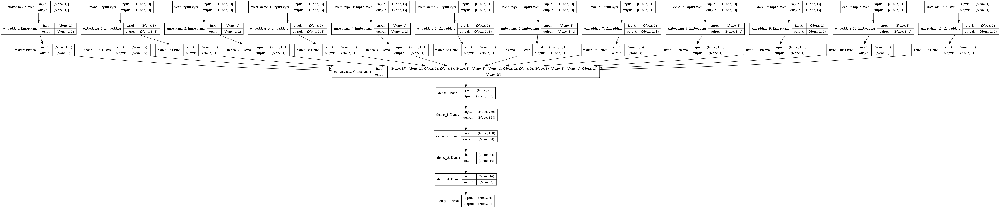

In [34]:
model = create_model(0.0002)
model.summary()
keras.utils.plot_model(model, 'model.png', show_shapes=True)

### Calculate derivatives and fit model

In [35]:
history = model.fit(X_train, 
                    y_train,
                    batch_size=2 ** 14,
                    epochs=250,
                    shuffle=True,
                    validation_data=valid)

Train on 26800710 samples, validate on 853720 samples
Epoch 1/250


 2359296/26800710 [=>............................] - ETA: 48:50 - loss: 16.1454 - mean_squared_error: 16.145 - ETA: 25:37 - loss: 14.7448 - mean_squared_error: 14.744 - ETA: 17:48 - loss: 13.9272 - mean_squared_error: 13.927 - ETA: 13:54 - loss: 13.4587 - mean_squared_error: 13.458 - ETA: 11:32 - loss: 13.0955 - mean_squared_error: 13.095 - ETA: 9:58 - loss: 13.1510 - mean_squared_error: 13.151 - ETA: 8:50 - loss: 12.9306 - mean_squared_error: 12.93 - ETA: 7:59 - loss: 13.6286 - mean_squared_error: 13.62 - ETA: 7:19 - loss: 13.2467 - mean_squared_error: 13.24 - ETA: 6:48 - loss: 13.1832 - mean_squared_error: 13.18 - ETA: 6:22 - loss: 13.0880 - mean_squared_error: 13.08 - ETA: 6:00 - loss: 13.2717 - mean_squared_error: 13.27 - ETA: 5:42 - loss: 13.4408 - mean_squared_error: 13.44 - ETA: 5:26 - loss: 13.3331 - mean_squared_error: 13.33 - ETA: 5:13 - loss: 13.0947 - mean_squared_error: 13.09 - ETA: 5:01 - loss: 12.9958 - mean_squared_error: 12.99 - ETA: 4:50 - loss: 12.9081 - mean_squared

14319616/26800710 [===============>..............] - ETA: 1:13 - loss: 11.1696 - mean_squared_error: 11.16 - ETA: 1:13 - loss: 11.1726 - mean_squared_error: 11.17 - ETA: 1:12 - loss: 11.1719 - mean_squared_error: 11.17 - ETA: 1:12 - loss: 11.1684 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1637 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1658 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1663 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1665 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1631 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1638 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1668 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1718 - mean_squared_error: 11.17 - ETA: 1:12 - loss: 11.1692 - mean_squared_error: 11.16 - ETA: 1:12 - loss: 11.1647 - mean_squared_error: 11.16 - ETA: 1:11 - loss: 11.1603 - mean_squared_error: 11.16 - ETA: 1:11 - loss: 11.1589 - mean_squared_error: 11.15 - ETA: 1:11 - loss: 11.1578 - mean_squared_error: 11.

16711680/26800710 [=================>............] - ETA: 1:00 - loss: 11.0594 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0630 - mean_squared_error: 11.06 - ETA: 1:00 - loss: 11.0600 - mean_squared_error: 11.06 - ETA: 1:00 - loss: 11.0581 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0549 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0516 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0535 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0503 - mean_squared_error: 11.05 - ETA: 1:00 - loss: 11.0481 - mean_squared_error: 11.04 - ETA: 1:00 - loss: 11.0493 - mean_squared_error: 11.04 - ETA: 1:00 - loss: 11.0477 - mean_squared_error: 11.04 - ETA: 1:00 - loss: 11.0524 - mean_squared_error: 11.05 - ETA: 59s - loss: 11.0509 - mean_squared_error: 11.0509 - ETA: 59s - loss: 11.0493 - mean_squared_error: 11.049 - ETA: 59s - loss: 11.0479 - mean_squared_error: 11.047 - ETA: 59s - loss: 11.0472 - mean_squared_error: 11.047 - ETA: 59s - loss: 11.0438 - mean_squared_error: 11.

19103744/26800710 [====================>.........] - ETA: 48s - loss: 10.9704 - mean_squared_error: 10.970 - ETA: 48s - loss: 10.9690 - mean_squared_error: 10.969 - ETA: 48s - loss: 10.9670 - mean_squared_error: 10.967 - ETA: 48s - loss: 10.9650 - mean_squared_error: 10.965 - ETA: 48s - loss: 10.9641 - mean_squared_error: 10.964 - ETA: 48s - loss: 10.9632 - mean_squared_error: 10.963 - ETA: 48s - loss: 10.9621 - mean_squared_error: 10.962 - ETA: 48s - loss: 10.9634 - mean_squared_error: 10.963 - ETA: 48s - loss: 10.9616 - mean_squared_error: 10.961 - ETA: 48s - loss: 10.9593 - mean_squared_error: 10.959 - ETA: 48s - loss: 10.9581 - mean_squared_error: 10.958 - ETA: 48s - loss: 10.9572 - mean_squared_error: 10.957 - ETA: 48s - loss: 10.9550 - mean_squared_error: 10.955 - ETA: 47s - loss: 10.9544 - mean_squared_error: 10.954 - ETA: 47s - loss: 10.9568 - mean_squared_error: 10.956 - ETA: 47s - loss: 10.9584 - mean_squared_error: 10.958 - ETA: 47s - loss: 10.9569 - mean_squared_error: 10.9

21495808/26800710 [=======================>......] - ETA: 37s - loss: 10.8994 - mean_squared_error: 10.899 - ETA: 37s - loss: 10.8994 - mean_squared_error: 10.899 - ETA: 37s - loss: 10.8961 - mean_squared_error: 10.896 - ETA: 36s - loss: 10.8956 - mean_squared_error: 10.895 - ETA: 36s - loss: 10.8946 - mean_squared_error: 10.894 - ETA: 36s - loss: 10.8959 - mean_squared_error: 10.895 - ETA: 36s - loss: 10.8944 - mean_squared_error: 10.894 - ETA: 36s - loss: 10.8942 - mean_squared_error: 10.894 - ETA: 36s - loss: 10.8919 - mean_squared_error: 10.891 - ETA: 36s - loss: 10.8904 - mean_squared_error: 10.890 - ETA: 36s - loss: 10.8897 - mean_squared_error: 10.889 - ETA: 36s - loss: 10.8878 - mean_squared_error: 10.887 - ETA: 36s - loss: 10.8867 - mean_squared_error: 10.886 - ETA: 36s - loss: 10.8863 - mean_squared_error: 10.886 - ETA: 36s - loss: 10.8853 - mean_squared_error: 10.885 - ETA: 36s - loss: 10.8831 - mean_squared_error: 10.883 - ETA: 35s - loss: 10.8825 - mean_squared_error: 10.8

23887872/26800710 [=========================>....] - ETA: 25s - loss: 10.8234 - mean_squared_error: 10.823 - ETA: 25s - loss: 10.8210 - mean_squared_error: 10.821 - ETA: 25s - loss: 10.8213 - mean_squared_error: 10.821 - ETA: 25s - loss: 10.8207 - mean_squared_error: 10.820 - ETA: 25s - loss: 10.8208 - mean_squared_error: 10.820 - ETA: 25s - loss: 10.8195 - mean_squared_error: 10.819 - ETA: 25s - loss: 10.8189 - mean_squared_error: 10.818 - ETA: 24s - loss: 10.8165 - mean_squared_error: 10.816 - ETA: 24s - loss: 10.8168 - mean_squared_error: 10.816 - ETA: 24s - loss: 10.8156 - mean_squared_error: 10.815 - ETA: 24s - loss: 10.8140 - mean_squared_error: 10.814 - ETA: 24s - loss: 10.8135 - mean_squared_error: 10.813 - ETA: 24s - loss: 10.8119 - mean_squared_error: 10.811 - ETA: 24s - loss: 10.8111 - mean_squared_error: 10.811 - ETA: 24s - loss: 10.8086 - mean_squared_error: 10.808 - ETA: 24s - loss: 10.8062 - mean_squared_error: 10.806 - ETA: 24s - loss: 10.8062 - mean_squared_error: 10.8

26329088/26800710 [============================>.] - ETA: 13s - loss: 10.7643 - mean_squared_error: 10.764 - ETA: 13s - loss: 10.7637 - mean_squared_error: 10.763 - ETA: 13s - loss: 10.7657 - mean_squared_error: 10.765 - ETA: 13s - loss: 10.7658 - mean_squared_error: 10.765 - ETA: 13s - loss: 10.7667 - mean_squared_error: 10.766 - ETA: 13s - loss: 10.7663 - mean_squared_error: 10.766 - ETA: 13s - loss: 10.7675 - mean_squared_error: 10.767 - ETA: 13s - loss: 10.7673 - mean_squared_error: 10.767 - ETA: 13s - loss: 10.7693 - mean_squared_error: 10.769 - ETA: 13s - loss: 10.7692 - mean_squared_error: 10.769 - ETA: 13s - loss: 10.7688 - mean_squared_error: 10.768 - ETA: 13s - loss: 10.7676 - mean_squared_error: 10.767 - ETA: 13s - loss: 10.7664 - mean_squared_error: 10.766 - ETA: 12s - loss: 10.7650 - mean_squared_error: 10.765 - ETA: 12s - loss: 10.7638 - mean_squared_error: 10.763 - ETA: 12s - loss: 10.7628 - mean_squared_error: 10.762 - ETA: 12s - loss: 10.7607 - mean_squared_error: 10.7

26800710/26800710 [==============================] - ETA: 2s - loss: 10.7156 - mean_squared_error: 10.71 - ETA: 2s - loss: 10.7161 - mean_squared_error: 10.71 - ETA: 2s - loss: 10.7157 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7144 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7135 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7127 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7134 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7143 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7129 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7121 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7109 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7113 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7102 - mean_squared_error: 10.71 - ETA: 1s - loss: 10.7090 - mean_squared_error: 10.70 - ETA: 1s - loss: 10.7077 - mean_squared_error: 10.70 - ETA: 1s - loss: 10.7061 - mean_squared_error: 10.70 - ETA: 0s - loss: 10.7079 - mean_squared_error: 10.70 - ETA: 0s - loss: 10.7084 - mea

 2457600/26800710 [=>............................] - ETA: 33:38 - loss: 9.7317 - mean_squared_error: 9.731 - ETA: 17:51 - loss: 8.6050 - mean_squared_error: 8.605 - ETA: 12:35 - loss: 9.6094 - mean_squared_error: 9.609 - ETA: 9:57 - loss: 9.0863 - mean_squared_error: 9.086 - ETA: 8:22 - loss: 9.2831 - mean_squared_error: 9.28 - ETA: 7:18 - loss: 9.4314 - mean_squared_error: 9.43 - ETA: 6:34 - loss: 9.3491 - mean_squared_error: 9.34 - ETA: 6:00 - loss: 9.2413 - mean_squared_error: 9.24 - ETA: 5:34 - loss: 9.2758 - mean_squared_error: 9.27 - ETA: 5:12 - loss: 9.2467 - mean_squared_error: 9.24 - ETA: 4:55 - loss: 9.3221 - mean_squared_error: 9.32 - ETA: 4:40 - loss: 9.3646 - mean_squared_error: 9.36 - ETA: 4:28 - loss: 9.1748 - mean_squared_error: 9.17 - ETA: 4:18 - loss: 9.1087 - mean_squared_error: 9.10 - ETA: 4:09 - loss: 9.1168 - mean_squared_error: 9.11 - ETA: 4:01 - loss: 9.7386 - mean_squared_error: 9.73 - ETA: 3:54 - loss: 9.9136 - mean_squared_error: 9.91 - ETA: 3:48 - loss: 9.87

12140544/26800710 [============>.................] - ETA: 1:23 - loss: 10.0246 - mean_squared_error: 10.02 - ETA: 1:22 - loss: 10.0262 - mean_squared_error: 10.02 - ETA: 1:22 - loss: 10.0276 - mean_squared_error: 10.02 - ETA: 1:22 - loss: 10.0313 - mean_squared_error: 10.03 - ETA: 1:22 - loss: 10.0289 - mean_squared_error: 10.02 - ETA: 1:22 - loss: 10.0362 - mean_squared_error: 10.03 - ETA: 1:22 - loss: 10.0331 - mean_squared_error: 10.03 - ETA: 1:22 - loss: 10.0334 - mean_squared_error: 10.03 - ETA: 1:22 - loss: 10.0367 - mean_squared_error: 10.03 - ETA: 1:22 - loss: 10.0428 - mean_squared_error: 10.04 - ETA: 1:22 - loss: 10.0407 - mean_squared_error: 10.04 - ETA: 1:22 - loss: 10.0453 - mean_squared_error: 10.04 - ETA: 1:22 - loss: 10.0451 - mean_squared_error: 10.04 - ETA: 1:21 - loss: 10.0458 - mean_squared_error: 10.04 - ETA: 1:21 - loss: 10.0445 - mean_squared_error: 10.04 - ETA: 1:21 - loss: 10.0427 - mean_squared_error: 10.04 - ETA: 1:21 - loss: 10.0454 - mean_squared_error: 10.

14548992/26800710 [===============>..............] - ETA: 1:10 - loss: 10.0313 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0280 - mean_squared_error: 10.02 - ETA: 1:10 - loss: 10.0261 - mean_squared_error: 10.02 - ETA: 1:10 - loss: 10.0253 - mean_squared_error: 10.02 - ETA: 1:10 - loss: 10.0273 - mean_squared_error: 10.02 - ETA: 1:10 - loss: 10.0318 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0342 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0347 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0343 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0308 - mean_squared_error: 10.03 - ETA: 1:10 - loss: 10.0279 - mean_squared_error: 10.02 - ETA: 1:09 - loss: 10.0350 - mean_squared_error: 10.03 - ETA: 1:09 - loss: 10.0324 - mean_squared_error: 10.03 - ETA: 1:09 - loss: 10.0308 - mean_squared_error: 10.03 - ETA: 1:09 - loss: 10.0365 - mean_squared_error: 10.03 - ETA: 1:09 - loss: 10.0361 - mean_squared_error: 10.03 - ETA: 1:09 - loss: 10.0381 - mean_squared_error: 10.

17022976/26800710 [==================>...........] - ETA: 58s - loss: 9.9848 - mean_squared_error: 9.984 - ETA: 58s - loss: 9.9840 - mean_squared_error: 9.984 - ETA: 58s - loss: 9.9821 - mean_squared_error: 9.982 - ETA: 58s - loss: 9.9804 - mean_squared_error: 9.980 - ETA: 58s - loss: 9.9793 - mean_squared_error: 9.979 - ETA: 58s - loss: 9.9813 - mean_squared_error: 9.981 - ETA: 58s - loss: 9.9794 - mean_squared_error: 9.979 - ETA: 58s - loss: 9.9784 - mean_squared_error: 9.978 - ETA: 58s - loss: 9.9814 - mean_squared_error: 9.981 - ETA: 58s - loss: 9.9824 - mean_squared_error: 9.982 - ETA: 58s - loss: 9.9794 - mean_squared_error: 9.979 - ETA: 58s - loss: 9.9776 - mean_squared_error: 9.977 - ETA: 58s - loss: 9.9764 - mean_squared_error: 9.976 - ETA: 57s - loss: 9.9826 - mean_squared_error: 9.982 - ETA: 57s - loss: 9.9822 - mean_squared_error: 9.982 - ETA: 57s - loss: 9.9828 - mean_squared_error: 9.982 - ETA: 57s - loss: 9.9822 - mean_squared_error: 9.982 - ETA: 57s - loss: 9.9801 - mea

19496960/26800710 [====================>.........] - ETA: 46s - loss: 9.9141 - mean_squared_error: 9.914 - ETA: 46s - loss: 9.9134 - mean_squared_error: 9.913 - ETA: 46s - loss: 9.9142 - mean_squared_error: 9.914 - ETA: 46s - loss: 9.9124 - mean_squared_error: 9.912 - ETA: 46s - loss: 9.9122 - mean_squared_error: 9.912 - ETA: 46s - loss: 9.9115 - mean_squared_error: 9.911 - ETA: 46s - loss: 9.9120 - mean_squared_error: 9.912 - ETA: 46s - loss: 9.9115 - mean_squared_error: 9.911 - ETA: 46s - loss: 9.9107 - mean_squared_error: 9.910 - ETA: 46s - loss: 9.9089 - mean_squared_error: 9.908 - ETA: 46s - loss: 9.9069 - mean_squared_error: 9.906 - ETA: 46s - loss: 9.9066 - mean_squared_error: 9.906 - ETA: 45s - loss: 9.9040 - mean_squared_error: 9.904 - ETA: 45s - loss: 9.9046 - mean_squared_error: 9.904 - ETA: 45s - loss: 9.9037 - mean_squared_error: 9.903 - ETA: 45s - loss: 9.9036 - mean_squared_error: 9.903 - ETA: 45s - loss: 9.9012 - mean_squared_error: 9.901 - ETA: 45s - loss: 9.8993 - mea

21970944/26800710 [=======================>......] - ETA: 34s - loss: 9.8498 - mean_squared_error: 9.849 - ETA: 34s - loss: 9.8502 - mean_squared_error: 9.850 - ETA: 34s - loss: 9.8492 - mean_squared_error: 9.849 - ETA: 34s - loss: 9.8489 - mean_squared_error: 9.848 - ETA: 34s - loss: 9.8474 - mean_squared_error: 9.847 - ETA: 34s - loss: 9.8512 - mean_squared_error: 9.851 - ETA: 34s - loss: 9.8499 - mean_squared_error: 9.850 - ETA: 34s - loss: 9.8496 - mean_squared_error: 9.849 - ETA: 34s - loss: 9.8472 - mean_squared_error: 9.847 - ETA: 34s - loss: 9.8460 - mean_squared_error: 9.846 - ETA: 34s - loss: 9.8442 - mean_squared_error: 9.844 - ETA: 34s - loss: 9.8430 - mean_squared_error: 9.843 - ETA: 33s - loss: 9.8419 - mean_squared_error: 9.841 - ETA: 33s - loss: 9.8423 - mean_squared_error: 9.842 - ETA: 33s - loss: 9.8419 - mean_squared_error: 9.841 - ETA: 33s - loss: 9.8414 - mean_squared_error: 9.841 - ETA: 33s - loss: 9.8414 - mean_squared_error: 9.841 - ETA: 33s - loss: 9.8414 - mea

24444928/26800710 [==========================>...] - ETA: 23s - loss: 9.8082 - mean_squared_error: 9.808 - ETA: 22s - loss: 9.8100 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8097 - mean_squared_error: 9.809 - ETA: 22s - loss: 9.8088 - mean_squared_error: 9.808 - ETA: 22s - loss: 9.8104 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8106 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8104 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8114 - mean_squared_error: 9.811 - ETA: 22s - loss: 9.8108 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8102 - mean_squared_error: 9.810 - ETA: 22s - loss: 9.8096 - mean_squared_error: 9.809 - ETA: 22s - loss: 9.8092 - mean_squared_error: 9.809 - ETA: 22s - loss: 9.8091 - mean_squared_error: 9.809 - ETA: 22s - loss: 9.8087 - mean_squared_error: 9.808 - ETA: 21s - loss: 9.8074 - mean_squared_error: 9.807 - ETA: 21s - loss: 9.8066 - mean_squared_error: 9.806 - ETA: 21s - loss: 9.8088 - mean_squared_error: 9.808 - ETA: 21s - loss: 9.8080 - mea

26800710/26800710 [==============================] - ETA: 11s - loss: 9.7815 - mean_squared_error: 9.781 - ETA: 11s - loss: 9.7855 - mean_squared_error: 9.785 - ETA: 11s - loss: 9.7848 - mean_squared_error: 9.784 - ETA: 10s - loss: 9.7849 - mean_squared_error: 9.784 - ETA: 10s - loss: 9.7845 - mean_squared_error: 9.784 - ETA: 10s - loss: 9.7851 - mean_squared_error: 9.785 - ETA: 10s - loss: 9.7860 - mean_squared_error: 9.786 - ETA: 10s - loss: 9.7876 - mean_squared_error: 9.787 - ETA: 10s - loss: 9.7876 - mean_squared_error: 9.787 - ETA: 10s - loss: 9.7885 - mean_squared_error: 9.788 - ETA: 10s - loss: 9.7902 - mean_squared_error: 9.790 - ETA: 10s - loss: 9.7893 - mean_squared_error: 9.789 - ETA: 10s - loss: 9.7892 - mean_squared_error: 9.789 - ETA: 10s - loss: 9.7889 - mean_squared_error: 9.788 - ETA: 10s - loss: 9.7893 - mean_squared_error: 9.789 - ETA: 10s - loss: 9.7885 - mean_squared_error: 9.788 - ETA: 9s - loss: 9.7886 - mean_squared_error: 9.788 - ETA: 9s - loss: 9.7885 - mean_

 2473984/26800710 [=>............................] - ETA: 38:38 - loss: 7.8008 - mean_squared_error: 7.800 - ETA: 20:25 - loss: 8.3017 - mean_squared_error: 8.301 - ETA: 14:19 - loss: 8.9141 - mean_squared_error: 8.914 - ETA: 11:17 - loss: 8.9463 - mean_squared_error: 8.946 - ETA: 9:27 - loss: 8.9522 - mean_squared_error: 8.952 - ETA: 8:16 - loss: 8.9865 - mean_squared_error: 8.98 - ETA: 7:23 - loss: 8.7352 - mean_squared_error: 8.73 - ETA: 6:44 - loss: 8.9906 - mean_squared_error: 8.99 - ETA: 6:13 - loss: 9.0088 - mean_squared_error: 9.00 - ETA: 5:49 - loss: 9.1013 - mean_squared_error: 9.10 - ETA: 5:28 - loss: 9.0892 - mean_squared_error: 9.08 - ETA: 5:12 - loss: 9.0561 - mean_squared_error: 9.05 - ETA: 4:57 - loss: 9.0278 - mean_squared_error: 9.02 - ETA: 4:45 - loss: 9.4411 - mean_squared_error: 9.44 - ETA: 4:35 - loss: 9.3086 - mean_squared_error: 9.30 - ETA: 4:26 - loss: 9.1424 - mean_squared_error: 9.14 - ETA: 4:17 - loss: 9.0944 - mean_squared_error: 9.09 - ETA: 4:10 - loss: 9.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 9.3592 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3620 - mean_squared_error: 9.36 - ETA: 1:24 - loss: 9.3588 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3593 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3587 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3550 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3534 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3537 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3510 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3575 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3543 - mean_squared_error: 9.35 - ETA: 1:24 - loss: 9.3554 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3556 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3535 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3547 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3550 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3595 - mean_squared_error: 9.35 - ETA: 1:23 - loss: 9.3586 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 9.2762 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2766 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2743 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2718 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2706 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2708 - mean_squared_error: 9.27 - ETA: 1:11 - loss: 9.2713 - mean_squared_error: 9.27 - ETA: 1:10 - loss: 9.2677 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2673 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2657 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2621 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2617 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2619 - mean_squared_error: 9.26 - ETA: 1:10 - loss: 9.2595 - mean_squared_error: 9.25 - ETA: 1:10 - loss: 9.2595 - mean_squared_error: 9.25 - ETA: 1:10 - loss: 9.2574 - mean_squared_error: 9.25 - ETA: 1:10 - loss: 9.2572 - mean_squared_error: 9.25 - ETA: 1:10 - loss: 9.2558 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 9.2548 - mean_squared_error: 9.254 - ETA: 58s - loss: 9.2564 - mean_squared_error: 9.256 - ETA: 58s - loss: 9.2578 - mean_squared_error: 9.257 - ETA: 58s - loss: 9.2594 - mean_squared_error: 9.259 - ETA: 58s - loss: 9.2582 - mean_squared_error: 9.258 - ETA: 58s - loss: 9.2575 - mean_squared_error: 9.257 - ETA: 58s - loss: 9.2557 - mean_squared_error: 9.255 - ETA: 58s - loss: 9.2558 - mean_squared_error: 9.255 - ETA: 58s - loss: 9.2552 - mean_squared_error: 9.255 - ETA: 58s - loss: 9.2543 - mean_squared_error: 9.254 - ETA: 58s - loss: 9.2521 - mean_squared_error: 9.252 - ETA: 57s - loss: 9.2512 - mean_squared_error: 9.251 - ETA: 57s - loss: 9.2508 - mean_squared_error: 9.250 - ETA: 57s - loss: 9.2510 - mean_squared_error: 9.251 - ETA: 57s - loss: 9.2497 - mean_squared_error: 9.249 - ETA: 57s - loss: 9.2503 - mean_squared_error: 9.250 - ETA: 57s - loss: 9.2506 - mean_squared_error: 9.250 - ETA: 57s - loss: 9.2505 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 9.2193 - mean_squared_error: 9.219 - ETA: 46s - loss: 9.2186 - mean_squared_error: 9.218 - ETA: 46s - loss: 9.2206 - mean_squared_error: 9.220 - ETA: 46s - loss: 9.2222 - mean_squared_error: 9.222 - ETA: 46s - loss: 9.2236 - mean_squared_error: 9.223 - ETA: 46s - loss: 9.2224 - mean_squared_error: 9.222 - ETA: 45s - loss: 9.2194 - mean_squared_error: 9.219 - ETA: 45s - loss: 9.2175 - mean_squared_error: 9.217 - ETA: 45s - loss: 9.2158 - mean_squared_error: 9.215 - ETA: 45s - loss: 9.2141 - mean_squared_error: 9.214 - ETA: 45s - loss: 9.2179 - mean_squared_error: 9.217 - ETA: 45s - loss: 9.2174 - mean_squared_error: 9.217 - ETA: 45s - loss: 9.2157 - mean_squared_error: 9.215 - ETA: 45s - loss: 9.2138 - mean_squared_error: 9.213 - ETA: 45s - loss: 9.2143 - mean_squared_error: 9.214 - ETA: 45s - loss: 9.2142 - mean_squared_error: 9.214 - ETA: 45s - loss: 9.2154 - mean_squared_error: 9.215 - ETA: 45s - loss: 9.2133 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 9.1953 - mean_squared_error: 9.195 - ETA: 34s - loss: 9.1955 - mean_squared_error: 9.195 - ETA: 34s - loss: 9.1959 - mean_squared_error: 9.195 - ETA: 33s - loss: 9.1946 - mean_squared_error: 9.194 - ETA: 33s - loss: 9.1940 - mean_squared_error: 9.194 - ETA: 33s - loss: 9.1928 - mean_squared_error: 9.192 - ETA: 33s - loss: 9.1915 - mean_squared_error: 9.191 - ETA: 33s - loss: 9.1926 - mean_squared_error: 9.192 - ETA: 33s - loss: 9.1921 - mean_squared_error: 9.192 - ETA: 33s - loss: 9.1902 - mean_squared_error: 9.190 - ETA: 33s - loss: 9.1889 - mean_squared_error: 9.188 - ETA: 33s - loss: 9.1883 - mean_squared_error: 9.188 - ETA: 33s - loss: 9.1867 - mean_squared_error: 9.186 - ETA: 33s - loss: 9.1862 - mean_squared_error: 9.186 - ETA: 33s - loss: 9.1879 - mean_squared_error: 9.187 - ETA: 32s - loss: 9.1890 - mean_squared_error: 9.189 - ETA: 32s - loss: 9.1875 - mean_squared_error: 9.187 - ETA: 32s - loss: 9.1878 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 9.1969 - mean_squared_error: 9.196 - ETA: 21s - loss: 9.1956 - mean_squared_error: 9.195 - ETA: 21s - loss: 9.1941 - mean_squared_error: 9.194 - ETA: 21s - loss: 9.1932 - mean_squared_error: 9.193 - ETA: 21s - loss: 9.1924 - mean_squared_error: 9.192 - ETA: 21s - loss: 9.1941 - mean_squared_error: 9.194 - ETA: 21s - loss: 9.1942 - mean_squared_error: 9.194 - ETA: 21s - loss: 9.1942 - mean_squared_error: 9.194 - ETA: 21s - loss: 9.1936 - mean_squared_error: 9.193 - ETA: 21s - loss: 9.1927 - mean_squared_error: 9.192 - ETA: 21s - loss: 9.1939 - mean_squared_error: 9.193 - ETA: 21s - loss: 9.1947 - mean_squared_error: 9.194 - ETA: 21s - loss: 9.2014 - mean_squared_error: 9.201 - ETA: 20s - loss: 9.2020 - mean_squared_error: 9.202 - ETA: 20s - loss: 9.2010 - mean_squared_error: 9.201 - ETA: 20s - loss: 9.2022 - mean_squared_error: 9.202 - ETA: 20s - loss: 9.2015 - mean_squared_error: 9.201 - ETA: 20s - loss: 9.2009 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 9.1642 - mean_squared_error: 9.164 - ETA: 9s - loss: 9.1624 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1632 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1637 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1639 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1637 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1635 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1627 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1636 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1639 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1629 - mean_squared_error: 9.16 - ETA: 9s - loss: 9.1622 - mean_squared_error: 9.16 - ETA: 8s - loss: 9.1611 - mean_squared_error: 9.16 - ETA: 8s - loss: 9.1610 - mean_squared_error: 9.16 - ETA: 8s - loss: 9.1614 - mean_squared_error: 9.16 - ETA: 8s - loss: 9.1596 - mean_squared_error: 9.15 - ETA: 8s - loss: 9.1597 - mean_squared_error: 9.15 - ETA: 8s - loss: 9.1582 - mean_squared_error: 9.15 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:24 - loss: 6.7795 - mean_squared_error: 6.779 - ETA: 18:48 - loss: 6.1246 - mean_squared_error: 6.124 - ETA: 13:14 - loss: 6.7519 - mean_squared_error: 6.751 - ETA: 10:27 - loss: 6.9359 - mean_squared_error: 6.935 - ETA: 8:46 - loss: 6.8487 - mean_squared_error: 6.848 - ETA: 7:40 - loss: 7.0972 - mean_squared_error: 7.09 - ETA: 6:52 - loss: 7.5826 - mean_squared_error: 7.58 - ETA: 6:16 - loss: 7.6736 - mean_squared_error: 7.67 - ETA: 5:49 - loss: 7.7262 - mean_squared_error: 7.72 - ETA: 5:26 - loss: 7.8789 - mean_squared_error: 7.87 - ETA: 5:08 - loss: 8.1023 - mean_squared_error: 8.10 - ETA: 4:53 - loss: 8.0476 - mean_squared_error: 8.04 - ETA: 4:40 - loss: 8.0287 - mean_squared_error: 8.02 - ETA: 4:29 - loss: 8.3035 - mean_squared_error: 8.30 - ETA: 4:19 - loss: 8.3211 - mean_squared_error: 8.32 - ETA: 4:11 - loss: 8.2763 - mean_squared_error: 8.27 - ETA: 4:03 - loss: 8.2535 - mean_squared_error: 8.25 - ETA: 3:57 - loss: 8.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 8.8294 - mean_squared_error: 8.82 - ETA: 1:21 - loss: 8.8277 - mean_squared_error: 8.82 - ETA: 1:21 - loss: 8.8301 - mean_squared_error: 8.83 - ETA: 1:21 - loss: 8.8284 - mean_squared_error: 8.82 - ETA: 1:21 - loss: 8.8247 - mean_squared_error: 8.82 - ETA: 1:21 - loss: 8.8195 - mean_squared_error: 8.81 - ETA: 1:21 - loss: 8.8241 - mean_squared_error: 8.82 - ETA: 1:21 - loss: 8.8197 - mean_squared_error: 8.81 - ETA: 1:21 - loss: 8.8210 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8212 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8247 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8311 - mean_squared_error: 8.83 - ETA: 1:20 - loss: 8.8282 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8267 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8228 - mean_squared_error: 8.82 - ETA: 1:20 - loss: 8.8170 - mean_squared_error: 8.81 - ETA: 1:20 - loss: 8.8164 - mean_squared_error: 8.81 - ETA: 1:20 - loss: 8.8253 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 8.8249 - mean_squared_error: 8.82 - ETA: 1:09 - loss: 8.8229 - mean_squared_error: 8.82 - ETA: 1:09 - loss: 8.8209 - mean_squared_error: 8.82 - ETA: 1:09 - loss: 8.8182 - mean_squared_error: 8.81 - ETA: 1:09 - loss: 8.8181 - mean_squared_error: 8.81 - ETA: 1:09 - loss: 8.8185 - mean_squared_error: 8.81 - ETA: 1:09 - loss: 8.8177 - mean_squared_error: 8.81 - ETA: 1:09 - loss: 8.8207 - mean_squared_error: 8.82 - ETA: 1:09 - loss: 8.8210 - mean_squared_error: 8.82 - ETA: 1:09 - loss: 8.8222 - mean_squared_error: 8.82 - ETA: 1:08 - loss: 8.8219 - mean_squared_error: 8.82 - ETA: 1:08 - loss: 8.8229 - mean_squared_error: 8.82 - ETA: 1:08 - loss: 8.8205 - mean_squared_error: 8.82 - ETA: 1:08 - loss: 8.8183 - mean_squared_error: 8.81 - ETA: 1:08 - loss: 8.8156 - mean_squared_error: 8.81 - ETA: 1:08 - loss: 8.8139 - mean_squared_error: 8.81 - ETA: 1:08 - loss: 8.8154 - mean_squared_error: 8.81 - ETA: 1:08 - loss: 8.8139 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 8.7558 - mean_squared_error: 8.755 - ETA: 57s - loss: 8.7561 - mean_squared_error: 8.756 - ETA: 57s - loss: 8.7548 - mean_squared_error: 8.754 - ETA: 57s - loss: 8.7528 - mean_squared_error: 8.752 - ETA: 57s - loss: 8.7534 - mean_squared_error: 8.753 - ETA: 57s - loss: 8.7525 - mean_squared_error: 8.752 - ETA: 57s - loss: 8.7525 - mean_squared_error: 8.752 - ETA: 57s - loss: 8.7508 - mean_squared_error: 8.750 - ETA: 57s - loss: 8.7514 - mean_squared_error: 8.751 - ETA: 57s - loss: 8.7496 - mean_squared_error: 8.749 - ETA: 56s - loss: 8.7512 - mean_squared_error: 8.751 - ETA: 56s - loss: 8.7499 - mean_squared_error: 8.749 - ETA: 56s - loss: 8.7481 - mean_squared_error: 8.748 - ETA: 56s - loss: 8.7477 - mean_squared_error: 8.747 - ETA: 56s - loss: 8.7473 - mean_squared_error: 8.747 - ETA: 56s - loss: 8.7472 - mean_squared_error: 8.747 - ETA: 56s - loss: 8.7450 - mean_squared_error: 8.745 - ETA: 56s - loss: 8.7440 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 8.7340 - mean_squared_error: 8.734 - ETA: 45s - loss: 8.7334 - mean_squared_error: 8.733 - ETA: 45s - loss: 8.7311 - mean_squared_error: 8.731 - ETA: 45s - loss: 8.7344 - mean_squared_error: 8.734 - ETA: 45s - loss: 8.7321 - mean_squared_error: 8.732 - ETA: 45s - loss: 8.7304 - mean_squared_error: 8.730 - ETA: 45s - loss: 8.7295 - mean_squared_error: 8.729 - ETA: 45s - loss: 8.7289 - mean_squared_error: 8.728 - ETA: 45s - loss: 8.7278 - mean_squared_error: 8.727 - ETA: 45s - loss: 8.7269 - mean_squared_error: 8.726 - ETA: 44s - loss: 8.7277 - mean_squared_error: 8.727 - ETA: 44s - loss: 8.7261 - mean_squared_error: 8.726 - ETA: 44s - loss: 8.7235 - mean_squared_error: 8.723 - ETA: 44s - loss: 8.7256 - mean_squared_error: 8.725 - ETA: 44s - loss: 8.7258 - mean_squared_error: 8.725 - ETA: 44s - loss: 8.7242 - mean_squared_error: 8.724 - ETA: 44s - loss: 8.7239 - mean_squared_error: 8.723 - ETA: 44s - loss: 8.7230 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 8.7122 - mean_squared_error: 8.712 - ETA: 33s - loss: 8.7118 - mean_squared_error: 8.711 - ETA: 33s - loss: 8.7109 - mean_squared_error: 8.710 - ETA: 33s - loss: 8.7099 - mean_squared_error: 8.709 - ETA: 33s - loss: 8.7083 - mean_squared_error: 8.708 - ETA: 33s - loss: 8.7081 - mean_squared_error: 8.708 - ETA: 33s - loss: 8.7087 - mean_squared_error: 8.708 - ETA: 33s - loss: 8.7081 - mean_squared_error: 8.708 - ETA: 33s - loss: 8.7071 - mean_squared_error: 8.707 - ETA: 32s - loss: 8.7073 - mean_squared_error: 8.707 - ETA: 32s - loss: 8.7056 - mean_squared_error: 8.705 - ETA: 32s - loss: 8.7072 - mean_squared_error: 8.707 - ETA: 32s - loss: 8.7069 - mean_squared_error: 8.706 - ETA: 32s - loss: 8.7053 - mean_squared_error: 8.705 - ETA: 32s - loss: 8.7035 - mean_squared_error: 8.703 - ETA: 32s - loss: 8.7034 - mean_squared_error: 8.703 - ETA: 32s - loss: 8.7047 - mean_squared_error: 8.704 - ETA: 32s - loss: 8.7026 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 8.6600 - mean_squared_error: 8.660 - ETA: 21s - loss: 8.6581 - mean_squared_error: 8.658 - ETA: 21s - loss: 8.6572 - mean_squared_error: 8.657 - ETA: 21s - loss: 8.6577 - mean_squared_error: 8.657 - ETA: 21s - loss: 8.6563 - mean_squared_error: 8.656 - ETA: 21s - loss: 8.6553 - mean_squared_error: 8.655 - ETA: 21s - loss: 8.6566 - mean_squared_error: 8.656 - ETA: 21s - loss: 8.6545 - mean_squared_error: 8.654 - ETA: 21s - loss: 8.6541 - mean_squared_error: 8.654 - ETA: 21s - loss: 8.6521 - mean_squared_error: 8.652 - ETA: 20s - loss: 8.6508 - mean_squared_error: 8.650 - ETA: 20s - loss: 8.6498 - mean_squared_error: 8.649 - ETA: 20s - loss: 8.6483 - mean_squared_error: 8.648 - ETA: 20s - loss: 8.6484 - mean_squared_error: 8.648 - ETA: 20s - loss: 8.6502 - mean_squared_error: 8.650 - ETA: 20s - loss: 8.6495 - mean_squared_error: 8.649 - ETA: 20s - loss: 8.6485 - mean_squared_error: 8.648 - ETA: 20s - loss: 8.6512 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 8.6487 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6481 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6476 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6471 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6459 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6450 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6449 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6448 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6435 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6425 - mean_squared_error: 8.64 - ETA: 9s - loss: 8.6406 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6450 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6449 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6441 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6426 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6433 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6445 - mean_squared_error: 8.64 - ETA: 8s - loss: 8.6428 - mean_squared_error: 8.64 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:45 - loss: 8.6784 - mean_squared_error: 8.678 - ETA: 18:00 - loss: 8.0578 - mean_squared_error: 8.057 - ETA: 12:43 - loss: 8.8472 - mean_squared_error: 8.847 - ETA: 10:02 - loss: 8.6235 - mean_squared_error: 8.623 - ETA: 8:27 - loss: 8.2841 - mean_squared_error: 8.284 - ETA: 7:22 - loss: 8.1625 - mean_squared_error: 8.16 - ETA: 6:37 - loss: 7.9820 - mean_squared_error: 7.98 - ETA: 6:02 - loss: 8.1539 - mean_squared_error: 8.15 - ETA: 5:35 - loss: 7.9865 - mean_squared_error: 7.98 - ETA: 5:14 - loss: 8.0152 - mean_squared_error: 8.01 - ETA: 4:57 - loss: 8.2306 - mean_squared_error: 8.23 - ETA: 4:42 - loss: 8.3089 - mean_squared_error: 8.30 - ETA: 4:30 - loss: 8.1689 - mean_squared_error: 8.16 - ETA: 4:20 - loss: 8.2507 - mean_squared_error: 8.25 - ETA: 4:11 - loss: 8.1847 - mean_squared_error: 8.18 - ETA: 4:02 - loss: 8.2383 - mean_squared_error: 8.23 - ETA: 3:55 - loss: 8.1212 - mean_squared_error: 8.12 - ETA: 3:49 - loss: 8.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 8.4357 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4337 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4338 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4317 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4333 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4296 - mean_squared_error: 8.42 - ETA: 1:21 - loss: 8.4279 - mean_squared_error: 8.42 - ETA: 1:21 - loss: 8.4305 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4306 - mean_squared_error: 8.43 - ETA: 1:21 - loss: 8.4325 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4327 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4306 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4323 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4321 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4296 - mean_squared_error: 8.42 - ETA: 1:20 - loss: 8.4362 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4378 - mean_squared_error: 8.43 - ETA: 1:20 - loss: 8.4407 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 8.4615 - mean_squared_error: 8.46 - ETA: 1:09 - loss: 8.4613 - mean_squared_error: 8.46 - ETA: 1:09 - loss: 8.4599 - mean_squared_error: 8.45 - ETA: 1:09 - loss: 8.4607 - mean_squared_error: 8.46 - ETA: 1:09 - loss: 8.4640 - mean_squared_error: 8.46 - ETA: 1:09 - loss: 8.4651 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4633 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4624 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4630 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4610 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4602 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4616 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4607 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4610 - mean_squared_error: 8.46 - ETA: 1:08 - loss: 8.4598 - mean_squared_error: 8.45 - ETA: 1:08 - loss: 8.4576 - mean_squared_error: 8.45 - ETA: 1:08 - loss: 8.4564 - mean_squared_error: 8.45 - ETA: 1:08 - loss: 8.4573 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 8.4157 - mean_squared_error: 8.415 - ETA: 57s - loss: 8.4160 - mean_squared_error: 8.416 - ETA: 57s - loss: 8.4146 - mean_squared_error: 8.414 - ETA: 57s - loss: 8.4144 - mean_squared_error: 8.414 - ETA: 57s - loss: 8.4137 - mean_squared_error: 8.413 - ETA: 56s - loss: 8.4151 - mean_squared_error: 8.415 - ETA: 56s - loss: 8.4180 - mean_squared_error: 8.418 - ETA: 56s - loss: 8.4162 - mean_squared_error: 8.416 - ETA: 56s - loss: 8.4151 - mean_squared_error: 8.415 - ETA: 56s - loss: 8.4120 - mean_squared_error: 8.412 - ETA: 56s - loss: 8.4110 - mean_squared_error: 8.411 - ETA: 56s - loss: 8.4125 - mean_squared_error: 8.412 - ETA: 56s - loss: 8.4097 - mean_squared_error: 8.409 - ETA: 56s - loss: 8.4098 - mean_squared_error: 8.409 - ETA: 56s - loss: 8.4132 - mean_squared_error: 8.413 - ETA: 56s - loss: 8.4130 - mean_squared_error: 8.413 - ETA: 56s - loss: 8.4119 - mean_squared_error: 8.411 - ETA: 55s - loss: 8.4120 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 8.3477 - mean_squared_error: 8.347 - ETA: 45s - loss: 8.3469 - mean_squared_error: 8.346 - ETA: 45s - loss: 8.3449 - mean_squared_error: 8.344 - ETA: 45s - loss: 8.3441 - mean_squared_error: 8.344 - ETA: 45s - loss: 8.3478 - mean_squared_error: 8.347 - ETA: 45s - loss: 8.3468 - mean_squared_error: 8.346 - ETA: 44s - loss: 8.3455 - mean_squared_error: 8.345 - ETA: 44s - loss: 8.3434 - mean_squared_error: 8.343 - ETA: 44s - loss: 8.3439 - mean_squared_error: 8.343 - ETA: 44s - loss: 8.3432 - mean_squared_error: 8.343 - ETA: 44s - loss: 8.3424 - mean_squared_error: 8.342 - ETA: 44s - loss: 8.3422 - mean_squared_error: 8.342 - ETA: 44s - loss: 8.3404 - mean_squared_error: 8.340 - ETA: 44s - loss: 8.3399 - mean_squared_error: 8.339 - ETA: 44s - loss: 8.3401 - mean_squared_error: 8.340 - ETA: 44s - loss: 8.3436 - mean_squared_error: 8.343 - ETA: 44s - loss: 8.3420 - mean_squared_error: 8.342 - ETA: 44s - loss: 8.3398 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 8.3384 - mean_squared_error: 8.338 - ETA: 33s - loss: 8.3379 - mean_squared_error: 8.337 - ETA: 33s - loss: 8.3391 - mean_squared_error: 8.339 - ETA: 33s - loss: 8.3384 - mean_squared_error: 8.338 - ETA: 33s - loss: 8.3387 - mean_squared_error: 8.338 - ETA: 33s - loss: 8.3372 - mean_squared_error: 8.337 - ETA: 32s - loss: 8.3382 - mean_squared_error: 8.338 - ETA: 32s - loss: 8.3375 - mean_squared_error: 8.337 - ETA: 32s - loss: 8.3382 - mean_squared_error: 8.338 - ETA: 32s - loss: 8.3374 - mean_squared_error: 8.337 - ETA: 32s - loss: 8.3355 - mean_squared_error: 8.335 - ETA: 32s - loss: 8.3344 - mean_squared_error: 8.334 - ETA: 32s - loss: 8.3337 - mean_squared_error: 8.333 - ETA: 32s - loss: 8.3324 - mean_squared_error: 8.332 - ETA: 32s - loss: 8.3337 - mean_squared_error: 8.333 - ETA: 32s - loss: 8.3328 - mean_squared_error: 8.332 - ETA: 32s - loss: 8.3306 - mean_squared_error: 8.330 - ETA: 32s - loss: 8.3312 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 8.2856 - mean_squared_error: 8.285 - ETA: 21s - loss: 8.2837 - mean_squared_error: 8.283 - ETA: 21s - loss: 8.2829 - mean_squared_error: 8.282 - ETA: 21s - loss: 8.2812 - mean_squared_error: 8.281 - ETA: 21s - loss: 8.2802 - mean_squared_error: 8.280 - ETA: 21s - loss: 8.2800 - mean_squared_error: 8.280 - ETA: 21s - loss: 8.2795 - mean_squared_error: 8.279 - ETA: 21s - loss: 8.2792 - mean_squared_error: 8.279 - ETA: 21s - loss: 8.2785 - mean_squared_error: 8.278 - ETA: 20s - loss: 8.2773 - mean_squared_error: 8.277 - ETA: 20s - loss: 8.2815 - mean_squared_error: 8.281 - ETA: 20s - loss: 8.2812 - mean_squared_error: 8.281 - ETA: 20s - loss: 8.2826 - mean_squared_error: 8.282 - ETA: 20s - loss: 8.2812 - mean_squared_error: 8.281 - ETA: 20s - loss: 8.2804 - mean_squared_error: 8.280 - ETA: 20s - loss: 8.2799 - mean_squared_error: 8.279 - ETA: 20s - loss: 8.2802 - mean_squared_error: 8.280 - ETA: 20s - loss: 8.2781 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 8.2460 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2468 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2451 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2466 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2461 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2454 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2442 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2438 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2430 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2434 - mean_squared_error: 8.24 - ETA: 9s - loss: 8.2450 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2438 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2431 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2432 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2418 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2409 - mean_squared_error: 8.24 - ETA: 8s - loss: 8.2399 - mean_squared_error: 8.23 - ETA: 8s - loss: 8.2400 - mean_squared_error: 8.23 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 7.4643 - mean_squared_error: 7.464 - ETA: 18:57 - loss: 7.7221 - mean_squared_error: 7.722 - ETA: 13:20 - loss: 7.6635 - mean_squared_error: 7.663 - ETA: 10:32 - loss: 9.3287 - mean_squared_error: 9.328 - ETA: 8:50 - loss: 9.4416 - mean_squared_error: 9.441 - ETA: 7:43 - loss: 9.4087 - mean_squared_error: 9.40 - ETA: 6:55 - loss: 9.0737 - mean_squared_error: 9.07 - ETA: 6:19 - loss: 8.9683 - mean_squared_error: 8.96 - ETA: 5:50 - loss: 8.8304 - mean_squared_error: 8.83 - ETA: 5:28 - loss: 8.8585 - mean_squared_error: 8.85 - ETA: 5:09 - loss: 8.9978 - mean_squared_error: 8.99 - ETA: 4:54 - loss: 9.1903 - mean_squared_error: 9.19 - ETA: 4:41 - loss: 8.9545 - mean_squared_error: 8.95 - ETA: 4:30 - loss: 8.8487 - mean_squared_error: 8.84 - ETA: 4:20 - loss: 8.9357 - mean_squared_error: 8.93 - ETA: 4:12 - loss: 9.0012 - mean_squared_error: 9.00 - ETA: 4:04 - loss: 8.8070 - mean_squared_error: 8.80 - ETA: 3:58 - loss: 8.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 7.9003 - mean_squared_error: 7.90 - ETA: 1:21 - loss: 7.8971 - mean_squared_error: 7.89 - ETA: 1:21 - loss: 7.9066 - mean_squared_error: 7.90 - ETA: 1:21 - loss: 7.9067 - mean_squared_error: 7.90 - ETA: 1:21 - loss: 7.9086 - mean_squared_error: 7.90 - ETA: 1:21 - loss: 7.9107 - mean_squared_error: 7.91 - ETA: 1:21 - loss: 7.9168 - mean_squared_error: 7.91 - ETA: 1:21 - loss: 7.9185 - mean_squared_error: 7.91 - ETA: 1:21 - loss: 7.9167 - mean_squared_error: 7.91 - ETA: 1:21 - loss: 7.9159 - mean_squared_error: 7.91 - ETA: 1:20 - loss: 7.9170 - mean_squared_error: 7.91 - ETA: 1:20 - loss: 7.9260 - mean_squared_error: 7.92 - ETA: 1:20 - loss: 7.9294 - mean_squared_error: 7.92 - ETA: 1:20 - loss: 7.9317 - mean_squared_error: 7.93 - ETA: 1:20 - loss: 7.9307 - mean_squared_error: 7.93 - ETA: 1:20 - loss: 7.9288 - mean_squared_error: 7.92 - ETA: 1:20 - loss: 7.9246 - mean_squared_error: 7.92 - ETA: 1:20 - loss: 7.9282 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 7.8901 - mean_squared_error: 7.89 - ETA: 1:09 - loss: 7.8874 - mean_squared_error: 7.88 - ETA: 1:09 - loss: 7.8889 - mean_squared_error: 7.88 - ETA: 1:09 - loss: 7.8907 - mean_squared_error: 7.89 - ETA: 1:09 - loss: 7.8903 - mean_squared_error: 7.89 - ETA: 1:09 - loss: 7.8919 - mean_squared_error: 7.89 - ETA: 1:09 - loss: 7.8912 - mean_squared_error: 7.89 - ETA: 1:09 - loss: 7.8907 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8890 - mean_squared_error: 7.88 - ETA: 1:08 - loss: 7.8865 - mean_squared_error: 7.88 - ETA: 1:08 - loss: 7.8995 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8979 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8989 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8974 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8964 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8943 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8924 - mean_squared_error: 7.89 - ETA: 1:08 - loss: 7.8952 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 7.8659 - mean_squared_error: 7.865 - ETA: 57s - loss: 7.8647 - mean_squared_error: 7.864 - ETA: 57s - loss: 7.8651 - mean_squared_error: 7.865 - ETA: 57s - loss: 7.8676 - mean_squared_error: 7.867 - ETA: 57s - loss: 7.8672 - mean_squared_error: 7.867 - ETA: 56s - loss: 7.8707 - mean_squared_error: 7.870 - ETA: 56s - loss: 7.8722 - mean_squared_error: 7.872 - ETA: 56s - loss: 7.8742 - mean_squared_error: 7.874 - ETA: 56s - loss: 7.8744 - mean_squared_error: 7.874 - ETA: 56s - loss: 7.8744 - mean_squared_error: 7.874 - ETA: 56s - loss: 7.8744 - mean_squared_error: 7.874 - ETA: 56s - loss: 7.8751 - mean_squared_error: 7.875 - ETA: 56s - loss: 7.8742 - mean_squared_error: 7.874 - ETA: 56s - loss: 7.8762 - mean_squared_error: 7.876 - ETA: 56s - loss: 7.8759 - mean_squared_error: 7.875 - ETA: 56s - loss: 7.8761 - mean_squared_error: 7.876 - ETA: 56s - loss: 7.8778 - mean_squared_error: 7.877 - ETA: 55s - loss: 7.8773 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 7.9324 - mean_squared_error: 7.932 - ETA: 45s - loss: 7.9329 - mean_squared_error: 7.932 - ETA: 45s - loss: 7.9319 - mean_squared_error: 7.931 - ETA: 45s - loss: 7.9309 - mean_squared_error: 7.930 - ETA: 45s - loss: 7.9305 - mean_squared_error: 7.930 - ETA: 45s - loss: 7.9326 - mean_squared_error: 7.932 - ETA: 44s - loss: 7.9322 - mean_squared_error: 7.932 - ETA: 44s - loss: 7.9330 - mean_squared_error: 7.933 - ETA: 44s - loss: 7.9319 - mean_squared_error: 7.931 - ETA: 44s - loss: 7.9303 - mean_squared_error: 7.930 - ETA: 44s - loss: 7.9295 - mean_squared_error: 7.929 - ETA: 44s - loss: 7.9294 - mean_squared_error: 7.929 - ETA: 44s - loss: 7.9327 - mean_squared_error: 7.932 - ETA: 44s - loss: 7.9308 - mean_squared_error: 7.930 - ETA: 44s - loss: 7.9303 - mean_squared_error: 7.930 - ETA: 44s - loss: 7.9292 - mean_squared_error: 7.929 - ETA: 44s - loss: 7.9344 - mean_squared_error: 7.934 - ETA: 44s - loss: 7.9330 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 7.8927 - mean_squared_error: 7.892 - ETA: 33s - loss: 7.8923 - mean_squared_error: 7.892 - ETA: 33s - loss: 7.8916 - mean_squared_error: 7.891 - ETA: 33s - loss: 7.8909 - mean_squared_error: 7.890 - ETA: 33s - loss: 7.8909 - mean_squared_error: 7.890 - ETA: 33s - loss: 7.8931 - mean_squared_error: 7.893 - ETA: 33s - loss: 7.8954 - mean_squared_error: 7.895 - ETA: 33s - loss: 7.8944 - mean_squared_error: 7.894 - ETA: 32s - loss: 7.8934 - mean_squared_error: 7.893 - ETA: 32s - loss: 7.8946 - mean_squared_error: 7.894 - ETA: 32s - loss: 7.8941 - mean_squared_error: 7.894 - ETA: 32s - loss: 7.8944 - mean_squared_error: 7.894 - ETA: 32s - loss: 7.8936 - mean_squared_error: 7.893 - ETA: 32s - loss: 7.8936 - mean_squared_error: 7.893 - ETA: 32s - loss: 7.8951 - mean_squared_error: 7.895 - ETA: 32s - loss: 7.8939 - mean_squared_error: 7.893 - ETA: 32s - loss: 7.8944 - mean_squared_error: 7.894 - ETA: 32s - loss: 7.8929 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 7.8855 - mean_squared_error: 7.885 - ETA: 21s - loss: 7.8854 - mean_squared_error: 7.885 - ETA: 21s - loss: 7.8853 - mean_squared_error: 7.885 - ETA: 21s - loss: 7.8841 - mean_squared_error: 7.884 - ETA: 21s - loss: 7.8844 - mean_squared_error: 7.884 - ETA: 21s - loss: 7.8829 - mean_squared_error: 7.882 - ETA: 21s - loss: 7.8847 - mean_squared_error: 7.884 - ETA: 21s - loss: 7.8832 - mean_squared_error: 7.883 - ETA: 21s - loss: 7.8841 - mean_squared_error: 7.884 - ETA: 21s - loss: 7.8876 - mean_squared_error: 7.887 - ETA: 20s - loss: 7.8888 - mean_squared_error: 7.888 - ETA: 20s - loss: 7.8866 - mean_squared_error: 7.886 - ETA: 20s - loss: 7.8844 - mean_squared_error: 7.884 - ETA: 20s - loss: 7.8856 - mean_squared_error: 7.885 - ETA: 20s - loss: 7.8849 - mean_squared_error: 7.884 - ETA: 20s - loss: 7.8840 - mean_squared_error: 7.884 - ETA: 20s - loss: 7.8855 - mean_squared_error: 7.885 - ETA: 20s - loss: 7.8865 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 7.8957 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8951 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8930 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8914 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8906 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8912 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8906 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8906 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8932 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8946 - mean_squared_error: 7.89 - ETA: 9s - loss: 7.8943 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8956 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8952 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8952 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8954 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8947 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8955 - mean_squared_error: 7.89 - ETA: 8s - loss: 7.8940 - mean_squared_error: 7.89 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 34:24 - loss: 9.6341 - mean_squared_error: 9.634 - ETA: 18:15 - loss: 8.3785 - mean_squared_error: 8.378 - ETA: 12:52 - loss: 7.9862 - mean_squared_error: 7.986 - ETA: 10:08 - loss: 8.2540 - mean_squared_error: 8.254 - ETA: 8:32 - loss: 8.1551 - mean_squared_error: 8.155 - ETA: 7:27 - loss: 8.4534 - mean_squared_error: 8.45 - ETA: 6:40 - loss: 8.6093 - mean_squared_error: 8.60 - ETA: 6:05 - loss: 8.3479 - mean_squared_error: 8.34 - ETA: 5:38 - loss: 8.2621 - mean_squared_error: 8.26 - ETA: 5:17 - loss: 8.3119 - mean_squared_error: 8.31 - ETA: 4:59 - loss: 8.2458 - mean_squared_error: 8.24 - ETA: 4:44 - loss: 8.0855 - mean_squared_error: 8.08 - ETA: 4:32 - loss: 7.9011 - mean_squared_error: 7.90 - ETA: 4:22 - loss: 7.8786 - mean_squared_error: 7.87 - ETA: 4:12 - loss: 7.8889 - mean_squared_error: 7.88 - ETA: 4:04 - loss: 7.8262 - mean_squared_error: 7.82 - ETA: 3:57 - loss: 7.8155 - mean_squared_error: 7.81 - ETA: 3:50 - loss: 7.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 7.6258 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6229 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6195 - mean_squared_error: 7.61 - ETA: 1:21 - loss: 7.6184 - mean_squared_error: 7.61 - ETA: 1:21 - loss: 7.6234 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6222 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6247 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6277 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6270 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6286 - mean_squared_error: 7.62 - ETA: 1:21 - loss: 7.6304 - mean_squared_error: 7.63 - ETA: 1:21 - loss: 7.6363 - mean_squared_error: 7.63 - ETA: 1:20 - loss: 7.6470 - mean_squared_error: 7.64 - ETA: 1:20 - loss: 7.6467 - mean_squared_error: 7.64 - ETA: 1:20 - loss: 7.6487 - mean_squared_error: 7.64 - ETA: 1:20 - loss: 7.6475 - mean_squared_error: 7.64 - ETA: 1:20 - loss: 7.6462 - mean_squared_error: 7.64 - ETA: 1:20 - loss: 7.6468 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 7.6328 - mean_squared_error: 7.63 - ETA: 1:09 - loss: 7.6310 - mean_squared_error: 7.63 - ETA: 1:09 - loss: 7.6330 - mean_squared_error: 7.63 - ETA: 1:09 - loss: 7.6323 - mean_squared_error: 7.63 - ETA: 1:09 - loss: 7.6302 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6297 - mean_squared_error: 7.62 - ETA: 1:08 - loss: 7.6286 - mean_squared_error: 7.62 - ETA: 1:08 - loss: 7.6307 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6324 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6327 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6304 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6308 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6310 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6305 - mean_squared_error: 7.63 - ETA: 1:08 - loss: 7.6287 - mean_squared_error: 7.62 - ETA: 1:08 - loss: 7.6280 - mean_squared_error: 7.62 - ETA: 1:08 - loss: 7.6258 - mean_squared_error: 7.62 - ETA: 1:07 - loss: 7.6254 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 7.6044 - mean_squared_error: 7.604 - ETA: 57s - loss: 7.6093 - mean_squared_error: 7.609 - ETA: 57s - loss: 7.6108 - mean_squared_error: 7.610 - ETA: 57s - loss: 7.6116 - mean_squared_error: 7.611 - ETA: 57s - loss: 7.6095 - mean_squared_error: 7.609 - ETA: 56s - loss: 7.6076 - mean_squared_error: 7.607 - ETA: 56s - loss: 7.6063 - mean_squared_error: 7.606 - ETA: 56s - loss: 7.6059 - mean_squared_error: 7.605 - ETA: 56s - loss: 7.6061 - mean_squared_error: 7.606 - ETA: 56s - loss: 7.6042 - mean_squared_error: 7.604 - ETA: 56s - loss: 7.6041 - mean_squared_error: 7.604 - ETA: 56s - loss: 7.6024 - mean_squared_error: 7.602 - ETA: 56s - loss: 7.6014 - mean_squared_error: 7.601 - ETA: 56s - loss: 7.5989 - mean_squared_error: 7.598 - ETA: 56s - loss: 7.6013 - mean_squared_error: 7.601 - ETA: 56s - loss: 7.6017 - mean_squared_error: 7.601 - ETA: 56s - loss: 7.6022 - mean_squared_error: 7.602 - ETA: 56s - loss: 7.6044 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 7.5791 - mean_squared_error: 7.579 - ETA: 45s - loss: 7.5795 - mean_squared_error: 7.579 - ETA: 45s - loss: 7.5803 - mean_squared_error: 7.580 - ETA: 45s - loss: 7.5792 - mean_squared_error: 7.579 - ETA: 45s - loss: 7.5780 - mean_squared_error: 7.578 - ETA: 45s - loss: 7.5789 - mean_squared_error: 7.578 - ETA: 45s - loss: 7.5773 - mean_squared_error: 7.577 - ETA: 45s - loss: 7.5784 - mean_squared_error: 7.578 - ETA: 45s - loss: 7.5768 - mean_squared_error: 7.576 - ETA: 44s - loss: 7.5764 - mean_squared_error: 7.576 - ETA: 44s - loss: 7.5769 - mean_squared_error: 7.576 - ETA: 44s - loss: 7.5757 - mean_squared_error: 7.575 - ETA: 44s - loss: 7.5744 - mean_squared_error: 7.574 - ETA: 44s - loss: 7.5734 - mean_squared_error: 7.573 - ETA: 44s - loss: 7.5720 - mean_squared_error: 7.572 - ETA: 44s - loss: 7.5704 - mean_squared_error: 7.570 - ETA: 44s - loss: 7.5711 - mean_squared_error: 7.571 - ETA: 44s - loss: 7.5711 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 7.5753 - mean_squared_error: 7.575 - ETA: 33s - loss: 7.5743 - mean_squared_error: 7.574 - ETA: 33s - loss: 7.5742 - mean_squared_error: 7.574 - ETA: 33s - loss: 7.5743 - mean_squared_error: 7.574 - ETA: 33s - loss: 7.5730 - mean_squared_error: 7.573 - ETA: 33s - loss: 7.5719 - mean_squared_error: 7.571 - ETA: 33s - loss: 7.5770 - mean_squared_error: 7.577 - ETA: 33s - loss: 7.5756 - mean_squared_error: 7.575 - ETA: 33s - loss: 7.5755 - mean_squared_error: 7.575 - ETA: 33s - loss: 7.5758 - mean_squared_error: 7.575 - ETA: 32s - loss: 7.5751 - mean_squared_error: 7.575 - ETA: 32s - loss: 7.5745 - mean_squared_error: 7.574 - ETA: 32s - loss: 7.5753 - mean_squared_error: 7.575 - ETA: 32s - loss: 7.5742 - mean_squared_error: 7.574 - ETA: 32s - loss: 7.5759 - mean_squared_error: 7.575 - ETA: 32s - loss: 7.5762 - mean_squared_error: 7.576 - ETA: 32s - loss: 7.5769 - mean_squared_error: 7.576 - ETA: 32s - loss: 7.5771 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 7.5663 - mean_squared_error: 7.566 - ETA: 21s - loss: 7.5672 - mean_squared_error: 7.567 - ETA: 21s - loss: 7.5672 - mean_squared_error: 7.567 - ETA: 21s - loss: 7.5681 - mean_squared_error: 7.568 - ETA: 21s - loss: 7.5675 - mean_squared_error: 7.567 - ETA: 21s - loss: 7.5676 - mean_squared_error: 7.567 - ETA: 21s - loss: 7.5730 - mean_squared_error: 7.573 - ETA: 21s - loss: 7.5739 - mean_squared_error: 7.573 - ETA: 21s - loss: 7.5734 - mean_squared_error: 7.573 - ETA: 21s - loss: 7.5723 - mean_squared_error: 7.572 - ETA: 21s - loss: 7.5736 - mean_squared_error: 7.573 - ETA: 20s - loss: 7.5715 - mean_squared_error: 7.571 - ETA: 20s - loss: 7.5705 - mean_squared_error: 7.570 - ETA: 20s - loss: 7.5701 - mean_squared_error: 7.570 - ETA: 20s - loss: 7.5699 - mean_squared_error: 7.569 - ETA: 20s - loss: 7.5708 - mean_squared_error: 7.570 - ETA: 20s - loss: 7.5698 - mean_squared_error: 7.569 - ETA: 20s - loss: 7.5708 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 7.5454 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5452 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5446 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5431 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5425 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5412 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5428 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5414 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5415 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5405 - mean_squared_error: 7.54 - ETA: 9s - loss: 7.5411 - mean_squared_error: 7.54 - ETA: 8s - loss: 7.5405 - mean_squared_error: 7.54 - ETA: 8s - loss: 7.5397 - mean_squared_error: 7.53 - ETA: 8s - loss: 7.5386 - mean_squared_error: 7.53 - ETA: 8s - loss: 7.5377 - mean_squared_error: 7.53 - ETA: 8s - loss: 7.5369 - mean_squared_error: 7.53 - ETA: 8s - loss: 7.5378 - mean_squared_error: 7.53 - ETA: 8s - loss: 7.5368 - mean_squared_error: 7.53 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:40 - loss: 7.8673 - mean_squared_error: 7.867 - ETA: 17:53 - loss: 6.6629 - mean_squared_error: 6.662 - ETA: 12:36 - loss: 6.7618 - mean_squared_error: 6.761 - ETA: 10:00 - loss: 7.3537 - mean_squared_error: 7.353 - ETA: 8:25 - loss: 8.1369 - mean_squared_error: 8.136 - ETA: 7:21 - loss: 7.7502 - mean_squared_error: 7.75 - ETA: 6:35 - loss: 7.7901 - mean_squared_error: 7.79 - ETA: 6:01 - loss: 7.4745 - mean_squared_error: 7.47 - ETA: 5:34 - loss: 7.3761 - mean_squared_error: 7.37 - ETA: 5:13 - loss: 7.2765 - mean_squared_error: 7.27 - ETA: 4:56 - loss: 7.1893 - mean_squared_error: 7.18 - ETA: 4:42 - loss: 7.2102 - mean_squared_error: 7.21 - ETA: 4:30 - loss: 7.0356 - mean_squared_error: 7.03 - ETA: 4:19 - loss: 6.8870 - mean_squared_error: 6.88 - ETA: 4:09 - loss: 7.0088 - mean_squared_error: 7.00 - ETA: 4:01 - loss: 7.3712 - mean_squared_error: 7.37 - ETA: 3:54 - loss: 7.3504 - mean_squared_error: 7.35 - ETA: 3:48 - loss: 7.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 7.4035 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4035 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4059 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4036 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4069 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4040 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4091 - mean_squared_error: 7.40 - ETA: 1:22 - loss: 7.4095 - mean_squared_error: 7.40 - ETA: 1:21 - loss: 7.4077 - mean_squared_error: 7.40 - ETA: 1:21 - loss: 7.4047 - mean_squared_error: 7.40 - ETA: 1:21 - loss: 7.4026 - mean_squared_error: 7.40 - ETA: 1:21 - loss: 7.4012 - mean_squared_error: 7.40 - ETA: 1:21 - loss: 7.3990 - mean_squared_error: 7.39 - ETA: 1:21 - loss: 7.3954 - mean_squared_error: 7.39 - ETA: 1:21 - loss: 7.3923 - mean_squared_error: 7.39 - ETA: 1:21 - loss: 7.3894 - mean_squared_error: 7.38 - ETA: 1:21 - loss: 7.3936 - mean_squared_error: 7.39 - ETA: 1:21 - loss: 7.3945 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 7.3378 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3374 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3365 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3378 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3371 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3361 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3401 - mean_squared_error: 7.34 - ETA: 1:09 - loss: 7.3366 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3383 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3366 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3353 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3366 - mean_squared_error: 7.33 - ETA: 1:09 - loss: 7.3380 - mean_squared_error: 7.33 - ETA: 1:08 - loss: 7.3379 - mean_squared_error: 7.33 - ETA: 1:08 - loss: 7.3392 - mean_squared_error: 7.33 - ETA: 1:08 - loss: 7.3392 - mean_squared_error: 7.33 - ETA: 1:08 - loss: 7.3400 - mean_squared_error: 7.34 - ETA: 1:08 - loss: 7.3420 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 7.3291 - mean_squared_error: 7.329 - ETA: 57s - loss: 7.3263 - mean_squared_error: 7.326 - ETA: 57s - loss: 7.3257 - mean_squared_error: 7.325 - ETA: 57s - loss: 7.3244 - mean_squared_error: 7.324 - ETA: 57s - loss: 7.3252 - mean_squared_error: 7.325 - ETA: 57s - loss: 7.3231 - mean_squared_error: 7.323 - ETA: 57s - loss: 7.3226 - mean_squared_error: 7.322 - ETA: 57s - loss: 7.3195 - mean_squared_error: 7.319 - ETA: 57s - loss: 7.3183 - mean_squared_error: 7.318 - ETA: 57s - loss: 7.3165 - mean_squared_error: 7.316 - ETA: 57s - loss: 7.3166 - mean_squared_error: 7.316 - ETA: 57s - loss: 7.3156 - mean_squared_error: 7.315 - ETA: 57s - loss: 7.3154 - mean_squared_error: 7.315 - ETA: 56s - loss: 7.3144 - mean_squared_error: 7.314 - ETA: 56s - loss: 7.3153 - mean_squared_error: 7.315 - ETA: 56s - loss: 7.3166 - mean_squared_error: 7.316 - ETA: 56s - loss: 7.3166 - mean_squared_error: 7.316 - ETA: 56s - loss: 7.3188 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 7.3102 - mean_squared_error: 7.310 - ETA: 45s - loss: 7.3109 - mean_squared_error: 7.310 - ETA: 45s - loss: 7.3092 - mean_squared_error: 7.309 - ETA: 45s - loss: 7.3080 - mean_squared_error: 7.308 - ETA: 45s - loss: 7.3067 - mean_squared_error: 7.306 - ETA: 45s - loss: 7.3089 - mean_squared_error: 7.308 - ETA: 45s - loss: 7.3074 - mean_squared_error: 7.307 - ETA: 45s - loss: 7.3109 - mean_squared_error: 7.310 - ETA: 45s - loss: 7.3100 - mean_squared_error: 7.310 - ETA: 45s - loss: 7.3099 - mean_squared_error: 7.309 - ETA: 45s - loss: 7.3086 - mean_squared_error: 7.308 - ETA: 44s - loss: 7.3070 - mean_squared_error: 7.307 - ETA: 44s - loss: 7.3058 - mean_squared_error: 7.305 - ETA: 44s - loss: 7.3046 - mean_squared_error: 7.304 - ETA: 44s - loss: 7.3041 - mean_squared_error: 7.304 - ETA: 44s - loss: 7.3061 - mean_squared_error: 7.306 - ETA: 44s - loss: 7.3052 - mean_squared_error: 7.305 - ETA: 44s - loss: 7.3029 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 7.2977 - mean_squared_error: 7.297 - ETA: 33s - loss: 7.2976 - mean_squared_error: 7.297 - ETA: 33s - loss: 7.2968 - mean_squared_error: 7.296 - ETA: 33s - loss: 7.2970 - mean_squared_error: 7.297 - ETA: 33s - loss: 7.2959 - mean_squared_error: 7.295 - ETA: 33s - loss: 7.2957 - mean_squared_error: 7.295 - ETA: 33s - loss: 7.2957 - mean_squared_error: 7.295 - ETA: 33s - loss: 7.2946 - mean_squared_error: 7.294 - ETA: 33s - loss: 7.2967 - mean_squared_error: 7.296 - ETA: 33s - loss: 7.2976 - mean_squared_error: 7.297 - ETA: 33s - loss: 7.2966 - mean_squared_error: 7.296 - ETA: 32s - loss: 7.2967 - mean_squared_error: 7.296 - ETA: 32s - loss: 7.2968 - mean_squared_error: 7.296 - ETA: 32s - loss: 7.2956 - mean_squared_error: 7.295 - ETA: 32s - loss: 7.2963 - mean_squared_error: 7.296 - ETA: 32s - loss: 7.2952 - mean_squared_error: 7.295 - ETA: 32s - loss: 7.2940 - mean_squared_error: 7.294 - ETA: 32s - loss: 7.2951 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 7.3063 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3056 - mean_squared_error: 7.305 - ETA: 21s - loss: 7.3053 - mean_squared_error: 7.305 - ETA: 21s - loss: 7.3049 - mean_squared_error: 7.304 - ETA: 21s - loss: 7.3068 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3069 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3069 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3062 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3062 - mean_squared_error: 7.306 - ETA: 21s - loss: 7.3059 - mean_squared_error: 7.305 - ETA: 21s - loss: 7.3059 - mean_squared_error: 7.305 - ETA: 20s - loss: 7.3053 - mean_squared_error: 7.305 - ETA: 20s - loss: 7.3062 - mean_squared_error: 7.306 - ETA: 20s - loss: 7.3100 - mean_squared_error: 7.310 - ETA: 20s - loss: 7.3096 - mean_squared_error: 7.309 - ETA: 20s - loss: 7.3086 - mean_squared_error: 7.308 - ETA: 20s - loss: 7.3091 - mean_squared_error: 7.309 - ETA: 20s - loss: 7.3082 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 7.3002 - mean_squared_error: 7.30 - ETA: 9s - loss: 7.2996 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.3000 - mean_squared_error: 7.30 - ETA: 9s - loss: 7.2985 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2983 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2976 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2963 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2959 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2948 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2976 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2973 - mean_squared_error: 7.29 - ETA: 9s - loss: 7.2967 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2959 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2964 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2958 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2950 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2953 - mean_squared_error: 7.29 - ETA: 8s - loss: 7.2940 - mean_squared_error: 7.29 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 5.9172 - mean_squared_error: 5.917 - ETA: 18:50 - loss: 5.7653 - mean_squared_error: 5.765 - ETA: 13:16 - loss: 7.0835 - mean_squared_error: 7.083 - ETA: 10:30 - loss: 7.0568 - mean_squared_error: 7.056 - ETA: 8:48 - loss: 7.2363 - mean_squared_error: 7.236 - ETA: 7:41 - loss: 7.2705 - mean_squared_error: 7.27 - ETA: 6:54 - loss: 7.6564 - mean_squared_error: 7.65 - ETA: 6:18 - loss: 7.5452 - mean_squared_error: 7.54 - ETA: 5:50 - loss: 7.4514 - mean_squared_error: 7.45 - ETA: 5:28 - loss: 7.5382 - mean_squared_error: 7.53 - ETA: 5:09 - loss: 7.5497 - mean_squared_error: 7.54 - ETA: 4:54 - loss: 7.6332 - mean_squared_error: 7.63 - ETA: 4:41 - loss: 7.5386 - mean_squared_error: 7.53 - ETA: 4:30 - loss: 7.4832 - mean_squared_error: 7.48 - ETA: 4:20 - loss: 7.4784 - mean_squared_error: 7.47 - ETA: 4:12 - loss: 7.4732 - mean_squared_error: 7.47 - ETA: 4:04 - loss: 7.3015 - mean_squared_error: 7.30 - ETA: 3:58 - loss: 7.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 7.0727 - mean_squared_error: 7.07 - ETA: 1:22 - loss: 7.0701 - mean_squared_error: 7.07 - ETA: 1:22 - loss: 7.0700 - mean_squared_error: 7.07 - ETA: 1:22 - loss: 7.0671 - mean_squared_error: 7.06 - ETA: 1:22 - loss: 7.0662 - mean_squared_error: 7.06 - ETA: 1:22 - loss: 7.0701 - mean_squared_error: 7.07 - ETA: 1:22 - loss: 7.0697 - mean_squared_error: 7.06 - ETA: 1:22 - loss: 7.0697 - mean_squared_error: 7.06 - ETA: 1:22 - loss: 7.0672 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0659 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0631 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0663 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0653 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0651 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0638 - mean_squared_error: 7.06 - ETA: 1:21 - loss: 7.0742 - mean_squared_error: 7.07 - ETA: 1:21 - loss: 7.0754 - mean_squared_error: 7.07 - ETA: 1:21 - loss: 7.0750 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 7.1004 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1042 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1025 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1000 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1015 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1049 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1032 - mean_squared_error: 7.10 - ETA: 1:10 - loss: 7.1024 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1010 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.0991 - mean_squared_error: 7.09 - ETA: 1:09 - loss: 7.0973 - mean_squared_error: 7.09 - ETA: 1:09 - loss: 7.1051 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1046 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1024 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1064 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1051 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1040 - mean_squared_error: 7.10 - ETA: 1:09 - loss: 7.1052 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 7.1066 - mean_squared_error: 7.106 - ETA: 58s - loss: 7.1061 - mean_squared_error: 7.106 - ETA: 58s - loss: 7.1074 - mean_squared_error: 7.107 - ETA: 57s - loss: 7.1068 - mean_squared_error: 7.106 - ETA: 57s - loss: 7.1080 - mean_squared_error: 7.108 - ETA: 57s - loss: 7.1068 - mean_squared_error: 7.106 - ETA: 57s - loss: 7.1071 - mean_squared_error: 7.107 - ETA: 57s - loss: 7.1112 - mean_squared_error: 7.111 - ETA: 57s - loss: 7.1115 - mean_squared_error: 7.111 - ETA: 57s - loss: 7.1106 - mean_squared_error: 7.110 - ETA: 57s - loss: 7.1094 - mean_squared_error: 7.109 - ETA: 57s - loss: 7.1105 - mean_squared_error: 7.110 - ETA: 57s - loss: 7.1101 - mean_squared_error: 7.110 - ETA: 57s - loss: 7.1090 - mean_squared_error: 7.109 - ETA: 57s - loss: 7.1073 - mean_squared_error: 7.107 - ETA: 56s - loss: 7.1057 - mean_squared_error: 7.105 - ETA: 56s - loss: 7.1056 - mean_squared_error: 7.105 - ETA: 56s - loss: 7.1064 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 7.0956 - mean_squared_error: 7.095 - ETA: 45s - loss: 7.0953 - mean_squared_error: 7.095 - ETA: 45s - loss: 7.0963 - mean_squared_error: 7.096 - ETA: 45s - loss: 7.0949 - mean_squared_error: 7.094 - ETA: 45s - loss: 7.0950 - mean_squared_error: 7.095 - ETA: 45s - loss: 7.0945 - mean_squared_error: 7.094 - ETA: 45s - loss: 7.0953 - mean_squared_error: 7.095 - ETA: 45s - loss: 7.0936 - mean_squared_error: 7.093 - ETA: 45s - loss: 7.0943 - mean_squared_error: 7.094 - ETA: 45s - loss: 7.0937 - mean_squared_error: 7.093 - ETA: 45s - loss: 7.0935 - mean_squared_error: 7.093 - ETA: 45s - loss: 7.0920 - mean_squared_error: 7.092 - ETA: 44s - loss: 7.0921 - mean_squared_error: 7.092 - ETA: 44s - loss: 7.0902 - mean_squared_error: 7.090 - ETA: 44s - loss: 7.0917 - mean_squared_error: 7.091 - ETA: 44s - loss: 7.0907 - mean_squared_error: 7.090 - ETA: 44s - loss: 7.0896 - mean_squared_error: 7.089 - ETA: 44s - loss: 7.0900 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 7.0568 - mean_squared_error: 7.056 - ETA: 33s - loss: 7.0558 - mean_squared_error: 7.055 - ETA: 33s - loss: 7.0541 - mean_squared_error: 7.054 - ETA: 33s - loss: 7.0533 - mean_squared_error: 7.053 - ETA: 33s - loss: 7.0553 - mean_squared_error: 7.055 - ETA: 33s - loss: 7.0553 - mean_squared_error: 7.055 - ETA: 33s - loss: 7.0553 - mean_squared_error: 7.055 - ETA: 33s - loss: 7.0556 - mean_squared_error: 7.055 - ETA: 33s - loss: 7.0541 - mean_squared_error: 7.054 - ETA: 33s - loss: 7.0535 - mean_squared_error: 7.053 - ETA: 33s - loss: 7.0525 - mean_squared_error: 7.052 - ETA: 32s - loss: 7.0531 - mean_squared_error: 7.053 - ETA: 32s - loss: 7.0544 - mean_squared_error: 7.054 - ETA: 32s - loss: 7.0725 - mean_squared_error: 7.072 - ETA: 32s - loss: 7.0749 - mean_squared_error: 7.074 - ETA: 32s - loss: 7.0728 - mean_squared_error: 7.072 - ETA: 32s - loss: 7.0729 - mean_squared_error: 7.072 - ETA: 32s - loss: 7.0728 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 7.0761 - mean_squared_error: 7.076 - ETA: 21s - loss: 7.0783 - mean_squared_error: 7.078 - ETA: 21s - loss: 7.0770 - mean_squared_error: 7.077 - ETA: 21s - loss: 7.0752 - mean_squared_error: 7.075 - ETA: 21s - loss: 7.0765 - mean_squared_error: 7.076 - ETA: 21s - loss: 7.0773 - mean_squared_error: 7.077 - ETA: 21s - loss: 7.0772 - mean_squared_error: 7.077 - ETA: 21s - loss: 7.0774 - mean_squared_error: 7.077 - ETA: 21s - loss: 7.0799 - mean_squared_error: 7.079 - ETA: 21s - loss: 7.0796 - mean_squared_error: 7.079 - ETA: 21s - loss: 7.0799 - mean_squared_error: 7.079 - ETA: 20s - loss: 7.0799 - mean_squared_error: 7.079 - ETA: 20s - loss: 7.0783 - mean_squared_error: 7.078 - ETA: 20s - loss: 7.0771 - mean_squared_error: 7.077 - ETA: 20s - loss: 7.0782 - mean_squared_error: 7.078 - ETA: 20s - loss: 7.0773 - mean_squared_error: 7.077 - ETA: 20s - loss: 7.0778 - mean_squared_error: 7.077 - ETA: 20s - loss: 7.0783 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 7.0531 - mean_squared_error: 7.05 - ETA: 9s - loss: 7.0537 - mean_squared_error: 7.05 - ETA: 9s - loss: 7.0532 - mean_squared_error: 7.05 - ETA: 9s - loss: 7.0524 - mean_squared_error: 7.05 - ETA: 9s - loss: 7.0535 - mean_squared_error: 7.05 - ETA: 9s - loss: 7.0634 - mean_squared_error: 7.06 - ETA: 9s - loss: 7.0641 - mean_squared_error: 7.06 - ETA: 9s - loss: 7.0631 - mean_squared_error: 7.06 - ETA: 9s - loss: 7.0622 - mean_squared_error: 7.06 - ETA: 9s - loss: 7.0624 - mean_squared_error: 7.06 - ETA: 9s - loss: 7.0628 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0627 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0625 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0620 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0609 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0599 - mean_squared_error: 7.05 - ETA: 8s - loss: 7.0612 - mean_squared_error: 7.06 - ETA: 8s - loss: 7.0619 - mean_squared_error: 7.06 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:23 - loss: 9.1839 - mean_squared_error: 9.183 - ETA: 17:43 - loss: 11.5526 - mean_squared_error: 11.552 - ETA: 12:30 - loss: 9.4852 - mean_squared_error: 9.4852  - ETA: 9:53 - loss: 8.4436 - mean_squared_error: 8.443 - ETA: 8:18 - loss: 8.0284 - mean_squared_error: 8.02 - ETA: 7:16 - loss: 7.4733 - mean_squared_error: 7.47 - ETA: 6:31 - loss: 7.3651 - mean_squared_error: 7.36 - ETA: 5:58 - loss: 7.1403 - mean_squared_error: 7.14 - ETA: 5:31 - loss: 7.0859 - mean_squared_error: 7.08 - ETA: 5:10 - loss: 7.0973 - mean_squared_error: 7.09 - ETA: 4:53 - loss: 6.9965 - mean_squared_error: 6.99 - ETA: 4:39 - loss: 6.9974 - mean_squared_error: 6.99 - ETA: 4:27 - loss: 6.8898 - mean_squared_error: 6.88 - ETA: 4:17 - loss: 6.8234 - mean_squared_error: 6.82 - ETA: 4:08 - loss: 7.0118 - mean_squared_error: 7.01 - ETA: 4:00 - loss: 7.0521 - mean_squared_error: 7.05 - ETA: 3:53 - loss: 6.9304 - mean_squared_error: 6.93 - ETA: 3:46 - loss: 

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 6.8871 - mean_squared_error: 6.88 - ETA: 1:23 - loss: 6.8867 - mean_squared_error: 6.88 - ETA: 1:23 - loss: 6.8854 - mean_squared_error: 6.88 - ETA: 1:23 - loss: 6.8849 - mean_squared_error: 6.88 - ETA: 1:23 - loss: 6.8841 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8858 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8872 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8844 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8847 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8858 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8873 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8866 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8858 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8867 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8903 - mean_squared_error: 6.89 - ETA: 1:22 - loss: 6.8887 - mean_squared_error: 6.88 - ETA: 1:22 - loss: 6.8907 - mean_squared_error: 6.89 - ETA: 1:21 - loss: 6.8925 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 6.8714 - mean_squared_error: 6.87 - ETA: 1:10 - loss: 6.8690 - mean_squared_error: 6.86 - ETA: 1:10 - loss: 6.8684 - mean_squared_error: 6.86 - ETA: 1:10 - loss: 6.8716 - mean_squared_error: 6.87 - ETA: 1:10 - loss: 6.8810 - mean_squared_error: 6.88 - ETA: 1:10 - loss: 6.8818 - mean_squared_error: 6.88 - ETA: 1:10 - loss: 6.8799 - mean_squared_error: 6.87 - ETA: 1:10 - loss: 6.8823 - mean_squared_error: 6.88 - ETA: 1:10 - loss: 6.8852 - mean_squared_error: 6.88 - ETA: 1:10 - loss: 6.8839 - mean_squared_error: 6.88 - ETA: 1:10 - loss: 6.8830 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8818 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8837 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8811 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8838 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8828 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8854 - mean_squared_error: 6.88 - ETA: 1:09 - loss: 6.8831 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 6.8546 - mean_squared_error: 6.854 - ETA: 58s - loss: 6.8563 - mean_squared_error: 6.856 - ETA: 58s - loss: 6.8553 - mean_squared_error: 6.855 - ETA: 58s - loss: 6.8549 - mean_squared_error: 6.854 - ETA: 58s - loss: 6.8546 - mean_squared_error: 6.854 - ETA: 58s - loss: 6.8552 - mean_squared_error: 6.855 - ETA: 57s - loss: 6.8538 - mean_squared_error: 6.853 - ETA: 57s - loss: 6.8561 - mean_squared_error: 6.856 - ETA: 57s - loss: 6.8577 - mean_squared_error: 6.857 - ETA: 57s - loss: 6.8582 - mean_squared_error: 6.858 - ETA: 57s - loss: 6.8591 - mean_squared_error: 6.859 - ETA: 57s - loss: 6.8594 - mean_squared_error: 6.859 - ETA: 57s - loss: 6.8579 - mean_squared_error: 6.857 - ETA: 57s - loss: 6.8591 - mean_squared_error: 6.859 - ETA: 57s - loss: 6.8585 - mean_squared_error: 6.858 - ETA: 57s - loss: 6.8557 - mean_squared_error: 6.855 - ETA: 57s - loss: 6.8543 - mean_squared_error: 6.854 - ETA: 57s - loss: 6.8536 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 6.8621 - mean_squared_error: 6.862 - ETA: 45s - loss: 6.8603 - mean_squared_error: 6.860 - ETA: 45s - loss: 6.8606 - mean_squared_error: 6.860 - ETA: 45s - loss: 6.8608 - mean_squared_error: 6.860 - ETA: 45s - loss: 6.8613 - mean_squared_error: 6.861 - ETA: 45s - loss: 6.8624 - mean_squared_error: 6.862 - ETA: 45s - loss: 6.8615 - mean_squared_error: 6.861 - ETA: 45s - loss: 6.8609 - mean_squared_error: 6.860 - ETA: 45s - loss: 6.8605 - mean_squared_error: 6.860 - ETA: 45s - loss: 6.8586 - mean_squared_error: 6.858 - ETA: 45s - loss: 6.8591 - mean_squared_error: 6.859 - ETA: 45s - loss: 6.8575 - mean_squared_error: 6.857 - ETA: 45s - loss: 6.8573 - mean_squared_error: 6.857 - ETA: 44s - loss: 6.8563 - mean_squared_error: 6.856 - ETA: 44s - loss: 6.8574 - mean_squared_error: 6.857 - ETA: 44s - loss: 6.8572 - mean_squared_error: 6.857 - ETA: 44s - loss: 6.8559 - mean_squared_error: 6.855 - ETA: 44s - loss: 6.8586 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.8659 - mean_squared_error: 6.865 - ETA: 33s - loss: 6.8649 - mean_squared_error: 6.864 - ETA: 33s - loss: 6.8692 - mean_squared_error: 6.869 - ETA: 33s - loss: 6.8679 - mean_squared_error: 6.867 - ETA: 33s - loss: 6.8673 - mean_squared_error: 6.867 - ETA: 33s - loss: 6.8674 - mean_squared_error: 6.867 - ETA: 33s - loss: 6.8676 - mean_squared_error: 6.867 - ETA: 33s - loss: 6.8677 - mean_squared_error: 6.867 - ETA: 33s - loss: 6.8660 - mean_squared_error: 6.866 - ETA: 33s - loss: 6.8662 - mean_squared_error: 6.866 - ETA: 33s - loss: 6.8651 - mean_squared_error: 6.865 - ETA: 33s - loss: 6.8641 - mean_squared_error: 6.864 - ETA: 32s - loss: 6.8670 - mean_squared_error: 6.867 - ETA: 32s - loss: 6.8677 - mean_squared_error: 6.867 - ETA: 32s - loss: 6.8694 - mean_squared_error: 6.869 - ETA: 32s - loss: 6.8691 - mean_squared_error: 6.869 - ETA: 32s - loss: 6.8682 - mean_squared_error: 6.868 - ETA: 32s - loss: 6.8694 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.8832 - mean_squared_error: 6.883 - ETA: 21s - loss: 6.8827 - mean_squared_error: 6.882 - ETA: 21s - loss: 6.8819 - mean_squared_error: 6.881 - ETA: 21s - loss: 6.8833 - mean_squared_error: 6.883 - ETA: 21s - loss: 6.8831 - mean_squared_error: 6.883 - ETA: 21s - loss: 6.8827 - mean_squared_error: 6.882 - ETA: 21s - loss: 6.8824 - mean_squared_error: 6.882 - ETA: 21s - loss: 6.8834 - mean_squared_error: 6.883 - ETA: 21s - loss: 6.8825 - mean_squared_error: 6.882 - ETA: 21s - loss: 6.8827 - mean_squared_error: 6.882 - ETA: 21s - loss: 6.8820 - mean_squared_error: 6.882 - ETA: 20s - loss: 6.8813 - mean_squared_error: 6.881 - ETA: 20s - loss: 6.8802 - mean_squared_error: 6.880 - ETA: 20s - loss: 6.8796 - mean_squared_error: 6.879 - ETA: 20s - loss: 6.8781 - mean_squared_error: 6.878 - ETA: 20s - loss: 6.8777 - mean_squared_error: 6.877 - ETA: 20s - loss: 6.8770 - mean_squared_error: 6.877 - ETA: 20s - loss: 6.8774 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.8637 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8632 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8652 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8643 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8636 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8632 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8630 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8627 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8612 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8601 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8605 - mean_squared_error: 6.86 - ETA: 9s - loss: 6.8600 - mean_squared_error: 6.86 - ETA: 8s - loss: 6.8592 - mean_squared_error: 6.85 - ETA: 8s - loss: 6.8589 - mean_squared_error: 6.85 - ETA: 8s - loss: 6.8583 - mean_squared_error: 6.85 - ETA: 8s - loss: 6.8580 - mean_squared_error: 6.85 - ETA: 8s - loss: 6.8594 - mean_squared_error: 6.85 - ETA: 8s - loss: 6.8593 - mean_squared_error: 6.85 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:23 - loss: 6.5303 - mean_squared_error: 6.530 - ETA: 17:42 - loss: 6.6514 - mean_squared_error: 6.651 - ETA: 12:30 - loss: 7.2154 - mean_squared_error: 7.215 - ETA: 9:54 - loss: 7.2940 - mean_squared_error: 7.294 - ETA: 8:19 - loss: 6.9541 - mean_squared_error: 6.95 - ETA: 7:17 - loss: 7.0790 - mean_squared_error: 7.07 - ETA: 6:32 - loss: 6.9817 - mean_squared_error: 6.98 - ETA: 5:58 - loss: 6.8407 - mean_squared_error: 6.84 - ETA: 5:31 - loss: 6.9666 - mean_squared_error: 6.96 - ETA: 5:10 - loss: 6.8844 - mean_squared_error: 6.88 - ETA: 4:53 - loss: 6.9036 - mean_squared_error: 6.90 - ETA: 4:39 - loss: 6.8677 - mean_squared_error: 6.86 - ETA: 4:27 - loss: 6.7661 - mean_squared_error: 6.76 - ETA: 4:16 - loss: 6.7509 - mean_squared_error: 6.75 - ETA: 4:07 - loss: 6.7953 - mean_squared_error: 6.79 - ETA: 3:59 - loss: 6.8648 - mean_squared_error: 6.86 - ETA: 3:52 - loss: 6.9048 - mean_squared_error: 6.90 - ETA: 3:46 - loss: 6.78

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 6.7093 - mean_squared_error: 6.70 - ETA: 1:22 - loss: 6.7086 - mean_squared_error: 6.70 - ETA: 1:22 - loss: 6.7078 - mean_squared_error: 6.70 - ETA: 1:22 - loss: 6.7116 - mean_squared_error: 6.71 - ETA: 1:22 - loss: 6.7115 - mean_squared_error: 6.71 - ETA: 1:22 - loss: 6.7105 - mean_squared_error: 6.71 - ETA: 1:22 - loss: 6.7075 - mean_squared_error: 6.70 - ETA: 1:22 - loss: 6.7048 - mean_squared_error: 6.70 - ETA: 1:22 - loss: 6.7065 - mean_squared_error: 6.70 - ETA: 1:21 - loss: 6.7061 - mean_squared_error: 6.70 - ETA: 1:21 - loss: 6.7032 - mean_squared_error: 6.70 - ETA: 1:21 - loss: 6.7016 - mean_squared_error: 6.70 - ETA: 1:21 - loss: 6.7018 - mean_squared_error: 6.70 - ETA: 1:21 - loss: 6.6998 - mean_squared_error: 6.69 - ETA: 1:21 - loss: 6.6964 - mean_squared_error: 6.69 - ETA: 1:21 - loss: 6.6966 - mean_squared_error: 6.69 - ETA: 1:21 - loss: 6.6980 - mean_squared_error: 6.69 - ETA: 1:21 - loss: 6.6976 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 6.7072 - mean_squared_error: 6.70 - ETA: 1:10 - loss: 6.7056 - mean_squared_error: 6.70 - ETA: 1:10 - loss: 6.7049 - mean_squared_error: 6.70 - ETA: 1:10 - loss: 6.7041 - mean_squared_error: 6.70 - ETA: 1:09 - loss: 6.7025 - mean_squared_error: 6.70 - ETA: 1:09 - loss: 6.7014 - mean_squared_error: 6.70 - ETA: 1:09 - loss: 6.6990 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6992 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6983 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6963 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6969 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6951 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6952 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6928 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6939 - mean_squared_error: 6.69 - ETA: 1:09 - loss: 6.6922 - mean_squared_error: 6.69 - ETA: 1:08 - loss: 6.6912 - mean_squared_error: 6.69 - ETA: 1:08 - loss: 6.6906 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 6.6291 - mean_squared_error: 6.629 - ETA: 58s - loss: 6.6290 - mean_squared_error: 6.629 - ETA: 57s - loss: 6.6290 - mean_squared_error: 6.629 - ETA: 57s - loss: 6.6282 - mean_squared_error: 6.628 - ETA: 57s - loss: 6.6254 - mean_squared_error: 6.625 - ETA: 57s - loss: 6.6234 - mean_squared_error: 6.623 - ETA: 57s - loss: 6.6228 - mean_squared_error: 6.622 - ETA: 57s - loss: 6.6240 - mean_squared_error: 6.624 - ETA: 57s - loss: 6.6224 - mean_squared_error: 6.622 - ETA: 57s - loss: 6.6234 - mean_squared_error: 6.623 - ETA: 57s - loss: 6.6243 - mean_squared_error: 6.624 - ETA: 57s - loss: 6.6260 - mean_squared_error: 6.626 - ETA: 57s - loss: 6.6255 - mean_squared_error: 6.625 - ETA: 57s - loss: 6.6239 - mean_squared_error: 6.623 - ETA: 56s - loss: 6.6231 - mean_squared_error: 6.623 - ETA: 56s - loss: 6.6220 - mean_squared_error: 6.622 - ETA: 56s - loss: 6.6229 - mean_squared_error: 6.622 - ETA: 56s - loss: 6.6224 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 6.6367 - mean_squared_error: 6.636 - ETA: 45s - loss: 6.6375 - mean_squared_error: 6.637 - ETA: 45s - loss: 6.6365 - mean_squared_error: 6.636 - ETA: 45s - loss: 6.6349 - mean_squared_error: 6.634 - ETA: 45s - loss: 6.6337 - mean_squared_error: 6.633 - ETA: 45s - loss: 6.6337 - mean_squared_error: 6.633 - ETA: 45s - loss: 6.6344 - mean_squared_error: 6.634 - ETA: 45s - loss: 6.6337 - mean_squared_error: 6.633 - ETA: 45s - loss: 6.6334 - mean_squared_error: 6.633 - ETA: 45s - loss: 6.6329 - mean_squared_error: 6.632 - ETA: 44s - loss: 6.6339 - mean_squared_error: 6.633 - ETA: 44s - loss: 6.6336 - mean_squared_error: 6.633 - ETA: 44s - loss: 6.6344 - mean_squared_error: 6.634 - ETA: 44s - loss: 6.6334 - mean_squared_error: 6.633 - ETA: 44s - loss: 6.6340 - mean_squared_error: 6.634 - ETA: 44s - loss: 6.6328 - mean_squared_error: 6.632 - ETA: 44s - loss: 6.6312 - mean_squared_error: 6.631 - ETA: 44s - loss: 6.6293 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.6507 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6509 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6505 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6495 - mean_squared_error: 6.649 - ETA: 33s - loss: 6.6512 - mean_squared_error: 6.651 - ETA: 33s - loss: 6.6508 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6503 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6510 - mean_squared_error: 6.651 - ETA: 33s - loss: 6.6504 - mean_squared_error: 6.650 - ETA: 33s - loss: 6.6490 - mean_squared_error: 6.649 - ETA: 32s - loss: 6.6507 - mean_squared_error: 6.650 - ETA: 32s - loss: 6.6500 - mean_squared_error: 6.650 - ETA: 32s - loss: 6.6528 - mean_squared_error: 6.652 - ETA: 32s - loss: 6.6513 - mean_squared_error: 6.651 - ETA: 32s - loss: 6.6507 - mean_squared_error: 6.650 - ETA: 32s - loss: 6.6504 - mean_squared_error: 6.650 - ETA: 32s - loss: 6.6497 - mean_squared_error: 6.649 - ETA: 32s - loss: 6.6489 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.6493 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6498 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6490 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6519 - mean_squared_error: 6.651 - ETA: 21s - loss: 6.6503 - mean_squared_error: 6.650 - ETA: 21s - loss: 6.6496 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6483 - mean_squared_error: 6.648 - ETA: 21s - loss: 6.6494 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6499 - mean_squared_error: 6.649 - ETA: 21s - loss: 6.6515 - mean_squared_error: 6.651 - ETA: 20s - loss: 6.6506 - mean_squared_error: 6.650 - ETA: 20s - loss: 6.6501 - mean_squared_error: 6.650 - ETA: 20s - loss: 6.6502 - mean_squared_error: 6.650 - ETA: 20s - loss: 6.6498 - mean_squared_error: 6.649 - ETA: 20s - loss: 6.6558 - mean_squared_error: 6.655 - ETA: 20s - loss: 6.6556 - mean_squared_error: 6.655 - ETA: 20s - loss: 6.6550 - mean_squared_error: 6.655 - ETA: 20s - loss: 6.6539 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.6606 - mean_squared_error: 6.66 - ETA: 9s - loss: 6.6602 - mean_squared_error: 6.66 - ETA: 9s - loss: 6.6597 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6589 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6581 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6582 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6578 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6600 - mean_squared_error: 6.66 - ETA: 9s - loss: 6.6586 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6587 - mean_squared_error: 6.65 - ETA: 9s - loss: 6.6589 - mean_squared_error: 6.65 - ETA: 8s - loss: 6.6600 - mean_squared_error: 6.66 - ETA: 8s - loss: 6.6598 - mean_squared_error: 6.65 - ETA: 8s - loss: 6.6620 - mean_squared_error: 6.66 - ETA: 8s - loss: 6.6614 - mean_squared_error: 6.66 - ETA: 8s - loss: 6.6607 - mean_squared_error: 6.66 - ETA: 8s - loss: 6.6596 - mean_squared_error: 6.65 - ETA: 8s - loss: 6.6598 - mean_squared_error: 6.65 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:29 - loss: 5.6445 - mean_squared_error: 5.644 - ETA: 17:46 - loss: 5.8725 - mean_squared_error: 5.872 - ETA: 12:31 - loss: 5.8418 - mean_squared_error: 5.841 - ETA: 9:55 - loss: 6.0660 - mean_squared_error: 6.066 - ETA: 8:20 - loss: 6.0482 - mean_squared_error: 6.04 - ETA: 7:18 - loss: 6.1473 - mean_squared_error: 6.14 - ETA: 6:33 - loss: 6.3304 - mean_squared_error: 6.33 - ETA: 5:58 - loss: 6.3296 - mean_squared_error: 6.32 - ETA: 5:32 - loss: 6.4825 - mean_squared_error: 6.48 - ETA: 5:11 - loss: 6.3612 - mean_squared_error: 6.36 - ETA: 4:54 - loss: 6.3349 - mean_squared_error: 6.33 - ETA: 4:39 - loss: 6.3469 - mean_squared_error: 6.34 - ETA: 4:27 - loss: 6.4476 - mean_squared_error: 6.44 - ETA: 4:17 - loss: 6.4050 - mean_squared_error: 6.40 - ETA: 4:08 - loss: 6.2884 - mean_squared_error: 6.28 - ETA: 4:00 - loss: 6.2416 - mean_squared_error: 6.24 - ETA: 3:52 - loss: 6.2066 - mean_squared_error: 6.20 - ETA: 3:47 - loss: 6.25

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 6.5917 - mean_squared_error: 6.59 - ETA: 1:23 - loss: 6.5971 - mean_squared_error: 6.59 - ETA: 1:23 - loss: 6.5939 - mean_squared_error: 6.59 - ETA: 1:23 - loss: 6.5959 - mean_squared_error: 6.59 - ETA: 1:23 - loss: 6.5938 - mean_squared_error: 6.59 - ETA: 1:23 - loss: 6.5917 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5933 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5904 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5924 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5930 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5984 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.5977 - mean_squared_error: 6.59 - ETA: 1:22 - loss: 6.6036 - mean_squared_error: 6.60 - ETA: 1:22 - loss: 6.6023 - mean_squared_error: 6.60 - ETA: 1:22 - loss: 6.6020 - mean_squared_error: 6.60 - ETA: 1:22 - loss: 6.6022 - mean_squared_error: 6.60 - ETA: 1:22 - loss: 6.6012 - mean_squared_error: 6.60 - ETA: 1:22 - loss: 6.5993 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 6.5572 - mean_squared_error: 6.55 - ETA: 1:10 - loss: 6.5560 - mean_squared_error: 6.55 - ETA: 1:10 - loss: 6.5583 - mean_squared_error: 6.55 - ETA: 1:10 - loss: 6.5592 - mean_squared_error: 6.55 - ETA: 1:10 - loss: 6.5571 - mean_squared_error: 6.55 - ETA: 1:10 - loss: 6.5569 - mean_squared_error: 6.55 - ETA: 1:09 - loss: 6.5557 - mean_squared_error: 6.55 - ETA: 1:09 - loss: 6.5534 - mean_squared_error: 6.55 - ETA: 1:09 - loss: 6.5597 - mean_squared_error: 6.55 - ETA: 1:09 - loss: 6.5608 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5615 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5612 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5613 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5606 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5614 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5607 - mean_squared_error: 6.56 - ETA: 1:09 - loss: 6.5592 - mean_squared_error: 6.55 - ETA: 1:09 - loss: 6.5590 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 6.5954 - mean_squared_error: 6.595 - ETA: 58s - loss: 6.5975 - mean_squared_error: 6.597 - ETA: 57s - loss: 6.5963 - mean_squared_error: 6.596 - ETA: 57s - loss: 6.5944 - mean_squared_error: 6.594 - ETA: 57s - loss: 6.5945 - mean_squared_error: 6.594 - ETA: 57s - loss: 6.5954 - mean_squared_error: 6.595 - ETA: 57s - loss: 6.5961 - mean_squared_error: 6.596 - ETA: 57s - loss: 6.5948 - mean_squared_error: 6.594 - ETA: 57s - loss: 6.5937 - mean_squared_error: 6.593 - ETA: 57s - loss: 6.5930 - mean_squared_error: 6.593 - ETA: 57s - loss: 6.5919 - mean_squared_error: 6.591 - ETA: 57s - loss: 6.5936 - mean_squared_error: 6.593 - ETA: 57s - loss: 6.5922 - mean_squared_error: 6.592 - ETA: 57s - loss: 6.5929 - mean_squared_error: 6.592 - ETA: 57s - loss: 6.5907 - mean_squared_error: 6.590 - ETA: 56s - loss: 6.5887 - mean_squared_error: 6.588 - ETA: 56s - loss: 6.5905 - mean_squared_error: 6.590 - ETA: 56s - loss: 6.5889 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 6.5842 - mean_squared_error: 6.584 - ETA: 45s - loss: 6.5847 - mean_squared_error: 6.584 - ETA: 45s - loss: 6.5848 - mean_squared_error: 6.584 - ETA: 45s - loss: 6.5835 - mean_squared_error: 6.583 - ETA: 45s - loss: 6.5860 - mean_squared_error: 6.586 - ETA: 45s - loss: 6.5881 - mean_squared_error: 6.588 - ETA: 45s - loss: 6.5873 - mean_squared_error: 6.587 - ETA: 45s - loss: 6.5865 - mean_squared_error: 6.586 - ETA: 45s - loss: 6.5856 - mean_squared_error: 6.585 - ETA: 45s - loss: 6.5852 - mean_squared_error: 6.585 - ETA: 45s - loss: 6.5837 - mean_squared_error: 6.583 - ETA: 45s - loss: 6.5860 - mean_squared_error: 6.586 - ETA: 45s - loss: 6.5885 - mean_squared_error: 6.588 - ETA: 44s - loss: 6.5870 - mean_squared_error: 6.587 - ETA: 44s - loss: 6.5867 - mean_squared_error: 6.586 - ETA: 44s - loss: 6.5859 - mean_squared_error: 6.585 - ETA: 44s - loss: 6.5880 - mean_squared_error: 6.588 - ETA: 44s - loss: 6.5886 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.5519 - mean_squared_error: 6.551 - ETA: 33s - loss: 6.5516 - mean_squared_error: 6.551 - ETA: 33s - loss: 6.5507 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5500 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5499 - mean_squared_error: 6.549 - ETA: 33s - loss: 6.5496 - mean_squared_error: 6.549 - ETA: 33s - loss: 6.5504 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5503 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5501 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5506 - mean_squared_error: 6.550 - ETA: 33s - loss: 6.5535 - mean_squared_error: 6.553 - ETA: 32s - loss: 6.5556 - mean_squared_error: 6.555 - ETA: 32s - loss: 6.5550 - mean_squared_error: 6.555 - ETA: 32s - loss: 6.5539 - mean_squared_error: 6.553 - ETA: 32s - loss: 6.5527 - mean_squared_error: 6.552 - ETA: 32s - loss: 6.5520 - mean_squared_error: 6.552 - ETA: 32s - loss: 6.5530 - mean_squared_error: 6.553 - ETA: 32s - loss: 6.5521 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.5426 - mean_squared_error: 6.542 - ETA: 21s - loss: 6.5429 - mean_squared_error: 6.542 - ETA: 21s - loss: 6.5456 - mean_squared_error: 6.545 - ETA: 21s - loss: 6.5474 - mean_squared_error: 6.547 - ETA: 21s - loss: 6.5466 - mean_squared_error: 6.546 - ETA: 21s - loss: 6.5452 - mean_squared_error: 6.545 - ETA: 21s - loss: 6.5456 - mean_squared_error: 6.545 - ETA: 21s - loss: 6.5452 - mean_squared_error: 6.545 - ETA: 21s - loss: 6.5448 - mean_squared_error: 6.544 - ETA: 21s - loss: 6.5435 - mean_squared_error: 6.543 - ETA: 21s - loss: 6.5451 - mean_squared_error: 6.545 - ETA: 20s - loss: 6.5442 - mean_squared_error: 6.544 - ETA: 20s - loss: 6.5441 - mean_squared_error: 6.544 - ETA: 20s - loss: 6.5436 - mean_squared_error: 6.543 - ETA: 20s - loss: 6.5436 - mean_squared_error: 6.543 - ETA: 20s - loss: 6.5433 - mean_squared_error: 6.543 - ETA: 20s - loss: 6.5457 - mean_squared_error: 6.545 - ETA: 20s - loss: 6.5445 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.5343 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5335 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5331 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5328 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5329 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5319 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5314 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5346 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5333 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5328 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5331 - mean_squared_error: 6.53 - ETA: 9s - loss: 6.5329 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5343 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5350 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5342 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5334 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5335 - mean_squared_error: 6.53 - ETA: 8s - loss: 6.5343 - mean_squared_error: 6.53 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:18 - loss: 6.7936 - mean_squared_error: 6.793 - ETA: 17:42 - loss: 6.3435 - mean_squared_error: 6.343 - ETA: 12:28 - loss: 6.3564 - mean_squared_error: 6.356 - ETA: 9:52 - loss: 6.1178 - mean_squared_error: 6.117 - ETA: 8:18 - loss: 5.9186 - mean_squared_error: 5.91 - ETA: 7:15 - loss: 5.9654 - mean_squared_error: 5.96 - ETA: 6:31 - loss: 5.8269 - mean_squared_error: 5.82 - ETA: 5:57 - loss: 5.7750 - mean_squared_error: 5.77 - ETA: 5:31 - loss: 5.8217 - mean_squared_error: 5.82 - ETA: 5:11 - loss: 5.8324 - mean_squared_error: 5.83 - ETA: 4:53 - loss: 5.9041 - mean_squared_error: 5.90 - ETA: 4:39 - loss: 5.8361 - mean_squared_error: 5.83 - ETA: 4:27 - loss: 6.2643 - mean_squared_error: 6.26 - ETA: 4:17 - loss: 6.1966 - mean_squared_error: 6.19 - ETA: 4:07 - loss: 6.1745 - mean_squared_error: 6.17 - ETA: 4:00 - loss: 6.1820 - mean_squared_error: 6.18 - ETA: 3:53 - loss: 6.1975 - mean_squared_error: 6.19 - ETA: 3:46 - loss: 6.20

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 6.3735 - mean_squared_error: 6.37 - ETA: 1:23 - loss: 6.3745 - mean_squared_error: 6.37 - ETA: 1:23 - loss: 6.3731 - mean_squared_error: 6.37 - ETA: 1:22 - loss: 6.3702 - mean_squared_error: 6.37 - ETA: 1:22 - loss: 6.3707 - mean_squared_error: 6.37 - ETA: 1:22 - loss: 6.3688 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3696 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3704 - mean_squared_error: 6.37 - ETA: 1:22 - loss: 6.3676 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3655 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3696 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3668 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3658 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3652 - mean_squared_error: 6.36 - ETA: 1:22 - loss: 6.3633 - mean_squared_error: 6.36 - ETA: 1:21 - loss: 6.3634 - mean_squared_error: 6.36 - ETA: 1:21 - loss: 6.3598 - mean_squared_error: 6.35 - ETA: 1:21 - loss: 6.3575 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 6.4230 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4204 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4209 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4193 - mean_squared_error: 6.41 - ETA: 1:10 - loss: 6.4209 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4222 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4207 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4209 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4205 - mean_squared_error: 6.42 - ETA: 1:10 - loss: 6.4223 - mean_squared_error: 6.42 - ETA: 1:09 - loss: 6.4209 - mean_squared_error: 6.42 - ETA: 1:09 - loss: 6.4193 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4167 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4152 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4151 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4159 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4176 - mean_squared_error: 6.41 - ETA: 1:09 - loss: 6.4161 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 6.3964 - mean_squared_error: 6.396 - ETA: 58s - loss: 6.3963 - mean_squared_error: 6.396 - ETA: 58s - loss: 6.3968 - mean_squared_error: 6.396 - ETA: 58s - loss: 6.3970 - mean_squared_error: 6.397 - ETA: 57s - loss: 6.3958 - mean_squared_error: 6.395 - ETA: 57s - loss: 6.3961 - mean_squared_error: 6.396 - ETA: 57s - loss: 6.3965 - mean_squared_error: 6.396 - ETA: 57s - loss: 6.3946 - mean_squared_error: 6.394 - ETA: 57s - loss: 6.3924 - mean_squared_error: 6.392 - ETA: 57s - loss: 6.3921 - mean_squared_error: 6.392 - ETA: 57s - loss: 6.3938 - mean_squared_error: 6.393 - ETA: 57s - loss: 6.3926 - mean_squared_error: 6.392 - ETA: 57s - loss: 6.3919 - mean_squared_error: 6.391 - ETA: 57s - loss: 6.3926 - mean_squared_error: 6.392 - ETA: 57s - loss: 6.3923 - mean_squared_error: 6.392 - ETA: 57s - loss: 6.3906 - mean_squared_error: 6.390 - ETA: 56s - loss: 6.3910 - mean_squared_error: 6.391 - ETA: 56s - loss: 6.3926 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 6.3946 - mean_squared_error: 6.394 - ETA: 45s - loss: 6.3948 - mean_squared_error: 6.394 - ETA: 45s - loss: 6.3929 - mean_squared_error: 6.392 - ETA: 45s - loss: 6.3910 - mean_squared_error: 6.391 - ETA: 45s - loss: 6.4133 - mean_squared_error: 6.413 - ETA: 45s - loss: 6.4137 - mean_squared_error: 6.413 - ETA: 45s - loss: 6.4129 - mean_squared_error: 6.412 - ETA: 45s - loss: 6.4126 - mean_squared_error: 6.412 - ETA: 45s - loss: 6.4136 - mean_squared_error: 6.413 - ETA: 45s - loss: 6.4138 - mean_squared_error: 6.413 - ETA: 45s - loss: 6.4142 - mean_squared_error: 6.414 - ETA: 45s - loss: 6.4134 - mean_squared_error: 6.413 - ETA: 45s - loss: 6.4136 - mean_squared_error: 6.413 - ETA: 44s - loss: 6.4124 - mean_squared_error: 6.412 - ETA: 44s - loss: 6.4118 - mean_squared_error: 6.411 - ETA: 44s - loss: 6.4122 - mean_squared_error: 6.412 - ETA: 44s - loss: 6.4111 - mean_squared_error: 6.411 - ETA: 44s - loss: 6.4132 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.4003 - mean_squared_error: 6.400 - ETA: 33s - loss: 6.3989 - mean_squared_error: 6.398 - ETA: 33s - loss: 6.3986 - mean_squared_error: 6.398 - ETA: 33s - loss: 6.3998 - mean_squared_error: 6.399 - ETA: 33s - loss: 6.3990 - mean_squared_error: 6.399 - ETA: 33s - loss: 6.4001 - mean_squared_error: 6.400 - ETA: 33s - loss: 6.4000 - mean_squared_error: 6.400 - ETA: 33s - loss: 6.3996 - mean_squared_error: 6.399 - ETA: 33s - loss: 6.3987 - mean_squared_error: 6.398 - ETA: 33s - loss: 6.3988 - mean_squared_error: 6.398 - ETA: 33s - loss: 6.4010 - mean_squared_error: 6.400 - ETA: 33s - loss: 6.4008 - mean_squared_error: 6.400 - ETA: 32s - loss: 6.4010 - mean_squared_error: 6.401 - ETA: 32s - loss: 6.4009 - mean_squared_error: 6.400 - ETA: 32s - loss: 6.3994 - mean_squared_error: 6.399 - ETA: 32s - loss: 6.3988 - mean_squared_error: 6.398 - ETA: 32s - loss: 6.4000 - mean_squared_error: 6.399 - ETA: 32s - loss: 6.4000 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.4010 - mean_squared_error: 6.401 - ETA: 21s - loss: 6.4012 - mean_squared_error: 6.401 - ETA: 21s - loss: 6.4025 - mean_squared_error: 6.402 - ETA: 21s - loss: 6.4023 - mean_squared_error: 6.402 - ETA: 21s - loss: 6.4024 - mean_squared_error: 6.402 - ETA: 21s - loss: 6.4025 - mean_squared_error: 6.402 - ETA: 21s - loss: 6.4013 - mean_squared_error: 6.401 - ETA: 21s - loss: 6.4005 - mean_squared_error: 6.400 - ETA: 21s - loss: 6.4016 - mean_squared_error: 6.401 - ETA: 21s - loss: 6.4012 - mean_squared_error: 6.401 - ETA: 21s - loss: 6.4036 - mean_squared_error: 6.403 - ETA: 21s - loss: 6.4030 - mean_squared_error: 6.403 - ETA: 21s - loss: 6.4019 - mean_squared_error: 6.401 - ETA: 20s - loss: 6.4013 - mean_squared_error: 6.401 - ETA: 20s - loss: 6.4008 - mean_squared_error: 6.400 - ETA: 20s - loss: 6.4009 - mean_squared_error: 6.400 - ETA: 20s - loss: 6.3999 - mean_squared_error: 6.399 - ETA: 20s - loss: 6.3983 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.3876 - mean_squared_error: 6.387 - ETA: 9s - loss: 6.3867 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3870 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3876 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3882 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3873 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3866 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3854 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3849 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3843 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3844 - mean_squared_error: 6.38 - ETA: 9s - loss: 6.3838 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3834 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3834 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3824 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3822 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3836 - mean_squared_error: 6.38 - ETA: 8s - loss: 6.3827 - mean_squared_error: 6.38 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 36:19 - loss: 7.4435 - mean_squared_error: 7.443 - ETA: 19:16 - loss: 6.5959 - mean_squared_error: 6.595 - ETA: 13:32 - loss: 6.2439 - mean_squared_error: 6.243 - ETA: 10:42 - loss: 6.3097 - mean_squared_error: 6.309 - ETA: 8:59 - loss: 6.4689 - mean_squared_error: 6.468 - ETA: 7:51 - loss: 6.4076 - mean_squared_error: 6.40 - ETA: 7:02 - loss: 6.1856 - mean_squared_error: 6.18 - ETA: 6:24 - loss: 6.1564 - mean_squared_error: 6.15 - ETA: 5:55 - loss: 6.1128 - mean_squared_error: 6.11 - ETA: 5:32 - loss: 6.0536 - mean_squared_error: 6.05 - ETA: 5:13 - loss: 5.9464 - mean_squared_error: 5.94 - ETA: 4:58 - loss: 5.8656 - mean_squared_error: 5.86 - ETA: 4:45 - loss: 5.8219 - mean_squared_error: 5.82 - ETA: 4:33 - loss: 5.7784 - mean_squared_error: 5.77 - ETA: 4:23 - loss: 5.9219 - mean_squared_error: 5.92 - ETA: 4:15 - loss: 5.8970 - mean_squared_error: 5.89 - ETA: 4:07 - loss: 5.9207 - mean_squared_error: 5.92 - ETA: 4:01 - loss: 6.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 6.2046 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2087 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2097 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2088 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2081 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2068 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2059 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2041 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2020 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2035 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2037 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2021 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2025 - mean_squared_error: 6.20 - ETA: 1:21 - loss: 6.2027 - mean_squared_error: 6.20 - ETA: 1:20 - loss: 6.2055 - mean_squared_error: 6.20 - ETA: 1:20 - loss: 6.2065 - mean_squared_error: 6.20 - ETA: 1:20 - loss: 6.2048 - mean_squared_error: 6.20 - ETA: 1:20 - loss: 6.2052 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 6.2138 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2143 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2119 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2135 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2122 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2143 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2142 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2149 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2175 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2142 - mean_squared_error: 6.21 - ETA: 1:09 - loss: 6.2275 - mean_squared_error: 6.22 - ETA: 1:09 - loss: 6.2262 - mean_squared_error: 6.22 - ETA: 1:09 - loss: 6.2262 - mean_squared_error: 6.22 - ETA: 1:08 - loss: 6.2255 - mean_squared_error: 6.22 - ETA: 1:08 - loss: 6.2249 - mean_squared_error: 6.22 - ETA: 1:08 - loss: 6.2244 - mean_squared_error: 6.22 - ETA: 1:08 - loss: 6.2280 - mean_squared_error: 6.22 - ETA: 1:08 - loss: 6.2262 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 6.2209 - mean_squared_error: 6.220 - ETA: 57s - loss: 6.2200 - mean_squared_error: 6.220 - ETA: 57s - loss: 6.2203 - mean_squared_error: 6.220 - ETA: 57s - loss: 6.2194 - mean_squared_error: 6.219 - ETA: 57s - loss: 6.2172 - mean_squared_error: 6.217 - ETA: 57s - loss: 6.2186 - mean_squared_error: 6.218 - ETA: 57s - loss: 6.2171 - mean_squared_error: 6.217 - ETA: 57s - loss: 6.2175 - mean_squared_error: 6.217 - ETA: 57s - loss: 6.2169 - mean_squared_error: 6.216 - ETA: 57s - loss: 6.2175 - mean_squared_error: 6.217 - ETA: 56s - loss: 6.2171 - mean_squared_error: 6.217 - ETA: 56s - loss: 6.2175 - mean_squared_error: 6.217 - ETA: 56s - loss: 6.2177 - mean_squared_error: 6.217 - ETA: 56s - loss: 6.2160 - mean_squared_error: 6.216 - ETA: 56s - loss: 6.2165 - mean_squared_error: 6.216 - ETA: 56s - loss: 6.2186 - mean_squared_error: 6.218 - ETA: 56s - loss: 6.2185 - mean_squared_error: 6.218 - ETA: 56s - loss: 6.2188 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 6.2282 - mean_squared_error: 6.228 - ETA: 45s - loss: 6.2276 - mean_squared_error: 6.227 - ETA: 45s - loss: 6.2274 - mean_squared_error: 6.227 - ETA: 45s - loss: 6.2263 - mean_squared_error: 6.226 - ETA: 45s - loss: 6.2262 - mean_squared_error: 6.226 - ETA: 45s - loss: 6.2282 - mean_squared_error: 6.228 - ETA: 45s - loss: 6.2290 - mean_squared_error: 6.229 - ETA: 45s - loss: 6.2281 - mean_squared_error: 6.228 - ETA: 44s - loss: 6.2271 - mean_squared_error: 6.227 - ETA: 44s - loss: 6.2273 - mean_squared_error: 6.227 - ETA: 44s - loss: 6.2271 - mean_squared_error: 6.227 - ETA: 44s - loss: 6.2280 - mean_squared_error: 6.228 - ETA: 44s - loss: 6.2274 - mean_squared_error: 6.227 - ETA: 44s - loss: 6.2274 - mean_squared_error: 6.227 - ETA: 44s - loss: 6.2261 - mean_squared_error: 6.226 - ETA: 44s - loss: 6.2246 - mean_squared_error: 6.224 - ETA: 44s - loss: 6.2226 - mean_squared_error: 6.222 - ETA: 44s - loss: 6.2232 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.2003 - mean_squared_error: 6.200 - ETA: 33s - loss: 6.1996 - mean_squared_error: 6.199 - ETA: 33s - loss: 6.1993 - mean_squared_error: 6.199 - ETA: 33s - loss: 6.1982 - mean_squared_error: 6.198 - ETA: 33s - loss: 6.2013 - mean_squared_error: 6.201 - ETA: 33s - loss: 6.2022 - mean_squared_error: 6.202 - ETA: 33s - loss: 6.2087 - mean_squared_error: 6.208 - ETA: 33s - loss: 6.2089 - mean_squared_error: 6.208 - ETA: 33s - loss: 6.2073 - mean_squared_error: 6.207 - ETA: 32s - loss: 6.2070 - mean_squared_error: 6.207 - ETA: 32s - loss: 6.2061 - mean_squared_error: 6.206 - ETA: 32s - loss: 6.2082 - mean_squared_error: 6.208 - ETA: 32s - loss: 6.2081 - mean_squared_error: 6.208 - ETA: 32s - loss: 6.2082 - mean_squared_error: 6.208 - ETA: 32s - loss: 6.2109 - mean_squared_error: 6.210 - ETA: 32s - loss: 6.2097 - mean_squared_error: 6.209 - ETA: 32s - loss: 6.2148 - mean_squared_error: 6.214 - ETA: 32s - loss: 6.2158 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.2395 - mean_squared_error: 6.239 - ETA: 21s - loss: 6.2397 - mean_squared_error: 6.239 - ETA: 21s - loss: 6.2404 - mean_squared_error: 6.240 - ETA: 21s - loss: 6.2400 - mean_squared_error: 6.240 - ETA: 21s - loss: 6.2397 - mean_squared_error: 6.239 - ETA: 21s - loss: 6.2415 - mean_squared_error: 6.241 - ETA: 21s - loss: 6.2408 - mean_squared_error: 6.240 - ETA: 21s - loss: 6.2398 - mean_squared_error: 6.239 - ETA: 21s - loss: 6.2407 - mean_squared_error: 6.240 - ETA: 21s - loss: 6.2395 - mean_squared_error: 6.239 - ETA: 20s - loss: 6.2394 - mean_squared_error: 6.239 - ETA: 20s - loss: 6.2395 - mean_squared_error: 6.239 - ETA: 20s - loss: 6.2399 - mean_squared_error: 6.240 - ETA: 20s - loss: 6.2392 - mean_squared_error: 6.239 - ETA: 20s - loss: 6.2383 - mean_squared_error: 6.238 - ETA: 20s - loss: 6.2393 - mean_squared_error: 6.239 - ETA: 20s - loss: 6.2386 - mean_squared_error: 6.238 - ETA: 20s - loss: 6.2372 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.2478 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2478 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2480 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2487 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2478 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2470 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2462 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2450 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2444 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2443 - mean_squared_error: 6.24 - ETA: 9s - loss: 6.2456 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2452 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2456 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2454 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2444 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2447 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2449 - mean_squared_error: 6.24 - ETA: 8s - loss: 6.2448 - mean_squared_error: 6.24 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 6.1644 - mean_squared_error: 6.164 - ETA: 18:49 - loss: 5.7930 - mean_squared_error: 5.793 - ETA: 13:14 - loss: 6.1691 - mean_squared_error: 6.169 - ETA: 10:27 - loss: 6.0212 - mean_squared_error: 6.021 - ETA: 8:47 - loss: 6.0991 - mean_squared_error: 6.099 - ETA: 7:39 - loss: 6.5783 - mean_squared_error: 6.57 - ETA: 6:52 - loss: 6.3278 - mean_squared_error: 6.32 - ETA: 6:15 - loss: 6.5634 - mean_squared_error: 6.56 - ETA: 5:48 - loss: 6.3433 - mean_squared_error: 6.34 - ETA: 5:25 - loss: 6.2503 - mean_squared_error: 6.25 - ETA: 5:07 - loss: 6.5016 - mean_squared_error: 6.50 - ETA: 4:52 - loss: 6.3925 - mean_squared_error: 6.39 - ETA: 4:39 - loss: 6.3678 - mean_squared_error: 6.36 - ETA: 4:28 - loss: 6.3364 - mean_squared_error: 6.33 - ETA: 4:18 - loss: 6.3139 - mean_squared_error: 6.31 - ETA: 4:10 - loss: 6.2732 - mean_squared_error: 6.27 - ETA: 4:02 - loss: 6.3289 - mean_squared_error: 6.32 - ETA: 3:56 - loss: 6.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 6.1677 - mean_squared_error: 6.16 - ETA: 1:21 - loss: 6.1644 - mean_squared_error: 6.16 - ETA: 1:20 - loss: 6.1619 - mean_squared_error: 6.16 - ETA: 1:20 - loss: 6.1611 - mean_squared_error: 6.16 - ETA: 1:20 - loss: 6.1621 - mean_squared_error: 6.16 - ETA: 1:20 - loss: 6.1607 - mean_squared_error: 6.16 - ETA: 1:20 - loss: 6.1598 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1568 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1562 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1532 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1527 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1542 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1519 - mean_squared_error: 6.15 - ETA: 1:20 - loss: 6.1498 - mean_squared_error: 6.14 - ETA: 1:19 - loss: 6.1479 - mean_squared_error: 6.14 - ETA: 1:19 - loss: 6.1504 - mean_squared_error: 6.15 - ETA: 1:19 - loss: 6.1516 - mean_squared_error: 6.15 - ETA: 1:19 - loss: 6.1506 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 6.1376 - mean_squared_error: 6.13 - ETA: 1:09 - loss: 6.1371 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1356 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1342 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1347 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1348 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1333 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1333 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1318 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1329 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1375 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1377 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1362 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1343 - mean_squared_error: 6.13 - ETA: 1:08 - loss: 6.1337 - mean_squared_error: 6.13 - ETA: 1:07 - loss: 6.1339 - mean_squared_error: 6.13 - ETA: 1:07 - loss: 6.1318 - mean_squared_error: 6.13 - ETA: 1:07 - loss: 6.1309 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 6.1241 - mean_squared_error: 6.124 - ETA: 57s - loss: 6.1234 - mean_squared_error: 6.123 - ETA: 57s - loss: 6.1225 - mean_squared_error: 6.122 - ETA: 56s - loss: 6.1214 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1211 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1218 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1214 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1208 - mean_squared_error: 6.120 - ETA: 56s - loss: 6.1194 - mean_squared_error: 6.119 - ETA: 56s - loss: 6.1202 - mean_squared_error: 6.120 - ETA: 56s - loss: 6.1214 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1211 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1213 - mean_squared_error: 6.121 - ETA: 56s - loss: 6.1203 - mean_squared_error: 6.120 - ETA: 56s - loss: 6.1206 - mean_squared_error: 6.120 - ETA: 56s - loss: 6.1206 - mean_squared_error: 6.120 - ETA: 55s - loss: 6.1206 - mean_squared_error: 6.120 - ETA: 55s - loss: 6.1202 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 6.1298 - mean_squared_error: 6.129 - ETA: 45s - loss: 6.1279 - mean_squared_error: 6.127 - ETA: 45s - loss: 6.1280 - mean_squared_error: 6.128 - ETA: 44s - loss: 6.1264 - mean_squared_error: 6.126 - ETA: 44s - loss: 6.1289 - mean_squared_error: 6.128 - ETA: 44s - loss: 6.1279 - mean_squared_error: 6.127 - ETA: 44s - loss: 6.1287 - mean_squared_error: 6.128 - ETA: 44s - loss: 6.1279 - mean_squared_error: 6.127 - ETA: 44s - loss: 6.1256 - mean_squared_error: 6.125 - ETA: 44s - loss: 6.1249 - mean_squared_error: 6.124 - ETA: 44s - loss: 6.1288 - mean_squared_error: 6.128 - ETA: 44s - loss: 6.1281 - mean_squared_error: 6.128 - ETA: 44s - loss: 6.1268 - mean_squared_error: 6.126 - ETA: 44s - loss: 6.1269 - mean_squared_error: 6.126 - ETA: 44s - loss: 6.1260 - mean_squared_error: 6.126 - ETA: 44s - loss: 6.1261 - mean_squared_error: 6.126 - ETA: 43s - loss: 6.1277 - mean_squared_error: 6.127 - ETA: 43s - loss: 6.1265 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.1453 - mean_squared_error: 6.145 - ETA: 33s - loss: 6.1483 - mean_squared_error: 6.148 - ETA: 33s - loss: 6.1491 - mean_squared_error: 6.149 - ETA: 33s - loss: 6.1484 - mean_squared_error: 6.148 - ETA: 32s - loss: 6.1481 - mean_squared_error: 6.148 - ETA: 32s - loss: 6.1480 - mean_squared_error: 6.148 - ETA: 32s - loss: 6.1492 - mean_squared_error: 6.149 - ETA: 32s - loss: 6.1480 - mean_squared_error: 6.148 - ETA: 32s - loss: 6.1466 - mean_squared_error: 6.146 - ETA: 32s - loss: 6.1464 - mean_squared_error: 6.146 - ETA: 32s - loss: 6.1474 - mean_squared_error: 6.147 - ETA: 32s - loss: 6.1462 - mean_squared_error: 6.146 - ETA: 32s - loss: 6.1461 - mean_squared_error: 6.146 - ETA: 32s - loss: 6.1463 - mean_squared_error: 6.146 - ETA: 32s - loss: 6.1452 - mean_squared_error: 6.145 - ETA: 32s - loss: 6.1484 - mean_squared_error: 6.148 - ETA: 32s - loss: 6.1488 - mean_squared_error: 6.148 - ETA: 31s - loss: 6.1473 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.1550 - mean_squared_error: 6.155 - ETA: 21s - loss: 6.1545 - mean_squared_error: 6.154 - ETA: 21s - loss: 6.1532 - mean_squared_error: 6.153 - ETA: 21s - loss: 6.1530 - mean_squared_error: 6.153 - ETA: 21s - loss: 6.1525 - mean_squared_error: 6.152 - ETA: 21s - loss: 6.1516 - mean_squared_error: 6.151 - ETA: 21s - loss: 6.1510 - mean_squared_error: 6.151 - ETA: 20s - loss: 6.1504 - mean_squared_error: 6.150 - ETA: 20s - loss: 6.1505 - mean_squared_error: 6.150 - ETA: 20s - loss: 6.1498 - mean_squared_error: 6.149 - ETA: 20s - loss: 6.1486 - mean_squared_error: 6.148 - ETA: 20s - loss: 6.1484 - mean_squared_error: 6.148 - ETA: 20s - loss: 6.1470 - mean_squared_error: 6.147 - ETA: 20s - loss: 6.1465 - mean_squared_error: 6.146 - ETA: 20s - loss: 6.1454 - mean_squared_error: 6.145 - ETA: 20s - loss: 6.1455 - mean_squared_error: 6.145 - ETA: 20s - loss: 6.1449 - mean_squared_error: 6.144 - ETA: 20s - loss: 6.1442 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.1443 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1449 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1447 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1435 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1425 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1421 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1418 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1420 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1438 - mean_squared_error: 6.14 - ETA: 9s - loss: 6.1431 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1458 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1456 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1450 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1442 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1444 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1440 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1441 - mean_squared_error: 6.14 - ETA: 8s - loss: 6.1442 - mean_squared_error: 6.14 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:11 - loss: 6.1290 - mean_squared_error: 6.129 - ETA: 18:38 - loss: 6.0333 - mean_squared_error: 6.033 - ETA: 13:07 - loss: 5.5184 - mean_squared_error: 5.518 - ETA: 10:22 - loss: 5.3698 - mean_squared_error: 5.369 - ETA: 8:43 - loss: 5.6226 - mean_squared_error: 5.622 - ETA: 7:37 - loss: 5.4395 - mean_squared_error: 5.43 - ETA: 6:49 - loss: 5.5907 - mean_squared_error: 5.59 - ETA: 6:14 - loss: 5.5471 - mean_squared_error: 5.54 - ETA: 5:46 - loss: 5.6405 - mean_squared_error: 5.64 - ETA: 5:24 - loss: 5.5282 - mean_squared_error: 5.52 - ETA: 5:06 - loss: 5.5731 - mean_squared_error: 5.57 - ETA: 4:51 - loss: 5.5318 - mean_squared_error: 5.53 - ETA: 4:38 - loss: 5.5070 - mean_squared_error: 5.50 - ETA: 4:27 - loss: 5.4897 - mean_squared_error: 5.48 - ETA: 4:18 - loss: 5.5345 - mean_squared_error: 5.53 - ETA: 4:09 - loss: 5.7833 - mean_squared_error: 5.78 - ETA: 4:02 - loss: 5.7950 - mean_squared_error: 5.79 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 6.1255 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1296 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1317 - mean_squared_error: 6.13 - ETA: 1:20 - loss: 6.1302 - mean_squared_error: 6.13 - ETA: 1:20 - loss: 6.1297 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1278 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1280 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1277 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1298 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1285 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1272 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1266 - mean_squared_error: 6.12 - ETA: 1:20 - loss: 6.1292 - mean_squared_error: 6.12 - ETA: 1:19 - loss: 6.1283 - mean_squared_error: 6.12 - ETA: 1:19 - loss: 6.1275 - mean_squared_error: 6.12 - ETA: 1:19 - loss: 6.1294 - mean_squared_error: 6.12 - ETA: 1:19 - loss: 6.1292 - mean_squared_error: 6.12 - ETA: 1:19 - loss: 6.1296 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 6.1160 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1169 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1155 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1157 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1154 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1154 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1135 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1146 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1134 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1128 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1120 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1110 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1121 - mean_squared_error: 6.11 - ETA: 1:08 - loss: 6.1163 - mean_squared_error: 6.11 - ETA: 1:07 - loss: 6.1155 - mean_squared_error: 6.11 - ETA: 1:07 - loss: 6.1136 - mean_squared_error: 6.11 - ETA: 1:07 - loss: 6.1129 - mean_squared_error: 6.11 - ETA: 1:07 - loss: 6.1117 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 6.1085 - mean_squared_error: 6.108 - ETA: 56s - loss: 6.1089 - mean_squared_error: 6.108 - ETA: 56s - loss: 6.1078 - mean_squared_error: 6.107 - ETA: 56s - loss: 6.1065 - mean_squared_error: 6.106 - ETA: 56s - loss: 6.1096 - mean_squared_error: 6.109 - ETA: 56s - loss: 6.1111 - mean_squared_error: 6.111 - ETA: 56s - loss: 6.1096 - mean_squared_error: 6.109 - ETA: 56s - loss: 6.1091 - mean_squared_error: 6.109 - ETA: 56s - loss: 6.1089 - mean_squared_error: 6.108 - ETA: 56s - loss: 6.1100 - mean_squared_error: 6.110 - ETA: 56s - loss: 6.1105 - mean_squared_error: 6.110 - ETA: 56s - loss: 6.1132 - mean_squared_error: 6.113 - ETA: 56s - loss: 6.1129 - mean_squared_error: 6.112 - ETA: 55s - loss: 6.1114 - mean_squared_error: 6.111 - ETA: 55s - loss: 6.1185 - mean_squared_error: 6.118 - ETA: 55s - loss: 6.1207 - mean_squared_error: 6.120 - ETA: 55s - loss: 6.1209 - mean_squared_error: 6.120 - ETA: 55s - loss: 6.1192 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 6.0953 - mean_squared_error: 6.095 - ETA: 44s - loss: 6.0936 - mean_squared_error: 6.093 - ETA: 44s - loss: 6.0923 - mean_squared_error: 6.092 - ETA: 44s - loss: 6.0946 - mean_squared_error: 6.094 - ETA: 44s - loss: 6.0972 - mean_squared_error: 6.097 - ETA: 44s - loss: 6.0977 - mean_squared_error: 6.097 - ETA: 44s - loss: 6.0965 - mean_squared_error: 6.096 - ETA: 44s - loss: 6.0956 - mean_squared_error: 6.095 - ETA: 44s - loss: 6.1003 - mean_squared_error: 6.100 - ETA: 44s - loss: 6.0990 - mean_squared_error: 6.099 - ETA: 44s - loss: 6.1017 - mean_squared_error: 6.101 - ETA: 44s - loss: 6.1023 - mean_squared_error: 6.102 - ETA: 44s - loss: 6.1015 - mean_squared_error: 6.101 - ETA: 44s - loss: 6.1029 - mean_squared_error: 6.102 - ETA: 43s - loss: 6.1020 - mean_squared_error: 6.102 - ETA: 43s - loss: 6.1004 - mean_squared_error: 6.100 - ETA: 43s - loss: 6.0995 - mean_squared_error: 6.099 - ETA: 43s - loss: 6.0983 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 6.0704 - mean_squared_error: 6.070 - ETA: 33s - loss: 6.0691 - mean_squared_error: 6.069 - ETA: 33s - loss: 6.0689 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0684 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0685 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0692 - mean_squared_error: 6.069 - ETA: 32s - loss: 6.0689 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0687 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0685 - mean_squared_error: 6.068 - ETA: 32s - loss: 6.0692 - mean_squared_error: 6.069 - ETA: 32s - loss: 6.0692 - mean_squared_error: 6.069 - ETA: 32s - loss: 6.0703 - mean_squared_error: 6.070 - ETA: 32s - loss: 6.0707 - mean_squared_error: 6.070 - ETA: 32s - loss: 6.0704 - mean_squared_error: 6.070 - ETA: 32s - loss: 6.0704 - mean_squared_error: 6.070 - ETA: 32s - loss: 6.0691 - mean_squared_error: 6.069 - ETA: 31s - loss: 6.0687 - mean_squared_error: 6.068 - ETA: 31s - loss: 6.0675 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 6.0481 - mean_squared_error: 6.048 - ETA: 21s - loss: 6.0504 - mean_squared_error: 6.050 - ETA: 21s - loss: 6.0507 - mean_squared_error: 6.050 - ETA: 21s - loss: 6.0510 - mean_squared_error: 6.051 - ETA: 21s - loss: 6.0498 - mean_squared_error: 6.049 - ETA: 21s - loss: 6.0502 - mean_squared_error: 6.050 - ETA: 21s - loss: 6.0493 - mean_squared_error: 6.049 - ETA: 20s - loss: 6.0481 - mean_squared_error: 6.048 - ETA: 20s - loss: 6.0490 - mean_squared_error: 6.049 - ETA: 20s - loss: 6.0490 - mean_squared_error: 6.049 - ETA: 20s - loss: 6.0486 - mean_squared_error: 6.048 - ETA: 20s - loss: 6.0482 - mean_squared_error: 6.048 - ETA: 20s - loss: 6.0494 - mean_squared_error: 6.049 - ETA: 20s - loss: 6.0491 - mean_squared_error: 6.049 - ETA: 20s - loss: 6.0485 - mean_squared_error: 6.048 - ETA: 20s - loss: 6.0474 - mean_squared_error: 6.047 - ETA: 20s - loss: 6.0467 - mean_squared_error: 6.046 - ETA: 20s - loss: 6.0466 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 6.0575 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0575 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0575 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0567 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0560 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0574 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0561 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0557 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0556 - mean_squared_error: 6.05 - ETA: 9s - loss: 6.0560 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0555 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0551 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0552 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0546 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0547 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0538 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0546 - mean_squared_error: 6.05 - ETA: 8s - loss: 6.0550 - mean_squared_error: 6.05 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 34:07 - loss: 6.1521 - mean_squared_error: 6.152 - ETA: 18:10 - loss: 6.1386 - mean_squared_error: 6.138 - ETA: 12:50 - loss: 5.9451 - mean_squared_error: 5.945 - ETA: 10:07 - loss: 6.0061 - mean_squared_error: 6.006 - ETA: 8:30 - loss: 5.8120 - mean_squared_error: 5.812 - ETA: 7:25 - loss: 6.3009 - mean_squared_error: 6.30 - ETA: 6:39 - loss: 6.3020 - mean_squared_error: 6.30 - ETA: 6:04 - loss: 6.1536 - mean_squared_error: 6.15 - ETA: 5:37 - loss: 6.0704 - mean_squared_error: 6.07 - ETA: 5:15 - loss: 5.9075 - mean_squared_error: 5.90 - ETA: 4:57 - loss: 6.2203 - mean_squared_error: 6.22 - ETA: 4:43 - loss: 6.3136 - mean_squared_error: 6.31 - ETA: 4:30 - loss: 6.1548 - mean_squared_error: 6.15 - ETA: 4:20 - loss: 6.0768 - mean_squared_error: 6.07 - ETA: 4:10 - loss: 6.0045 - mean_squared_error: 6.00 - ETA: 4:02 - loss: 6.0143 - mean_squared_error: 6.01 - ETA: 3:55 - loss: 5.9576 - mean_squared_error: 5.95 - ETA: 3:49 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 5.8664 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8656 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8671 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8675 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8648 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8642 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8617 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8601 - mean_squared_error: 5.86 - ETA: 1:21 - loss: 5.8634 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8623 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8624 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8632 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8624 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8663 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8660 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8669 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8679 - mean_squared_error: 5.86 - ETA: 1:20 - loss: 5.8674 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 5.8938 - mean_squared_error: 5.89 - ETA: 1:09 - loss: 5.8987 - mean_squared_error: 5.89 - ETA: 1:09 - loss: 5.9006 - mean_squared_error: 5.90 - ETA: 1:09 - loss: 5.8994 - mean_squared_error: 5.89 - ETA: 1:09 - loss: 5.8977 - mean_squared_error: 5.89 - ETA: 1:09 - loss: 5.9007 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9011 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.8989 - mean_squared_error: 5.89 - ETA: 1:08 - loss: 5.9001 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9008 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9007 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9012 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9021 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9033 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9036 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9023 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9007 - mean_squared_error: 5.90 - ETA: 1:08 - loss: 5.9017 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 5.9309 - mean_squared_error: 5.930 - ETA: 57s - loss: 5.9316 - mean_squared_error: 5.931 - ETA: 57s - loss: 5.9333 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9319 - mean_squared_error: 5.931 - ETA: 56s - loss: 5.9338 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9328 - mean_squared_error: 5.932 - ETA: 56s - loss: 5.9341 - mean_squared_error: 5.934 - ETA: 56s - loss: 5.9333 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9335 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9336 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9338 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9331 - mean_squared_error: 5.933 - ETA: 56s - loss: 5.9410 - mean_squared_error: 5.941 - ETA: 56s - loss: 5.9412 - mean_squared_error: 5.941 - ETA: 56s - loss: 5.9413 - mean_squared_error: 5.941 - ETA: 55s - loss: 5.9410 - mean_squared_error: 5.941 - ETA: 55s - loss: 5.9420 - mean_squared_error: 5.942 - ETA: 55s - loss: 5.9400 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.9075 - mean_squared_error: 5.907 - ETA: 45s - loss: 5.9057 - mean_squared_error: 5.905 - ETA: 45s - loss: 5.9086 - mean_squared_error: 5.908 - ETA: 44s - loss: 5.9092 - mean_squared_error: 5.909 - ETA: 44s - loss: 5.9098 - mean_squared_error: 5.909 - ETA: 44s - loss: 5.9095 - mean_squared_error: 5.909 - ETA: 44s - loss: 5.9078 - mean_squared_error: 5.907 - ETA: 44s - loss: 5.9078 - mean_squared_error: 5.907 - ETA: 44s - loss: 5.9111 - mean_squared_error: 5.911 - ETA: 44s - loss: 5.9117 - mean_squared_error: 5.911 - ETA: 44s - loss: 5.9118 - mean_squared_error: 5.911 - ETA: 44s - loss: 5.9108 - mean_squared_error: 5.910 - ETA: 44s - loss: 5.9094 - mean_squared_error: 5.909 - ETA: 44s - loss: 5.9082 - mean_squared_error: 5.908 - ETA: 44s - loss: 5.9092 - mean_squared_error: 5.909 - ETA: 44s - loss: 5.9078 - mean_squared_error: 5.907 - ETA: 43s - loss: 5.9123 - mean_squared_error: 5.912 - ETA: 43s - loss: 5.9127 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.9195 - mean_squared_error: 5.919 - ETA: 33s - loss: 5.9186 - mean_squared_error: 5.918 - ETA: 33s - loss: 5.9176 - mean_squared_error: 5.917 - ETA: 33s - loss: 5.9171 - mean_squared_error: 5.917 - ETA: 33s - loss: 5.9171 - mean_squared_error: 5.917 - ETA: 33s - loss: 5.9159 - mean_squared_error: 5.915 - ETA: 32s - loss: 5.9154 - mean_squared_error: 5.915 - ETA: 32s - loss: 5.9163 - mean_squared_error: 5.916 - ETA: 32s - loss: 5.9152 - mean_squared_error: 5.915 - ETA: 32s - loss: 5.9172 - mean_squared_error: 5.917 - ETA: 32s - loss: 5.9171 - mean_squared_error: 5.917 - ETA: 32s - loss: 5.9161 - mean_squared_error: 5.916 - ETA: 32s - loss: 5.9157 - mean_squared_error: 5.915 - ETA: 32s - loss: 5.9151 - mean_squared_error: 5.915 - ETA: 32s - loss: 5.9136 - mean_squared_error: 5.913 - ETA: 32s - loss: 5.9135 - mean_squared_error: 5.913 - ETA: 32s - loss: 5.9135 - mean_squared_error: 5.913 - ETA: 32s - loss: 5.9126 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.9218 - mean_squared_error: 5.921 - ETA: 21s - loss: 5.9230 - mean_squared_error: 5.923 - ETA: 21s - loss: 5.9228 - mean_squared_error: 5.922 - ETA: 21s - loss: 5.9222 - mean_squared_error: 5.922 - ETA: 21s - loss: 5.9227 - mean_squared_error: 5.922 - ETA: 21s - loss: 5.9235 - mean_squared_error: 5.923 - ETA: 21s - loss: 5.9229 - mean_squared_error: 5.922 - ETA: 21s - loss: 5.9228 - mean_squared_error: 5.922 - ETA: 20s - loss: 5.9242 - mean_squared_error: 5.924 - ETA: 20s - loss: 5.9238 - mean_squared_error: 5.923 - ETA: 20s - loss: 5.9249 - mean_squared_error: 5.924 - ETA: 20s - loss: 5.9255 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9257 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9253 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9256 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9255 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9255 - mean_squared_error: 5.925 - ETA: 20s - loss: 5.9248 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.9429 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9428 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9492 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9481 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9487 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9474 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9470 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9479 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9478 - mean_squared_error: 5.94 - ETA: 9s - loss: 5.9480 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9479 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9469 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9464 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9464 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9471 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9470 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9468 - mean_squared_error: 5.94 - ETA: 8s - loss: 5.9474 - mean_squared_error: 5.94 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:30 - loss: 4.7431 - mean_squared_error: 4.743 - ETA: 18:49 - loss: 5.0337 - mean_squared_error: 5.033 - ETA: 13:15 - loss: 6.0487 - mean_squared_error: 6.048 - ETA: 10:29 - loss: 5.9653 - mean_squared_error: 5.965 - ETA: 8:49 - loss: 5.6876 - mean_squared_error: 5.687 - ETA: 7:41 - loss: 5.7568 - mean_squared_error: 5.75 - ETA: 6:54 - loss: 5.7580 - mean_squared_error: 5.75 - ETA: 6:17 - loss: 5.6773 - mean_squared_error: 5.67 - ETA: 5:49 - loss: 5.6693 - mean_squared_error: 5.66 - ETA: 5:26 - loss: 6.0779 - mean_squared_error: 6.07 - ETA: 5:08 - loss: 6.2147 - mean_squared_error: 6.21 - ETA: 4:53 - loss: 6.0609 - mean_squared_error: 6.06 - ETA: 4:40 - loss: 5.9318 - mean_squared_error: 5.93 - ETA: 4:30 - loss: 5.8855 - mean_squared_error: 5.88 - ETA: 4:21 - loss: 5.9288 - mean_squared_error: 5.92 - ETA: 4:12 - loss: 5.8540 - mean_squared_error: 5.85 - ETA: 4:05 - loss: 5.8319 - mean_squared_error: 5.83 - ETA: 3:58 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.8770 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8752 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8771 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8767 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8751 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8753 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8825 - mean_squared_error: 5.88 - ETA: 1:22 - loss: 5.8808 - mean_squared_error: 5.88 - ETA: 1:22 - loss: 5.8783 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8757 - mean_squared_error: 5.87 - ETA: 1:22 - loss: 5.8787 - mean_squared_error: 5.87 - ETA: 1:21 - loss: 5.8799 - mean_squared_error: 5.87 - ETA: 1:21 - loss: 5.8810 - mean_squared_error: 5.88 - ETA: 1:21 - loss: 5.8838 - mean_squared_error: 5.88 - ETA: 1:21 - loss: 5.8824 - mean_squared_error: 5.88 - ETA: 1:21 - loss: 5.8799 - mean_squared_error: 5.87 - ETA: 1:21 - loss: 5.8827 - mean_squared_error: 5.88 - ETA: 1:21 - loss: 5.8930 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.8783 - mean_squared_error: 5.87 - ETA: 1:10 - loss: 5.8774 - mean_squared_error: 5.87 - ETA: 1:10 - loss: 5.8788 - mean_squared_error: 5.87 - ETA: 1:10 - loss: 5.8783 - mean_squared_error: 5.87 - ETA: 1:10 - loss: 5.8775 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8770 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8755 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8758 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8764 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8747 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8760 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8744 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8745 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8743 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8728 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8745 - mean_squared_error: 5.87 - ETA: 1:09 - loss: 5.8745 - mean_squared_error: 5.87 - ETA: 1:08 - loss: 5.8736 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.8343 - mean_squared_error: 5.834 - ETA: 58s - loss: 5.8358 - mean_squared_error: 5.835 - ETA: 57s - loss: 5.8335 - mean_squared_error: 5.833 - ETA: 57s - loss: 5.8334 - mean_squared_error: 5.833 - ETA: 57s - loss: 5.8338 - mean_squared_error: 5.833 - ETA: 57s - loss: 5.8346 - mean_squared_error: 5.834 - ETA: 57s - loss: 5.8420 - mean_squared_error: 5.842 - ETA: 57s - loss: 5.8426 - mean_squared_error: 5.842 - ETA: 57s - loss: 5.8416 - mean_squared_error: 5.841 - ETA: 57s - loss: 5.8412 - mean_squared_error: 5.841 - ETA: 57s - loss: 5.8421 - mean_squared_error: 5.842 - ETA: 57s - loss: 5.8409 - mean_squared_error: 5.840 - ETA: 57s - loss: 5.8412 - mean_squared_error: 5.841 - ETA: 57s - loss: 5.8433 - mean_squared_error: 5.843 - ETA: 56s - loss: 5.8424 - mean_squared_error: 5.842 - ETA: 56s - loss: 5.8411 - mean_squared_error: 5.841 - ETA: 56s - loss: 5.8429 - mean_squared_error: 5.842 - ETA: 56s - loss: 5.8429 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.8827 - mean_squared_error: 5.882 - ETA: 46s - loss: 5.8837 - mean_squared_error: 5.883 - ETA: 45s - loss: 5.8851 - mean_squared_error: 5.885 - ETA: 45s - loss: 5.8869 - mean_squared_error: 5.886 - ETA: 45s - loss: 5.8865 - mean_squared_error: 5.886 - ETA: 45s - loss: 5.8894 - mean_squared_error: 5.889 - ETA: 45s - loss: 5.8881 - mean_squared_error: 5.888 - ETA: 45s - loss: 5.8898 - mean_squared_error: 5.889 - ETA: 45s - loss: 5.8881 - mean_squared_error: 5.888 - ETA: 45s - loss: 5.8931 - mean_squared_error: 5.893 - ETA: 45s - loss: 5.8922 - mean_squared_error: 5.892 - ETA: 45s - loss: 5.8917 - mean_squared_error: 5.891 - ETA: 45s - loss: 5.8914 - mean_squared_error: 5.891 - ETA: 45s - loss: 5.8916 - mean_squared_error: 5.891 - ETA: 44s - loss: 5.8907 - mean_squared_error: 5.890 - ETA: 44s - loss: 5.8899 - mean_squared_error: 5.889 - ETA: 44s - loss: 5.8899 - mean_squared_error: 5.889 - ETA: 44s - loss: 5.8901 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.8926 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8927 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8927 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8923 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8922 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8937 - mean_squared_error: 5.893 - ETA: 33s - loss: 5.8922 - mean_squared_error: 5.892 - ETA: 33s - loss: 5.8916 - mean_squared_error: 5.891 - ETA: 33s - loss: 5.8911 - mean_squared_error: 5.891 - ETA: 33s - loss: 5.8898 - mean_squared_error: 5.889 - ETA: 33s - loss: 5.8897 - mean_squared_error: 5.889 - ETA: 33s - loss: 5.8899 - mean_squared_error: 5.889 - ETA: 33s - loss: 5.8924 - mean_squared_error: 5.892 - ETA: 32s - loss: 5.8915 - mean_squared_error: 5.891 - ETA: 32s - loss: 5.8914 - mean_squared_error: 5.891 - ETA: 32s - loss: 5.8903 - mean_squared_error: 5.890 - ETA: 32s - loss: 5.8896 - mean_squared_error: 5.889 - ETA: 32s - loss: 5.8887 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.8749 - mean_squared_error: 5.874 - ETA: 21s - loss: 5.8745 - mean_squared_error: 5.874 - ETA: 21s - loss: 5.8742 - mean_squared_error: 5.874 - ETA: 21s - loss: 5.8734 - mean_squared_error: 5.873 - ETA: 21s - loss: 5.8722 - mean_squared_error: 5.872 - ETA: 21s - loss: 5.8712 - mean_squared_error: 5.871 - ETA: 21s - loss: 5.8702 - mean_squared_error: 5.870 - ETA: 21s - loss: 5.8711 - mean_squared_error: 5.871 - ETA: 21s - loss: 5.8698 - mean_squared_error: 5.869 - ETA: 21s - loss: 5.8705 - mean_squared_error: 5.870 - ETA: 21s - loss: 5.8697 - mean_squared_error: 5.869 - ETA: 21s - loss: 5.8688 - mean_squared_error: 5.868 - ETA: 20s - loss: 5.8728 - mean_squared_error: 5.872 - ETA: 20s - loss: 5.8722 - mean_squared_error: 5.872 - ETA: 20s - loss: 5.8716 - mean_squared_error: 5.871 - ETA: 20s - loss: 5.8727 - mean_squared_error: 5.872 - ETA: 20s - loss: 5.8718 - mean_squared_error: 5.871 - ETA: 20s - loss: 5.8711 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.8503 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8528 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8521 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8513 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8503 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8513 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8511 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8510 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8496 - mean_squared_error: 5.84 - ETA: 9s - loss: 5.8508 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8530 - mean_squared_error: 5.85 - ETA: 9s - loss: 5.8519 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8513 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8504 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8513 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8516 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8525 - mean_squared_error: 5.85 - ETA: 8s - loss: 5.8530 - mean_squared_error: 5.85 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:24 - loss: 4.3924 - mean_squared_error: 4.392 - ETA: 18:45 - loss: 5.0757 - mean_squared_error: 5.075 - ETA: 13:13 - loss: 4.7939 - mean_squared_error: 4.793 - ETA: 10:27 - loss: 4.8610 - mean_squared_error: 4.861 - ETA: 8:46 - loss: 5.2518 - mean_squared_error: 5.251 - ETA: 7:40 - loss: 5.3268 - mean_squared_error: 5.32 - ETA: 6:52 - loss: 5.2201 - mean_squared_error: 5.22 - ETA: 6:16 - loss: 5.2516 - mean_squared_error: 5.25 - ETA: 5:49 - loss: 5.4941 - mean_squared_error: 5.49 - ETA: 5:27 - loss: 5.6420 - mean_squared_error: 5.64 - ETA: 5:09 - loss: 5.7619 - mean_squared_error: 5.76 - ETA: 4:53 - loss: 5.6470 - mean_squared_error: 5.64 - ETA: 4:40 - loss: 5.5856 - mean_squared_error: 5.58 - ETA: 4:29 - loss: 5.4622 - mean_squared_error: 5.46 - ETA: 4:19 - loss: 5.5164 - mean_squared_error: 5.51 - ETA: 4:11 - loss: 5.4442 - mean_squared_error: 5.44 - ETA: 4:03 - loss: 5.4093 - mean_squared_error: 5.40 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.8062 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8039 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8028 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8049 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8040 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8050 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8056 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8045 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8018 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8015 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8014 - mean_squared_error: 5.80 - ETA: 1:22 - loss: 5.8005 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8025 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8012 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8037 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8044 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8027 - mean_squared_error: 5.80 - ETA: 1:21 - loss: 5.8034 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.7761 - mean_squared_error: 5.77 - ETA: 1:10 - loss: 5.7786 - mean_squared_error: 5.77 - ETA: 1:10 - loss: 5.7766 - mean_squared_error: 5.77 - ETA: 1:10 - loss: 5.7777 - mean_squared_error: 5.77 - ETA: 1:10 - loss: 5.7772 - mean_squared_error: 5.77 - ETA: 1:10 - loss: 5.7763 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7733 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7735 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7774 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7762 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7757 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7777 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7752 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7762 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7752 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7793 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7789 - mean_squared_error: 5.77 - ETA: 1:09 - loss: 5.7788 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.7550 - mean_squared_error: 5.755 - ETA: 58s - loss: 5.7544 - mean_squared_error: 5.754 - ETA: 58s - loss: 5.7549 - mean_squared_error: 5.754 - ETA: 58s - loss: 5.7552 - mean_squared_error: 5.755 - ETA: 58s - loss: 5.7541 - mean_squared_error: 5.754 - ETA: 58s - loss: 5.7545 - mean_squared_error: 5.754 - ETA: 57s - loss: 5.7531 - mean_squared_error: 5.753 - ETA: 57s - loss: 5.7531 - mean_squared_error: 5.753 - ETA: 57s - loss: 5.7534 - mean_squared_error: 5.753 - ETA: 57s - loss: 5.7526 - mean_squared_error: 5.752 - ETA: 57s - loss: 5.7519 - mean_squared_error: 5.751 - ETA: 57s - loss: 5.7517 - mean_squared_error: 5.751 - ETA: 57s - loss: 5.7514 - mean_squared_error: 5.751 - ETA: 57s - loss: 5.7503 - mean_squared_error: 5.750 - ETA: 57s - loss: 5.7501 - mean_squared_error: 5.750 - ETA: 57s - loss: 5.7486 - mean_squared_error: 5.748 - ETA: 57s - loss: 5.7472 - mean_squared_error: 5.747 - ETA: 57s - loss: 5.7495 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.7479 - mean_squared_error: 5.747 - ETA: 46s - loss: 5.7493 - mean_squared_error: 5.749 - ETA: 46s - loss: 5.7495 - mean_squared_error: 5.749 - ETA: 45s - loss: 5.7485 - mean_squared_error: 5.748 - ETA: 45s - loss: 5.7471 - mean_squared_error: 5.747 - ETA: 45s - loss: 5.7474 - mean_squared_error: 5.747 - ETA: 45s - loss: 5.7471 - mean_squared_error: 5.747 - ETA: 45s - loss: 5.7476 - mean_squared_error: 5.747 - ETA: 45s - loss: 5.7481 - mean_squared_error: 5.748 - ETA: 45s - loss: 5.7473 - mean_squared_error: 5.747 - ETA: 45s - loss: 5.7457 - mean_squared_error: 5.745 - ETA: 45s - loss: 5.7461 - mean_squared_error: 5.746 - ETA: 45s - loss: 5.7487 - mean_squared_error: 5.748 - ETA: 45s - loss: 5.7487 - mean_squared_error: 5.748 - ETA: 45s - loss: 5.7513 - mean_squared_error: 5.751 - ETA: 45s - loss: 5.7529 - mean_squared_error: 5.752 - ETA: 44s - loss: 5.7560 - mean_squared_error: 5.756 - ETA: 44s - loss: 5.7557 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.7826 - mean_squared_error: 5.782 - ETA: 33s - loss: 5.7825 - mean_squared_error: 5.782 - ETA: 33s - loss: 5.7870 - mean_squared_error: 5.787 - ETA: 33s - loss: 5.7872 - mean_squared_error: 5.787 - ETA: 33s - loss: 5.7864 - mean_squared_error: 5.786 - ETA: 33s - loss: 5.7852 - mean_squared_error: 5.785 - ETA: 33s - loss: 5.7840 - mean_squared_error: 5.784 - ETA: 33s - loss: 5.7842 - mean_squared_error: 5.784 - ETA: 33s - loss: 5.7837 - mean_squared_error: 5.783 - ETA: 33s - loss: 5.7830 - mean_squared_error: 5.783 - ETA: 33s - loss: 5.7825 - mean_squared_error: 5.782 - ETA: 33s - loss: 5.7816 - mean_squared_error: 5.781 - ETA: 33s - loss: 5.7817 - mean_squared_error: 5.781 - ETA: 33s - loss: 5.7825 - mean_squared_error: 5.782 - ETA: 32s - loss: 5.7830 - mean_squared_error: 5.783 - ETA: 32s - loss: 5.7824 - mean_squared_error: 5.782 - ETA: 32s - loss: 5.7824 - mean_squared_error: 5.782 - ETA: 32s - loss: 5.7853 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.7918 - mean_squared_error: 5.791 - ETA: 21s - loss: 5.7935 - mean_squared_error: 5.793 - ETA: 21s - loss: 5.7958 - mean_squared_error: 5.795 - ETA: 21s - loss: 5.7964 - mean_squared_error: 5.796 - ETA: 21s - loss: 5.7961 - mean_squared_error: 5.796 - ETA: 21s - loss: 5.7956 - mean_squared_error: 5.795 - ETA: 21s - loss: 5.7961 - mean_squared_error: 5.796 - ETA: 21s - loss: 5.7954 - mean_squared_error: 5.795 - ETA: 21s - loss: 5.7956 - mean_squared_error: 5.795 - ETA: 21s - loss: 5.7956 - mean_squared_error: 5.795 - ETA: 21s - loss: 5.7946 - mean_squared_error: 5.794 - ETA: 21s - loss: 5.7939 - mean_squared_error: 5.793 - ETA: 21s - loss: 5.7938 - mean_squared_error: 5.793 - ETA: 20s - loss: 5.7934 - mean_squared_error: 5.793 - ETA: 20s - loss: 5.7928 - mean_squared_error: 5.792 - ETA: 20s - loss: 5.7932 - mean_squared_error: 5.793 - ETA: 20s - loss: 5.7943 - mean_squared_error: 5.794 - ETA: 20s - loss: 5.7934 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.7944 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7933 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7924 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7916 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7921 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7917 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7911 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7913 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7905 - mean_squared_error: 5.79 - ETA: 9s - loss: 5.7899 - mean_squared_error: 5.78 - ETA: 9s - loss: 5.7899 - mean_squared_error: 5.78 - ETA: 9s - loss: 5.7901 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7901 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7918 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7912 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7912 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7921 - mean_squared_error: 5.79 - ETA: 8s - loss: 5.7934 - mean_squared_error: 5.79 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:14 - loss: 4.2391 - mean_squared_error: 4.239 - ETA: 18:41 - loss: 4.7290 - mean_squared_error: 4.729 - ETA: 13:07 - loss: 5.5812 - mean_squared_error: 5.581 - ETA: 10:22 - loss: 5.6225 - mean_squared_error: 5.622 - ETA: 8:42 - loss: 5.3888 - mean_squared_error: 5.388 - ETA: 7:36 - loss: 5.6087 - mean_squared_error: 5.60 - ETA: 6:48 - loss: 5.6136 - mean_squared_error: 5.61 - ETA: 6:13 - loss: 5.5439 - mean_squared_error: 5.54 - ETA: 5:45 - loss: 5.4233 - mean_squared_error: 5.42 - ETA: 5:23 - loss: 5.2986 - mean_squared_error: 5.29 - ETA: 5:05 - loss: 5.3118 - mean_squared_error: 5.31 - ETA: 4:50 - loss: 5.4222 - mean_squared_error: 5.42 - ETA: 4:37 - loss: 5.3861 - mean_squared_error: 5.38 - ETA: 4:26 - loss: 5.3595 - mean_squared_error: 5.35 - ETA: 4:17 - loss: 5.4015 - mean_squared_error: 5.40 - ETA: 4:08 - loss: 5.4893 - mean_squared_error: 5.48 - ETA: 4:01 - loss: 5.5388 - mean_squared_error: 5.53 - ETA: 3:54 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.7224 - mean_squared_error: 5.72 - ETA: 1:23 - loss: 5.7215 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7212 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7210 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7192 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7180 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7165 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7170 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7164 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7166 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7164 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7179 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7173 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7155 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7134 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7140 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7134 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7128 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.7109 - mean_squared_error: 5.71 - ETA: 1:10 - loss: 5.7084 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7089 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7085 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7088 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7103 - mean_squared_error: 5.71 - ETA: 1:10 - loss: 5.7110 - mean_squared_error: 5.71 - ETA: 1:10 - loss: 5.7104 - mean_squared_error: 5.71 - ETA: 1:10 - loss: 5.7089 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7093 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7087 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7088 - mean_squared_error: 5.70 - ETA: 1:10 - loss: 5.7084 - mean_squared_error: 5.70 - ETA: 1:09 - loss: 5.7113 - mean_squared_error: 5.71 - ETA: 1:09 - loss: 5.7098 - mean_squared_error: 5.70 - ETA: 1:09 - loss: 5.7087 - mean_squared_error: 5.70 - ETA: 1:09 - loss: 5.7074 - mean_squared_error: 5.70 - ETA: 1:09 - loss: 5.7065 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.7271 - mean_squared_error: 5.727 - ETA: 58s - loss: 5.7272 - mean_squared_error: 5.727 - ETA: 58s - loss: 5.7289 - mean_squared_error: 5.728 - ETA: 58s - loss: 5.7280 - mean_squared_error: 5.728 - ETA: 58s - loss: 5.7271 - mean_squared_error: 5.727 - ETA: 58s - loss: 5.7252 - mean_squared_error: 5.725 - ETA: 58s - loss: 5.7250 - mean_squared_error: 5.725 - ETA: 58s - loss: 5.7258 - mean_squared_error: 5.725 - ETA: 57s - loss: 5.7255 - mean_squared_error: 5.725 - ETA: 57s - loss: 5.7239 - mean_squared_error: 5.723 - ETA: 57s - loss: 5.7237 - mean_squared_error: 5.723 - ETA: 57s - loss: 5.7236 - mean_squared_error: 5.723 - ETA: 57s - loss: 5.7237 - mean_squared_error: 5.723 - ETA: 57s - loss: 5.7266 - mean_squared_error: 5.726 - ETA: 57s - loss: 5.7299 - mean_squared_error: 5.729 - ETA: 57s - loss: 5.7287 - mean_squared_error: 5.728 - ETA: 57s - loss: 5.7279 - mean_squared_error: 5.727 - ETA: 57s - loss: 5.7287 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.7433 - mean_squared_error: 5.743 - ETA: 46s - loss: 5.7429 - mean_squared_error: 5.742 - ETA: 46s - loss: 5.7449 - mean_squared_error: 5.744 - ETA: 46s - loss: 5.7449 - mean_squared_error: 5.744 - ETA: 46s - loss: 5.7463 - mean_squared_error: 5.746 - ETA: 45s - loss: 5.7460 - mean_squared_error: 5.746 - ETA: 45s - loss: 5.7450 - mean_squared_error: 5.745 - ETA: 45s - loss: 5.7435 - mean_squared_error: 5.743 - ETA: 45s - loss: 5.7425 - mean_squared_error: 5.742 - ETA: 45s - loss: 5.7491 - mean_squared_error: 5.749 - ETA: 45s - loss: 5.7493 - mean_squared_error: 5.749 - ETA: 45s - loss: 5.7504 - mean_squared_error: 5.750 - ETA: 45s - loss: 5.7512 - mean_squared_error: 5.751 - ETA: 45s - loss: 5.7507 - mean_squared_error: 5.750 - ETA: 45s - loss: 5.7546 - mean_squared_error: 5.754 - ETA: 45s - loss: 5.7557 - mean_squared_error: 5.755 - ETA: 45s - loss: 5.7562 - mean_squared_error: 5.756 - ETA: 44s - loss: 5.7564 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.7518 - mean_squared_error: 5.751 - ETA: 34s - loss: 5.7520 - mean_squared_error: 5.752 - ETA: 33s - loss: 5.7511 - mean_squared_error: 5.751 - ETA: 33s - loss: 5.7503 - mean_squared_error: 5.750 - ETA: 33s - loss: 5.7493 - mean_squared_error: 5.749 - ETA: 33s - loss: 5.7490 - mean_squared_error: 5.748 - ETA: 33s - loss: 5.7477 - mean_squared_error: 5.747 - ETA: 33s - loss: 5.7479 - mean_squared_error: 5.747 - ETA: 33s - loss: 5.7497 - mean_squared_error: 5.749 - ETA: 33s - loss: 5.7515 - mean_squared_error: 5.751 - ETA: 33s - loss: 5.7497 - mean_squared_error: 5.749 - ETA: 33s - loss: 5.7492 - mean_squared_error: 5.749 - ETA: 33s - loss: 5.7478 - mean_squared_error: 5.747 - ETA: 33s - loss: 5.7480 - mean_squared_error: 5.748 - ETA: 33s - loss: 5.7477 - mean_squared_error: 5.747 - ETA: 32s - loss: 5.7464 - mean_squared_error: 5.746 - ETA: 32s - loss: 5.7463 - mean_squared_error: 5.746 - ETA: 32s - loss: 5.7449 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 5.7387 - mean_squared_error: 5.738 - ETA: 21s - loss: 5.7379 - mean_squared_error: 5.737 - ETA: 21s - loss: 5.7372 - mean_squared_error: 5.737 - ETA: 21s - loss: 5.7367 - mean_squared_error: 5.736 - ETA: 21s - loss: 5.7363 - mean_squared_error: 5.736 - ETA: 21s - loss: 5.7362 - mean_squared_error: 5.736 - ETA: 21s - loss: 5.7356 - mean_squared_error: 5.735 - ETA: 21s - loss: 5.7349 - mean_squared_error: 5.734 - ETA: 21s - loss: 5.7364 - mean_squared_error: 5.736 - ETA: 21s - loss: 5.7352 - mean_squared_error: 5.735 - ETA: 21s - loss: 5.7349 - mean_squared_error: 5.734 - ETA: 21s - loss: 5.7340 - mean_squared_error: 5.734 - ETA: 21s - loss: 5.7339 - mean_squared_error: 5.733 - ETA: 20s - loss: 5.7342 - mean_squared_error: 5.734 - ETA: 20s - loss: 5.7345 - mean_squared_error: 5.734 - ETA: 20s - loss: 5.7344 - mean_squared_error: 5.734 - ETA: 20s - loss: 5.7349 - mean_squared_error: 5.734 - ETA: 20s - loss: 5.7353 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.7313 - mean_squared_error: 5.731 - ETA: 9s - loss: 5.7303 - mean_squared_error: 5.73 - ETA: 9s - loss: 5.7311 - mean_squared_error: 5.73 - ETA: 9s - loss: 5.7305 - mean_squared_error: 5.73 - ETA: 9s - loss: 5.7299 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7291 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7285 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7283 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7277 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7277 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7277 - mean_squared_error: 5.72 - ETA: 9s - loss: 5.7276 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7275 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7278 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7274 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7277 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7288 - mean_squared_error: 5.72 - ETA: 8s - loss: 5.7293 - mean_squared_error: 5.72 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:19 - loss: 4.5167 - mean_squared_error: 4.516 - ETA: 18:43 - loss: 4.7399 - mean_squared_error: 4.739 - ETA: 13:09 - loss: 5.1067 - mean_squared_error: 5.106 - ETA: 10:24 - loss: 5.1352 - mean_squared_error: 5.135 - ETA: 8:45 - loss: 5.0550 - mean_squared_error: 5.055 - ETA: 7:38 - loss: 5.4856 - mean_squared_error: 5.48 - ETA: 6:50 - loss: 5.2917 - mean_squared_error: 5.29 - ETA: 6:15 - loss: 5.3429 - mean_squared_error: 5.34 - ETA: 5:46 - loss: 5.3027 - mean_squared_error: 5.30 - ETA: 5:25 - loss: 5.4133 - mean_squared_error: 5.41 - ETA: 5:06 - loss: 5.3915 - mean_squared_error: 5.39 - ETA: 4:51 - loss: 5.3913 - mean_squared_error: 5.39 - ETA: 4:38 - loss: 5.3154 - mean_squared_error: 5.31 - ETA: 4:27 - loss: 5.4817 - mean_squared_error: 5.48 - ETA: 4:17 - loss: 5.3842 - mean_squared_error: 5.38 - ETA: 4:09 - loss: 5.4778 - mean_squared_error: 5.47 - ETA: 4:02 - loss: 5.4890 - mean_squared_error: 5.48 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.7121 - mean_squared_error: 5.71 - ETA: 1:23 - loss: 5.7131 - mean_squared_error: 5.71 - ETA: 1:23 - loss: 5.7122 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7122 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7112 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7094 - mean_squared_error: 5.70 - ETA: 1:22 - loss: 5.7143 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7161 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7152 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7152 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7194 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7226 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7199 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7193 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7205 - mean_squared_error: 5.72 - ETA: 1:21 - loss: 5.7193 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7217 - mean_squared_error: 5.72 - ETA: 1:21 - loss: 5.7202 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.7388 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7395 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7400 - mean_squared_error: 5.74 - ETA: 1:10 - loss: 5.7414 - mean_squared_error: 5.74 - ETA: 1:10 - loss: 5.7416 - mean_squared_error: 5.74 - ETA: 1:10 - loss: 5.7429 - mean_squared_error: 5.74 - ETA: 1:10 - loss: 5.7409 - mean_squared_error: 5.74 - ETA: 1:10 - loss: 5.7397 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7384 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7381 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7379 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7389 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7379 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7365 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7386 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7369 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7355 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7399 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.7354 - mean_squared_error: 5.735 - ETA: 58s - loss: 5.7369 - mean_squared_error: 5.736 - ETA: 58s - loss: 5.7377 - mean_squared_error: 5.737 - ETA: 58s - loss: 5.7370 - mean_squared_error: 5.737 - ETA: 57s - loss: 5.7381 - mean_squared_error: 5.738 - ETA: 57s - loss: 5.7370 - mean_squared_error: 5.737 - ETA: 57s - loss: 5.7364 - mean_squared_error: 5.736 - ETA: 57s - loss: 5.7347 - mean_squared_error: 5.734 - ETA: 57s - loss: 5.7342 - mean_squared_error: 5.734 - ETA: 57s - loss: 5.7336 - mean_squared_error: 5.733 - ETA: 57s - loss: 5.7335 - mean_squared_error: 5.733 - ETA: 57s - loss: 5.7323 - mean_squared_error: 5.732 - ETA: 57s - loss: 5.7330 - mean_squared_error: 5.733 - ETA: 57s - loss: 5.7317 - mean_squared_error: 5.731 - ETA: 57s - loss: 5.7316 - mean_squared_error: 5.731 - ETA: 57s - loss: 5.7341 - mean_squared_error: 5.734 - ETA: 56s - loss: 5.7341 - mean_squared_error: 5.734 - ETA: 56s - loss: 5.7321 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.7228 - mean_squared_error: 5.722 - ETA: 45s - loss: 5.7232 - mean_squared_error: 5.723 - ETA: 45s - loss: 5.7224 - mean_squared_error: 5.722 - ETA: 45s - loss: 5.7224 - mean_squared_error: 5.722 - ETA: 45s - loss: 5.7207 - mean_squared_error: 5.720 - ETA: 45s - loss: 5.7203 - mean_squared_error: 5.720 - ETA: 45s - loss: 5.7201 - mean_squared_error: 5.720 - ETA: 45s - loss: 5.7192 - mean_squared_error: 5.719 - ETA: 45s - loss: 5.7209 - mean_squared_error: 5.720 - ETA: 45s - loss: 5.7195 - mean_squared_error: 5.719 - ETA: 45s - loss: 5.7220 - mean_squared_error: 5.722 - ETA: 45s - loss: 5.7218 - mean_squared_error: 5.721 - ETA: 45s - loss: 5.7205 - mean_squared_error: 5.720 - ETA: 45s - loss: 5.7242 - mean_squared_error: 5.724 - ETA: 44s - loss: 5.7227 - mean_squared_error: 5.722 - ETA: 44s - loss: 5.7224 - mean_squared_error: 5.722 - ETA: 44s - loss: 5.7315 - mean_squared_error: 5.731 - ETA: 44s - loss: 5.7313 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.7236 - mean_squared_error: 5.723 - ETA: 33s - loss: 5.7236 - mean_squared_error: 5.723 - ETA: 33s - loss: 5.7225 - mean_squared_error: 5.722 - ETA: 33s - loss: 5.7220 - mean_squared_error: 5.722 - ETA: 33s - loss: 5.7221 - mean_squared_error: 5.722 - ETA: 33s - loss: 5.7212 - mean_squared_error: 5.721 - ETA: 33s - loss: 5.7211 - mean_squared_error: 5.721 - ETA: 33s - loss: 5.7211 - mean_squared_error: 5.721 - ETA: 33s - loss: 5.7202 - mean_squared_error: 5.720 - ETA: 33s - loss: 5.7200 - mean_squared_error: 5.720 - ETA: 33s - loss: 5.7199 - mean_squared_error: 5.719 - ETA: 33s - loss: 5.7200 - mean_squared_error: 5.720 - ETA: 32s - loss: 5.7193 - mean_squared_error: 5.719 - ETA: 32s - loss: 5.7178 - mean_squared_error: 5.717 - ETA: 32s - loss: 5.7173 - mean_squared_error: 5.717 - ETA: 32s - loss: 5.7173 - mean_squared_error: 5.717 - ETA: 32s - loss: 5.7171 - mean_squared_error: 5.717 - ETA: 32s - loss: 5.7175 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.7057 - mean_squared_error: 5.705 - ETA: 21s - loss: 5.7053 - mean_squared_error: 5.705 - ETA: 21s - loss: 5.7050 - mean_squared_error: 5.705 - ETA: 21s - loss: 5.7043 - mean_squared_error: 5.704 - ETA: 21s - loss: 5.7039 - mean_squared_error: 5.703 - ETA: 21s - loss: 5.7043 - mean_squared_error: 5.704 - ETA: 21s - loss: 5.7032 - mean_squared_error: 5.703 - ETA: 21s - loss: 5.7033 - mean_squared_error: 5.703 - ETA: 21s - loss: 5.7027 - mean_squared_error: 5.702 - ETA: 21s - loss: 5.7022 - mean_squared_error: 5.702 - ETA: 21s - loss: 5.7013 - mean_squared_error: 5.701 - ETA: 21s - loss: 5.7018 - mean_squared_error: 5.701 - ETA: 20s - loss: 5.7026 - mean_squared_error: 5.702 - ETA: 20s - loss: 5.7021 - mean_squared_error: 5.702 - ETA: 20s - loss: 5.7019 - mean_squared_error: 5.701 - ETA: 20s - loss: 5.7017 - mean_squared_error: 5.701 - ETA: 20s - loss: 5.7029 - mean_squared_error: 5.702 - ETA: 20s - loss: 5.7043 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.6779 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6773 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6769 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6770 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6761 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6752 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6742 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6733 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6745 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6741 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6740 - mean_squared_error: 5.67 - ETA: 9s - loss: 5.6728 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6731 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6733 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6730 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6744 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6741 - mean_squared_error: 5.67 - ETA: 8s - loss: 5.6744 - mean_squared_error: 5.67 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:01 - loss: 5.0625 - mean_squared_error: 5.062 - ETA: 18:33 - loss: 5.9217 - mean_squared_error: 5.921 - ETA: 13:05 - loss: 6.0371 - mean_squared_error: 6.037 - ETA: 10:20 - loss: 6.7850 - mean_squared_error: 6.785 - ETA: 8:42 - loss: 6.5789 - mean_squared_error: 6.578 - ETA: 7:35 - loss: 7.3936 - mean_squared_error: 7.39 - ETA: 6:48 - loss: 7.1768 - mean_squared_error: 7.17 - ETA: 6:13 - loss: 6.9098 - mean_squared_error: 6.90 - ETA: 5:46 - loss: 6.9534 - mean_squared_error: 6.95 - ETA: 5:23 - loss: 6.7835 - mean_squared_error: 6.78 - ETA: 5:06 - loss: 6.6669 - mean_squared_error: 6.66 - ETA: 4:50 - loss: 6.6173 - mean_squared_error: 6.61 - ETA: 4:38 - loss: 6.5478 - mean_squared_error: 6.54 - ETA: 4:26 - loss: 6.4090 - mean_squared_error: 6.40 - ETA: 4:17 - loss: 6.7654 - mean_squared_error: 6.76 - ETA: 4:08 - loss: 6.7297 - mean_squared_error: 6.72 - ETA: 4:01 - loss: 6.5855 - mean_squared_error: 6.58 - ETA: 3:55 - loss: 6.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.7224 - mean_squared_error: 5.72 - ETA: 1:23 - loss: 5.7204 - mean_squared_error: 5.72 - ETA: 1:23 - loss: 5.7228 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7214 - mean_squared_error: 5.72 - ETA: 1:22 - loss: 5.7191 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7169 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7153 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7127 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7113 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7113 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7121 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7114 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7124 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7103 - mean_squared_error: 5.71 - ETA: 1:22 - loss: 5.7089 - mean_squared_error: 5.70 - ETA: 1:21 - loss: 5.7101 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7132 - mean_squared_error: 5.71 - ETA: 1:21 - loss: 5.7178 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.7333 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7331 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7344 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7325 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7331 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7348 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7330 - mean_squared_error: 5.73 - ETA: 1:10 - loss: 5.7315 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7295 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7304 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7300 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7284 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7290 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7274 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7306 - mean_squared_error: 5.73 - ETA: 1:09 - loss: 5.7299 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7283 - mean_squared_error: 5.72 - ETA: 1:09 - loss: 5.7274 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.6915 - mean_squared_error: 5.691 - ETA: 58s - loss: 5.6905 - mean_squared_error: 5.690 - ETA: 58s - loss: 5.6896 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6892 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6879 - mean_squared_error: 5.687 - ETA: 57s - loss: 5.6891 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6894 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6900 - mean_squared_error: 5.690 - ETA: 57s - loss: 5.6925 - mean_squared_error: 5.692 - ETA: 57s - loss: 5.6909 - mean_squared_error: 5.690 - ETA: 57s - loss: 5.6897 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6896 - mean_squared_error: 5.689 - ETA: 57s - loss: 5.6885 - mean_squared_error: 5.688 - ETA: 57s - loss: 5.6867 - mean_squared_error: 5.686 - ETA: 57s - loss: 5.6868 - mean_squared_error: 5.686 - ETA: 57s - loss: 5.6870 - mean_squared_error: 5.687 - ETA: 56s - loss: 5.6897 - mean_squared_error: 5.689 - ETA: 56s - loss: 5.6897 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.6622 - mean_squared_error: 5.662 - ETA: 45s - loss: 5.6609 - mean_squared_error: 5.660 - ETA: 45s - loss: 5.6620 - mean_squared_error: 5.662 - ETA: 45s - loss: 5.6619 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6612 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6600 - mean_squared_error: 5.660 - ETA: 45s - loss: 5.6611 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6613 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6617 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6604 - mean_squared_error: 5.660 - ETA: 45s - loss: 5.6601 - mean_squared_error: 5.660 - ETA: 45s - loss: 5.6614 - mean_squared_error: 5.661 - ETA: 45s - loss: 5.6623 - mean_squared_error: 5.662 - ETA: 44s - loss: 5.6606 - mean_squared_error: 5.660 - ETA: 44s - loss: 5.6620 - mean_squared_error: 5.662 - ETA: 44s - loss: 5.6610 - mean_squared_error: 5.661 - ETA: 44s - loss: 5.6616 - mean_squared_error: 5.661 - ETA: 44s - loss: 5.6620 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.6477 - mean_squared_error: 5.647 - ETA: 33s - loss: 5.6478 - mean_squared_error: 5.647 - ETA: 33s - loss: 5.6481 - mean_squared_error: 5.648 - ETA: 33s - loss: 5.6471 - mean_squared_error: 5.647 - ETA: 33s - loss: 5.6465 - mean_squared_error: 5.646 - ETA: 33s - loss: 5.6465 - mean_squared_error: 5.646 - ETA: 33s - loss: 5.6466 - mean_squared_error: 5.646 - ETA: 33s - loss: 5.6455 - mean_squared_error: 5.645 - ETA: 33s - loss: 5.6451 - mean_squared_error: 5.645 - ETA: 33s - loss: 5.6448 - mean_squared_error: 5.644 - ETA: 33s - loss: 5.6445 - mean_squared_error: 5.644 - ETA: 33s - loss: 5.6433 - mean_squared_error: 5.643 - ETA: 32s - loss: 5.6424 - mean_squared_error: 5.642 - ETA: 32s - loss: 5.6436 - mean_squared_error: 5.643 - ETA: 32s - loss: 5.6423 - mean_squared_error: 5.642 - ETA: 32s - loss: 5.6417 - mean_squared_error: 5.641 - ETA: 32s - loss: 5.6404 - mean_squared_error: 5.640 - ETA: 32s - loss: 5.6403 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.6193 - mean_squared_error: 5.619 - ETA: 21s - loss: 5.6183 - mean_squared_error: 5.618 - ETA: 21s - loss: 5.6194 - mean_squared_error: 5.619 - ETA: 21s - loss: 5.6186 - mean_squared_error: 5.618 - ETA: 21s - loss: 5.6182 - mean_squared_error: 5.618 - ETA: 21s - loss: 5.6186 - mean_squared_error: 5.618 - ETA: 21s - loss: 5.6173 - mean_squared_error: 5.617 - ETA: 21s - loss: 5.6173 - mean_squared_error: 5.617 - ETA: 21s - loss: 5.6172 - mean_squared_error: 5.617 - ETA: 21s - loss: 5.6164 - mean_squared_error: 5.616 - ETA: 21s - loss: 5.6173 - mean_squared_error: 5.617 - ETA: 21s - loss: 5.6165 - mean_squared_error: 5.616 - ETA: 20s - loss: 5.6158 - mean_squared_error: 5.615 - ETA: 20s - loss: 5.6154 - mean_squared_error: 5.615 - ETA: 20s - loss: 5.6145 - mean_squared_error: 5.614 - ETA: 20s - loss: 5.6136 - mean_squared_error: 5.613 - ETA: 20s - loss: 5.6132 - mean_squared_error: 5.613 - ETA: 20s - loss: 5.6121 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.6039 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6031 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6043 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6048 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6048 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6067 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6078 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6088 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6091 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6086 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6079 - mean_squared_error: 5.60 - ETA: 9s - loss: 5.6073 - mean_squared_error: 5.60 - ETA: 8s - loss: 5.6069 - mean_squared_error: 5.60 - ETA: 8s - loss: 5.6063 - mean_squared_error: 5.60 - ETA: 8s - loss: 5.6094 - mean_squared_error: 5.60 - ETA: 8s - loss: 5.6107 - mean_squared_error: 5.61 - ETA: 8s - loss: 5.6103 - mean_squared_error: 5.61 - ETA: 8s - loss: 5.6109 - mean_squared_error: 5.61 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:24 - loss: 6.9675 - mean_squared_error: 6.967 - ETA: 18:45 - loss: 6.7923 - mean_squared_error: 6.792 - ETA: 13:12 - loss: 6.1373 - mean_squared_error: 6.137 - ETA: 10:25 - loss: 6.0465 - mean_squared_error: 6.046 - ETA: 8:45 - loss: 5.8952 - mean_squared_error: 5.895 - ETA: 7:38 - loss: 5.6708 - mean_squared_error: 5.67 - ETA: 6:51 - loss: 5.7563 - mean_squared_error: 5.75 - ETA: 6:15 - loss: 5.6795 - mean_squared_error: 5.67 - ETA: 5:47 - loss: 5.6490 - mean_squared_error: 5.64 - ETA: 5:25 - loss: 5.5547 - mean_squared_error: 5.55 - ETA: 5:07 - loss: 5.5057 - mean_squared_error: 5.50 - ETA: 4:52 - loss: 5.4448 - mean_squared_error: 5.44 - ETA: 4:39 - loss: 5.5821 - mean_squared_error: 5.58 - ETA: 4:28 - loss: 5.7467 - mean_squared_error: 5.74 - ETA: 4:18 - loss: 5.7561 - mean_squared_error: 5.75 - ETA: 4:10 - loss: 5.7725 - mean_squared_error: 5.77 - ETA: 4:02 - loss: 5.7927 - mean_squared_error: 5.79 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.6321 - mean_squared_error: 5.63 - ETA: 1:23 - loss: 5.6330 - mean_squared_error: 5.63 - ETA: 1:23 - loss: 5.6330 - mean_squared_error: 5.63 - ETA: 1:23 - loss: 5.6327 - mean_squared_error: 5.63 - ETA: 1:23 - loss: 5.6315 - mean_squared_error: 5.63 - ETA: 1:22 - loss: 5.6298 - mean_squared_error: 5.62 - ETA: 1:22 - loss: 5.6269 - mean_squared_error: 5.62 - ETA: 1:22 - loss: 5.6249 - mean_squared_error: 5.62 - ETA: 1:22 - loss: 5.6233 - mean_squared_error: 5.62 - ETA: 1:22 - loss: 5.6213 - mean_squared_error: 5.62 - ETA: 1:22 - loss: 5.6192 - mean_squared_error: 5.61 - ETA: 1:22 - loss: 5.6175 - mean_squared_error: 5.61 - ETA: 1:22 - loss: 5.6169 - mean_squared_error: 5.61 - ETA: 1:22 - loss: 5.6179 - mean_squared_error: 5.61 - ETA: 1:22 - loss: 5.6191 - mean_squared_error: 5.61 - ETA: 1:22 - loss: 5.6167 - mean_squared_error: 5.61 - ETA: 1:21 - loss: 5.6147 - mean_squared_error: 5.61 - ETA: 1:21 - loss: 5.6131 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.5856 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5843 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5861 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5847 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5894 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5919 - mean_squared_error: 5.59 - ETA: 1:10 - loss: 5.5908 - mean_squared_error: 5.59 - ETA: 1:10 - loss: 5.5895 - mean_squared_error: 5.58 - ETA: 1:10 - loss: 5.5878 - mean_squared_error: 5.58 - ETA: 1:09 - loss: 5.5882 - mean_squared_error: 5.58 - ETA: 1:09 - loss: 5.5890 - mean_squared_error: 5.58 - ETA: 1:09 - loss: 5.5879 - mean_squared_error: 5.58 - ETA: 1:09 - loss: 5.5886 - mean_squared_error: 5.58 - ETA: 1:09 - loss: 5.5901 - mean_squared_error: 5.59 - ETA: 1:09 - loss: 5.5907 - mean_squared_error: 5.59 - ETA: 1:09 - loss: 5.5924 - mean_squared_error: 5.59 - ETA: 1:09 - loss: 5.5948 - mean_squared_error: 5.59 - ETA: 1:09 - loss: 5.5940 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.5735 - mean_squared_error: 5.573 - ETA: 58s - loss: 5.5727 - mean_squared_error: 5.572 - ETA: 58s - loss: 5.5743 - mean_squared_error: 5.574 - ETA: 58s - loss: 5.5732 - mean_squared_error: 5.573 - ETA: 57s - loss: 5.5738 - mean_squared_error: 5.573 - ETA: 57s - loss: 5.5726 - mean_squared_error: 5.572 - ETA: 57s - loss: 5.5714 - mean_squared_error: 5.571 - ETA: 57s - loss: 5.5705 - mean_squared_error: 5.570 - ETA: 57s - loss: 5.5704 - mean_squared_error: 5.570 - ETA: 57s - loss: 5.5706 - mean_squared_error: 5.570 - ETA: 57s - loss: 5.5706 - mean_squared_error: 5.570 - ETA: 57s - loss: 5.5691 - mean_squared_error: 5.569 - ETA: 57s - loss: 5.5691 - mean_squared_error: 5.569 - ETA: 57s - loss: 5.5686 - mean_squared_error: 5.568 - ETA: 57s - loss: 5.5672 - mean_squared_error: 5.567 - ETA: 57s - loss: 5.5673 - mean_squared_error: 5.567 - ETA: 56s - loss: 5.5662 - mean_squared_error: 5.566 - ETA: 56s - loss: 5.5664 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.5532 - mean_squared_error: 5.553 - ETA: 45s - loss: 5.5530 - mean_squared_error: 5.553 - ETA: 45s - loss: 5.5526 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5526 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5525 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5533 - mean_squared_error: 5.553 - ETA: 45s - loss: 5.5520 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5523 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5521 - mean_squared_error: 5.552 - ETA: 45s - loss: 5.5514 - mean_squared_error: 5.551 - ETA: 45s - loss: 5.5544 - mean_squared_error: 5.554 - ETA: 45s - loss: 5.5545 - mean_squared_error: 5.554 - ETA: 45s - loss: 5.5549 - mean_squared_error: 5.554 - ETA: 45s - loss: 5.5548 - mean_squared_error: 5.554 - ETA: 44s - loss: 5.5550 - mean_squared_error: 5.555 - ETA: 44s - loss: 5.5544 - mean_squared_error: 5.554 - ETA: 44s - loss: 5.5534 - mean_squared_error: 5.553 - ETA: 44s - loss: 5.5534 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.5493 - mean_squared_error: 5.549 - ETA: 33s - loss: 5.5486 - mean_squared_error: 5.548 - ETA: 33s - loss: 5.5476 - mean_squared_error: 5.547 - ETA: 33s - loss: 5.5489 - mean_squared_error: 5.548 - ETA: 33s - loss: 5.5491 - mean_squared_error: 5.549 - ETA: 33s - loss: 5.5495 - mean_squared_error: 5.549 - ETA: 33s - loss: 5.5503 - mean_squared_error: 5.550 - ETA: 33s - loss: 5.5498 - mean_squared_error: 5.549 - ETA: 33s - loss: 5.5523 - mean_squared_error: 5.552 - ETA: 33s - loss: 5.5516 - mean_squared_error: 5.551 - ETA: 33s - loss: 5.5512 - mean_squared_error: 5.551 - ETA: 33s - loss: 5.5507 - mean_squared_error: 5.550 - ETA: 32s - loss: 5.5497 - mean_squared_error: 5.549 - ETA: 32s - loss: 5.5495 - mean_squared_error: 5.549 - ETA: 32s - loss: 5.5488 - mean_squared_error: 5.548 - ETA: 32s - loss: 5.5478 - mean_squared_error: 5.547 - ETA: 32s - loss: 5.5468 - mean_squared_error: 5.546 - ETA: 32s - loss: 5.5467 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.5287 - mean_squared_error: 5.528 - ETA: 21s - loss: 5.5285 - mean_squared_error: 5.528 - ETA: 21s - loss: 5.5284 - mean_squared_error: 5.528 - ETA: 21s - loss: 5.5273 - mean_squared_error: 5.527 - ETA: 21s - loss: 5.5270 - mean_squared_error: 5.527 - ETA: 21s - loss: 5.5267 - mean_squared_error: 5.526 - ETA: 21s - loss: 5.5266 - mean_squared_error: 5.526 - ETA: 21s - loss: 5.5261 - mean_squared_error: 5.526 - ETA: 21s - loss: 5.5277 - mean_squared_error: 5.527 - ETA: 21s - loss: 5.5291 - mean_squared_error: 5.529 - ETA: 21s - loss: 5.5283 - mean_squared_error: 5.528 - ETA: 21s - loss: 5.5279 - mean_squared_error: 5.527 - ETA: 20s - loss: 5.5285 - mean_squared_error: 5.528 - ETA: 20s - loss: 5.5280 - mean_squared_error: 5.528 - ETA: 20s - loss: 5.5282 - mean_squared_error: 5.528 - ETA: 20s - loss: 5.5279 - mean_squared_error: 5.527 - ETA: 20s - loss: 5.5278 - mean_squared_error: 5.527 - ETA: 20s - loss: 5.5266 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.5273 - mean_squared_error: 5.52 - ETA: 9s - loss: 5.5267 - mean_squared_error: 5.52 - ETA: 9s - loss: 5.5344 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5337 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5344 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5344 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5340 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5329 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5333 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5330 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5339 - mean_squared_error: 5.53 - ETA: 9s - loss: 5.5336 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5336 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5325 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5323 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5331 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5331 - mean_squared_error: 5.53 - ETA: 8s - loss: 5.5352 - mean_squared_error: 5.53 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 6.4682 - mean_squared_error: 6.468 - ETA: 18:45 - loss: 5.2100 - mean_squared_error: 5.210 - ETA: 13:11 - loss: 6.0500 - mean_squared_error: 6.050 - ETA: 10:26 - loss: 5.6832 - mean_squared_error: 5.683 - ETA: 8:45 - loss: 6.5994 - mean_squared_error: 6.599 - ETA: 7:39 - loss: 6.2689 - mean_squared_error: 6.26 - ETA: 6:51 - loss: 6.0652 - mean_squared_error: 6.06 - ETA: 6:15 - loss: 5.8032 - mean_squared_error: 5.80 - ETA: 5:48 - loss: 5.7238 - mean_squared_error: 5.72 - ETA: 5:26 - loss: 5.8783 - mean_squared_error: 5.87 - ETA: 5:08 - loss: 5.8480 - mean_squared_error: 5.84 - ETA: 4:52 - loss: 5.9252 - mean_squared_error: 5.92 - ETA: 4:39 - loss: 5.9970 - mean_squared_error: 5.99 - ETA: 4:28 - loss: 5.9103 - mean_squared_error: 5.91 - ETA: 4:19 - loss: 5.9197 - mean_squared_error: 5.91 - ETA: 4:10 - loss: 5.8204 - mean_squared_error: 5.82 - ETA: 4:03 - loss: 5.7828 - mean_squared_error: 5.78 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.5194 - mean_squared_error: 5.51 - ETA: 1:23 - loss: 5.5172 - mean_squared_error: 5.51 - ETA: 1:23 - loss: 5.5182 - mean_squared_error: 5.51 - ETA: 1:23 - loss: 5.5192 - mean_squared_error: 5.51 - ETA: 1:23 - loss: 5.5186 - mean_squared_error: 5.51 - ETA: 1:23 - loss: 5.5208 - mean_squared_error: 5.52 - ETA: 1:23 - loss: 5.5203 - mean_squared_error: 5.52 - ETA: 1:23 - loss: 5.5210 - mean_squared_error: 5.52 - ETA: 1:23 - loss: 5.5207 - mean_squared_error: 5.52 - ETA: 1:22 - loss: 5.5211 - mean_squared_error: 5.52 - ETA: 1:22 - loss: 5.5200 - mean_squared_error: 5.52 - ETA: 1:22 - loss: 5.5173 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5177 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5155 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5163 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5159 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5170 - mean_squared_error: 5.51 - ETA: 1:22 - loss: 5.5174 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.5157 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5148 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5134 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5128 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5164 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5161 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5146 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5133 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5118 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5129 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5109 - mean_squared_error: 5.51 - ETA: 1:10 - loss: 5.5099 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5090 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5084 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5073 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5092 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5080 - mean_squared_error: 5.50 - ETA: 1:09 - loss: 5.5081 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.5369 - mean_squared_error: 5.536 - ETA: 58s - loss: 5.5407 - mean_squared_error: 5.540 - ETA: 58s - loss: 5.5460 - mean_squared_error: 5.546 - ETA: 58s - loss: 5.5461 - mean_squared_error: 5.546 - ETA: 58s - loss: 5.5459 - mean_squared_error: 5.545 - ETA: 58s - loss: 5.5455 - mean_squared_error: 5.545 - ETA: 57s - loss: 5.5450 - mean_squared_error: 5.545 - ETA: 57s - loss: 5.5443 - mean_squared_error: 5.544 - ETA: 57s - loss: 5.5431 - mean_squared_error: 5.543 - ETA: 57s - loss: 5.5436 - mean_squared_error: 5.543 - ETA: 57s - loss: 5.5427 - mean_squared_error: 5.542 - ETA: 57s - loss: 5.5418 - mean_squared_error: 5.541 - ETA: 57s - loss: 5.5447 - mean_squared_error: 5.544 - ETA: 57s - loss: 5.5465 - mean_squared_error: 5.546 - ETA: 57s - loss: 5.5516 - mean_squared_error: 5.551 - ETA: 57s - loss: 5.5512 - mean_squared_error: 5.551 - ETA: 57s - loss: 5.5509 - mean_squared_error: 5.550 - ETA: 57s - loss: 5.5504 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.5376 - mean_squared_error: 5.537 - ETA: 46s - loss: 5.5396 - mean_squared_error: 5.539 - ETA: 46s - loss: 5.5397 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5387 - mean_squared_error: 5.538 - ETA: 45s - loss: 5.5398 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5392 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5406 - mean_squared_error: 5.540 - ETA: 45s - loss: 5.5398 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5400 - mean_squared_error: 5.540 - ETA: 45s - loss: 5.5407 - mean_squared_error: 5.540 - ETA: 45s - loss: 5.5396 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5390 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5408 - mean_squared_error: 5.540 - ETA: 45s - loss: 5.5397 - mean_squared_error: 5.539 - ETA: 45s - loss: 5.5392 - mean_squared_error: 5.539 - ETA: 44s - loss: 5.5384 - mean_squared_error: 5.538 - ETA: 44s - loss: 5.5391 - mean_squared_error: 5.539 - ETA: 44s - loss: 5.5388 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.5178 - mean_squared_error: 5.517 - ETA: 33s - loss: 5.5174 - mean_squared_error: 5.517 - ETA: 33s - loss: 5.5166 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5165 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5160 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5160 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5167 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5168 - mean_squared_error: 5.516 - ETA: 33s - loss: 5.5175 - mean_squared_error: 5.517 - ETA: 33s - loss: 5.5171 - mean_squared_error: 5.517 - ETA: 33s - loss: 5.5171 - mean_squared_error: 5.517 - ETA: 33s - loss: 5.5192 - mean_squared_error: 5.519 - ETA: 33s - loss: 5.5195 - mean_squared_error: 5.519 - ETA: 32s - loss: 5.5211 - mean_squared_error: 5.521 - ETA: 32s - loss: 5.5205 - mean_squared_error: 5.520 - ETA: 32s - loss: 5.5211 - mean_squared_error: 5.521 - ETA: 32s - loss: 5.5211 - mean_squared_error: 5.521 - ETA: 32s - loss: 5.5211 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.5025 - mean_squared_error: 5.502 - ETA: 21s - loss: 5.5016 - mean_squared_error: 5.501 - ETA: 21s - loss: 5.5011 - mean_squared_error: 5.501 - ETA: 21s - loss: 5.5006 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.5003 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.5002 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.5005 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.4997 - mean_squared_error: 5.499 - ETA: 21s - loss: 5.4992 - mean_squared_error: 5.499 - ETA: 21s - loss: 5.5004 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.5003 - mean_squared_error: 5.500 - ETA: 21s - loss: 5.5000 - mean_squared_error: 5.500 - ETA: 20s - loss: 5.4992 - mean_squared_error: 5.499 - ETA: 20s - loss: 5.4997 - mean_squared_error: 5.499 - ETA: 20s - loss: 5.4992 - mean_squared_error: 5.499 - ETA: 20s - loss: 5.4987 - mean_squared_error: 5.498 - ETA: 20s - loss: 5.4977 - mean_squared_error: 5.497 - ETA: 20s - loss: 5.4993 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.5047 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5038 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5033 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5028 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5025 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5036 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5036 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5026 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5027 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5028 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5029 - mean_squared_error: 5.50 - ETA: 9s - loss: 5.5022 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5022 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5041 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5039 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5038 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5036 - mean_squared_error: 5.50 - ETA: 8s - loss: 5.5045 - mean_squared_error: 5.50 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 5.8631 - mean_squared_error: 5.863 - ETA: 18:50 - loss: 5.3432 - mean_squared_error: 5.343 - ETA: 13:14 - loss: 5.0328 - mean_squared_error: 5.032 - ETA: 10:28 - loss: 5.1244 - mean_squared_error: 5.124 - ETA: 8:47 - loss: 5.1246 - mean_squared_error: 5.124 - ETA: 7:41 - loss: 4.9841 - mean_squared_error: 4.98 - ETA: 6:52 - loss: 5.0882 - mean_squared_error: 5.08 - ETA: 6:17 - loss: 5.2676 - mean_squared_error: 5.26 - ETA: 5:49 - loss: 5.3371 - mean_squared_error: 5.33 - ETA: 5:26 - loss: 5.2048 - mean_squared_error: 5.20 - ETA: 5:08 - loss: 5.1940 - mean_squared_error: 5.19 - ETA: 4:53 - loss: 5.1239 - mean_squared_error: 5.12 - ETA: 4:39 - loss: 5.7944 - mean_squared_error: 5.79 - ETA: 4:28 - loss: 6.0089 - mean_squared_error: 6.00 - ETA: 4:18 - loss: 5.9619 - mean_squared_error: 5.96 - ETA: 4:10 - loss: 5.9293 - mean_squared_error: 5.92 - ETA: 4:02 - loss: 5.9149 - mean_squared_error: 5.91 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.4873 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4872 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4892 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4885 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4892 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4863 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4871 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4848 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4831 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4855 - mean_squared_error: 5.48 - ETA: 1:22 - loss: 5.4835 - mean_squared_error: 5.48 - ETA: 1:21 - loss: 5.4839 - mean_squared_error: 5.48 - ETA: 1:21 - loss: 5.4832 - mean_squared_error: 5.48 - ETA: 1:21 - loss: 5.4805 - mean_squared_error: 5.48 - ETA: 1:21 - loss: 5.4787 - mean_squared_error: 5.47 - ETA: 1:21 - loss: 5.4769 - mean_squared_error: 5.47 - ETA: 1:21 - loss: 5.4761 - mean_squared_error: 5.47 - ETA: 1:21 - loss: 5.4738 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.4725 - mean_squared_error: 5.47 - ETA: 1:10 - loss: 5.4714 - mean_squared_error: 5.47 - ETA: 1:10 - loss: 5.4707 - mean_squared_error: 5.47 - ETA: 1:10 - loss: 5.4712 - mean_squared_error: 5.47 - ETA: 1:10 - loss: 5.4697 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4689 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4681 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4679 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4663 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4665 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4675 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4655 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4650 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4638 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4619 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4612 - mean_squared_error: 5.46 - ETA: 1:09 - loss: 5.4618 - mean_squared_error: 5.46 - ETA: 1:08 - loss: 5.4603 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.4243 - mean_squared_error: 5.424 - ETA: 57s - loss: 5.4229 - mean_squared_error: 5.422 - ETA: 57s - loss: 5.4220 - mean_squared_error: 5.422 - ETA: 57s - loss: 5.4222 - mean_squared_error: 5.422 - ETA: 57s - loss: 5.4264 - mean_squared_error: 5.426 - ETA: 57s - loss: 5.4278 - mean_squared_error: 5.427 - ETA: 57s - loss: 5.4276 - mean_squared_error: 5.427 - ETA: 57s - loss: 5.4267 - mean_squared_error: 5.426 - ETA: 57s - loss: 5.4275 - mean_squared_error: 5.427 - ETA: 57s - loss: 5.4276 - mean_squared_error: 5.427 - ETA: 57s - loss: 5.4297 - mean_squared_error: 5.429 - ETA: 57s - loss: 5.4294 - mean_squared_error: 5.429 - ETA: 57s - loss: 5.4290 - mean_squared_error: 5.429 - ETA: 57s - loss: 5.4277 - mean_squared_error: 5.427 - ETA: 56s - loss: 5.4275 - mean_squared_error: 5.427 - ETA: 56s - loss: 5.4265 - mean_squared_error: 5.426 - ETA: 56s - loss: 5.4280 - mean_squared_error: 5.428 - ETA: 56s - loss: 5.4270 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.4344 - mean_squared_error: 5.434 - ETA: 45s - loss: 5.4336 - mean_squared_error: 5.433 - ETA: 45s - loss: 5.4407 - mean_squared_error: 5.440 - ETA: 45s - loss: 5.4392 - mean_squared_error: 5.439 - ETA: 45s - loss: 5.4390 - mean_squared_error: 5.439 - ETA: 45s - loss: 5.4377 - mean_squared_error: 5.437 - ETA: 45s - loss: 5.4381 - mean_squared_error: 5.438 - ETA: 45s - loss: 5.4419 - mean_squared_error: 5.441 - ETA: 45s - loss: 5.4446 - mean_squared_error: 5.444 - ETA: 45s - loss: 5.4447 - mean_squared_error: 5.444 - ETA: 45s - loss: 5.4440 - mean_squared_error: 5.444 - ETA: 45s - loss: 5.4442 - mean_squared_error: 5.444 - ETA: 44s - loss: 5.4437 - mean_squared_error: 5.443 - ETA: 44s - loss: 5.4427 - mean_squared_error: 5.442 - ETA: 44s - loss: 5.4425 - mean_squared_error: 5.442 - ETA: 44s - loss: 5.4410 - mean_squared_error: 5.441 - ETA: 44s - loss: 5.4407 - mean_squared_error: 5.440 - ETA: 44s - loss: 5.4397 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.4564 - mean_squared_error: 5.456 - ETA: 33s - loss: 5.4556 - mean_squared_error: 5.455 - ETA: 33s - loss: 5.4556 - mean_squared_error: 5.455 - ETA: 33s - loss: 5.4549 - mean_squared_error: 5.454 - ETA: 33s - loss: 5.4547 - mean_squared_error: 5.454 - ETA: 33s - loss: 5.4534 - mean_squared_error: 5.453 - ETA: 33s - loss: 5.4547 - mean_squared_error: 5.454 - ETA: 33s - loss: 5.4545 - mean_squared_error: 5.454 - ETA: 33s - loss: 5.4541 - mean_squared_error: 5.454 - ETA: 33s - loss: 5.4539 - mean_squared_error: 5.453 - ETA: 33s - loss: 5.4529 - mean_squared_error: 5.452 - ETA: 32s - loss: 5.4532 - mean_squared_error: 5.453 - ETA: 32s - loss: 5.4537 - mean_squared_error: 5.453 - ETA: 32s - loss: 5.4550 - mean_squared_error: 5.455 - ETA: 32s - loss: 5.4552 - mean_squared_error: 5.455 - ETA: 32s - loss: 5.4540 - mean_squared_error: 5.454 - ETA: 32s - loss: 5.4541 - mean_squared_error: 5.454 - ETA: 32s - loss: 5.4541 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.4535 - mean_squared_error: 5.453 - ETA: 21s - loss: 5.4539 - mean_squared_error: 5.453 - ETA: 21s - loss: 5.4560 - mean_squared_error: 5.456 - ETA: 21s - loss: 5.4558 - mean_squared_error: 5.455 - ETA: 21s - loss: 5.4556 - mean_squared_error: 5.455 - ETA: 21s - loss: 5.4550 - mean_squared_error: 5.455 - ETA: 21s - loss: 5.4559 - mean_squared_error: 5.455 - ETA: 21s - loss: 5.4563 - mean_squared_error: 5.456 - ETA: 21s - loss: 5.4561 - mean_squared_error: 5.456 - ETA: 21s - loss: 5.4564 - mean_squared_error: 5.456 - ETA: 21s - loss: 5.4577 - mean_squared_error: 5.457 - ETA: 20s - loss: 5.4571 - mean_squared_error: 5.457 - ETA: 20s - loss: 5.4563 - mean_squared_error: 5.456 - ETA: 20s - loss: 5.4557 - mean_squared_error: 5.455 - ETA: 20s - loss: 5.4552 - mean_squared_error: 5.455 - ETA: 20s - loss: 5.4542 - mean_squared_error: 5.454 - ETA: 20s - loss: 5.4546 - mean_squared_error: 5.454 - ETA: 20s - loss: 5.4552 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.4650 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4666 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4659 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4661 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4679 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4678 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4667 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4662 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4667 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4670 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4673 - mean_squared_error: 5.46 - ETA: 9s - loss: 5.4666 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4670 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4668 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4658 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4654 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4644 - mean_squared_error: 5.46 - ETA: 8s - loss: 5.4647 - mean_squared_error: 5.46 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 5.7442 - mean_squared_error: 5.744 - ETA: 18:49 - loss: 5.4265 - mean_squared_error: 5.426 - ETA: 13:14 - loss: 5.2558 - mean_squared_error: 5.255 - ETA: 10:26 - loss: 5.2269 - mean_squared_error: 5.226 - ETA: 8:46 - loss: 5.3770 - mean_squared_error: 5.377 - ETA: 7:39 - loss: 5.6923 - mean_squared_error: 5.69 - ETA: 6:51 - loss: 5.6649 - mean_squared_error: 5.66 - ETA: 6:15 - loss: 5.7780 - mean_squared_error: 5.77 - ETA: 5:48 - loss: 5.8514 - mean_squared_error: 5.85 - ETA: 5:25 - loss: 5.8387 - mean_squared_error: 5.83 - ETA: 5:07 - loss: 5.7970 - mean_squared_error: 5.79 - ETA: 4:52 - loss: 5.7403 - mean_squared_error: 5.74 - ETA: 4:39 - loss: 5.7938 - mean_squared_error: 5.79 - ETA: 4:28 - loss: 5.7915 - mean_squared_error: 5.79 - ETA: 4:18 - loss: 5.7960 - mean_squared_error: 5.79 - ETA: 4:10 - loss: 5.8540 - mean_squared_error: 5.85 - ETA: 4:02 - loss: 5.7698 - mean_squared_error: 5.76 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.4261 - mean_squared_error: 5.42 - ETA: 1:22 - loss: 5.4301 - mean_squared_error: 5.43 - ETA: 1:22 - loss: 5.4296 - mean_squared_error: 5.42 - ETA: 1:22 - loss: 5.4315 - mean_squared_error: 5.43 - ETA: 1:22 - loss: 5.4305 - mean_squared_error: 5.43 - ETA: 1:22 - loss: 5.4367 - mean_squared_error: 5.43 - ETA: 1:22 - loss: 5.4370 - mean_squared_error: 5.43 - ETA: 1:22 - loss: 5.4427 - mean_squared_error: 5.44 - ETA: 1:22 - loss: 5.4423 - mean_squared_error: 5.44 - ETA: 1:22 - loss: 5.4413 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4392 - mean_squared_error: 5.43 - ETA: 1:21 - loss: 5.4388 - mean_squared_error: 5.43 - ETA: 1:21 - loss: 5.4441 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4440 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4456 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4442 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4441 - mean_squared_error: 5.44 - ETA: 1:21 - loss: 5.4419 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.4404 - mean_squared_error: 5.44 - ETA: 1:10 - loss: 5.4417 - mean_squared_error: 5.44 - ETA: 1:10 - loss: 5.4412 - mean_squared_error: 5.44 - ETA: 1:10 - loss: 5.4399 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4409 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4404 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4417 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4412 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4413 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4405 - mean_squared_error: 5.44 - ETA: 1:09 - loss: 5.4391 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4370 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4360 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4344 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4327 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4316 - mean_squared_error: 5.43 - ETA: 1:09 - loss: 5.4339 - mean_squared_error: 5.43 - ETA: 1:08 - loss: 5.4341 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.4566 - mean_squared_error: 5.456 - ETA: 57s - loss: 5.4577 - mean_squared_error: 5.457 - ETA: 57s - loss: 5.4566 - mean_squared_error: 5.456 - ETA: 57s - loss: 5.4570 - mean_squared_error: 5.457 - ETA: 57s - loss: 5.4593 - mean_squared_error: 5.459 - ETA: 57s - loss: 5.4589 - mean_squared_error: 5.458 - ETA: 57s - loss: 5.4581 - mean_squared_error: 5.458 - ETA: 57s - loss: 5.4568 - mean_squared_error: 5.456 - ETA: 57s - loss: 5.4558 - mean_squared_error: 5.455 - ETA: 57s - loss: 5.4549 - mean_squared_error: 5.454 - ETA: 57s - loss: 5.4555 - mean_squared_error: 5.455 - ETA: 57s - loss: 5.4557 - mean_squared_error: 5.455 - ETA: 57s - loss: 5.4551 - mean_squared_error: 5.455 - ETA: 57s - loss: 5.4543 - mean_squared_error: 5.454 - ETA: 56s - loss: 5.4529 - mean_squared_error: 5.452 - ETA: 56s - loss: 5.4532 - mean_squared_error: 5.453 - ETA: 56s - loss: 5.4601 - mean_squared_error: 5.460 - ETA: 56s - loss: 5.4593 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.4658 - mean_squared_error: 5.465 - ETA: 45s - loss: 5.4656 - mean_squared_error: 5.465 - ETA: 45s - loss: 5.4650 - mean_squared_error: 5.465 - ETA: 45s - loss: 5.4645 - mean_squared_error: 5.464 - ETA: 45s - loss: 5.4645 - mean_squared_error: 5.464 - ETA: 45s - loss: 5.4629 - mean_squared_error: 5.462 - ETA: 45s - loss: 5.4619 - mean_squared_error: 5.461 - ETA: 45s - loss: 5.4617 - mean_squared_error: 5.461 - ETA: 45s - loss: 5.4616 - mean_squared_error: 5.461 - ETA: 45s - loss: 5.4604 - mean_squared_error: 5.460 - ETA: 45s - loss: 5.4612 - mean_squared_error: 5.461 - ETA: 45s - loss: 5.4605 - mean_squared_error: 5.460 - ETA: 44s - loss: 5.4600 - mean_squared_error: 5.460 - ETA: 44s - loss: 5.4592 - mean_squared_error: 5.459 - ETA: 44s - loss: 5.4582 - mean_squared_error: 5.458 - ETA: 44s - loss: 5.4582 - mean_squared_error: 5.458 - ETA: 44s - loss: 5.4568 - mean_squared_error: 5.456 - ETA: 44s - loss: 5.4558 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.4378 - mean_squared_error: 5.437 - ETA: 33s - loss: 5.4371 - mean_squared_error: 5.437 - ETA: 33s - loss: 5.4378 - mean_squared_error: 5.437 - ETA: 33s - loss: 5.4388 - mean_squared_error: 5.438 - ETA: 33s - loss: 5.4384 - mean_squared_error: 5.438 - ETA: 33s - loss: 5.4385 - mean_squared_error: 5.438 - ETA: 33s - loss: 5.4383 - mean_squared_error: 5.438 - ETA: 33s - loss: 5.4384 - mean_squared_error: 5.438 - ETA: 33s - loss: 5.4372 - mean_squared_error: 5.437 - ETA: 33s - loss: 5.4367 - mean_squared_error: 5.436 - ETA: 33s - loss: 5.4369 - mean_squared_error: 5.436 - ETA: 32s - loss: 5.4365 - mean_squared_error: 5.436 - ETA: 32s - loss: 5.4353 - mean_squared_error: 5.435 - ETA: 32s - loss: 5.4350 - mean_squared_error: 5.435 - ETA: 32s - loss: 5.4343 - mean_squared_error: 5.434 - ETA: 32s - loss: 5.4347 - mean_squared_error: 5.434 - ETA: 32s - loss: 5.4341 - mean_squared_error: 5.434 - ETA: 32s - loss: 5.4384 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.4239 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4237 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4239 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4238 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4233 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4231 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4235 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4226 - mean_squared_error: 5.422 - ETA: 21s - loss: 5.4238 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4237 - mean_squared_error: 5.423 - ETA: 21s - loss: 5.4247 - mean_squared_error: 5.424 - ETA: 21s - loss: 5.4252 - mean_squared_error: 5.425 - ETA: 20s - loss: 5.4266 - mean_squared_error: 5.426 - ETA: 20s - loss: 5.4266 - mean_squared_error: 5.426 - ETA: 20s - loss: 5.4256 - mean_squared_error: 5.425 - ETA: 20s - loss: 5.4245 - mean_squared_error: 5.424 - ETA: 20s - loss: 5.4242 - mean_squared_error: 5.424 - ETA: 20s - loss: 5.4235 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.4224 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4219 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4230 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4237 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4230 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4226 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4220 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4221 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4219 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4210 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4206 - mean_squared_error: 5.42 - ETA: 9s - loss: 5.4200 - mean_squared_error: 5.42 - ETA: 8s - loss: 5.4196 - mean_squared_error: 5.41 - ETA: 8s - loss: 5.4210 - mean_squared_error: 5.42 - ETA: 8s - loss: 5.4216 - mean_squared_error: 5.42 - ETA: 8s - loss: 5.4212 - mean_squared_error: 5.42 - ETA: 8s - loss: 5.4204 - mean_squared_error: 5.42 - ETA: 8s - loss: 5.4197 - mean_squared_error: 5.41 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 4.4271 - mean_squared_error: 4.427 - ETA: 18:44 - loss: 9.4738 - mean_squared_error: 9.473 - ETA: 13:13 - loss: 8.7249 - mean_squared_error: 8.724 - ETA: 10:25 - loss: 7.6954 - mean_squared_error: 7.695 - ETA: 8:45 - loss: 7.2638 - mean_squared_error: 7.263 - ETA: 7:38 - loss: 6.8958 - mean_squared_error: 6.89 - ETA: 6:51 - loss: 6.6413 - mean_squared_error: 6.64 - ETA: 6:15 - loss: 6.3988 - mean_squared_error: 6.39 - ETA: 5:49 - loss: 6.3348 - mean_squared_error: 6.33 - ETA: 5:27 - loss: 6.1796 - mean_squared_error: 6.17 - ETA: 5:08 - loss: 6.1795 - mean_squared_error: 6.17 - ETA: 4:54 - loss: 6.2085 - mean_squared_error: 6.20 - ETA: 4:40 - loss: 6.2248 - mean_squared_error: 6.22 - ETA: 4:29 - loss: 6.0853 - mean_squared_error: 6.08 - ETA: 4:20 - loss: 6.0066 - mean_squared_error: 6.00 - ETA: 4:12 - loss: 5.9846 - mean_squared_error: 5.98 - ETA: 4:04 - loss: 5.9499 - mean_squared_error: 5.94 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.3697 - mean_squared_error: 5.36 - ETA: 1:22 - loss: 5.3695 - mean_squared_error: 5.36 - ETA: 1:22 - loss: 5.3689 - mean_squared_error: 5.36 - ETA: 1:22 - loss: 5.3698 - mean_squared_error: 5.36 - ETA: 1:22 - loss: 5.3747 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3766 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3749 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3745 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3754 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3759 - mean_squared_error: 5.37 - ETA: 1:22 - loss: 5.3772 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3776 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3763 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3738 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3740 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3728 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3706 - mean_squared_error: 5.37 - ETA: 1:21 - loss: 5.3702 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.3944 - mean_squared_error: 5.39 - ETA: 1:10 - loss: 5.3946 - mean_squared_error: 5.39 - ETA: 1:10 - loss: 5.3931 - mean_squared_error: 5.39 - ETA: 1:10 - loss: 5.3935 - mean_squared_error: 5.39 - ETA: 1:10 - loss: 5.3940 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3943 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3943 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3925 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3917 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3910 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3903 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3907 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3923 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3959 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3946 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3945 - mean_squared_error: 5.39 - ETA: 1:09 - loss: 5.3934 - mean_squared_error: 5.39 - ETA: 1:08 - loss: 5.3941 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.4082 - mean_squared_error: 5.408 - ETA: 58s - loss: 5.4081 - mean_squared_error: 5.408 - ETA: 57s - loss: 5.4072 - mean_squared_error: 5.407 - ETA: 57s - loss: 5.4079 - mean_squared_error: 5.407 - ETA: 57s - loss: 5.4087 - mean_squared_error: 5.408 - ETA: 57s - loss: 5.4077 - mean_squared_error: 5.407 - ETA: 57s - loss: 5.4080 - mean_squared_error: 5.408 - ETA: 57s - loss: 5.4075 - mean_squared_error: 5.407 - ETA: 57s - loss: 5.4088 - mean_squared_error: 5.408 - ETA: 57s - loss: 5.4075 - mean_squared_error: 5.407 - ETA: 57s - loss: 5.4092 - mean_squared_error: 5.409 - ETA: 57s - loss: 5.4102 - mean_squared_error: 5.410 - ETA: 57s - loss: 5.4113 - mean_squared_error: 5.411 - ETA: 57s - loss: 5.4108 - mean_squared_error: 5.410 - ETA: 56s - loss: 5.4112 - mean_squared_error: 5.411 - ETA: 56s - loss: 5.4096 - mean_squared_error: 5.409 - ETA: 56s - loss: 5.4088 - mean_squared_error: 5.408 - ETA: 56s - loss: 5.4093 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.4071 - mean_squared_error: 5.407 - ETA: 45s - loss: 5.4063 - mean_squared_error: 5.406 - ETA: 45s - loss: 5.4072 - mean_squared_error: 5.407 - ETA: 45s - loss: 5.4070 - mean_squared_error: 5.407 - ETA: 45s - loss: 5.4061 - mean_squared_error: 5.406 - ETA: 45s - loss: 5.4073 - mean_squared_error: 5.407 - ETA: 45s - loss: 5.4069 - mean_squared_error: 5.406 - ETA: 45s - loss: 5.4069 - mean_squared_error: 5.406 - ETA: 45s - loss: 5.4058 - mean_squared_error: 5.405 - ETA: 45s - loss: 5.4058 - mean_squared_error: 5.405 - ETA: 45s - loss: 5.4055 - mean_squared_error: 5.405 - ETA: 45s - loss: 5.4050 - mean_squared_error: 5.405 - ETA: 44s - loss: 5.4055 - mean_squared_error: 5.405 - ETA: 44s - loss: 5.4074 - mean_squared_error: 5.407 - ETA: 44s - loss: 5.4067 - mean_squared_error: 5.406 - ETA: 44s - loss: 5.4103 - mean_squared_error: 5.410 - ETA: 44s - loss: 5.4104 - mean_squared_error: 5.410 - ETA: 44s - loss: 5.4096 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.3964 - mean_squared_error: 5.396 - ETA: 33s - loss: 5.3960 - mean_squared_error: 5.396 - ETA: 33s - loss: 5.3970 - mean_squared_error: 5.397 - ETA: 33s - loss: 5.3975 - mean_squared_error: 5.397 - ETA: 33s - loss: 5.3974 - mean_squared_error: 5.397 - ETA: 33s - loss: 5.3961 - mean_squared_error: 5.396 - ETA: 33s - loss: 5.3958 - mean_squared_error: 5.395 - ETA: 33s - loss: 5.3946 - mean_squared_error: 5.394 - ETA: 33s - loss: 5.3944 - mean_squared_error: 5.394 - ETA: 33s - loss: 5.3968 - mean_squared_error: 5.396 - ETA: 33s - loss: 5.3993 - mean_squared_error: 5.399 - ETA: 33s - loss: 5.3984 - mean_squared_error: 5.398 - ETA: 33s - loss: 5.3982 - mean_squared_error: 5.398 - ETA: 32s - loss: 5.3978 - mean_squared_error: 5.397 - ETA: 32s - loss: 5.3972 - mean_squared_error: 5.397 - ETA: 32s - loss: 5.3960 - mean_squared_error: 5.396 - ETA: 32s - loss: 5.3952 - mean_squared_error: 5.395 - ETA: 32s - loss: 5.3948 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.3902 - mean_squared_error: 5.390 - ETA: 21s - loss: 5.3896 - mean_squared_error: 5.389 - ETA: 21s - loss: 5.3888 - mean_squared_error: 5.388 - ETA: 21s - loss: 5.3880 - mean_squared_error: 5.388 - ETA: 21s - loss: 5.3881 - mean_squared_error: 5.388 - ETA: 21s - loss: 5.3877 - mean_squared_error: 5.387 - ETA: 21s - loss: 5.3871 - mean_squared_error: 5.387 - ETA: 21s - loss: 5.3857 - mean_squared_error: 5.385 - ETA: 21s - loss: 5.3849 - mean_squared_error: 5.384 - ETA: 21s - loss: 5.3876 - mean_squared_error: 5.387 - ETA: 21s - loss: 5.3882 - mean_squared_error: 5.388 - ETA: 21s - loss: 5.3879 - mean_squared_error: 5.387 - ETA: 20s - loss: 5.3875 - mean_squared_error: 5.387 - ETA: 20s - loss: 5.3886 - mean_squared_error: 5.388 - ETA: 20s - loss: 5.3874 - mean_squared_error: 5.387 - ETA: 20s - loss: 5.3880 - mean_squared_error: 5.388 - ETA: 20s - loss: 5.3869 - mean_squared_error: 5.386 - ETA: 20s - loss: 5.3886 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.3802 - mean_squared_error: 5.38 - ETA: 9s - loss: 5.3792 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3790 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3786 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3779 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3783 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3787 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3781 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3798 - mean_squared_error: 5.37 - ETA: 9s - loss: 5.3811 - mean_squared_error: 5.38 - ETA: 9s - loss: 5.3804 - mean_squared_error: 5.38 - ETA: 9s - loss: 5.3805 - mean_squared_error: 5.38 - ETA: 8s - loss: 5.3811 - mean_squared_error: 5.38 - ETA: 8s - loss: 5.3804 - mean_squared_error: 5.38 - ETA: 8s - loss: 5.3808 - mean_squared_error: 5.38 - ETA: 8s - loss: 5.3805 - mean_squared_error: 5.38 - ETA: 8s - loss: 5.3798 - mean_squared_error: 5.37 - ETA: 8s - loss: 5.3799 - mean_squared_error: 5.37 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:16 - loss: 5.2535 - mean_squared_error: 5.253 - ETA: 18:43 - loss: 5.3368 - mean_squared_error: 5.336 - ETA: 13:10 - loss: 5.4756 - mean_squared_error: 5.475 - ETA: 10:25 - loss: 5.4234 - mean_squared_error: 5.423 - ETA: 8:45 - loss: 5.6323 - mean_squared_error: 5.632 - ETA: 7:38 - loss: 5.4110 - mean_squared_error: 5.41 - ETA: 6:50 - loss: 5.6086 - mean_squared_error: 5.60 - ETA: 6:15 - loss: 5.6330 - mean_squared_error: 5.63 - ETA: 5:47 - loss: 5.4907 - mean_squared_error: 5.49 - ETA: 5:25 - loss: 5.4927 - mean_squared_error: 5.49 - ETA: 5:07 - loss: 5.4218 - mean_squared_error: 5.42 - ETA: 4:52 - loss: 5.4001 - mean_squared_error: 5.40 - ETA: 4:39 - loss: 5.3714 - mean_squared_error: 5.37 - ETA: 4:28 - loss: 5.3801 - mean_squared_error: 5.38 - ETA: 4:18 - loss: 5.3809 - mean_squared_error: 5.38 - ETA: 4:10 - loss: 5.2999 - mean_squared_error: 5.29 - ETA: 4:02 - loss: 5.2456 - mean_squared_error: 5.24 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.2948 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2970 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2970 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2960 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2948 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2941 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2952 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.3027 - mean_squared_error: 5.30 - ETA: 1:22 - loss: 5.3009 - mean_squared_error: 5.30 - ETA: 1:22 - loss: 5.2992 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2984 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2962 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2994 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2988 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2993 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2968 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2952 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2962 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.3174 - mean_squared_error: 5.31 - ETA: 1:10 - loss: 5.3158 - mean_squared_error: 5.31 - ETA: 1:10 - loss: 5.3162 - mean_squared_error: 5.31 - ETA: 1:10 - loss: 5.3186 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3173 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3162 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3158 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3156 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3207 - mean_squared_error: 5.32 - ETA: 1:09 - loss: 5.3191 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3180 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3160 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3143 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3135 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3154 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3184 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3193 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3183 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.3183 - mean_squared_error: 5.318 - ETA: 57s - loss: 5.3180 - mean_squared_error: 5.318 - ETA: 57s - loss: 5.3186 - mean_squared_error: 5.318 - ETA: 57s - loss: 5.3171 - mean_squared_error: 5.317 - ETA: 57s - loss: 5.3167 - mean_squared_error: 5.316 - ETA: 57s - loss: 5.3171 - mean_squared_error: 5.317 - ETA: 57s - loss: 5.3155 - mean_squared_error: 5.315 - ETA: 57s - loss: 5.3153 - mean_squared_error: 5.315 - ETA: 57s - loss: 5.3166 - mean_squared_error: 5.316 - ETA: 57s - loss: 5.3184 - mean_squared_error: 5.318 - ETA: 57s - loss: 5.3188 - mean_squared_error: 5.318 - ETA: 57s - loss: 5.3190 - mean_squared_error: 5.319 - ETA: 57s - loss: 5.3195 - mean_squared_error: 5.319 - ETA: 56s - loss: 5.3192 - mean_squared_error: 5.319 - ETA: 56s - loss: 5.3183 - mean_squared_error: 5.318 - ETA: 56s - loss: 5.3178 - mean_squared_error: 5.317 - ETA: 56s - loss: 5.3169 - mean_squared_error: 5.316 - ETA: 56s - loss: 5.3176 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.3592 - mean_squared_error: 5.359 - ETA: 45s - loss: 5.3620 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3626 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3623 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3612 - mean_squared_error: 5.361 - ETA: 45s - loss: 5.3635 - mean_squared_error: 5.363 - ETA: 45s - loss: 5.3633 - mean_squared_error: 5.363 - ETA: 45s - loss: 5.3633 - mean_squared_error: 5.363 - ETA: 45s - loss: 5.3629 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3627 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3617 - mean_squared_error: 5.361 - ETA: 45s - loss: 5.3618 - mean_squared_error: 5.361 - ETA: 45s - loss: 5.3625 - mean_squared_error: 5.362 - ETA: 45s - loss: 5.3613 - mean_squared_error: 5.361 - ETA: 44s - loss: 5.3600 - mean_squared_error: 5.360 - ETA: 44s - loss: 5.3601 - mean_squared_error: 5.360 - ETA: 44s - loss: 5.3592 - mean_squared_error: 5.359 - ETA: 44s - loss: 5.3594 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.3390 - mean_squared_error: 5.339 - ETA: 33s - loss: 5.3376 - mean_squared_error: 5.337 - ETA: 33s - loss: 5.3375 - mean_squared_error: 5.337 - ETA: 33s - loss: 5.3391 - mean_squared_error: 5.339 - ETA: 33s - loss: 5.3388 - mean_squared_error: 5.338 - ETA: 33s - loss: 5.3386 - mean_squared_error: 5.338 - ETA: 33s - loss: 5.3415 - mean_squared_error: 5.341 - ETA: 33s - loss: 5.3428 - mean_squared_error: 5.342 - ETA: 33s - loss: 5.3433 - mean_squared_error: 5.343 - ETA: 33s - loss: 5.3434 - mean_squared_error: 5.343 - ETA: 33s - loss: 5.3433 - mean_squared_error: 5.343 - ETA: 33s - loss: 5.3427 - mean_squared_error: 5.342 - ETA: 33s - loss: 5.3430 - mean_squared_error: 5.343 - ETA: 32s - loss: 5.3423 - mean_squared_error: 5.342 - ETA: 32s - loss: 5.3430 - mean_squared_error: 5.343 - ETA: 32s - loss: 5.3432 - mean_squared_error: 5.343 - ETA: 32s - loss: 5.3425 - mean_squared_error: 5.342 - ETA: 32s - loss: 5.3425 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.3544 - mean_squared_error: 5.354 - ETA: 21s - loss: 5.3547 - mean_squared_error: 5.354 - ETA: 21s - loss: 5.3552 - mean_squared_error: 5.355 - ETA: 21s - loss: 5.3549 - mean_squared_error: 5.354 - ETA: 21s - loss: 5.3548 - mean_squared_error: 5.354 - ETA: 21s - loss: 5.3539 - mean_squared_error: 5.353 - ETA: 21s - loss: 5.3531 - mean_squared_error: 5.353 - ETA: 21s - loss: 5.3529 - mean_squared_error: 5.352 - ETA: 21s - loss: 5.3529 - mean_squared_error: 5.352 - ETA: 21s - loss: 5.3551 - mean_squared_error: 5.355 - ETA: 21s - loss: 5.3541 - mean_squared_error: 5.354 - ETA: 21s - loss: 5.3532 - mean_squared_error: 5.353 - ETA: 20s - loss: 5.3523 - mean_squared_error: 5.352 - ETA: 20s - loss: 5.3523 - mean_squared_error: 5.352 - ETA: 20s - loss: 5.3532 - mean_squared_error: 5.353 - ETA: 20s - loss: 5.3534 - mean_squared_error: 5.353 - ETA: 20s - loss: 5.3542 - mean_squared_error: 5.354 - ETA: 20s - loss: 5.3537 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.3488 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3490 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3491 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3499 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3496 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3489 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3486 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3478 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3475 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3480 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3477 - mean_squared_error: 5.34 - ETA: 9s - loss: 5.3468 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3465 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3458 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3449 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3452 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3446 - mean_squared_error: 5.34 - ETA: 8s - loss: 5.3443 - mean_squared_error: 5.34 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:16 - loss: 4.8585 - mean_squared_error: 4.858 - ETA: 18:43 - loss: 4.8879 - mean_squared_error: 4.887 - ETA: 13:09 - loss: 4.7459 - mean_squared_error: 4.745 - ETA: 10:24 - loss: 4.7595 - mean_squared_error: 4.759 - ETA: 8:44 - loss: 4.7524 - mean_squared_error: 4.752 - ETA: 7:38 - loss: 4.7848 - mean_squared_error: 4.78 - ETA: 6:50 - loss: 4.8302 - mean_squared_error: 4.83 - ETA: 6:15 - loss: 4.7363 - mean_squared_error: 4.73 - ETA: 5:46 - loss: 4.7645 - mean_squared_error: 4.76 - ETA: 5:24 - loss: 4.7545 - mean_squared_error: 4.75 - ETA: 5:06 - loss: 4.7695 - mean_squared_error: 4.76 - ETA: 4:52 - loss: 5.0045 - mean_squared_error: 5.00 - ETA: 4:39 - loss: 5.1720 - mean_squared_error: 5.17 - ETA: 4:28 - loss: 5.1451 - mean_squared_error: 5.14 - ETA: 4:18 - loss: 5.1852 - mean_squared_error: 5.18 - ETA: 4:10 - loss: 5.3487 - mean_squared_error: 5.34 - ETA: 4:02 - loss: 5.5282 - mean_squared_error: 5.52 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.3027 - mean_squared_error: 5.30 - ETA: 1:23 - loss: 5.3010 - mean_squared_error: 5.30 - ETA: 1:23 - loss: 5.2997 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2988 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2990 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2985 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2978 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2963 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2949 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2924 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2908 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2923 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2903 - mean_squared_error: 5.29 - ETA: 1:22 - loss: 5.2897 - mean_squared_error: 5.28 - ETA: 1:21 - loss: 5.2928 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2915 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2902 - mean_squared_error: 5.29 - ETA: 1:21 - loss: 5.2888 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.2897 - mean_squared_error: 5.28 - ETA: 1:10 - loss: 5.2906 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2900 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2919 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2913 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2913 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2908 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2991 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2987 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2986 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2991 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2991 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2973 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2975 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2971 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2958 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2958 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2965 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.2912 - mean_squared_error: 5.291 - ETA: 58s - loss: 5.2906 - mean_squared_error: 5.290 - ETA: 58s - loss: 5.2900 - mean_squared_error: 5.290 - ETA: 58s - loss: 5.2906 - mean_squared_error: 5.290 - ETA: 58s - loss: 5.2901 - mean_squared_error: 5.290 - ETA: 58s - loss: 5.2883 - mean_squared_error: 5.288 - ETA: 58s - loss: 5.2877 - mean_squared_error: 5.287 - ETA: 58s - loss: 5.2867 - mean_squared_error: 5.286 - ETA: 57s - loss: 5.2866 - mean_squared_error: 5.286 - ETA: 57s - loss: 5.2855 - mean_squared_error: 5.285 - ETA: 57s - loss: 5.2855 - mean_squared_error: 5.285 - ETA: 57s - loss: 5.2853 - mean_squared_error: 5.285 - ETA: 57s - loss: 5.2851 - mean_squared_error: 5.285 - ETA: 57s - loss: 5.2838 - mean_squared_error: 5.283 - ETA: 57s - loss: 5.2823 - mean_squared_error: 5.282 - ETA: 57s - loss: 5.2819 - mean_squared_error: 5.281 - ETA: 57s - loss: 5.2821 - mean_squared_error: 5.282 - ETA: 57s - loss: 5.2805 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.2864 - mean_squared_error: 5.286 - ETA: 46s - loss: 5.2869 - mean_squared_error: 5.286 - ETA: 46s - loss: 5.2863 - mean_squared_error: 5.286 - ETA: 46s - loss: 5.2862 - mean_squared_error: 5.286 - ETA: 45s - loss: 5.2866 - mean_squared_error: 5.286 - ETA: 45s - loss: 5.2861 - mean_squared_error: 5.286 - ETA: 45s - loss: 5.2848 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2852 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2846 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2842 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2856 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2852 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2840 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2838 - mean_squared_error: 5.283 - ETA: 45s - loss: 5.2870 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2880 - mean_squared_error: 5.288 - ETA: 45s - loss: 5.2900 - mean_squared_error: 5.290 - ETA: 44s - loss: 5.2891 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.2858 - mean_squared_error: 5.285 - ETA: 34s - loss: 5.2862 - mean_squared_error: 5.286 - ETA: 33s - loss: 5.2884 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2880 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2873 - mean_squared_error: 5.287 - ETA: 33s - loss: 5.2883 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2872 - mean_squared_error: 5.287 - ETA: 33s - loss: 5.2896 - mean_squared_error: 5.289 - ETA: 33s - loss: 5.2891 - mean_squared_error: 5.289 - ETA: 33s - loss: 5.2884 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2880 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2881 - mean_squared_error: 5.288 - ETA: 33s - loss: 5.2876 - mean_squared_error: 5.287 - ETA: 33s - loss: 5.2865 - mean_squared_error: 5.286 - ETA: 33s - loss: 5.2859 - mean_squared_error: 5.285 - ETA: 32s - loss: 5.2851 - mean_squared_error: 5.285 - ETA: 32s - loss: 5.2841 - mean_squared_error: 5.284 - ETA: 32s - loss: 5.2857 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 5.3027 - mean_squared_error: 5.302 - ETA: 21s - loss: 5.3025 - mean_squared_error: 5.302 - ETA: 21s - loss: 5.3029 - mean_squared_error: 5.302 - ETA: 21s - loss: 5.3033 - mean_squared_error: 5.303 - ETA: 21s - loss: 5.3023 - mean_squared_error: 5.302 - ETA: 21s - loss: 5.3014 - mean_squared_error: 5.301 - ETA: 21s - loss: 5.3003 - mean_squared_error: 5.300 - ETA: 21s - loss: 5.3002 - mean_squared_error: 5.300 - ETA: 21s - loss: 5.3010 - mean_squared_error: 5.301 - ETA: 21s - loss: 5.2999 - mean_squared_error: 5.299 - ETA: 21s - loss: 5.3000 - mean_squared_error: 5.300 - ETA: 21s - loss: 5.2987 - mean_squared_error: 5.298 - ETA: 21s - loss: 5.2993 - mean_squared_error: 5.299 - ETA: 20s - loss: 5.3123 - mean_squared_error: 5.312 - ETA: 20s - loss: 5.3126 - mean_squared_error: 5.312 - ETA: 20s - loss: 5.3130 - mean_squared_error: 5.313 - ETA: 20s - loss: 5.3135 - mean_squared_error: 5.313 - ETA: 20s - loss: 5.3145 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.3083 - mean_squared_error: 5.308 - ETA: 9s - loss: 5.3085 - mean_squared_error: 5.30 - ETA: 9s - loss: 5.3082 - mean_squared_error: 5.30 - ETA: 9s - loss: 5.3078 - mean_squared_error: 5.30 - ETA: 9s - loss: 5.3106 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3117 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3121 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3125 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3121 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3117 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3113 - mean_squared_error: 5.31 - ETA: 9s - loss: 5.3105 - mean_squared_error: 5.31 - ETA: 8s - loss: 5.3103 - mean_squared_error: 5.31 - ETA: 8s - loss: 5.3098 - mean_squared_error: 5.30 - ETA: 8s - loss: 5.3099 - mean_squared_error: 5.30 - ETA: 8s - loss: 5.3101 - mean_squared_error: 5.31 - ETA: 8s - loss: 5.3093 - mean_squared_error: 5.30 - ETA: 8s - loss: 5.3085 - mean_squared_error: 5.30 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 7.3818 - mean_squared_error: 7.381 - ETA: 18:51 - loss: 6.5201 - mean_squared_error: 6.520 - ETA: 13:16 - loss: 6.0287 - mean_squared_error: 6.028 - ETA: 10:28 - loss: 5.7072 - mean_squared_error: 5.707 - ETA: 8:47 - loss: 5.4394 - mean_squared_error: 5.439 - ETA: 7:42 - loss: 5.4167 - mean_squared_error: 5.41 - ETA: 6:54 - loss: 5.3557 - mean_squared_error: 5.35 - ETA: 6:18 - loss: 5.3356 - mean_squared_error: 5.33 - ETA: 5:50 - loss: 6.0589 - mean_squared_error: 6.05 - ETA: 5:28 - loss: 5.9483 - mean_squared_error: 5.94 - ETA: 5:10 - loss: 5.8103 - mean_squared_error: 5.81 - ETA: 4:55 - loss: 5.7926 - mean_squared_error: 5.79 - ETA: 4:42 - loss: 5.6172 - mean_squared_error: 5.61 - ETA: 4:31 - loss: 5.5979 - mean_squared_error: 5.59 - ETA: 4:22 - loss: 5.5516 - mean_squared_error: 5.55 - ETA: 4:13 - loss: 5.6059 - mean_squared_error: 5.60 - ETA: 4:05 - loss: 5.5094 - mean_squared_error: 5.50 - ETA: 3:58 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.3223 - mean_squared_error: 5.32 - ETA: 1:22 - loss: 5.3222 - mean_squared_error: 5.32 - ETA: 1:22 - loss: 5.3221 - mean_squared_error: 5.32 - ETA: 1:22 - loss: 5.3226 - mean_squared_error: 5.32 - ETA: 1:21 - loss: 5.3208 - mean_squared_error: 5.32 - ETA: 1:21 - loss: 5.3207 - mean_squared_error: 5.32 - ETA: 1:21 - loss: 5.3206 - mean_squared_error: 5.32 - ETA: 1:21 - loss: 5.3192 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3179 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3171 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3169 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3156 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3148 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3155 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3162 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3141 - mean_squared_error: 5.31 - ETA: 1:20 - loss: 5.3146 - mean_squared_error: 5.31 - ETA: 1:20 - loss: 5.3222 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.2956 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2943 - mean_squared_error: 5.29 - ETA: 1:10 - loss: 5.2931 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2931 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2915 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2910 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2926 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2914 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2904 - mean_squared_error: 5.29 - ETA: 1:09 - loss: 5.2893 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2896 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2879 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2871 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2868 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2894 - mean_squared_error: 5.28 - ETA: 1:09 - loss: 5.2891 - mean_squared_error: 5.28 - ETA: 1:08 - loss: 5.2893 - mean_squared_error: 5.28 - ETA: 1:08 - loss: 5.2914 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 5.3072 - mean_squared_error: 5.307 - ETA: 57s - loss: 5.3082 - mean_squared_error: 5.308 - ETA: 57s - loss: 5.3110 - mean_squared_error: 5.311 - ETA: 57s - loss: 5.3124 - mean_squared_error: 5.312 - ETA: 57s - loss: 5.3123 - mean_squared_error: 5.312 - ETA: 57s - loss: 5.3140 - mean_squared_error: 5.314 - ETA: 57s - loss: 5.3144 - mean_squared_error: 5.314 - ETA: 57s - loss: 5.3151 - mean_squared_error: 5.315 - ETA: 57s - loss: 5.3152 - mean_squared_error: 5.315 - ETA: 57s - loss: 5.3157 - mean_squared_error: 5.315 - ETA: 57s - loss: 5.3168 - mean_squared_error: 5.316 - ETA: 56s - loss: 5.3210 - mean_squared_error: 5.321 - ETA: 56s - loss: 5.3200 - mean_squared_error: 5.320 - ETA: 56s - loss: 5.3197 - mean_squared_error: 5.319 - ETA: 56s - loss: 5.3195 - mean_squared_error: 5.319 - ETA: 56s - loss: 5.3200 - mean_squared_error: 5.320 - ETA: 56s - loss: 5.3189 - mean_squared_error: 5.318 - ETA: 56s - loss: 5.3190 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.2844 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2854 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2874 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2868 - mean_squared_error: 5.286 - ETA: 45s - loss: 5.2874 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2876 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2879 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2877 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2872 - mean_squared_error: 5.287 - ETA: 45s - loss: 5.2865 - mean_squared_error: 5.286 - ETA: 45s - loss: 5.2867 - mean_squared_error: 5.286 - ETA: 44s - loss: 5.2857 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2857 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2856 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2850 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2835 - mean_squared_error: 5.283 - ETA: 44s - loss: 5.2828 - mean_squared_error: 5.282 - ETA: 44s - loss: 5.2818 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.2838 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2834 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2833 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2834 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2827 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2824 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2815 - mean_squared_error: 5.281 - ETA: 33s - loss: 5.2820 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2820 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2822 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2816 - mean_squared_error: 5.281 - ETA: 32s - loss: 5.2812 - mean_squared_error: 5.281 - ETA: 32s - loss: 5.2809 - mean_squared_error: 5.280 - ETA: 32s - loss: 5.2822 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2825 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2825 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2824 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2824 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.2767 - mean_squared_error: 5.276 - ETA: 21s - loss: 5.2772 - mean_squared_error: 5.277 - ETA: 21s - loss: 5.2764 - mean_squared_error: 5.276 - ETA: 21s - loss: 5.2756 - mean_squared_error: 5.275 - ETA: 21s - loss: 5.2776 - mean_squared_error: 5.277 - ETA: 21s - loss: 5.2766 - mean_squared_error: 5.276 - ETA: 21s - loss: 5.2781 - mean_squared_error: 5.278 - ETA: 21s - loss: 5.2781 - mean_squared_error: 5.278 - ETA: 21s - loss: 5.2778 - mean_squared_error: 5.277 - ETA: 21s - loss: 5.2787 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2788 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2784 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2776 - mean_squared_error: 5.277 - ETA: 20s - loss: 5.2784 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2786 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2785 - mean_squared_error: 5.278 - ETA: 20s - loss: 5.2777 - mean_squared_error: 5.277 - ETA: 20s - loss: 5.2777 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.2714 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2710 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2709 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2712 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2722 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2715 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2719 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2718 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2721 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2719 - mean_squared_error: 5.27 - ETA: 9s - loss: 5.2709 - mean_squared_error: 5.27 - ETA: 8s - loss: 5.2710 - mean_squared_error: 5.27 - ETA: 8s - loss: 5.2708 - mean_squared_error: 5.27 - ETA: 8s - loss: 5.2705 - mean_squared_error: 5.27 - ETA: 8s - loss: 5.2696 - mean_squared_error: 5.26 - ETA: 8s - loss: 5.2699 - mean_squared_error: 5.26 - ETA: 8s - loss: 5.2704 - mean_squared_error: 5.27 - ETA: 8s - loss: 5.2701 - mean_squared_error: 5.27 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:25 - loss: 4.6139 - mean_squared_error: 4.613 - ETA: 17:46 - loss: 4.4847 - mean_squared_error: 4.484 - ETA: 12:30 - loss: 4.5776 - mean_squared_error: 4.577 - ETA: 9:54 - loss: 4.5353 - mean_squared_error: 4.535 - ETA: 8:22 - loss: 4.7965 - mean_squared_error: 4.79 - ETA: 7:19 - loss: 4.9275 - mean_squared_error: 4.92 - ETA: 6:34 - loss: 4.8538 - mean_squared_error: 4.85 - ETA: 6:00 - loss: 4.9596 - mean_squared_error: 4.95 - ETA: 5:33 - loss: 4.8958 - mean_squared_error: 4.89 - ETA: 5:12 - loss: 4.8853 - mean_squared_error: 4.88 - ETA: 4:55 - loss: 4.8357 - mean_squared_error: 4.83 - ETA: 4:40 - loss: 4.9169 - mean_squared_error: 4.91 - ETA: 4:28 - loss: 5.0502 - mean_squared_error: 5.05 - ETA: 4:17 - loss: 5.0221 - mean_squared_error: 5.02 - ETA: 4:08 - loss: 4.9623 - mean_squared_error: 4.96 - ETA: 4:01 - loss: 4.9341 - mean_squared_error: 4.93 - ETA: 3:54 - loss: 4.8880 - mean_squared_error: 4.88 - ETA: 3:48 - loss: 4.87

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.3128 - mean_squared_error: 5.31 - ETA: 1:22 - loss: 5.3115 - mean_squared_error: 5.31 - ETA: 1:22 - loss: 5.3107 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3088 - mean_squared_error: 5.30 - ETA: 1:21 - loss: 5.3079 - mean_squared_error: 5.30 - ETA: 1:21 - loss: 5.3063 - mean_squared_error: 5.30 - ETA: 1:21 - loss: 5.3138 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3115 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3132 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3141 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3125 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3116 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3122 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3121 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3106 - mean_squared_error: 5.31 - ETA: 1:21 - loss: 5.3098 - mean_squared_error: 5.30 - ETA: 1:21 - loss: 5.3106 - mean_squared_error: 5.31 - ETA: 1:20 - loss: 5.3111 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.3223 - mean_squared_error: 5.32 - ETA: 1:09 - loss: 5.3207 - mean_squared_error: 5.32 - ETA: 1:09 - loss: 5.3192 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3187 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3184 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3178 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3160 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3154 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3150 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3150 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3134 - mean_squared_error: 5.31 - ETA: 1:09 - loss: 5.3135 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3124 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3121 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3107 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3137 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3148 - mean_squared_error: 5.31 - ETA: 1:08 - loss: 5.3166 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 5.2866 - mean_squared_error: 5.286 - ETA: 57s - loss: 5.2861 - mean_squared_error: 5.286 - ETA: 57s - loss: 5.2848 - mean_squared_error: 5.284 - ETA: 57s - loss: 5.2837 - mean_squared_error: 5.283 - ETA: 57s - loss: 5.2836 - mean_squared_error: 5.283 - ETA: 57s - loss: 5.2836 - mean_squared_error: 5.283 - ETA: 57s - loss: 5.2830 - mean_squared_error: 5.283 - ETA: 57s - loss: 5.2827 - mean_squared_error: 5.282 - ETA: 57s - loss: 5.2808 - mean_squared_error: 5.280 - ETA: 56s - loss: 5.2801 - mean_squared_error: 5.280 - ETA: 56s - loss: 5.2801 - mean_squared_error: 5.280 - ETA: 56s - loss: 5.2792 - mean_squared_error: 5.279 - ETA: 56s - loss: 5.2778 - mean_squared_error: 5.277 - ETA: 56s - loss: 5.2792 - mean_squared_error: 5.279 - ETA: 56s - loss: 5.2806 - mean_squared_error: 5.280 - ETA: 56s - loss: 5.2796 - mean_squared_error: 5.279 - ETA: 56s - loss: 5.2784 - mean_squared_error: 5.278 - ETA: 56s - loss: 5.2780 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.2805 - mean_squared_error: 5.280 - ETA: 45s - loss: 5.2797 - mean_squared_error: 5.279 - ETA: 45s - loss: 5.2851 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2852 - mean_squared_error: 5.285 - ETA: 45s - loss: 5.2839 - mean_squared_error: 5.283 - ETA: 45s - loss: 5.2845 - mean_squared_error: 5.284 - ETA: 45s - loss: 5.2838 - mean_squared_error: 5.283 - ETA: 45s - loss: 5.2844 - mean_squared_error: 5.284 - ETA: 44s - loss: 5.2845 - mean_squared_error: 5.284 - ETA: 44s - loss: 5.2839 - mean_squared_error: 5.283 - ETA: 44s - loss: 5.2870 - mean_squared_error: 5.287 - ETA: 44s - loss: 5.2857 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2840 - mean_squared_error: 5.284 - ETA: 44s - loss: 5.2857 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2852 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2847 - mean_squared_error: 5.284 - ETA: 44s - loss: 5.2854 - mean_squared_error: 5.285 - ETA: 44s - loss: 5.2856 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.2822 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2828 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2826 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2835 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2836 - mean_squared_error: 5.283 - ETA: 33s - loss: 5.2829 - mean_squared_error: 5.282 - ETA: 33s - loss: 5.2835 - mean_squared_error: 5.283 - ETA: 32s - loss: 5.2830 - mean_squared_error: 5.283 - ETA: 32s - loss: 5.2831 - mean_squared_error: 5.283 - ETA: 32s - loss: 5.2826 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2825 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2834 - mean_squared_error: 5.283 - ETA: 32s - loss: 5.2824 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2826 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2829 - mean_squared_error: 5.282 - ETA: 32s - loss: 5.2837 - mean_squared_error: 5.283 - ETA: 32s - loss: 5.2845 - mean_squared_error: 5.284 - ETA: 32s - loss: 5.2858 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.2738 - mean_squared_error: 5.273 - ETA: 21s - loss: 5.2729 - mean_squared_error: 5.272 - ETA: 21s - loss: 5.2730 - mean_squared_error: 5.273 - ETA: 21s - loss: 5.2734 - mean_squared_error: 5.273 - ETA: 21s - loss: 5.2729 - mean_squared_error: 5.272 - ETA: 21s - loss: 5.2727 - mean_squared_error: 5.272 - ETA: 21s - loss: 5.2729 - mean_squared_error: 5.272 - ETA: 21s - loss: 5.2735 - mean_squared_error: 5.273 - ETA: 21s - loss: 5.2727 - mean_squared_error: 5.272 - ETA: 20s - loss: 5.2722 - mean_squared_error: 5.272 - ETA: 20s - loss: 5.2729 - mean_squared_error: 5.272 - ETA: 20s - loss: 5.2730 - mean_squared_error: 5.273 - ETA: 20s - loss: 5.2722 - mean_squared_error: 5.272 - ETA: 20s - loss: 5.2716 - mean_squared_error: 5.271 - ETA: 20s - loss: 5.2715 - mean_squared_error: 5.271 - ETA: 20s - loss: 5.2712 - mean_squared_error: 5.271 - ETA: 20s - loss: 5.2713 - mean_squared_error: 5.271 - ETA: 20s - loss: 5.2708 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.2555 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2547 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2543 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2555 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2555 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2552 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2545 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2546 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2562 - mean_squared_error: 5.25 - ETA: 9s - loss: 5.2559 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2559 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2556 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2564 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2571 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2571 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2565 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2566 - mean_squared_error: 5.25 - ETA: 8s - loss: 5.2565 - mean_squared_error: 5.25 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:13 - loss: 5.1081 - mean_squared_error: 5.108 - ETA: 18:43 - loss: 5.0641 - mean_squared_error: 5.064 - ETA: 13:09 - loss: 5.0691 - mean_squared_error: 5.069 - ETA: 10:26 - loss: 5.2377 - mean_squared_error: 5.237 - ETA: 8:45 - loss: 4.9989 - mean_squared_error: 4.998 - ETA: 7:39 - loss: 5.8478 - mean_squared_error: 5.84 - ETA: 6:53 - loss: 5.8094 - mean_squared_error: 5.80 - ETA: 6:17 - loss: 6.3118 - mean_squared_error: 6.31 - ETA: 5:49 - loss: 6.0678 - mean_squared_error: 6.06 - ETA: 5:27 - loss: 5.8941 - mean_squared_error: 5.89 - ETA: 5:08 - loss: 5.7743 - mean_squared_error: 5.77 - ETA: 4:53 - loss: 5.7270 - mean_squared_error: 5.72 - ETA: 4:40 - loss: 5.7801 - mean_squared_error: 5.78 - ETA: 4:29 - loss: 5.6843 - mean_squared_error: 5.68 - ETA: 4:19 - loss: 5.5708 - mean_squared_error: 5.57 - ETA: 4:11 - loss: 5.4847 - mean_squared_error: 5.48 - ETA: 4:04 - loss: 5.4451 - mean_squared_error: 5.44 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.1778 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1780 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1799 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1807 - mean_squared_error: 5.18 - ETA: 1:22 - loss: 5.1807 - mean_squared_error: 5.18 - ETA: 1:22 - loss: 5.1814 - mean_squared_error: 5.18 - ETA: 1:22 - loss: 5.1810 - mean_squared_error: 5.18 - ETA: 1:22 - loss: 5.1820 - mean_squared_error: 5.18 - ETA: 1:22 - loss: 5.1803 - mean_squared_error: 5.18 - ETA: 1:21 - loss: 5.1804 - mean_squared_error: 5.18 - ETA: 1:21 - loss: 5.1791 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1802 - mean_squared_error: 5.18 - ETA: 1:21 - loss: 5.1778 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1784 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1784 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1770 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1778 - mean_squared_error: 5.17 - ETA: 1:21 - loss: 5.1771 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.1855 - mean_squared_error: 5.18 - ETA: 1:10 - loss: 5.1837 - mean_squared_error: 5.18 - ETA: 1:10 - loss: 5.1848 - mean_squared_error: 5.18 - ETA: 1:10 - loss: 5.1845 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1834 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1821 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1808 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1808 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1811 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1801 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1805 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1803 - mean_squared_error: 5.18 - ETA: 1:09 - loss: 5.1792 - mean_squared_error: 5.17 - ETA: 1:09 - loss: 5.1783 - mean_squared_error: 5.17 - ETA: 1:09 - loss: 5.1766 - mean_squared_error: 5.17 - ETA: 1:09 - loss: 5.1768 - mean_squared_error: 5.17 - ETA: 1:08 - loss: 5.1759 - mean_squared_error: 5.17 - ETA: 1:08 - loss: 5.1758 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 5.1788 - mean_squared_error: 5.178 - ETA: 57s - loss: 5.1788 - mean_squared_error: 5.178 - ETA: 57s - loss: 5.1788 - mean_squared_error: 5.178 - ETA: 57s - loss: 5.1791 - mean_squared_error: 5.179 - ETA: 57s - loss: 5.1778 - mean_squared_error: 5.177 - ETA: 57s - loss: 5.1774 - mean_squared_error: 5.177 - ETA: 57s - loss: 5.1772 - mean_squared_error: 5.177 - ETA: 57s - loss: 5.1771 - mean_squared_error: 5.177 - ETA: 57s - loss: 5.1791 - mean_squared_error: 5.179 - ETA: 57s - loss: 5.1783 - mean_squared_error: 5.178 - ETA: 56s - loss: 5.1773 - mean_squared_error: 5.177 - ETA: 56s - loss: 5.1779 - mean_squared_error: 5.177 - ETA: 56s - loss: 5.1789 - mean_squared_error: 5.178 - ETA: 56s - loss: 5.1782 - mean_squared_error: 5.178 - ETA: 56s - loss: 5.1797 - mean_squared_error: 5.179 - ETA: 56s - loss: 5.1781 - mean_squared_error: 5.178 - ETA: 56s - loss: 5.1776 - mean_squared_error: 5.177 - ETA: 56s - loss: 5.1764 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.1796 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1791 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1789 - mean_squared_error: 5.178 - ETA: 45s - loss: 5.1798 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1804 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1813 - mean_squared_error: 5.181 - ETA: 45s - loss: 5.1810 - mean_squared_error: 5.181 - ETA: 45s - loss: 5.1798 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1794 - mean_squared_error: 5.179 - ETA: 44s - loss: 5.1783 - mean_squared_error: 5.178 - ETA: 44s - loss: 5.1772 - mean_squared_error: 5.177 - ETA: 44s - loss: 5.1774 - mean_squared_error: 5.177 - ETA: 44s - loss: 5.1784 - mean_squared_error: 5.178 - ETA: 44s - loss: 5.1772 - mean_squared_error: 5.177 - ETA: 44s - loss: 5.1773 - mean_squared_error: 5.177 - ETA: 44s - loss: 5.1769 - mean_squared_error: 5.176 - ETA: 44s - loss: 5.1780 - mean_squared_error: 5.178 - ETA: 44s - loss: 5.1813 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.2074 - mean_squared_error: 5.207 - ETA: 33s - loss: 5.2111 - mean_squared_error: 5.211 - ETA: 33s - loss: 5.2103 - mean_squared_error: 5.210 - ETA: 33s - loss: 5.2101 - mean_squared_error: 5.210 - ETA: 33s - loss: 5.2097 - mean_squared_error: 5.209 - ETA: 33s - loss: 5.2112 - mean_squared_error: 5.211 - ETA: 33s - loss: 5.2106 - mean_squared_error: 5.210 - ETA: 33s - loss: 5.2123 - mean_squared_error: 5.212 - ETA: 32s - loss: 5.2116 - mean_squared_error: 5.211 - ETA: 32s - loss: 5.2108 - mean_squared_error: 5.210 - ETA: 32s - loss: 5.2095 - mean_squared_error: 5.209 - ETA: 32s - loss: 5.2084 - mean_squared_error: 5.208 - ETA: 32s - loss: 5.2079 - mean_squared_error: 5.207 - ETA: 32s - loss: 5.2087 - mean_squared_error: 5.208 - ETA: 32s - loss: 5.2088 - mean_squared_error: 5.208 - ETA: 32s - loss: 5.2092 - mean_squared_error: 5.209 - ETA: 32s - loss: 5.2081 - mean_squared_error: 5.208 - ETA: 32s - loss: 5.2100 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.1988 - mean_squared_error: 5.198 - ETA: 21s - loss: 5.2010 - mean_squared_error: 5.201 - ETA: 21s - loss: 5.2004 - mean_squared_error: 5.200 - ETA: 21s - loss: 5.1997 - mean_squared_error: 5.199 - ETA: 21s - loss: 5.1999 - mean_squared_error: 5.199 - ETA: 21s - loss: 5.1999 - mean_squared_error: 5.199 - ETA: 21s - loss: 5.1996 - mean_squared_error: 5.199 - ETA: 21s - loss: 5.2005 - mean_squared_error: 5.200 - ETA: 21s - loss: 5.2010 - mean_squared_error: 5.201 - ETA: 20s - loss: 5.2009 - mean_squared_error: 5.200 - ETA: 20s - loss: 5.2022 - mean_squared_error: 5.202 - ETA: 20s - loss: 5.2018 - mean_squared_error: 5.201 - ETA: 20s - loss: 5.2015 - mean_squared_error: 5.201 - ETA: 20s - loss: 5.2035 - mean_squared_error: 5.203 - ETA: 20s - loss: 5.2039 - mean_squared_error: 5.203 - ETA: 20s - loss: 5.2033 - mean_squared_error: 5.203 - ETA: 20s - loss: 5.2027 - mean_squared_error: 5.202 - ETA: 20s - loss: 5.2024 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.2086 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2096 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2109 - mean_squared_error: 5.21 - ETA: 9s - loss: 5.2102 - mean_squared_error: 5.21 - ETA: 9s - loss: 5.2098 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2092 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2092 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2097 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2095 - mean_squared_error: 5.20 - ETA: 9s - loss: 5.2102 - mean_squared_error: 5.21 - ETA: 9s - loss: 5.2113 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2117 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2110 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2109 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2130 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2134 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2131 - mean_squared_error: 5.21 - ETA: 8s - loss: 5.2126 - mean_squared_error: 5.21 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:23 - loss: 4.6535 - mean_squared_error: 4.653 - ETA: 17:43 - loss: 4.9958 - mean_squared_error: 4.995 - ETA: 12:30 - loss: 4.9525 - mean_squared_error: 4.952 - ETA: 9:53 - loss: 4.7874 - mean_squared_error: 4.787 - ETA: 8:19 - loss: 5.3849 - mean_squared_error: 5.38 - ETA: 7:16 - loss: 5.1729 - mean_squared_error: 5.17 - ETA: 6:31 - loss: 5.0261 - mean_squared_error: 5.02 - ETA: 5:57 - loss: 4.9794 - mean_squared_error: 4.97 - ETA: 5:31 - loss: 4.9249 - mean_squared_error: 4.92 - ETA: 5:11 - loss: 4.8032 - mean_squared_error: 4.80 - ETA: 4:54 - loss: 5.0674 - mean_squared_error: 5.06 - ETA: 4:39 - loss: 5.0787 - mean_squared_error: 5.07 - ETA: 4:28 - loss: 5.4102 - mean_squared_error: 5.41 - ETA: 4:17 - loss: 5.4057 - mean_squared_error: 5.40 - ETA: 4:08 - loss: 5.2776 - mean_squared_error: 5.27 - ETA: 4:00 - loss: 5.1934 - mean_squared_error: 5.19 - ETA: 3:53 - loss: 5.1626 - mean_squared_error: 5.16 - ETA: 3:47 - loss: 5.17

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 5.2043 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2020 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2001 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2009 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.1992 - mean_squared_error: 5.19 - ETA: 1:22 - loss: 5.1984 - mean_squared_error: 5.19 - ETA: 1:22 - loss: 5.2028 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2005 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2043 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2027 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2020 - mean_squared_error: 5.20 - ETA: 1:22 - loss: 5.2012 - mean_squared_error: 5.20 - ETA: 1:21 - loss: 5.2007 - mean_squared_error: 5.20 - ETA: 1:21 - loss: 5.2017 - mean_squared_error: 5.20 - ETA: 1:21 - loss: 5.2006 - mean_squared_error: 5.20 - ETA: 1:21 - loss: 5.2005 - mean_squared_error: 5.20 - ETA: 1:21 - loss: 5.1983 - mean_squared_error: 5.19 - ETA: 1:21 - loss: 5.1971 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.1934 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1946 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1940 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1937 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1925 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1905 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1926 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1938 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1936 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1982 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1975 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1977 - mean_squared_error: 5.19 - ETA: 1:09 - loss: 5.1985 - mean_squared_error: 5.19 - ETA: 1:08 - loss: 5.1977 - mean_squared_error: 5.19 - ETA: 1:08 - loss: 5.1978 - mean_squared_error: 5.19 - ETA: 1:08 - loss: 5.1984 - mean_squared_error: 5.19 - ETA: 1:08 - loss: 5.1973 - mean_squared_error: 5.19 - ETA: 1:08 - loss: 5.1962 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 5.2262 - mean_squared_error: 5.226 - ETA: 57s - loss: 5.2257 - mean_squared_error: 5.225 - ETA: 57s - loss: 5.2267 - mean_squared_error: 5.226 - ETA: 57s - loss: 5.2343 - mean_squared_error: 5.234 - ETA: 57s - loss: 5.2338 - mean_squared_error: 5.233 - ETA: 57s - loss: 5.2336 - mean_squared_error: 5.233 - ETA: 57s - loss: 5.2347 - mean_squared_error: 5.234 - ETA: 57s - loss: 5.2349 - mean_squared_error: 5.234 - ETA: 57s - loss: 5.2347 - mean_squared_error: 5.234 - ETA: 57s - loss: 5.2341 - mean_squared_error: 5.234 - ETA: 56s - loss: 5.2381 - mean_squared_error: 5.238 - ETA: 56s - loss: 5.2450 - mean_squared_error: 5.245 - ETA: 56s - loss: 5.2445 - mean_squared_error: 5.244 - ETA: 56s - loss: 5.2440 - mean_squared_error: 5.244 - ETA: 56s - loss: 5.2436 - mean_squared_error: 5.243 - ETA: 56s - loss: 5.2432 - mean_squared_error: 5.243 - ETA: 56s - loss: 5.2416 - mean_squared_error: 5.241 - ETA: 56s - loss: 5.2412 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 5.2366 - mean_squared_error: 5.236 - ETA: 45s - loss: 5.2355 - mean_squared_error: 5.235 - ETA: 45s - loss: 5.2344 - mean_squared_error: 5.234 - ETA: 45s - loss: 5.2352 - mean_squared_error: 5.235 - ETA: 45s - loss: 5.2338 - mean_squared_error: 5.233 - ETA: 45s - loss: 5.2343 - mean_squared_error: 5.234 - ETA: 45s - loss: 5.2337 - mean_squared_error: 5.233 - ETA: 45s - loss: 5.2324 - mean_squared_error: 5.232 - ETA: 45s - loss: 5.2316 - mean_squared_error: 5.231 - ETA: 45s - loss: 5.2334 - mean_squared_error: 5.233 - ETA: 44s - loss: 5.2320 - mean_squared_error: 5.232 - ETA: 44s - loss: 5.2313 - mean_squared_error: 5.231 - ETA: 44s - loss: 5.2314 - mean_squared_error: 5.231 - ETA: 44s - loss: 5.2373 - mean_squared_error: 5.237 - ETA: 44s - loss: 5.2390 - mean_squared_error: 5.239 - ETA: 44s - loss: 5.2384 - mean_squared_error: 5.238 - ETA: 44s - loss: 5.2387 - mean_squared_error: 5.238 - ETA: 44s - loss: 5.2375 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.2153 - mean_squared_error: 5.215 - ETA: 33s - loss: 5.2149 - mean_squared_error: 5.214 - ETA: 33s - loss: 5.2140 - mean_squared_error: 5.214 - ETA: 33s - loss: 5.2130 - mean_squared_error: 5.213 - ETA: 33s - loss: 5.2127 - mean_squared_error: 5.212 - ETA: 33s - loss: 5.2133 - mean_squared_error: 5.213 - ETA: 33s - loss: 5.2128 - mean_squared_error: 5.212 - ETA: 33s - loss: 5.2120 - mean_squared_error: 5.212 - ETA: 33s - loss: 5.2121 - mean_squared_error: 5.212 - ETA: 32s - loss: 5.2132 - mean_squared_error: 5.213 - ETA: 32s - loss: 5.2149 - mean_squared_error: 5.214 - ETA: 32s - loss: 5.2150 - mean_squared_error: 5.215 - ETA: 32s - loss: 5.2144 - mean_squared_error: 5.214 - ETA: 32s - loss: 5.2136 - mean_squared_error: 5.213 - ETA: 32s - loss: 5.2128 - mean_squared_error: 5.212 - ETA: 32s - loss: 5.2121 - mean_squared_error: 5.212 - ETA: 32s - loss: 5.2124 - mean_squared_error: 5.212 - ETA: 32s - loss: 5.2120 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.1955 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1952 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1952 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1949 - mean_squared_error: 5.194 - ETA: 21s - loss: 5.1962 - mean_squared_error: 5.196 - ETA: 21s - loss: 5.1958 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1956 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1953 - mean_squared_error: 5.195 - ETA: 21s - loss: 5.1952 - mean_squared_error: 5.195 - ETA: 20s - loss: 5.1963 - mean_squared_error: 5.196 - ETA: 20s - loss: 5.1959 - mean_squared_error: 5.195 - ETA: 20s - loss: 5.1959 - mean_squared_error: 5.195 - ETA: 20s - loss: 5.1954 - mean_squared_error: 5.195 - ETA: 20s - loss: 5.1949 - mean_squared_error: 5.194 - ETA: 20s - loss: 5.1939 - mean_squared_error: 5.193 - ETA: 20s - loss: 5.1942 - mean_squared_error: 5.194 - ETA: 20s - loss: 5.1941 - mean_squared_error: 5.194 - ETA: 20s - loss: 5.1947 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.1873 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1867 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1861 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1891 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1890 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1889 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1894 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1884 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1875 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1872 - mean_squared_error: 5.18 - ETA: 9s - loss: 5.1871 - mean_squared_error: 5.18 - ETA: 8s - loss: 5.1868 - mean_squared_error: 5.18 - ETA: 8s - loss: 5.1879 - mean_squared_error: 5.18 - ETA: 8s - loss: 5.1904 - mean_squared_error: 5.19 - ETA: 8s - loss: 5.1919 - mean_squared_error: 5.19 - ETA: 8s - loss: 5.1923 - mean_squared_error: 5.19 - ETA: 8s - loss: 5.1932 - mean_squared_error: 5.19 - ETA: 8s - loss: 5.1935 - mean_squared_error: 5.19 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 35:27 - loss: 7.6891 - mean_squared_error: 7.689 - ETA: 18:47 - loss: 6.1592 - mean_squared_error: 6.159 - ETA: 13:13 - loss: 5.4601 - mean_squared_error: 5.460 - ETA: 10:26 - loss: 5.1975 - mean_squared_error: 5.197 - ETA: 8:47 - loss: 5.4996 - mean_squared_error: 5.499 - ETA: 7:40 - loss: 5.4989 - mean_squared_error: 5.49 - ETA: 6:53 - loss: 5.7604 - mean_squared_error: 5.76 - ETA: 6:17 - loss: 5.6029 - mean_squared_error: 5.60 - ETA: 5:49 - loss: 6.1600 - mean_squared_error: 6.16 - ETA: 5:27 - loss: 6.0214 - mean_squared_error: 6.02 - ETA: 5:09 - loss: 5.8713 - mean_squared_error: 5.87 - ETA: 4:54 - loss: 5.8287 - mean_squared_error: 5.82 - ETA: 4:41 - loss: 5.6902 - mean_squared_error: 5.69 - ETA: 4:30 - loss: 5.6420 - mean_squared_error: 5.64 - ETA: 4:20 - loss: 5.6143 - mean_squared_error: 5.61 - ETA: 4:11 - loss: 5.5160 - mean_squared_error: 5.51 - ETA: 4:04 - loss: 5.4557 - mean_squared_error: 5.45 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 5.1753 - mean_squared_error: 5.17 - ETA: 1:24 - loss: 5.1726 - mean_squared_error: 5.17 - ETA: 1:24 - loss: 5.1715 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1705 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1703 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1742 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1722 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1711 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1708 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1720 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1720 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1716 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1717 - mean_squared_error: 5.17 - ETA: 1:23 - loss: 5.1713 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1715 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1714 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1713 - mean_squared_error: 5.17 - ETA: 1:22 - loss: 5.1706 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 5.2329 - mean_squared_error: 5.23 - ETA: 1:11 - loss: 5.2321 - mean_squared_error: 5.23 - ETA: 1:11 - loss: 5.2325 - mean_squared_error: 5.23 - ETA: 1:11 - loss: 5.2315 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2324 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2319 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2313 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2322 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2322 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2307 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2324 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2316 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2309 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2304 - mean_squared_error: 5.23 - ETA: 1:10 - loss: 5.2297 - mean_squared_error: 5.22 - ETA: 1:10 - loss: 5.2358 - mean_squared_error: 5.23 - ETA: 1:09 - loss: 5.2349 - mean_squared_error: 5.23 - ETA: 1:09 - loss: 5.2346 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.2031 - mean_squared_error: 5.203 - ETA: 58s - loss: 5.2021 - mean_squared_error: 5.202 - ETA: 58s - loss: 5.2038 - mean_squared_error: 5.203 - ETA: 58s - loss: 5.2045 - mean_squared_error: 5.204 - ETA: 58s - loss: 5.2029 - mean_squared_error: 5.202 - ETA: 58s - loss: 5.2023 - mean_squared_error: 5.202 - ETA: 58s - loss: 5.2019 - mean_squared_error: 5.201 - ETA: 58s - loss: 5.2015 - mean_squared_error: 5.201 - ETA: 58s - loss: 5.2010 - mean_squared_error: 5.201 - ETA: 58s - loss: 5.2008 - mean_squared_error: 5.200 - ETA: 57s - loss: 5.2006 - mean_squared_error: 5.200 - ETA: 57s - loss: 5.2006 - mean_squared_error: 5.200 - ETA: 57s - loss: 5.1994 - mean_squared_error: 5.199 - ETA: 57s - loss: 5.1998 - mean_squared_error: 5.199 - ETA: 57s - loss: 5.2004 - mean_squared_error: 5.200 - ETA: 57s - loss: 5.1994 - mean_squared_error: 5.199 - ETA: 57s - loss: 5.1986 - mean_squared_error: 5.198 - ETA: 57s - loss: 5.1992 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.1823 - mean_squared_error: 5.182 - ETA: 46s - loss: 5.1811 - mean_squared_error: 5.181 - ETA: 46s - loss: 5.1813 - mean_squared_error: 5.181 - ETA: 46s - loss: 5.1814 - mean_squared_error: 5.181 - ETA: 46s - loss: 5.1809 - mean_squared_error: 5.180 - ETA: 46s - loss: 5.1807 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1795 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1804 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1808 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1806 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1800 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1809 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1817 - mean_squared_error: 5.181 - ETA: 45s - loss: 5.1805 - mean_squared_error: 5.180 - ETA: 45s - loss: 5.1791 - mean_squared_error: 5.179 - ETA: 45s - loss: 5.1789 - mean_squared_error: 5.178 - ETA: 45s - loss: 5.1784 - mean_squared_error: 5.178 - ETA: 45s - loss: 5.1772 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.1716 - mean_squared_error: 5.171 - ETA: 34s - loss: 5.1725 - mean_squared_error: 5.172 - ETA: 34s - loss: 5.1724 - mean_squared_error: 5.172 - ETA: 34s - loss: 5.1724 - mean_squared_error: 5.172 - ETA: 33s - loss: 5.1728 - mean_squared_error: 5.172 - ETA: 33s - loss: 5.1716 - mean_squared_error: 5.171 - ETA: 33s - loss: 5.1718 - mean_squared_error: 5.171 - ETA: 33s - loss: 5.1734 - mean_squared_error: 5.173 - ETA: 33s - loss: 5.1744 - mean_squared_error: 5.174 - ETA: 33s - loss: 5.1751 - mean_squared_error: 5.175 - ETA: 33s - loss: 5.1742 - mean_squared_error: 5.174 - ETA: 33s - loss: 5.1743 - mean_squared_error: 5.174 - ETA: 33s - loss: 5.1734 - mean_squared_error: 5.173 - ETA: 33s - loss: 5.1735 - mean_squared_error: 5.173 - ETA: 33s - loss: 5.1729 - mean_squared_error: 5.172 - ETA: 33s - loss: 5.1718 - mean_squared_error: 5.171 - ETA: 32s - loss: 5.1726 - mean_squared_error: 5.172 - ETA: 32s - loss: 5.1714 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 5.1771 - mean_squared_error: 5.177 - ETA: 22s - loss: 5.1767 - mean_squared_error: 5.176 - ETA: 21s - loss: 5.1818 - mean_squared_error: 5.181 - ETA: 21s - loss: 5.1819 - mean_squared_error: 5.182 - ETA: 21s - loss: 5.1822 - mean_squared_error: 5.182 - ETA: 21s - loss: 5.1820 - mean_squared_error: 5.182 - ETA: 21s - loss: 5.1813 - mean_squared_error: 5.181 - ETA: 21s - loss: 5.1810 - mean_squared_error: 5.181 - ETA: 21s - loss: 5.1803 - mean_squared_error: 5.180 - ETA: 21s - loss: 5.1797 - mean_squared_error: 5.179 - ETA: 21s - loss: 5.1796 - mean_squared_error: 5.179 - ETA: 21s - loss: 5.1788 - mean_squared_error: 5.178 - ETA: 21s - loss: 5.1789 - mean_squared_error: 5.178 - ETA: 21s - loss: 5.1791 - mean_squared_error: 5.179 - ETA: 20s - loss: 5.1806 - mean_squared_error: 5.180 - ETA: 20s - loss: 5.1797 - mean_squared_error: 5.179 - ETA: 20s - loss: 5.1824 - mean_squared_error: 5.182 - ETA: 20s - loss: 5.1832 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.1683 - mean_squared_error: 5.168 - ETA: 9s - loss: 5.1675 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1675 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1671 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1669 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1663 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1657 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1650 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1653 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1647 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1639 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1639 - mean_squared_error: 5.16 - ETA: 9s - loss: 5.1637 - mean_squared_error: 5.16 - ETA: 8s - loss: 5.1640 - mean_squared_error: 5.16 - ETA: 8s - loss: 5.1640 - mean_squared_error: 5.16 - ETA: 8s - loss: 5.1632 - mean_squared_error: 5.16 - ETA: 8s - loss: 5.1628 - mean_squared_error: 5.16 - ETA: 8s - loss: 5.1634 - mean_squared_error: 5.16 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 4.7403 - mean_squared_error: 4.740 - ETA: 18:51 - loss: 5.2497 - mean_squared_error: 5.249 - ETA: 13:20 - loss: 5.1818 - mean_squared_error: 5.181 - ETA: 10:32 - loss: 4.8074 - mean_squared_error: 4.807 - ETA: 8:50 - loss: 4.7551 - mean_squared_error: 4.755 - ETA: 7:42 - loss: 4.8114 - mean_squared_error: 4.81 - ETA: 6:54 - loss: 4.9494 - mean_squared_error: 4.94 - ETA: 6:18 - loss: 5.5064 - mean_squared_error: 5.50 - ETA: 5:50 - loss: 5.4216 - mean_squared_error: 5.42 - ETA: 5:29 - loss: 5.3192 - mean_squared_error: 5.31 - ETA: 5:12 - loss: 5.1948 - mean_squared_error: 5.19 - ETA: 4:58 - loss: 5.1685 - mean_squared_error: 5.16 - ETA: 4:45 - loss: 5.1235 - mean_squared_error: 5.12 - ETA: 4:34 - loss: 5.0990 - mean_squared_error: 5.09 - ETA: 4:24 - loss: 5.2096 - mean_squared_error: 5.20 - ETA: 4:15 - loss: 5.1850 - mean_squared_error: 5.18 - ETA: 4:07 - loss: 5.1885 - mean_squared_error: 5.18 - ETA: 4:00 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.0695 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0690 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0699 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0689 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0687 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0682 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0690 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0679 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0731 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0729 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0743 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0726 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0760 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0759 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0771 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0757 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0759 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0757 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 5.0954 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.1001 - mean_squared_error: 5.10 - ETA: 1:10 - loss: 5.0989 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0978 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0965 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0962 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0977 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0967 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0960 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0949 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0948 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0937 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0934 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0924 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0929 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0930 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0956 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0954 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.0926 - mean_squared_error: 5.092 - ETA: 58s - loss: 5.0934 - mean_squared_error: 5.093 - ETA: 58s - loss: 5.0937 - mean_squared_error: 5.093 - ETA: 58s - loss: 5.0931 - mean_squared_error: 5.093 - ETA: 58s - loss: 5.0936 - mean_squared_error: 5.093 - ETA: 58s - loss: 5.0936 - mean_squared_error: 5.093 - ETA: 58s - loss: 5.0928 - mean_squared_error: 5.092 - ETA: 58s - loss: 5.0919 - mean_squared_error: 5.091 - ETA: 57s - loss: 5.0909 - mean_squared_error: 5.090 - ETA: 57s - loss: 5.0906 - mean_squared_error: 5.090 - ETA: 57s - loss: 5.0907 - mean_squared_error: 5.090 - ETA: 57s - loss: 5.0893 - mean_squared_error: 5.089 - ETA: 57s - loss: 5.0883 - mean_squared_error: 5.088 - ETA: 57s - loss: 5.0868 - mean_squared_error: 5.086 - ETA: 57s - loss: 5.0875 - mean_squared_error: 5.087 - ETA: 57s - loss: 5.0872 - mean_squared_error: 5.087 - ETA: 57s - loss: 5.0874 - mean_squared_error: 5.087 - ETA: 57s - loss: 5.0871 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.0794 - mean_squared_error: 5.079 - ETA: 46s - loss: 5.0816 - mean_squared_error: 5.081 - ETA: 46s - loss: 5.0805 - mean_squared_error: 5.080 - ETA: 46s - loss: 5.0812 - mean_squared_error: 5.081 - ETA: 46s - loss: 5.0821 - mean_squared_error: 5.082 - ETA: 45s - loss: 5.0819 - mean_squared_error: 5.081 - ETA: 45s - loss: 5.0810 - mean_squared_error: 5.081 - ETA: 45s - loss: 5.0796 - mean_squared_error: 5.079 - ETA: 45s - loss: 5.0799 - mean_squared_error: 5.079 - ETA: 45s - loss: 5.0796 - mean_squared_error: 5.079 - ETA: 45s - loss: 5.0790 - mean_squared_error: 5.079 - ETA: 45s - loss: 5.0785 - mean_squared_error: 5.078 - ETA: 45s - loss: 5.0780 - mean_squared_error: 5.078 - ETA: 45s - loss: 5.0793 - mean_squared_error: 5.079 - ETA: 45s - loss: 5.0787 - mean_squared_error: 5.078 - ETA: 45s - loss: 5.0775 - mean_squared_error: 5.077 - ETA: 45s - loss: 5.0768 - mean_squared_error: 5.076 - ETA: 44s - loss: 5.0763 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.0940 - mean_squared_error: 5.094 - ETA: 34s - loss: 5.0939 - mean_squared_error: 5.093 - ETA: 33s - loss: 5.0945 - mean_squared_error: 5.094 - ETA: 33s - loss: 5.0949 - mean_squared_error: 5.094 - ETA: 33s - loss: 5.0943 - mean_squared_error: 5.094 - ETA: 33s - loss: 5.0939 - mean_squared_error: 5.093 - ETA: 33s - loss: 5.0949 - mean_squared_error: 5.094 - ETA: 33s - loss: 5.0950 - mean_squared_error: 5.095 - ETA: 33s - loss: 5.0942 - mean_squared_error: 5.094 - ETA: 33s - loss: 5.0958 - mean_squared_error: 5.095 - ETA: 33s - loss: 5.0960 - mean_squared_error: 5.096 - ETA: 33s - loss: 5.0960 - mean_squared_error: 5.096 - ETA: 33s - loss: 5.0960 - mean_squared_error: 5.096 - ETA: 33s - loss: 5.0955 - mean_squared_error: 5.095 - ETA: 33s - loss: 5.0950 - mean_squared_error: 5.095 - ETA: 32s - loss: 5.0942 - mean_squared_error: 5.094 - ETA: 32s - loss: 5.0935 - mean_squared_error: 5.093 - ETA: 32s - loss: 5.0928 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 5.1165 - mean_squared_error: 5.116 - ETA: 21s - loss: 5.1160 - mean_squared_error: 5.116 - ETA: 21s - loss: 5.1157 - mean_squared_error: 5.115 - ETA: 21s - loss: 5.1189 - mean_squared_error: 5.118 - ETA: 21s - loss: 5.1202 - mean_squared_error: 5.120 - ETA: 21s - loss: 5.1193 - mean_squared_error: 5.119 - ETA: 21s - loss: 5.1189 - mean_squared_error: 5.118 - ETA: 21s - loss: 5.1190 - mean_squared_error: 5.119 - ETA: 21s - loss: 5.1185 - mean_squared_error: 5.118 - ETA: 21s - loss: 5.1176 - mean_squared_error: 5.117 - ETA: 21s - loss: 5.1172 - mean_squared_error: 5.117 - ETA: 21s - loss: 5.1167 - mean_squared_error: 5.116 - ETA: 21s - loss: 5.1164 - mean_squared_error: 5.116 - ETA: 20s - loss: 5.1162 - mean_squared_error: 5.116 - ETA: 20s - loss: 5.1157 - mean_squared_error: 5.115 - ETA: 20s - loss: 5.1161 - mean_squared_error: 5.116 - ETA: 20s - loss: 5.1157 - mean_squared_error: 5.115 - ETA: 20s - loss: 5.1157 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.1216 - mean_squared_error: 5.121 - ETA: 9s - loss: 5.1225 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1223 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1267 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1271 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1269 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1265 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1262 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1293 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1293 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1287 - mean_squared_error: 5.12 - ETA: 9s - loss: 5.1281 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1273 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1270 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1272 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1270 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1280 - mean_squared_error: 5.12 - ETA: 8s - loss: 5.1276 - mean_squared_error: 5.12 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:26 - loss: 4.0080 - mean_squared_error: 4.008 - ETA: 18:45 - loss: 4.2492 - mean_squared_error: 4.249 - ETA: 13:13 - loss: 4.5454 - mean_squared_error: 4.545 - ETA: 10:34 - loss: 4.9675 - mean_squared_error: 4.967 - ETA: 8:52 - loss: 4.9231 - mean_squared_error: 4.923 - ETA: 7:45 - loss: 4.8953 - mean_squared_error: 4.89 - ETA: 6:57 - loss: 4.8981 - mean_squared_error: 4.89 - ETA: 6:20 - loss: 4.7991 - mean_squared_error: 4.79 - ETA: 5:52 - loss: 4.7281 - mean_squared_error: 4.72 - ETA: 5:29 - loss: 4.9188 - mean_squared_error: 4.91 - ETA: 5:11 - loss: 4.8499 - mean_squared_error: 4.84 - ETA: 4:56 - loss: 4.7566 - mean_squared_error: 4.75 - ETA: 4:43 - loss: 4.7120 - mean_squared_error: 4.71 - ETA: 4:31 - loss: 4.7308 - mean_squared_error: 4.73 - ETA: 4:21 - loss: 4.8567 - mean_squared_error: 4.85 - ETA: 4:13 - loss: 5.4782 - mean_squared_error: 5.47 - ETA: 4:05 - loss: 5.6042 - mean_squared_error: 5.60 - ETA: 3:59 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.0966 - mean_squared_error: 5.09 - ETA: 1:23 - loss: 5.1005 - mean_squared_error: 5.10 - ETA: 1:23 - loss: 5.1004 - mean_squared_error: 5.10 - ETA: 1:23 - loss: 5.1010 - mean_squared_error: 5.10 - ETA: 1:23 - loss: 5.1020 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.1028 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.1019 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.1009 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.1000 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.0987 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.0981 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.0968 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.0969 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.1001 - mean_squared_error: 5.10 - ETA: 1:22 - loss: 5.0984 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.0972 - mean_squared_error: 5.09 - ETA: 1:22 - loss: 5.0981 - mean_squared_error: 5.09 - ETA: 1:21 - loss: 5.0976 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.1014 - mean_squared_error: 5.10 - ETA: 1:10 - loss: 5.1005 - mean_squared_error: 5.10 - ETA: 1:10 - loss: 5.1013 - mean_squared_error: 5.10 - ETA: 1:10 - loss: 5.0998 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0984 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0976 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0969 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0958 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0972 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0965 - mean_squared_error: 5.09 - ETA: 1:10 - loss: 5.0969 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0986 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0970 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0968 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0952 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0942 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0930 - mean_squared_error: 5.09 - ETA: 1:09 - loss: 5.0923 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.1028 - mean_squared_error: 5.102 - ETA: 58s - loss: 5.1049 - mean_squared_error: 5.104 - ETA: 58s - loss: 5.1045 - mean_squared_error: 5.104 - ETA: 58s - loss: 5.1050 - mean_squared_error: 5.105 - ETA: 58s - loss: 5.1042 - mean_squared_error: 5.104 - ETA: 58s - loss: 5.1036 - mean_squared_error: 5.103 - ETA: 57s - loss: 5.1031 - mean_squared_error: 5.103 - ETA: 57s - loss: 5.1025 - mean_squared_error: 5.102 - ETA: 57s - loss: 5.1038 - mean_squared_error: 5.103 - ETA: 57s - loss: 5.1070 - mean_squared_error: 5.107 - ETA: 57s - loss: 5.1070 - mean_squared_error: 5.107 - ETA: 57s - loss: 5.1061 - mean_squared_error: 5.106 - ETA: 57s - loss: 5.1058 - mean_squared_error: 5.105 - ETA: 57s - loss: 5.1053 - mean_squared_error: 5.105 - ETA: 57s - loss: 5.1054 - mean_squared_error: 5.105 - ETA: 57s - loss: 5.1053 - mean_squared_error: 5.105 - ETA: 57s - loss: 5.1051 - mean_squared_error: 5.105 - ETA: 57s - loss: 5.1037 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.1226 - mean_squared_error: 5.122 - ETA: 46s - loss: 5.1262 - mean_squared_error: 5.126 - ETA: 46s - loss: 5.1252 - mean_squared_error: 5.125 - ETA: 45s - loss: 5.1246 - mean_squared_error: 5.124 - ETA: 45s - loss: 5.1272 - mean_squared_error: 5.127 - ETA: 45s - loss: 5.1279 - mean_squared_error: 5.127 - ETA: 45s - loss: 5.1285 - mean_squared_error: 5.128 - ETA: 45s - loss: 5.1279 - mean_squared_error: 5.127 - ETA: 45s - loss: 5.1274 - mean_squared_error: 5.127 - ETA: 45s - loss: 5.1286 - mean_squared_error: 5.128 - ETA: 45s - loss: 5.1276 - mean_squared_error: 5.127 - ETA: 45s - loss: 5.1285 - mean_squared_error: 5.128 - ETA: 45s - loss: 5.1315 - mean_squared_error: 5.131 - ETA: 45s - loss: 5.1320 - mean_squared_error: 5.132 - ETA: 45s - loss: 5.1315 - mean_squared_error: 5.131 - ETA: 44s - loss: 5.1314 - mean_squared_error: 5.131 - ETA: 44s - loss: 5.1313 - mean_squared_error: 5.131 - ETA: 44s - loss: 5.1309 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.1276 - mean_squared_error: 5.127 - ETA: 33s - loss: 5.1267 - mean_squared_error: 5.126 - ETA: 33s - loss: 5.1271 - mean_squared_error: 5.127 - ETA: 33s - loss: 5.1266 - mean_squared_error: 5.126 - ETA: 33s - loss: 5.1258 - mean_squared_error: 5.125 - ETA: 33s - loss: 5.1256 - mean_squared_error: 5.125 - ETA: 33s - loss: 5.1254 - mean_squared_error: 5.125 - ETA: 33s - loss: 5.1241 - mean_squared_error: 5.124 - ETA: 33s - loss: 5.1233 - mean_squared_error: 5.123 - ETA: 33s - loss: 5.1229 - mean_squared_error: 5.122 - ETA: 33s - loss: 5.1232 - mean_squared_error: 5.123 - ETA: 33s - loss: 5.1230 - mean_squared_error: 5.123 - ETA: 33s - loss: 5.1235 - mean_squared_error: 5.123 - ETA: 33s - loss: 5.1222 - mean_squared_error: 5.122 - ETA: 32s - loss: 5.1223 - mean_squared_error: 5.122 - ETA: 32s - loss: 5.1216 - mean_squared_error: 5.121 - ETA: 32s - loss: 5.1211 - mean_squared_error: 5.121 - ETA: 32s - loss: 5.1279 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.1260 - mean_squared_error: 5.126 - ETA: 21s - loss: 5.1257 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1259 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1253 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1253 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1256 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1255 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1260 - mean_squared_error: 5.126 - ETA: 21s - loss: 5.1257 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1250 - mean_squared_error: 5.125 - ETA: 21s - loss: 5.1245 - mean_squared_error: 5.124 - ETA: 21s - loss: 5.1260 - mean_squared_error: 5.126 - ETA: 21s - loss: 5.1265 - mean_squared_error: 5.126 - ETA: 20s - loss: 5.1269 - mean_squared_error: 5.126 - ETA: 20s - loss: 5.1270 - mean_squared_error: 5.127 - ETA: 20s - loss: 5.1261 - mean_squared_error: 5.126 - ETA: 20s - loss: 5.1264 - mean_squared_error: 5.126 - ETA: 20s - loss: 5.1259 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.1183 - mean_squared_error: 5.118 - ETA: 9s - loss: 5.1176 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1178 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1175 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1175 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1175 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1178 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1171 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1172 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1168 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1169 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1163 - mean_squared_error: 5.11 - ETA: 9s - loss: 5.1185 - mean_squared_error: 5.11 - ETA: 8s - loss: 5.1181 - mean_squared_error: 5.11 - ETA: 8s - loss: 5.1185 - mean_squared_error: 5.11 - ETA: 8s - loss: 5.1187 - mean_squared_error: 5.11 - ETA: 8s - loss: 5.1183 - mean_squared_error: 5.11 - ETA: 8s - loss: 5.1180 - mean_squared_error: 5.11 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 5.0230 - mean_squared_error: 5.023 - ETA: 18:49 - loss: 4.8046 - mean_squared_error: 4.804 - ETA: 13:14 - loss: 4.7209 - mean_squared_error: 4.720 - ETA: 10:26 - loss: 5.2843 - mean_squared_error: 5.284 - ETA: 8:45 - loss: 5.0935 - mean_squared_error: 5.093 - ETA: 7:41 - loss: 4.9893 - mean_squared_error: 4.98 - ETA: 6:54 - loss: 5.0482 - mean_squared_error: 5.04 - ETA: 6:18 - loss: 4.9459 - mean_squared_error: 4.94 - ETA: 5:51 - loss: 5.1378 - mean_squared_error: 5.13 - ETA: 5:28 - loss: 5.0261 - mean_squared_error: 5.02 - ETA: 5:10 - loss: 4.9350 - mean_squared_error: 4.93 - ETA: 4:55 - loss: 4.9671 - mean_squared_error: 4.96 - ETA: 4:41 - loss: 4.9167 - mean_squared_error: 4.91 - ETA: 4:31 - loss: 4.8555 - mean_squared_error: 4.85 - ETA: 4:21 - loss: 4.7976 - mean_squared_error: 4.79 - ETA: 4:13 - loss: 4.7774 - mean_squared_error: 4.77 - ETA: 4:05 - loss: 4.9887 - mean_squared_error: 4.98 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.0384 - mean_squared_error: 5.03 - ETA: 1:23 - loss: 5.0380 - mean_squared_error: 5.03 - ETA: 1:23 - loss: 5.0387 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0373 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0364 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0351 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0362 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0344 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0356 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0352 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0340 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0353 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0329 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0306 - mean_squared_error: 5.03 - ETA: 1:22 - loss: 5.0301 - mean_squared_error: 5.03 - ETA: 1:21 - loss: 5.0298 - mean_squared_error: 5.02 - ETA: 1:21 - loss: 5.0295 - mean_squared_error: 5.02 - ETA: 1:21 - loss: 5.0283 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.0320 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0377 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0374 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0388 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0388 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0369 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0379 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0377 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0408 - mean_squared_error: 5.04 - ETA: 1:09 - loss: 5.0407 - mean_squared_error: 5.04 - ETA: 1:09 - loss: 5.0398 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0388 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0395 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0387 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0368 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0366 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0385 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0378 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.0866 - mean_squared_error: 5.086 - ETA: 58s - loss: 5.0860 - mean_squared_error: 5.086 - ETA: 58s - loss: 5.0846 - mean_squared_error: 5.084 - ETA: 58s - loss: 5.0842 - mean_squared_error: 5.084 - ETA: 58s - loss: 5.0833 - mean_squared_error: 5.083 - ETA: 57s - loss: 5.0841 - mean_squared_error: 5.084 - ETA: 57s - loss: 5.0823 - mean_squared_error: 5.082 - ETA: 57s - loss: 5.0815 - mean_squared_error: 5.081 - ETA: 57s - loss: 5.0823 - mean_squared_error: 5.082 - ETA: 57s - loss: 5.0812 - mean_squared_error: 5.081 - ETA: 57s - loss: 5.0804 - mean_squared_error: 5.080 - ETA: 57s - loss: 5.0795 - mean_squared_error: 5.079 - ETA: 57s - loss: 5.0802 - mean_squared_error: 5.080 - ETA: 57s - loss: 5.0789 - mean_squared_error: 5.078 - ETA: 57s - loss: 5.0769 - mean_squared_error: 5.076 - ETA: 57s - loss: 5.0762 - mean_squared_error: 5.076 - ETA: 57s - loss: 5.0775 - mean_squared_error: 5.077 - ETA: 56s - loss: 5.0781 - mea

19791872/26800710 [=====================>........] - ETA: 1:17 - loss: 5.0831 - mean_squared_error: 5.08 - ETA: 1:17 - loss: 5.0832 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0820 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0828 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0817 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0811 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0829 - mean_squared_error: 5.08 - ETA: 1:16 - loss: 5.0824 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0825 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0825 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0820 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0815 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0811 - mean_squared_error: 5.08 - ETA: 1:15 - loss: 5.0813 - mean_squared_error: 5.08 - ETA: 1:14 - loss: 5.0813 - mean_squared_error: 5.08 - ETA: 1:14 - loss: 5.0810 - mean_squared_error: 5.08 - ETA: 1:14 - loss: 5.0809 - mean_squared_error: 5.08 - ETA: 1:14 - loss: 5.0809 - me

22265856/26800710 [=======================>......] - ETA: 54s - loss: 5.0859 - mean_squared_error: 5.085 - ETA: 54s - loss: 5.0872 - mean_squared_error: 5.087 - ETA: 54s - loss: 5.0867 - mean_squared_error: 5.086 - ETA: 54s - loss: 5.0861 - mean_squared_error: 5.086 - ETA: 54s - loss: 5.0853 - mean_squared_error: 5.085 - ETA: 54s - loss: 5.0856 - mean_squared_error: 5.085 - ETA: 54s - loss: 5.0864 - mean_squared_error: 5.086 - ETA: 53s - loss: 5.0860 - mean_squared_error: 5.086 - ETA: 53s - loss: 5.0857 - mean_squared_error: 5.085 - ETA: 53s - loss: 5.0846 - mean_squared_error: 5.084 - ETA: 53s - loss: 5.0840 - mean_squared_error: 5.084 - ETA: 53s - loss: 5.0831 - mean_squared_error: 5.083 - ETA: 53s - loss: 5.0823 - mean_squared_error: 5.082 - ETA: 53s - loss: 5.0812 - mean_squared_error: 5.081 - ETA: 52s - loss: 5.0812 - mean_squared_error: 5.081 - ETA: 52s - loss: 5.0816 - mean_squared_error: 5.081 - ETA: 52s - loss: 5.0822 - mean_squared_error: 5.082 - ETA: 52s - loss: 5.0810 - mea

24739840/26800710 [==========================>...] - ETA: 34s - loss: 5.1082 - mean_squared_error: 5.108 - ETA: 33s - loss: 5.1076 - mean_squared_error: 5.107 - ETA: 33s - loss: 5.1078 - mean_squared_error: 5.107 - ETA: 33s - loss: 5.1073 - mean_squared_error: 5.107 - ETA: 33s - loss: 5.1070 - mean_squared_error: 5.107 - ETA: 33s - loss: 5.1066 - mean_squared_error: 5.106 - ETA: 33s - loss: 5.1060 - mean_squared_error: 5.106 - ETA: 33s - loss: 5.1050 - mean_squared_error: 5.105 - ETA: 32s - loss: 5.1045 - mean_squared_error: 5.104 - ETA: 32s - loss: 5.1045 - mean_squared_error: 5.104 - ETA: 32s - loss: 5.1036 - mean_squared_error: 5.103 - ETA: 32s - loss: 5.1038 - mean_squared_error: 5.103 - ETA: 32s - loss: 5.1031 - mean_squared_error: 5.103 - ETA: 32s - loss: 5.1023 - mean_squared_error: 5.102 - ETA: 32s - loss: 5.1016 - mean_squared_error: 5.101 - ETA: 32s - loss: 5.1010 - mean_squared_error: 5.101 - ETA: 31s - loss: 5.0999 - mean_squared_error: 5.099 - ETA: 31s - loss: 5.0999 - mea

26800710/26800710 [==============================] - ETA: 14s - loss: 5.0993 - mean_squared_error: 5.099 - ETA: 14s - loss: 5.0991 - mean_squared_error: 5.099 - ETA: 14s - loss: 5.0982 - mean_squared_error: 5.098 - ETA: 14s - loss: 5.0978 - mean_squared_error: 5.097 - ETA: 14s - loss: 5.0972 - mean_squared_error: 5.097 - ETA: 14s - loss: 5.0977 - mean_squared_error: 5.097 - ETA: 14s - loss: 5.0979 - mean_squared_error: 5.098 - ETA: 13s - loss: 5.0975 - mean_squared_error: 5.097 - ETA: 13s - loss: 5.0974 - mean_squared_error: 5.097 - ETA: 13s - loss: 5.0967 - mean_squared_error: 5.096 - ETA: 13s - loss: 5.0970 - mean_squared_error: 5.097 - ETA: 13s - loss: 5.0959 - mean_squared_error: 5.095 - ETA: 13s - loss: 5.0952 - mean_squared_error: 5.095 - ETA: 13s - loss: 5.0950 - mean_squared_error: 5.095 - ETA: 13s - loss: 5.0945 - mean_squared_error: 5.094 - ETA: 13s - loss: 5.0942 - mean_squared_error: 5.094 - ETA: 12s - loss: 5.0942 - mean_squared_error: 5.094 - ETA: 12s - loss: 5.0936 - mea

 2473984/26800710 [=>............................] - ETA: 33:39 - loss: 4.5380 - mean_squared_error: 4.538 - ETA: 17:53 - loss: 4.5397 - mean_squared_error: 4.539 - ETA: 12:37 - loss: 4.4432 - mean_squared_error: 4.443 - ETA: 9:59 - loss: 4.9538 - mean_squared_error: 4.953 - ETA: 8:24 - loss: 5.0294 - mean_squared_error: 5.02 - ETA: 7:21 - loss: 5.8774 - mean_squared_error: 5.87 - ETA: 6:36 - loss: 5.6647 - mean_squared_error: 5.66 - ETA: 6:02 - loss: 5.4694 - mean_squared_error: 5.46 - ETA: 5:35 - loss: 5.3979 - mean_squared_error: 5.39 - ETA: 5:14 - loss: 5.2896 - mean_squared_error: 5.28 - ETA: 4:57 - loss: 5.2110 - mean_squared_error: 5.21 - ETA: 4:42 - loss: 5.1727 - mean_squared_error: 5.17 - ETA: 4:30 - loss: 5.2775 - mean_squared_error: 5.27 - ETA: 4:19 - loss: 5.2258 - mean_squared_error: 5.22 - ETA: 4:11 - loss: 5.1068 - mean_squared_error: 5.10 - ETA: 4:02 - loss: 5.0976 - mean_squared_error: 5.09 - ETA: 3:55 - loss: 5.0551 - mean_squared_error: 5.05 - ETA: 3:49 - loss: 5.02

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 5.0815 - mean_squared_error: 5.08 - ETA: 1:21 - loss: 5.0886 - mean_squared_error: 5.08 - ETA: 1:21 - loss: 5.0902 - mean_squared_error: 5.09 - ETA: 1:21 - loss: 5.0913 - mean_squared_error: 5.09 - ETA: 1:21 - loss: 5.0927 - mean_squared_error: 5.09 - ETA: 1:21 - loss: 5.0957 - mean_squared_error: 5.09 - ETA: 1:21 - loss: 5.0929 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0923 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0899 - mean_squared_error: 5.08 - ETA: 1:20 - loss: 5.0894 - mean_squared_error: 5.08 - ETA: 1:20 - loss: 5.0927 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0909 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0911 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0898 - mean_squared_error: 5.08 - ETA: 1:20 - loss: 5.0895 - mean_squared_error: 5.08 - ETA: 1:20 - loss: 5.0909 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0891 - mean_squared_error: 5.08 - ETA: 1:20 - loss: 5.0874 - me

14843904/26800710 [===============>..............] - ETA: 1:09 - loss: 5.0648 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0634 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0641 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0641 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0643 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0660 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0668 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0670 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0666 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0662 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0646 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0645 - mean_squared_error: 5.06 - ETA: 1:08 - loss: 5.0638 - mean_squared_error: 5.06 - ETA: 1:07 - loss: 5.0650 - mean_squared_error: 5.06 - ETA: 1:07 - loss: 5.0643 - mean_squared_error: 5.06 - ETA: 1:07 - loss: 5.0633 - mean_squared_error: 5.06 - ETA: 1:07 - loss: 5.0614 - mean_squared_error: 5.06 - ETA: 1:07 - loss: 5.0607 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 5.0349 - mean_squared_error: 5.034 - ETA: 56s - loss: 5.0375 - mean_squared_error: 5.037 - ETA: 56s - loss: 5.0368 - mean_squared_error: 5.036 - ETA: 56s - loss: 5.0371 - mean_squared_error: 5.037 - ETA: 56s - loss: 5.0359 - mean_squared_error: 5.035 - ETA: 56s - loss: 5.0357 - mean_squared_error: 5.035 - ETA: 56s - loss: 5.0353 - mean_squared_error: 5.035 - ETA: 56s - loss: 5.0347 - mean_squared_error: 5.034 - ETA: 56s - loss: 5.0342 - mean_squared_error: 5.034 - ETA: 56s - loss: 5.0338 - mean_squared_error: 5.033 - ETA: 56s - loss: 5.0361 - mean_squared_error: 5.036 - ETA: 55s - loss: 5.0361 - mean_squared_error: 5.036 - ETA: 55s - loss: 5.0368 - mean_squared_error: 5.036 - ETA: 55s - loss: 5.0379 - mean_squared_error: 5.037 - ETA: 55s - loss: 5.0372 - mean_squared_error: 5.037 - ETA: 55s - loss: 5.0385 - mean_squared_error: 5.038 - ETA: 55s - loss: 5.0387 - mean_squared_error: 5.038 - ETA: 55s - loss: 5.0381 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 5.0559 - mean_squared_error: 5.055 - ETA: 44s - loss: 5.0553 - mean_squared_error: 5.055 - ETA: 44s - loss: 5.0553 - mean_squared_error: 5.055 - ETA: 44s - loss: 5.0547 - mean_squared_error: 5.054 - ETA: 44s - loss: 5.0538 - mean_squared_error: 5.053 - ETA: 44s - loss: 5.0530 - mean_squared_error: 5.053 - ETA: 44s - loss: 5.0521 - mean_squared_error: 5.052 - ETA: 44s - loss: 5.0514 - mean_squared_error: 5.051 - ETA: 44s - loss: 5.0502 - mean_squared_error: 5.050 - ETA: 44s - loss: 5.0504 - mean_squared_error: 5.050 - ETA: 44s - loss: 5.0506 - mean_squared_error: 5.050 - ETA: 44s - loss: 5.0515 - mean_squared_error: 5.051 - ETA: 43s - loss: 5.0517 - mean_squared_error: 5.051 - ETA: 43s - loss: 5.0517 - mean_squared_error: 5.051 - ETA: 43s - loss: 5.0507 - mean_squared_error: 5.050 - ETA: 43s - loss: 5.0505 - mean_squared_error: 5.050 - ETA: 43s - loss: 5.0498 - mean_squared_error: 5.049 - ETA: 43s - loss: 5.0495 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 5.0293 - mean_squared_error: 5.029 - ETA: 32s - loss: 5.0313 - mean_squared_error: 5.031 - ETA: 32s - loss: 5.0305 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0309 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0309 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0309 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0307 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0309 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0296 - mean_squared_error: 5.029 - ETA: 32s - loss: 5.0288 - mean_squared_error: 5.028 - ETA: 32s - loss: 5.0302 - mean_squared_error: 5.030 - ETA: 32s - loss: 5.0294 - mean_squared_error: 5.029 - ETA: 32s - loss: 5.0292 - mean_squared_error: 5.029 - ETA: 32s - loss: 5.0300 - mean_squared_error: 5.029 - ETA: 31s - loss: 5.0298 - mean_squared_error: 5.029 - ETA: 31s - loss: 5.0301 - mean_squared_error: 5.030 - ETA: 31s - loss: 5.0287 - mean_squared_error: 5.028 - ETA: 31s - loss: 5.0291 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.0377 - mean_squared_error: 5.037 - ETA: 21s - loss: 5.0452 - mean_squared_error: 5.045 - ETA: 21s - loss: 5.0446 - mean_squared_error: 5.044 - ETA: 21s - loss: 5.0446 - mean_squared_error: 5.044 - ETA: 21s - loss: 5.0478 - mean_squared_error: 5.047 - ETA: 20s - loss: 5.0483 - mean_squared_error: 5.048 - ETA: 20s - loss: 5.0492 - mean_squared_error: 5.049 - ETA: 20s - loss: 5.0487 - mean_squared_error: 5.048 - ETA: 20s - loss: 5.0479 - mean_squared_error: 5.047 - ETA: 20s - loss: 5.0482 - mean_squared_error: 5.048 - ETA: 20s - loss: 5.0505 - mean_squared_error: 5.050 - ETA: 20s - loss: 5.0510 - mean_squared_error: 5.051 - ETA: 20s - loss: 5.0515 - mean_squared_error: 5.051 - ETA: 20s - loss: 5.0510 - mean_squared_error: 5.051 - ETA: 20s - loss: 5.0501 - mean_squared_error: 5.050 - ETA: 20s - loss: 5.0504 - mean_squared_error: 5.050 - ETA: 20s - loss: 5.0500 - mean_squared_error: 5.050 - ETA: 20s - loss: 5.0513 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.0766 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0771 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0765 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0765 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0771 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0763 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0761 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0764 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0767 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0784 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0797 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0795 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0789 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0783 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0776 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0769 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0771 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0772 - mean_squared_error: 5.07 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:22 - loss: 9.8460 - mean_squared_error: 9.846 - ETA: 17:44 - loss: 7.4309 - mean_squared_error: 7.430 - ETA: 12:32 - loss: 6.3637 - mean_squared_error: 6.363 - ETA: 9:54 - loss: 6.0877 - mean_squared_error: 6.087 - ETA: 8:19 - loss: 5.9927 - mean_squared_error: 5.99 - ETA: 7:16 - loss: 6.0394 - mean_squared_error: 6.03 - ETA: 6:31 - loss: 5.8028 - mean_squared_error: 5.80 - ETA: 5:57 - loss: 5.8925 - mean_squared_error: 5.89 - ETA: 5:31 - loss: 5.8970 - mean_squared_error: 5.89 - ETA: 5:10 - loss: 5.7855 - mean_squared_error: 5.78 - ETA: 4:53 - loss: 5.6700 - mean_squared_error: 5.67 - ETA: 4:39 - loss: 5.7513 - mean_squared_error: 5.75 - ETA: 4:26 - loss: 5.6149 - mean_squared_error: 5.61 - ETA: 4:16 - loss: 5.4734 - mean_squared_error: 5.47 - ETA: 4:07 - loss: 5.3994 - mean_squared_error: 5.39 - ETA: 3:59 - loss: 5.4333 - mean_squared_error: 5.43 - ETA: 3:52 - loss: 5.3546 - mean_squared_error: 5.35 - ETA: 3:46 - loss: 5.35

12369920/26800710 [============>.................] - ETA: 1:21 - loss: 5.0953 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0950 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0995 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.1004 - mean_squared_error: 5.10 - ETA: 1:20 - loss: 5.0976 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0979 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0967 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0959 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0975 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0965 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.0987 - mean_squared_error: 5.09 - ETA: 1:20 - loss: 5.1018 - mean_squared_error: 5.10 - ETA: 1:20 - loss: 5.1000 - mean_squared_error: 5.10 - ETA: 1:19 - loss: 5.0989 - mean_squared_error: 5.09 - ETA: 1:19 - loss: 5.0990 - mean_squared_error: 5.09 - ETA: 1:19 - loss: 5.0974 - mean_squared_error: 5.09 - ETA: 1:19 - loss: 5.0951 - mean_squared_error: 5.09 - ETA: 1:19 - loss: 5.0932 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 5.0877 - mean_squared_error: 5.08 - ETA: 1:08 - loss: 5.0863 - mean_squared_error: 5.08 - ETA: 1:08 - loss: 5.0898 - mean_squared_error: 5.08 - ETA: 1:08 - loss: 5.0933 - mean_squared_error: 5.09 - ETA: 1:08 - loss: 5.0935 - mean_squared_error: 5.09 - ETA: 1:08 - loss: 5.1032 - mean_squared_error: 5.10 - ETA: 1:08 - loss: 5.1031 - mean_squared_error: 5.10 - ETA: 1:08 - loss: 5.1027 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1027 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1037 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1037 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1045 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1045 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1041 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1026 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.1014 - mean_squared_error: 5.10 - ETA: 1:07 - loss: 5.0993 - mean_squared_error: 5.09 - ETA: 1:07 - loss: 5.0986 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 5.0767 - mean_squared_error: 5.076 - ETA: 56s - loss: 5.0792 - mean_squared_error: 5.079 - ETA: 56s - loss: 5.0794 - mean_squared_error: 5.079 - ETA: 56s - loss: 5.0778 - mean_squared_error: 5.077 - ETA: 56s - loss: 5.0792 - mean_squared_error: 5.079 - ETA: 56s - loss: 5.0787 - mean_squared_error: 5.078 - ETA: 56s - loss: 5.0801 - mean_squared_error: 5.080 - ETA: 56s - loss: 5.0790 - mean_squared_error: 5.079 - ETA: 55s - loss: 5.0793 - mean_squared_error: 5.079 - ETA: 55s - loss: 5.0787 - mean_squared_error: 5.078 - ETA: 55s - loss: 5.0777 - mean_squared_error: 5.077 - ETA: 55s - loss: 5.0775 - mean_squared_error: 5.077 - ETA: 55s - loss: 5.0790 - mean_squared_error: 5.079 - ETA: 55s - loss: 5.0784 - mean_squared_error: 5.078 - ETA: 55s - loss: 5.0818 - mean_squared_error: 5.081 - ETA: 55s - loss: 5.0810 - mean_squared_error: 5.080 - ETA: 55s - loss: 5.0815 - mean_squared_error: 5.081 - ETA: 55s - loss: 5.0814 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 5.0991 - mean_squared_error: 5.099 - ETA: 44s - loss: 5.0987 - mean_squared_error: 5.098 - ETA: 44s - loss: 5.0979 - mean_squared_error: 5.097 - ETA: 44s - loss: 5.0973 - mean_squared_error: 5.097 - ETA: 44s - loss: 5.0980 - mean_squared_error: 5.098 - ETA: 44s - loss: 5.0972 - mean_squared_error: 5.097 - ETA: 44s - loss: 5.0971 - mean_squared_error: 5.097 - ETA: 44s - loss: 5.0974 - mean_squared_error: 5.097 - ETA: 44s - loss: 5.1031 - mean_squared_error: 5.103 - ETA: 44s - loss: 5.1019 - mean_squared_error: 5.101 - ETA: 43s - loss: 5.1064 - mean_squared_error: 5.106 - ETA: 43s - loss: 5.1064 - mean_squared_error: 5.106 - ETA: 43s - loss: 5.1054 - mean_squared_error: 5.105 - ETA: 43s - loss: 5.1057 - mean_squared_error: 5.105 - ETA: 43s - loss: 5.1054 - mean_squared_error: 5.105 - ETA: 43s - loss: 5.1045 - mean_squared_error: 5.104 - ETA: 43s - loss: 5.1037 - mean_squared_error: 5.103 - ETA: 43s - loss: 5.1039 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 5.0771 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0774 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0765 - mean_squared_error: 5.076 - ETA: 32s - loss: 5.0766 - mean_squared_error: 5.076 - ETA: 32s - loss: 5.0778 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0778 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0782 - mean_squared_error: 5.078 - ETA: 32s - loss: 5.0782 - mean_squared_error: 5.078 - ETA: 32s - loss: 5.0770 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0781 - mean_squared_error: 5.078 - ETA: 32s - loss: 5.0775 - mean_squared_error: 5.077 - ETA: 32s - loss: 5.0769 - mean_squared_error: 5.076 - ETA: 31s - loss: 5.0769 - mean_squared_error: 5.076 - ETA: 31s - loss: 5.0766 - mean_squared_error: 5.076 - ETA: 31s - loss: 5.0760 - mean_squared_error: 5.076 - ETA: 31s - loss: 5.0802 - mean_squared_error: 5.080 - ETA: 31s - loss: 5.0792 - mean_squared_error: 5.079 - ETA: 31s - loss: 5.0806 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.0808 - mean_squared_error: 5.080 - ETA: 21s - loss: 5.0808 - mean_squared_error: 5.080 - ETA: 21s - loss: 5.0798 - mean_squared_error: 5.079 - ETA: 20s - loss: 5.0800 - mean_squared_error: 5.080 - ETA: 20s - loss: 5.0794 - mean_squared_error: 5.079 - ETA: 20s - loss: 5.0799 - mean_squared_error: 5.079 - ETA: 20s - loss: 5.0806 - mean_squared_error: 5.080 - ETA: 20s - loss: 5.0821 - mean_squared_error: 5.082 - ETA: 20s - loss: 5.0820 - mean_squared_error: 5.082 - ETA: 20s - loss: 5.0822 - mean_squared_error: 5.082 - ETA: 20s - loss: 5.0834 - mean_squared_error: 5.083 - ETA: 20s - loss: 5.0828 - mean_squared_error: 5.082 - ETA: 20s - loss: 5.0840 - mean_squared_error: 5.084 - ETA: 20s - loss: 5.0835 - mean_squared_error: 5.083 - ETA: 20s - loss: 5.0833 - mean_squared_error: 5.083 - ETA: 20s - loss: 5.0832 - mean_squared_error: 5.083 - ETA: 19s - loss: 5.0831 - mean_squared_error: 5.083 - ETA: 19s - loss: 5.0877 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.0707 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0707 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0702 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0705 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0702 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0708 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0705 - mean_squared_error: 5.07 - ETA: 9s - loss: 5.0701 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0695 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0696 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0691 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0695 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0687 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0694 - mean_squared_error: 5.06 - ETA: 8s - loss: 5.0708 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0706 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0702 - mean_squared_error: 5.07 - ETA: 8s - loss: 5.0697 - mean_squared_error: 5.06 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:30 - loss: 5.8904 - mean_squared_error: 5.890 - ETA: 17:49 - loss: 5.2088 - mean_squared_error: 5.208 - ETA: 12:35 - loss: 4.7600 - mean_squared_error: 4.760 - ETA: 9:58 - loss: 4.8982 - mean_squared_error: 4.898 - ETA: 8:23 - loss: 4.9115 - mean_squared_error: 4.91 - ETA: 7:21 - loss: 4.8286 - mean_squared_error: 4.82 - ETA: 6:36 - loss: 4.7028 - mean_squared_error: 4.70 - ETA: 6:02 - loss: 4.7064 - mean_squared_error: 4.70 - ETA: 5:36 - loss: 4.5688 - mean_squared_error: 4.56 - ETA: 5:15 - loss: 4.5391 - mean_squared_error: 4.53 - ETA: 4:58 - loss: 4.5578 - mean_squared_error: 4.55 - ETA: 4:44 - loss: 4.4357 - mean_squared_error: 4.43 - ETA: 4:31 - loss: 4.5287 - mean_squared_error: 4.52 - ETA: 4:21 - loss: 4.5082 - mean_squared_error: 4.50 - ETA: 4:12 - loss: 4.8347 - mean_squared_error: 4.83 - ETA: 4:04 - loss: 4.8172 - mean_squared_error: 4.81 - ETA: 3:56 - loss: 4.7976 - mean_squared_error: 4.79 - ETA: 3:50 - loss: 4.83

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.9838 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9817 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9812 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9798 - mean_squared_error: 4.97 - ETA: 1:23 - loss: 4.9801 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9835 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9856 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9853 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9842 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9857 - mean_squared_error: 4.98 - ETA: 1:23 - loss: 4.9843 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9837 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9827 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9827 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9832 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9818 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9805 - mean_squared_error: 4.98 - ETA: 1:22 - loss: 4.9791 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 5.0230 - mean_squared_error: 5.02 - ETA: 1:11 - loss: 5.0232 - mean_squared_error: 5.02 - ETA: 1:10 - loss: 5.0243 - mean_squared_error: 5.02 - ETA: 1:10 - loss: 5.0229 - mean_squared_error: 5.02 - ETA: 1:10 - loss: 5.0240 - mean_squared_error: 5.02 - ETA: 1:10 - loss: 5.0359 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0371 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0377 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0373 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0363 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0357 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0341 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0334 - mean_squared_error: 5.03 - ETA: 1:10 - loss: 5.0326 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0336 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0334 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0325 - mean_squared_error: 5.03 - ETA: 1:09 - loss: 5.0320 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.0282 - mean_squared_error: 5.028 - ETA: 58s - loss: 5.0273 - mean_squared_error: 5.027 - ETA: 58s - loss: 5.0293 - mean_squared_error: 5.029 - ETA: 58s - loss: 5.0294 - mean_squared_error: 5.029 - ETA: 58s - loss: 5.0287 - mean_squared_error: 5.028 - ETA: 58s - loss: 5.0301 - mean_squared_error: 5.030 - ETA: 58s - loss: 5.0287 - mean_squared_error: 5.028 - ETA: 58s - loss: 5.0282 - mean_squared_error: 5.028 - ETA: 58s - loss: 5.0287 - mean_squared_error: 5.028 - ETA: 57s - loss: 5.0276 - mean_squared_error: 5.027 - ETA: 57s - loss: 5.0277 - mean_squared_error: 5.027 - ETA: 57s - loss: 5.0261 - mean_squared_error: 5.026 - ETA: 57s - loss: 5.0278 - mean_squared_error: 5.027 - ETA: 57s - loss: 5.0269 - mean_squared_error: 5.026 - ETA: 57s - loss: 5.0253 - mean_squared_error: 5.025 - ETA: 57s - loss: 5.0251 - mean_squared_error: 5.025 - ETA: 57s - loss: 5.0247 - mean_squared_error: 5.024 - ETA: 57s - loss: 5.0246 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.0286 - mean_squared_error: 5.028 - ETA: 46s - loss: 5.0289 - mean_squared_error: 5.028 - ETA: 46s - loss: 5.0294 - mean_squared_error: 5.029 - ETA: 46s - loss: 5.0285 - mean_squared_error: 5.028 - ETA: 46s - loss: 5.0304 - mean_squared_error: 5.030 - ETA: 46s - loss: 5.0293 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0290 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0285 - mean_squared_error: 5.028 - ETA: 45s - loss: 5.0281 - mean_squared_error: 5.028 - ETA: 45s - loss: 5.0291 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0295 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0294 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0291 - mean_squared_error: 5.029 - ETA: 45s - loss: 5.0281 - mean_squared_error: 5.028 - ETA: 45s - loss: 5.0275 - mean_squared_error: 5.027 - ETA: 45s - loss: 5.0271 - mean_squared_error: 5.027 - ETA: 45s - loss: 5.0281 - mean_squared_error: 5.028 - ETA: 45s - loss: 5.0289 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.0454 - mean_squared_error: 5.045 - ETA: 34s - loss: 5.0461 - mean_squared_error: 5.046 - ETA: 34s - loss: 5.0457 - mean_squared_error: 5.045 - ETA: 33s - loss: 5.0483 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0482 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0473 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0472 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0483 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0475 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0474 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0476 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0484 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0489 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0488 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0477 - mean_squared_error: 5.047 - ETA: 32s - loss: 5.0464 - mean_squared_error: 5.046 - ETA: 32s - loss: 5.0475 - mean_squared_error: 5.047 - ETA: 32s - loss: 5.0471 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 5.0595 - mean_squared_error: 5.059 - ETA: 21s - loss: 5.0586 - mean_squared_error: 5.058 - ETA: 21s - loss: 5.0587 - mean_squared_error: 5.058 - ETA: 21s - loss: 5.0584 - mean_squared_error: 5.058 - ETA: 21s - loss: 5.0596 - mean_squared_error: 5.059 - ETA: 21s - loss: 5.0598 - mean_squared_error: 5.059 - ETA: 21s - loss: 5.0601 - mean_squared_error: 5.060 - ETA: 21s - loss: 5.0614 - mean_squared_error: 5.061 - ETA: 21s - loss: 5.0616 - mean_squared_error: 5.061 - ETA: 21s - loss: 5.0621 - mean_squared_error: 5.062 - ETA: 21s - loss: 5.0621 - mean_squared_error: 5.062 - ETA: 21s - loss: 5.0619 - mean_squared_error: 5.061 - ETA: 21s - loss: 5.0614 - mean_squared_error: 5.061 - ETA: 21s - loss: 5.0617 - mean_squared_error: 5.061 - ETA: 20s - loss: 5.0616 - mean_squared_error: 5.061 - ETA: 20s - loss: 5.0624 - mean_squared_error: 5.062 - ETA: 20s - loss: 5.0669 - mean_squared_error: 5.066 - ETA: 20s - loss: 5.0667 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.0435 - mean_squared_error: 5.043 - ETA: 9s - loss: 5.0435 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0435 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0437 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0434 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0435 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0437 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0430 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0430 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0422 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0420 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0413 - mean_squared_error: 5.04 - ETA: 9s - loss: 5.0411 - mean_squared_error: 5.04 - ETA: 8s - loss: 5.0405 - mean_squared_error: 5.04 - ETA: 8s - loss: 5.0401 - mean_squared_error: 5.04 - ETA: 8s - loss: 5.0397 - mean_squared_error: 5.03 - ETA: 8s - loss: 5.0395 - mean_squared_error: 5.03 - ETA: 8s - loss: 5.0395 - mean_squared_error: 5.03 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 37:29 - loss: 3.6612 - mean_squared_error: 3.661 - ETA: 19:51 - loss: 3.8251 - mean_squared_error: 3.825 - ETA: 13:57 - loss: 4.1627 - mean_squared_error: 4.162 - ETA: 10:59 - loss: 4.3259 - mean_squared_error: 4.325 - ETA: 9:15 - loss: 4.2523 - mean_squared_error: 4.252 - ETA: 8:03 - loss: 4.3504 - mean_squared_error: 4.35 - ETA: 7:12 - loss: 4.2857 - mean_squared_error: 4.28 - ETA: 6:34 - loss: 4.4784 - mean_squared_error: 4.47 - ETA: 6:06 - loss: 4.6359 - mean_squared_error: 4.63 - ETA: 5:42 - loss: 4.6186 - mean_squared_error: 4.61 - ETA: 5:22 - loss: 4.7184 - mean_squared_error: 4.71 - ETA: 5:06 - loss: 4.7033 - mean_squared_error: 4.70 - ETA: 4:52 - loss: 4.7666 - mean_squared_error: 4.76 - ETA: 4:40 - loss: 4.8322 - mean_squared_error: 4.83 - ETA: 4:29 - loss: 4.8386 - mean_squared_error: 4.83 - ETA: 4:21 - loss: 4.9089 - mean_squared_error: 4.90 - ETA: 4:13 - loss: 4.8342 - mean_squared_error: 4.83 - ETA: 4:06 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.0743 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0745 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0741 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0730 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0715 - mean_squared_error: 5.07 - ETA: 1:23 - loss: 5.0696 - mean_squared_error: 5.06 - ETA: 1:23 - loss: 5.0752 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0747 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0726 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0711 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0700 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0696 - mean_squared_error: 5.06 - ETA: 1:22 - loss: 5.0714 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0706 - mean_squared_error: 5.07 - ETA: 1:22 - loss: 5.0699 - mean_squared_error: 5.06 - ETA: 1:22 - loss: 5.0692 - mean_squared_error: 5.06 - ETA: 1:22 - loss: 5.0690 - mean_squared_error: 5.06 - ETA: 1:22 - loss: 5.0696 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.0895 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0882 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0883 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0874 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0875 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0879 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0869 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0869 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0848 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0841 - mean_squared_error: 5.08 - ETA: 1:10 - loss: 5.0833 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0832 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0830 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0811 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0798 - mean_squared_error: 5.07 - ETA: 1:09 - loss: 5.0807 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0837 - mean_squared_error: 5.08 - ETA: 1:09 - loss: 5.0845 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.0570 - mean_squared_error: 5.057 - ETA: 58s - loss: 5.0576 - mean_squared_error: 5.057 - ETA: 58s - loss: 5.0574 - mean_squared_error: 5.057 - ETA: 58s - loss: 5.0573 - mean_squared_error: 5.057 - ETA: 58s - loss: 5.0602 - mean_squared_error: 5.060 - ETA: 58s - loss: 5.0609 - mean_squared_error: 5.060 - ETA: 58s - loss: 5.0609 - mean_squared_error: 5.060 - ETA: 57s - loss: 5.0594 - mean_squared_error: 5.059 - ETA: 57s - loss: 5.0590 - mean_squared_error: 5.059 - ETA: 57s - loss: 5.0589 - mean_squared_error: 5.058 - ETA: 57s - loss: 5.0592 - mean_squared_error: 5.059 - ETA: 57s - loss: 5.0580 - mean_squared_error: 5.058 - ETA: 57s - loss: 5.0575 - mean_squared_error: 5.057 - ETA: 57s - loss: 5.0621 - mean_squared_error: 5.062 - ETA: 57s - loss: 5.0665 - mean_squared_error: 5.066 - ETA: 57s - loss: 5.0659 - mean_squared_error: 5.065 - ETA: 57s - loss: 5.0653 - mean_squared_error: 5.065 - ETA: 57s - loss: 5.0654 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.0460 - mean_squared_error: 5.046 - ETA: 46s - loss: 5.0458 - mean_squared_error: 5.045 - ETA: 46s - loss: 5.0451 - mean_squared_error: 5.045 - ETA: 46s - loss: 5.0447 - mean_squared_error: 5.044 - ETA: 45s - loss: 5.0438 - mean_squared_error: 5.043 - ETA: 45s - loss: 5.0428 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0421 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0426 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0424 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0438 - mean_squared_error: 5.043 - ETA: 45s - loss: 5.0435 - mean_squared_error: 5.043 - ETA: 45s - loss: 5.0424 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0422 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0425 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0425 - mean_squared_error: 5.042 - ETA: 45s - loss: 5.0417 - mean_squared_error: 5.041 - ETA: 44s - loss: 5.0430 - mean_squared_error: 5.043 - ETA: 44s - loss: 5.0420 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.0418 - mean_squared_error: 5.041 - ETA: 34s - loss: 5.0424 - mean_squared_error: 5.042 - ETA: 33s - loss: 5.0425 - mean_squared_error: 5.042 - ETA: 33s - loss: 5.0417 - mean_squared_error: 5.041 - ETA: 33s - loss: 5.0409 - mean_squared_error: 5.040 - ETA: 33s - loss: 5.0409 - mean_squared_error: 5.040 - ETA: 33s - loss: 5.0425 - mean_squared_error: 5.042 - ETA: 33s - loss: 5.0420 - mean_squared_error: 5.042 - ETA: 33s - loss: 5.0420 - mean_squared_error: 5.042 - ETA: 33s - loss: 5.0487 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0479 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0476 - mean_squared_error: 5.047 - ETA: 33s - loss: 5.0481 - mean_squared_error: 5.048 - ETA: 33s - loss: 5.0470 - mean_squared_error: 5.047 - ETA: 32s - loss: 5.0470 - mean_squared_error: 5.047 - ETA: 32s - loss: 5.0465 - mean_squared_error: 5.046 - ETA: 32s - loss: 5.0462 - mean_squared_error: 5.046 - ETA: 32s - loss: 5.0475 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 5.0274 - mean_squared_error: 5.027 - ETA: 21s - loss: 5.0269 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0264 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0257 - mean_squared_error: 5.025 - ETA: 21s - loss: 5.0264 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0273 - mean_squared_error: 5.027 - ETA: 21s - loss: 5.0270 - mean_squared_error: 5.027 - ETA: 21s - loss: 5.0265 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0265 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0268 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0265 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0267 - mean_squared_error: 5.026 - ETA: 21s - loss: 5.0276 - mean_squared_error: 5.027 - ETA: 20s - loss: 5.0269 - mean_squared_error: 5.026 - ETA: 20s - loss: 5.0266 - mean_squared_error: 5.026 - ETA: 20s - loss: 5.0261 - mean_squared_error: 5.026 - ETA: 20s - loss: 5.0265 - mean_squared_error: 5.026 - ETA: 20s - loss: 5.0267 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 5.0258 - mean_squared_error: 5.025 - ETA: 9s - loss: 5.0253 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0251 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0268 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0263 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0280 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0285 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0285 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0282 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0278 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0277 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0280 - mean_squared_error: 5.02 - ETA: 9s - loss: 5.0271 - mean_squared_error: 5.02 - ETA: 8s - loss: 5.0269 - mean_squared_error: 5.02 - ETA: 8s - loss: 5.0261 - mean_squared_error: 5.02 - ETA: 8s - loss: 5.0261 - mean_squared_error: 5.02 - ETA: 8s - loss: 5.0264 - mean_squared_error: 5.02 - ETA: 8s - loss: 5.0262 - mean_squared_error: 5.02 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:52 - loss: 5.4024 - mean_squared_error: 5.402 - ETA: 19:00 - loss: 5.8570 - mean_squared_error: 5.857 - ETA: 13:25 - loss: 5.1984 - mean_squared_error: 5.198 - ETA: 10:37 - loss: 5.0613 - mean_squared_error: 5.061 - ETA: 8:56 - loss: 4.9425 - mean_squared_error: 4.942 - ETA: 7:48 - loss: 4.9757 - mean_squared_error: 4.97 - ETA: 6:59 - loss: 4.9443 - mean_squared_error: 4.94 - ETA: 6:22 - loss: 4.9036 - mean_squared_error: 4.90 - ETA: 5:54 - loss: 4.7798 - mean_squared_error: 4.77 - ETA: 5:31 - loss: 4.7872 - mean_squared_error: 4.78 - ETA: 5:12 - loss: 4.7505 - mean_squared_error: 4.75 - ETA: 4:57 - loss: 4.6625 - mean_squared_error: 4.66 - ETA: 4:43 - loss: 4.7911 - mean_squared_error: 4.79 - ETA: 4:32 - loss: 4.7383 - mean_squared_error: 4.73 - ETA: 4:22 - loss: 4.6386 - mean_squared_error: 4.63 - ETA: 4:13 - loss: 4.5893 - mean_squared_error: 4.58 - ETA: 4:05 - loss: 4.5758 - mean_squared_error: 4.57 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 5.0424 - mean_squared_error: 5.04 - ETA: 1:23 - loss: 5.0420 - mean_squared_error: 5.04 - ETA: 1:23 - loss: 5.0438 - mean_squared_error: 5.04 - ETA: 1:23 - loss: 5.0427 - mean_squared_error: 5.04 - ETA: 1:23 - loss: 5.0428 - mean_squared_error: 5.04 - ETA: 1:23 - loss: 5.0445 - mean_squared_error: 5.04 - ETA: 1:22 - loss: 5.0444 - mean_squared_error: 5.04 - ETA: 1:22 - loss: 5.0522 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0527 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0523 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0506 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0477 - mean_squared_error: 5.04 - ETA: 1:22 - loss: 5.0475 - mean_squared_error: 5.04 - ETA: 1:22 - loss: 5.0485 - mean_squared_error: 5.04 - ETA: 1:22 - loss: 5.0544 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0527 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0507 - mean_squared_error: 5.05 - ETA: 1:22 - loss: 5.0507 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 5.0566 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0576 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0581 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0572 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0564 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0564 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0567 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0572 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0589 - mean_squared_error: 5.05 - ETA: 1:10 - loss: 5.0583 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0576 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0573 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0565 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0556 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0541 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0538 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0522 - mean_squared_error: 5.05 - ETA: 1:09 - loss: 5.0517 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 5.0175 - mean_squared_error: 5.017 - ETA: 58s - loss: 5.0166 - mean_squared_error: 5.016 - ETA: 58s - loss: 5.0152 - mean_squared_error: 5.015 - ETA: 58s - loss: 5.0148 - mean_squared_error: 5.014 - ETA: 58s - loss: 5.0159 - mean_squared_error: 5.015 - ETA: 58s - loss: 5.0169 - mean_squared_error: 5.016 - ETA: 57s - loss: 5.0180 - mean_squared_error: 5.018 - ETA: 57s - loss: 5.0178 - mean_squared_error: 5.017 - ETA: 57s - loss: 5.0170 - mean_squared_error: 5.017 - ETA: 57s - loss: 5.0156 - mean_squared_error: 5.015 - ETA: 57s - loss: 5.0254 - mean_squared_error: 5.025 - ETA: 57s - loss: 5.0249 - mean_squared_error: 5.024 - ETA: 57s - loss: 5.0247 - mean_squared_error: 5.024 - ETA: 57s - loss: 5.0247 - mean_squared_error: 5.024 - ETA: 57s - loss: 5.0254 - mean_squared_error: 5.025 - ETA: 57s - loss: 5.0250 - mean_squared_error: 5.025 - ETA: 57s - loss: 5.0243 - mean_squared_error: 5.024 - ETA: 57s - loss: 5.0228 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 5.0204 - mean_squared_error: 5.020 - ETA: 46s - loss: 5.0206 - mean_squared_error: 5.020 - ETA: 46s - loss: 5.0213 - mean_squared_error: 5.021 - ETA: 45s - loss: 5.0213 - mean_squared_error: 5.021 - ETA: 45s - loss: 5.0205 - mean_squared_error: 5.020 - ETA: 45s - loss: 5.0199 - mean_squared_error: 5.019 - ETA: 45s - loss: 5.0200 - mean_squared_error: 5.020 - ETA: 45s - loss: 5.0186 - mean_squared_error: 5.018 - ETA: 45s - loss: 5.0177 - mean_squared_error: 5.017 - ETA: 45s - loss: 5.0177 - mean_squared_error: 5.017 - ETA: 45s - loss: 5.0171 - mean_squared_error: 5.017 - ETA: 45s - loss: 5.0178 - mean_squared_error: 5.017 - ETA: 45s - loss: 5.0172 - mean_squared_error: 5.017 - ETA: 45s - loss: 5.0166 - mean_squared_error: 5.016 - ETA: 45s - loss: 5.0158 - mean_squared_error: 5.015 - ETA: 45s - loss: 5.0162 - mean_squared_error: 5.016 - ETA: 44s - loss: 5.0158 - mean_squared_error: 5.015 - ETA: 44s - loss: 5.0163 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 5.0048 - mean_squared_error: 5.004 - ETA: 34s - loss: 5.0048 - mean_squared_error: 5.004 - ETA: 33s - loss: 5.0059 - mean_squared_error: 5.005 - ETA: 33s - loss: 5.0049 - mean_squared_error: 5.004 - ETA: 33s - loss: 5.0035 - mean_squared_error: 5.003 - ETA: 33s - loss: 5.0037 - mean_squared_error: 5.003 - ETA: 33s - loss: 5.0027 - mean_squared_error: 5.002 - ETA: 33s - loss: 5.0019 - mean_squared_error: 5.001 - ETA: 33s - loss: 5.0010 - mean_squared_error: 5.001 - ETA: 33s - loss: 5.0001 - mean_squared_error: 5.000 - ETA: 33s - loss: 5.0002 - mean_squared_error: 5.000 - ETA: 33s - loss: 5.0008 - mean_squared_error: 5.000 - ETA: 33s - loss: 5.0011 - mean_squared_error: 5.001 - ETA: 33s - loss: 5.0015 - mean_squared_error: 5.001 - ETA: 32s - loss: 5.0008 - mean_squared_error: 5.000 - ETA: 32s - loss: 5.0008 - mean_squared_error: 5.000 - ETA: 32s - loss: 5.0004 - mean_squared_error: 5.000 - ETA: 32s - loss: 4.9998 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9934 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9931 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9931 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9941 - mean_squared_error: 4.994 - ETA: 21s - loss: 4.9934 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9938 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9938 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9932 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9935 - mean_squared_error: 4.993 - ETA: 21s - loss: 4.9959 - mean_squared_error: 4.995 - ETA: 21s - loss: 4.9952 - mean_squared_error: 4.995 - ETA: 21s - loss: 4.9951 - mean_squared_error: 4.995 - ETA: 21s - loss: 4.9945 - mean_squared_error: 4.994 - ETA: 21s - loss: 4.9941 - mean_squared_error: 4.994 - ETA: 20s - loss: 4.9939 - mean_squared_error: 4.993 - ETA: 20s - loss: 4.9933 - mean_squared_error: 4.993 - ETA: 20s - loss: 4.9954 - mean_squared_error: 4.995 - ETA: 20s - loss: 4.9950 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9823 - mean_squared_error: 4.982 - ETA: 9s - loss: 4.9823 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9825 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9823 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9840 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9836 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9835 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9830 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9843 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9837 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9835 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9829 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9827 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9825 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9828 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9829 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9838 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9833 - mean_squared_error: 4.98 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:26 - loss: 4.7586 - mean_squared_error: 4.758 - ETA: 18:45 - loss: 4.3686 - mean_squared_error: 4.368 - ETA: 13:12 - loss: 4.4367 - mean_squared_error: 4.436 - ETA: 10:26 - loss: 4.3912 - mean_squared_error: 4.391 - ETA: 8:46 - loss: 4.2235 - mean_squared_error: 4.223 - ETA: 7:39 - loss: 4.1878 - mean_squared_error: 4.18 - ETA: 6:51 - loss: 4.3415 - mean_squared_error: 4.34 - ETA: 6:16 - loss: 4.3699 - mean_squared_error: 4.36 - ETA: 5:49 - loss: 4.4201 - mean_squared_error: 4.42 - ETA: 5:26 - loss: 4.4470 - mean_squared_error: 4.44 - ETA: 5:08 - loss: 4.5008 - mean_squared_error: 4.50 - ETA: 4:52 - loss: 4.4496 - mean_squared_error: 4.44 - ETA: 4:39 - loss: 4.4277 - mean_squared_error: 4.42 - ETA: 4:29 - loss: 4.3718 - mean_squared_error: 4.37 - ETA: 4:19 - loss: 4.3464 - mean_squared_error: 4.34 - ETA: 4:11 - loss: 4.3190 - mean_squared_error: 4.31 - ETA: 4:03 - loss: 4.3575 - mean_squared_error: 4.35 - ETA: 3:57 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.9031 - mean_squared_error: 4.90 - ETA: 1:23 - loss: 4.9039 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9023 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9024 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9013 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9018 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9015 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9020 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9024 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.9013 - mean_squared_error: 4.90 - ETA: 1:22 - loss: 4.8997 - mean_squared_error: 4.89 - ETA: 1:22 - loss: 4.8982 - mean_squared_error: 4.89 - ETA: 1:22 - loss: 4.8969 - mean_squared_error: 4.89 - ETA: 1:22 - loss: 4.9067 - mean_squared_error: 4.90 - ETA: 1:21 - loss: 4.9047 - mean_squared_error: 4.90 - ETA: 1:21 - loss: 4.9036 - mean_squared_error: 4.90 - ETA: 1:21 - loss: 4.9047 - mean_squared_error: 4.90 - ETA: 1:21 - loss: 4.9052 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.9527 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9525 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9518 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9513 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9509 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9505 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9503 - mean_squared_error: 4.95 - ETA: 1:09 - loss: 4.9496 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9490 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9482 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9464 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9473 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9463 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9446 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9438 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9433 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9449 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9439 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.9678 - mean_squared_error: 4.967 - ETA: 58s - loss: 4.9673 - mean_squared_error: 4.967 - ETA: 58s - loss: 4.9665 - mean_squared_error: 4.966 - ETA: 58s - loss: 4.9651 - mean_squared_error: 4.965 - ETA: 57s - loss: 4.9644 - mean_squared_error: 4.964 - ETA: 57s - loss: 4.9693 - mean_squared_error: 4.969 - ETA: 57s - loss: 4.9700 - mean_squared_error: 4.970 - ETA: 57s - loss: 4.9714 - mean_squared_error: 4.971 - ETA: 57s - loss: 4.9701 - mean_squared_error: 4.970 - ETA: 57s - loss: 4.9725 - mean_squared_error: 4.972 - ETA: 57s - loss: 4.9744 - mean_squared_error: 4.974 - ETA: 57s - loss: 4.9751 - mean_squared_error: 4.975 - ETA: 57s - loss: 4.9749 - mean_squared_error: 4.974 - ETA: 57s - loss: 4.9737 - mean_squared_error: 4.973 - ETA: 57s - loss: 4.9751 - mean_squared_error: 4.975 - ETA: 57s - loss: 4.9749 - mean_squared_error: 4.974 - ETA: 56s - loss: 4.9745 - mean_squared_error: 4.974 - ETA: 56s - loss: 4.9781 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.9737 - mean_squared_error: 4.973 - ETA: 46s - loss: 4.9745 - mean_squared_error: 4.974 - ETA: 45s - loss: 4.9752 - mean_squared_error: 4.975 - ETA: 45s - loss: 4.9752 - mean_squared_error: 4.975 - ETA: 45s - loss: 4.9744 - mean_squared_error: 4.974 - ETA: 45s - loss: 4.9751 - mean_squared_error: 4.975 - ETA: 45s - loss: 4.9739 - mean_squared_error: 4.973 - ETA: 45s - loss: 4.9750 - mean_squared_error: 4.975 - ETA: 45s - loss: 4.9744 - mean_squared_error: 4.974 - ETA: 45s - loss: 4.9738 - mean_squared_error: 4.973 - ETA: 45s - loss: 4.9741 - mean_squared_error: 4.974 - ETA: 45s - loss: 4.9732 - mean_squared_error: 4.973 - ETA: 45s - loss: 4.9720 - mean_squared_error: 4.972 - ETA: 45s - loss: 4.9709 - mean_squared_error: 4.970 - ETA: 44s - loss: 4.9700 - mean_squared_error: 4.970 - ETA: 44s - loss: 4.9707 - mean_squared_error: 4.970 - ETA: 44s - loss: 4.9698 - mean_squared_error: 4.969 - ETA: 44s - loss: 4.9694 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.9710 - mean_squared_error: 4.971 - ETA: 34s - loss: 4.9703 - mean_squared_error: 4.970 - ETA: 33s - loss: 4.9712 - mean_squared_error: 4.971 - ETA: 33s - loss: 4.9715 - mean_squared_error: 4.971 - ETA: 33s - loss: 4.9710 - mean_squared_error: 4.971 - ETA: 33s - loss: 4.9709 - mean_squared_error: 4.970 - ETA: 33s - loss: 4.9720 - mean_squared_error: 4.972 - ETA: 33s - loss: 4.9716 - mean_squared_error: 4.971 - ETA: 33s - loss: 4.9707 - mean_squared_error: 4.970 - ETA: 33s - loss: 4.9698 - mean_squared_error: 4.969 - ETA: 33s - loss: 4.9690 - mean_squared_error: 4.969 - ETA: 33s - loss: 4.9696 - mean_squared_error: 4.969 - ETA: 33s - loss: 4.9685 - mean_squared_error: 4.968 - ETA: 33s - loss: 4.9703 - mean_squared_error: 4.970 - ETA: 32s - loss: 4.9693 - mean_squared_error: 4.969 - ETA: 32s - loss: 4.9683 - mean_squared_error: 4.968 - ETA: 32s - loss: 4.9689 - mean_squared_error: 4.968 - ETA: 32s - loss: 4.9687 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9827 - mean_squared_error: 4.982 - ETA: 21s - loss: 4.9819 - mean_squared_error: 4.981 - ETA: 21s - loss: 4.9815 - mean_squared_error: 4.981 - ETA: 21s - loss: 4.9822 - mean_squared_error: 4.982 - ETA: 21s - loss: 4.9817 - mean_squared_error: 4.981 - ETA: 21s - loss: 4.9866 - mean_squared_error: 4.986 - ETA: 21s - loss: 4.9864 - mean_squared_error: 4.986 - ETA: 21s - loss: 4.9856 - mean_squared_error: 4.985 - ETA: 21s - loss: 4.9863 - mean_squared_error: 4.986 - ETA: 21s - loss: 4.9860 - mean_squared_error: 4.986 - ETA: 21s - loss: 4.9882 - mean_squared_error: 4.988 - ETA: 21s - loss: 4.9881 - mean_squared_error: 4.988 - ETA: 21s - loss: 4.9877 - mean_squared_error: 4.987 - ETA: 20s - loss: 4.9898 - mean_squared_error: 4.989 - ETA: 20s - loss: 4.9901 - mean_squared_error: 4.990 - ETA: 20s - loss: 4.9896 - mean_squared_error: 4.989 - ETA: 20s - loss: 4.9920 - mean_squared_error: 4.992 - ETA: 20s - loss: 4.9914 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9869 - mean_squared_error: 4.986 - ETA: 9s - loss: 4.9860 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9859 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9881 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9882 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9880 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9877 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9873 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9871 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9875 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9877 - mean_squared_error: 4.98 - ETA: 9s - loss: 4.9875 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9872 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9866 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9866 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9862 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9856 - mean_squared_error: 4.98 - ETA: 8s - loss: 4.9855 - mean_squared_error: 4.98 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 4.8551 - mean_squared_error: 4.855 - ETA: 18:58 - loss: 5.0093 - mean_squared_error: 5.009 - ETA: 13:20 - loss: 4.5703 - mean_squared_error: 4.570 - ETA: 10:31 - loss: 4.9835 - mean_squared_error: 4.983 - ETA: 8:51 - loss: 4.7586 - mean_squared_error: 4.758 - ETA: 7:43 - loss: 4.7185 - mean_squared_error: 4.71 - ETA: 6:55 - loss: 4.5958 - mean_squared_error: 4.59 - ETA: 6:18 - loss: 5.3529 - mean_squared_error: 5.35 - ETA: 5:52 - loss: 5.3336 - mean_squared_error: 5.33 - ETA: 5:30 - loss: 5.4851 - mean_squared_error: 5.48 - ETA: 5:11 - loss: 5.4038 - mean_squared_error: 5.40 - ETA: 4:55 - loss: 5.3859 - mean_squared_error: 5.38 - ETA: 4:42 - loss: 5.3772 - mean_squared_error: 5.37 - ETA: 4:31 - loss: 5.2985 - mean_squared_error: 5.29 - ETA: 4:21 - loss: 5.2709 - mean_squared_error: 5.27 - ETA: 4:13 - loss: 5.2553 - mean_squared_error: 5.25 - ETA: 4:06 - loss: 5.2539 - mean_squared_error: 5.25 - ETA: 3:59 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.9443 - mean_squared_error: 4.94 - ETA: 1:23 - loss: 4.9440 - mean_squared_error: 4.94 - ETA: 1:23 - loss: 4.9432 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9412 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9399 - mean_squared_error: 4.93 - ETA: 1:22 - loss: 4.9392 - mean_squared_error: 4.93 - ETA: 1:22 - loss: 4.9470 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9480 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9482 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9468 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9459 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9468 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9477 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9515 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9521 - mean_squared_error: 4.95 - ETA: 1:21 - loss: 4.9516 - mean_squared_error: 4.95 - ETA: 1:21 - loss: 4.9504 - mean_squared_error: 4.95 - ETA: 1:21 - loss: 4.9519 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.9463 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9464 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9467 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9481 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9474 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9467 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9460 - mean_squared_error: 4.94 - ETA: 1:10 - loss: 4.9461 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9467 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9461 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9463 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9446 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9458 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9451 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9437 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9430 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9450 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9451 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.9243 - mean_squared_error: 4.924 - ETA: 58s - loss: 4.9261 - mean_squared_error: 4.926 - ETA: 58s - loss: 4.9254 - mean_squared_error: 4.925 - ETA: 58s - loss: 4.9251 - mean_squared_error: 4.925 - ETA: 58s - loss: 4.9250 - mean_squared_error: 4.925 - ETA: 57s - loss: 4.9252 - mean_squared_error: 4.925 - ETA: 57s - loss: 4.9248 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9254 - mean_squared_error: 4.925 - ETA: 57s - loss: 4.9250 - mean_squared_error: 4.925 - ETA: 57s - loss: 4.9245 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9248 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9244 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9246 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9240 - mean_squared_error: 4.924 - ETA: 57s - loss: 4.9234 - mean_squared_error: 4.923 - ETA: 57s - loss: 4.9228 - mean_squared_error: 4.922 - ETA: 57s - loss: 4.9217 - mean_squared_error: 4.921 - ETA: 56s - loss: 4.9227 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.9234 - mean_squared_error: 4.923 - ETA: 46s - loss: 4.9263 - mean_squared_error: 4.926 - ETA: 46s - loss: 4.9256 - mean_squared_error: 4.925 - ETA: 46s - loss: 4.9312 - mean_squared_error: 4.931 - ETA: 45s - loss: 4.9329 - mean_squared_error: 4.932 - ETA: 45s - loss: 4.9329 - mean_squared_error: 4.932 - ETA: 45s - loss: 4.9327 - mean_squared_error: 4.932 - ETA: 45s - loss: 4.9333 - mean_squared_error: 4.933 - ETA: 45s - loss: 4.9336 - mean_squared_error: 4.933 - ETA: 45s - loss: 4.9333 - mean_squared_error: 4.933 - ETA: 45s - loss: 4.9331 - mean_squared_error: 4.933 - ETA: 45s - loss: 4.9329 - mean_squared_error: 4.932 - ETA: 45s - loss: 4.9337 - mean_squared_error: 4.933 - ETA: 45s - loss: 4.9355 - mean_squared_error: 4.935 - ETA: 45s - loss: 4.9355 - mean_squared_error: 4.935 - ETA: 45s - loss: 4.9355 - mean_squared_error: 4.935 - ETA: 45s - loss: 4.9367 - mean_squared_error: 4.936 - ETA: 44s - loss: 4.9367 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.9572 - mean_squared_error: 4.957 - ETA: 34s - loss: 4.9567 - mean_squared_error: 4.956 - ETA: 34s - loss: 4.9563 - mean_squared_error: 4.956 - ETA: 33s - loss: 4.9589 - mean_squared_error: 4.958 - ETA: 33s - loss: 4.9581 - mean_squared_error: 4.958 - ETA: 33s - loss: 4.9580 - mean_squared_error: 4.958 - ETA: 33s - loss: 4.9578 - mean_squared_error: 4.957 - ETA: 33s - loss: 4.9572 - mean_squared_error: 4.957 - ETA: 33s - loss: 4.9569 - mean_squared_error: 4.956 - ETA: 33s - loss: 4.9578 - mean_squared_error: 4.957 - ETA: 33s - loss: 4.9573 - mean_squared_error: 4.957 - ETA: 33s - loss: 4.9565 - mean_squared_error: 4.956 - ETA: 33s - loss: 4.9568 - mean_squared_error: 4.956 - ETA: 33s - loss: 4.9562 - mean_squared_error: 4.956 - ETA: 33s - loss: 4.9569 - mean_squared_error: 4.956 - ETA: 32s - loss: 4.9568 - mean_squared_error: 4.956 - ETA: 32s - loss: 4.9564 - mean_squared_error: 4.956 - ETA: 32s - loss: 4.9555 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9605 - mean_squared_error: 4.960 - ETA: 21s - loss: 4.9600 - mean_squared_error: 4.960 - ETA: 21s - loss: 4.9593 - mean_squared_error: 4.959 - ETA: 21s - loss: 4.9585 - mean_squared_error: 4.958 - ETA: 21s - loss: 4.9578 - mean_squared_error: 4.957 - ETA: 21s - loss: 4.9574 - mean_squared_error: 4.957 - ETA: 21s - loss: 4.9575 - mean_squared_error: 4.957 - ETA: 21s - loss: 4.9569 - mean_squared_error: 4.956 - ETA: 21s - loss: 4.9562 - mean_squared_error: 4.956 - ETA: 21s - loss: 4.9564 - mean_squared_error: 4.956 - ETA: 21s - loss: 4.9568 - mean_squared_error: 4.956 - ETA: 21s - loss: 4.9568 - mean_squared_error: 4.956 - ETA: 21s - loss: 4.9569 - mean_squared_error: 4.956 - ETA: 20s - loss: 4.9567 - mean_squared_error: 4.956 - ETA: 20s - loss: 4.9578 - mean_squared_error: 4.957 - ETA: 20s - loss: 4.9575 - mean_squared_error: 4.957 - ETA: 20s - loss: 4.9569 - mean_squared_error: 4.956 - ETA: 20s - loss: 4.9562 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9531 - mean_squared_error: 4.953 - ETA: 9s - loss: 4.9527 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9532 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9541 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9553 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9549 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9546 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9545 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9540 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9539 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9535 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9541 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9545 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9540 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9537 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9537 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9533 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9530 - mean_squared_error: 4.95 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 5.4423 - mean_squared_error: 5.442 - ETA: 18:52 - loss: 5.0310 - mean_squared_error: 5.031 - ETA: 13:16 - loss: 5.0588 - mean_squared_error: 5.058 - ETA: 10:29 - loss: 4.8281 - mean_squared_error: 4.828 - ETA: 8:47 - loss: 4.6056 - mean_squared_error: 4.605 - ETA: 7:41 - loss: 4.6210 - mean_squared_error: 4.62 - ETA: 6:52 - loss: 4.7602 - mean_squared_error: 4.76 - ETA: 6:17 - loss: 4.8101 - mean_squared_error: 4.81 - ETA: 5:49 - loss: 4.8365 - mean_squared_error: 4.83 - ETA: 5:27 - loss: 4.8321 - mean_squared_error: 4.83 - ETA: 5:08 - loss: 5.1210 - mean_squared_error: 5.12 - ETA: 4:53 - loss: 5.0258 - mean_squared_error: 5.02 - ETA: 4:40 - loss: 5.1292 - mean_squared_error: 5.12 - ETA: 4:29 - loss: 5.3316 - mean_squared_error: 5.33 - ETA: 4:20 - loss: 5.2699 - mean_squared_error: 5.26 - ETA: 4:11 - loss: 5.2292 - mean_squared_error: 5.22 - ETA: 4:04 - loss: 5.1747 - mean_squared_error: 5.17 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.9513 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9530 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9537 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9528 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9552 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9533 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9548 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9556 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9544 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9546 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9541 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9533 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9545 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9539 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9521 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9508 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9496 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9489 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.9287 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9286 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9280 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9303 - mean_squared_error: 4.93 - ETA: 1:10 - loss: 4.9291 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9280 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9286 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9274 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9274 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9258 - mean_squared_error: 4.92 - ETA: 1:10 - loss: 4.9251 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9245 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9239 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9233 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9224 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9209 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9202 - mean_squared_error: 4.92 - ETA: 1:09 - loss: 4.9185 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.9095 - mean_squared_error: 4.909 - ETA: 58s - loss: 4.9101 - mean_squared_error: 4.910 - ETA: 58s - loss: 4.9103 - mean_squared_error: 4.910 - ETA: 58s - loss: 4.9104 - mean_squared_error: 4.910 - ETA: 58s - loss: 4.9124 - mean_squared_error: 4.912 - ETA: 58s - loss: 4.9157 - mean_squared_error: 4.915 - ETA: 58s - loss: 4.9143 - mean_squared_error: 4.914 - ETA: 58s - loss: 4.9136 - mean_squared_error: 4.913 - ETA: 58s - loss: 4.9129 - mean_squared_error: 4.912 - ETA: 58s - loss: 4.9139 - mean_squared_error: 4.913 - ETA: 57s - loss: 4.9141 - mean_squared_error: 4.914 - ETA: 57s - loss: 4.9135 - mean_squared_error: 4.913 - ETA: 57s - loss: 4.9147 - mean_squared_error: 4.914 - ETA: 57s - loss: 4.9149 - mean_squared_error: 4.914 - ETA: 57s - loss: 4.9142 - mean_squared_error: 4.914 - ETA: 57s - loss: 4.9130 - mean_squared_error: 4.913 - ETA: 57s - loss: 4.9121 - mean_squared_error: 4.912 - ETA: 57s - loss: 4.9112 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.9150 - mean_squared_error: 4.915 - ETA: 46s - loss: 4.9146 - mean_squared_error: 4.914 - ETA: 46s - loss: 4.9137 - mean_squared_error: 4.913 - ETA: 46s - loss: 4.9147 - mean_squared_error: 4.914 - ETA: 46s - loss: 4.9147 - mean_squared_error: 4.914 - ETA: 46s - loss: 4.9141 - mean_squared_error: 4.914 - ETA: 45s - loss: 4.9153 - mean_squared_error: 4.915 - ETA: 45s - loss: 4.9171 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9168 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9164 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9173 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9184 - mean_squared_error: 4.918 - ETA: 45s - loss: 4.9174 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9164 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9155 - mean_squared_error: 4.915 - ETA: 45s - loss: 4.9149 - mean_squared_error: 4.914 - ETA: 45s - loss: 4.9183 - mean_squared_error: 4.918 - ETA: 45s - loss: 4.9178 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.9479 - mean_squared_error: 4.947 - ETA: 34s - loss: 4.9475 - mean_squared_error: 4.947 - ETA: 34s - loss: 4.9472 - mean_squared_error: 4.947 - ETA: 33s - loss: 4.9511 - mean_squared_error: 4.951 - ETA: 33s - loss: 4.9512 - mean_squared_error: 4.951 - ETA: 33s - loss: 4.9505 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9506 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9506 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9506 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9503 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9502 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9501 - mean_squared_error: 4.950 - ETA: 33s - loss: 4.9534 - mean_squared_error: 4.953 - ETA: 33s - loss: 4.9531 - mean_squared_error: 4.953 - ETA: 33s - loss: 4.9522 - mean_squared_error: 4.952 - ETA: 33s - loss: 4.9511 - mean_squared_error: 4.951 - ETA: 32s - loss: 4.9507 - mean_squared_error: 4.950 - ETA: 32s - loss: 4.9504 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9544 - mean_squared_error: 4.954 - ETA: 21s - loss: 4.9542 - mean_squared_error: 4.954 - ETA: 21s - loss: 4.9620 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9615 - mean_squared_error: 4.961 - ETA: 21s - loss: 4.9611 - mean_squared_error: 4.961 - ETA: 21s - loss: 4.9623 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9620 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9621 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9617 - mean_squared_error: 4.961 - ETA: 21s - loss: 4.9623 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9618 - mean_squared_error: 4.961 - ETA: 21s - loss: 4.9624 - mean_squared_error: 4.962 - ETA: 21s - loss: 4.9631 - mean_squared_error: 4.963 - ETA: 21s - loss: 4.9625 - mean_squared_error: 4.962 - ETA: 20s - loss: 4.9625 - mean_squared_error: 4.962 - ETA: 20s - loss: 4.9628 - mean_squared_error: 4.962 - ETA: 20s - loss: 4.9623 - mean_squared_error: 4.962 - ETA: 20s - loss: 4.9632 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9558 - mean_squared_error: 4.955 - ETA: 9s - loss: 4.9564 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9561 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9559 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9552 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9542 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9537 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9536 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9531 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9545 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9538 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9531 - mean_squared_error: 4.95 - ETA: 9s - loss: 4.9524 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9522 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9515 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9511 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9518 - mean_squared_error: 4.95 - ETA: 8s - loss: 4.9523 - mean_squared_error: 4.95 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 6.3033 - mean_squared_error: 6.303 - ETA: 18:50 - loss: 5.8440 - mean_squared_error: 5.844 - ETA: 13:16 - loss: 5.5322 - mean_squared_error: 5.532 - ETA: 10:29 - loss: 5.5318 - mean_squared_error: 5.531 - ETA: 8:49 - loss: 5.3496 - mean_squared_error: 5.349 - ETA: 7:41 - loss: 5.1505 - mean_squared_error: 5.15 - ETA: 6:54 - loss: 5.0253 - mean_squared_error: 5.02 - ETA: 6:17 - loss: 4.9143 - mean_squared_error: 4.91 - ETA: 5:50 - loss: 4.9154 - mean_squared_error: 4.91 - ETA: 5:27 - loss: 4.8891 - mean_squared_error: 4.88 - ETA: 5:09 - loss: 4.8687 - mean_squared_error: 4.86 - ETA: 4:53 - loss: 4.8331 - mean_squared_error: 4.83 - ETA: 4:40 - loss: 4.7463 - mean_squared_error: 4.74 - ETA: 4:29 - loss: 4.7558 - mean_squared_error: 4.75 - ETA: 4:19 - loss: 4.7670 - mean_squared_error: 4.76 - ETA: 4:11 - loss: 4.6930 - mean_squared_error: 4.69 - ETA: 4:03 - loss: 5.0659 - mean_squared_error: 5.06 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.9547 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9539 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9538 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9592 - mean_squared_error: 4.95 - ETA: 1:23 - loss: 4.9587 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9566 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9563 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9539 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9523 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9520 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9503 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9503 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9488 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9502 - mean_squared_error: 4.95 - ETA: 1:22 - loss: 4.9482 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9482 - mean_squared_error: 4.94 - ETA: 1:22 - loss: 4.9484 - mean_squared_error: 4.94 - ETA: 1:21 - loss: 4.9493 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.9589 - mean_squared_error: 4.95 - ETA: 1:11 - loss: 4.9587 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9570 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9555 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9547 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9540 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9555 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9539 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9524 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9523 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9518 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9511 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9506 - mean_squared_error: 4.95 - ETA: 1:10 - loss: 4.9515 - mean_squared_error: 4.95 - ETA: 1:09 - loss: 4.9502 - mean_squared_error: 4.95 - ETA: 1:09 - loss: 4.9496 - mean_squared_error: 4.94 - ETA: 1:09 - loss: 4.9500 - mean_squared_error: 4.95 - ETA: 1:09 - loss: 4.9498 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.9283 - mean_squared_error: 4.928 - ETA: 58s - loss: 4.9286 - mean_squared_error: 4.928 - ETA: 58s - loss: 4.9286 - mean_squared_error: 4.928 - ETA: 58s - loss: 4.9319 - mean_squared_error: 4.931 - ETA: 58s - loss: 4.9316 - mean_squared_error: 4.931 - ETA: 58s - loss: 4.9307 - mean_squared_error: 4.930 - ETA: 58s - loss: 4.9351 - mean_squared_error: 4.935 - ETA: 58s - loss: 4.9340 - mean_squared_error: 4.934 - ETA: 58s - loss: 4.9332 - mean_squared_error: 4.933 - ETA: 57s - loss: 4.9333 - mean_squared_error: 4.933 - ETA: 57s - loss: 4.9331 - mean_squared_error: 4.933 - ETA: 57s - loss: 4.9335 - mean_squared_error: 4.933 - ETA: 57s - loss: 4.9327 - mean_squared_error: 4.932 - ETA: 57s - loss: 4.9327 - mean_squared_error: 4.932 - ETA: 57s - loss: 4.9326 - mean_squared_error: 4.932 - ETA: 57s - loss: 4.9326 - mean_squared_error: 4.932 - ETA: 57s - loss: 4.9325 - mean_squared_error: 4.932 - ETA: 57s - loss: 4.9340 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.9198 - mean_squared_error: 4.919 - ETA: 46s - loss: 4.9196 - mean_squared_error: 4.919 - ETA: 46s - loss: 4.9195 - mean_squared_error: 4.919 - ETA: 46s - loss: 4.9187 - mean_squared_error: 4.918 - ETA: 46s - loss: 4.9181 - mean_squared_error: 4.918 - ETA: 45s - loss: 4.9186 - mean_squared_error: 4.918 - ETA: 45s - loss: 4.9178 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9175 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9177 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9173 - mean_squared_error: 4.917 - ETA: 45s - loss: 4.9169 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9167 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9160 - mean_squared_error: 4.916 - ETA: 45s - loss: 4.9151 - mean_squared_error: 4.915 - ETA: 45s - loss: 4.9146 - mean_squared_error: 4.914 - ETA: 45s - loss: 4.9140 - mean_squared_error: 4.914 - ETA: 45s - loss: 4.9138 - mean_squared_error: 4.913 - ETA: 45s - loss: 4.9157 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.9281 - mean_squared_error: 4.928 - ETA: 34s - loss: 4.9275 - mean_squared_error: 4.927 - ETA: 34s - loss: 4.9281 - mean_squared_error: 4.928 - ETA: 33s - loss: 4.9274 - mean_squared_error: 4.927 - ETA: 33s - loss: 4.9271 - mean_squared_error: 4.927 - ETA: 33s - loss: 4.9266 - mean_squared_error: 4.926 - ETA: 33s - loss: 4.9261 - mean_squared_error: 4.926 - ETA: 33s - loss: 4.9275 - mean_squared_error: 4.927 - ETA: 33s - loss: 4.9269 - mean_squared_error: 4.926 - ETA: 33s - loss: 4.9266 - mean_squared_error: 4.926 - ETA: 33s - loss: 4.9260 - mean_squared_error: 4.926 - ETA: 33s - loss: 4.9285 - mean_squared_error: 4.928 - ETA: 33s - loss: 4.9288 - mean_squared_error: 4.928 - ETA: 33s - loss: 4.9282 - mean_squared_error: 4.928 - ETA: 33s - loss: 4.9279 - mean_squared_error: 4.927 - ETA: 32s - loss: 4.9271 - mean_squared_error: 4.927 - ETA: 32s - loss: 4.9263 - mean_squared_error: 4.926 - ETA: 32s - loss: 4.9271 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9460 - mean_squared_error: 4.946 - ETA: 21s - loss: 4.9455 - mean_squared_error: 4.945 - ETA: 21s - loss: 4.9448 - mean_squared_error: 4.944 - ETA: 21s - loss: 4.9450 - mean_squared_error: 4.945 - ETA: 21s - loss: 4.9471 - mean_squared_error: 4.947 - ETA: 21s - loss: 4.9464 - mean_squared_error: 4.946 - ETA: 21s - loss: 4.9460 - mean_squared_error: 4.946 - ETA: 21s - loss: 4.9457 - mean_squared_error: 4.945 - ETA: 21s - loss: 4.9447 - mean_squared_error: 4.944 - ETA: 21s - loss: 4.9472 - mean_squared_error: 4.947 - ETA: 21s - loss: 4.9474 - mean_squared_error: 4.947 - ETA: 21s - loss: 4.9465 - mean_squared_error: 4.946 - ETA: 21s - loss: 4.9478 - mean_squared_error: 4.947 - ETA: 21s - loss: 4.9482 - mean_squared_error: 4.948 - ETA: 20s - loss: 4.9483 - mean_squared_error: 4.948 - ETA: 20s - loss: 4.9481 - mean_squared_error: 4.948 - ETA: 20s - loss: 4.9478 - mean_squared_error: 4.947 - ETA: 20s - loss: 4.9474 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9419 - mean_squared_error: 4.941 - ETA: 9s - loss: 4.9416 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9428 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9428 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9431 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9427 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9427 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9421 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9417 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9415 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9407 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9407 - mean_squared_error: 4.94 - ETA: 9s - loss: 4.9408 - mean_squared_error: 4.94 - ETA: 8s - loss: 4.9402 - mean_squared_error: 4.94 - ETA: 8s - loss: 4.9399 - mean_squared_error: 4.93 - ETA: 8s - loss: 4.9394 - mean_squared_error: 4.93 - ETA: 8s - loss: 4.9415 - mean_squared_error: 4.94 - ETA: 8s - loss: 4.9416 - mean_squared_error: 4.94 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:04 - loss: 3.8292 - mean_squared_error: 3.829 - ETA: 18:39 - loss: 4.7181 - mean_squared_error: 4.718 - ETA: 13:08 - loss: 4.5477 - mean_squared_error: 4.547 - ETA: 10:23 - loss: 4.9779 - mean_squared_error: 4.977 - ETA: 8:44 - loss: 4.7309 - mean_squared_error: 4.730 - ETA: 7:37 - loss: 4.7880 - mean_squared_error: 4.78 - ETA: 6:50 - loss: 4.7286 - mean_squared_error: 4.72 - ETA: 6:14 - loss: 4.7598 - mean_squared_error: 4.75 - ETA: 5:46 - loss: 4.7885 - mean_squared_error: 4.78 - ETA: 5:24 - loss: 4.7723 - mean_squared_error: 4.77 - ETA: 5:06 - loss: 4.7027 - mean_squared_error: 4.70 - ETA: 4:50 - loss: 5.2641 - mean_squared_error: 5.26 - ETA: 4:38 - loss: 5.2161 - mean_squared_error: 5.21 - ETA: 4:27 - loss: 5.0885 - mean_squared_error: 5.08 - ETA: 4:17 - loss: 5.0403 - mean_squared_error: 5.04 - ETA: 4:09 - loss: 5.0267 - mean_squared_error: 5.02 - ETA: 4:02 - loss: 5.2252 - mean_squared_error: 5.22 - ETA: 3:55 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8166 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8169 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8167 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8170 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8198 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8198 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8179 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8165 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8220 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8214 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8200 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8234 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8247 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8261 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8254 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8270 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8265 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8266 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8600 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8620 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8626 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8631 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8628 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8633 - mean_squared_error: 4.86 - ETA: 1:10 - loss: 4.8625 - mean_squared_error: 4.86 - ETA: 1:10 - loss: 4.8607 - mean_squared_error: 4.86 - ETA: 1:10 - loss: 4.8601 - mean_squared_error: 4.86 - ETA: 1:10 - loss: 4.8587 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8594 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8590 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8586 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8578 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8581 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8579 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8575 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8575 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8878 - mean_squared_error: 4.887 - ETA: 58s - loss: 4.8876 - mean_squared_error: 4.887 - ETA: 58s - loss: 4.8872 - mean_squared_error: 4.887 - ETA: 58s - loss: 4.8869 - mean_squared_error: 4.886 - ETA: 58s - loss: 4.8883 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8884 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8887 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8878 - mean_squared_error: 4.887 - ETA: 58s - loss: 4.8889 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8885 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8882 - mean_squared_error: 4.888 - ETA: 58s - loss: 4.8884 - mean_squared_error: 4.888 - ETA: 57s - loss: 4.8874 - mean_squared_error: 4.887 - ETA: 57s - loss: 4.8875 - mean_squared_error: 4.887 - ETA: 57s - loss: 4.8914 - mean_squared_error: 4.891 - ETA: 57s - loss: 4.8903 - mean_squared_error: 4.890 - ETA: 57s - loss: 4.8896 - mean_squared_error: 4.889 - ETA: 57s - loss: 4.8893 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8910 - mean_squared_error: 4.891 - ETA: 46s - loss: 4.8900 - mean_squared_error: 4.890 - ETA: 46s - loss: 4.8917 - mean_squared_error: 4.891 - ETA: 46s - loss: 4.8911 - mean_squared_error: 4.891 - ETA: 46s - loss: 4.8904 - mean_squared_error: 4.890 - ETA: 46s - loss: 4.8902 - mean_squared_error: 4.890 - ETA: 46s - loss: 4.8910 - mean_squared_error: 4.891 - ETA: 45s - loss: 4.8906 - mean_squared_error: 4.890 - ETA: 45s - loss: 4.8899 - mean_squared_error: 4.889 - ETA: 45s - loss: 4.8890 - mean_squared_error: 4.889 - ETA: 45s - loss: 4.8882 - mean_squared_error: 4.888 - ETA: 45s - loss: 4.8874 - mean_squared_error: 4.887 - ETA: 45s - loss: 4.8864 - mean_squared_error: 4.886 - ETA: 45s - loss: 4.8856 - mean_squared_error: 4.885 - ETA: 45s - loss: 4.8859 - mean_squared_error: 4.885 - ETA: 45s - loss: 4.8862 - mean_squared_error: 4.886 - ETA: 45s - loss: 4.8846 - mean_squared_error: 4.884 - ETA: 45s - loss: 4.8883 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.9122 - mean_squared_error: 4.912 - ETA: 34s - loss: 4.9114 - mean_squared_error: 4.911 - ETA: 34s - loss: 4.9107 - mean_squared_error: 4.910 - ETA: 34s - loss: 4.9101 - mean_squared_error: 4.910 - ETA: 33s - loss: 4.9101 - mean_squared_error: 4.910 - ETA: 33s - loss: 4.9126 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9127 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9123 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9125 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9125 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9129 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9126 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9124 - mean_squared_error: 4.912 - ETA: 33s - loss: 4.9117 - mean_squared_error: 4.911 - ETA: 33s - loss: 4.9118 - mean_squared_error: 4.911 - ETA: 33s - loss: 4.9108 - mean_squared_error: 4.910 - ETA: 32s - loss: 4.9109 - mean_squared_error: 4.910 - ETA: 32s - loss: 4.9109 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.9077 - mean_squared_error: 4.907 - ETA: 22s - loss: 4.9073 - mean_squared_error: 4.907 - ETA: 21s - loss: 4.9091 - mean_squared_error: 4.909 - ETA: 21s - loss: 4.9101 - mean_squared_error: 4.910 - ETA: 21s - loss: 4.9108 - mean_squared_error: 4.910 - ETA: 21s - loss: 4.9103 - mean_squared_error: 4.910 - ETA: 21s - loss: 4.9096 - mean_squared_error: 4.909 - ETA: 21s - loss: 4.9088 - mean_squared_error: 4.908 - ETA: 21s - loss: 4.9082 - mean_squared_error: 4.908 - ETA: 21s - loss: 4.9073 - mean_squared_error: 4.907 - ETA: 21s - loss: 4.9063 - mean_squared_error: 4.906 - ETA: 21s - loss: 4.9057 - mean_squared_error: 4.905 - ETA: 21s - loss: 4.9073 - mean_squared_error: 4.907 - ETA: 21s - loss: 4.9071 - mean_squared_error: 4.907 - ETA: 20s - loss: 4.9084 - mean_squared_error: 4.908 - ETA: 20s - loss: 4.9076 - mean_squared_error: 4.907 - ETA: 20s - loss: 4.9072 - mean_squared_error: 4.907 - ETA: 20s - loss: 4.9066 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.9065 - mean_squared_error: 4.906 - ETA: 9s - loss: 4.9070 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9072 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9069 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9073 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9073 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9069 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9064 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9066 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9071 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9077 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9083 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.9077 - mean_squared_error: 4.90 - ETA: 8s - loss: 4.9077 - mean_squared_error: 4.90 - ETA: 8s - loss: 4.9092 - mean_squared_error: 4.90 - ETA: 8s - loss: 4.9089 - mean_squared_error: 4.90 - ETA: 8s - loss: 4.9096 - mean_squared_error: 4.90 - ETA: 8s - loss: 4.9092 - mean_squared_error: 4.90 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:30 - loss: 4.8323 - mean_squared_error: 4.832 - ETA: 18:48 - loss: 4.8726 - mean_squared_error: 4.872 - ETA: 13:14 - loss: 4.8017 - mean_squared_error: 4.801 - ETA: 10:26 - loss: 4.7885 - mean_squared_error: 4.788 - ETA: 8:47 - loss: 4.6560 - mean_squared_error: 4.656 - ETA: 7:40 - loss: 4.5039 - mean_squared_error: 4.50 - ETA: 6:52 - loss: 4.5080 - mean_squared_error: 4.50 - ETA: 6:16 - loss: 4.4287 - mean_squared_error: 4.42 - ETA: 5:48 - loss: 4.5661 - mean_squared_error: 4.56 - ETA: 5:26 - loss: 4.6259 - mean_squared_error: 4.62 - ETA: 5:08 - loss: 4.5891 - mean_squared_error: 4.58 - ETA: 4:53 - loss: 4.6645 - mean_squared_error: 4.66 - ETA: 4:40 - loss: 4.6768 - mean_squared_error: 4.67 - ETA: 4:30 - loss: 4.6283 - mean_squared_error: 4.62 - ETA: 4:20 - loss: 4.5999 - mean_squared_error: 4.59 - ETA: 4:12 - loss: 4.5843 - mean_squared_error: 4.58 - ETA: 4:04 - loss: 4.5752 - mean_squared_error: 4.57 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8391 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8385 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8371 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8460 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8450 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8466 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8476 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8505 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8661 - mean_squared_error: 4.86 - ETA: 1:23 - loss: 4.8652 - mean_squared_error: 4.86 - ETA: 1:23 - loss: 4.8632 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8638 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8643 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8630 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8651 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8645 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8629 - mean_squared_error: 4.86 - ETA: 1:22 - loss: 4.8631 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8777 - mean_squared_error: 4.87 - ETA: 1:11 - loss: 4.8777 - mean_squared_error: 4.87 - ETA: 1:11 - loss: 4.8764 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8749 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8733 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8740 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8740 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8764 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8752 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8759 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8756 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8751 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8749 - mean_squared_error: 4.87 - ETA: 1:10 - loss: 4.8752 - mean_squared_error: 4.87 - ETA: 1:09 - loss: 4.8734 - mean_squared_error: 4.87 - ETA: 1:09 - loss: 4.8736 - mean_squared_error: 4.87 - ETA: 1:09 - loss: 4.8725 - mean_squared_error: 4.87 - ETA: 1:09 - loss: 4.8717 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8918 - mean_squared_error: 4.891 - ETA: 58s - loss: 4.8917 - mean_squared_error: 4.891 - ETA: 58s - loss: 4.8927 - mean_squared_error: 4.892 - ETA: 58s - loss: 4.8932 - mean_squared_error: 4.893 - ETA: 58s - loss: 4.8936 - mean_squared_error: 4.893 - ETA: 58s - loss: 4.8937 - mean_squared_error: 4.893 - ETA: 58s - loss: 4.8984 - mean_squared_error: 4.898 - ETA: 58s - loss: 4.8980 - mean_squared_error: 4.898 - ETA: 58s - loss: 4.8971 - mean_squared_error: 4.897 - ETA: 57s - loss: 4.8956 - mean_squared_error: 4.895 - ETA: 57s - loss: 4.8970 - mean_squared_error: 4.897 - ETA: 57s - loss: 4.8964 - mean_squared_error: 4.896 - ETA: 57s - loss: 4.8955 - mean_squared_error: 4.895 - ETA: 57s - loss: 4.8960 - mean_squared_error: 4.896 - ETA: 57s - loss: 4.8970 - mean_squared_error: 4.897 - ETA: 57s - loss: 4.8966 - mean_squared_error: 4.896 - ETA: 57s - loss: 4.8957 - mean_squared_error: 4.895 - ETA: 57s - loss: 4.8956 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8836 - mean_squared_error: 4.883 - ETA: 46s - loss: 4.8834 - mean_squared_error: 4.883 - ETA: 46s - loss: 4.8849 - mean_squared_error: 4.884 - ETA: 46s - loss: 4.8841 - mean_squared_error: 4.884 - ETA: 46s - loss: 4.8841 - mean_squared_error: 4.884 - ETA: 46s - loss: 4.8837 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8839 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8833 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8832 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8829 - mean_squared_error: 4.882 - ETA: 45s - loss: 4.8827 - mean_squared_error: 4.882 - ETA: 45s - loss: 4.8824 - mean_squared_error: 4.882 - ETA: 45s - loss: 4.8825 - mean_squared_error: 4.882 - ETA: 45s - loss: 4.8831 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8833 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8834 - mean_squared_error: 4.883 - ETA: 45s - loss: 4.8825 - mean_squared_error: 4.882 - ETA: 45s - loss: 4.8812 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8860 - mean_squared_error: 4.886 - ETA: 34s - loss: 4.8863 - mean_squared_error: 4.886 - ETA: 34s - loss: 4.8867 - mean_squared_error: 4.886 - ETA: 33s - loss: 4.8866 - mean_squared_error: 4.886 - ETA: 33s - loss: 4.8897 - mean_squared_error: 4.889 - ETA: 33s - loss: 4.8927 - mean_squared_error: 4.892 - ETA: 33s - loss: 4.8919 - mean_squared_error: 4.891 - ETA: 33s - loss: 4.8931 - mean_squared_error: 4.893 - ETA: 33s - loss: 4.8931 - mean_squared_error: 4.893 - ETA: 33s - loss: 4.8950 - mean_squared_error: 4.895 - ETA: 33s - loss: 4.8953 - mean_squared_error: 4.895 - ETA: 33s - loss: 4.8942 - mean_squared_error: 4.894 - ETA: 33s - loss: 4.8938 - mean_squared_error: 4.893 - ETA: 33s - loss: 4.8933 - mean_squared_error: 4.893 - ETA: 33s - loss: 4.8927 - mean_squared_error: 4.892 - ETA: 33s - loss: 4.8922 - mean_squared_error: 4.892 - ETA: 32s - loss: 4.8918 - mean_squared_error: 4.891 - ETA: 32s - loss: 4.8918 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8895 - mean_squared_error: 4.889 - ETA: 21s - loss: 4.8893 - mean_squared_error: 4.889 - ETA: 21s - loss: 4.8894 - mean_squared_error: 4.889 - ETA: 21s - loss: 4.8928 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8926 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8926 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8923 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8919 - mean_squared_error: 4.891 - ETA: 21s - loss: 4.8928 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8924 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8921 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8921 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8920 - mean_squared_error: 4.892 - ETA: 21s - loss: 4.8917 - mean_squared_error: 4.891 - ETA: 20s - loss: 4.8947 - mean_squared_error: 4.894 - ETA: 20s - loss: 4.8952 - mean_squared_error: 4.895 - ETA: 20s - loss: 4.8946 - mean_squared_error: 4.894 - ETA: 20s - loss: 4.8947 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.8992 - mean_squared_error: 4.899 - ETA: 9s - loss: 4.8990 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.9000 - mean_squared_error: 4.90 - ETA: 9s - loss: 4.8995 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8995 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8990 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8991 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8994 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8990 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8984 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8977 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8972 - mean_squared_error: 4.89 - ETA: 9s - loss: 4.8977 - mean_squared_error: 4.89 - ETA: 8s - loss: 4.8972 - mean_squared_error: 4.89 - ETA: 8s - loss: 4.8969 - mean_squared_error: 4.89 - ETA: 8s - loss: 4.8968 - mean_squared_error: 4.89 - ETA: 8s - loss: 4.8964 - mean_squared_error: 4.89 - ETA: 8s - loss: 4.8961 - mean_squared_error: 4.89 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 18:52 - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 13:17 - loss: 4.8535 - mean_squared_error: 4.853 - ETA: 10:31 - loss: 4.7698 - mean_squared_error: 4.769 - ETA: 8:48 - loss: 4.6106 - mean_squared_error: 4.610 - ETA: 7:42 - loss: 4.5810 - mean_squared_error: 4.58 - ETA: 6:53 - loss: 4.6009 - mean_squared_error: 4.60 - ETA: 6:18 - loss: 4.7732 - mean_squared_error: 4.77 - ETA: 5:49 - loss: 4.9554 - mean_squared_error: 4.95 - ETA: 5:27 - loss: 5.0265 - mean_squared_error: 5.02 - ETA: 5:08 - loss: 4.9623 - mean_squared_error: 4.96 - ETA: 4:53 - loss: 4.9991 - mean_squared_error: 4.99 - ETA: 4:40 - loss: 4.9195 - mean_squared_error: 4.91 - ETA: 4:29 - loss: 4.8203 - mean_squared_error: 4.82 - ETA: 4:19 - loss: 4.7784 - mean_squared_error: 4.77 - ETA: 4:11 - loss: 4.7576 - mean_squared_error: 4.75 - ETA: 4:04 - loss: 4.7660 - mean_squared_error: 4.76 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.8513 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8499 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8490 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8476 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8517 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8512 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8521 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8515 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8500 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8507 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8509 - mean_squared_error: 4.85 - ETA: 1:23 - loss: 4.8503 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8493 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8485 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8500 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8526 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8526 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8513 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8488 - mean_squared_error: 4.84 - ETA: 1:11 - loss: 4.8474 - mean_squared_error: 4.84 - ETA: 1:11 - loss: 4.8465 - mean_squared_error: 4.84 - ETA: 1:11 - loss: 4.8461 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8447 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8431 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8508 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8506 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8498 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8497 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8489 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8481 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8471 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8474 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8459 - mean_squared_error: 4.84 - ETA: 1:10 - loss: 4.8462 - mean_squared_error: 4.84 - ETA: 1:09 - loss: 4.8441 - mean_squared_error: 4.84 - ETA: 1:09 - loss: 4.8440 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8417 - mean_squared_error: 4.841 - ETA: 58s - loss: 4.8409 - mean_squared_error: 4.840 - ETA: 58s - loss: 4.8405 - mean_squared_error: 4.840 - ETA: 58s - loss: 4.8392 - mean_squared_error: 4.839 - ETA: 58s - loss: 4.8399 - mean_squared_error: 4.839 - ETA: 58s - loss: 4.8386 - mean_squared_error: 4.838 - ETA: 58s - loss: 4.8408 - mean_squared_error: 4.840 - ETA: 58s - loss: 4.8422 - mean_squared_error: 4.842 - ETA: 58s - loss: 4.8414 - mean_squared_error: 4.841 - ETA: 58s - loss: 4.8410 - mean_squared_error: 4.841 - ETA: 58s - loss: 4.8446 - mean_squared_error: 4.844 - ETA: 57s - loss: 4.8449 - mean_squared_error: 4.844 - ETA: 57s - loss: 4.8482 - mean_squared_error: 4.848 - ETA: 57s - loss: 4.8487 - mean_squared_error: 4.848 - ETA: 57s - loss: 4.8480 - mean_squared_error: 4.848 - ETA: 57s - loss: 4.8479 - mean_squared_error: 4.847 - ETA: 57s - loss: 4.8486 - mean_squared_error: 4.848 - ETA: 57s - loss: 4.8489 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8411 - mean_squared_error: 4.841 - ETA: 46s - loss: 4.8408 - mean_squared_error: 4.840 - ETA: 46s - loss: 4.8397 - mean_squared_error: 4.839 - ETA: 46s - loss: 4.8409 - mean_squared_error: 4.840 - ETA: 46s - loss: 4.8406 - mean_squared_error: 4.840 - ETA: 46s - loss: 4.8426 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8423 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8422 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8428 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8427 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8423 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8424 - mean_squared_error: 4.842 - ETA: 45s - loss: 4.8413 - mean_squared_error: 4.841 - ETA: 45s - loss: 4.8402 - mean_squared_error: 4.840 - ETA: 45s - loss: 4.8395 - mean_squared_error: 4.839 - ETA: 45s - loss: 4.8398 - mean_squared_error: 4.839 - ETA: 45s - loss: 4.8401 - mean_squared_error: 4.840 - ETA: 45s - loss: 4.8397 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8571 - mean_squared_error: 4.857 - ETA: 34s - loss: 4.8567 - mean_squared_error: 4.856 - ETA: 34s - loss: 4.8565 - mean_squared_error: 4.856 - ETA: 34s - loss: 4.8559 - mean_squared_error: 4.855 - ETA: 33s - loss: 4.8589 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8587 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8584 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8616 - mean_squared_error: 4.861 - ETA: 33s - loss: 4.8614 - mean_squared_error: 4.861 - ETA: 33s - loss: 4.8610 - mean_squared_error: 4.861 - ETA: 33s - loss: 4.8610 - mean_squared_error: 4.860 - ETA: 33s - loss: 4.8602 - mean_squared_error: 4.860 - ETA: 33s - loss: 4.8594 - mean_squared_error: 4.859 - ETA: 33s - loss: 4.8591 - mean_squared_error: 4.859 - ETA: 33s - loss: 4.8580 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8582 - mean_squared_error: 4.858 - ETA: 32s - loss: 4.8593 - mean_squared_error: 4.859 - ETA: 32s - loss: 4.8590 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8731 - mean_squared_error: 4.873 - ETA: 22s - loss: 4.8748 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8762 - mean_squared_error: 4.876 - ETA: 21s - loss: 4.8756 - mean_squared_error: 4.875 - ETA: 21s - loss: 4.8756 - mean_squared_error: 4.875 - ETA: 21s - loss: 4.8751 - mean_squared_error: 4.875 - ETA: 21s - loss: 4.8747 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8751 - mean_squared_error: 4.875 - ETA: 21s - loss: 4.8741 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8739 - mean_squared_error: 4.873 - ETA: 21s - loss: 4.8740 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8741 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8749 - mean_squared_error: 4.874 - ETA: 21s - loss: 4.8746 - mean_squared_error: 4.874 - ETA: 20s - loss: 4.8741 - mean_squared_error: 4.874 - ETA: 20s - loss: 4.8739 - mean_squared_error: 4.873 - ETA: 20s - loss: 4.8732 - mean_squared_error: 4.873 - ETA: 20s - loss: 4.8748 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.8789 - mean_squared_error: 4.878 - ETA: 9s - loss: 4.8790 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8786 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8786 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8779 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8781 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8793 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8816 - mean_squared_error: 4.88 - ETA: 9s - loss: 4.8810 - mean_squared_error: 4.88 - ETA: 9s - loss: 4.8807 - mean_squared_error: 4.88 - ETA: 9s - loss: 4.8797 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8797 - mean_squared_error: 4.87 - ETA: 9s - loss: 4.8798 - mean_squared_error: 4.87 - ETA: 8s - loss: 4.8794 - mean_squared_error: 4.87 - ETA: 8s - loss: 4.8804 - mean_squared_error: 4.88 - ETA: 8s - loss: 4.8799 - mean_squared_error: 4.87 - ETA: 8s - loss: 4.8800 - mean_squared_error: 4.88 - ETA: 8s - loss: 4.8794 - mean_squared_error: 4.87 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:22 - loss: 4.5405 - mean_squared_error: 4.540 - ETA: 18:46 - loss: 4.7063 - mean_squared_error: 4.706 - ETA: 13:14 - loss: 5.2772 - mean_squared_error: 5.277 - ETA: 10:26 - loss: 5.2730 - mean_squared_error: 5.273 - ETA: 8:47 - loss: 5.1175 - mean_squared_error: 5.117 - ETA: 7:40 - loss: 5.2486 - mean_squared_error: 5.24 - ETA: 6:52 - loss: 5.4262 - mean_squared_error: 5.42 - ETA: 6:16 - loss: 5.2651 - mean_squared_error: 5.26 - ETA: 5:48 - loss: 5.5025 - mean_squared_error: 5.50 - ETA: 5:26 - loss: 5.2859 - mean_squared_error: 5.28 - ETA: 5:08 - loss: 5.2081 - mean_squared_error: 5.20 - ETA: 4:53 - loss: 5.1461 - mean_squared_error: 5.14 - ETA: 4:40 - loss: 5.0787 - mean_squared_error: 5.07 - ETA: 4:29 - loss: 5.1162 - mean_squared_error: 5.11 - ETA: 4:19 - loss: 5.1139 - mean_squared_error: 5.11 - ETA: 4:11 - loss: 5.0348 - mean_squared_error: 5.03 - ETA: 4:04 - loss: 5.0473 - mean_squared_error: 5.04 - ETA: 3:57 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.8146 - mean_squared_error: 4.81 - ETA: 1:24 - loss: 4.8154 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8177 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8177 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8161 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8166 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8159 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8154 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8135 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8223 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8216 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8221 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8207 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8211 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8209 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8214 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8220 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8234 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8068 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8050 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8052 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8037 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8049 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8053 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8048 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8066 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8059 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8052 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8062 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8061 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8092 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8085 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8101 - mean_squared_error: 4.81 - ETA: 1:10 - loss: 4.8094 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8086 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8112 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8065 - mean_squared_error: 4.806 - ETA: 58s - loss: 4.8071 - mean_squared_error: 4.807 - ETA: 58s - loss: 4.8101 - mean_squared_error: 4.810 - ETA: 58s - loss: 4.8089 - mean_squared_error: 4.808 - ETA: 58s - loss: 4.8084 - mean_squared_error: 4.808 - ETA: 58s - loss: 4.8081 - mean_squared_error: 4.808 - ETA: 58s - loss: 4.8079 - mean_squared_error: 4.807 - ETA: 58s - loss: 4.8077 - mean_squared_error: 4.807 - ETA: 58s - loss: 4.8092 - mean_squared_error: 4.809 - ETA: 58s - loss: 4.8105 - mean_squared_error: 4.810 - ETA: 58s - loss: 4.8095 - mean_squared_error: 4.809 - ETA: 57s - loss: 4.8098 - mean_squared_error: 4.809 - ETA: 57s - loss: 4.8088 - mean_squared_error: 4.808 - ETA: 57s - loss: 4.8080 - mean_squared_error: 4.808 - ETA: 57s - loss: 4.8073 - mean_squared_error: 4.807 - ETA: 57s - loss: 4.8063 - mean_squared_error: 4.806 - ETA: 57s - loss: 4.8068 - mean_squared_error: 4.806 - ETA: 57s - loss: 4.8083 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8321 - mean_squared_error: 4.832 - ETA: 46s - loss: 4.8323 - mean_squared_error: 4.832 - ETA: 46s - loss: 4.8323 - mean_squared_error: 4.832 - ETA: 46s - loss: 4.8321 - mean_squared_error: 4.832 - ETA: 46s - loss: 4.8317 - mean_squared_error: 4.831 - ETA: 46s - loss: 4.8324 - mean_squared_error: 4.832 - ETA: 46s - loss: 4.8330 - mean_squared_error: 4.833 - ETA: 45s - loss: 4.8375 - mean_squared_error: 4.837 - ETA: 45s - loss: 4.8375 - mean_squared_error: 4.837 - ETA: 45s - loss: 4.8372 - mean_squared_error: 4.837 - ETA: 45s - loss: 4.8366 - mean_squared_error: 4.836 - ETA: 45s - loss: 4.8366 - mean_squared_error: 4.836 - ETA: 45s - loss: 4.8370 - mean_squared_error: 4.837 - ETA: 45s - loss: 4.8379 - mean_squared_error: 4.837 - ETA: 45s - loss: 4.8382 - mean_squared_error: 4.838 - ETA: 45s - loss: 4.8381 - mean_squared_error: 4.838 - ETA: 45s - loss: 4.8382 - mean_squared_error: 4.838 - ETA: 45s - loss: 4.8373 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8427 - mean_squared_error: 4.842 - ETA: 34s - loss: 4.8418 - mean_squared_error: 4.841 - ETA: 34s - loss: 4.8428 - mean_squared_error: 4.842 - ETA: 34s - loss: 4.8419 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8416 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8410 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8408 - mean_squared_error: 4.840 - ETA: 33s - loss: 4.8400 - mean_squared_error: 4.840 - ETA: 33s - loss: 4.8401 - mean_squared_error: 4.840 - ETA: 33s - loss: 4.8411 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8411 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8422 - mean_squared_error: 4.842 - ETA: 33s - loss: 4.8415 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8419 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8414 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8414 - mean_squared_error: 4.841 - ETA: 33s - loss: 4.8452 - mean_squared_error: 4.845 - ETA: 32s - loss: 4.8447 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8630 - mean_squared_error: 4.863 - ETA: 22s - loss: 4.8626 - mean_squared_error: 4.862 - ETA: 21s - loss: 4.8633 - mean_squared_error: 4.863 - ETA: 21s - loss: 4.8630 - mean_squared_error: 4.863 - ETA: 21s - loss: 4.8622 - mean_squared_error: 4.862 - ETA: 21s - loss: 4.8624 - mean_squared_error: 4.862 - ETA: 21s - loss: 4.8623 - mean_squared_error: 4.862 - ETA: 21s - loss: 4.8621 - mean_squared_error: 4.862 - ETA: 21s - loss: 4.8616 - mean_squared_error: 4.861 - ETA: 21s - loss: 4.8606 - mean_squared_error: 4.860 - ETA: 21s - loss: 4.8617 - mean_squared_error: 4.861 - ETA: 21s - loss: 4.8617 - mean_squared_error: 4.861 - ETA: 21s - loss: 4.8615 - mean_squared_error: 4.861 - ETA: 21s - loss: 4.8617 - mean_squared_error: 4.861 - ETA: 20s - loss: 4.8610 - mean_squared_error: 4.861 - ETA: 20s - loss: 4.8607 - mean_squared_error: 4.860 - ETA: 20s - loss: 4.8602 - mean_squared_error: 4.860 - ETA: 20s - loss: 4.8616 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.8584 - mean_squared_error: 4.858 - ETA: 9s - loss: 4.8578 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8576 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8568 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8562 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8615 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8610 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8607 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8609 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8602 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8616 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8639 - mean_squared_error: 4.86 - ETA: 9s - loss: 4.8654 - mean_squared_error: 4.86 - ETA: 8s - loss: 4.8676 - mean_squared_error: 4.86 - ETA: 8s - loss: 4.8675 - mean_squared_error: 4.86 - ETA: 8s - loss: 4.8673 - mean_squared_error: 4.86 - ETA: 8s - loss: 4.8670 - mean_squared_error: 4.86 - ETA: 8s - loss: 4.8674 - mean_squared_error: 4.86 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 5.1237 - mean_squared_error: 5.123 - ETA: 18:57 - loss: 4.8430 - mean_squared_error: 4.843 - ETA: 13:20 - loss: 4.6937 - mean_squared_error: 4.693 - ETA: 10:33 - loss: 4.5739 - mean_squared_error: 4.573 - ETA: 8:51 - loss: 4.7912 - mean_squared_error: 4.791 - ETA: 7:44 - loss: 4.6580 - mean_squared_error: 4.65 - ETA: 6:56 - loss: 4.5243 - mean_squared_error: 4.52 - ETA: 6:20 - loss: 4.5241 - mean_squared_error: 4.52 - ETA: 5:52 - loss: 4.6963 - mean_squared_error: 4.69 - ETA: 5:29 - loss: 4.6561 - mean_squared_error: 4.65 - ETA: 5:10 - loss: 4.6388 - mean_squared_error: 4.63 - ETA: 4:55 - loss: 4.5765 - mean_squared_error: 4.57 - ETA: 4:42 - loss: 4.6149 - mean_squared_error: 4.61 - ETA: 4:30 - loss: 4.6494 - mean_squared_error: 4.64 - ETA: 4:21 - loss: 4.6899 - mean_squared_error: 4.68 - ETA: 4:12 - loss: 4.6365 - mean_squared_error: 4.63 - ETA: 4:04 - loss: 4.6561 - mean_squared_error: 4.65 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8278 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8339 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8330 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8322 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8328 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8309 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8333 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8315 - mean_squared_error: 4.83 - ETA: 1:23 - loss: 4.8315 - mean_squared_error: 4.83 - ETA: 1:22 - loss: 4.8309 - mean_squared_error: 4.83 - ETA: 1:22 - loss: 4.8289 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8278 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8271 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8260 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8247 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8246 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8247 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8268 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8600 - mean_squared_error: 4.86 - ETA: 1:11 - loss: 4.8594 - mean_squared_error: 4.85 - ETA: 1:11 - loss: 4.8582 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8581 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8580 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8609 - mean_squared_error: 4.86 - ETA: 1:10 - loss: 4.8597 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8589 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8581 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8570 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8552 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8555 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8564 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8566 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8551 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8549 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8556 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8549 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8766 - mean_squared_error: 4.876 - ETA: 58s - loss: 4.8763 - mean_squared_error: 4.876 - ETA: 58s - loss: 4.8765 - mean_squared_error: 4.876 - ETA: 58s - loss: 4.8755 - mean_squared_error: 4.875 - ETA: 58s - loss: 4.8773 - mean_squared_error: 4.877 - ETA: 58s - loss: 4.8757 - mean_squared_error: 4.875 - ETA: 58s - loss: 4.8748 - mean_squared_error: 4.874 - ETA: 58s - loss: 4.8739 - mean_squared_error: 4.873 - ETA: 58s - loss: 4.8755 - mean_squared_error: 4.875 - ETA: 58s - loss: 4.8752 - mean_squared_error: 4.875 - ETA: 57s - loss: 4.8765 - mean_squared_error: 4.876 - ETA: 57s - loss: 4.8758 - mean_squared_error: 4.875 - ETA: 57s - loss: 4.8757 - mean_squared_error: 4.875 - ETA: 57s - loss: 4.8755 - mean_squared_error: 4.875 - ETA: 57s - loss: 4.8749 - mean_squared_error: 4.874 - ETA: 57s - loss: 4.8780 - mean_squared_error: 4.878 - ETA: 57s - loss: 4.8770 - mean_squared_error: 4.877 - ETA: 57s - loss: 4.8766 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8539 - mean_squared_error: 4.853 - ETA: 46s - loss: 4.8532 - mean_squared_error: 4.853 - ETA: 46s - loss: 4.8521 - mean_squared_error: 4.852 - ETA: 46s - loss: 4.8513 - mean_squared_error: 4.851 - ETA: 46s - loss: 4.8512 - mean_squared_error: 4.851 - ETA: 46s - loss: 4.8510 - mean_squared_error: 4.851 - ETA: 45s - loss: 4.8513 - mean_squared_error: 4.851 - ETA: 45s - loss: 4.8510 - mean_squared_error: 4.851 - ETA: 45s - loss: 4.8500 - mean_squared_error: 4.850 - ETA: 45s - loss: 4.8506 - mean_squared_error: 4.850 - ETA: 45s - loss: 4.8519 - mean_squared_error: 4.851 - ETA: 45s - loss: 4.8516 - mean_squared_error: 4.851 - ETA: 45s - loss: 4.8507 - mean_squared_error: 4.850 - ETA: 45s - loss: 4.8498 - mean_squared_error: 4.849 - ETA: 45s - loss: 4.8509 - mean_squared_error: 4.850 - ETA: 45s - loss: 4.8503 - mean_squared_error: 4.850 - ETA: 45s - loss: 4.8494 - mean_squared_error: 4.849 - ETA: 45s - loss: 4.8493 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8590 - mean_squared_error: 4.859 - ETA: 34s - loss: 4.8586 - mean_squared_error: 4.858 - ETA: 34s - loss: 4.8588 - mean_squared_error: 4.858 - ETA: 34s - loss: 4.8584 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8583 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8587 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8583 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8575 - mean_squared_error: 4.857 - ETA: 33s - loss: 4.8569 - mean_squared_error: 4.856 - ETA: 33s - loss: 4.8566 - mean_squared_error: 4.856 - ETA: 33s - loss: 4.8565 - mean_squared_error: 4.856 - ETA: 33s - loss: 4.8578 - mean_squared_error: 4.857 - ETA: 33s - loss: 4.8582 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8579 - mean_squared_error: 4.857 - ETA: 33s - loss: 4.8581 - mean_squared_error: 4.858 - ETA: 33s - loss: 4.8587 - mean_squared_error: 4.858 - ETA: 32s - loss: 4.8579 - mean_squared_error: 4.857 - ETA: 32s - loss: 4.8578 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8555 - mean_squared_error: 4.855 - ETA: 22s - loss: 4.8563 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8567 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8561 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8562 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8561 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8598 - mean_squared_error: 4.859 - ETA: 21s - loss: 4.8596 - mean_squared_error: 4.859 - ETA: 21s - loss: 4.8587 - mean_squared_error: 4.858 - ETA: 21s - loss: 4.8606 - mean_squared_error: 4.860 - ETA: 21s - loss: 4.8602 - mean_squared_error: 4.860 - ETA: 21s - loss: 4.8599 - mean_squared_error: 4.859 - ETA: 21s - loss: 4.8587 - mean_squared_error: 4.858 - ETA: 21s - loss: 4.8583 - mean_squared_error: 4.858 - ETA: 20s - loss: 4.8579 - mean_squared_error: 4.857 - ETA: 20s - loss: 4.8579 - mean_squared_error: 4.857 - ETA: 20s - loss: 4.8569 - mean_squared_error: 4.856 - ETA: 20s - loss: 4.8577 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.8527 - mean_squared_error: 4.852 - ETA: 9s - loss: 4.8532 - mean_squared_error: 4.853 - ETA: 9s - loss: 4.8523 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8520 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8513 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8514 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8512 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8506 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8503 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8498 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8514 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8507 - mean_squared_error: 4.85 - ETA: 9s - loss: 4.8509 - mean_squared_error: 4.85 - ETA: 8s - loss: 4.8503 - mean_squared_error: 4.85 - ETA: 8s - loss: 4.8508 - mean_squared_error: 4.85 - ETA: 8s - loss: 4.8503 - mean_squared_error: 4.85 - ETA: 8s - loss: 4.8509 - mean_squared_error: 4.85 - ETA: 8s - loss: 4.8501 - mean_squared_error: 4.85 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:39 - loss: 4.7025 - mean_squared_error: 4.702 - ETA: 18:54 - loss: 4.6062 - mean_squared_error: 4.606 - ETA: 13:19 - loss: 4.6155 - mean_squared_error: 4.615 - ETA: 10:33 - loss: 4.5479 - mean_squared_error: 4.547 - ETA: 8:53 - loss: 4.9009 - mean_squared_error: 4.900 - ETA: 7:45 - loss: 4.9224 - mean_squared_error: 4.92 - ETA: 6:57 - loss: 4.8931 - mean_squared_error: 4.89 - ETA: 6:20 - loss: 4.9791 - mean_squared_error: 4.97 - ETA: 5:52 - loss: 4.8243 - mean_squared_error: 4.82 - ETA: 5:29 - loss: 4.8326 - mean_squared_error: 4.83 - ETA: 5:10 - loss: 4.7773 - mean_squared_error: 4.77 - ETA: 4:55 - loss: 4.6726 - mean_squared_error: 4.67 - ETA: 4:43 - loss: 4.6273 - mean_squared_error: 4.62 - ETA: 4:32 - loss: 4.5766 - mean_squared_error: 4.57 - ETA: 4:22 - loss: 4.5451 - mean_squared_error: 4.54 - ETA: 4:13 - loss: 4.5787 - mean_squared_error: 4.57 - ETA: 4:06 - loss: 4.5772 - mean_squared_error: 4.57 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8283 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8271 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8280 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8283 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8275 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8265 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8254 - mean_squared_error: 4.82 - ETA: 1:23 - loss: 4.8250 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8265 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8254 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8265 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8248 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8237 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8230 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8238 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8262 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8271 - mean_squared_error: 4.82 - ETA: 1:22 - loss: 4.8265 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.8055 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8037 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8029 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8023 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8017 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8034 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8028 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8033 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8031 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8028 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8045 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8035 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8033 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8026 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8033 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8045 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8044 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8035 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8253 - mean_squared_error: 4.825 - ETA: 58s - loss: 4.8259 - mean_squared_error: 4.825 - ETA: 58s - loss: 4.8275 - mean_squared_error: 4.827 - ETA: 58s - loss: 4.8309 - mean_squared_error: 4.830 - ETA: 58s - loss: 4.8308 - mean_squared_error: 4.830 - ETA: 58s - loss: 4.8314 - mean_squared_error: 4.831 - ETA: 58s - loss: 4.8307 - mean_squared_error: 4.830 - ETA: 58s - loss: 4.8328 - mean_squared_error: 4.832 - ETA: 57s - loss: 4.8318 - mean_squared_error: 4.831 - ETA: 57s - loss: 4.8315 - mean_squared_error: 4.831 - ETA: 57s - loss: 4.8338 - mean_squared_error: 4.833 - ETA: 57s - loss: 4.8343 - mean_squared_error: 4.834 - ETA: 57s - loss: 4.8338 - mean_squared_error: 4.833 - ETA: 57s - loss: 4.8332 - mean_squared_error: 4.833 - ETA: 57s - loss: 4.8346 - mean_squared_error: 4.834 - ETA: 57s - loss: 4.8340 - mean_squared_error: 4.834 - ETA: 57s - loss: 4.8325 - mean_squared_error: 4.832 - ETA: 57s - loss: 4.8326 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8666 - mean_squared_error: 4.866 - ETA: 46s - loss: 4.8660 - mean_squared_error: 4.866 - ETA: 46s - loss: 4.8660 - mean_squared_error: 4.866 - ETA: 46s - loss: 4.8659 - mean_squared_error: 4.865 - ETA: 46s - loss: 4.8661 - mean_squared_error: 4.866 - ETA: 45s - loss: 4.8658 - mean_squared_error: 4.865 - ETA: 45s - loss: 4.8652 - mean_squared_error: 4.865 - ETA: 45s - loss: 4.8645 - mean_squared_error: 4.864 - ETA: 45s - loss: 4.8641 - mean_squared_error: 4.864 - ETA: 45s - loss: 4.8638 - mean_squared_error: 4.863 - ETA: 45s - loss: 4.8636 - mean_squared_error: 4.863 - ETA: 45s - loss: 4.8628 - mean_squared_error: 4.862 - ETA: 45s - loss: 4.8645 - mean_squared_error: 4.864 - ETA: 45s - loss: 4.8634 - mean_squared_error: 4.863 - ETA: 45s - loss: 4.8620 - mean_squared_error: 4.862 - ETA: 45s - loss: 4.8614 - mean_squared_error: 4.861 - ETA: 45s - loss: 4.8603 - mean_squared_error: 4.860 - ETA: 44s - loss: 4.8606 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8501 - mean_squared_error: 4.850 - ETA: 34s - loss: 4.8493 - mean_squared_error: 4.849 - ETA: 34s - loss: 4.8482 - mean_squared_error: 4.848 - ETA: 33s - loss: 4.8476 - mean_squared_error: 4.847 - ETA: 33s - loss: 4.8469 - mean_squared_error: 4.846 - ETA: 33s - loss: 4.8484 - mean_squared_error: 4.848 - ETA: 33s - loss: 4.8494 - mean_squared_error: 4.849 - ETA: 33s - loss: 4.8501 - mean_squared_error: 4.850 - ETA: 33s - loss: 4.8497 - mean_squared_error: 4.849 - ETA: 33s - loss: 4.8491 - mean_squared_error: 4.849 - ETA: 33s - loss: 4.8506 - mean_squared_error: 4.850 - ETA: 33s - loss: 4.8507 - mean_squared_error: 4.850 - ETA: 33s - loss: 4.8499 - mean_squared_error: 4.849 - ETA: 33s - loss: 4.8489 - mean_squared_error: 4.848 - ETA: 33s - loss: 4.8483 - mean_squared_error: 4.848 - ETA: 32s - loss: 4.8481 - mean_squared_error: 4.848 - ETA: 32s - loss: 4.8475 - mean_squared_error: 4.847 - ETA: 32s - loss: 4.8482 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8549 - mean_squared_error: 4.854 - ETA: 22s - loss: 4.8548 - mean_squared_error: 4.854 - ETA: 21s - loss: 4.8546 - mean_squared_error: 4.854 - ETA: 21s - loss: 4.8538 - mean_squared_error: 4.853 - ETA: 21s - loss: 4.8533 - mean_squared_error: 4.853 - ETA: 21s - loss: 4.8535 - mean_squared_error: 4.853 - ETA: 21s - loss: 4.8528 - mean_squared_error: 4.852 - ETA: 21s - loss: 4.8517 - mean_squared_error: 4.851 - ETA: 21s - loss: 4.8564 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8560 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8563 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8562 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8566 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8568 - mean_squared_error: 4.856 - ETA: 21s - loss: 4.8561 - mean_squared_error: 4.856 - ETA: 20s - loss: 4.8552 - mean_squared_error: 4.855 - ETA: 20s - loss: 4.8539 - mean_squared_error: 4.853 - ETA: 20s - loss: 4.8533 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.8424 - mean_squared_error: 4.842 - ETA: 9s - loss: 4.8420 - mean_squared_error: 4.842 - ETA: 9s - loss: 4.8429 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8435 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8432 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8428 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8441 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8438 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8468 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8463 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8456 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8448 - mean_squared_error: 4.84 - ETA: 9s - loss: 4.8445 - mean_squared_error: 4.84 - ETA: 8s - loss: 4.8444 - mean_squared_error: 4.84 - ETA: 8s - loss: 4.8451 - mean_squared_error: 4.84 - ETA: 8s - loss: 4.8450 - mean_squared_error: 4.84 - ETA: 8s - loss: 4.8480 - mean_squared_error: 4.84 - ETA: 8s - loss: 4.8476 - mean_squared_error: 4.84 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:03 - loss: 4.4744 - mean_squared_error: 4.474 - ETA: 18:35 - loss: 5.0336 - mean_squared_error: 5.033 - ETA: 13:06 - loss: 4.7658 - mean_squared_error: 4.765 - ETA: 10:22 - loss: 4.5458 - mean_squared_error: 4.545 - ETA: 8:43 - loss: 4.4274 - mean_squared_error: 4.427 - ETA: 7:37 - loss: 5.1854 - mean_squared_error: 5.18 - ETA: 6:49 - loss: 5.0658 - mean_squared_error: 5.06 - ETA: 6:14 - loss: 4.9714 - mean_squared_error: 4.97 - ETA: 5:47 - loss: 4.9900 - mean_squared_error: 4.99 - ETA: 5:25 - loss: 4.8449 - mean_squared_error: 4.84 - ETA: 5:07 - loss: 4.8535 - mean_squared_error: 4.85 - ETA: 4:51 - loss: 4.7830 - mean_squared_error: 4.78 - ETA: 4:38 - loss: 4.7985 - mean_squared_error: 4.79 - ETA: 4:27 - loss: 4.7544 - mean_squared_error: 4.75 - ETA: 4:18 - loss: 4.7636 - mean_squared_error: 4.76 - ETA: 4:09 - loss: 4.7496 - mean_squared_error: 4.74 - ETA: 4:02 - loss: 4.7140 - mean_squared_error: 4.71 - ETA: 3:55 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8460 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8462 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8451 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8438 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8436 - mean_squared_error: 4.84 - ETA: 1:23 - loss: 4.8426 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8452 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8451 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8459 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8458 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8468 - mean_squared_error: 4.84 - ETA: 1:22 - loss: 4.8582 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8570 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8556 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8543 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8551 - mean_squared_error: 4.85 - ETA: 1:22 - loss: 4.8562 - mean_squared_error: 4.85 - ETA: 1:21 - loss: 4.8557 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.8547 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8535 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8528 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8512 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8523 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8511 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8575 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8587 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8572 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8581 - mean_squared_error: 4.85 - ETA: 1:10 - loss: 4.8584 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8572 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8557 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8542 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8522 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8521 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8530 - mean_squared_error: 4.85 - ETA: 1:09 - loss: 4.8553 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.8386 - mean_squared_error: 4.838 - ETA: 58s - loss: 4.8373 - mean_squared_error: 4.837 - ETA: 58s - loss: 4.8365 - mean_squared_error: 4.836 - ETA: 58s - loss: 4.8355 - mean_squared_error: 4.835 - ETA: 58s - loss: 4.8338 - mean_squared_error: 4.833 - ETA: 58s - loss: 4.8329 - mean_squared_error: 4.832 - ETA: 58s - loss: 4.8318 - mean_squared_error: 4.831 - ETA: 57s - loss: 4.8314 - mean_squared_error: 4.831 - ETA: 57s - loss: 4.8299 - mean_squared_error: 4.829 - ETA: 57s - loss: 4.8291 - mean_squared_error: 4.829 - ETA: 57s - loss: 4.8293 - mean_squared_error: 4.829 - ETA: 57s - loss: 4.8285 - mean_squared_error: 4.828 - ETA: 57s - loss: 4.8275 - mean_squared_error: 4.827 - ETA: 57s - loss: 4.8267 - mean_squared_error: 4.826 - ETA: 57s - loss: 4.8272 - mean_squared_error: 4.827 - ETA: 57s - loss: 4.8262 - mean_squared_error: 4.826 - ETA: 57s - loss: 4.8260 - mean_squared_error: 4.826 - ETA: 57s - loss: 4.8255 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8166 - mean_squared_error: 4.816 - ETA: 46s - loss: 4.8156 - mean_squared_error: 4.815 - ETA: 46s - loss: 4.8145 - mean_squared_error: 4.814 - ETA: 46s - loss: 4.8134 - mean_squared_error: 4.813 - ETA: 45s - loss: 4.8136 - mean_squared_error: 4.813 - ETA: 45s - loss: 4.8142 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8144 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8143 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8147 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8147 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8144 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8136 - mean_squared_error: 4.813 - ETA: 45s - loss: 4.8138 - mean_squared_error: 4.813 - ETA: 45s - loss: 4.8145 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8144 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8149 - mean_squared_error: 4.814 - ETA: 45s - loss: 4.8145 - mean_squared_error: 4.814 - ETA: 44s - loss: 4.8142 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7986 - mean_squared_error: 4.798 - ETA: 34s - loss: 4.8002 - mean_squared_error: 4.800 - ETA: 34s - loss: 4.7997 - mean_squared_error: 4.799 - ETA: 34s - loss: 4.7995 - mean_squared_error: 4.799 - ETA: 33s - loss: 4.8042 - mean_squared_error: 4.804 - ETA: 33s - loss: 4.8054 - mean_squared_error: 4.805 - ETA: 33s - loss: 4.8051 - mean_squared_error: 4.805 - ETA: 33s - loss: 4.8084 - mean_squared_error: 4.808 - ETA: 33s - loss: 4.8079 - mean_squared_error: 4.807 - ETA: 33s - loss: 4.8074 - mean_squared_error: 4.807 - ETA: 33s - loss: 4.8071 - mean_squared_error: 4.807 - ETA: 33s - loss: 4.8064 - mean_squared_error: 4.806 - ETA: 33s - loss: 4.8066 - mean_squared_error: 4.806 - ETA: 33s - loss: 4.8068 - mean_squared_error: 4.806 - ETA: 33s - loss: 4.8068 - mean_squared_error: 4.806 - ETA: 33s - loss: 4.8064 - mean_squared_error: 4.806 - ETA: 32s - loss: 4.8074 - mean_squared_error: 4.807 - ETA: 32s - loss: 4.8069 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8012 - mean_squared_error: 4.801 - ETA: 22s - loss: 4.8007 - mean_squared_error: 4.800 - ETA: 21s - loss: 4.8010 - mean_squared_error: 4.801 - ETA: 21s - loss: 4.8012 - mean_squared_error: 4.801 - ETA: 21s - loss: 4.8012 - mean_squared_error: 4.801 - ETA: 21s - loss: 4.8024 - mean_squared_error: 4.802 - ETA: 21s - loss: 4.8014 - mean_squared_error: 4.801 - ETA: 21s - loss: 4.8055 - mean_squared_error: 4.805 - ETA: 21s - loss: 4.8064 - mean_squared_error: 4.806 - ETA: 21s - loss: 4.8067 - mean_squared_error: 4.806 - ETA: 21s - loss: 4.8095 - mean_squared_error: 4.809 - ETA: 21s - loss: 4.8088 - mean_squared_error: 4.808 - ETA: 21s - loss: 4.8084 - mean_squared_error: 4.808 - ETA: 21s - loss: 4.8078 - mean_squared_error: 4.807 - ETA: 20s - loss: 4.8074 - mean_squared_error: 4.807 - ETA: 20s - loss: 4.8067 - mean_squared_error: 4.806 - ETA: 20s - loss: 4.8083 - mean_squared_error: 4.808 - ETA: 20s - loss: 4.8077 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.8111 - mean_squared_error: 4.811 - ETA: 9s - loss: 4.8103 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8099 - mean_squared_error: 4.80 - ETA: 9s - loss: 4.8094 - mean_squared_error: 4.80 - ETA: 9s - loss: 4.8092 - mean_squared_error: 4.80 - ETA: 9s - loss: 4.8084 - mean_squared_error: 4.80 - ETA: 9s - loss: 4.8089 - mean_squared_error: 4.80 - ETA: 9s - loss: 4.8105 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8116 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8118 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8115 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8116 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8113 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8108 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8153 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8158 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8149 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8160 - mean_squared_error: 4.81 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:08 - loss: 8.0264 - mean_squared_error: 8.026 - ETA: 18:37 - loss: 7.2873 - mean_squared_error: 7.287 - ETA: 13:07 - loss: 6.2948 - mean_squared_error: 6.294 - ETA: 10:23 - loss: 6.1704 - mean_squared_error: 6.170 - ETA: 8:44 - loss: 5.7246 - mean_squared_error: 5.724 - ETA: 7:38 - loss: 5.5363 - mean_squared_error: 5.53 - ETA: 6:51 - loss: 5.2961 - mean_squared_error: 5.29 - ETA: 6:15 - loss: 5.2201 - mean_squared_error: 5.22 - ETA: 5:47 - loss: 5.2183 - mean_squared_error: 5.21 - ETA: 5:25 - loss: 5.2485 - mean_squared_error: 5.24 - ETA: 5:07 - loss: 5.1652 - mean_squared_error: 5.16 - ETA: 4:52 - loss: 5.1502 - mean_squared_error: 5.15 - ETA: 4:39 - loss: 5.4428 - mean_squared_error: 5.44 - ETA: 4:28 - loss: 5.4207 - mean_squared_error: 5.42 - ETA: 4:19 - loss: 5.4270 - mean_squared_error: 5.42 - ETA: 4:10 - loss: 5.3155 - mean_squared_error: 5.31 - ETA: 4:03 - loss: 5.2578 - mean_squared_error: 5.25 - ETA: 3:56 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8175 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8177 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8163 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8153 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8140 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8127 - mean_squared_error: 4.81 - ETA: 1:23 - loss: 4.8129 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8123 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8115 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8120 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8106 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8100 - mean_squared_error: 4.81 - ETA: 1:22 - loss: 4.8084 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8077 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8066 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8089 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8078 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8071 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.8070 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8058 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8048 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8033 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8019 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8016 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8041 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8033 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8024 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8037 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8040 - mean_squared_error: 4.80 - ETA: 1:10 - loss: 4.8028 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8025 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8036 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8034 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8023 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8023 - mean_squared_error: 4.80 - ETA: 1:09 - loss: 4.8011 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7976 - mean_squared_error: 4.797 - ETA: 58s - loss: 4.7970 - mean_squared_error: 4.797 - ETA: 58s - loss: 4.7963 - mean_squared_error: 4.796 - ETA: 58s - loss: 4.7960 - mean_squared_error: 4.796 - ETA: 58s - loss: 4.7977 - mean_squared_error: 4.797 - ETA: 58s - loss: 4.7972 - mean_squared_error: 4.797 - ETA: 58s - loss: 4.7966 - mean_squared_error: 4.796 - ETA: 58s - loss: 4.7978 - mean_squared_error: 4.797 - ETA: 57s - loss: 4.7971 - mean_squared_error: 4.797 - ETA: 57s - loss: 4.7982 - mean_squared_error: 4.798 - ETA: 57s - loss: 4.7974 - mean_squared_error: 4.797 - ETA: 57s - loss: 4.7969 - mean_squared_error: 4.796 - ETA: 57s - loss: 4.7967 - mean_squared_error: 4.796 - ETA: 57s - loss: 4.7969 - mean_squared_error: 4.796 - ETA: 57s - loss: 4.7963 - mean_squared_error: 4.796 - ETA: 57s - loss: 4.7951 - mean_squared_error: 4.795 - ETA: 57s - loss: 4.7949 - mean_squared_error: 4.794 - ETA: 57s - loss: 4.7942 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.8132 - mean_squared_error: 4.813 - ETA: 46s - loss: 4.8127 - mean_squared_error: 4.812 - ETA: 46s - loss: 4.8125 - mean_squared_error: 4.812 - ETA: 46s - loss: 4.8119 - mean_squared_error: 4.811 - ETA: 46s - loss: 4.8113 - mean_squared_error: 4.811 - ETA: 46s - loss: 4.8105 - mean_squared_error: 4.810 - ETA: 46s - loss: 4.8094 - mean_squared_error: 4.809 - ETA: 45s - loss: 4.8082 - mean_squared_error: 4.808 - ETA: 45s - loss: 4.8070 - mean_squared_error: 4.807 - ETA: 45s - loss: 4.8118 - mean_squared_error: 4.811 - ETA: 45s - loss: 4.8107 - mean_squared_error: 4.810 - ETA: 45s - loss: 4.8122 - mean_squared_error: 4.812 - ETA: 45s - loss: 4.8121 - mean_squared_error: 4.812 - ETA: 45s - loss: 4.8114 - mean_squared_error: 4.811 - ETA: 45s - loss: 4.8104 - mean_squared_error: 4.810 - ETA: 45s - loss: 4.8099 - mean_squared_error: 4.809 - ETA: 45s - loss: 4.8100 - mean_squared_error: 4.810 - ETA: 45s - loss: 4.8095 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8004 - mean_squared_error: 4.800 - ETA: 34s - loss: 4.7998 - mean_squared_error: 4.799 - ETA: 34s - loss: 4.7995 - mean_squared_error: 4.799 - ETA: 34s - loss: 4.7987 - mean_squared_error: 4.798 - ETA: 33s - loss: 4.7984 - mean_squared_error: 4.798 - ETA: 33s - loss: 4.8164 - mean_squared_error: 4.816 - ETA: 33s - loss: 4.8177 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8180 - mean_squared_error: 4.818 - ETA: 33s - loss: 4.8182 - mean_squared_error: 4.818 - ETA: 33s - loss: 4.8178 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8178 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8173 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8174 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8170 - mean_squared_error: 4.817 - ETA: 33s - loss: 4.8163 - mean_squared_error: 4.816 - ETA: 33s - loss: 4.8162 - mean_squared_error: 4.816 - ETA: 32s - loss: 4.8157 - mean_squared_error: 4.815 - ETA: 32s - loss: 4.8157 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8225 - mean_squared_error: 4.822 - ETA: 22s - loss: 4.8220 - mean_squared_error: 4.822 - ETA: 21s - loss: 4.8210 - mean_squared_error: 4.821 - ETA: 21s - loss: 4.8205 - mean_squared_error: 4.820 - ETA: 21s - loss: 4.8205 - mean_squared_error: 4.820 - ETA: 21s - loss: 4.8195 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8195 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8190 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8200 - mean_squared_error: 4.820 - ETA: 21s - loss: 4.8194 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8190 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8189 - mean_squared_error: 4.818 - ETA: 21s - loss: 4.8191 - mean_squared_error: 4.819 - ETA: 21s - loss: 4.8187 - mean_squared_error: 4.818 - ETA: 20s - loss: 4.8183 - mean_squared_error: 4.818 - ETA: 20s - loss: 4.8175 - mean_squared_error: 4.817 - ETA: 20s - loss: 4.8172 - mean_squared_error: 4.817 - ETA: 20s - loss: 4.8170 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.8098 - mean_squared_error: 4.809 - ETA: 9s - loss: 4.8110 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8106 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8128 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8125 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8118 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8113 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8111 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8109 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8112 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8106 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8102 - mean_squared_error: 4.81 - ETA: 9s - loss: 4.8108 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8131 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8130 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8135 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8136 - mean_squared_error: 4.81 - ETA: 8s - loss: 4.8137 - mean_squared_error: 4.81 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:19 - loss: 6.0351 - mean_squared_error: 6.035 - ETA: 18:44 - loss: 5.7288 - mean_squared_error: 5.728 - ETA: 13:14 - loss: 5.2702 - mean_squared_error: 5.270 - ETA: 10:26 - loss: 5.1932 - mean_squared_error: 5.193 - ETA: 8:50 - loss: 4.9658 - mean_squared_error: 4.965 - ETA: 7:44 - loss: 4.7827 - mean_squared_error: 4.78 - ETA: 6:56 - loss: 4.9565 - mean_squared_error: 4.95 - ETA: 6:20 - loss: 4.9802 - mean_squared_error: 4.98 - ETA: 5:52 - loss: 4.8223 - mean_squared_error: 4.82 - ETA: 5:29 - loss: 4.8064 - mean_squared_error: 4.80 - ETA: 5:11 - loss: 4.8874 - mean_squared_error: 4.88 - ETA: 4:55 - loss: 4.8464 - mean_squared_error: 4.84 - ETA: 4:42 - loss: 4.7932 - mean_squared_error: 4.79 - ETA: 4:31 - loss: 4.7721 - mean_squared_error: 4.77 - ETA: 4:22 - loss: 4.7262 - mean_squared_error: 4.72 - ETA: 4:13 - loss: 4.7082 - mean_squared_error: 4.70 - ETA: 4:06 - loss: 4.7456 - mean_squared_error: 4.74 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.7364 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7371 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7369 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7372 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7360 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7369 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7360 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7367 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7364 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7358 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7341 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7324 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7306 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7309 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7321 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7331 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7315 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7315 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.7514 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7513 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7518 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7541 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7547 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7537 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7534 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7523 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7520 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7544 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7551 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7541 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7538 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7543 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7532 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7525 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7563 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7546 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7454 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7457 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7464 - mean_squared_error: 4.746 - ETA: 58s - loss: 4.7461 - mean_squared_error: 4.746 - ETA: 58s - loss: 4.7467 - mean_squared_error: 4.746 - ETA: 58s - loss: 4.7457 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7455 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7455 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7450 - mean_squared_error: 4.745 - ETA: 58s - loss: 4.7438 - mean_squared_error: 4.743 - ETA: 58s - loss: 4.7513 - mean_squared_error: 4.751 - ETA: 57s - loss: 4.7511 - mean_squared_error: 4.751 - ETA: 57s - loss: 4.7502 - mean_squared_error: 4.750 - ETA: 57s - loss: 4.7497 - mean_squared_error: 4.749 - ETA: 57s - loss: 4.7492 - mean_squared_error: 4.749 - ETA: 57s - loss: 4.7587 - mean_squared_error: 4.758 - ETA: 57s - loss: 4.7586 - mean_squared_error: 4.758 - ETA: 57s - loss: 4.7619 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7604 - mean_squared_error: 4.760 - ETA: 46s - loss: 4.7600 - mean_squared_error: 4.760 - ETA: 46s - loss: 4.7597 - mean_squared_error: 4.759 - ETA: 46s - loss: 4.7602 - mean_squared_error: 4.760 - ETA: 46s - loss: 4.7591 - mean_squared_error: 4.759 - ETA: 46s - loss: 4.7585 - mean_squared_error: 4.758 - ETA: 46s - loss: 4.7578 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7578 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7581 - mean_squared_error: 4.758 - ETA: 45s - loss: 4.7582 - mean_squared_error: 4.758 - ETA: 45s - loss: 4.7572 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7584 - mean_squared_error: 4.758 - ETA: 45s - loss: 4.7582 - mean_squared_error: 4.758 - ETA: 45s - loss: 4.7573 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7563 - mean_squared_error: 4.756 - ETA: 45s - loss: 4.7557 - mean_squared_error: 4.755 - ETA: 45s - loss: 4.7721 - mean_squared_error: 4.772 - ETA: 45s - loss: 4.7718 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.8048 - mean_squared_error: 4.804 - ETA: 34s - loss: 4.8052 - mean_squared_error: 4.805 - ETA: 34s - loss: 4.8045 - mean_squared_error: 4.804 - ETA: 34s - loss: 4.8042 - mean_squared_error: 4.804 - ETA: 33s - loss: 4.8039 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8038 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8036 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8034 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8034 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8034 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8050 - mean_squared_error: 4.805 - ETA: 33s - loss: 4.8049 - mean_squared_error: 4.804 - ETA: 33s - loss: 4.8048 - mean_squared_error: 4.804 - ETA: 33s - loss: 4.8043 - mean_squared_error: 4.804 - ETA: 33s - loss: 4.8036 - mean_squared_error: 4.803 - ETA: 33s - loss: 4.8028 - mean_squared_error: 4.802 - ETA: 32s - loss: 4.8036 - mean_squared_error: 4.803 - ETA: 32s - loss: 4.8031 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.8055 - mean_squared_error: 4.805 - ETA: 22s - loss: 4.8048 - mean_squared_error: 4.804 - ETA: 21s - loss: 4.8042 - mean_squared_error: 4.804 - ETA: 21s - loss: 4.8038 - mean_squared_error: 4.803 - ETA: 21s - loss: 4.8030 - mean_squared_error: 4.803 - ETA: 21s - loss: 4.8030 - mean_squared_error: 4.803 - ETA: 21s - loss: 4.8022 - mean_squared_error: 4.802 - ETA: 21s - loss: 4.8016 - mean_squared_error: 4.801 - ETA: 21s - loss: 4.8037 - mean_squared_error: 4.803 - ETA: 21s - loss: 4.8037 - mean_squared_error: 4.803 - ETA: 21s - loss: 4.8029 - mean_squared_error: 4.802 - ETA: 21s - loss: 4.8023 - mean_squared_error: 4.802 - ETA: 21s - loss: 4.8062 - mean_squared_error: 4.806 - ETA: 21s - loss: 4.8064 - mean_squared_error: 4.806 - ETA: 20s - loss: 4.8060 - mean_squared_error: 4.806 - ETA: 20s - loss: 4.8051 - mean_squared_error: 4.805 - ETA: 20s - loss: 4.8049 - mean_squared_error: 4.805 - ETA: 20s - loss: 4.8047 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.7828 - mean_squared_error: 4.782 - ETA: 9s - loss: 4.7825 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7838 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7834 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7834 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7829 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7829 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7825 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7830 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7828 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7827 - mean_squared_error: 4.78 - ETA: 9s - loss: 4.7829 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7826 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7836 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7833 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7888 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7896 - mean_squared_error: 4.78 - ETA: 8s - loss: 4.7893 - mean_squared_error: 4.78 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:08 - loss: 4.4427 - mean_squared_error: 4.442 - ETA: 18:39 - loss: 4.2939 - mean_squared_error: 4.293 - ETA: 13:08 - loss: 4.3947 - mean_squared_error: 4.394 - ETA: 10:24 - loss: 4.2348 - mean_squared_error: 4.234 - ETA: 8:44 - loss: 4.3497 - mean_squared_error: 4.349 - ETA: 7:38 - loss: 5.2434 - mean_squared_error: 5.24 - ETA: 6:51 - loss: 5.1420 - mean_squared_error: 5.14 - ETA: 6:16 - loss: 5.0821 - mean_squared_error: 5.08 - ETA: 5:48 - loss: 6.7456 - mean_squared_error: 6.74 - ETA: 5:26 - loss: 6.5236 - mean_squared_error: 6.52 - ETA: 5:08 - loss: 6.5072 - mean_squared_error: 6.50 - ETA: 4:53 - loss: 6.4190 - mean_squared_error: 6.41 - ETA: 4:41 - loss: 6.5118 - mean_squared_error: 6.51 - ETA: 4:29 - loss: 6.3712 - mean_squared_error: 6.37 - ETA: 4:20 - loss: 6.2187 - mean_squared_error: 6.21 - ETA: 4:12 - loss: 6.1157 - mean_squared_error: 6.11 - ETA: 4:05 - loss: 5.9713 - mean_squared_error: 5.97 - ETA: 3:58 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:22 - loss: 4.7734 - mean_squared_error: 4.77 - ETA: 1:22 - loss: 4.7741 - mean_squared_error: 4.77 - ETA: 1:22 - loss: 4.7741 - mean_squared_error: 4.77 - ETA: 1:22 - loss: 4.7744 - mean_squared_error: 4.77 - ETA: 1:22 - loss: 4.7766 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7744 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7728 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7719 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7709 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7702 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7709 - mean_squared_error: 4.77 - ETA: 1:21 - loss: 4.7695 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7679 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7682 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7678 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7682 - mean_squared_error: 4.76 - ETA: 1:21 - loss: 4.7688 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.7670 - mean_squared_error: 4.76 - ETA: 1:10 - loss: 4.7658 - mean_squared_error: 4.76 - ETA: 1:10 - loss: 4.7658 - mean_squared_error: 4.76 - ETA: 1:10 - loss: 4.7682 - mean_squared_error: 4.76 - ETA: 1:10 - loss: 4.7680 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7680 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7672 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7673 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7684 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7663 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7671 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 1:09 - loss: 4.7729 - mean_squared_error: 4.77 - ETA: 1:09 - loss: 4.7718 - mean_squared_error: 4.77 - ETA: 1:09 - loss: 4.7775 - mean_squared_error: 4.77 - ETA: 1:08 - loss: 4.7768 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7779 - mean_squared_error: 4.777 - ETA: 57s - loss: 4.7767 - mean_squared_error: 4.776 - ETA: 57s - loss: 4.7762 - mean_squared_error: 4.776 - ETA: 57s - loss: 4.7761 - mean_squared_error: 4.776 - ETA: 57s - loss: 4.7757 - mean_squared_error: 4.775 - ETA: 57s - loss: 4.7759 - mean_squared_error: 4.775 - ETA: 57s - loss: 4.7748 - mean_squared_error: 4.774 - ETA: 57s - loss: 4.7750 - mean_squared_error: 4.775 - ETA: 57s - loss: 4.7744 - mean_squared_error: 4.774 - ETA: 57s - loss: 4.7742 - mean_squared_error: 4.774 - ETA: 57s - loss: 4.7742 - mean_squared_error: 4.774 - ETA: 57s - loss: 4.7732 - mean_squared_error: 4.773 - ETA: 57s - loss: 4.7731 - mean_squared_error: 4.773 - ETA: 56s - loss: 4.7729 - mean_squared_error: 4.772 - ETA: 56s - loss: 4.7735 - mean_squared_error: 4.773 - ETA: 56s - loss: 4.7732 - mean_squared_error: 4.773 - ETA: 56s - loss: 4.7750 - mean_squared_error: 4.775 - ETA: 56s - loss: 4.7751 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 4.7771 - mean_squared_error: 4.777 - ETA: 45s - loss: 4.7767 - mean_squared_error: 4.776 - ETA: 45s - loss: 4.7756 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7759 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7750 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7758 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7752 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7743 - mean_squared_error: 4.774 - ETA: 45s - loss: 4.7767 - mean_squared_error: 4.776 - ETA: 45s - loss: 4.7754 - mean_squared_error: 4.775 - ETA: 45s - loss: 4.7756 - mean_squared_error: 4.775 - ETA: 44s - loss: 4.7751 - mean_squared_error: 4.775 - ETA: 44s - loss: 4.7743 - mean_squared_error: 4.774 - ETA: 44s - loss: 4.7743 - mean_squared_error: 4.774 - ETA: 44s - loss: 4.7749 - mean_squared_error: 4.774 - ETA: 44s - loss: 4.7768 - mean_squared_error: 4.776 - ETA: 44s - loss: 4.7761 - mean_squared_error: 4.776 - ETA: 44s - loss: 4.7756 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 4.7823 - mean_squared_error: 4.782 - ETA: 33s - loss: 4.7831 - mean_squared_error: 4.783 - ETA: 33s - loss: 4.7823 - mean_squared_error: 4.782 - ETA: 33s - loss: 4.7815 - mean_squared_error: 4.781 - ETA: 33s - loss: 4.7809 - mean_squared_error: 4.780 - ETA: 33s - loss: 4.7809 - mean_squared_error: 4.780 - ETA: 33s - loss: 4.7802 - mean_squared_error: 4.780 - ETA: 33s - loss: 4.7800 - mean_squared_error: 4.780 - ETA: 33s - loss: 4.7793 - mean_squared_error: 4.779 - ETA: 33s - loss: 4.7784 - mean_squared_error: 4.778 - ETA: 32s - loss: 4.7779 - mean_squared_error: 4.777 - ETA: 32s - loss: 4.7776 - mean_squared_error: 4.777 - ETA: 32s - loss: 4.7766 - mean_squared_error: 4.776 - ETA: 32s - loss: 4.7762 - mean_squared_error: 4.776 - ETA: 32s - loss: 4.7752 - mean_squared_error: 4.775 - ETA: 32s - loss: 4.7748 - mean_squared_error: 4.774 - ETA: 32s - loss: 4.7751 - mean_squared_error: 4.775 - ETA: 32s - loss: 4.7764 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.7791 - mean_squared_error: 4.779 - ETA: 21s - loss: 4.7796 - mean_squared_error: 4.779 - ETA: 21s - loss: 4.7800 - mean_squared_error: 4.780 - ETA: 21s - loss: 4.7797 - mean_squared_error: 4.779 - ETA: 21s - loss: 4.7791 - mean_squared_error: 4.779 - ETA: 21s - loss: 4.7787 - mean_squared_error: 4.778 - ETA: 21s - loss: 4.7779 - mean_squared_error: 4.777 - ETA: 21s - loss: 4.7774 - mean_squared_error: 4.777 - ETA: 21s - loss: 4.7777 - mean_squared_error: 4.777 - ETA: 21s - loss: 4.7777 - mean_squared_error: 4.777 - ETA: 20s - loss: 4.7775 - mean_squared_error: 4.777 - ETA: 20s - loss: 4.7770 - mean_squared_error: 4.777 - ETA: 20s - loss: 4.7761 - mean_squared_error: 4.776 - ETA: 20s - loss: 4.7767 - mean_squared_error: 4.776 - ETA: 20s - loss: 4.7757 - mean_squared_error: 4.775 - ETA: 20s - loss: 4.7750 - mean_squared_error: 4.775 - ETA: 20s - loss: 4.7744 - mean_squared_error: 4.774 - ETA: 20s - loss: 4.7742 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.7780 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7778 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7772 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7782 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7783 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7783 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7780 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7780 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7776 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7776 - mean_squared_error: 4.77 - ETA: 9s - loss: 4.7771 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7768 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7763 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7768 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7777 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7772 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7773 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7775 - mean_squared_error: 4.77 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:20 - loss: 5.5106 - mean_squared_error: 5.510 - ETA: 17:43 - loss: 5.1072 - mean_squared_error: 5.107 - ETA: 12:29 - loss: 5.1289 - mean_squared_error: 5.128 - ETA: 9:53 - loss: 4.8604 - mean_squared_error: 4.860 - ETA: 8:18 - loss: 4.7419 - mean_squared_error: 4.74 - ETA: 7:17 - loss: 5.0555 - mean_squared_error: 5.05 - ETA: 6:31 - loss: 4.9563 - mean_squared_error: 4.95 - ETA: 5:58 - loss: 4.7947 - mean_squared_error: 4.79 - ETA: 5:32 - loss: 4.7752 - mean_squared_error: 4.77 - ETA: 5:11 - loss: 4.8832 - mean_squared_error: 4.88 - ETA: 4:54 - loss: 4.7943 - mean_squared_error: 4.79 - ETA: 4:40 - loss: 4.7104 - mean_squared_error: 4.71 - ETA: 4:28 - loss: 4.7063 - mean_squared_error: 4.70 - ETA: 4:17 - loss: 4.7781 - mean_squared_error: 4.77 - ETA: 4:09 - loss: 4.7232 - mean_squared_error: 4.72 - ETA: 4:00 - loss: 4.7285 - mean_squared_error: 4.72 - ETA: 3:54 - loss: 4.6839 - mean_squared_error: 4.68 - ETA: 3:47 - loss: 4.64

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.8051 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8047 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8044 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8040 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8034 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8022 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8014 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8009 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8049 - mean_squared_error: 4.80 - ETA: 1:23 - loss: 4.8035 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8059 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8048 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8042 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8037 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8020 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.8011 - mean_squared_error: 4.80 - ETA: 1:22 - loss: 4.7996 - mean_squared_error: 4.79 - ETA: 1:22 - loss: 4.7985 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.7593 - mean_squared_error: 4.75 - ETA: 1:11 - loss: 4.7583 - mean_squared_error: 4.75 - ETA: 1:11 - loss: 4.7586 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7583 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7574 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7566 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7596 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7582 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7572 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7558 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7557 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7559 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7552 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7549 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7579 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7576 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7566 - mean_squared_error: 4.75 - ETA: 1:09 - loss: 4.7560 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7371 - mean_squared_error: 4.737 - ETA: 58s - loss: 4.7372 - mean_squared_error: 4.737 - ETA: 58s - loss: 4.7366 - mean_squared_error: 4.736 - ETA: 58s - loss: 4.7364 - mean_squared_error: 4.736 - ETA: 58s - loss: 4.7371 - mean_squared_error: 4.737 - ETA: 58s - loss: 4.7357 - mean_squared_error: 4.735 - ETA: 58s - loss: 4.7361 - mean_squared_error: 4.736 - ETA: 58s - loss: 4.7358 - mean_squared_error: 4.735 - ETA: 58s - loss: 4.7353 - mean_squared_error: 4.735 - ETA: 57s - loss: 4.7352 - mean_squared_error: 4.735 - ETA: 57s - loss: 4.7344 - mean_squared_error: 4.734 - ETA: 57s - loss: 4.7331 - mean_squared_error: 4.733 - ETA: 57s - loss: 4.7327 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7331 - mean_squared_error: 4.733 - ETA: 57s - loss: 4.7318 - mean_squared_error: 4.731 - ETA: 57s - loss: 4.7309 - mean_squared_error: 4.730 - ETA: 57s - loss: 4.7303 - mean_squared_error: 4.730 - ETA: 57s - loss: 4.7299 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7344 - mean_squared_error: 4.734 - ETA: 46s - loss: 4.7359 - mean_squared_error: 4.735 - ETA: 46s - loss: 4.7353 - mean_squared_error: 4.735 - ETA: 46s - loss: 4.7348 - mean_squared_error: 4.734 - ETA: 46s - loss: 4.7405 - mean_squared_error: 4.740 - ETA: 46s - loss: 4.7399 - mean_squared_error: 4.739 - ETA: 45s - loss: 4.7401 - mean_squared_error: 4.740 - ETA: 45s - loss: 4.7458 - mean_squared_error: 4.745 - ETA: 45s - loss: 4.7454 - mean_squared_error: 4.745 - ETA: 45s - loss: 4.7446 - mean_squared_error: 4.744 - ETA: 45s - loss: 4.7436 - mean_squared_error: 4.743 - ETA: 45s - loss: 4.7426 - mean_squared_error: 4.742 - ETA: 45s - loss: 4.7422 - mean_squared_error: 4.742 - ETA: 45s - loss: 4.7418 - mean_squared_error: 4.741 - ETA: 45s - loss: 4.7416 - mean_squared_error: 4.741 - ETA: 45s - loss: 4.7419 - mean_squared_error: 4.741 - ETA: 45s - loss: 4.7414 - mean_squared_error: 4.741 - ETA: 45s - loss: 4.7409 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7498 - mean_squared_error: 4.749 - ETA: 34s - loss: 4.7502 - mean_squared_error: 4.750 - ETA: 34s - loss: 4.7503 - mean_squared_error: 4.750 - ETA: 33s - loss: 4.7499 - mean_squared_error: 4.749 - ETA: 33s - loss: 4.7498 - mean_squared_error: 4.749 - ETA: 33s - loss: 4.7495 - mean_squared_error: 4.749 - ETA: 33s - loss: 4.7486 - mean_squared_error: 4.748 - ETA: 33s - loss: 4.7481 - mean_squared_error: 4.748 - ETA: 33s - loss: 4.7474 - mean_squared_error: 4.747 - ETA: 33s - loss: 4.7475 - mean_squared_error: 4.747 - ETA: 33s - loss: 4.7475 - mean_squared_error: 4.747 - ETA: 33s - loss: 4.7480 - mean_squared_error: 4.748 - ETA: 33s - loss: 4.7479 - mean_squared_error: 4.747 - ETA: 33s - loss: 4.7487 - mean_squared_error: 4.748 - ETA: 33s - loss: 4.7524 - mean_squared_error: 4.752 - ETA: 33s - loss: 4.7526 - mean_squared_error: 4.752 - ETA: 32s - loss: 4.7527 - mean_squared_error: 4.752 - ETA: 32s - loss: 4.7532 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7682 - mean_squared_error: 4.768 - ETA: 22s - loss: 4.7677 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7684 - mean_squared_error: 4.768 - ETA: 21s - loss: 4.7680 - mean_squared_error: 4.768 - ETA: 21s - loss: 4.7675 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7668 - mean_squared_error: 4.766 - ETA: 21s - loss: 4.7668 - mean_squared_error: 4.766 - ETA: 21s - loss: 4.7670 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7669 - mean_squared_error: 4.766 - ETA: 21s - loss: 4.7672 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7672 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7680 - mean_squared_error: 4.768 - ETA: 21s - loss: 4.7674 - mean_squared_error: 4.767 - ETA: 21s - loss: 4.7675 - mean_squared_error: 4.767 - ETA: 20s - loss: 4.7683 - mean_squared_error: 4.768 - ETA: 20s - loss: 4.7674 - mean_squared_error: 4.767 - ETA: 20s - loss: 4.7668 - mean_squared_error: 4.766 - ETA: 20s - loss: 4.7680 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.7665 - mean_squared_error: 4.766 - ETA: 9s - loss: 4.7667 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7672 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7667 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7668 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7682 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7680 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7679 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7693 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7683 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7681 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7679 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7681 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7681 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7676 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7672 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7668 - mean_squared_error: 4.76 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:13 - loss: 4.0816 - mean_squared_error: 4.081 - ETA: 18:44 - loss: 4.1382 - mean_squared_error: 4.138 - ETA: 13:10 - loss: 3.9863 - mean_squared_error: 3.986 - ETA: 10:25 - loss: 3.9736 - mean_squared_error: 3.973 - ETA: 8:45 - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 7:38 - loss: 4.4218 - mean_squared_error: 4.42 - ETA: 6:51 - loss: 4.3768 - mean_squared_error: 4.37 - ETA: 6:16 - loss: 4.3561 - mean_squared_error: 4.35 - ETA: 5:47 - loss: 4.6169 - mean_squared_error: 4.61 - ETA: 5:26 - loss: 4.5733 - mean_squared_error: 4.57 - ETA: 5:07 - loss: 4.5302 - mean_squared_error: 4.53 - ETA: 4:52 - loss: 4.5143 - mean_squared_error: 4.51 - ETA: 4:39 - loss: 4.4997 - mean_squared_error: 4.49 - ETA: 4:28 - loss: 4.5497 - mean_squared_error: 4.54 - ETA: 4:19 - loss: 4.4977 - mean_squared_error: 4.49 - ETA: 4:10 - loss: 4.5192 - mean_squared_error: 4.51 - ETA: 4:03 - loss: 4.5330 - mean_squared_error: 4.53 - ETA: 3:57 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7516 - mean_squared_error: 4.75 - ETA: 1:24 - loss: 4.7857 - mean_squared_error: 4.78 - ETA: 1:24 - loss: 4.7852 - mean_squared_error: 4.78 - ETA: 1:24 - loss: 4.7841 - mean_squared_error: 4.78 - ETA: 1:24 - loss: 4.7852 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7841 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7853 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7847 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7850 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7849 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7834 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7843 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7839 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7853 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7831 - mean_squared_error: 4.78 - ETA: 1:23 - loss: 4.7824 - mean_squared_error: 4.78 - ETA: 1:22 - loss: 4.7819 - mean_squared_error: 4.78 - ETA: 1:22 - loss: 4.7805 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.8018 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8015 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8007 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.8000 - mean_squared_error: 4.80 - ETA: 1:11 - loss: 4.7990 - mean_squared_error: 4.79 - ETA: 1:11 - loss: 4.7996 - mean_squared_error: 4.79 - ETA: 1:11 - loss: 4.7981 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7992 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7979 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7983 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7969 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7957 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7947 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7939 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7938 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7938 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7944 - mean_squared_error: 4.79 - ETA: 1:10 - loss: 4.7934 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7922 - mean_squared_error: 4.792 - ETA: 58s - loss: 4.7932 - mean_squared_error: 4.793 - ETA: 58s - loss: 4.7922 - mean_squared_error: 4.792 - ETA: 58s - loss: 4.7914 - mean_squared_error: 4.791 - ETA: 58s - loss: 4.7909 - mean_squared_error: 4.790 - ETA: 58s - loss: 4.7910 - mean_squared_error: 4.791 - ETA: 58s - loss: 4.7899 - mean_squared_error: 4.789 - ETA: 58s - loss: 4.7896 - mean_squared_error: 4.789 - ETA: 58s - loss: 4.7894 - mean_squared_error: 4.789 - ETA: 58s - loss: 4.7891 - mean_squared_error: 4.789 - ETA: 58s - loss: 4.7895 - mean_squared_error: 4.789 - ETA: 58s - loss: 4.7891 - mean_squared_error: 4.789 - ETA: 57s - loss: 4.7881 - mean_squared_error: 4.788 - ETA: 57s - loss: 4.7881 - mean_squared_error: 4.788 - ETA: 57s - loss: 4.7877 - mean_squared_error: 4.787 - ETA: 57s - loss: 4.7868 - mean_squared_error: 4.786 - ETA: 57s - loss: 4.7863 - mean_squared_error: 4.786 - ETA: 57s - loss: 4.7878 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7669 - mean_squared_error: 4.766 - ETA: 46s - loss: 4.7669 - mean_squared_error: 4.766 - ETA: 46s - loss: 4.7666 - mean_squared_error: 4.766 - ETA: 46s - loss: 4.7658 - mean_squared_error: 4.765 - ETA: 46s - loss: 4.7655 - mean_squared_error: 4.765 - ETA: 46s - loss: 4.7662 - mean_squared_error: 4.766 - ETA: 46s - loss: 4.7676 - mean_squared_error: 4.767 - ETA: 46s - loss: 4.7673 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7680 - mean_squared_error: 4.768 - ETA: 45s - loss: 4.7678 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7676 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7676 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7668 - mean_squared_error: 4.766 - ETA: 45s - loss: 4.7671 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7663 - mean_squared_error: 4.766 - ETA: 45s - loss: 4.7680 - mean_squared_error: 4.768 - ETA: 45s - loss: 4.7676 - mean_squared_error: 4.767 - ETA: 45s - loss: 4.7668 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7574 - mean_squared_error: 4.757 - ETA: 34s - loss: 4.7569 - mean_squared_error: 4.756 - ETA: 34s - loss: 4.7560 - mean_squared_error: 4.756 - ETA: 34s - loss: 4.7557 - mean_squared_error: 4.755 - ETA: 34s - loss: 4.7552 - mean_squared_error: 4.755 - ETA: 33s - loss: 4.7582 - mean_squared_error: 4.758 - ETA: 33s - loss: 4.7579 - mean_squared_error: 4.757 - ETA: 33s - loss: 4.7594 - mean_squared_error: 4.759 - ETA: 33s - loss: 4.7590 - mean_squared_error: 4.759 - ETA: 33s - loss: 4.7585 - mean_squared_error: 4.758 - ETA: 33s - loss: 4.7584 - mean_squared_error: 4.758 - ETA: 33s - loss: 4.7584 - mean_squared_error: 4.758 - ETA: 33s - loss: 4.7577 - mean_squared_error: 4.757 - ETA: 33s - loss: 4.7570 - mean_squared_error: 4.757 - ETA: 33s - loss: 4.7576 - mean_squared_error: 4.757 - ETA: 33s - loss: 4.7576 - mean_squared_error: 4.757 - ETA: 33s - loss: 4.7571 - mean_squared_error: 4.757 - ETA: 32s - loss: 4.7561 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7556 - mean_squared_error: 4.755 - ETA: 22s - loss: 4.7550 - mean_squared_error: 4.755 - ETA: 21s - loss: 4.7546 - mean_squared_error: 4.754 - ETA: 21s - loss: 4.7540 - mean_squared_error: 4.754 - ETA: 21s - loss: 4.7610 - mean_squared_error: 4.761 - ETA: 21s - loss: 4.7608 - mean_squared_error: 4.760 - ETA: 21s - loss: 4.7602 - mean_squared_error: 4.760 - ETA: 21s - loss: 4.7599 - mean_squared_error: 4.759 - ETA: 21s - loss: 4.7590 - mean_squared_error: 4.759 - ETA: 21s - loss: 4.7600 - mean_squared_error: 4.760 - ETA: 21s - loss: 4.7604 - mean_squared_error: 4.760 - ETA: 21s - loss: 4.7601 - mean_squared_error: 4.760 - ETA: 21s - loss: 4.7596 - mean_squared_error: 4.759 - ETA: 21s - loss: 4.7634 - mean_squared_error: 4.763 - ETA: 21s - loss: 4.7628 - mean_squared_error: 4.762 - ETA: 20s - loss: 4.7629 - mean_squared_error: 4.762 - ETA: 20s - loss: 4.7642 - mean_squared_error: 4.764 - ETA: 20s - loss: 4.7656 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.7698 - mean_squared_error: 4.769 - ETA: 9s - loss: 4.7698 - mean_squared_error: 4.769 - ETA: 9s - loss: 4.7696 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7691 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7690 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7692 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7686 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7681 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7677 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7683 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7679 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7681 - mean_squared_error: 4.76 - ETA: 9s - loss: 4.7699 - mean_squared_error: 4.76 - ETA: 8s - loss: 4.7732 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7733 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7731 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7733 - mean_squared_error: 4.77 - ETA: 8s - loss: 4.7729 - mean_squared_error: 4.77 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:16 - loss: 4.4445 - mean_squared_error: 4.444 - ETA: 18:43 - loss: 4.2951 - mean_squared_error: 4.295 - ETA: 13:11 - loss: 4.3540 - mean_squared_error: 4.354 - ETA: 10:26 - loss: 4.3535 - mean_squared_error: 4.353 - ETA: 8:46 - loss: 4.5903 - mean_squared_error: 4.590 - ETA: 7:40 - loss: 4.5261 - mean_squared_error: 4.52 - ETA: 6:52 - loss: 4.5670 - mean_squared_error: 4.56 - ETA: 6:17 - loss: 4.6812 - mean_squared_error: 4.68 - ETA: 5:48 - loss: 4.7063 - mean_squared_error: 4.70 - ETA: 5:26 - loss: 4.6205 - mean_squared_error: 4.62 - ETA: 5:08 - loss: 4.6275 - mean_squared_error: 4.62 - ETA: 4:53 - loss: 4.5951 - mean_squared_error: 4.59 - ETA: 4:40 - loss: 4.5553 - mean_squared_error: 4.55 - ETA: 4:29 - loss: 4.5308 - mean_squared_error: 4.53 - ETA: 4:20 - loss: 4.5312 - mean_squared_error: 4.53 - ETA: 4:12 - loss: 4.6295 - mean_squared_error: 4.62 - ETA: 4:05 - loss: 4.7064 - mean_squared_error: 4.70 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7354 - mean_squared_error: 4.73 - ETA: 1:24 - loss: 4.7356 - mean_squared_error: 4.73 - ETA: 1:24 - loss: 4.7341 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7342 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7352 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7369 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7385 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7378 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7389 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7389 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7383 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7388 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7380 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7369 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7362 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7344 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7326 - mean_squared_error: 4.73 - ETA: 1:22 - loss: 4.7331 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.7303 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7302 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7298 - mean_squared_error: 4.72 - ETA: 1:11 - loss: 4.7297 - mean_squared_error: 4.72 - ETA: 1:11 - loss: 4.7290 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7293 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7302 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7292 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7292 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7290 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7294 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7315 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7307 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7293 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7283 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7275 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7265 - mean_squared_error: 4.72 - ETA: 1:09 - loss: 4.7255 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7335 - mean_squared_error: 4.733 - ETA: 58s - loss: 4.7330 - mean_squared_error: 4.733 - ETA: 58s - loss: 4.7323 - mean_squared_error: 4.732 - ETA: 58s - loss: 4.7341 - mean_squared_error: 4.734 - ETA: 58s - loss: 4.7334 - mean_squared_error: 4.733 - ETA: 58s - loss: 4.7345 - mean_squared_error: 4.734 - ETA: 58s - loss: 4.7334 - mean_squared_error: 4.733 - ETA: 58s - loss: 4.7324 - mean_squared_error: 4.732 - ETA: 58s - loss: 4.7326 - mean_squared_error: 4.732 - ETA: 58s - loss: 4.7330 - mean_squared_error: 4.733 - ETA: 58s - loss: 4.7329 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7328 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7325 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7334 - mean_squared_error: 4.733 - ETA: 57s - loss: 4.7329 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7328 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7321 - mean_squared_error: 4.732 - ETA: 57s - loss: 4.7318 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7171 - mean_squared_error: 4.717 - ETA: 46s - loss: 4.7245 - mean_squared_error: 4.724 - ETA: 46s - loss: 4.7255 - mean_squared_error: 4.725 - ETA: 46s - loss: 4.7254 - mean_squared_error: 4.725 - ETA: 46s - loss: 4.7246 - mean_squared_error: 4.724 - ETA: 46s - loss: 4.7245 - mean_squared_error: 4.724 - ETA: 46s - loss: 4.7244 - mean_squared_error: 4.724 - ETA: 45s - loss: 4.7256 - mean_squared_error: 4.725 - ETA: 45s - loss: 4.7249 - mean_squared_error: 4.724 - ETA: 45s - loss: 4.7237 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7236 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7232 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7235 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7229 - mean_squared_error: 4.722 - ETA: 45s - loss: 4.7233 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7231 - mean_squared_error: 4.723 - ETA: 45s - loss: 4.7240 - mean_squared_error: 4.724 - ETA: 45s - loss: 4.7237 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7283 - mean_squared_error: 4.728 - ETA: 34s - loss: 4.7282 - mean_squared_error: 4.728 - ETA: 34s - loss: 4.7276 - mean_squared_error: 4.727 - ETA: 34s - loss: 4.7271 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7279 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7272 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7271 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7269 - mean_squared_error: 4.726 - ETA: 33s - loss: 4.7270 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7273 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7267 - mean_squared_error: 4.726 - ETA: 33s - loss: 4.7266 - mean_squared_error: 4.726 - ETA: 33s - loss: 4.7263 - mean_squared_error: 4.726 - ETA: 33s - loss: 4.7260 - mean_squared_error: 4.726 - ETA: 33s - loss: 4.7256 - mean_squared_error: 4.725 - ETA: 33s - loss: 4.7248 - mean_squared_error: 4.724 - ETA: 32s - loss: 4.7264 - mean_squared_error: 4.726 - ETA: 32s - loss: 4.7260 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7358 - mean_squared_error: 4.735 - ETA: 22s - loss: 4.7356 - mean_squared_error: 4.735 - ETA: 21s - loss: 4.7359 - mean_squared_error: 4.735 - ETA: 21s - loss: 4.7356 - mean_squared_error: 4.735 - ETA: 21s - loss: 4.7372 - mean_squared_error: 4.737 - ETA: 21s - loss: 4.7366 - mean_squared_error: 4.736 - ETA: 21s - loss: 4.7364 - mean_squared_error: 4.736 - ETA: 21s - loss: 4.7363 - mean_squared_error: 4.736 - ETA: 21s - loss: 4.7359 - mean_squared_error: 4.735 - ETA: 21s - loss: 4.7351 - mean_squared_error: 4.735 - ETA: 21s - loss: 4.7344 - mean_squared_error: 4.734 - ETA: 21s - loss: 4.7339 - mean_squared_error: 4.733 - ETA: 21s - loss: 4.7335 - mean_squared_error: 4.733 - ETA: 21s - loss: 4.7329 - mean_squared_error: 4.732 - ETA: 20s - loss: 4.7331 - mean_squared_error: 4.733 - ETA: 20s - loss: 4.7343 - mean_squared_error: 4.734 - ETA: 20s - loss: 4.7336 - mean_squared_error: 4.733 - ETA: 20s - loss: 4.7342 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.7493 - mean_squared_error: 4.749 - ETA: 9s - loss: 4.7499 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7492 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7493 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7489 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7490 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7486 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7480 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7477 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7485 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7488 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7480 - mean_squared_error: 4.74 - ETA: 9s - loss: 4.7472 - mean_squared_error: 4.74 - ETA: 8s - loss: 4.7472 - mean_squared_error: 4.74 - ETA: 8s - loss: 4.7471 - mean_squared_error: 4.74 - ETA: 8s - loss: 4.7469 - mean_squared_error: 4.74 - ETA: 8s - loss: 4.7466 - mean_squared_error: 4.74 - ETA: 8s - loss: 4.7474 - mean_squared_error: 4.74 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 36:42 - loss: 4.3044 - mean_squared_error: 4.304 - ETA: 19:29 - loss: 4.3017 - mean_squared_error: 4.301 - ETA: 13:45 - loss: 4.2930 - mean_squared_error: 4.293 - ETA: 10:56 - loss: 4.2964 - mean_squared_error: 4.296 - ETA: 9:13 - loss: 4.2037 - mean_squared_error: 4.203 - ETA: 8:04 - loss: 4.2914 - mean_squared_error: 4.29 - ETA: 7:14 - loss: 4.4767 - mean_squared_error: 4.47 - ETA: 6:36 - loss: 4.3752 - mean_squared_error: 4.37 - ETA: 6:07 - loss: 4.3388 - mean_squared_error: 4.33 - ETA: 5:43 - loss: 4.3525 - mean_squared_error: 4.35 - ETA: 5:25 - loss: 4.3052 - mean_squared_error: 4.30 - ETA: 5:09 - loss: 4.2964 - mean_squared_error: 4.29 - ETA: 4:55 - loss: 4.3209 - mean_squared_error: 4.32 - ETA: 4:44 - loss: 4.2987 - mean_squared_error: 4.29 - ETA: 4:33 - loss: 4.3222 - mean_squared_error: 4.32 - ETA: 4:24 - loss: 4.3352 - mean_squared_error: 4.33 - ETA: 4:17 - loss: 4.3171 - mean_squared_error: 4.31 - ETA: 4:09 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7051 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7053 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7050 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7040 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7020 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7027 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7030 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7030 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7059 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7067 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7048 - mean_squared_error: 4.70 - ETA: 1:23 - loss: 4.7067 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7057 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7050 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7062 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7046 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7048 - mean_squared_error: 4.70 - ETA: 1:22 - loss: 4.7030 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.7220 - mean_squared_error: 4.72 - ETA: 1:11 - loss: 4.7228 - mean_squared_error: 4.72 - ETA: 1:11 - loss: 4.7227 - mean_squared_error: 4.72 - ETA: 1:11 - loss: 4.7222 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7211 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7196 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7188 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7193 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7176 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7184 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7205 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7200 - mean_squared_error: 4.72 - ETA: 1:10 - loss: 4.7199 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7197 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7189 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7185 - mean_squared_error: 4.71 - ETA: 1:09 - loss: 4.7193 - mean_squared_error: 4.71 - ETA: 1:09 - loss: 4.7188 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7216 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7216 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7221 - mean_squared_error: 4.722 - ETA: 58s - loss: 4.7214 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7200 - mean_squared_error: 4.720 - ETA: 58s - loss: 4.7191 - mean_squared_error: 4.719 - ETA: 58s - loss: 4.7181 - mean_squared_error: 4.718 - ETA: 58s - loss: 4.7183 - mean_squared_error: 4.718 - ETA: 58s - loss: 4.7177 - mean_squared_error: 4.717 - ETA: 58s - loss: 4.7178 - mean_squared_error: 4.717 - ETA: 58s - loss: 4.7175 - mean_squared_error: 4.717 - ETA: 57s - loss: 4.7175 - mean_squared_error: 4.717 - ETA: 57s - loss: 4.7174 - mean_squared_error: 4.717 - ETA: 57s - loss: 4.7166 - mean_squared_error: 4.716 - ETA: 57s - loss: 4.7163 - mean_squared_error: 4.716 - ETA: 57s - loss: 4.7168 - mean_squared_error: 4.716 - ETA: 57s - loss: 4.7170 - mean_squared_error: 4.717 - ETA: 57s - loss: 4.7176 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7126 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7125 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7125 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7127 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7128 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7131 - mean_squared_error: 4.713 - ETA: 46s - loss: 4.7132 - mean_squared_error: 4.713 - ETA: 45s - loss: 4.7149 - mean_squared_error: 4.714 - ETA: 45s - loss: 4.7160 - mean_squared_error: 4.716 - ETA: 45s - loss: 4.7173 - mean_squared_error: 4.717 - ETA: 45s - loss: 4.7167 - mean_squared_error: 4.716 - ETA: 45s - loss: 4.7168 - mean_squared_error: 4.716 - ETA: 45s - loss: 4.7157 - mean_squared_error: 4.715 - ETA: 45s - loss: 4.7157 - mean_squared_error: 4.715 - ETA: 45s - loss: 4.7161 - mean_squared_error: 4.716 - ETA: 45s - loss: 4.7149 - mean_squared_error: 4.714 - ETA: 45s - loss: 4.7148 - mean_squared_error: 4.714 - ETA: 45s - loss: 4.7181 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7068 - mean_squared_error: 4.706 - ETA: 34s - loss: 4.7062 - mean_squared_error: 4.706 - ETA: 34s - loss: 4.7058 - mean_squared_error: 4.705 - ETA: 34s - loss: 4.7056 - mean_squared_error: 4.705 - ETA: 33s - loss: 4.7049 - mean_squared_error: 4.704 - ETA: 33s - loss: 4.7043 - mean_squared_error: 4.704 - ETA: 33s - loss: 4.7040 - mean_squared_error: 4.704 - ETA: 33s - loss: 4.7039 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7031 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7026 - mean_squared_error: 4.702 - ETA: 33s - loss: 4.7022 - mean_squared_error: 4.702 - ETA: 33s - loss: 4.7019 - mean_squared_error: 4.701 - ETA: 33s - loss: 4.7014 - mean_squared_error: 4.701 - ETA: 33s - loss: 4.7012 - mean_squared_error: 4.701 - ETA: 33s - loss: 4.7004 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.6996 - mean_squared_error: 4.699 - ETA: 32s - loss: 4.6992 - mean_squared_error: 4.699 - ETA: 32s - loss: 4.6992 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7116 - mean_squared_error: 4.711 - ETA: 22s - loss: 4.7114 - mean_squared_error: 4.711 - ETA: 21s - loss: 4.7126 - mean_squared_error: 4.712 - ETA: 21s - loss: 4.7127 - mean_squared_error: 4.712 - ETA: 21s - loss: 4.7125 - mean_squared_error: 4.712 - ETA: 21s - loss: 4.7129 - mean_squared_error: 4.712 - ETA: 21s - loss: 4.7122 - mean_squared_error: 4.712 - ETA: 21s - loss: 4.7119 - mean_squared_error: 4.711 - ETA: 21s - loss: 4.7114 - mean_squared_error: 4.711 - ETA: 21s - loss: 4.7107 - mean_squared_error: 4.710 - ETA: 21s - loss: 4.7110 - mean_squared_error: 4.711 - ETA: 21s - loss: 4.7110 - mean_squared_error: 4.711 - ETA: 21s - loss: 4.7109 - mean_squared_error: 4.710 - ETA: 21s - loss: 4.7103 - mean_squared_error: 4.710 - ETA: 20s - loss: 4.7096 - mean_squared_error: 4.709 - ETA: 20s - loss: 4.7096 - mean_squared_error: 4.709 - ETA: 20s - loss: 4.7092 - mean_squared_error: 4.709 - ETA: 20s - loss: 4.7084 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.7217 - mean_squared_error: 4.721 - ETA: 9s - loss: 4.7212 - mean_squared_error: 4.721 - ETA: 9s - loss: 4.7216 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7216 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7217 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7214 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7213 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7206 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7201 - mean_squared_error: 4.72 - ETA: 9s - loss: 4.7197 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7198 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7192 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7203 - mean_squared_error: 4.72 - ETA: 8s - loss: 4.7198 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7192 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7190 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7185 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7187 - mean_squared_error: 4.71 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:22 - loss: 4.9306 - mean_squared_error: 4.930 - ETA: 18:45 - loss: 4.7827 - mean_squared_error: 4.782 - ETA: 13:11 - loss: 5.3477 - mean_squared_error: 5.347 - ETA: 10:25 - loss: 5.3041 - mean_squared_error: 5.304 - ETA: 8:46 - loss: 5.1439 - mean_squared_error: 5.143 - ETA: 7:39 - loss: 5.1439 - mean_squared_error: 5.14 - ETA: 6:52 - loss: 5.1690 - mean_squared_error: 5.16 - ETA: 6:16 - loss: 5.1456 - mean_squared_error: 5.14 - ETA: 5:49 - loss: 5.0460 - mean_squared_error: 5.04 - ETA: 5:28 - loss: 5.0957 - mean_squared_error: 5.09 - ETA: 5:10 - loss: 5.1326 - mean_squared_error: 5.13 - ETA: 4:55 - loss: 5.0234 - mean_squared_error: 5.02 - ETA: 4:42 - loss: 4.9707 - mean_squared_error: 4.97 - ETA: 4:31 - loss: 4.9010 - mean_squared_error: 4.90 - ETA: 4:22 - loss: 5.1963 - mean_squared_error: 5.19 - ETA: 4:13 - loss: 5.1380 - mean_squared_error: 5.13 - ETA: 4:06 - loss: 5.1114 - mean_squared_error: 5.11 - ETA: 3:59 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7242 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7229 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7227 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7216 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7206 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7201 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7198 - mean_squared_error: 4.71 - ETA: 1:23 - loss: 4.7224 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7208 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7210 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7220 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7205 - mean_squared_error: 4.72 - ETA: 1:22 - loss: 4.7189 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7183 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7165 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7153 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7147 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7228 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.7559 - mean_squared_error: 4.75 - ETA: 1:11 - loss: 4.7554 - mean_squared_error: 4.75 - ETA: 1:11 - loss: 4.7542 - mean_squared_error: 4.75 - ETA: 1:11 - loss: 4.7524 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7511 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7513 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7505 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7503 - mean_squared_error: 4.75 - ETA: 1:10 - loss: 4.7498 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7493 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7488 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7481 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7479 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7466 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7474 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7463 - mean_squared_error: 4.74 - ETA: 1:09 - loss: 4.7471 - mean_squared_error: 4.74 - ETA: 1:09 - loss: 4.7453 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.7497 - mean_squared_error: 4.749 - ETA: 58s - loss: 4.7530 - mean_squared_error: 4.753 - ETA: 58s - loss: 4.7537 - mean_squared_error: 4.753 - ETA: 58s - loss: 4.7525 - mean_squared_error: 4.752 - ETA: 58s - loss: 4.7518 - mean_squared_error: 4.751 - ETA: 58s - loss: 4.7510 - mean_squared_error: 4.751 - ETA: 58s - loss: 4.7507 - mean_squared_error: 4.750 - ETA: 58s - loss: 4.7508 - mean_squared_error: 4.750 - ETA: 58s - loss: 4.7505 - mean_squared_error: 4.750 - ETA: 58s - loss: 4.7537 - mean_squared_error: 4.753 - ETA: 57s - loss: 4.7545 - mean_squared_error: 4.754 - ETA: 57s - loss: 4.7588 - mean_squared_error: 4.758 - ETA: 57s - loss: 4.7579 - mean_squared_error: 4.757 - ETA: 57s - loss: 4.7570 - mean_squared_error: 4.757 - ETA: 57s - loss: 4.7554 - mean_squared_error: 4.755 - ETA: 57s - loss: 4.7555 - mean_squared_error: 4.755 - ETA: 57s - loss: 4.7553 - mean_squared_error: 4.755 - ETA: 57s - loss: 4.7780 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7573 - mean_squared_error: 4.757 - ETA: 46s - loss: 4.7563 - mean_squared_error: 4.756 - ETA: 46s - loss: 4.7564 - mean_squared_error: 4.756 - ETA: 46s - loss: 4.7569 - mean_squared_error: 4.756 - ETA: 46s - loss: 4.7568 - mean_squared_error: 4.756 - ETA: 46s - loss: 4.7562 - mean_squared_error: 4.756 - ETA: 45s - loss: 4.7574 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7572 - mean_squared_error: 4.757 - ETA: 45s - loss: 4.7567 - mean_squared_error: 4.756 - ETA: 45s - loss: 4.7569 - mean_squared_error: 4.756 - ETA: 45s - loss: 4.7564 - mean_squared_error: 4.756 - ETA: 45s - loss: 4.7557 - mean_squared_error: 4.755 - ETA: 45s - loss: 4.7548 - mean_squared_error: 4.754 - ETA: 45s - loss: 4.7546 - mean_squared_error: 4.754 - ETA: 45s - loss: 4.7542 - mean_squared_error: 4.754 - ETA: 45s - loss: 4.7541 - mean_squared_error: 4.754 - ETA: 45s - loss: 4.7552 - mean_squared_error: 4.755 - ETA: 45s - loss: 4.7587 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7358 - mean_squared_error: 4.735 - ETA: 34s - loss: 4.7357 - mean_squared_error: 4.735 - ETA: 34s - loss: 4.7350 - mean_squared_error: 4.735 - ETA: 34s - loss: 4.7348 - mean_squared_error: 4.734 - ETA: 34s - loss: 4.7341 - mean_squared_error: 4.734 - ETA: 34s - loss: 4.7336 - mean_squared_error: 4.733 - ETA: 33s - loss: 4.7327 - mean_squared_error: 4.732 - ETA: 33s - loss: 4.7319 - mean_squared_error: 4.731 - ETA: 33s - loss: 4.7310 - mean_squared_error: 4.731 - ETA: 33s - loss: 4.7304 - mean_squared_error: 4.730 - ETA: 33s - loss: 4.7301 - mean_squared_error: 4.730 - ETA: 33s - loss: 4.7300 - mean_squared_error: 4.730 - ETA: 33s - loss: 4.7299 - mean_squared_error: 4.729 - ETA: 33s - loss: 4.7296 - mean_squared_error: 4.729 - ETA: 33s - loss: 4.7292 - mean_squared_error: 4.729 - ETA: 33s - loss: 4.7288 - mean_squared_error: 4.728 - ETA: 33s - loss: 4.7276 - mean_squared_error: 4.727 - ETA: 33s - loss: 4.7277 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7081 - mean_squared_error: 4.708 - ETA: 22s - loss: 4.7079 - mean_squared_error: 4.707 - ETA: 22s - loss: 4.7071 - mean_squared_error: 4.707 - ETA: 22s - loss: 4.7062 - mean_squared_error: 4.706 - ETA: 22s - loss: 4.7072 - mean_squared_error: 4.707 - ETA: 22s - loss: 4.7069 - mean_squared_error: 4.706 - ETA: 21s - loss: 4.7065 - mean_squared_error: 4.706 - ETA: 21s - loss: 4.7075 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7080 - mean_squared_error: 4.708 - ETA: 21s - loss: 4.7075 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7074 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7072 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7073 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7065 - mean_squared_error: 4.706 - ETA: 21s - loss: 4.7062 - mean_squared_error: 4.706 - ETA: 21s - loss: 4.7073 - mean_squared_error: 4.707 - ETA: 21s - loss: 4.7066 - mean_squared_error: 4.706 - ETA: 21s - loss: 4.7062 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.7362 - mean_squared_error: 4.736 - ETA: 10s - loss: 4.7362 - mean_squared_error: 4.736 - ETA: 10s - loss: 4.7364 - mean_squared_error: 4.736 - ETA: 9s - loss: 4.7365 - mean_squared_error: 4.736 - ETA: 9s - loss: 4.7362 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7368 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7368 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7363 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7360 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7353 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7357 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7358 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7359 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7351 - mean_squared_error: 4.73 - ETA: 9s - loss: 4.7351 - mean_squared_error: 4.73 - ETA: 8s - loss: 4.7343 - mean_squared_error: 4.73 - ETA: 8s - loss: 4.7339 - mean_squared_error: 4.73 - ETA: 8s - loss: 4.7335 - mean_squared_error: 4.73 - ETA:

 2473984/26800710 [=>............................] - ETA: 33:41 - loss: 5.4142 - mean_squared_error: 5.414 - ETA: 17:55 - loss: 4.4811 - mean_squared_error: 4.481 - ETA: 12:38 - loss: 4.2834 - mean_squared_error: 4.283 - ETA: 10:01 - loss: 4.5275 - mean_squared_error: 4.527 - ETA: 8:26 - loss: 4.4129 - mean_squared_error: 4.412 - ETA: 7:23 - loss: 4.3067 - mean_squared_error: 4.30 - ETA: 6:41 - loss: 4.4941 - mean_squared_error: 4.49 - ETA: 6:07 - loss: 4.4789 - mean_squared_error: 4.47 - ETA: 5:41 - loss: 4.4878 - mean_squared_error: 4.48 - ETA: 5:18 - loss: 4.4819 - mean_squared_error: 4.48 - ETA: 5:01 - loss: 4.4814 - mean_squared_error: 4.48 - ETA: 4:46 - loss: 4.4472 - mean_squared_error: 4.44 - ETA: 4:33 - loss: 4.4303 - mean_squared_error: 4.43 - ETA: 4:23 - loss: 4.4842 - mean_squared_error: 4.48 - ETA: 4:14 - loss: 4.4620 - mean_squared_error: 4.46 - ETA: 4:07 - loss: 4.4185 - mean_squared_error: 4.41 - ETA: 4:00 - loss: 4.4025 - mean_squared_error: 4.40 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.6264 - mean_squared_error: 4.62 - ETA: 1:24 - loss: 4.6287 - mean_squared_error: 4.62 - ETA: 1:24 - loss: 4.6271 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6264 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6253 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6269 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6280 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6269 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6264 - mean_squared_error: 4.62 - ETA: 1:23 - loss: 4.6303 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6329 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6326 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6312 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6313 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6303 - mean_squared_error: 4.63 - ETA: 1:22 - loss: 4.6287 - mean_squared_error: 4.62 - ETA: 1:22 - loss: 4.6279 - mean_squared_error: 4.62 - ETA: 1:22 - loss: 4.6290 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.6312 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6301 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6343 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6339 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6338 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6344 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6351 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6341 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6355 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6365 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6370 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6365 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6360 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6363 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6353 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6354 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6378 - mean_squared_error: 4.63 - ETA: 1:10 - loss: 4.6387 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6983 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6976 - mean_squared_error: 4.697 - ETA: 58s - loss: 4.6982 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6980 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.7000 - mean_squared_error: 4.700 - ETA: 58s - loss: 4.6989 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6992 - mean_squared_error: 4.699 - ETA: 58s - loss: 4.6987 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6984 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6980 - mean_squared_error: 4.698 - ETA: 58s - loss: 4.6973 - mean_squared_error: 4.697 - ETA: 58s - loss: 4.6965 - mean_squared_error: 4.696 - ETA: 58s - loss: 4.6952 - mean_squared_error: 4.695 - ETA: 57s - loss: 4.6954 - mean_squared_error: 4.695 - ETA: 57s - loss: 4.6951 - mean_squared_error: 4.695 - ETA: 57s - loss: 4.6953 - mean_squared_error: 4.695 - ETA: 57s - loss: 4.6947 - mean_squared_error: 4.694 - ETA: 57s - loss: 4.6939 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.6948 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6940 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6944 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6945 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6946 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6938 - mean_squared_error: 4.693 - ETA: 46s - loss: 4.6947 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6941 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6946 - mean_squared_error: 4.694 - ETA: 46s - loss: 4.6944 - mean_squared_error: 4.694 - ETA: 45s - loss: 4.6944 - mean_squared_error: 4.694 - ETA: 45s - loss: 4.6947 - mean_squared_error: 4.694 - ETA: 45s - loss: 4.6941 - mean_squared_error: 4.694 - ETA: 45s - loss: 4.6934 - mean_squared_error: 4.693 - ETA: 45s - loss: 4.6934 - mean_squared_error: 4.693 - ETA: 45s - loss: 4.6934 - mean_squared_error: 4.693 - ETA: 45s - loss: 4.6934 - mean_squared_error: 4.693 - ETA: 45s - loss: 4.6939 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7087 - mean_squared_error: 4.708 - ETA: 34s - loss: 4.7078 - mean_squared_error: 4.707 - ETA: 34s - loss: 4.7071 - mean_squared_error: 4.707 - ETA: 34s - loss: 4.7070 - mean_squared_error: 4.707 - ETA: 34s - loss: 4.7066 - mean_squared_error: 4.706 - ETA: 34s - loss: 4.7069 - mean_squared_error: 4.706 - ETA: 34s - loss: 4.7062 - mean_squared_error: 4.706 - ETA: 33s - loss: 4.7063 - mean_squared_error: 4.706 - ETA: 33s - loss: 4.7063 - mean_squared_error: 4.706 - ETA: 33s - loss: 4.7060 - mean_squared_error: 4.706 - ETA: 33s - loss: 4.7054 - mean_squared_error: 4.705 - ETA: 33s - loss: 4.7051 - mean_squared_error: 4.705 - ETA: 33s - loss: 4.7040 - mean_squared_error: 4.704 - ETA: 33s - loss: 4.7039 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7034 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7037 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7032 - mean_squared_error: 4.703 - ETA: 33s - loss: 4.7025 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7063 - mean_squared_error: 4.706 - ETA: 22s - loss: 4.7059 - mean_squared_error: 4.705 - ETA: 22s - loss: 4.7053 - mean_squared_error: 4.705 - ETA: 22s - loss: 4.7050 - mean_squared_error: 4.705 - ETA: 21s - loss: 4.7047 - mean_squared_error: 4.704 - ETA: 21s - loss: 4.7042 - mean_squared_error: 4.704 - ETA: 21s - loss: 4.7038 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7032 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7025 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7037 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7039 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7035 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7035 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7030 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7026 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7025 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7059 - mean_squared_error: 4.705 - ETA: 20s - loss: 4.7062 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.7139 - mean_squared_error: 4.713 - ETA: 9s - loss: 4.7138 - mean_squared_error: 4.713 - ETA: 9s - loss: 4.7133 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7129 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7128 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7134 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7132 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7131 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7130 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7131 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7129 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7137 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7135 - mean_squared_error: 4.71 - ETA: 9s - loss: 4.7127 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7127 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7124 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7119 - mean_squared_error: 4.71 - ETA: 8s - loss: 4.7112 - mean_squared_error: 4.71 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:11 - loss: 4.1813 - mean_squared_error: 4.181 - ETA: 18:41 - loss: 4.4778 - mean_squared_error: 4.477 - ETA: 13:09 - loss: 4.2450 - mean_squared_error: 4.245 - ETA: 10:26 - loss: 4.2903 - mean_squared_error: 4.290 - ETA: 8:46 - loss: 4.1367 - mean_squared_error: 4.136 - ETA: 7:39 - loss: 4.0513 - mean_squared_error: 4.05 - ETA: 6:52 - loss: 4.3648 - mean_squared_error: 4.36 - ETA: 6:16 - loss: 4.2819 - mean_squared_error: 4.28 - ETA: 5:48 - loss: 4.1935 - mean_squared_error: 4.19 - ETA: 5:26 - loss: 4.2274 - mean_squared_error: 4.22 - ETA: 5:08 - loss: 4.2735 - mean_squared_error: 4.27 - ETA: 4:53 - loss: 4.2970 - mean_squared_error: 4.29 - ETA: 4:41 - loss: 4.3056 - mean_squared_error: 4.30 - ETA: 4:30 - loss: 4.5055 - mean_squared_error: 4.50 - ETA: 4:21 - loss: 4.5710 - mean_squared_error: 4.57 - ETA: 4:12 - loss: 4.7986 - mean_squared_error: 4.79 - ETA: 4:05 - loss: 4.7963 - mean_squared_error: 4.79 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7310 - mean_squared_error: 4.73 - ETA: 1:24 - loss: 4.7290 - mean_squared_error: 4.72 - ETA: 1:24 - loss: 4.7280 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7272 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7281 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7275 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7253 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7252 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7233 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7229 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7217 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7210 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7252 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7231 - mean_squared_error: 4.72 - ETA: 1:23 - loss: 4.7211 - mean_squared_error: 4.72 - ETA: 1:22 - loss: 4.7212 - mean_squared_error: 4.72 - ETA: 1:22 - loss: 4.7191 - mean_squared_error: 4.71 - ETA: 1:22 - loss: 4.7186 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.6932 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6919 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6955 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6940 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6947 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.7150 - mean_squared_error: 4.71 - ETA: 1:11 - loss: 4.7131 - mean_squared_error: 4.71 - ETA: 1:11 - loss: 4.7128 - mean_squared_error: 4.71 - ETA: 1:11 - loss: 4.7122 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7117 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7121 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7114 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7128 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7119 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7105 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7121 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7114 - mean_squared_error: 4.71 - ETA: 1:10 - loss: 4.7104 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6912 - mean_squared_error: 4.691 - ETA: 58s - loss: 4.6912 - mean_squared_error: 4.691 - ETA: 58s - loss: 4.6909 - mean_squared_error: 4.690 - ETA: 58s - loss: 4.6913 - mean_squared_error: 4.691 - ETA: 58s - loss: 4.6917 - mean_squared_error: 4.691 - ETA: 58s - loss: 4.6913 - mean_squared_error: 4.691 - ETA: 58s - loss: 4.6907 - mean_squared_error: 4.690 - ETA: 58s - loss: 4.6900 - mean_squared_error: 4.690 - ETA: 58s - loss: 4.6888 - mean_squared_error: 4.688 - ETA: 58s - loss: 4.6881 - mean_squared_error: 4.688 - ETA: 58s - loss: 4.6885 - mean_squared_error: 4.688 - ETA: 58s - loss: 4.6892 - mean_squared_error: 4.689 - ETA: 58s - loss: 4.6895 - mean_squared_error: 4.689 - ETA: 57s - loss: 4.6904 - mean_squared_error: 4.690 - ETA: 57s - loss: 4.6905 - mean_squared_error: 4.690 - ETA: 57s - loss: 4.6912 - mean_squared_error: 4.691 - ETA: 57s - loss: 4.6926 - mean_squared_error: 4.692 - ETA: 57s - loss: 4.6930 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.6978 - mean_squared_error: 4.697 - ETA: 46s - loss: 4.7003 - mean_squared_error: 4.700 - ETA: 46s - loss: 4.6995 - mean_squared_error: 4.699 - ETA: 46s - loss: 4.7005 - mean_squared_error: 4.700 - ETA: 46s - loss: 4.7004 - mean_squared_error: 4.700 - ETA: 46s - loss: 4.6995 - mean_squared_error: 4.699 - ETA: 46s - loss: 4.6991 - mean_squared_error: 4.699 - ETA: 46s - loss: 4.6987 - mean_squared_error: 4.698 - ETA: 46s - loss: 4.6985 - mean_squared_error: 4.698 - ETA: 46s - loss: 4.6986 - mean_squared_error: 4.698 - ETA: 46s - loss: 4.6981 - mean_squared_error: 4.698 - ETA: 46s - loss: 4.6979 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6977 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6979 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6977 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6973 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6978 - mean_squared_error: 4.697 - ETA: 45s - loss: 4.6977 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.6910 - mean_squared_error: 4.691 - ETA: 34s - loss: 4.6905 - mean_squared_error: 4.690 - ETA: 34s - loss: 4.6902 - mean_squared_error: 4.690 - ETA: 34s - loss: 4.6902 - mean_squared_error: 4.690 - ETA: 34s - loss: 4.6903 - mean_squared_error: 4.690 - ETA: 34s - loss: 4.6911 - mean_squared_error: 4.691 - ETA: 34s - loss: 4.6906 - mean_squared_error: 4.690 - ETA: 33s - loss: 4.6903 - mean_squared_error: 4.690 - ETA: 33s - loss: 4.6903 - mean_squared_error: 4.690 - ETA: 33s - loss: 4.6901 - mean_squared_error: 4.690 - ETA: 33s - loss: 4.6898 - mean_squared_error: 4.689 - ETA: 33s - loss: 4.6897 - mean_squared_error: 4.689 - ETA: 33s - loss: 4.6932 - mean_squared_error: 4.693 - ETA: 33s - loss: 4.6933 - mean_squared_error: 4.693 - ETA: 33s - loss: 4.6925 - mean_squared_error: 4.692 - ETA: 33s - loss: 4.6919 - mean_squared_error: 4.691 - ETA: 33s - loss: 4.6923 - mean_squared_error: 4.692 - ETA: 33s - loss: 4.6917 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6994 - mean_squared_error: 4.699 - ETA: 22s - loss: 4.6986 - mean_squared_error: 4.698 - ETA: 22s - loss: 4.6982 - mean_squared_error: 4.698 - ETA: 22s - loss: 4.6982 - mean_squared_error: 4.698 - ETA: 22s - loss: 4.6982 - mean_squared_error: 4.698 - ETA: 21s - loss: 4.6983 - mean_squared_error: 4.698 - ETA: 21s - loss: 4.6984 - mean_squared_error: 4.698 - ETA: 21s - loss: 4.6979 - mean_squared_error: 4.697 - ETA: 21s - loss: 4.6974 - mean_squared_error: 4.697 - ETA: 21s - loss: 4.6968 - mean_squared_error: 4.696 - ETA: 21s - loss: 4.6965 - mean_squared_error: 4.696 - ETA: 21s - loss: 4.6959 - mean_squared_error: 4.695 - ETA: 21s - loss: 4.6954 - mean_squared_error: 4.695 - ETA: 21s - loss: 4.6956 - mean_squared_error: 4.695 - ETA: 21s - loss: 4.6953 - mean_squared_error: 4.695 - ETA: 21s - loss: 4.6946 - mean_squared_error: 4.694 - ETA: 21s - loss: 4.6941 - mean_squared_error: 4.694 - ETA: 20s - loss: 4.6940 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6955 - mean_squared_error: 4.695 - ETA: 10s - loss: 4.6958 - mean_squared_error: 4.695 - ETA: 9s - loss: 4.6950 - mean_squared_error: 4.695 - ETA: 9s - loss: 4.6947 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6962 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6971 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6975 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6967 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6963 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6977 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6981 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6980 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6980 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6975 - mean_squared_error: 4.69 - ETA: 8s - loss: 4.6981 - mean_squared_error: 4.69 - ETA: 8s - loss: 4.6990 - mean_squared_error: 4.69 - ETA: 8s - loss: 4.6989 - mean_squared_error: 4.69 - ETA: 8s - loss: 4.6991 - mean_squared_error: 4.69 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 5.2614 - mean_squared_error: 5.261 - ETA: 18:54 - loss: 4.9761 - mean_squared_error: 4.976 - ETA: 13:20 - loss: 4.4062 - mean_squared_error: 4.406 - ETA: 10:31 - loss: 4.4820 - mean_squared_error: 4.482 - ETA: 8:52 - loss: 4.4481 - mean_squared_error: 4.448 - ETA: 7:44 - loss: 4.3986 - mean_squared_error: 4.39 - ETA: 6:58 - loss: 4.4384 - mean_squared_error: 4.43 - ETA: 6:22 - loss: 4.4210 - mean_squared_error: 4.42 - ETA: 5:54 - loss: 4.4830 - mean_squared_error: 4.48 - ETA: 5:32 - loss: 4.4892 - mean_squared_error: 4.48 - ETA: 5:14 - loss: 4.4404 - mean_squared_error: 4.44 - ETA: 4:58 - loss: 4.3713 - mean_squared_error: 4.37 - ETA: 4:45 - loss: 4.3295 - mean_squared_error: 4.32 - ETA: 4:35 - loss: 4.3302 - mean_squared_error: 4.33 - ETA: 4:25 - loss: 4.3170 - mean_squared_error: 4.31 - ETA: 4:17 - loss: 4.3125 - mean_squared_error: 4.31 - ETA: 4:10 - loss: 4.2935 - mean_squared_error: 4.29 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7468 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7457 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7449 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7451 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7454 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7439 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7430 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7425 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7424 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7412 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7393 - mean_squared_error: 4.73 - ETA: 1:23 - loss: 4.7423 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7416 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7416 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7422 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7412 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7400 - mean_squared_error: 4.74 - ETA: 1:22 - loss: 4.7394 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.7356 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7360 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7346 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7337 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7327 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7342 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7348 - mean_squared_error: 4.73 - ETA: 1:11 - loss: 4.7344 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7347 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7336 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7342 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7338 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7345 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7335 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7327 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7330 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7323 - mean_squared_error: 4.73 - ETA: 1:10 - loss: 4.7311 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.7215 - mean_squared_error: 4.721 - ETA: 59s - loss: 4.7210 - mean_squared_error: 4.721 - ETA: 59s - loss: 4.7201 - mean_squared_error: 4.720 - ETA: 59s - loss: 4.7213 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7209 - mean_squared_error: 4.720 - ETA: 58s - loss: 4.7205 - mean_squared_error: 4.720 - ETA: 58s - loss: 4.7212 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7208 - mean_squared_error: 4.720 - ETA: 58s - loss: 4.7237 - mean_squared_error: 4.723 - ETA: 58s - loss: 4.7232 - mean_squared_error: 4.723 - ETA: 58s - loss: 4.7232 - mean_squared_error: 4.723 - ETA: 58s - loss: 4.7227 - mean_squared_error: 4.722 - ETA: 58s - loss: 4.7235 - mean_squared_error: 4.723 - ETA: 58s - loss: 4.7223 - mean_squared_error: 4.722 - ETA: 58s - loss: 4.7214 - mean_squared_error: 4.721 - ETA: 58s - loss: 4.7206 - mean_squared_error: 4.720 - ETA: 57s - loss: 4.7198 - mean_squared_error: 4.719 - ETA: 57s - loss: 4.7208 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7175 - mean_squared_error: 4.717 - ETA: 46s - loss: 4.7168 - mean_squared_error: 4.716 - ETA: 46s - loss: 4.7167 - mean_squared_error: 4.716 - ETA: 46s - loss: 4.7160 - mean_squared_error: 4.716 - ETA: 46s - loss: 4.7159 - mean_squared_error: 4.715 - ETA: 46s - loss: 4.7154 - mean_squared_error: 4.715 - ETA: 46s - loss: 4.7150 - mean_squared_error: 4.715 - ETA: 46s - loss: 4.7150 - mean_squared_error: 4.715 - ETA: 46s - loss: 4.7146 - mean_squared_error: 4.714 - ETA: 46s - loss: 4.7134 - mean_squared_error: 4.713 - ETA: 46s - loss: 4.7128 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7129 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7135 - mean_squared_error: 4.713 - ETA: 45s - loss: 4.7133 - mean_squared_error: 4.713 - ETA: 45s - loss: 4.7128 - mean_squared_error: 4.712 - ETA: 45s - loss: 4.7137 - mean_squared_error: 4.713 - ETA: 45s - loss: 4.7129 - mean_squared_error: 4.712 - ETA: 45s - loss: 4.7121 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7147 - mean_squared_error: 4.714 - ETA: 34s - loss: 4.7138 - mean_squared_error: 4.713 - ETA: 34s - loss: 4.7147 - mean_squared_error: 4.714 - ETA: 34s - loss: 4.7140 - mean_squared_error: 4.714 - ETA: 34s - loss: 4.7135 - mean_squared_error: 4.713 - ETA: 34s - loss: 4.7131 - mean_squared_error: 4.713 - ETA: 34s - loss: 4.7143 - mean_squared_error: 4.714 - ETA: 34s - loss: 4.7139 - mean_squared_error: 4.713 - ETA: 34s - loss: 4.7144 - mean_squared_error: 4.714 - ETA: 33s - loss: 4.7137 - mean_squared_error: 4.713 - ETA: 33s - loss: 4.7136 - mean_squared_error: 4.713 - ETA: 33s - loss: 4.7126 - mean_squared_error: 4.712 - ETA: 33s - loss: 4.7118 - mean_squared_error: 4.711 - ETA: 33s - loss: 4.7124 - mean_squared_error: 4.712 - ETA: 33s - loss: 4.7123 - mean_squared_error: 4.712 - ETA: 33s - loss: 4.7116 - mean_squared_error: 4.711 - ETA: 33s - loss: 4.7110 - mean_squared_error: 4.711 - ETA: 33s - loss: 4.7102 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.7038 - mean_squared_error: 4.703 - ETA: 22s - loss: 4.7033 - mean_squared_error: 4.703 - ETA: 22s - loss: 4.7052 - mean_squared_error: 4.705 - ETA: 22s - loss: 4.7055 - mean_squared_error: 4.705 - ETA: 22s - loss: 4.7054 - mean_squared_error: 4.705 - ETA: 21s - loss: 4.7052 - mean_squared_error: 4.705 - ETA: 21s - loss: 4.7045 - mean_squared_error: 4.704 - ETA: 21s - loss: 4.7041 - mean_squared_error: 4.704 - ETA: 21s - loss: 4.7035 - mean_squared_error: 4.703 - ETA: 21s - loss: 4.7029 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7027 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7020 - mean_squared_error: 4.702 - ETA: 21s - loss: 4.7019 - mean_squared_error: 4.701 - ETA: 21s - loss: 4.7019 - mean_squared_error: 4.701 - ETA: 21s - loss: 4.7012 - mean_squared_error: 4.701 - ETA: 21s - loss: 4.7011 - mean_squared_error: 4.701 - ETA: 21s - loss: 4.7008 - mean_squared_error: 4.700 - ETA: 20s - loss: 4.7006 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6969 - mean_squared_error: 4.696 - ETA: 10s - loss: 4.6966 - mean_squared_error: 4.696 - ETA: 9s - loss: 4.6966 - mean_squared_error: 4.696 - ETA: 9s - loss: 4.6959 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6960 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6956 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6956 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6955 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.6957 - mean_squared_error: 4.69 - ETA: 9s - loss: 4.7020 - mean_squared_error: 4.70 - ETA: 9s - loss: 4.7019 - mean_squared_error: 4.70 - ETA: 9s - loss: 4.7021 - mean_squared_error: 4.70 - ETA: 9s - loss: 4.7015 - mean_squared_error: 4.70 - ETA: 9s - loss: 4.7018 - mean_squared_error: 4.70 - ETA: 8s - loss: 4.7018 - mean_squared_error: 4.70 - ETA: 8s - loss: 4.7013 - mean_squared_error: 4.70 - ETA: 8s - loss: 4.7009 - mean_squared_error: 4.70 - ETA: 8s - loss: 4.7011 - mean_squared_error: 4.70 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:20 - loss: 5.2057 - mean_squared_error: 5.205 - ETA: 17:43 - loss: 4.2479 - mean_squared_error: 4.247 - ETA: 12:29 - loss: 3.9961 - mean_squared_error: 3.996 - ETA: 9:53 - loss: 4.3942 - mean_squared_error: 4.394 - ETA: 8:24 - loss: 4.3881 - mean_squared_error: 4.38 - ETA: 7:22 - loss: 4.7757 - mean_squared_error: 4.77 - ETA: 6:36 - loss: 4.8372 - mean_squared_error: 4.83 - ETA: 6:02 - loss: 4.7316 - mean_squared_error: 4.73 - ETA: 5:37 - loss: 5.1851 - mean_squared_error: 5.18 - ETA: 5:15 - loss: 5.1496 - mean_squared_error: 5.14 - ETA: 4:58 - loss: 5.6510 - mean_squared_error: 5.65 - ETA: 4:44 - loss: 5.4897 - mean_squared_error: 5.48 - ETA: 4:32 - loss: 5.5328 - mean_squared_error: 5.53 - ETA: 4:22 - loss: 5.4671 - mean_squared_error: 5.46 - ETA: 4:12 - loss: 5.4239 - mean_squared_error: 5.42 - ETA: 4:04 - loss: 5.3380 - mean_squared_error: 5.33 - ETA: 3:58 - loss: 5.2531 - mean_squared_error: 5.25 - ETA: 3:52 - loss: 5.30

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.7497 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7494 - mean_squared_error: 4.74 - ETA: 1:24 - loss: 4.7509 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7507 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7509 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7529 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7515 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7516 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7500 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7485 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7480 - mean_squared_error: 4.74 - ETA: 1:23 - loss: 4.7522 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7557 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7540 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7577 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7573 - mean_squared_error: 4.75 - ETA: 1:23 - loss: 4.7564 - mean_squared_error: 4.75 - ETA: 1:22 - loss: 4.7586 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.7439 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7458 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7462 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7452 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7445 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7453 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7458 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7447 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7434 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7434 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7426 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7440 - mean_squared_error: 4.74 - ETA: 1:11 - loss: 4.7445 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7433 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7424 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7417 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7416 - mean_squared_error: 4.74 - ETA: 1:10 - loss: 4.7408 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.7149 - mean_squared_error: 4.714 - ETA: 59s - loss: 4.7139 - mean_squared_error: 4.713 - ETA: 59s - loss: 4.7129 - mean_squared_error: 4.712 - ETA: 59s - loss: 4.7118 - mean_squared_error: 4.711 - ETA: 59s - loss: 4.7116 - mean_squared_error: 4.711 - ETA: 58s - loss: 4.7100 - mean_squared_error: 4.710 - ETA: 58s - loss: 4.7101 - mean_squared_error: 4.710 - ETA: 58s - loss: 4.7095 - mean_squared_error: 4.709 - ETA: 58s - loss: 4.7094 - mean_squared_error: 4.709 - ETA: 58s - loss: 4.7088 - mean_squared_error: 4.708 - ETA: 58s - loss: 4.7089 - mean_squared_error: 4.708 - ETA: 58s - loss: 4.7094 - mean_squared_error: 4.709 - ETA: 58s - loss: 4.7081 - mean_squared_error: 4.708 - ETA: 58s - loss: 4.7074 - mean_squared_error: 4.707 - ETA: 58s - loss: 4.7064 - mean_squared_error: 4.706 - ETA: 58s - loss: 4.7064 - mean_squared_error: 4.706 - ETA: 57s - loss: 4.7066 - mean_squared_error: 4.706 - ETA: 57s - loss: 4.7051 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.7125 - mean_squared_error: 4.712 - ETA: 46s - loss: 4.7112 - mean_squared_error: 4.711 - ETA: 46s - loss: 4.7116 - mean_squared_error: 4.711 - ETA: 46s - loss: 4.7115 - mean_squared_error: 4.711 - ETA: 46s - loss: 4.7100 - mean_squared_error: 4.710 - ETA: 46s - loss: 4.7092 - mean_squared_error: 4.709 - ETA: 46s - loss: 4.7094 - mean_squared_error: 4.709 - ETA: 46s - loss: 4.7091 - mean_squared_error: 4.709 - ETA: 46s - loss: 4.7096 - mean_squared_error: 4.709 - ETA: 46s - loss: 4.7097 - mean_squared_error: 4.709 - ETA: 46s - loss: 4.7098 - mean_squared_error: 4.709 - ETA: 45s - loss: 4.7096 - mean_squared_error: 4.709 - ETA: 45s - loss: 4.7109 - mean_squared_error: 4.710 - ETA: 45s - loss: 4.7109 - mean_squared_error: 4.710 - ETA: 45s - loss: 4.7111 - mean_squared_error: 4.711 - ETA: 45s - loss: 4.7117 - mean_squared_error: 4.711 - ETA: 45s - loss: 4.7109 - mean_squared_error: 4.710 - ETA: 45s - loss: 4.7105 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.7008 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7004 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7008 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7003 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7006 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7003 - mean_squared_error: 4.700 - ETA: 34s - loss: 4.7005 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.7008 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.7004 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.7007 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.7008 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.7003 - mean_squared_error: 4.700 - ETA: 33s - loss: 4.6999 - mean_squared_error: 4.699 - ETA: 33s - loss: 4.6994 - mean_squared_error: 4.699 - ETA: 33s - loss: 4.6998 - mean_squared_error: 4.699 - ETA: 33s - loss: 4.6992 - mean_squared_error: 4.699 - ETA: 33s - loss: 4.6993 - mean_squared_error: 4.699 - ETA: 33s - loss: 4.6985 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6903 - mean_squared_error: 4.690 - ETA: 22s - loss: 4.6895 - mean_squared_error: 4.689 - ETA: 22s - loss: 4.6893 - mean_squared_error: 4.689 - ETA: 22s - loss: 4.6895 - mean_squared_error: 4.689 - ETA: 21s - loss: 4.6889 - mean_squared_error: 4.688 - ETA: 21s - loss: 4.6885 - mean_squared_error: 4.688 - ETA: 21s - loss: 4.6880 - mean_squared_error: 4.688 - ETA: 21s - loss: 4.6877 - mean_squared_error: 4.687 - ETA: 21s - loss: 4.6878 - mean_squared_error: 4.687 - ETA: 21s - loss: 4.6873 - mean_squared_error: 4.687 - ETA: 21s - loss: 4.6908 - mean_squared_error: 4.690 - ETA: 21s - loss: 4.6901 - mean_squared_error: 4.690 - ETA: 21s - loss: 4.6898 - mean_squared_error: 4.689 - ETA: 21s - loss: 4.6894 - mean_squared_error: 4.689 - ETA: 21s - loss: 4.6893 - mean_squared_error: 4.689 - ETA: 21s - loss: 4.6897 - mean_squared_error: 4.689 - ETA: 20s - loss: 4.6900 - mean_squared_error: 4.690 - ETA: 20s - loss: 4.6901 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6765 - mean_squared_error: 4.676 - ETA: 10s - loss: 4.6761 - mean_squared_error: 4.676 - ETA: 9s - loss: 4.6785 - mean_squared_error: 4.678 - ETA: 9s - loss: 4.6791 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6789 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6785 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6783 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6779 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6777 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6783 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6779 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6778 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6780 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6778 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6772 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6769 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6768 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6770 - mean_squared_error: 4.67 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:28 - loss: 6.6835 - mean_squared_error: 6.683 - ETA: 17:46 - loss: 5.2006 - mean_squared_error: 5.200 - ETA: 12:32 - loss: 4.7707 - mean_squared_error: 4.770 - ETA: 9:54 - loss: 5.3662 - mean_squared_error: 5.366 - ETA: 8:22 - loss: 5.1647 - mean_squared_error: 5.16 - ETA: 7:20 - loss: 5.0096 - mean_squared_error: 5.00 - ETA: 6:34 - loss: 4.8371 - mean_squared_error: 4.83 - ETA: 6:00 - loss: 4.8036 - mean_squared_error: 4.80 - ETA: 5:35 - loss: 4.7637 - mean_squared_error: 4.76 - ETA: 5:15 - loss: 4.6991 - mean_squared_error: 4.69 - ETA: 4:58 - loss: 4.6189 - mean_squared_error: 4.61 - ETA: 4:43 - loss: 4.5697 - mean_squared_error: 4.56 - ETA: 4:31 - loss: 4.5224 - mean_squared_error: 4.52 - ETA: 4:21 - loss: 4.5529 - mean_squared_error: 4.55 - ETA: 4:12 - loss: 4.5300 - mean_squared_error: 4.53 - ETA: 4:04 - loss: 4.5171 - mean_squared_error: 4.51 - ETA: 3:57 - loss: 4.5096 - mean_squared_error: 4.50 - ETA: 3:51 - loss: 4.51

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.7014 - mean_squared_error: 4.70 - ETA: 1:25 - loss: 4.7012 - mean_squared_error: 4.70 - ETA: 1:25 - loss: 4.7037 - mean_squared_error: 4.70 - ETA: 1:25 - loss: 4.7053 - mean_squared_error: 4.70 - ETA: 1:25 - loss: 4.7044 - mean_squared_error: 4.70 - ETA: 1:25 - loss: 4.7044 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.7032 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.7030 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.7019 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.7005 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.7002 - mean_squared_error: 4.70 - ETA: 1:24 - loss: 4.6995 - mean_squared_error: 4.69 - ETA: 1:24 - loss: 4.6980 - mean_squared_error: 4.69 - ETA: 1:24 - loss: 4.6975 - mean_squared_error: 4.69 - ETA: 1:24 - loss: 4.6957 - mean_squared_error: 4.69 - ETA: 1:24 - loss: 4.6946 - mean_squared_error: 4.69 - ETA: 1:24 - loss: 4.6962 - mean_squared_error: 4.69 - ETA: 1:23 - loss: 4.6957 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.6945 - mean_squared_error: 4.69 - ETA: 1:12 - loss: 4.6943 - mean_squared_error: 4.69 - ETA: 1:12 - loss: 4.6942 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6934 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6930 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6921 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6925 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6910 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6906 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6905 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6893 - mean_squared_error: 4.68 - ETA: 1:11 - loss: 4.6927 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6939 - mean_squared_error: 4.69 - ETA: 1:11 - loss: 4.6937 - mean_squared_error: 4.69 - ETA: 1:10 - loss: 4.6928 - mean_squared_error: 4.69 - ETA: 1:10 - loss: 4.6925 - mean_squared_error: 4.69 - ETA: 1:10 - loss: 4.6925 - mean_squared_error: 4.69 - ETA: 1:10 - loss: 4.6925 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6724 - mean_squared_error: 4.672 - ETA: 59s - loss: 4.6717 - mean_squared_error: 4.671 - ETA: 59s - loss: 4.6713 - mean_squared_error: 4.671 - ETA: 59s - loss: 4.6707 - mean_squared_error: 4.670 - ETA: 59s - loss: 4.6700 - mean_squared_error: 4.670 - ETA: 59s - loss: 4.6693 - mean_squared_error: 4.669 - ETA: 59s - loss: 4.6684 - mean_squared_error: 4.668 - ETA: 58s - loss: 4.6686 - mean_squared_error: 4.668 - ETA: 58s - loss: 4.6680 - mean_squared_error: 4.668 - ETA: 58s - loss: 4.6670 - mean_squared_error: 4.667 - ETA: 58s - loss: 4.6687 - mean_squared_error: 4.668 - ETA: 58s - loss: 4.6680 - mean_squared_error: 4.668 - ETA: 58s - loss: 4.6675 - mean_squared_error: 4.667 - ETA: 58s - loss: 4.6670 - mean_squared_error: 4.667 - ETA: 58s - loss: 4.6692 - mean_squared_error: 4.669 - ETA: 58s - loss: 4.6690 - mean_squared_error: 4.669 - ETA: 58s - loss: 4.6721 - mean_squared_error: 4.672 - ETA: 58s - loss: 4.6720 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.6603 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6607 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6608 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6607 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6599 - mean_squared_error: 4.659 - ETA: 46s - loss: 4.6600 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6594 - mean_squared_error: 4.659 - ETA: 46s - loss: 4.6600 - mean_squared_error: 4.660 - ETA: 46s - loss: 4.6596 - mean_squared_error: 4.659 - ETA: 46s - loss: 4.6592 - mean_squared_error: 4.659 - ETA: 46s - loss: 4.6589 - mean_squared_error: 4.658 - ETA: 46s - loss: 4.6591 - mean_squared_error: 4.659 - ETA: 45s - loss: 4.6584 - mean_squared_error: 4.658 - ETA: 45s - loss: 4.6581 - mean_squared_error: 4.658 - ETA: 45s - loss: 4.6606 - mean_squared_error: 4.660 - ETA: 45s - loss: 4.6600 - mean_squared_error: 4.660 - ETA: 45s - loss: 4.6592 - mean_squared_error: 4.659 - ETA: 45s - loss: 4.6589 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.6513 - mean_squared_error: 4.651 - ETA: 34s - loss: 4.6520 - mean_squared_error: 4.652 - ETA: 34s - loss: 4.6521 - mean_squared_error: 4.652 - ETA: 34s - loss: 4.6531 - mean_squared_error: 4.653 - ETA: 34s - loss: 4.6531 - mean_squared_error: 4.653 - ETA: 34s - loss: 4.6536 - mean_squared_error: 4.653 - ETA: 34s - loss: 4.6538 - mean_squared_error: 4.653 - ETA: 34s - loss: 4.6541 - mean_squared_error: 4.654 - ETA: 33s - loss: 4.6535 - mean_squared_error: 4.653 - ETA: 33s - loss: 4.6530 - mean_squared_error: 4.653 - ETA: 33s - loss: 4.6521 - mean_squared_error: 4.652 - ETA: 33s - loss: 4.6521 - mean_squared_error: 4.652 - ETA: 33s - loss: 4.6515 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6510 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6511 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6517 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6510 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6515 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6563 - mean_squared_error: 4.656 - ETA: 22s - loss: 4.6561 - mean_squared_error: 4.656 - ETA: 22s - loss: 4.6556 - mean_squared_error: 4.655 - ETA: 22s - loss: 4.6557 - mean_squared_error: 4.655 - ETA: 21s - loss: 4.6566 - mean_squared_error: 4.656 - ETA: 21s - loss: 4.6563 - mean_squared_error: 4.656 - ETA: 21s - loss: 4.6559 - mean_squared_error: 4.655 - ETA: 21s - loss: 4.6555 - mean_squared_error: 4.655 - ETA: 21s - loss: 4.6555 - mean_squared_error: 4.655 - ETA: 21s - loss: 4.6551 - mean_squared_error: 4.655 - ETA: 21s - loss: 4.6549 - mean_squared_error: 4.654 - ETA: 21s - loss: 4.6563 - mean_squared_error: 4.656 - ETA: 21s - loss: 4.6583 - mean_squared_error: 4.658 - ETA: 21s - loss: 4.6579 - mean_squared_error: 4.657 - ETA: 21s - loss: 4.6583 - mean_squared_error: 4.658 - ETA: 21s - loss: 4.6578 - mean_squared_error: 4.657 - ETA: 21s - loss: 4.6575 - mean_squared_error: 4.657 - ETA: 20s - loss: 4.6567 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6414 - mean_squared_error: 4.641 - ETA: 10s - loss: 4.6452 - mean_squared_error: 4.645 - ETA: 9s - loss: 4.6457 - mean_squared_error: 4.645 - ETA: 9s - loss: 4.6461 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6459 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6464 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6475 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6469 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6472 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6469 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6467 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6463 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6460 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6458 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6453 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6451 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6485 - mean_squared_error: 4.64 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 34:35 - loss: 5.6686 - mean_squared_error: 5.668 - ETA: 18:19 - loss: 5.1337 - mean_squared_error: 5.133 - ETA: 12:55 - loss: 4.7728 - mean_squared_error: 4.772 - ETA: 10:13 - loss: 4.8016 - mean_squared_error: 4.801 - ETA: 8:34 - loss: 4.6861 - mean_squared_error: 4.686 - ETA: 7:31 - loss: 4.6295 - mean_squared_error: 4.62 - ETA: 6:45 - loss: 4.5460 - mean_squared_error: 4.54 - ETA: 6:11 - loss: 4.4985 - mean_squared_error: 4.49 - ETA: 5:44 - loss: 4.5575 - mean_squared_error: 4.55 - ETA: 5:22 - loss: 4.6356 - mean_squared_error: 4.63 - ETA: 5:04 - loss: 4.5588 - mean_squared_error: 4.55 - ETA: 4:49 - loss: 4.5796 - mean_squared_error: 4.57 - ETA: 4:37 - loss: 4.5170 - mean_squared_error: 4.51 - ETA: 4:27 - loss: 4.4457 - mean_squared_error: 4.44 - ETA: 4:18 - loss: 4.4666 - mean_squared_error: 4.46 - ETA: 4:10 - loss: 4.8100 - mean_squared_error: 4.81 - ETA: 4:03 - loss: 4.7627 - mean_squared_error: 4.76 - ETA: 3:56 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.6440 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6430 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6416 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6418 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6411 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6398 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6398 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6381 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6376 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6366 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6358 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6360 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6348 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6378 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6372 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6372 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6394 - mean_squared_error: 4.63 - ETA: 1:23 - loss: 4.6379 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.6558 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6549 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6536 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6525 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6520 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6513 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6504 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6509 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6505 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6497 - mean_squared_error: 4.64 - ETA: 1:10 - loss: 4.6506 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6499 - mean_squared_error: 4.64 - ETA: 1:10 - loss: 4.6501 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6512 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6528 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6577 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6564 - mean_squared_error: 4.65 - ETA: 1:10 - loss: 4.6558 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6592 - mean_squared_error: 4.659 - ETA: 59s - loss: 4.6582 - mean_squared_error: 4.658 - ETA: 59s - loss: 4.6570 - mean_squared_error: 4.657 - ETA: 59s - loss: 4.6556 - mean_squared_error: 4.655 - ETA: 58s - loss: 4.6542 - mean_squared_error: 4.654 - ETA: 58s - loss: 4.6538 - mean_squared_error: 4.653 - ETA: 58s - loss: 4.6532 - mean_squared_error: 4.653 - ETA: 58s - loss: 4.6525 - mean_squared_error: 4.652 - ETA: 58s - loss: 4.6526 - mean_squared_error: 4.652 - ETA: 58s - loss: 4.6521 - mean_squared_error: 4.652 - ETA: 58s - loss: 4.6519 - mean_squared_error: 4.651 - ETA: 58s - loss: 4.6514 - mean_squared_error: 4.651 - ETA: 58s - loss: 4.6505 - mean_squared_error: 4.650 - ETA: 58s - loss: 4.6500 - mean_squared_error: 4.650 - ETA: 58s - loss: 4.6489 - mean_squared_error: 4.648 - ETA: 58s - loss: 4.6478 - mean_squared_error: 4.647 - ETA: 57s - loss: 4.6490 - mean_squared_error: 4.649 - ETA: 57s - loss: 4.6482 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.6650 - mean_squared_error: 4.665 - ETA: 46s - loss: 4.6649 - mean_squared_error: 4.664 - ETA: 46s - loss: 4.6662 - mean_squared_error: 4.666 - ETA: 46s - loss: 4.6652 - mean_squared_error: 4.665 - ETA: 46s - loss: 4.6646 - mean_squared_error: 4.664 - ETA: 46s - loss: 4.6641 - mean_squared_error: 4.664 - ETA: 46s - loss: 4.6632 - mean_squared_error: 4.663 - ETA: 46s - loss: 4.6626 - mean_squared_error: 4.662 - ETA: 46s - loss: 4.6623 - mean_squared_error: 4.662 - ETA: 46s - loss: 4.6629 - mean_squared_error: 4.662 - ETA: 45s - loss: 4.6629 - mean_squared_error: 4.662 - ETA: 45s - loss: 4.6616 - mean_squared_error: 4.661 - ETA: 45s - loss: 4.6610 - mean_squared_error: 4.661 - ETA: 45s - loss: 4.6610 - mean_squared_error: 4.661 - ETA: 45s - loss: 4.6601 - mean_squared_error: 4.660 - ETA: 45s - loss: 4.6598 - mean_squared_error: 4.659 - ETA: 45s - loss: 4.6591 - mean_squared_error: 4.659 - ETA: 45s - loss: 4.6581 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.6514 - mean_squared_error: 4.651 - ETA: 34s - loss: 4.6509 - mean_squared_error: 4.650 - ETA: 34s - loss: 4.6515 - mean_squared_error: 4.651 - ETA: 34s - loss: 4.6510 - mean_squared_error: 4.651 - ETA: 34s - loss: 4.6507 - mean_squared_error: 4.650 - ETA: 34s - loss: 4.6497 - mean_squared_error: 4.649 - ETA: 34s - loss: 4.6496 - mean_squared_error: 4.649 - ETA: 33s - loss: 4.6492 - mean_squared_error: 4.649 - ETA: 33s - loss: 4.6503 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6501 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6493 - mean_squared_error: 4.649 - ETA: 33s - loss: 4.6515 - mean_squared_error: 4.651 - ETA: 33s - loss: 4.6508 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6506 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6500 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6498 - mean_squared_error: 4.649 - ETA: 33s - loss: 4.6503 - mean_squared_error: 4.650 - ETA: 33s - loss: 4.6506 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6742 - mean_squared_error: 4.674 - ETA: 22s - loss: 4.6736 - mean_squared_error: 4.673 - ETA: 22s - loss: 4.6734 - mean_squared_error: 4.673 - ETA: 22s - loss: 4.6734 - mean_squared_error: 4.673 - ETA: 21s - loss: 4.6749 - mean_squared_error: 4.674 - ETA: 21s - loss: 4.6748 - mean_squared_error: 4.674 - ETA: 21s - loss: 4.6752 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6755 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6758 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6760 - mean_squared_error: 4.676 - ETA: 21s - loss: 4.6763 - mean_squared_error: 4.676 - ETA: 21s - loss: 4.6755 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6749 - mean_squared_error: 4.674 - ETA: 21s - loss: 4.6759 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6754 - mean_squared_error: 4.675 - ETA: 21s - loss: 4.6750 - mean_squared_error: 4.675 - ETA: 20s - loss: 4.6745 - mean_squared_error: 4.674 - ETA: 20s - loss: 4.6745 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6756 - mean_squared_error: 4.675 - ETA: 9s - loss: 4.6763 - mean_squared_error: 4.676 - ETA: 9s - loss: 4.6764 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6759 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6770 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6770 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6768 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6763 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6757 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6756 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6751 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6750 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6752 - mean_squared_error: 4.67 - ETA: 9s - loss: 4.6751 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6746 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6736 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6751 - mean_squared_error: 4.67 - ETA: 8s - loss: 4.6749 - mean_squared_error: 4.67 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:48 - loss: 4.7685 - mean_squared_error: 4.768 - ETA: 17:58 - loss: 4.6847 - mean_squared_error: 4.684 - ETA: 12:42 - loss: 4.7591 - mean_squared_error: 4.759 - ETA: 10:04 - loss: 4.8191 - mean_squared_error: 4.819 - ETA: 8:30 - loss: 4.9412 - mean_squared_error: 4.941 - ETA: 7:26 - loss: 4.7958 - mean_squared_error: 4.79 - ETA: 6:39 - loss: 4.6979 - mean_squared_error: 4.69 - ETA: 6:04 - loss: 4.6524 - mean_squared_error: 4.65 - ETA: 5:38 - loss: 4.9647 - mean_squared_error: 4.96 - ETA: 5:17 - loss: 4.8555 - mean_squared_error: 4.85 - ETA: 5:00 - loss: 4.8319 - mean_squared_error: 4.83 - ETA: 4:45 - loss: 4.7829 - mean_squared_error: 4.78 - ETA: 4:32 - loss: 4.7406 - mean_squared_error: 4.74 - ETA: 4:22 - loss: 4.7119 - mean_squared_error: 4.71 - ETA: 4:13 - loss: 4.6842 - mean_squared_error: 4.68 - ETA: 4:05 - loss: 4.6363 - mean_squared_error: 4.63 - ETA: 3:58 - loss: 4.6265 - mean_squared_error: 4.62 - ETA: 3:52 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.6703 - mean_squared_error: 4.67 - ETA: 1:24 - loss: 4.6697 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6691 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6685 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6679 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6684 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6686 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6681 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6699 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6695 - mean_squared_error: 4.66 - ETA: 1:24 - loss: 4.6688 - mean_squared_error: 4.66 - ETA: 1:23 - loss: 4.6679 - mean_squared_error: 4.66 - ETA: 1:23 - loss: 4.6712 - mean_squared_error: 4.67 - ETA: 1:23 - loss: 4.6709 - mean_squared_error: 4.67 - ETA: 1:23 - loss: 4.6694 - mean_squared_error: 4.66 - ETA: 1:23 - loss: 4.6701 - mean_squared_error: 4.67 - ETA: 1:23 - loss: 4.6698 - mean_squared_error: 4.66 - ETA: 1:23 - loss: 4.6712 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.6708 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6728 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6726 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6748 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6750 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6779 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6773 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6763 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6755 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6757 - mean_squared_error: 4.67 - ETA: 1:11 - loss: 4.6752 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6765 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6762 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6752 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6752 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6734 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6725 - mean_squared_error: 4.67 - ETA: 1:10 - loss: 4.6734 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6803 - mean_squared_error: 4.680 - ETA: 59s - loss: 4.6798 - mean_squared_error: 4.679 - ETA: 59s - loss: 4.6788 - mean_squared_error: 4.678 - ETA: 59s - loss: 4.6781 - mean_squared_error: 4.678 - ETA: 59s - loss: 4.6778 - mean_squared_error: 4.677 - ETA: 59s - loss: 4.6776 - mean_squared_error: 4.677 - ETA: 59s - loss: 4.6772 - mean_squared_error: 4.677 - ETA: 59s - loss: 4.6777 - mean_squared_error: 4.677 - ETA: 59s - loss: 4.6789 - mean_squared_error: 4.678 - ETA: 59s - loss: 4.6787 - mean_squared_error: 4.678 - ETA: 58s - loss: 4.6806 - mean_squared_error: 4.680 - ETA: 58s - loss: 4.6805 - mean_squared_error: 4.680 - ETA: 58s - loss: 4.6804 - mean_squared_error: 4.680 - ETA: 58s - loss: 4.6796 - mean_squared_error: 4.679 - ETA: 58s - loss: 4.6793 - mean_squared_error: 4.679 - ETA: 58s - loss: 4.6822 - mean_squared_error: 4.682 - ETA: 58s - loss: 4.6819 - mean_squared_error: 4.681 - ETA: 58s - loss: 4.6813 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.6503 - mean_squared_error: 4.650 - ETA: 47s - loss: 4.6499 - mean_squared_error: 4.649 - ETA: 47s - loss: 4.6502 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6496 - mean_squared_error: 4.649 - ETA: 46s - loss: 4.6500 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6505 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6503 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6501 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6508 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6512 - mean_squared_error: 4.651 - ETA: 46s - loss: 4.6515 - mean_squared_error: 4.651 - ETA: 46s - loss: 4.6505 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6510 - mean_squared_error: 4.651 - ETA: 46s - loss: 4.6505 - mean_squared_error: 4.650 - ETA: 46s - loss: 4.6512 - mean_squared_error: 4.651 - ETA: 45s - loss: 4.6509 - mean_squared_error: 4.650 - ETA: 45s - loss: 4.6499 - mean_squared_error: 4.649 - ETA: 45s - loss: 4.6513 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.6498 - mean_squared_error: 4.649 - ETA: 34s - loss: 4.6496 - mean_squared_error: 4.649 - ETA: 34s - loss: 4.6500 - mean_squared_error: 4.650 - ETA: 34s - loss: 4.6492 - mean_squared_error: 4.649 - ETA: 34s - loss: 4.6489 - mean_squared_error: 4.648 - ETA: 34s - loss: 4.6482 - mean_squared_error: 4.648 - ETA: 34s - loss: 4.6485 - mean_squared_error: 4.648 - ETA: 34s - loss: 4.6484 - mean_squared_error: 4.648 - ETA: 34s - loss: 4.6489 - mean_squared_error: 4.648 - ETA: 34s - loss: 4.6487 - mean_squared_error: 4.648 - ETA: 33s - loss: 4.6478 - mean_squared_error: 4.647 - ETA: 33s - loss: 4.6478 - mean_squared_error: 4.647 - ETA: 33s - loss: 4.6471 - mean_squared_error: 4.647 - ETA: 33s - loss: 4.6462 - mean_squared_error: 4.646 - ETA: 33s - loss: 4.6470 - mean_squared_error: 4.647 - ETA: 33s - loss: 4.6470 - mean_squared_error: 4.647 - ETA: 33s - loss: 4.6461 - mean_squared_error: 4.646 - ETA: 33s - loss: 4.6461 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6420 - mean_squared_error: 4.642 - ETA: 22s - loss: 4.6414 - mean_squared_error: 4.641 - ETA: 22s - loss: 4.6408 - mean_squared_error: 4.640 - ETA: 22s - loss: 4.6407 - mean_squared_error: 4.640 - ETA: 22s - loss: 4.6419 - mean_squared_error: 4.641 - ETA: 22s - loss: 4.6419 - mean_squared_error: 4.641 - ETA: 21s - loss: 4.6415 - mean_squared_error: 4.641 - ETA: 21s - loss: 4.6424 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6426 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6453 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6453 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6453 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6450 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6457 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6451 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6451 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6452 - mean_squared_error: 4.645 - ETA: 21s - loss: 4.6447 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6509 - mean_squared_error: 4.650 - ETA: 10s - loss: 4.6510 - mean_squared_error: 4.651 - ETA: 9s - loss: 4.6509 - mean_squared_error: 4.650 - ETA: 9s - loss: 4.6506 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6502 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6498 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6498 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6499 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6506 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6501 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6504 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6513 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6508 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6506 - mean_squared_error: 4.65 - ETA: 9s - loss: 4.6504 - mean_squared_error: 4.65 - ETA: 8s - loss: 4.6529 - mean_squared_error: 4.65 - ETA: 8s - loss: 4.6537 - mean_squared_error: 4.65 - ETA: 8s - loss: 4.6543 - mean_squared_error: 4.65 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:22 - loss: 4.8905 - mean_squared_error: 4.890 - ETA: 18:45 - loss: 4.9691 - mean_squared_error: 4.969 - ETA: 13:13 - loss: 4.9474 - mean_squared_error: 4.947 - ETA: 10:27 - loss: 4.6591 - mean_squared_error: 4.659 - ETA: 8:48 - loss: 4.5476 - mean_squared_error: 4.547 - ETA: 7:42 - loss: 4.4957 - mean_squared_error: 4.49 - ETA: 6:54 - loss: 4.4689 - mean_squared_error: 4.46 - ETA: 6:18 - loss: 4.5648 - mean_squared_error: 4.56 - ETA: 5:50 - loss: 4.6106 - mean_squared_error: 4.61 - ETA: 5:28 - loss: 4.5684 - mean_squared_error: 4.56 - ETA: 5:09 - loss: 4.6417 - mean_squared_error: 4.64 - ETA: 4:55 - loss: 4.5911 - mean_squared_error: 4.59 - ETA: 4:42 - loss: 4.5634 - mean_squared_error: 4.56 - ETA: 4:31 - loss: 4.5444 - mean_squared_error: 4.54 - ETA: 4:21 - loss: 4.6058 - mean_squared_error: 4.60 - ETA: 4:13 - loss: 4.5636 - mean_squared_error: 4.56 - ETA: 4:05 - loss: 4.6463 - mean_squared_error: 4.64 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5702 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5699 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5688 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5702 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5685 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5691 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5772 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5768 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5761 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5759 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5757 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5750 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5736 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5762 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5760 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5783 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5769 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5782 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5822 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5810 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5822 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5834 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5825 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5834 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5832 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5827 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5823 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5817 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5810 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5823 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5815 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5833 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5818 - mean_squared_error: 4.58 - ETA: 1:10 - loss: 4.5815 - mean_squared_error: 4.58 - ETA: 1:10 - loss: 4.5814 - mean_squared_error: 4.58 - ETA: 1:10 - loss: 4.5814 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5804 - mean_squared_error: 4.580 - ETA: 59s - loss: 4.5805 - mean_squared_error: 4.580 - ETA: 59s - loss: 4.5815 - mean_squared_error: 4.581 - ETA: 59s - loss: 4.5807 - mean_squared_error: 4.580 - ETA: 59s - loss: 4.5814 - mean_squared_error: 4.581 - ETA: 59s - loss: 4.5814 - mean_squared_error: 4.581 - ETA: 59s - loss: 4.5807 - mean_squared_error: 4.580 - ETA: 59s - loss: 4.5796 - mean_squared_error: 4.579 - ETA: 58s - loss: 4.5793 - mean_squared_error: 4.579 - ETA: 58s - loss: 4.5788 - mean_squared_error: 4.578 - ETA: 58s - loss: 4.5793 - mean_squared_error: 4.579 - ETA: 58s - loss: 4.5792 - mean_squared_error: 4.579 - ETA: 58s - loss: 4.5787 - mean_squared_error: 4.578 - ETA: 58s - loss: 4.5789 - mean_squared_error: 4.578 - ETA: 58s - loss: 4.5779 - mean_squared_error: 4.577 - ETA: 58s - loss: 4.5786 - mean_squared_error: 4.578 - ETA: 58s - loss: 4.5776 - mean_squared_error: 4.577 - ETA: 58s - loss: 4.5781 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5970 - mean_squared_error: 4.597 - ETA: 47s - loss: 4.5973 - mean_squared_error: 4.597 - ETA: 46s - loss: 4.5964 - mean_squared_error: 4.596 - ETA: 46s - loss: 4.5971 - mean_squared_error: 4.597 - ETA: 46s - loss: 4.5962 - mean_squared_error: 4.596 - ETA: 46s - loss: 4.5952 - mean_squared_error: 4.595 - ETA: 46s - loss: 4.5956 - mean_squared_error: 4.595 - ETA: 46s - loss: 4.5944 - mean_squared_error: 4.594 - ETA: 46s - loss: 4.5945 - mean_squared_error: 4.594 - ETA: 46s - loss: 4.5932 - mean_squared_error: 4.593 - ETA: 46s - loss: 4.5949 - mean_squared_error: 4.594 - ETA: 46s - loss: 4.5945 - mean_squared_error: 4.594 - ETA: 46s - loss: 4.5940 - mean_squared_error: 4.594 - ETA: 46s - loss: 4.5958 - mean_squared_error: 4.595 - ETA: 46s - loss: 4.5968 - mean_squared_error: 4.596 - ETA: 45s - loss: 4.5973 - mean_squared_error: 4.597 - ETA: 45s - loss: 4.5980 - mean_squared_error: 4.598 - ETA: 45s - loss: 4.5982 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.6147 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6149 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6146 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6144 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6141 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6135 - mean_squared_error: 4.613 - ETA: 34s - loss: 4.6135 - mean_squared_error: 4.613 - ETA: 34s - loss: 4.6129 - mean_squared_error: 4.612 - ETA: 34s - loss: 4.6119 - mean_squared_error: 4.611 - ETA: 34s - loss: 4.6117 - mean_squared_error: 4.611 - ETA: 33s - loss: 4.6112 - mean_squared_error: 4.611 - ETA: 33s - loss: 4.6106 - mean_squared_error: 4.610 - ETA: 33s - loss: 4.6146 - mean_squared_error: 4.614 - ETA: 33s - loss: 4.6140 - mean_squared_error: 4.614 - ETA: 33s - loss: 4.6142 - mean_squared_error: 4.614 - ETA: 33s - loss: 4.6141 - mean_squared_error: 4.614 - ETA: 33s - loss: 4.6148 - mean_squared_error: 4.614 - ETA: 33s - loss: 4.6144 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6378 - mean_squared_error: 4.637 - ETA: 22s - loss: 4.6374 - mean_squared_error: 4.637 - ETA: 22s - loss: 4.6371 - mean_squared_error: 4.637 - ETA: 22s - loss: 4.6367 - mean_squared_error: 4.636 - ETA: 22s - loss: 4.6388 - mean_squared_error: 4.638 - ETA: 22s - loss: 4.6384 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6380 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6372 - mean_squared_error: 4.637 - ETA: 21s - loss: 4.6367 - mean_squared_error: 4.636 - ETA: 21s - loss: 4.6366 - mean_squared_error: 4.636 - ETA: 21s - loss: 4.6367 - mean_squared_error: 4.636 - ETA: 21s - loss: 4.6377 - mean_squared_error: 4.637 - ETA: 21s - loss: 4.6385 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6378 - mean_squared_error: 4.637 - ETA: 21s - loss: 4.6385 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6386 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6387 - mean_squared_error: 4.638 - ETA: 21s - loss: 4.6381 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6357 - mean_squared_error: 4.635 - ETA: 10s - loss: 4.6355 - mean_squared_error: 4.635 - ETA: 10s - loss: 4.6371 - mean_squared_error: 4.637 - ETA: 9s - loss: 4.6367 - mean_squared_error: 4.636 - ETA: 9s - loss: 4.6372 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6376 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6371 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6365 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6360 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6358 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6354 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6358 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6359 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6362 - mean_squared_error: 4.63 - ETA: 9s - loss: 4.6355 - mean_squared_error: 4.63 - ETA: 8s - loss: 4.6350 - mean_squared_error: 4.63 - ETA: 8s - loss: 4.6353 - mean_squared_error: 4.63 - ETA: 8s - loss: 4.6356 - mean_squared_error: 4.63 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:55 - loss: 4.3177 - mean_squared_error: 4.317 - ETA: 19:02 - loss: 4.3601 - mean_squared_error: 4.360 - ETA: 13:24 - loss: 4.3324 - mean_squared_error: 4.332 - ETA: 10:35 - loss: 5.5451 - mean_squared_error: 5.545 - ETA: 8:55 - loss: 5.1862 - mean_squared_error: 5.186 - ETA: 7:48 - loss: 5.0238 - mean_squared_error: 5.02 - ETA: 7:00 - loss: 4.8888 - mean_squared_error: 4.88 - ETA: 6:24 - loss: 4.8771 - mean_squared_error: 4.87 - ETA: 5:55 - loss: 4.8652 - mean_squared_error: 4.86 - ETA: 5:33 - loss: 4.7723 - mean_squared_error: 4.77 - ETA: 5:15 - loss: 4.7053 - mean_squared_error: 4.70 - ETA: 4:59 - loss: 4.7085 - mean_squared_error: 4.70 - ETA: 4:46 - loss: 4.6731 - mean_squared_error: 4.67 - ETA: 4:35 - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 4:25 - loss: 4.6631 - mean_squared_error: 4.66 - ETA: 4:16 - loss: 4.6162 - mean_squared_error: 4.61 - ETA: 4:08 - loss: 4.6995 - mean_squared_error: 4.69 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.6852 - mean_squared_error: 4.68 - ETA: 1:25 - loss: 4.6841 - mean_squared_error: 4.68 - ETA: 1:25 - loss: 4.6823 - mean_squared_error: 4.68 - ETA: 1:25 - loss: 4.6820 - mean_squared_error: 4.68 - ETA: 1:25 - loss: 4.6889 - mean_squared_error: 4.68 - ETA: 1:25 - loss: 4.6870 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6856 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6846 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6857 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6857 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6849 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6839 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6830 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6833 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6829 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6845 - mean_squared_error: 4.68 - ETA: 1:24 - loss: 4.6836 - mean_squared_error: 4.68 - ETA: 1:23 - loss: 4.6830 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.6550 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6549 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6542 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6540 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6525 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6536 - mean_squared_error: 4.65 - ETA: 1:12 - loss: 4.6532 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6523 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6524 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6525 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6529 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6512 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6510 - mean_squared_error: 4.65 - ETA: 1:11 - loss: 4.6496 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6498 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6499 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6489 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6486 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6488 - mean_squared_error: 4.6488 - ETA: 59s - loss: 4.6484 - mean_squared_error: 4.648 - ETA: 59s - loss: 4.6479 - mean_squared_error: 4.647 - ETA: 59s - loss: 4.6475 - mean_squared_error: 4.647 - ETA: 59s - loss: 4.6464 - mean_squared_error: 4.646 - ETA: 59s - loss: 4.6470 - mean_squared_error: 4.647 - ETA: 59s - loss: 4.6464 - mean_squared_error: 4.646 - ETA: 59s - loss: 4.6484 - mean_squared_error: 4.648 - ETA: 59s - loss: 4.6476 - mean_squared_error: 4.647 - ETA: 59s - loss: 4.6467 - mean_squared_error: 4.646 - ETA: 59s - loss: 4.6460 - mean_squared_error: 4.646 - ETA: 58s - loss: 4.6456 - mean_squared_error: 4.645 - ETA: 58s - loss: 4.6441 - mean_squared_error: 4.644 - ETA: 58s - loss: 4.6434 - mean_squared_error: 4.643 - ETA: 58s - loss: 4.6427 - mean_squared_error: 4.642 - ETA: 58s - loss: 4.6429 - mean_squared_error: 4.642 - ETA: 58s - loss: 4.6426 - mean_squared_error: 4.642 - ETA: 58s - loss: 4.6434 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.6329 - mean_squared_error: 4.632 - ETA: 47s - loss: 4.6326 - mean_squared_error: 4.632 - ETA: 47s - loss: 4.6342 - mean_squared_error: 4.634 - ETA: 47s - loss: 4.6331 - mean_squared_error: 4.633 - ETA: 47s - loss: 4.6326 - mean_squared_error: 4.632 - ETA: 46s - loss: 4.6325 - mean_squared_error: 4.632 - ETA: 46s - loss: 4.6321 - mean_squared_error: 4.632 - ETA: 46s - loss: 4.6313 - mean_squared_error: 4.631 - ETA: 46s - loss: 4.6304 - mean_squared_error: 4.630 - ETA: 46s - loss: 4.6304 - mean_squared_error: 4.630 - ETA: 46s - loss: 4.6304 - mean_squared_error: 4.630 - ETA: 46s - loss: 4.6298 - mean_squared_error: 4.629 - ETA: 46s - loss: 4.6290 - mean_squared_error: 4.629 - ETA: 46s - loss: 4.6286 - mean_squared_error: 4.628 - ETA: 46s - loss: 4.6278 - mean_squared_error: 4.627 - ETA: 46s - loss: 4.6279 - mean_squared_error: 4.627 - ETA: 46s - loss: 4.6278 - mean_squared_error: 4.627 - ETA: 45s - loss: 4.6278 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.6417 - mean_squared_error: 4.641 - ETA: 34s - loss: 4.6415 - mean_squared_error: 4.641 - ETA: 34s - loss: 4.6411 - mean_squared_error: 4.641 - ETA: 34s - loss: 4.6406 - mean_squared_error: 4.640 - ETA: 34s - loss: 4.6398 - mean_squared_error: 4.639 - ETA: 34s - loss: 4.6399 - mean_squared_error: 4.639 - ETA: 34s - loss: 4.6390 - mean_squared_error: 4.639 - ETA: 34s - loss: 4.6387 - mean_squared_error: 4.638 - ETA: 34s - loss: 4.6383 - mean_squared_error: 4.638 - ETA: 34s - loss: 4.6381 - mean_squared_error: 4.638 - ETA: 34s - loss: 4.6376 - mean_squared_error: 4.637 - ETA: 34s - loss: 4.6382 - mean_squared_error: 4.638 - ETA: 34s - loss: 4.6382 - mean_squared_error: 4.638 - ETA: 33s - loss: 4.6378 - mean_squared_error: 4.637 - ETA: 33s - loss: 4.6384 - mean_squared_error: 4.638 - ETA: 33s - loss: 4.6390 - mean_squared_error: 4.639 - ETA: 33s - loss: 4.6387 - mean_squared_error: 4.638 - ETA: 33s - loss: 4.6399 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6454 - mean_squared_error: 4.645 - ETA: 22s - loss: 4.6448 - mean_squared_error: 4.644 - ETA: 22s - loss: 4.6442 - mean_squared_error: 4.644 - ETA: 22s - loss: 4.6438 - mean_squared_error: 4.643 - ETA: 22s - loss: 4.6432 - mean_squared_error: 4.643 - ETA: 22s - loss: 4.6427 - mean_squared_error: 4.642 - ETA: 22s - loss: 4.6430 - mean_squared_error: 4.643 - ETA: 22s - loss: 4.6432 - mean_squared_error: 4.643 - ETA: 21s - loss: 4.6431 - mean_squared_error: 4.643 - ETA: 21s - loss: 4.6428 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6420 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6418 - mean_squared_error: 4.641 - ETA: 21s - loss: 4.6415 - mean_squared_error: 4.641 - ETA: 21s - loss: 4.6430 - mean_squared_error: 4.643 - ETA: 21s - loss: 4.6427 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6423 - mean_squared_error: 4.642 - ETA: 21s - loss: 4.6419 - mean_squared_error: 4.641 - ETA: 21s - loss: 4.6418 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6423 - mean_squared_error: 4.642 - ETA: 10s - loss: 4.6422 - mean_squared_error: 4.642 - ETA: 10s - loss: 4.6417 - mean_squared_error: 4.641 - ETA: 9s - loss: 4.6433 - mean_squared_error: 4.643 - ETA: 9s - loss: 4.6426 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6424 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6424 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6420 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6418 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6420 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6417 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6416 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6413 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6412 - mean_squared_error: 4.64 - ETA: 9s - loss: 4.6412 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6407 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6400 - mean_squared_error: 4.64 - ETA: 8s - loss: 4.6396 - mean_squared_error: 4.63 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 6.6000 - mean_squared_error: 6.600 - ETA: 18:51 - loss: 5.3605 - mean_squared_error: 5.360 - ETA: 13:18 - loss: 4.8127 - mean_squared_error: 4.812 - ETA: 10:33 - loss: 4.6037 - mean_squared_error: 4.603 - ETA: 8:51 - loss: 5.0172 - mean_squared_error: 5.017 - ETA: 7:45 - loss: 4.9891 - mean_squared_error: 4.98 - ETA: 6:57 - loss: 4.9283 - mean_squared_error: 4.92 - ETA: 6:21 - loss: 4.7974 - mean_squared_error: 4.79 - ETA: 5:54 - loss: 4.7245 - mean_squared_error: 4.72 - ETA: 5:31 - loss: 4.6907 - mean_squared_error: 4.69 - ETA: 5:13 - loss: 4.6506 - mean_squared_error: 4.65 - ETA: 4:58 - loss: 4.6366 - mean_squared_error: 4.63 - ETA: 4:44 - loss: 4.6087 - mean_squared_error: 4.60 - ETA: 4:33 - loss: 4.7035 - mean_squared_error: 4.70 - ETA: 4:23 - loss: 4.6270 - mean_squared_error: 4.62 - ETA: 4:15 - loss: 4.5924 - mean_squared_error: 4.59 - ETA: 4:07 - loss: 4.5374 - mean_squared_error: 4.53 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5630 - mean_squared_error: 4.56 - ETA: 1:25 - loss: 4.5636 - mean_squared_error: 4.56 - ETA: 1:25 - loss: 4.5632 - mean_squared_error: 4.56 - ETA: 1:25 - loss: 4.5618 - mean_squared_error: 4.56 - ETA: 1:25 - loss: 4.5693 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5712 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5707 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5692 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5697 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5729 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5720 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5714 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5714 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5743 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5755 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5748 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5741 - mean_squared_error: 4.57 - ETA: 1:23 - loss: 4.5745 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5822 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.6106 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6110 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6118 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6116 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6104 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6097 - mean_squared_error: 4.60 - ETA: 1:11 - loss: 4.6084 - mean_squared_error: 4.60 - ETA: 1:11 - loss: 4.6132 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6113 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6111 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6108 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6100 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6101 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6090 - mean_squared_error: 4.60 - ETA: 1:11 - loss: 4.6078 - mean_squared_error: 4.60 - ETA: 1:11 - loss: 4.6072 - mean_squared_error: 4.60 - ETA: 1:11 - loss: 4.6068 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.6005 - mean_squared_error: 4.600 - ETA: 59s - loss: 4.6014 - mean_squared_error: 4.601 - ETA: 59s - loss: 4.6018 - mean_squared_error: 4.601 - ETA: 59s - loss: 4.6017 - mean_squared_error: 4.601 - ETA: 59s - loss: 4.6004 - mean_squared_error: 4.600 - ETA: 59s - loss: 4.5997 - mean_squared_error: 4.599 - ETA: 59s - loss: 4.5993 - mean_squared_error: 4.599 - ETA: 59s - loss: 4.5992 - mean_squared_error: 4.599 - ETA: 59s - loss: 4.5984 - mean_squared_error: 4.598 - ETA: 59s - loss: 4.5979 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5988 - mean_squared_error: 4.598 - ETA: 58s - loss: 4.5979 - mean_squared_error: 4.597 - ETA: 58s - loss: 4.6019 - mean_squared_error: 4.601 - ETA: 58s - loss: 4.6006 - mean_squared_error: 4.600 - ETA: 58s - loss: 4.6001 - mean_squared_error: 4.600 - ETA: 58s - loss: 4.5992 - mean_squared_error: 4.599 - ETA: 58s - loss: 4.5989 - mean_squared_error: 4.598 - ETA: 58s - loss: 4.5998 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5936 - mean_squared_error: 4.593 - ETA: 47s - loss: 4.5942 - mean_squared_error: 4.594 - ETA: 47s - loss: 4.5929 - mean_squared_error: 4.592 - ETA: 47s - loss: 4.5940 - mean_squared_error: 4.594 - ETA: 47s - loss: 4.5931 - mean_squared_error: 4.593 - ETA: 47s - loss: 4.5932 - mean_squared_error: 4.593 - ETA: 46s - loss: 4.5935 - mean_squared_error: 4.593 - ETA: 46s - loss: 4.5979 - mean_squared_error: 4.597 - ETA: 46s - loss: 4.5989 - mean_squared_error: 4.598 - ETA: 46s - loss: 4.5988 - mean_squared_error: 4.598 - ETA: 46s - loss: 4.5982 - mean_squared_error: 4.598 - ETA: 46s - loss: 4.5984 - mean_squared_error: 4.598 - ETA: 46s - loss: 4.5978 - mean_squared_error: 4.597 - ETA: 46s - loss: 4.5969 - mean_squared_error: 4.596 - ETA: 46s - loss: 4.5962 - mean_squared_error: 4.596 - ETA: 46s - loss: 4.5962 - mean_squared_error: 4.596 - ETA: 46s - loss: 4.5957 - mean_squared_error: 4.595 - ETA: 46s - loss: 4.5957 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.6181 - mean_squared_error: 4.618 - ETA: 34s - loss: 4.6183 - mean_squared_error: 4.618 - ETA: 34s - loss: 4.6189 - mean_squared_error: 4.618 - ETA: 34s - loss: 4.6193 - mean_squared_error: 4.619 - ETA: 34s - loss: 4.6194 - mean_squared_error: 4.619 - ETA: 34s - loss: 4.6197 - mean_squared_error: 4.619 - ETA: 34s - loss: 4.6193 - mean_squared_error: 4.619 - ETA: 34s - loss: 4.6203 - mean_squared_error: 4.620 - ETA: 34s - loss: 4.6215 - mean_squared_error: 4.621 - ETA: 34s - loss: 4.6205 - mean_squared_error: 4.620 - ETA: 34s - loss: 4.6201 - mean_squared_error: 4.620 - ETA: 34s - loss: 4.6197 - mean_squared_error: 4.619 - ETA: 34s - loss: 4.6203 - mean_squared_error: 4.620 - ETA: 33s - loss: 4.6203 - mean_squared_error: 4.620 - ETA: 33s - loss: 4.6206 - mean_squared_error: 4.620 - ETA: 33s - loss: 4.6203 - mean_squared_error: 4.620 - ETA: 33s - loss: 4.6201 - mean_squared_error: 4.620 - ETA: 33s - loss: 4.6195 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6211 - mean_squared_error: 4.621 - ETA: 22s - loss: 4.6206 - mean_squared_error: 4.620 - ETA: 22s - loss: 4.6201 - mean_squared_error: 4.620 - ETA: 22s - loss: 4.6193 - mean_squared_error: 4.619 - ETA: 22s - loss: 4.6190 - mean_squared_error: 4.619 - ETA: 22s - loss: 4.6188 - mean_squared_error: 4.618 - ETA: 22s - loss: 4.6196 - mean_squared_error: 4.619 - ETA: 22s - loss: 4.6197 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6196 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6200 - mean_squared_error: 4.620 - ETA: 21s - loss: 4.6200 - mean_squared_error: 4.620 - ETA: 21s - loss: 4.6196 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6188 - mean_squared_error: 4.618 - ETA: 21s - loss: 4.6183 - mean_squared_error: 4.618 - ETA: 21s - loss: 4.6193 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6191 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6190 - mean_squared_error: 4.619 - ETA: 21s - loss: 4.6193 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6247 - mean_squared_error: 4.624 - ETA: 10s - loss: 4.6245 - mean_squared_error: 4.624 - ETA: 10s - loss: 4.6247 - mean_squared_error: 4.624 - ETA: 9s - loss: 4.6248 - mean_squared_error: 4.624 - ETA: 9s - loss: 4.6260 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6255 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6269 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6266 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6273 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6268 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6262 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6279 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6273 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6278 - mean_squared_error: 4.62 - ETA: 9s - loss: 4.6280 - mean_squared_error: 4.62 - ETA: 8s - loss: 4.6281 - mean_squared_error: 4.62 - ETA: 8s - loss: 4.6272 - mean_squared_error: 4.62 - ETA: 8s - loss: 4.6270 - mean_squared_error: 4.62 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:26 - loss: 4.2384 - mean_squared_error: 4.238 - ETA: 18:48 - loss: 4.2052 - mean_squared_error: 4.205 - ETA: 13:15 - loss: 4.5835 - mean_squared_error: 4.583 - ETA: 10:30 - loss: 4.3745 - mean_squared_error: 4.374 - ETA: 8:50 - loss: 4.3383 - mean_squared_error: 4.338 - ETA: 7:42 - loss: 4.2001 - mean_squared_error: 4.20 - ETA: 6:54 - loss: 5.0283 - mean_squared_error: 5.02 - ETA: 6:20 - loss: 4.9072 - mean_squared_error: 4.90 - ETA: 5:52 - loss: 4.7436 - mean_squared_error: 4.74 - ETA: 5:30 - loss: 4.6680 - mean_squared_error: 4.66 - ETA: 5:12 - loss: 4.7487 - mean_squared_error: 4.74 - ETA: 4:56 - loss: 4.7454 - mean_squared_error: 4.74 - ETA: 4:44 - loss: 4.7786 - mean_squared_error: 4.77 - ETA: 4:33 - loss: 4.6957 - mean_squared_error: 4.69 - ETA: 4:23 - loss: 4.7155 - mean_squared_error: 4.71 - ETA: 4:15 - loss: 4.6541 - mean_squared_error: 4.65 - ETA: 4:07 - loss: 4.5911 - mean_squared_error: 4.59 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6448 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6440 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6439 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6426 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6409 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6496 - mean_squared_error: 4.64 - ETA: 1:25 - loss: 4.6498 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6494 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6493 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6490 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6473 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6468 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6448 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6462 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6462 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6455 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6456 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.6400 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6416 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6417 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6423 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6415 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6419 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6453 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 1:12 - loss: 4.6461 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6462 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6471 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6474 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6466 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6458 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6449 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6438 - mean_squared_error: 4.64 - ETA: 1:11 - loss: 4.6455 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.6236 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6229 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6223 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6222 - mean_squared_error: 4.62 - ETA: 59s - loss: 4.6224 - mean_squared_error: 4.6224 - ETA: 59s - loss: 4.6236 - mean_squared_error: 4.623 - ETA: 59s - loss: 4.6232 - mean_squared_error: 4.623 - ETA: 59s - loss: 4.6221 - mean_squared_error: 4.622 - ETA: 59s - loss: 4.6213 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6218 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6216 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6209 - mean_squared_error: 4.620 - ETA: 59s - loss: 4.6209 - mean_squared_error: 4.620 - ETA: 59s - loss: 4.6198 - mean_squared_error: 4.619 - ETA: 59s - loss: 4.6186 - mean_squared_error: 4.618 - ETA: 59s - loss: 4.6184 - mean_squared_error: 4.618 - ETA: 58s - loss: 4.6178 - mean_squared_error: 4.617 - ETA: 58s - loss: 4.6180 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.6134 - mean_squared_error: 4.613 - ETA: 47s - loss: 4.6134 - mean_squared_error: 4.613 - ETA: 47s - loss: 4.6128 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6124 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6124 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6121 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6120 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6108 - mean_squared_error: 4.610 - ETA: 47s - loss: 4.6111 - mean_squared_error: 4.611 - ETA: 46s - loss: 4.6103 - mean_squared_error: 4.610 - ETA: 46s - loss: 4.6098 - mean_squared_error: 4.609 - ETA: 46s - loss: 4.6092 - mean_squared_error: 4.609 - ETA: 46s - loss: 4.6085 - mean_squared_error: 4.608 - ETA: 46s - loss: 4.6078 - mean_squared_error: 4.607 - ETA: 46s - loss: 4.6075 - mean_squared_error: 4.607 - ETA: 46s - loss: 4.6066 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6067 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6068 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5905 - mean_squared_error: 4.590 - ETA: 35s - loss: 4.5917 - mean_squared_error: 4.591 - ETA: 34s - loss: 4.5917 - mean_squared_error: 4.591 - ETA: 34s - loss: 4.5935 - mean_squared_error: 4.593 - ETA: 34s - loss: 4.5931 - mean_squared_error: 4.593 - ETA: 34s - loss: 4.5926 - mean_squared_error: 4.592 - ETA: 34s - loss: 4.5931 - mean_squared_error: 4.593 - ETA: 34s - loss: 4.5928 - mean_squared_error: 4.592 - ETA: 34s - loss: 4.5940 - mean_squared_error: 4.594 - ETA: 34s - loss: 4.5942 - mean_squared_error: 4.594 - ETA: 34s - loss: 4.5944 - mean_squared_error: 4.594 - ETA: 34s - loss: 4.5937 - mean_squared_error: 4.593 - ETA: 34s - loss: 4.5932 - mean_squared_error: 4.593 - ETA: 34s - loss: 4.5935 - mean_squared_error: 4.593 - ETA: 33s - loss: 4.5938 - mean_squared_error: 4.593 - ETA: 33s - loss: 4.5931 - mean_squared_error: 4.593 - ETA: 33s - loss: 4.5929 - mean_squared_error: 4.592 - ETA: 33s - loss: 4.5925 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6033 - mean_squared_error: 4.603 - ETA: 22s - loss: 4.6025 - mean_squared_error: 4.602 - ETA: 22s - loss: 4.6025 - mean_squared_error: 4.602 - ETA: 22s - loss: 4.6019 - mean_squared_error: 4.601 - ETA: 22s - loss: 4.6016 - mean_squared_error: 4.601 - ETA: 22s - loss: 4.6007 - mean_squared_error: 4.600 - ETA: 22s - loss: 4.6004 - mean_squared_error: 4.600 - ETA: 22s - loss: 4.5998 - mean_squared_error: 4.599 - ETA: 22s - loss: 4.5995 - mean_squared_error: 4.599 - ETA: 21s - loss: 4.5994 - mean_squared_error: 4.599 - ETA: 21s - loss: 4.5989 - mean_squared_error: 4.598 - ETA: 21s - loss: 4.5981 - mean_squared_error: 4.598 - ETA: 21s - loss: 4.5975 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5976 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5979 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5972 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5968 - mean_squared_error: 4.596 - ETA: 21s - loss: 4.5963 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6041 - mean_squared_error: 4.604 - ETA: 10s - loss: 4.6048 - mean_squared_error: 4.604 - ETA: 10s - loss: 4.6045 - mean_squared_error: 4.604 - ETA: 10s - loss: 4.6041 - mean_squared_error: 4.604 - ETA: 9s - loss: 4.6035 - mean_squared_error: 4.603 - ETA: 9s - loss: 4.6030 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6027 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6030 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6032 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6029 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6024 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6030 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6046 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6041 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6036 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6045 - mean_squared_error: 4.60 - ETA: 8s - loss: 4.6056 - mean_squared_error: 4.60 - ETA: 8s - loss: 4.6050 - mean_squared_error: 4.60 - ET

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 4.3862 - mean_squared_error: 4.386 - ETA: 18:56 - loss: 3.9435 - mean_squared_error: 3.943 - ETA: 13:20 - loss: 4.1575 - mean_squared_error: 4.157 - ETA: 10:33 - loss: 4.1663 - mean_squared_error: 4.166 - ETA: 8:52 - loss: 4.3384 - mean_squared_error: 4.338 - ETA: 7:45 - loss: 4.4995 - mean_squared_error: 4.49 - ETA: 6:57 - loss: 4.5782 - mean_squared_error: 4.57 - ETA: 6:21 - loss: 4.6400 - mean_squared_error: 4.64 - ETA: 5:52 - loss: 4.6027 - mean_squared_error: 4.60 - ETA: 5:30 - loss: 4.8815 - mean_squared_error: 4.88 - ETA: 5:12 - loss: 4.7938 - mean_squared_error: 4.79 - ETA: 4:57 - loss: 4.7222 - mean_squared_error: 4.72 - ETA: 4:43 - loss: 4.7429 - mean_squared_error: 4.74 - ETA: 4:32 - loss: 4.7461 - mean_squared_error: 4.74 - ETA: 4:23 - loss: 4.7145 - mean_squared_error: 4.71 - ETA: 4:15 - loss: 4.6990 - mean_squared_error: 4.69 - ETA: 4:08 - loss: 4.6405 - mean_squared_error: 4.64 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5779 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5771 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5782 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5820 - mean_squared_error: 4.58 - ETA: 1:25 - loss: 4.5804 - mean_squared_error: 4.58 - ETA: 1:25 - loss: 4.5809 - mean_squared_error: 4.58 - ETA: 1:25 - loss: 4.5792 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5790 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5800 - mean_squared_error: 4.58 - ETA: 1:24 - loss: 4.5798 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5788 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5780 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5771 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5758 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5747 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5731 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5786 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5773 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5854 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5847 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5845 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.5838 - mean_squared_error: 4.58 - ETA: 1:12 - loss: 4.6038 - mean_squared_error: 4.60 - ETA: 1:12 - loss: 4.6050 - mean_squared_error: 4.60 - ETA: 1:12 - loss: 4.6062 - mean_squared_error: 4.60 - ETA: 1:12 - loss: 4.6057 - mean_squared_error: 4.60 - ETA: 1:12 - loss: 4.6112 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6133 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6127 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6126 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6125 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6121 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6110 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6124 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6118 - mean_squared_error: 4.61 - ETA: 1:11 - loss: 4.6123 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.6049 - mean_squared_error: 4.60 - ETA: 1:00 - loss: 4.6041 - mean_squared_error: 4.60 - ETA: 1:00 - loss: 4.6039 - mean_squared_error: 4.60 - ETA: 59s - loss: 4.6042 - mean_squared_error: 4.6041 - ETA: 59s - loss: 4.6071 - mean_squared_error: 4.607 - ETA: 59s - loss: 4.6066 - mean_squared_error: 4.606 - ETA: 59s - loss: 4.6062 - mean_squared_error: 4.606 - ETA: 59s - loss: 4.6057 - mean_squared_error: 4.605 - ETA: 59s - loss: 4.6057 - mean_squared_error: 4.605 - ETA: 59s - loss: 4.6060 - mean_squared_error: 4.606 - ETA: 59s - loss: 4.6061 - mean_squared_error: 4.606 - ETA: 59s - loss: 4.6051 - mean_squared_error: 4.605 - ETA: 59s - loss: 4.6044 - mean_squared_error: 4.604 - ETA: 59s - loss: 4.6034 - mean_squared_error: 4.603 - ETA: 59s - loss: 4.6030 - mean_squared_error: 4.603 - ETA: 58s - loss: 4.6028 - mean_squared_error: 4.602 - ETA: 58s - loss: 4.6034 - mean_squared_error: 4.603 - ETA: 58s - loss: 4.6034 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5823 - mean_squared_error: 4.582 - ETA: 47s - loss: 4.5822 - mean_squared_error: 4.582 - ETA: 47s - loss: 4.5819 - mean_squared_error: 4.581 - ETA: 47s - loss: 4.5813 - mean_squared_error: 4.581 - ETA: 47s - loss: 4.5828 - mean_squared_error: 4.582 - ETA: 47s - loss: 4.5825 - mean_squared_error: 4.582 - ETA: 47s - loss: 4.5820 - mean_squared_error: 4.581 - ETA: 47s - loss: 4.5823 - mean_squared_error: 4.582 - ETA: 46s - loss: 4.5826 - mean_squared_error: 4.582 - ETA: 46s - loss: 4.5820 - mean_squared_error: 4.582 - ETA: 46s - loss: 4.5818 - mean_squared_error: 4.581 - ETA: 46s - loss: 4.5810 - mean_squared_error: 4.581 - ETA: 46s - loss: 4.5806 - mean_squared_error: 4.580 - ETA: 46s - loss: 4.5799 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5795 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5793 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5787 - mean_squared_error: 4.578 - ETA: 46s - loss: 4.5782 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.6121 - mean_squared_error: 4.612 - ETA: 35s - loss: 4.6114 - mean_squared_error: 4.611 - ETA: 34s - loss: 4.6116 - mean_squared_error: 4.611 - ETA: 34s - loss: 4.6106 - mean_squared_error: 4.610 - ETA: 34s - loss: 4.6142 - mean_squared_error: 4.614 - ETA: 34s - loss: 4.6132 - mean_squared_error: 4.613 - ETA: 34s - loss: 4.6131 - mean_squared_error: 4.613 - ETA: 34s - loss: 4.6125 - mean_squared_error: 4.612 - ETA: 34s - loss: 4.6120 - mean_squared_error: 4.612 - ETA: 34s - loss: 4.6115 - mean_squared_error: 4.611 - ETA: 34s - loss: 4.6115 - mean_squared_error: 4.611 - ETA: 34s - loss: 4.6107 - mean_squared_error: 4.610 - ETA: 34s - loss: 4.6107 - mean_squared_error: 4.610 - ETA: 34s - loss: 4.6108 - mean_squared_error: 4.610 - ETA: 33s - loss: 4.6110 - mean_squared_error: 4.611 - ETA: 33s - loss: 4.6108 - mean_squared_error: 4.610 - ETA: 33s - loss: 4.6103 - mean_squared_error: 4.610 - ETA: 33s - loss: 4.6097 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6149 - mean_squared_error: 4.614 - ETA: 22s - loss: 4.6144 - mean_squared_error: 4.614 - ETA: 22s - loss: 4.6138 - mean_squared_error: 4.613 - ETA: 22s - loss: 4.6135 - mean_squared_error: 4.613 - ETA: 22s - loss: 4.6140 - mean_squared_error: 4.614 - ETA: 22s - loss: 4.6135 - mean_squared_error: 4.613 - ETA: 22s - loss: 4.6129 - mean_squared_error: 4.612 - ETA: 22s - loss: 4.6125 - mean_squared_error: 4.612 - ETA: 21s - loss: 4.6122 - mean_squared_error: 4.612 - ETA: 21s - loss: 4.6119 - mean_squared_error: 4.611 - ETA: 21s - loss: 4.6116 - mean_squared_error: 4.611 - ETA: 21s - loss: 4.6118 - mean_squared_error: 4.611 - ETA: 21s - loss: 4.6122 - mean_squared_error: 4.612 - ETA: 21s - loss: 4.6116 - mean_squared_error: 4.611 - ETA: 21s - loss: 4.6109 - mean_squared_error: 4.610 - ETA: 21s - loss: 4.6106 - mean_squared_error: 4.610 - ETA: 21s - loss: 4.6104 - mean_squared_error: 4.610 - ETA: 21s - loss: 4.6104 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5997 - mean_squared_error: 4.599 - ETA: 10s - loss: 4.5995 - mean_squared_error: 4.599 - ETA: 10s - loss: 4.5997 - mean_squared_error: 4.599 - ETA: 9s - loss: 4.5998 - mean_squared_error: 4.599 - ETA: 9s - loss: 4.5997 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5989 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5992 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5994 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5988 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5994 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5990 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5985 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5985 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5988 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5983 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5990 - mean_squared_error: 4.59 - ETA: 8s - loss: 4.5985 - mean_squared_error: 4.59 - ETA: 8s - loss: 4.6016 - mean_squared_error: 4.60 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 4.8843 - mean_squared_error: 4.884 - ETA: 18:56 - loss: 4.8383 - mean_squared_error: 4.838 - ETA: 13:20 - loss: 4.7998 - mean_squared_error: 4.799 - ETA: 10:31 - loss: 4.7648 - mean_squared_error: 4.764 - ETA: 8:51 - loss: 4.8479 - mean_squared_error: 4.847 - ETA: 7:45 - loss: 4.7512 - mean_squared_error: 4.75 - ETA: 6:57 - loss: 4.6244 - mean_squared_error: 4.62 - ETA: 6:21 - loss: 4.5408 - mean_squared_error: 4.54 - ETA: 5:53 - loss: 4.5259 - mean_squared_error: 4.52 - ETA: 5:31 - loss: 4.5199 - mean_squared_error: 4.51 - ETA: 5:13 - loss: 4.6144 - mean_squared_error: 4.61 - ETA: 4:58 - loss: 4.5839 - mean_squared_error: 4.58 - ETA: 4:44 - loss: 4.4928 - mean_squared_error: 4.49 - ETA: 4:33 - loss: 4.5474 - mean_squared_error: 4.54 - ETA: 4:23 - loss: 4.5441 - mean_squared_error: 4.54 - ETA: 4:15 - loss: 4.5422 - mean_squared_error: 4.54 - ETA: 4:07 - loss: 4.5143 - mean_squared_error: 4.51 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.6248 - mean_squared_error: 4.62 - ETA: 1:26 - loss: 4.6237 - mean_squared_error: 4.62 - ETA: 1:26 - loss: 4.6241 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6225 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6208 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6214 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6225 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6275 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6274 - mean_squared_error: 4.62 - ETA: 1:25 - loss: 4.6337 - mean_squared_error: 4.63 - ETA: 1:25 - loss: 4.6346 - mean_squared_error: 4.63 - ETA: 1:25 - loss: 4.6332 - mean_squared_error: 4.63 - ETA: 1:25 - loss: 4.6336 - mean_squared_error: 4.63 - ETA: 1:25 - loss: 4.6375 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6380 - mean_squared_error: 4.63 - ETA: 1:24 - loss: 4.6434 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6427 - mean_squared_error: 4.64 - ETA: 1:24 - loss: 4.6434 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.6189 - mean_squared_error: 4.61 - ETA: 1:13 - loss: 4.6180 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6197 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6194 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6197 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6183 - mean_squared_error: 4.61 - ETA: 1:12 - loss: 4.6257 - mean_squared_error: 4.62 - ETA: 1:12 - loss: 4.6275 - mean_squared_error: 4.62 - ETA: 1:12 - loss: 4.6281 - mean_squared_error: 4.62 - ETA: 1:12 - loss: 4.6283 - mean_squared_error: 4.62 - ETA: 1:12 - loss: 4.6301 - mean_squared_error: 4.63 - ETA: 1:12 - loss: 4.6289 - mean_squared_error: 4.62 - ETA: 1:12 - loss: 4.6292 - mean_squared_error: 4.62 - ETA: 1:11 - loss: 4.6317 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6323 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6321 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6308 - mean_squared_error: 4.63 - ETA: 1:11 - loss: 4.6300 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.6201 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6207 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6218 - mean_squared_error: 4.62 - ETA: 1:00 - loss: 4.6215 - mean_squared_error: 4.62 - ETA: 59s - loss: 4.6207 - mean_squared_error: 4.6207 - ETA: 59s - loss: 4.6208 - mean_squared_error: 4.620 - ETA: 59s - loss: 4.6219 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6233 - mean_squared_error: 4.623 - ETA: 59s - loss: 4.6220 - mean_squared_error: 4.622 - ETA: 59s - loss: 4.6217 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6210 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6213 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6210 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6205 - mean_squared_error: 4.620 - ETA: 59s - loss: 4.6211 - mean_squared_error: 4.621 - ETA: 59s - loss: 4.6220 - mean_squared_error: 4.622 - ETA: 58s - loss: 4.6235 - mean_squared_error: 4.623 - ETA: 58s - loss: 4.6234 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.6100 - mean_squared_error: 4.610 - ETA: 47s - loss: 4.6100 - mean_squared_error: 4.610 - ETA: 47s - loss: 4.6094 - mean_squared_error: 4.609 - ETA: 47s - loss: 4.6091 - mean_squared_error: 4.609 - ETA: 47s - loss: 4.6079 - mean_squared_error: 4.607 - ETA: 47s - loss: 4.6073 - mean_squared_error: 4.607 - ETA: 47s - loss: 4.6067 - mean_squared_error: 4.606 - ETA: 47s - loss: 4.6071 - mean_squared_error: 4.607 - ETA: 47s - loss: 4.6063 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6066 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6066 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6063 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6063 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6060 - mean_squared_error: 4.606 - ETA: 46s - loss: 4.6053 - mean_squared_error: 4.605 - ETA: 46s - loss: 4.6054 - mean_squared_error: 4.605 - ETA: 46s - loss: 4.6059 - mean_squared_error: 4.605 - ETA: 46s - loss: 4.6058 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5894 - mean_squared_error: 4.589 - ETA: 35s - loss: 4.5893 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5891 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5884 - mean_squared_error: 4.588 - ETA: 34s - loss: 4.5877 - mean_squared_error: 4.587 - ETA: 34s - loss: 4.5896 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5905 - mean_squared_error: 4.590 - ETA: 34s - loss: 4.5902 - mean_squared_error: 4.590 - ETA: 34s - loss: 4.5895 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5894 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5888 - mean_squared_error: 4.588 - ETA: 34s - loss: 4.5893 - mean_squared_error: 4.589 - ETA: 34s - loss: 4.5914 - mean_squared_error: 4.591 - ETA: 34s - loss: 4.5930 - mean_squared_error: 4.593 - ETA: 33s - loss: 4.5929 - mean_squared_error: 4.592 - ETA: 33s - loss: 4.5929 - mean_squared_error: 4.592 - ETA: 33s - loss: 4.5922 - mean_squared_error: 4.592 - ETA: 33s - loss: 4.5926 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.6010 - mean_squared_error: 4.601 - ETA: 22s - loss: 4.6031 - mean_squared_error: 4.603 - ETA: 22s - loss: 4.6041 - mean_squared_error: 4.604 - ETA: 22s - loss: 4.6044 - mean_squared_error: 4.604 - ETA: 22s - loss: 4.6043 - mean_squared_error: 4.604 - ETA: 22s - loss: 4.6039 - mean_squared_error: 4.603 - ETA: 22s - loss: 4.6033 - mean_squared_error: 4.603 - ETA: 22s - loss: 4.6033 - mean_squared_error: 4.603 - ETA: 21s - loss: 4.6031 - mean_squared_error: 4.603 - ETA: 21s - loss: 4.6032 - mean_squared_error: 4.603 - ETA: 21s - loss: 4.6040 - mean_squared_error: 4.604 - ETA: 21s - loss: 4.6035 - mean_squared_error: 4.603 - ETA: 21s - loss: 4.6029 - mean_squared_error: 4.602 - ETA: 21s - loss: 4.6023 - mean_squared_error: 4.602 - ETA: 21s - loss: 4.6025 - mean_squared_error: 4.602 - ETA: 21s - loss: 4.6024 - mean_squared_error: 4.602 - ETA: 21s - loss: 4.6021 - mean_squared_error: 4.602 - ETA: 21s - loss: 4.6016 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.6013 - mean_squared_error: 4.601 - ETA: 10s - loss: 4.6017 - mean_squared_error: 4.601 - ETA: 10s - loss: 4.6017 - mean_squared_error: 4.601 - ETA: 9s - loss: 4.6017 - mean_squared_error: 4.601 - ETA: 9s - loss: 4.6022 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6026 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6026 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6031 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6029 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6026 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6020 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6023 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6020 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6019 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6021 - mean_squared_error: 4.60 - ETA: 9s - loss: 4.6023 - mean_squared_error: 4.60 - ETA: 8s - loss: 4.6040 - mean_squared_error: 4.60 - ETA: 8s - loss: 4.6035 - mean_squared_error: 4.60 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:35 - loss: 4.7554 - mean_squared_error: 4.755 - ETA: 18:52 - loss: 4.5459 - mean_squared_error: 4.545 - ETA: 13:19 - loss: 4.3830 - mean_squared_error: 4.383 - ETA: 10:34 - loss: 4.2240 - mean_squared_error: 4.224 - ETA: 8:52 - loss: 4.2806 - mean_squared_error: 4.280 - ETA: 7:45 - loss: 4.1147 - mean_squared_error: 4.11 - ETA: 6:56 - loss: 4.1537 - mean_squared_error: 4.15 - ETA: 6:20 - loss: 4.0730 - mean_squared_error: 4.07 - ETA: 5:52 - loss: 4.0739 - mean_squared_error: 4.07 - ETA: 5:30 - loss: 4.5547 - mean_squared_error: 4.55 - ETA: 5:11 - loss: 4.5641 - mean_squared_error: 4.56 - ETA: 4:56 - loss: 4.5676 - mean_squared_error: 4.56 - ETA: 4:44 - loss: 4.8113 - mean_squared_error: 4.81 - ETA: 4:33 - loss: 4.7801 - mean_squared_error: 4.78 - ETA: 4:23 - loss: 4.8220 - mean_squared_error: 4.82 - ETA: 4:14 - loss: 4.7523 - mean_squared_error: 4.75 - ETA: 4:07 - loss: 4.7255 - mean_squared_error: 4.72 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5543 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5532 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5553 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5535 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5519 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5518 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5504 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5498 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5504 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5493 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5493 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5480 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5468 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5463 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5491 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5495 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5557 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5563 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5690 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5682 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5685 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5692 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5692 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5687 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5687 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5685 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5691 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5690 - mean_squared_error: 4.56 - ETA: 1:12 - loss: 4.5694 - mean_squared_error: 4.56 - ETA: 1:11 - loss: 4.5693 - mean_squared_error: 4.56 - ETA: 1:11 - loss: 4.5685 - mean_squared_error: 4.56 - ETA: 1:11 - loss: 4.5700 - mean_squared_error: 4.57 - ETA: 1:11 - loss: 4.5695 - mean_squared_error: 4.56 - ETA: 1:11 - loss: 4.5684 - mean_squared_error: 4.56 - ETA: 1:11 - loss: 4.5730 - mean_squared_error: 4.57 - ETA: 1:11 - loss: 4.5727 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.5997 - mean_squared_error: 4.59 - ETA: 1:00 - loss: 4.6001 - mean_squared_error: 4.60 - ETA: 59s - loss: 4.5994 - mean_squared_error: 4.5994 - ETA: 59s - loss: 4.5984 - mean_squared_error: 4.598 - ETA: 59s - loss: 4.5984 - mean_squared_error: 4.598 - ETA: 59s - loss: 4.5978 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5970 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5971 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5986 - mean_squared_error: 4.598 - ETA: 59s - loss: 4.5976 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5975 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5972 - mean_squared_error: 4.597 - ETA: 59s - loss: 4.5964 - mean_squared_error: 4.596 - ETA: 59s - loss: 4.5979 - mean_squared_error: 4.597 - ETA: 58s - loss: 4.5983 - mean_squared_error: 4.598 - ETA: 58s - loss: 4.5981 - mean_squared_error: 4.598 - ETA: 58s - loss: 4.5986 - mean_squared_error: 4.598 - ETA: 58s - loss: 4.5978 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.6100 - mean_squared_error: 4.610 - ETA: 47s - loss: 4.6097 - mean_squared_error: 4.609 - ETA: 47s - loss: 4.6095 - mean_squared_error: 4.609 - ETA: 47s - loss: 4.6111 - mean_squared_error: 4.611 - ETA: 47s - loss: 4.6132 - mean_squared_error: 4.613 - ETA: 47s - loss: 4.6123 - mean_squared_error: 4.612 - ETA: 47s - loss: 4.6121 - mean_squared_error: 4.612 - ETA: 46s - loss: 4.6111 - mean_squared_error: 4.611 - ETA: 46s - loss: 4.6114 - mean_squared_error: 4.611 - ETA: 46s - loss: 4.6108 - mean_squared_error: 4.610 - ETA: 46s - loss: 4.6108 - mean_squared_error: 4.610 - ETA: 46s - loss: 4.6110 - mean_squared_error: 4.611 - ETA: 46s - loss: 4.6101 - mean_squared_error: 4.610 - ETA: 46s - loss: 4.6096 - mean_squared_error: 4.609 - ETA: 46s - loss: 4.6090 - mean_squared_error: 4.609 - ETA: 46s - loss: 4.6088 - mean_squared_error: 4.608 - ETA: 46s - loss: 4.6096 - mean_squared_error: 4.609 - ETA: 46s - loss: 4.6096 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.6041 - mean_squared_error: 4.604 - ETA: 34s - loss: 4.6037 - mean_squared_error: 4.603 - ETA: 34s - loss: 4.6040 - mean_squared_error: 4.604 - ETA: 34s - loss: 4.6054 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6054 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6050 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6046 - mean_squared_error: 4.604 - ETA: 34s - loss: 4.6056 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6050 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6050 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6043 - mean_squared_error: 4.604 - ETA: 34s - loss: 4.6050 - mean_squared_error: 4.605 - ETA: 34s - loss: 4.6048 - mean_squared_error: 4.604 - ETA: 33s - loss: 4.6050 - mean_squared_error: 4.605 - ETA: 33s - loss: 4.6040 - mean_squared_error: 4.604 - ETA: 33s - loss: 4.6054 - mean_squared_error: 4.605 - ETA: 33s - loss: 4.6064 - mean_squared_error: 4.606 - ETA: 33s - loss: 4.6069 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5983 - mean_squared_error: 4.598 - ETA: 22s - loss: 4.5981 - mean_squared_error: 4.598 - ETA: 22s - loss: 4.5978 - mean_squared_error: 4.597 - ETA: 22s - loss: 4.5974 - mean_squared_error: 4.597 - ETA: 22s - loss: 4.5967 - mean_squared_error: 4.596 - ETA: 22s - loss: 4.5958 - mean_squared_error: 4.595 - ETA: 22s - loss: 4.5959 - mean_squared_error: 4.595 - ETA: 22s - loss: 4.5955 - mean_squared_error: 4.595 - ETA: 21s - loss: 4.5969 - mean_squared_error: 4.596 - ETA: 21s - loss: 4.5972 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5971 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5976 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5980 - mean_squared_error: 4.598 - ETA: 21s - loss: 4.5982 - mean_squared_error: 4.598 - ETA: 21s - loss: 4.5980 - mean_squared_error: 4.598 - ETA: 21s - loss: 4.5973 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5975 - mean_squared_error: 4.597 - ETA: 21s - loss: 4.5988 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5947 - mean_squared_error: 4.594 - ETA: 10s - loss: 4.5941 - mean_squared_error: 4.594 - ETA: 10s - loss: 4.5934 - mean_squared_error: 4.593 - ETA: 9s - loss: 4.5928 - mean_squared_error: 4.592 - ETA: 9s - loss: 4.5936 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5943 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5944 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5942 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5941 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5940 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5941 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5940 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5966 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5965 - mean_squared_error: 4.59 - ETA: 9s - loss: 4.5968 - mean_squared_error: 4.59 - ETA: 8s - loss: 4.5969 - mean_squared_error: 4.59 - ETA: 8s - loss: 4.5967 - mean_squared_error: 4.59 - ETA: 8s - loss: 4.5977 - mean_squared_error: 4.59 - ETA:

 2473984/26800710 [=>............................] - ETA: 38:18 - loss: 3.1062 - mean_squared_error: 3.106 - ETA: 20:21 - loss: 3.6215 - mean_squared_error: 3.621 - ETA: 14:20 - loss: 3.8461 - mean_squared_error: 3.846 - ETA: 11:19 - loss: 3.8565 - mean_squared_error: 3.856 - ETA: 9:30 - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 8:19 - loss: 4.0860 - mean_squared_error: 4.08 - ETA: 7:26 - loss: 4.0298 - mean_squared_error: 4.02 - ETA: 6:47 - loss: 3.9807 - mean_squared_error: 3.98 - ETA: 6:17 - loss: 3.9803 - mean_squared_error: 3.98 - ETA: 5:52 - loss: 3.9953 - mean_squared_error: 3.99 - ETA: 5:33 - loss: 4.0506 - mean_squared_error: 4.05 - ETA: 5:16 - loss: 4.0429 - mean_squared_error: 4.04 - ETA: 5:02 - loss: 4.0281 - mean_squared_error: 4.02 - ETA: 4:49 - loss: 4.0438 - mean_squared_error: 4.04 - ETA: 4:39 - loss: 4.0422 - mean_squared_error: 4.04 - ETA: 4:30 - loss: 4.0617 - mean_squared_error: 4.06 - ETA: 4:23 - loss: 4.1324 - mean_squared_error: 4.13 - ETA: 4:16 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5732 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5722 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5712 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5728 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5721 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5703 - mean_squared_error: 4.57 - ETA: 1:25 - loss: 4.5696 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5712 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5701 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5734 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5730 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5721 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5725 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5721 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5710 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5701 - mean_squared_error: 4.57 - ETA: 1:24 - loss: 4.5692 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5789 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5924 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5935 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5937 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5931 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5925 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5939 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5939 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5934 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5923 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5912 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5903 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5897 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5896 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5883 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5873 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5870 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5873 - mean_squared_error: 4.58 - ETA: 1:11 - loss: 4.5867 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5734 - mean_squared_error: 4.5734 - ETA: 59s - loss: 4.5732 - mean_squared_error: 4.573 - ETA: 59s - loss: 4.5736 - mean_squared_error: 4.573 - ETA: 59s - loss: 4.5735 - mean_squared_error: 4.573 - ETA: 59s - loss: 4.5726 - mean_squared_error: 4.572 - ETA: 59s - loss: 4.5720 - mean_squared_error: 4.572 - ETA: 59s - loss: 4.5712 - mean_squared_error: 4.571 - ETA: 59s - loss: 4.5722 - mean_squared_error: 4.572 - ETA: 59s - loss: 4.5719 - mean_squared_error: 4.571 - ETA: 59s - loss: 4.5721 - mean_squared_error: 4.572 - ETA: 59s - loss: 4.5722 - mean_squared_error: 4.572 - ETA: 59s - loss: 4.5722 - mean_squared_error: 4.572 - ETA: 58s - loss: 4.5715 - mean_squared_error: 4.571 - ETA: 58s - loss: 4.5708 - mean_squared_error: 4.570 - ETA: 58s - loss: 4.5708 - mean_squared_error: 4.570 - ETA: 58s - loss: 4.5702 - mean_squared_error: 4.570 - ETA: 58s - loss: 4.5702 - mean_squared_error: 4.570 - ETA: 58s - loss: 4.5710 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5850 - mean_squared_error: 4.585 - ETA: 47s - loss: 4.5846 - mean_squared_error: 4.584 - ETA: 47s - loss: 4.5851 - mean_squared_error: 4.585 - ETA: 47s - loss: 4.5889 - mean_squared_error: 4.588 - ETA: 47s - loss: 4.5884 - mean_squared_error: 4.588 - ETA: 47s - loss: 4.5876 - mean_squared_error: 4.587 - ETA: 46s - loss: 4.5871 - mean_squared_error: 4.587 - ETA: 46s - loss: 4.5864 - mean_squared_error: 4.586 - ETA: 46s - loss: 4.5859 - mean_squared_error: 4.585 - ETA: 46s - loss: 4.5873 - mean_squared_error: 4.587 - ETA: 46s - loss: 4.5870 - mean_squared_error: 4.587 - ETA: 46s - loss: 4.5874 - mean_squared_error: 4.587 - ETA: 46s - loss: 4.5867 - mean_squared_error: 4.586 - ETA: 46s - loss: 4.5867 - mean_squared_error: 4.586 - ETA: 46s - loss: 4.5863 - mean_squared_error: 4.586 - ETA: 46s - loss: 4.5883 - mean_squared_error: 4.588 - ETA: 46s - loss: 4.5886 - mean_squared_error: 4.588 - ETA: 46s - loss: 4.5885 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.5829 - mean_squared_error: 4.582 - ETA: 34s - loss: 4.5837 - mean_squared_error: 4.583 - ETA: 34s - loss: 4.5832 - mean_squared_error: 4.583 - ETA: 34s - loss: 4.5838 - mean_squared_error: 4.583 - ETA: 34s - loss: 4.5843 - mean_squared_error: 4.584 - ETA: 34s - loss: 4.5841 - mean_squared_error: 4.584 - ETA: 34s - loss: 4.5843 - mean_squared_error: 4.584 - ETA: 34s - loss: 4.5838 - mean_squared_error: 4.583 - ETA: 34s - loss: 4.5838 - mean_squared_error: 4.583 - ETA: 34s - loss: 4.5861 - mean_squared_error: 4.586 - ETA: 34s - loss: 4.5866 - mean_squared_error: 4.586 - ETA: 34s - loss: 4.5867 - mean_squared_error: 4.586 - ETA: 33s - loss: 4.5870 - mean_squared_error: 4.587 - ETA: 33s - loss: 4.5951 - mean_squared_error: 4.595 - ETA: 33s - loss: 4.5954 - mean_squared_error: 4.595 - ETA: 33s - loss: 4.5948 - mean_squared_error: 4.594 - ETA: 33s - loss: 4.5944 - mean_squared_error: 4.594 - ETA: 33s - loss: 4.5947 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5890 - mean_squared_error: 4.589 - ETA: 22s - loss: 4.5888 - mean_squared_error: 4.588 - ETA: 22s - loss: 4.5888 - mean_squared_error: 4.588 - ETA: 22s - loss: 4.5883 - mean_squared_error: 4.588 - ETA: 22s - loss: 4.5878 - mean_squared_error: 4.587 - ETA: 22s - loss: 4.5874 - mean_squared_error: 4.587 - ETA: 22s - loss: 4.5872 - mean_squared_error: 4.587 - ETA: 22s - loss: 4.5887 - mean_squared_error: 4.588 - ETA: 21s - loss: 4.5885 - mean_squared_error: 4.588 - ETA: 21s - loss: 4.5894 - mean_squared_error: 4.589 - ETA: 21s - loss: 4.5891 - mean_squared_error: 4.589 - ETA: 21s - loss: 4.5891 - mean_squared_error: 4.589 - ETA: 21s - loss: 4.5900 - mean_squared_error: 4.590 - ETA: 21s - loss: 4.5900 - mean_squared_error: 4.590 - ETA: 21s - loss: 4.5903 - mean_squared_error: 4.590 - ETA: 21s - loss: 4.5900 - mean_squared_error: 4.590 - ETA: 21s - loss: 4.5896 - mean_squared_error: 4.589 - ETA: 21s - loss: 4.5891 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5727 - mean_squared_error: 4.572 - ETA: 10s - loss: 4.5719 - mean_squared_error: 4.571 - ETA: 10s - loss: 4.5719 - mean_squared_error: 4.571 - ETA: 9s - loss: 4.5720 - mean_squared_error: 4.572 - ETA: 9s - loss: 4.5713 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5713 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5715 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5743 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5741 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5758 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5768 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5766 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5763 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5758 - mean_squared_error: 4.57 - ETA: 9s - loss: 4.5758 - mean_squared_error: 4.57 - ETA: 8s - loss: 4.5753 - mean_squared_error: 4.57 - ETA: 8s - loss: 4.5753 - mean_squared_error: 4.57 - ETA: 8s - loss: 4.5748 - mean_squared_error: 4.57 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:35 - loss: 3.8409 - mean_squared_error: 3.840 - ETA: 18:53 - loss: 4.2631 - mean_squared_error: 4.263 - ETA: 13:17 - loss: 4.3755 - mean_squared_error: 4.375 - ETA: 10:31 - loss: 4.3335 - mean_squared_error: 4.333 - ETA: 8:50 - loss: 4.2622 - mean_squared_error: 4.262 - ETA: 7:44 - loss: 4.4361 - mean_squared_error: 4.43 - ETA: 6:55 - loss: 4.4979 - mean_squared_error: 4.49 - ETA: 6:19 - loss: 4.4219 - mean_squared_error: 4.42 - ETA: 5:51 - loss: 4.4680 - mean_squared_error: 4.46 - ETA: 5:28 - loss: 4.7412 - mean_squared_error: 4.74 - ETA: 5:10 - loss: 4.6483 - mean_squared_error: 4.64 - ETA: 4:55 - loss: 4.6609 - mean_squared_error: 4.66 - ETA: 4:42 - loss: 4.5632 - mean_squared_error: 4.56 - ETA: 4:31 - loss: 4.5765 - mean_squared_error: 4.57 - ETA: 4:21 - loss: 4.5529 - mean_squared_error: 4.55 - ETA: 4:13 - loss: 4.5530 - mean_squared_error: 4.55 - ETA: 4:05 - loss: 4.5120 - mean_squared_error: 4.51 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5392 - mean_squared_error: 4.53 - ETA: 1:25 - loss: 4.5383 - mean_squared_error: 4.53 - ETA: 1:25 - loss: 4.5372 - mean_squared_error: 4.53 - ETA: 1:25 - loss: 4.5415 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5411 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5404 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5409 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5396 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5401 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5389 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5384 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5377 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5378 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5377 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5361 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5367 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5354 - mean_squared_error: 4.53 - ETA: 1:24 - loss: 4.5350 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5141 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5174 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5182 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5177 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5175 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5179 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5175 - mean_squared_error: 4.51 - ETA: 1:12 - loss: 4.5170 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5165 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5177 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5179 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5178 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5172 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5162 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5153 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5142 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5136 - mean_squared_error: 4.51 - ETA: 1:11 - loss: 4.5180 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5003 - mean_squared_error: 4.5003 - ETA: 59s - loss: 4.5000 - mean_squared_error: 4.500 - ETA: 59s - loss: 4.5000 - mean_squared_error: 4.500 - ETA: 59s - loss: 4.4997 - mean_squared_error: 4.499 - ETA: 59s - loss: 4.4996 - mean_squared_error: 4.499 - ETA: 59s - loss: 4.4993 - mean_squared_error: 4.499 - ETA: 59s - loss: 4.4997 - mean_squared_error: 4.499 - ETA: 59s - loss: 4.4997 - mean_squared_error: 4.499 - ETA: 59s - loss: 4.5005 - mean_squared_error: 4.500 - ETA: 59s - loss: 4.5008 - mean_squared_error: 4.500 - ETA: 59s - loss: 4.5007 - mean_squared_error: 4.500 - ETA: 59s - loss: 4.5006 - mean_squared_error: 4.500 - ETA: 58s - loss: 4.5044 - mean_squared_error: 4.504 - ETA: 58s - loss: 4.5043 - mean_squared_error: 4.504 - ETA: 58s - loss: 4.5037 - mean_squared_error: 4.503 - ETA: 58s - loss: 4.5039 - mean_squared_error: 4.503 - ETA: 58s - loss: 4.5036 - mean_squared_error: 4.503 - ETA: 58s - loss: 4.5031 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4812 - mean_squared_error: 4.481 - ETA: 47s - loss: 4.4833 - mean_squared_error: 4.483 - ETA: 47s - loss: 4.4833 - mean_squared_error: 4.483 - ETA: 47s - loss: 4.4835 - mean_squared_error: 4.483 - ETA: 47s - loss: 4.4848 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4850 - mean_squared_error: 4.485 - ETA: 46s - loss: 4.4847 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4850 - mean_squared_error: 4.485 - ETA: 46s - loss: 4.4845 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4846 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4841 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4837 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4838 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4832 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4827 - mean_squared_error: 4.482 - ETA: 46s - loss: 4.4819 - mean_squared_error: 4.481 - ETA: 46s - loss: 4.4817 - mean_squared_error: 4.481 - ETA: 45s - loss: 4.4812 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4913 - mean_squared_error: 4.491 - ETA: 34s - loss: 4.4914 - mean_squared_error: 4.491 - ETA: 34s - loss: 4.4927 - mean_squared_error: 4.492 - ETA: 34s - loss: 4.4930 - mean_squared_error: 4.493 - ETA: 34s - loss: 4.4929 - mean_squared_error: 4.492 - ETA: 34s - loss: 4.4944 - mean_squared_error: 4.494 - ETA: 34s - loss: 4.4942 - mean_squared_error: 4.494 - ETA: 34s - loss: 4.4942 - mean_squared_error: 4.494 - ETA: 34s - loss: 4.4941 - mean_squared_error: 4.494 - ETA: 34s - loss: 4.4937 - mean_squared_error: 4.493 - ETA: 34s - loss: 4.4930 - mean_squared_error: 4.493 - ETA: 34s - loss: 4.4938 - mean_squared_error: 4.493 - ETA: 33s - loss: 4.4943 - mean_squared_error: 4.494 - ETA: 33s - loss: 4.4947 - mean_squared_error: 4.494 - ETA: 33s - loss: 4.4952 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4951 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4984 - mean_squared_error: 4.498 - ETA: 33s - loss: 4.4976 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5344 - mean_squared_error: 4.534 - ETA: 22s - loss: 4.5339 - mean_squared_error: 4.533 - ETA: 22s - loss: 4.5336 - mean_squared_error: 4.533 - ETA: 22s - loss: 4.5332 - mean_squared_error: 4.533 - ETA: 22s - loss: 4.5328 - mean_squared_error: 4.532 - ETA: 22s - loss: 4.5364 - mean_squared_error: 4.536 - ETA: 22s - loss: 4.5363 - mean_squared_error: 4.536 - ETA: 22s - loss: 4.5361 - mean_squared_error: 4.536 - ETA: 21s - loss: 4.5359 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5355 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5352 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5350 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5352 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5343 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5341 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5341 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5350 - mean_squared_error: 4.535 - ETA: 21s - loss: 4.5350 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5639 - mean_squared_error: 4.563 - ETA: 10s - loss: 4.5634 - mean_squared_error: 4.563 - ETA: 10s - loss: 4.5637 - mean_squared_error: 4.563 - ETA: 9s - loss: 4.5635 - mean_squared_error: 4.563 - ETA: 9s - loss: 4.5629 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5635 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5633 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5636 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5632 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5630 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5640 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5655 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5651 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5645 - mean_squared_error: 4.56 - ETA: 9s - loss: 4.5668 - mean_squared_error: 4.56 - ETA: 8s - loss: 4.5668 - mean_squared_error: 4.56 - ETA: 8s - loss: 4.5668 - mean_squared_error: 4.56 - ETA: 8s - loss: 4.5662 - mean_squared_error: 4.56 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 18:54 - loss: 5.1726 - mean_squared_error: 5.172 - ETA: 13:17 - loss: 4.8743 - mean_squared_error: 4.874 - ETA: 11:00 - loss: 5.1175 - mean_squared_error: 5.117 - ETA: 9:14 - loss: 4.8260 - mean_squared_error: 4.826 - ETA: 8:04 - loss: 4.8365 - mean_squared_error: 4.83 - ETA: 7:14 - loss: 4.6833 - mean_squared_error: 4.68 - ETA: 6:36 - loss: 4.6327 - mean_squared_error: 4.63 - ETA: 6:08 - loss: 4.6383 - mean_squared_error: 4.63 - ETA: 5:44 - loss: 4.5905 - mean_squared_error: 4.59 - ETA: 5:24 - loss: 4.6443 - mean_squared_error: 4.64 - ETA: 5:07 - loss: 4.7865 - mean_squared_error: 4.78 - ETA: 4:53 - loss: 4.7762 - mean_squared_error: 4.77 - ETA: 4:41 - loss: 4.7294 - mean_squared_error: 4.72 - ETA: 4:31 - loss: 4.6996 - mean_squared_error: 4.69 - ETA: 4:22 - loss: 4.6656 - mean_squared_error: 4.66 - ETA: 4:14 - loss: 4.6465 - mean_squared_error: 4.64 - ETA: 4:08 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4992 - mean_squared_error: 4.49 - ETA: 1:25 - loss: 4.4980 - mean_squared_error: 4.49 - ETA: 1:25 - loss: 4.4974 - mean_squared_error: 4.49 - ETA: 1:25 - loss: 4.4967 - mean_squared_error: 4.49 - ETA: 1:25 - loss: 4.5091 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5084 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5083 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5091 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5116 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5105 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5114 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5124 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5137 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5133 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5121 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5112 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5107 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5095 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5327 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5322 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5324 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5315 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5318 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5308 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5301 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5285 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5285 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5289 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5310 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5311 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5303 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5298 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5293 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5289 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5291 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5311 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5351 - mean_squared_error: 4.5351 - ETA: 59s - loss: 4.5344 - mean_squared_error: 4.534 - ETA: 59s - loss: 4.5343 - mean_squared_error: 4.534 - ETA: 59s - loss: 4.5333 - mean_squared_error: 4.533 - ETA: 59s - loss: 4.5334 - mean_squared_error: 4.533 - ETA: 59s - loss: 4.5343 - mean_squared_error: 4.534 - ETA: 59s - loss: 4.5341 - mean_squared_error: 4.534 - ETA: 59s - loss: 4.5327 - mean_squared_error: 4.532 - ETA: 59s - loss: 4.5352 - mean_squared_error: 4.535 - ETA: 59s - loss: 4.5351 - mean_squared_error: 4.535 - ETA: 59s - loss: 4.5354 - mean_squared_error: 4.535 - ETA: 59s - loss: 4.5399 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5392 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5386 - mean_squared_error: 4.538 - ETA: 58s - loss: 4.5393 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5395 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5402 - mean_squared_error: 4.540 - ETA: 58s - loss: 4.5411 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5427 - mean_squared_error: 4.542 - ETA: 47s - loss: 4.5431 - mean_squared_error: 4.543 - ETA: 47s - loss: 4.5449 - mean_squared_error: 4.544 - ETA: 47s - loss: 4.5444 - mean_squared_error: 4.544 - ETA: 47s - loss: 4.5430 - mean_squared_error: 4.542 - ETA: 47s - loss: 4.5428 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5445 - mean_squared_error: 4.544 - ETA: 46s - loss: 4.5443 - mean_squared_error: 4.544 - ETA: 46s - loss: 4.5444 - mean_squared_error: 4.544 - ETA: 46s - loss: 4.5434 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5432 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5422 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5434 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5442 - mean_squared_error: 4.544 - ETA: 46s - loss: 4.5441 - mean_squared_error: 4.544 - ETA: 46s - loss: 4.5437 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5432 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5425 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5289 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5285 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5285 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5286 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5295 - mean_squared_error: 4.529 - ETA: 34s - loss: 4.5286 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5278 - mean_squared_error: 4.527 - ETA: 34s - loss: 4.5282 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5280 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5277 - mean_squared_error: 4.527 - ETA: 34s - loss: 4.5274 - mean_squared_error: 4.527 - ETA: 34s - loss: 4.5290 - mean_squared_error: 4.528 - ETA: 34s - loss: 4.5290 - mean_squared_error: 4.529 - ETA: 34s - loss: 4.5285 - mean_squared_error: 4.528 - ETA: 33s - loss: 4.5290 - mean_squared_error: 4.529 - ETA: 33s - loss: 4.5285 - mean_squared_error: 4.528 - ETA: 33s - loss: 4.5281 - mean_squared_error: 4.528 - ETA: 33s - loss: 4.5283 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5502 - mean_squared_error: 4.550 - ETA: 22s - loss: 4.5502 - mean_squared_error: 4.550 - ETA: 22s - loss: 4.5503 - mean_squared_error: 4.550 - ETA: 22s - loss: 4.5496 - mean_squared_error: 4.549 - ETA: 22s - loss: 4.5493 - mean_squared_error: 4.549 - ETA: 22s - loss: 4.5525 - mean_squared_error: 4.552 - ETA: 22s - loss: 4.5518 - mean_squared_error: 4.551 - ETA: 22s - loss: 4.5513 - mean_squared_error: 4.551 - ETA: 21s - loss: 4.5511 - mean_squared_error: 4.551 - ETA: 21s - loss: 4.5507 - mean_squared_error: 4.550 - ETA: 21s - loss: 4.5501 - mean_squared_error: 4.550 - ETA: 21s - loss: 4.5498 - mean_squared_error: 4.549 - ETA: 21s - loss: 4.5493 - mean_squared_error: 4.549 - ETA: 21s - loss: 4.5492 - mean_squared_error: 4.549 - ETA: 21s - loss: 4.5502 - mean_squared_error: 4.550 - ETA: 21s - loss: 4.5518 - mean_squared_error: 4.551 - ETA: 21s - loss: 4.5517 - mean_squared_error: 4.551 - ETA: 21s - loss: 4.5518 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5544 - mean_squared_error: 4.554 - ETA: 10s - loss: 4.5541 - mean_squared_error: 4.554 - ETA: 10s - loss: 4.5540 - mean_squared_error: 4.554 - ETA: 9s - loss: 4.5535 - mean_squared_error: 4.553 - ETA: 9s - loss: 4.5535 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5532 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5529 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5533 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5527 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5522 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5528 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5522 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5538 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5532 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5530 - mean_squared_error: 4.55 - ETA: 8s - loss: 4.5527 - mean_squared_error: 4.55 - ETA: 8s - loss: 4.5526 - mean_squared_error: 4.55 - ETA: 8s - loss: 4.5539 - mean_squared_error: 4.55 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 5.5252 - mean_squared_error: 5.525 - ETA: 18:57 - loss: 4.5905 - mean_squared_error: 4.590 - ETA: 13:21 - loss: 4.7287 - mean_squared_error: 4.728 - ETA: 10:33 - loss: 4.6051 - mean_squared_error: 4.605 - ETA: 8:52 - loss: 4.6573 - mean_squared_error: 4.657 - ETA: 7:46 - loss: 4.7070 - mean_squared_error: 4.70 - ETA: 6:59 - loss: 4.6513 - mean_squared_error: 4.65 - ETA: 6:23 - loss: 4.6382 - mean_squared_error: 4.63 - ETA: 5:55 - loss: 4.5294 - mean_squared_error: 4.52 - ETA: 5:32 - loss: 4.6583 - mean_squared_error: 4.65 - ETA: 5:13 - loss: 4.6991 - mean_squared_error: 4.69 - ETA: 4:58 - loss: 4.6334 - mean_squared_error: 4.63 - ETA: 4:45 - loss: 4.5700 - mean_squared_error: 4.57 - ETA: 4:34 - loss: 4.5514 - mean_squared_error: 4.55 - ETA: 4:24 - loss: 4.9352 - mean_squared_error: 4.93 - ETA: 4:16 - loss: 4.9947 - mean_squared_error: 4.99 - ETA: 4:08 - loss: 4.9615 - mean_squared_error: 4.96 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.6180 - mean_squared_error: 4.61 - ETA: 1:25 - loss: 4.6177 - mean_squared_error: 4.61 - ETA: 1:25 - loss: 4.6158 - mean_squared_error: 4.61 - ETA: 1:25 - loss: 4.6152 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6128 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6135 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6124 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6122 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6127 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6119 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6111 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6103 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6092 - mean_squared_error: 4.60 - ETA: 1:24 - loss: 4.6100 - mean_squared_error: 4.61 - ETA: 1:24 - loss: 4.6087 - mean_squared_error: 4.60 - ETA: 1:23 - loss: 4.6078 - mean_squared_error: 4.60 - ETA: 1:23 - loss: 4.6063 - mean_squared_error: 4.60 - ETA: 1:23 - loss: 4.6049 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5958 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5950 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5938 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5929 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5926 - mean_squared_error: 4.59 - ETA: 1:12 - loss: 4.5911 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5925 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5925 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5929 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5944 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5944 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5955 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5956 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5960 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5950 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5951 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5945 - mean_squared_error: 4.59 - ETA: 1:11 - loss: 4.5950 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5927 - mean_squared_error: 4.592 - ETA: 59s - loss: 4.5926 - mean_squared_error: 4.592 - ETA: 59s - loss: 4.5921 - mean_squared_error: 4.592 - ETA: 59s - loss: 4.5935 - mean_squared_error: 4.593 - ETA: 59s - loss: 4.5934 - mean_squared_error: 4.593 - ETA: 59s - loss: 4.5940 - mean_squared_error: 4.594 - ETA: 59s - loss: 4.5936 - mean_squared_error: 4.593 - ETA: 59s - loss: 4.5954 - mean_squared_error: 4.595 - ETA: 59s - loss: 4.5959 - mean_squared_error: 4.595 - ETA: 59s - loss: 4.5954 - mean_squared_error: 4.595 - ETA: 59s - loss: 4.5950 - mean_squared_error: 4.595 - ETA: 58s - loss: 4.5951 - mean_squared_error: 4.595 - ETA: 58s - loss: 4.5945 - mean_squared_error: 4.594 - ETA: 58s - loss: 4.5939 - mean_squared_error: 4.593 - ETA: 58s - loss: 4.5932 - mean_squared_error: 4.593 - ETA: 58s - loss: 4.5934 - mean_squared_error: 4.593 - ETA: 58s - loss: 4.5932 - mean_squared_error: 4.593 - ETA: 58s - loss: 4.5923 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5804 - mean_squared_error: 4.580 - ETA: 47s - loss: 4.5797 - mean_squared_error: 4.579 - ETA: 47s - loss: 4.5800 - mean_squared_error: 4.580 - ETA: 47s - loss: 4.5794 - mean_squared_error: 4.579 - ETA: 47s - loss: 4.5793 - mean_squared_error: 4.579 - ETA: 47s - loss: 4.5805 - mean_squared_error: 4.580 - ETA: 46s - loss: 4.5801 - mean_squared_error: 4.580 - ETA: 46s - loss: 4.5793 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5796 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5798 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5797 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5798 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5794 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5790 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5790 - mean_squared_error: 4.579 - ETA: 46s - loss: 4.5787 - mean_squared_error: 4.578 - ETA: 46s - loss: 4.5786 - mean_squared_error: 4.578 - ETA: 46s - loss: 4.5783 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5700 - mean_squared_error: 4.570 - ETA: 34s - loss: 4.5696 - mean_squared_error: 4.569 - ETA: 34s - loss: 4.5695 - mean_squared_error: 4.569 - ETA: 34s - loss: 4.5692 - mean_squared_error: 4.569 - ETA: 34s - loss: 4.5693 - mean_squared_error: 4.569 - ETA: 34s - loss: 4.5689 - mean_squared_error: 4.568 - ETA: 34s - loss: 4.5684 - mean_squared_error: 4.568 - ETA: 34s - loss: 4.5677 - mean_squared_error: 4.567 - ETA: 34s - loss: 4.5667 - mean_squared_error: 4.566 - ETA: 34s - loss: 4.5659 - mean_squared_error: 4.565 - ETA: 34s - loss: 4.5655 - mean_squared_error: 4.565 - ETA: 34s - loss: 4.5653 - mean_squared_error: 4.565 - ETA: 34s - loss: 4.5659 - mean_squared_error: 4.565 - ETA: 33s - loss: 4.5660 - mean_squared_error: 4.566 - ETA: 33s - loss: 4.5658 - mean_squared_error: 4.565 - ETA: 33s - loss: 4.5657 - mean_squared_error: 4.565 - ETA: 33s - loss: 4.5655 - mean_squared_error: 4.565 - ETA: 33s - loss: 4.5650 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5539 - mean_squared_error: 4.553 - ETA: 22s - loss: 4.5543 - mean_squared_error: 4.554 - ETA: 22s - loss: 4.5548 - mean_squared_error: 4.554 - ETA: 22s - loss: 4.5547 - mean_squared_error: 4.554 - ETA: 22s - loss: 4.5549 - mean_squared_error: 4.554 - ETA: 22s - loss: 4.5547 - mean_squared_error: 4.554 - ETA: 22s - loss: 4.5562 - mean_squared_error: 4.556 - ETA: 22s - loss: 4.5565 - mean_squared_error: 4.556 - ETA: 21s - loss: 4.5583 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5579 - mean_squared_error: 4.557 - ETA: 21s - loss: 4.5572 - mean_squared_error: 4.557 - ETA: 21s - loss: 4.5568 - mean_squared_error: 4.556 - ETA: 21s - loss: 4.5580 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5582 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5581 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5587 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5581 - mean_squared_error: 4.558 - ETA: 21s - loss: 4.5582 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5496 - mean_squared_error: 4.549 - ETA: 10s - loss: 4.5500 - mean_squared_error: 4.550 - ETA: 10s - loss: 4.5493 - mean_squared_error: 4.549 - ETA: 9s - loss: 4.5486 - mean_squared_error: 4.548 - ETA: 9s - loss: 4.5482 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5485 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5484 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5483 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5479 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5481 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5492 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5507 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5504 - mean_squared_error: 4.55 - ETA: 9s - loss: 4.5498 - mean_squared_error: 4.54 - ETA: 9s - loss: 4.5495 - mean_squared_error: 4.54 - ETA: 8s - loss: 4.5493 - mean_squared_error: 4.54 - ETA: 8s - loss: 4.5489 - mean_squared_error: 4.54 - ETA: 8s - loss: 4.5489 - mean_squared_error: 4.54 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:09 - loss: 6.1410 - mean_squared_error: 6.141 - ETA: 18:39 - loss: 5.6175 - mean_squared_error: 5.617 - ETA: 13:08 - loss: 5.1213 - mean_squared_error: 5.121 - ETA: 10:22 - loss: 4.7839 - mean_squared_error: 4.783 - ETA: 8:43 - loss: 4.6546 - mean_squared_error: 4.654 - ETA: 7:37 - loss: 4.5559 - mean_squared_error: 4.55 - ETA: 6:51 - loss: 4.4129 - mean_squared_error: 4.41 - ETA: 6:15 - loss: 4.3901 - mean_squared_error: 4.39 - ETA: 5:48 - loss: 4.4101 - mean_squared_error: 4.41 - ETA: 5:26 - loss: 4.4419 - mean_squared_error: 4.44 - ETA: 5:08 - loss: 4.4365 - mean_squared_error: 4.43 - ETA: 4:52 - loss: 4.4674 - mean_squared_error: 4.46 - ETA: 4:40 - loss: 4.3990 - mean_squared_error: 4.39 - ETA: 4:29 - loss: 4.4478 - mean_squared_error: 4.44 - ETA: 4:20 - loss: 4.4077 - mean_squared_error: 4.40 - ETA: 4:12 - loss: 4.3723 - mean_squared_error: 4.37 - ETA: 4:04 - loss: 4.3295 - mean_squared_error: 4.32 - ETA: 3:58 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5526 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5567 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5550 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5548 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5530 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5521 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5525 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5512 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5519 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5503 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5502 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5497 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5499 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5492 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5477 - mean_squared_error: 4.54 - ETA: 1:24 - loss: 4.5461 - mean_squared_error: 4.54 - ETA: 1:23 - loss: 4.5454 - mean_squared_error: 4.54 - ETA: 1:23 - loss: 4.5462 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5311 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5304 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5294 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5291 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5285 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5269 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5270 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5250 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5234 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5236 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5229 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5241 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5318 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5338 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5329 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5333 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5324 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5337 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.5120 - mean_squared_error: 4.51 - ETA: 59s - loss: 4.5117 - mean_squared_error: 4.5117 - ETA: 59s - loss: 4.5107 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5109 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5103 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5097 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5091 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5096 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5099 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5092 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5093 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5090 - mean_squared_error: 4.509 - ETA: 58s - loss: 4.5081 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5088 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5087 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5079 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5073 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5087 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5083 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5105 - mean_squared_error: 4.510 - ETA: 47s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 47s - loss: 4.5129 - mean_squared_error: 4.512 - ETA: 47s - loss: 4.5131 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5137 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5138 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5138 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5140 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5142 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5138 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5135 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5133 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5146 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5143 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5145 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5143 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.5218 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5213 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5221 - mean_squared_error: 4.522 - ETA: 34s - loss: 4.5214 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5217 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5220 - mean_squared_error: 4.522 - ETA: 34s - loss: 4.5218 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5214 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5208 - mean_squared_error: 4.520 - ETA: 34s - loss: 4.5210 - mean_squared_error: 4.521 - ETA: 34s - loss: 4.5208 - mean_squared_error: 4.520 - ETA: 34s - loss: 4.5203 - mean_squared_error: 4.520 - ETA: 34s - loss: 4.5200 - mean_squared_error: 4.520 - ETA: 33s - loss: 4.5192 - mean_squared_error: 4.519 - ETA: 33s - loss: 4.5188 - mean_squared_error: 4.518 - ETA: 33s - loss: 4.5188 - mean_squared_error: 4.518 - ETA: 33s - loss: 4.5185 - mean_squared_error: 4.518 - ETA: 33s - loss: 4.5182 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5199 - mean_squared_error: 4.519 - ETA: 22s - loss: 4.5204 - mean_squared_error: 4.520 - ETA: 22s - loss: 4.5202 - mean_squared_error: 4.520 - ETA: 22s - loss: 4.5206 - mean_squared_error: 4.520 - ETA: 22s - loss: 4.5198 - mean_squared_error: 4.519 - ETA: 22s - loss: 4.5206 - mean_squared_error: 4.520 - ETA: 22s - loss: 4.5224 - mean_squared_error: 4.522 - ETA: 22s - loss: 4.5219 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5218 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5216 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5216 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5210 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5208 - mean_squared_error: 4.520 - ETA: 21s - loss: 4.5217 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5212 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5212 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5210 - mean_squared_error: 4.521 - ETA: 21s - loss: 4.5204 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5274 - mean_squared_error: 4.527 - ETA: 10s - loss: 4.5274 - mean_squared_error: 4.527 - ETA: 10s - loss: 4.5269 - mean_squared_error: 4.526 - ETA: 9s - loss: 4.5267 - mean_squared_error: 4.526 - ETA: 9s - loss: 4.5266 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5265 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5278 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5297 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5293 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5292 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5290 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5287 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5289 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5301 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5297 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5293 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5306 - mean_squared_error: 4.53 - ETA: 8s - loss: 4.5304 - mean_squared_error: 4.53 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:09 - loss: 9.8760 - mean_squared_error: 9.876 - ETA: 18:41 - loss: 6.9347 - mean_squared_error: 6.934 - ETA: 13:08 - loss: 6.2911 - mean_squared_error: 6.291 - ETA: 10:24 - loss: 5.8859 - mean_squared_error: 5.885 - ETA: 8:45 - loss: 5.4300 - mean_squared_error: 5.430 - ETA: 7:39 - loss: 5.5459 - mean_squared_error: 5.54 - ETA: 6:51 - loss: 5.3708 - mean_squared_error: 5.37 - ETA: 6:16 - loss: 5.3698 - mean_squared_error: 5.36 - ETA: 5:48 - loss: 5.3230 - mean_squared_error: 5.32 - ETA: 5:26 - loss: 5.2320 - mean_squared_error: 5.23 - ETA: 5:08 - loss: 5.1180 - mean_squared_error: 5.11 - ETA: 4:53 - loss: 5.1878 - mean_squared_error: 5.18 - ETA: 4:40 - loss: 6.3565 - mean_squared_error: 6.35 - ETA: 4:30 - loss: 6.3146 - mean_squared_error: 6.31 - ETA: 4:20 - loss: 6.1719 - mean_squared_error: 6.17 - ETA: 4:11 - loss: 6.0746 - mean_squared_error: 6.07 - ETA: 4:04 - loss: 5.9936 - mean_squared_error: 5.99 - ETA: 3:58 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5567 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5564 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5550 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5546 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5558 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5542 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5537 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5553 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5551 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5568 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5585 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5577 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5563 - mean_squared_error: 4.55 - ETA: 1:24 - loss: 4.5671 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5695 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5689 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5677 - mean_squared_error: 4.56 - ETA: 1:24 - loss: 4.5671 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5454 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5451 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5439 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5443 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5439 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5431 - mean_squared_error: 4.54 - ETA: 1:12 - loss: 4.5431 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5424 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5420 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5419 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5413 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5401 - mean_squared_error: 4.54 - ETA: 1:11 - loss: 4.5395 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5393 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5389 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5387 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5392 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5383 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5416 - mean_squared_error: 4.541 - ETA: 59s - loss: 4.5412 - mean_squared_error: 4.541 - ETA: 59s - loss: 4.5403 - mean_squared_error: 4.540 - ETA: 59s - loss: 4.5410 - mean_squared_error: 4.541 - ETA: 59s - loss: 4.5402 - mean_squared_error: 4.540 - ETA: 59s - loss: 4.5399 - mean_squared_error: 4.539 - ETA: 59s - loss: 4.5397 - mean_squared_error: 4.539 - ETA: 59s - loss: 4.5399 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5399 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5394 - mean_squared_error: 4.539 - ETA: 58s - loss: 4.5383 - mean_squared_error: 4.538 - ETA: 58s - loss: 4.5376 - mean_squared_error: 4.537 - ETA: 58s - loss: 4.5381 - mean_squared_error: 4.538 - ETA: 58s - loss: 4.5378 - mean_squared_error: 4.537 - ETA: 58s - loss: 4.5373 - mean_squared_error: 4.537 - ETA: 58s - loss: 4.5368 - mean_squared_error: 4.536 - ETA: 58s - loss: 4.5413 - mean_squared_error: 4.541 - ETA: 58s - loss: 4.5406 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5443 - mean_squared_error: 4.544 - ETA: 47s - loss: 4.5437 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5434 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5435 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5434 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5435 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5432 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5434 - mean_squared_error: 4.543 - ETA: 46s - loss: 4.5429 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5423 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5425 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5421 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5424 - mean_squared_error: 4.542 - ETA: 46s - loss: 4.5419 - mean_squared_error: 4.541 - ETA: 45s - loss: 4.5418 - mean_squared_error: 4.541 - ETA: 45s - loss: 4.5413 - mean_squared_error: 4.541 - ETA: 45s - loss: 4.5405 - mean_squared_error: 4.540 - ETA: 45s - loss: 4.5395 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.5410 - mean_squared_error: 4.541 - ETA: 34s - loss: 4.5407 - mean_squared_error: 4.540 - ETA: 34s - loss: 4.5399 - mean_squared_error: 4.539 - ETA: 34s - loss: 4.5392 - mean_squared_error: 4.539 - ETA: 34s - loss: 4.5395 - mean_squared_error: 4.539 - ETA: 34s - loss: 4.5407 - mean_squared_error: 4.540 - ETA: 34s - loss: 4.5404 - mean_squared_error: 4.540 - ETA: 34s - loss: 4.5402 - mean_squared_error: 4.540 - ETA: 33s - loss: 4.5403 - mean_squared_error: 4.540 - ETA: 33s - loss: 4.5426 - mean_squared_error: 4.542 - ETA: 33s - loss: 4.5421 - mean_squared_error: 4.542 - ETA: 33s - loss: 4.5415 - mean_squared_error: 4.541 - ETA: 33s - loss: 4.5409 - mean_squared_error: 4.540 - ETA: 33s - loss: 4.5410 - mean_squared_error: 4.541 - ETA: 33s - loss: 4.5408 - mean_squared_error: 4.540 - ETA: 33s - loss: 4.5408 - mean_squared_error: 4.540 - ETA: 33s - loss: 4.5410 - mean_squared_error: 4.541 - ETA: 33s - loss: 4.5428 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5356 - mean_squared_error: 4.535 - ETA: 22s - loss: 4.5358 - mean_squared_error: 4.535 - ETA: 22s - loss: 4.5353 - mean_squared_error: 4.535 - ETA: 22s - loss: 4.5348 - mean_squared_error: 4.534 - ETA: 22s - loss: 4.5341 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5346 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5342 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5342 - mean_squared_error: 4.534 - ETA: 21s - loss: 4.5335 - mean_squared_error: 4.533 - ETA: 21s - loss: 4.5332 - mean_squared_error: 4.533 - ETA: 21s - loss: 4.5328 - mean_squared_error: 4.532 - ETA: 21s - loss: 4.5332 - mean_squared_error: 4.533 - ETA: 21s - loss: 4.5332 - mean_squared_error: 4.533 - ETA: 21s - loss: 4.5327 - mean_squared_error: 4.532 - ETA: 21s - loss: 4.5330 - mean_squared_error: 4.533 - ETA: 21s - loss: 4.5328 - mean_squared_error: 4.532 - ETA: 21s - loss: 4.5343 - mean_squared_error: 4.534 - ETA: 20s - loss: 4.5341 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5272 - mean_squared_error: 4.527 - ETA: 10s - loss: 4.5271 - mean_squared_error: 4.527 - ETA: 9s - loss: 4.5273 - mean_squared_error: 4.527 - ETA: 9s - loss: 4.5305 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5305 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5302 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5303 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5307 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5306 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5314 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5316 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5312 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5306 - mean_squared_error: 4.53 - ETA: 9s - loss: 4.5305 - mean_squared_error: 4.53 - ETA: 8s - loss: 4.5297 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5296 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5297 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5297 - mean_squared_error: 4.52 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:20 - loss: 4.7342 - mean_squared_error: 4.734 - ETA: 17:45 - loss: 4.1530 - mean_squared_error: 4.153 - ETA: 12:32 - loss: 3.9518 - mean_squared_error: 3.951 - ETA: 9:54 - loss: 4.1373 - mean_squared_error: 4.137 - ETA: 8:20 - loss: 4.0298 - mean_squared_error: 4.02 - ETA: 7:18 - loss: 4.0422 - mean_squared_error: 4.04 - ETA: 6:33 - loss: 4.0345 - mean_squared_error: 4.03 - ETA: 5:59 - loss: 4.0836 - mean_squared_error: 4.08 - ETA: 5:32 - loss: 4.0779 - mean_squared_error: 4.07 - ETA: 5:12 - loss: 4.0564 - mean_squared_error: 4.05 - ETA: 4:55 - loss: 4.0248 - mean_squared_error: 4.02 - ETA: 4:40 - loss: 4.0834 - mean_squared_error: 4.08 - ETA: 4:28 - loss: 4.1460 - mean_squared_error: 4.14 - ETA: 4:18 - loss: 4.2084 - mean_squared_error: 4.20 - ETA: 4:09 - loss: 4.2114 - mean_squared_error: 4.21 - ETA: 4:01 - loss: 4.4765 - mean_squared_error: 4.47 - ETA: 3:54 - loss: 4.4542 - mean_squared_error: 4.45 - ETA: 3:48 - loss: 4.47

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.5019 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5009 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5007 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5009 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.4998 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4985 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4988 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4984 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4971 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4961 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4950 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4948 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4940 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4950 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4964 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4988 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4986 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4986 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4883 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4875 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4942 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4943 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4938 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4938 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4929 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4922 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4919 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4914 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4905 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4891 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4885 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4891 - mean_squared_error: 4.48 - ETA: 1:10 - loss: 4.4906 - mean_squared_error: 4.49 - ETA: 1:10 - loss: 4.4905 - mean_squared_error: 4.49 - ETA: 1:10 - loss: 4.4902 - mean_squared_error: 4.49 - ETA: 1:10 - loss: 4.4905 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5114 - mean_squared_error: 4.511 - ETA: 59s - loss: 4.5109 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5098 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5091 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5084 - mean_squared_error: 4.508 - ETA: 59s - loss: 4.5082 - mean_squared_error: 4.508 - ETA: 59s - loss: 4.5075 - mean_squared_error: 4.507 - ETA: 58s - loss: 4.5067 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5060 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5076 - mean_squared_error: 4.507 - ETA: 58s - loss: 4.5065 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5068 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5072 - mean_squared_error: 4.507 - ETA: 58s - loss: 4.5064 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5061 - mean_squared_error: 4.506 - ETA: 58s - loss: 4.5056 - mean_squared_error: 4.505 - ETA: 58s - loss: 4.5061 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5197 - mean_squared_error: 4.519 - ETA: 47s - loss: 4.5204 - mean_squared_error: 4.520 - ETA: 46s - loss: 4.5198 - mean_squared_error: 4.519 - ETA: 46s - loss: 4.5197 - mean_squared_error: 4.519 - ETA: 46s - loss: 4.5200 - mean_squared_error: 4.520 - ETA: 46s - loss: 4.5195 - mean_squared_error: 4.519 - ETA: 46s - loss: 4.5190 - mean_squared_error: 4.519 - ETA: 46s - loss: 4.5189 - mean_squared_error: 4.518 - ETA: 46s - loss: 4.5184 - mean_squared_error: 4.518 - ETA: 46s - loss: 4.5226 - mean_squared_error: 4.522 - ETA: 46s - loss: 4.5230 - mean_squared_error: 4.523 - ETA: 46s - loss: 4.5221 - mean_squared_error: 4.522 - ETA: 46s - loss: 4.5213 - mean_squared_error: 4.521 - ETA: 46s - loss: 4.5214 - mean_squared_error: 4.521 - ETA: 46s - loss: 4.5204 - mean_squared_error: 4.520 - ETA: 45s - loss: 4.5204 - mean_squared_error: 4.520 - ETA: 45s - loss: 4.5197 - mean_squared_error: 4.519 - ETA: 45s - loss: 4.5188 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.5071 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5064 - mean_squared_error: 4.506 - ETA: 34s - loss: 4.5059 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5059 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5054 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5053 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5052 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5058 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5056 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5055 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5057 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5056 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5052 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5053 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5050 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5046 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5043 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5042 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5164 - mean_squared_error: 4.516 - ETA: 22s - loss: 4.5181 - mean_squared_error: 4.518 - ETA: 22s - loss: 4.5177 - mean_squared_error: 4.517 - ETA: 22s - loss: 4.5184 - mean_squared_error: 4.518 - ETA: 22s - loss: 4.5182 - mean_squared_error: 4.518 - ETA: 22s - loss: 4.5182 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5180 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5179 - mean_squared_error: 4.517 - ETA: 21s - loss: 4.5178 - mean_squared_error: 4.517 - ETA: 21s - loss: 4.5177 - mean_squared_error: 4.517 - ETA: 21s - loss: 4.5177 - mean_squared_error: 4.517 - ETA: 21s - loss: 4.5186 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5182 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5186 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5183 - mean_squared_error: 4.518 - ETA: 21s - loss: 4.5191 - mean_squared_error: 4.519 - ETA: 21s - loss: 4.5200 - mean_squared_error: 4.520 - ETA: 21s - loss: 4.5196 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5203 - mean_squared_error: 4.520 - ETA: 10s - loss: 4.5209 - mean_squared_error: 4.520 - ETA: 9s - loss: 4.5206 - mean_squared_error: 4.520 - ETA: 9s - loss: 4.5200 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5194 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5195 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5212 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5219 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5216 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5214 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5213 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5213 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5208 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5219 - mean_squared_error: 4.52 - ETA: 9s - loss: 4.5215 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5232 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5232 - mean_squared_error: 4.52 - ETA: 8s - loss: 4.5235 - mean_squared_error: 4.52 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:27 - loss: 4.0469 - mean_squared_error: 4.046 - ETA: 18:50 - loss: 4.5640 - mean_squared_error: 4.564 - ETA: 13:15 - loss: 4.5014 - mean_squared_error: 4.501 - ETA: 10:29 - loss: 4.3326 - mean_squared_error: 4.332 - ETA: 8:49 - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 7:44 - loss: 4.3662 - mean_squared_error: 4.36 - ETA: 6:56 - loss: 4.3751 - mean_squared_error: 4.37 - ETA: 6:21 - loss: 4.4822 - mean_squared_error: 4.48 - ETA: 5:54 - loss: 4.4076 - mean_squared_error: 4.40 - ETA: 5:31 - loss: 4.3364 - mean_squared_error: 4.33 - ETA: 5:13 - loss: 4.2733 - mean_squared_error: 4.27 - ETA: 4:57 - loss: 4.2690 - mean_squared_error: 4.26 - ETA: 4:45 - loss: 4.3377 - mean_squared_error: 4.33 - ETA: 4:34 - loss: 4.3943 - mean_squared_error: 4.39 - ETA: 4:25 - loss: 4.4203 - mean_squared_error: 4.42 - ETA: 4:16 - loss: 4.3855 - mean_squared_error: 4.38 - ETA: 4:09 - loss: 4.3859 - mean_squared_error: 4.38 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.5558 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5597 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5602 - mean_squared_error: 4.56 - ETA: 1:26 - loss: 4.5594 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5580 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5559 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5549 - mean_squared_error: 4.55 - ETA: 1:26 - loss: 4.5545 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5533 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5525 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5517 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5523 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5507 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5501 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5494 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5509 - mean_squared_error: 4.55 - ETA: 1:25 - loss: 4.5497 - mean_squared_error: 4.54 - ETA: 1:25 - loss: 4.5499 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.5164 - mean_squared_error: 4.51 - ETA: 1:13 - loss: 4.5154 - mean_squared_error: 4.51 - ETA: 1:13 - loss: 4.5147 - mean_squared_error: 4.51 - ETA: 1:13 - loss: 4.5136 - mean_squared_error: 4.51 - ETA: 1:13 - loss: 4.5202 - mean_squared_error: 4.52 - ETA: 1:13 - loss: 4.5203 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5232 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5230 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5226 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5219 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5222 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5238 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5231 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5219 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5215 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5205 - mean_squared_error: 4.52 - ETA: 1:12 - loss: 4.5201 - mean_squared_error: 4.52 - ETA: 1:11 - loss: 4.5207 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.5174 - mean_squared_error: 4.51 - ETA: 1:00 - loss: 4.5176 - mean_squared_error: 4.51 - ETA: 1:00 - loss: 4.5168 - mean_squared_error: 4.51 - ETA: 1:00 - loss: 4.5164 - mean_squared_error: 4.51 - ETA: 1:00 - loss: 4.5165 - mean_squared_error: 4.51 - ETA: 1:00 - loss: 4.5158 - mean_squared_error: 4.51 - ETA: 59s - loss: 4.5147 - mean_squared_error: 4.5147 - ETA: 59s - loss: 4.5141 - mean_squared_error: 4.514 - ETA: 59s - loss: 4.5137 - mean_squared_error: 4.513 - ETA: 59s - loss: 4.5135 - mean_squared_error: 4.513 - ETA: 59s - loss: 4.5175 - mean_squared_error: 4.517 - ETA: 59s - loss: 4.5178 - mean_squared_error: 4.517 - ETA: 59s - loss: 4.5179 - mean_squared_error: 4.517 - ETA: 59s - loss: 4.5175 - mean_squared_error: 4.517 - ETA: 59s - loss: 4.5198 - mean_squared_error: 4.519 - ETA: 59s - loss: 4.5207 - mean_squared_error: 4.520 - ETA: 59s - loss: 4.5204 - mean_squared_error: 4.520 - ETA: 59s - loss: 4.5218 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5097 - mean_squared_error: 4.509 - ETA: 47s - loss: 4.5088 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5086 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5083 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5080 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5074 - mean_squared_error: 4.507 - ETA: 47s - loss: 4.5087 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5083 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5080 - mean_squared_error: 4.508 - ETA: 47s - loss: 4.5072 - mean_squared_error: 4.507 - ETA: 46s - loss: 4.5093 - mean_squared_error: 4.509 - ETA: 46s - loss: 4.5097 - mean_squared_error: 4.509 - ETA: 46s - loss: 4.5093 - mean_squared_error: 4.509 - ETA: 46s - loss: 4.5086 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5089 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5088 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5084 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5083 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5077 - mean_squared_error: 4.507 - ETA: 35s - loss: 4.5071 - mean_squared_error: 4.507 - ETA: 35s - loss: 4.5079 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5075 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5075 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5065 - mean_squared_error: 4.506 - ETA: 34s - loss: 4.5054 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5046 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5045 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5039 - mean_squared_error: 4.503 - ETA: 34s - loss: 4.5048 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5047 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5043 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5048 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5051 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5052 - mean_squared_error: 4.505 - ETA: 33s - loss: 4.5048 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5056 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 22s - loss: 4.5100 - mean_squared_error: 4.510 - ETA: 22s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 22s - loss: 4.5103 - mean_squared_error: 4.510 - ETA: 22s - loss: 4.5138 - mean_squared_error: 4.513 - ETA: 22s - loss: 4.5136 - mean_squared_error: 4.513 - ETA: 22s - loss: 4.5132 - mean_squared_error: 4.513 - ETA: 22s - loss: 4.5128 - mean_squared_error: 4.512 - ETA: 22s - loss: 4.5124 - mean_squared_error: 4.512 - ETA: 21s - loss: 4.5120 - mean_squared_error: 4.512 - ETA: 21s - loss: 4.5117 - mean_squared_error: 4.511 - ETA: 21s - loss: 4.5114 - mean_squared_error: 4.511 - ETA: 21s - loss: 4.5112 - mean_squared_error: 4.511 - ETA: 21s - loss: 4.5114 - mean_squared_error: 4.511 - ETA: 21s - loss: 4.5110 - mean_squared_error: 4.511 - ETA: 21s - loss: 4.5108 - mean_squared_error: 4.510 - ETA: 21s - loss: 4.5102 - mean_squared_error: 4.510 - ETA: 21s - loss: 4.5107 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5166 - mean_squared_error: 4.516 - ETA: 10s - loss: 4.5167 - mean_squared_error: 4.516 - ETA: 10s - loss: 4.5166 - mean_squared_error: 4.516 - ETA: 10s - loss: 4.5162 - mean_squared_error: 4.516 - ETA: 9s - loss: 4.5162 - mean_squared_error: 4.516 - ETA: 9s - loss: 4.5160 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5160 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5174 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5178 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5176 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5176 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5177 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5172 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5175 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5172 - mean_squared_error: 4.51 - ETA: 9s - loss: 4.5171 - mean_squared_error: 4.51 - ETA: 8s - loss: 4.5172 - mean_squared_error: 4.51 - ETA: 8s - loss: 4.5167 - mean_squared_error: 4.51 - ET

 2473984/26800710 [=>............................] - ETA: 37:20 - loss: 4.1423 - mean_squared_error: 4.142 - ETA: 19:45 - loss: 4.0520 - mean_squared_error: 4.052 - ETA: 13:54 - loss: 4.1902 - mean_squared_error: 4.190 - ETA: 10:59 - loss: 4.1062 - mean_squared_error: 4.106 - ETA: 9:14 - loss: 4.0414 - mean_squared_error: 4.041 - ETA: 8:04 - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 7:14 - loss: 3.8938 - mean_squared_error: 3.89 - ETA: 6:35 - loss: 3.8882 - mean_squared_error: 3.88 - ETA: 6:06 - loss: 3.8790 - mean_squared_error: 3.87 - ETA: 5:41 - loss: 3.8436 - mean_squared_error: 3.84 - ETA: 5:22 - loss: 3.8408 - mean_squared_error: 3.84 - ETA: 5:06 - loss: 3.8385 - mean_squared_error: 3.83 - ETA: 4:52 - loss: 3.8600 - mean_squared_error: 3.86 - ETA: 4:40 - loss: 4.0048 - mean_squared_error: 4.00 - ETA: 4:30 - loss: 4.0610 - mean_squared_error: 4.06 - ETA: 4:21 - loss: 4.0180 - mean_squared_error: 4.01 - ETA: 4:13 - loss: 3.9903 - mean_squared_error: 3.99 - ETA: 4:07 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5144 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5132 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5120 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5112 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5143 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5138 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5123 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5115 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5106 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5104 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5099 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5077 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5062 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5059 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5054 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5062 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5056 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5052 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5393 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5387 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5376 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5377 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5377 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5368 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5372 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5375 - mean_squared_error: 4.53 - ETA: 1:12 - loss: 4.5371 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5370 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5361 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5355 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5350 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5355 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5354 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5342 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5341 - mean_squared_error: 4.53 - ETA: 1:11 - loss: 4.5358 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5461 - mean_squared_error: 4.5461 - ETA: 59s - loss: 4.5460 - mean_squared_error: 4.546 - ETA: 59s - loss: 4.5459 - mean_squared_error: 4.545 - ETA: 59s - loss: 4.5457 - mean_squared_error: 4.545 - ETA: 59s - loss: 4.5451 - mean_squared_error: 4.545 - ETA: 59s - loss: 4.5485 - mean_squared_error: 4.548 - ETA: 59s - loss: 4.5485 - mean_squared_error: 4.548 - ETA: 59s - loss: 4.5478 - mean_squared_error: 4.547 - ETA: 59s - loss: 4.5470 - mean_squared_error: 4.547 - ETA: 59s - loss: 4.5459 - mean_squared_error: 4.545 - ETA: 59s - loss: 4.5453 - mean_squared_error: 4.545 - ETA: 59s - loss: 4.5460 - mean_squared_error: 4.546 - ETA: 58s - loss: 4.5455 - mean_squared_error: 4.545 - ETA: 58s - loss: 4.5452 - mean_squared_error: 4.545 - ETA: 58s - loss: 4.5453 - mean_squared_error: 4.545 - ETA: 58s - loss: 4.5447 - mean_squared_error: 4.544 - ETA: 58s - loss: 4.5445 - mean_squared_error: 4.544 - ETA: 58s - loss: 4.5438 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5172 - mean_squared_error: 4.517 - ETA: 47s - loss: 4.5173 - mean_squared_error: 4.517 - ETA: 47s - loss: 4.5177 - mean_squared_error: 4.517 - ETA: 47s - loss: 4.5179 - mean_squared_error: 4.517 - ETA: 47s - loss: 4.5178 - mean_squared_error: 4.517 - ETA: 46s - loss: 4.5174 - mean_squared_error: 4.517 - ETA: 46s - loss: 4.5165 - mean_squared_error: 4.516 - ETA: 46s - loss: 4.5168 - mean_squared_error: 4.516 - ETA: 46s - loss: 4.5171 - mean_squared_error: 4.517 - ETA: 46s - loss: 4.5168 - mean_squared_error: 4.516 - ETA: 46s - loss: 4.5162 - mean_squared_error: 4.516 - ETA: 46s - loss: 4.5156 - mean_squared_error: 4.515 - ETA: 46s - loss: 4.5150 - mean_squared_error: 4.515 - ETA: 46s - loss: 4.5140 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5138 - mean_squared_error: 4.513 - ETA: 46s - loss: 4.5147 - mean_squared_error: 4.514 - ETA: 46s - loss: 4.5152 - mean_squared_error: 4.515 - ETA: 45s - loss: 4.5148 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.5083 - mean_squared_error: 4.508 - ETA: 34s - loss: 4.5079 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5075 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5070 - mean_squared_error: 4.507 - ETA: 34s - loss: 4.5067 - mean_squared_error: 4.506 - ETA: 34s - loss: 4.5060 - mean_squared_error: 4.506 - ETA: 34s - loss: 4.5058 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5055 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5057 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5059 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5051 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5047 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5045 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5042 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5036 - mean_squared_error: 4.503 - ETA: 33s - loss: 4.5031 - mean_squared_error: 4.503 - ETA: 33s - loss: 4.5033 - mean_squared_error: 4.503 - ETA: 33s - loss: 4.5038 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.5005 - mean_squared_error: 4.500 - ETA: 22s - loss: 4.5013 - mean_squared_error: 4.501 - ETA: 22s - loss: 4.5019 - mean_squared_error: 4.501 - ETA: 22s - loss: 4.5015 - mean_squared_error: 4.501 - ETA: 22s - loss: 4.5030 - mean_squared_error: 4.503 - ETA: 22s - loss: 4.5024 - mean_squared_error: 4.502 - ETA: 22s - loss: 4.5024 - mean_squared_error: 4.502 - ETA: 21s - loss: 4.5021 - mean_squared_error: 4.502 - ETA: 21s - loss: 4.5020 - mean_squared_error: 4.502 - ETA: 21s - loss: 4.5017 - mean_squared_error: 4.501 - ETA: 21s - loss: 4.5019 - mean_squared_error: 4.501 - ETA: 21s - loss: 4.5027 - mean_squared_error: 4.502 - ETA: 21s - loss: 4.5037 - mean_squared_error: 4.503 - ETA: 21s - loss: 4.5039 - mean_squared_error: 4.503 - ETA: 21s - loss: 4.5041 - mean_squared_error: 4.504 - ETA: 21s - loss: 4.5039 - mean_squared_error: 4.503 - ETA: 21s - loss: 4.5032 - mean_squared_error: 4.503 - ETA: 21s - loss: 4.5031 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5072 - mean_squared_error: 4.507 - ETA: 10s - loss: 4.5074 - mean_squared_error: 4.507 - ETA: 10s - loss: 4.5067 - mean_squared_error: 4.506 - ETA: 9s - loss: 4.5066 - mean_squared_error: 4.506 - ETA: 9s - loss: 4.5070 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5066 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5062 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5065 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5063 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5055 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5055 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5059 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5057 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5056 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5058 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5060 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5058 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5056 - mean_squared_error: 4.50 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 4.5590 - mean_squared_error: 4.559 - ETA: 18:56 - loss: 4.6429 - mean_squared_error: 4.642 - ETA: 13:19 - loss: 4.6224 - mean_squared_error: 4.622 - ETA: 10:34 - loss: 4.7469 - mean_squared_error: 4.746 - ETA: 8:53 - loss: 4.5843 - mean_squared_error: 4.584 - ETA: 7:46 - loss: 4.7102 - mean_squared_error: 4.71 - ETA: 6:58 - loss: 4.6083 - mean_squared_error: 4.60 - ETA: 6:21 - loss: 4.6256 - mean_squared_error: 4.62 - ETA: 5:54 - loss: 4.5611 - mean_squared_error: 4.56 - ETA: 5:32 - loss: 4.5263 - mean_squared_error: 4.52 - ETA: 5:14 - loss: 4.7969 - mean_squared_error: 4.79 - ETA: 4:58 - loss: 4.7647 - mean_squared_error: 4.76 - ETA: 4:46 - loss: 4.6724 - mean_squared_error: 4.67 - ETA: 4:34 - loss: 4.6366 - mean_squared_error: 4.63 - ETA: 4:25 - loss: 4.6393 - mean_squared_error: 4.63 - ETA: 4:17 - loss: 4.5994 - mean_squared_error: 4.59 - ETA: 4:10 - loss: 4.5643 - mean_squared_error: 4.56 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5110 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5136 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5144 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5197 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5200 - mean_squared_error: 4.52 - ETA: 1:24 - loss: 4.5195 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5183 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5188 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5191 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5193 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5194 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5193 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5240 - mean_squared_error: 4.52 - ETA: 1:24 - loss: 4.5232 - mean_squared_error: 4.52 - ETA: 1:24 - loss: 4.5247 - mean_squared_error: 4.52 - ETA: 1:24 - loss: 4.5250 - mean_squared_error: 4.52 - ETA: 1:23 - loss: 4.5241 - mean_squared_error: 4.52 - ETA: 1:23 - loss: 4.5250 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4940 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4948 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4940 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4947 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4949 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4943 - mean_squared_error: 4.49 - ETA: 1:12 - loss: 4.4942 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4933 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4928 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4922 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4913 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4899 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4890 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4889 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4884 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4887 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4879 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4888 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.5132 - mean_squared_error: 4.513 - ETA: 59s - loss: 4.5131 - mean_squared_error: 4.513 - ETA: 59s - loss: 4.5123 - mean_squared_error: 4.512 - ETA: 59s - loss: 4.5113 - mean_squared_error: 4.511 - ETA: 59s - loss: 4.5105 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5101 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5092 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5112 - mean_squared_error: 4.511 - ETA: 59s - loss: 4.5107 - mean_squared_error: 4.510 - ETA: 59s - loss: 4.5093 - mean_squared_error: 4.509 - ETA: 59s - loss: 4.5089 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5078 - mean_squared_error: 4.507 - ETA: 58s - loss: 4.5075 - mean_squared_error: 4.507 - ETA: 58s - loss: 4.5087 - mean_squared_error: 4.508 - ETA: 58s - loss: 4.5113 - mean_squared_error: 4.511 - ETA: 58s - loss: 4.5113 - mean_squared_error: 4.511 - ETA: 58s - loss: 4.5103 - mean_squared_error: 4.510 - ETA: 58s - loss: 4.5101 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.5055 - mean_squared_error: 4.505 - ETA: 47s - loss: 4.5053 - mean_squared_error: 4.505 - ETA: 47s - loss: 4.5045 - mean_squared_error: 4.504 - ETA: 47s - loss: 4.5036 - mean_squared_error: 4.503 - ETA: 47s - loss: 4.5029 - mean_squared_error: 4.502 - ETA: 46s - loss: 4.5017 - mean_squared_error: 4.501 - ETA: 46s - loss: 4.5023 - mean_squared_error: 4.502 - ETA: 46s - loss: 4.5031 - mean_squared_error: 4.503 - ETA: 46s - loss: 4.5028 - mean_squared_error: 4.502 - ETA: 46s - loss: 4.5023 - mean_squared_error: 4.502 - ETA: 46s - loss: 4.5095 - mean_squared_error: 4.509 - ETA: 46s - loss: 4.5089 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5080 - mean_squared_error: 4.508 - ETA: 46s - loss: 4.5076 - mean_squared_error: 4.507 - ETA: 46s - loss: 4.5103 - mean_squared_error: 4.510 - ETA: 46s - loss: 4.5109 - mean_squared_error: 4.510 - ETA: 46s - loss: 4.5112 - mean_squared_error: 4.511 - ETA: 45s - loss: 4.5113 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4904 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4899 - mean_squared_error: 4.489 - ETA: 34s - loss: 4.4903 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4894 - mean_squared_error: 4.489 - ETA: 34s - loss: 4.4895 - mean_squared_error: 4.489 - ETA: 34s - loss: 4.4896 - mean_squared_error: 4.489 - ETA: 34s - loss: 4.4906 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4905 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4903 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4902 - mean_squared_error: 4.490 - ETA: 34s - loss: 4.4940 - mean_squared_error: 4.494 - ETA: 34s - loss: 4.4935 - mean_squared_error: 4.493 - ETA: 33s - loss: 4.4954 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4955 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4952 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4950 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4946 - mean_squared_error: 4.494 - ETA: 33s - loss: 4.4948 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4960 - mean_squared_error: 4.496 - ETA: 22s - loss: 4.4954 - mean_squared_error: 4.495 - ETA: 22s - loss: 4.4947 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4942 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4943 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4938 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4932 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4933 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4941 - mean_squared_error: 4.494 - ETA: 21s - loss: 4.4953 - mean_squared_error: 4.495 - ETA: 21s - loss: 4.4961 - mean_squared_error: 4.496 - ETA: 21s - loss: 4.4966 - mean_squared_error: 4.496 - ETA: 21s - loss: 4.4977 - mean_squared_error: 4.497 - ETA: 21s - loss: 4.4982 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4982 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4980 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4977 - mean_squared_error: 4.497 - ETA: 21s - loss: 4.5021 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.5049 - mean_squared_error: 4.504 - ETA: 10s - loss: 4.5048 - mean_squared_error: 4.504 - ETA: 10s - loss: 4.5047 - mean_squared_error: 4.504 - ETA: 9s - loss: 4.5044 - mean_squared_error: 4.504 - ETA: 9s - loss: 4.5044 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5040 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5039 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5042 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5043 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5040 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5034 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5031 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5026 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5023 - mean_squared_error: 4.50 - ETA: 9s - loss: 4.5019 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5017 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5019 - mean_squared_error: 4.50 - ETA: 8s - loss: 4.5018 - mean_squared_error: 4.50 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.6990 - mean_squared_error: 3.699 - ETA: 18:51 - loss: 3.9899 - mean_squared_error: 3.989 - ETA: 13:15 - loss: 4.3528 - mean_squared_error: 4.352 - ETA: 10:29 - loss: 4.4141 - mean_squared_error: 4.414 - ETA: 8:49 - loss: 4.5448 - mean_squared_error: 4.544 - ETA: 7:42 - loss: 4.7426 - mean_squared_error: 4.74 - ETA: 6:55 - loss: 4.7424 - mean_squared_error: 4.74 - ETA: 6:19 - loss: 4.5639 - mean_squared_error: 4.56 - ETA: 5:51 - loss: 4.4937 - mean_squared_error: 4.49 - ETA: 5:28 - loss: 4.5003 - mean_squared_error: 4.50 - ETA: 5:12 - loss: 4.4159 - mean_squared_error: 4.41 - ETA: 4:57 - loss: 4.4375 - mean_squared_error: 4.43 - ETA: 4:44 - loss: 4.3804 - mean_squared_error: 4.38 - ETA: 4:33 - loss: 4.4021 - mean_squared_error: 4.40 - ETA: 4:23 - loss: 4.3693 - mean_squared_error: 4.36 - ETA: 4:15 - loss: 4.3635 - mean_squared_error: 4.36 - ETA: 4:07 - loss: 4.3557 - mean_squared_error: 4.35 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4880 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4869 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4867 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4862 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4853 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4879 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4879 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4876 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4858 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4846 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4832 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4839 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4823 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4807 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4811 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4836 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4831 - mean_squared_error: 4.48 - ETA: 1:23 - loss: 4.4865 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5089 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5070 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5058 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5051 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5042 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5043 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5033 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5031 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5042 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5031 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5037 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5057 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5063 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5052 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5040 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5043 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5037 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.5058 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4801 - mean_squared_error: 4.480 - ETA: 59s - loss: 4.4794 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4787 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4790 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4805 - mean_squared_error: 4.480 - ETA: 59s - loss: 4.4799 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4800 - mean_squared_error: 4.480 - ETA: 59s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4798 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4801 - mean_squared_error: 4.480 - ETA: 58s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4786 - mean_squared_error: 4.478 - ETA: 58s - loss: 4.4775 - mean_squared_error: 4.477 - ETA: 58s - loss: 4.4773 - mean_squared_error: 4.477 - ETA: 58s - loss: 4.4780 - mean_squared_error: 4.478 - ETA: 58s - loss: 4.4774 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4863 - mean_squared_error: 4.486 - ETA: 47s - loss: 4.4856 - mean_squared_error: 4.485 - ETA: 47s - loss: 4.4851 - mean_squared_error: 4.485 - ETA: 47s - loss: 4.4855 - mean_squared_error: 4.485 - ETA: 47s - loss: 4.4854 - mean_squared_error: 4.485 - ETA: 46s - loss: 4.4861 - mean_squared_error: 4.486 - ETA: 46s - loss: 4.4859 - mean_squared_error: 4.485 - ETA: 46s - loss: 4.4855 - mean_squared_error: 4.485 - ETA: 46s - loss: 4.4849 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4840 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4845 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4841 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4841 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4840 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4837 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4847 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4846 - mean_squared_error: 4.484 - ETA: 46s - loss: 4.4941 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.5043 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5046 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5049 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5049 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5051 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5050 - mean_squared_error: 4.505 - ETA: 34s - loss: 4.5049 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5046 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5046 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5047 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5048 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5045 - mean_squared_error: 4.504 - ETA: 34s - loss: 4.5045 - mean_squared_error: 4.504 - ETA: 33s - loss: 4.5037 - mean_squared_error: 4.503 - ETA: 33s - loss: 4.5035 - mean_squared_error: 4.503 - ETA: 33s - loss: 4.5029 - mean_squared_error: 4.502 - ETA: 33s - loss: 4.5025 - mean_squared_error: 4.502 - ETA: 33s - loss: 4.5031 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4943 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4937 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4932 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4928 - mean_squared_error: 4.492 - ETA: 22s - loss: 4.4931 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4940 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4943 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4938 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4933 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4932 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4931 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4933 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4932 - mean_squared_error: 4.493 - ETA: 21s - loss: 4.4928 - mean_squared_error: 4.492 - ETA: 21s - loss: 4.4924 - mean_squared_error: 4.492 - ETA: 21s - loss: 4.4920 - mean_squared_error: 4.492 - ETA: 21s - loss: 4.4919 - mean_squared_error: 4.491 - ETA: 21s - loss: 4.4911 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4858 - mean_squared_error: 4.485 - ETA: 10s - loss: 4.4868 - mean_squared_error: 4.486 - ETA: 10s - loss: 4.4863 - mean_squared_error: 4.486 - ETA: 9s - loss: 4.4863 - mean_squared_error: 4.486 - ETA: 9s - loss: 4.4858 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4858 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4853 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4850 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4847 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4846 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4849 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4845 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4869 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4872 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4869 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4867 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4863 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4874 - mean_squared_error: 4.48 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:06 - loss: 4.1339 - mean_squared_error: 4.133 - ETA: 18:38 - loss: 3.9673 - mean_squared_error: 3.967 - ETA: 13:07 - loss: 4.2450 - mean_squared_error: 4.245 - ETA: 10:22 - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 8:43 - loss: 4.7352 - mean_squared_error: 4.735 - ETA: 7:39 - loss: 4.5752 - mean_squared_error: 4.57 - ETA: 6:53 - loss: 4.8724 - mean_squared_error: 4.87 - ETA: 6:17 - loss: 4.8310 - mean_squared_error: 4.83 - ETA: 5:49 - loss: 4.7651 - mean_squared_error: 4.76 - ETA: 5:28 - loss: 4.8242 - mean_squared_error: 4.82 - ETA: 5:10 - loss: 4.7590 - mean_squared_error: 4.75 - ETA: 4:55 - loss: 4.6823 - mean_squared_error: 4.68 - ETA: 4:42 - loss: 4.6806 - mean_squared_error: 4.68 - ETA: 4:31 - loss: 4.7020 - mean_squared_error: 4.70 - ETA: 4:21 - loss: 4.6327 - mean_squared_error: 4.63 - ETA: 4:14 - loss: 4.6180 - mean_squared_error: 4.61 - ETA: 4:06 - loss: 4.6396 - mean_squared_error: 4.63 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5103 - mean_squared_error: 4.51 - ETA: 1:25 - loss: 4.5096 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5086 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5112 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5119 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5112 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5132 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5140 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5127 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5187 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5174 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5159 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5149 - mean_squared_error: 4.51 - ETA: 1:24 - loss: 4.5159 - mean_squared_error: 4.51 - ETA: 1:23 - loss: 4.5155 - mean_squared_error: 4.51 - ETA: 1:23 - loss: 4.5139 - mean_squared_error: 4.51 - ETA: 1:23 - loss: 4.5147 - mean_squared_error: 4.51 - ETA: 1:23 - loss: 4.5130 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.5000 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5015 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.5005 - mean_squared_error: 4.50 - ETA: 1:12 - loss: 4.4994 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4996 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.5000 - mean_squared_error: 4.50 - ETA: 1:11 - loss: 4.4984 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4977 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4965 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4962 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4949 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4969 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4965 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4951 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4946 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4950 - mean_squared_error: 4.49 - ETA: 1:10 - loss: 4.4965 - mean_squared_error: 4.49 - ETA: 1:10 - loss: 4.4971 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4799 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4791 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4785 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4790 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4791 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4783 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4790 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4783 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4777 - mean_squared_error: 4.477 - ETA: 59s - loss: 4.4764 - mean_squared_error: 4.476 - ETA: 59s - loss: 4.4788 - mean_squared_error: 4.478 - ETA: 58s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4791 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4810 - mean_squared_error: 4.481 - ETA: 58s - loss: 4.4805 - mean_squared_error: 4.480 - ETA: 58s - loss: 4.4805 - mean_squared_error: 4.480 - ETA: 58s - loss: 4.4803 - mean_squared_error: 4.480 - ETA: 58s - loss: 4.4794 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4831 - mean_squared_error: 4.483 - ETA: 47s - loss: 4.4832 - mean_squared_error: 4.483 - ETA: 47s - loss: 4.4827 - mean_squared_error: 4.482 - ETA: 47s - loss: 4.4828 - mean_squared_error: 4.482 - ETA: 47s - loss: 4.4829 - mean_squared_error: 4.482 - ETA: 47s - loss: 4.4833 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4834 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4834 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4837 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4834 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4833 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4828 - mean_squared_error: 4.482 - ETA: 46s - loss: 4.4828 - mean_squared_error: 4.482 - ETA: 46s - loss: 4.4827 - mean_squared_error: 4.482 - ETA: 46s - loss: 4.4818 - mean_squared_error: 4.481 - ETA: 46s - loss: 4.4839 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4834 - mean_squared_error: 4.483 - ETA: 46s - loss: 4.4827 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4964 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4966 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4963 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4961 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4960 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4955 - mean_squared_error: 4.495 - ETA: 34s - loss: 4.4970 - mean_squared_error: 4.497 - ETA: 34s - loss: 4.4969 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4975 - mean_squared_error: 4.497 - ETA: 34s - loss: 4.4966 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4964 - mean_squared_error: 4.496 - ETA: 34s - loss: 4.4964 - mean_squared_error: 4.496 - ETA: 33s - loss: 4.4963 - mean_squared_error: 4.496 - ETA: 33s - loss: 4.4957 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4954 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4959 - mean_squared_error: 4.495 - ETA: 33s - loss: 4.4985 - mean_squared_error: 4.498 - ETA: 33s - loss: 4.4986 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4928 - mean_squared_error: 4.492 - ETA: 22s - loss: 4.4925 - mean_squared_error: 4.492 - ETA: 22s - loss: 4.4924 - mean_squared_error: 4.492 - ETA: 22s - loss: 4.4934 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4939 - mean_squared_error: 4.493 - ETA: 22s - loss: 4.4946 - mean_squared_error: 4.494 - ETA: 22s - loss: 4.4948 - mean_squared_error: 4.494 - ETA: 21s - loss: 4.4944 - mean_squared_error: 4.494 - ETA: 21s - loss: 4.4984 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4981 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4979 - mean_squared_error: 4.497 - ETA: 21s - loss: 4.4983 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4985 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4984 - mean_squared_error: 4.498 - ETA: 21s - loss: 4.4991 - mean_squared_error: 4.499 - ETA: 21s - loss: 4.4993 - mean_squared_error: 4.499 - ETA: 21s - loss: 4.4996 - mean_squared_error: 4.499 - ETA: 21s - loss: 4.4990 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4861 - mean_squared_error: 4.486 - ETA: 10s - loss: 4.4866 - mean_squared_error: 4.486 - ETA: 10s - loss: 4.4860 - mean_squared_error: 4.486 - ETA: 9s - loss: 4.4861 - mean_squared_error: 4.486 - ETA: 9s - loss: 4.4856 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4851 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4846 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4841 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4842 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4839 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4838 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4833 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4834 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4832 - mean_squared_error: 4.48 - ETA: 9s - loss: 4.4832 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4833 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4830 - mean_squared_error: 4.48 - ETA: 8s - loss: 4.4837 - mean_squared_error: 4.48 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:35 - loss: 3.9163 - mean_squared_error: 3.916 - ETA: 18:54 - loss: 4.2464 - mean_squared_error: 4.246 - ETA: 13:23 - loss: 4.2924 - mean_squared_error: 4.292 - ETA: 10:33 - loss: 4.2101 - mean_squared_error: 4.210 - ETA: 8:52 - loss: 4.1063 - mean_squared_error: 4.106 - ETA: 7:45 - loss: 4.1798 - mean_squared_error: 4.17 - ETA: 6:59 - loss: 4.2461 - mean_squared_error: 4.24 - ETA: 6:22 - loss: 4.2988 - mean_squared_error: 4.29 - ETA: 5:54 - loss: 4.3155 - mean_squared_error: 4.31 - ETA: 5:32 - loss: 4.8281 - mean_squared_error: 4.82 - ETA: 5:13 - loss: 4.8521 - mean_squared_error: 4.85 - ETA: 4:58 - loss: 4.7902 - mean_squared_error: 4.79 - ETA: 4:45 - loss: 4.8718 - mean_squared_error: 4.87 - ETA: 4:34 - loss: 4.8337 - mean_squared_error: 4.83 - ETA: 4:24 - loss: 4.7948 - mean_squared_error: 4.79 - ETA: 4:15 - loss: 4.7594 - mean_squared_error: 4.75 - ETA: 4:08 - loss: 4.7000 - mean_squared_error: 4.70 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5005 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5005 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.4990 - mean_squared_error: 4.49 - ETA: 1:25 - loss: 4.4982 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4981 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4975 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4970 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4954 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4951 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4940 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4934 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4933 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4957 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4969 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4952 - mean_squared_error: 4.49 - ETA: 1:24 - loss: 4.4952 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4939 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4934 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4761 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4764 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4762 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4767 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4758 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4748 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4740 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4730 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4723 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4719 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4713 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4709 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4704 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4686 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4695 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4686 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4672 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4666 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4643 - mean_squared_error: 4.46 - ETA: 59s - loss: 4.4639 - mean_squared_error: 4.4639 - ETA: 59s - loss: 4.4630 - mean_squared_error: 4.463 - ETA: 59s - loss: 4.4617 - mean_squared_error: 4.461 - ETA: 59s - loss: 4.4619 - mean_squared_error: 4.461 - ETA: 59s - loss: 4.4618 - mean_squared_error: 4.461 - ETA: 59s - loss: 4.4612 - mean_squared_error: 4.461 - ETA: 59s - loss: 4.4782 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4776 - mean_squared_error: 4.477 - ETA: 59s - loss: 4.4782 - mean_squared_error: 4.478 - ETA: 59s - loss: 4.4792 - mean_squared_error: 4.479 - ETA: 59s - loss: 4.4806 - mean_squared_error: 4.480 - ETA: 59s - loss: 4.4808 - mean_squared_error: 4.480 - ETA: 58s - loss: 4.4799 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4789 - mean_squared_error: 4.478 - ETA: 58s - loss: 4.4796 - mean_squared_error: 4.479 - ETA: 58s - loss: 4.4789 - mean_squared_error: 4.478 - ETA: 58s - loss: 4.4783 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4804 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4802 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4808 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4807 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4806 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4803 - mean_squared_error: 4.480 - ETA: 47s - loss: 4.4798 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4792 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4799 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4791 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4805 - mean_squared_error: 4.480 - ETA: 46s - loss: 4.4799 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4791 - mean_squared_error: 4.479 - ETA: 46s - loss: 4.4784 - mean_squared_error: 4.478 - ETA: 46s - loss: 4.4783 - mean_squared_error: 4.478 - ETA: 46s - loss: 4.4778 - mean_squared_error: 4.477 - ETA: 46s - loss: 4.4826 - mean_squared_error: 4.482 - ETA: 46s - loss: 4.4821 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4661 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4662 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4666 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4669 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4661 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4659 - mean_squared_error: 4.465 - ETA: 34s - loss: 4.4662 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4678 - mean_squared_error: 4.467 - ETA: 34s - loss: 4.4670 - mean_squared_error: 4.467 - ETA: 34s - loss: 4.4668 - mean_squared_error: 4.466 - ETA: 34s - loss: 4.4670 - mean_squared_error: 4.467 - ETA: 34s - loss: 4.4680 - mean_squared_error: 4.468 - ETA: 34s - loss: 4.4680 - mean_squared_error: 4.468 - ETA: 33s - loss: 4.4678 - mean_squared_error: 4.467 - ETA: 33s - loss: 4.4674 - mean_squared_error: 4.467 - ETA: 33s - loss: 4.4674 - mean_squared_error: 4.467 - ETA: 33s - loss: 4.4676 - mean_squared_error: 4.467 - ETA: 33s - loss: 4.4668 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4492 - mean_squared_error: 4.449 - ETA: 22s - loss: 4.4487 - mean_squared_error: 4.448 - ETA: 22s - loss: 4.4488 - mean_squared_error: 4.448 - ETA: 22s - loss: 4.4481 - mean_squared_error: 4.448 - ETA: 22s - loss: 4.4475 - mean_squared_error: 4.447 - ETA: 22s - loss: 4.4469 - mean_squared_error: 4.446 - ETA: 22s - loss: 4.4471 - mean_squared_error: 4.447 - ETA: 22s - loss: 4.4466 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4468 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4464 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4469 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4467 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4465 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4464 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4471 - mean_squared_error: 4.447 - ETA: 21s - loss: 4.4469 - mean_squared_error: 4.446 - ETA: 21s - loss: 4.4474 - mean_squared_error: 4.447 - ETA: 21s - loss: 4.4478 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4599 - mean_squared_error: 4.459 - ETA: 10s - loss: 4.4598 - mean_squared_error: 4.459 - ETA: 10s - loss: 4.4591 - mean_squared_error: 4.459 - ETA: 9s - loss: 4.4588 - mean_squared_error: 4.458 - ETA: 9s - loss: 4.4588 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4582 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4581 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4581 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4578 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4576 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4570 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4565 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4558 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4553 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4551 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4552 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4563 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4566 - mean_squared_error: 4.45 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 3.5341 - mean_squared_error: 3.534 - ETA: 18:58 - loss: 3.5526 - mean_squared_error: 3.552 - ETA: 13:21 - loss: 3.4386 - mean_squared_error: 3.438 - ETA: 10:34 - loss: 3.5954 - mean_squared_error: 3.595 - ETA: 8:52 - loss: 3.6486 - mean_squared_error: 3.648 - ETA: 7:46 - loss: 3.7903 - mean_squared_error: 3.79 - ETA: 6:57 - loss: 3.8441 - mean_squared_error: 3.84 - ETA: 6:22 - loss: 3.9023 - mean_squared_error: 3.90 - ETA: 5:54 - loss: 3.8926 - mean_squared_error: 3.89 - ETA: 5:31 - loss: 3.9447 - mean_squared_error: 3.94 - ETA: 5:13 - loss: 4.1433 - mean_squared_error: 4.14 - ETA: 4:58 - loss: 4.1465 - mean_squared_error: 4.14 - ETA: 4:44 - loss: 4.2476 - mean_squared_error: 4.24 - ETA: 4:33 - loss: 4.3247 - mean_squared_error: 4.32 - ETA: 4:24 - loss: 4.2959 - mean_squared_error: 4.29 - ETA: 4:15 - loss: 4.2879 - mean_squared_error: 4.28 - ETA: 4:08 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.5077 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5068 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5074 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5069 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5052 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5042 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5040 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5030 - mean_squared_error: 4.50 - ETA: 1:25 - loss: 4.5008 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5023 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5013 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5016 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5012 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5009 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5031 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5030 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5022 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5012 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4849 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4853 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4842 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4843 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4842 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4870 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4872 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4882 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4878 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4916 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4907 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4907 - mean_squared_error: 4.49 - ETA: 1:11 - loss: 4.4896 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4890 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4887 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4891 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4874 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4870 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4697 - mean_squared_error: 4.46 - ETA: 1:00 - loss: 4.4695 - mean_squared_error: 4.46 - ETA: 59s - loss: 4.4709 - mean_squared_error: 4.4709 - ETA: 59s - loss: 4.4705 - mean_squared_error: 4.470 - ETA: 59s - loss: 4.4708 - mean_squared_error: 4.470 - ETA: 59s - loss: 4.4712 - mean_squared_error: 4.471 - ETA: 59s - loss: 4.4706 - mean_squared_error: 4.470 - ETA: 59s - loss: 4.4719 - mean_squared_error: 4.471 - ETA: 59s - loss: 4.4706 - mean_squared_error: 4.470 - ETA: 59s - loss: 4.4711 - mean_squared_error: 4.471 - ETA: 59s - loss: 4.4730 - mean_squared_error: 4.473 - ETA: 59s - loss: 4.4728 - mean_squared_error: 4.472 - ETA: 59s - loss: 4.4719 - mean_squared_error: 4.471 - ETA: 59s - loss: 4.4716 - mean_squared_error: 4.471 - ETA: 58s - loss: 4.4705 - mean_squared_error: 4.470 - ETA: 58s - loss: 4.4711 - mean_squared_error: 4.471 - ETA: 58s - loss: 4.4715 - mean_squared_error: 4.471 - ETA: 58s - loss: 4.4707 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4654 - mean_squared_error: 4.465 - ETA: 47s - loss: 4.4654 - mean_squared_error: 4.465 - ETA: 47s - loss: 4.4648 - mean_squared_error: 4.464 - ETA: 47s - loss: 4.4643 - mean_squared_error: 4.464 - ETA: 47s - loss: 4.4645 - mean_squared_error: 4.464 - ETA: 47s - loss: 4.4648 - mean_squared_error: 4.464 - ETA: 47s - loss: 4.4643 - mean_squared_error: 4.464 - ETA: 46s - loss: 4.4651 - mean_squared_error: 4.465 - ETA: 46s - loss: 4.4648 - mean_squared_error: 4.464 - ETA: 46s - loss: 4.4645 - mean_squared_error: 4.464 - ETA: 46s - loss: 4.4644 - mean_squared_error: 4.464 - ETA: 46s - loss: 4.4639 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4635 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4637 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4636 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4629 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4629 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4626 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4533 - mean_squared_error: 4.453 - ETA: 34s - loss: 4.4534 - mean_squared_error: 4.453 - ETA: 34s - loss: 4.4540 - mean_squared_error: 4.454 - ETA: 34s - loss: 4.4538 - mean_squared_error: 4.453 - ETA: 34s - loss: 4.4527 - mean_squared_error: 4.452 - ETA: 34s - loss: 4.4557 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4555 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4551 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4550 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4545 - mean_squared_error: 4.454 - ETA: 34s - loss: 4.4543 - mean_squared_error: 4.454 - ETA: 34s - loss: 4.4538 - mean_squared_error: 4.453 - ETA: 34s - loss: 4.4533 - mean_squared_error: 4.453 - ETA: 33s - loss: 4.4526 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4520 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4527 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4527 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4520 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4577 - mean_squared_error: 4.457 - ETA: 22s - loss: 4.4571 - mean_squared_error: 4.457 - ETA: 22s - loss: 4.4571 - mean_squared_error: 4.457 - ETA: 22s - loss: 4.4568 - mean_squared_error: 4.456 - ETA: 22s - loss: 4.4561 - mean_squared_error: 4.456 - ETA: 22s - loss: 4.4558 - mean_squared_error: 4.455 - ETA: 22s - loss: 4.4552 - mean_squared_error: 4.455 - ETA: 22s - loss: 4.4550 - mean_squared_error: 4.455 - ETA: 21s - loss: 4.4550 - mean_squared_error: 4.455 - ETA: 21s - loss: 4.4548 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4549 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4547 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4544 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4539 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4532 - mean_squared_error: 4.453 - ETA: 21s - loss: 4.4539 - mean_squared_error: 4.453 - ETA: 21s - loss: 4.4543 - mean_squared_error: 4.454 - ETA: 21s - loss: 4.4537 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4606 - mean_squared_error: 4.460 - ETA: 10s - loss: 4.4600 - mean_squared_error: 4.460 - ETA: 10s - loss: 4.4596 - mean_squared_error: 4.459 - ETA: 9s - loss: 4.4595 - mean_squared_error: 4.459 - ETA: 9s - loss: 4.4600 - mean_squared_error: 4.46 - ETA: 9s - loss: 4.4597 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4593 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4594 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4589 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4590 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4616 - mean_squared_error: 4.46 - ETA: 9s - loss: 4.4625 - mean_squared_error: 4.46 - ETA: 9s - loss: 4.4677 - mean_squared_error: 4.46 - ETA: 9s - loss: 4.4673 - mean_squared_error: 4.46 - ETA: 9s - loss: 4.4669 - mean_squared_error: 4.46 - ETA: 8s - loss: 4.4669 - mean_squared_error: 4.46 - ETA: 8s - loss: 4.4673 - mean_squared_error: 4.46 - ETA: 8s - loss: 4.4681 - mean_squared_error: 4.46 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 3.8726 - mean_squared_error: 3.872 - ETA: 18:58 - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 13:24 - loss: 5.7180 - mean_squared_error: 5.718 - ETA: 10:36 - loss: 5.3795 - mean_squared_error: 5.379 - ETA: 8:55 - loss: 5.3415 - mean_squared_error: 5.341 - ETA: 7:47 - loss: 5.1567 - mean_squared_error: 5.15 - ETA: 6:58 - loss: 5.0146 - mean_squared_error: 5.01 - ETA: 6:22 - loss: 4.9585 - mean_squared_error: 4.95 - ETA: 5:53 - loss: 4.8598 - mean_squared_error: 4.85 - ETA: 5:31 - loss: 4.7851 - mean_squared_error: 4.78 - ETA: 5:13 - loss: 4.7194 - mean_squared_error: 4.71 - ETA: 4:58 - loss: 4.6270 - mean_squared_error: 4.62 - ETA: 4:45 - loss: 4.6299 - mean_squared_error: 4.62 - ETA: 4:34 - loss: 4.5712 - mean_squared_error: 4.57 - ETA: 4:24 - loss: 4.5367 - mean_squared_error: 4.53 - ETA: 4:16 - loss: 4.6586 - mean_squared_error: 4.65 - ETA: 4:08 - loss: 4.6456 - mean_squared_error: 4.64 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4897 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4885 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4878 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4862 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4856 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4864 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4860 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4858 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4882 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4873 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4895 - mean_squared_error: 4.48 - ETA: 1:25 - loss: 4.4895 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4886 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4889 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4887 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4899 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4898 - mean_squared_error: 4.48 - ETA: 1:24 - loss: 4.4892 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4874 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4874 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4863 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4861 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4851 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4849 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4845 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4837 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4831 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4828 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4820 - mean_squared_error: 4.48 - ETA: 1:12 - loss: 4.4822 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4827 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4821 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4817 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4821 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4820 - mean_squared_error: 4.48 - ETA: 1:11 - loss: 4.4809 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4525 - mean_squared_error: 4.45 - ETA: 1:00 - loss: 4.4512 - mean_squared_error: 4.45 - ETA: 1:00 - loss: 4.4503 - mean_squared_error: 4.45 - ETA: 59s - loss: 4.4497 - mean_squared_error: 4.4497 - ETA: 59s - loss: 4.4497 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4499 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4496 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4490 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4494 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4492 - mean_squared_error: 4.449 - ETA: 59s - loss: 4.4484 - mean_squared_error: 4.448 - ETA: 59s - loss: 4.4476 - mean_squared_error: 4.447 - ETA: 59s - loss: 4.4474 - mean_squared_error: 4.447 - ETA: 59s - loss: 4.4463 - mean_squared_error: 4.446 - ETA: 59s - loss: 4.4462 - mean_squared_error: 4.446 - ETA: 58s - loss: 4.4456 - mean_squared_error: 4.445 - ETA: 58s - loss: 4.4459 - mean_squared_error: 4.445 - ETA: 58s - loss: 4.4452 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4630 - mean_squared_error: 4.463 - ETA: 47s - loss: 4.4622 - mean_squared_error: 4.462 - ETA: 47s - loss: 4.4635 - mean_squared_error: 4.463 - ETA: 47s - loss: 4.4630 - mean_squared_error: 4.463 - ETA: 47s - loss: 4.4632 - mean_squared_error: 4.463 - ETA: 47s - loss: 4.4631 - mean_squared_error: 4.463 - ETA: 47s - loss: 4.4636 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4635 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4635 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4630 - mean_squared_error: 4.463 - ETA: 46s - loss: 4.4628 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4627 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4622 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4616 - mean_squared_error: 4.461 - ETA: 46s - loss: 4.4623 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4624 - mean_squared_error: 4.462 - ETA: 46s - loss: 4.4642 - mean_squared_error: 4.464 - ETA: 46s - loss: 4.4633 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4564 - mean_squared_error: 4.456 - ETA: 34s - loss: 4.4570 - mean_squared_error: 4.457 - ETA: 34s - loss: 4.4575 - mean_squared_error: 4.457 - ETA: 34s - loss: 4.4571 - mean_squared_error: 4.457 - ETA: 34s - loss: 4.4572 - mean_squared_error: 4.457 - ETA: 34s - loss: 4.4565 - mean_squared_error: 4.456 - ETA: 34s - loss: 4.4558 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4551 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4547 - mean_squared_error: 4.454 - ETA: 34s - loss: 4.4549 - mean_squared_error: 4.454 - ETA: 34s - loss: 4.4553 - mean_squared_error: 4.455 - ETA: 34s - loss: 4.4561 - mean_squared_error: 4.456 - ETA: 34s - loss: 4.4561 - mean_squared_error: 4.456 - ETA: 34s - loss: 4.4558 - mean_squared_error: 4.455 - ETA: 33s - loss: 4.4558 - mean_squared_error: 4.455 - ETA: 33s - loss: 4.4555 - mean_squared_error: 4.455 - ETA: 33s - loss: 4.4546 - mean_squared_error: 4.454 - ETA: 33s - loss: 4.4545 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4583 - mean_squared_error: 4.458 - ETA: 22s - loss: 4.4580 - mean_squared_error: 4.458 - ETA: 22s - loss: 4.4600 - mean_squared_error: 4.460 - ETA: 22s - loss: 4.4603 - mean_squared_error: 4.460 - ETA: 22s - loss: 4.4596 - mean_squared_error: 4.459 - ETA: 22s - loss: 4.4605 - mean_squared_error: 4.460 - ETA: 22s - loss: 4.4608 - mean_squared_error: 4.460 - ETA: 22s - loss: 4.4632 - mean_squared_error: 4.463 - ETA: 21s - loss: 4.4629 - mean_squared_error: 4.462 - ETA: 21s - loss: 4.4627 - mean_squared_error: 4.462 - ETA: 21s - loss: 4.4624 - mean_squared_error: 4.462 - ETA: 21s - loss: 4.4622 - mean_squared_error: 4.462 - ETA: 21s - loss: 4.4618 - mean_squared_error: 4.461 - ETA: 21s - loss: 4.4611 - mean_squared_error: 4.461 - ETA: 21s - loss: 4.4609 - mean_squared_error: 4.460 - ETA: 21s - loss: 4.4607 - mean_squared_error: 4.460 - ETA: 21s - loss: 4.4602 - mean_squared_error: 4.460 - ETA: 21s - loss: 4.4593 - mea

26800710/26800710 [==============================] - ETA: 15s - loss: 4.4645 - mean_squared_error: 4.464 - ETA: 15s - loss: 4.4646 - mean_squared_error: 4.464 - ETA: 15s - loss: 4.4668 - mean_squared_error: 4.466 - ETA: 15s - loss: 4.4669 - mean_squared_error: 4.466 - ETA: 15s - loss: 4.4669 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4665 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4667 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4663 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4658 - mean_squared_error: 4.465 - ETA: 14s - loss: 4.4664 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4660 - mean_squared_error: 4.466 - ETA: 14s - loss: 4.4655 - mean_squared_error: 4.465 - ETA: 13s - loss: 4.4646 - mean_squared_error: 4.464 - ETA: 13s - loss: 4.4651 - mean_squared_error: 4.465 - ETA: 13s - loss: 4.4647 - mean_squared_error: 4.464 - ETA: 13s - loss: 4.4658 - mean_squared_error: 4.465 - ETA: 13s - loss: 4.4667 - mean_squared_error: 4.466 - ETA: 13s - loss: 4.4674 - mea

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 4.0728 - mean_squared_error: 4.072 - ETA: 18:57 - loss: 4.7856 - mean_squared_error: 4.785 - ETA: 13:22 - loss: 4.8091 - mean_squared_error: 4.809 - ETA: 10:34 - loss: 4.4760 - mean_squared_error: 4.476 - ETA: 8:54 - loss: 5.9183 - mean_squared_error: 5.918 - ETA: 7:47 - loss: 5.6844 - mean_squared_error: 5.68 - ETA: 7:00 - loss: 5.3906 - mean_squared_error: 5.39 - ETA: 6:23 - loss: 5.3797 - mean_squared_error: 5.37 - ETA: 5:56 - loss: 5.2948 - mean_squared_error: 5.29 - ETA: 5:33 - loss: 5.2076 - mean_squared_error: 5.20 - ETA: 5:14 - loss: 5.2403 - mean_squared_error: 5.24 - ETA: 4:59 - loss: 5.1397 - mean_squared_error: 5.13 - ETA: 4:46 - loss: 5.0709 - mean_squared_error: 5.07 - ETA: 4:35 - loss: 5.0626 - mean_squared_error: 5.06 - ETA: 4:25 - loss: 5.0016 - mean_squared_error: 5.00 - ETA: 4:17 - loss: 5.0152 - mean_squared_error: 5.01 - ETA: 4:09 - loss: 4.9798 - mean_squared_error: 4.97 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.5098 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5085 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5076 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5059 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5047 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5054 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5054 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5057 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5050 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5038 - mean_squared_error: 4.50 - ETA: 1:24 - loss: 4.5023 - mean_squared_error: 4.50 - ETA: 1:23 - loss: 4.5028 - mean_squared_error: 4.50 - ETA: 1:23 - loss: 4.5018 - mean_squared_error: 4.50 - ETA: 1:23 - loss: 4.5005 - mean_squared_error: 4.50 - ETA: 1:23 - loss: 4.4994 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4989 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4990 - mean_squared_error: 4.49 - ETA: 1:23 - loss: 4.4990 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4735 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4737 - mean_squared_error: 4.47 - ETA: 1:12 - loss: 4.4730 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4731 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4725 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4721 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4715 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4710 - mean_squared_error: 4.47 - ETA: 1:11 - loss: 4.4698 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4687 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4680 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4674 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4681 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4686 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4690 - mean_squared_error: 4.46 - ETA: 1:11 - loss: 4.4696 - mean_squared_error: 4.46 - ETA: 1:10 - loss: 4.4689 - mean_squared_error: 4.46 - ETA: 1:10 - loss: 4.4686 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4679 - mean_squared_error: 4.467 - ETA: 59s - loss: 4.4678 - mean_squared_error: 4.467 - ETA: 59s - loss: 4.4675 - mean_squared_error: 4.467 - ETA: 59s - loss: 4.4667 - mean_squared_error: 4.466 - ETA: 59s - loss: 4.4672 - mean_squared_error: 4.467 - ETA: 59s - loss: 4.4663 - mean_squared_error: 4.466 - ETA: 59s - loss: 4.4672 - mean_squared_error: 4.467 - ETA: 59s - loss: 4.4666 - mean_squared_error: 4.466 - ETA: 58s - loss: 4.4671 - mean_squared_error: 4.467 - ETA: 58s - loss: 4.4668 - mean_squared_error: 4.466 - ETA: 58s - loss: 4.4666 - mean_squared_error: 4.466 - ETA: 58s - loss: 4.4672 - mean_squared_error: 4.467 - ETA: 58s - loss: 4.4664 - mean_squared_error: 4.466 - ETA: 58s - loss: 4.4658 - mean_squared_error: 4.465 - ETA: 58s - loss: 4.4652 - mean_squared_error: 4.465 - ETA: 58s - loss: 4.4643 - mean_squared_error: 4.464 - ETA: 58s - loss: 4.4631 - mean_squared_error: 4.463 - ETA: 58s - loss: 4.4628 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4617 - mean_squared_error: 4.461 - ETA: 47s - loss: 4.4611 - mean_squared_error: 4.461 - ETA: 46s - loss: 4.4608 - mean_squared_error: 4.460 - ETA: 46s - loss: 4.4598 - mean_squared_error: 4.459 - ETA: 46s - loss: 4.4588 - mean_squared_error: 4.458 - ETA: 46s - loss: 4.4592 - mean_squared_error: 4.459 - ETA: 46s - loss: 4.4585 - mean_squared_error: 4.458 - ETA: 46s - loss: 4.4581 - mean_squared_error: 4.458 - ETA: 46s - loss: 4.4573 - mean_squared_error: 4.457 - ETA: 46s - loss: 4.4573 - mean_squared_error: 4.457 - ETA: 46s - loss: 4.4569 - mean_squared_error: 4.456 - ETA: 46s - loss: 4.4568 - mean_squared_error: 4.456 - ETA: 46s - loss: 4.4564 - mean_squared_error: 4.456 - ETA: 46s - loss: 4.4562 - mean_squared_error: 4.456 - ETA: 45s - loss: 4.4564 - mean_squared_error: 4.456 - ETA: 45s - loss: 4.4560 - mean_squared_error: 4.456 - ETA: 45s - loss: 4.4562 - mean_squared_error: 4.456 - ETA: 45s - loss: 4.4559 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4527 - mean_squared_error: 4.452 - ETA: 34s - loss: 4.4519 - mean_squared_error: 4.451 - ETA: 34s - loss: 4.4516 - mean_squared_error: 4.451 - ETA: 34s - loss: 4.4511 - mean_squared_error: 4.451 - ETA: 34s - loss: 4.4526 - mean_squared_error: 4.452 - ETA: 34s - loss: 4.4529 - mean_squared_error: 4.452 - ETA: 34s - loss: 4.4526 - mean_squared_error: 4.452 - ETA: 34s - loss: 4.4527 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4525 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4526 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4522 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4515 - mean_squared_error: 4.451 - ETA: 33s - loss: 4.4511 - mean_squared_error: 4.451 - ETA: 33s - loss: 4.4508 - mean_squared_error: 4.450 - ETA: 33s - loss: 4.4524 - mean_squared_error: 4.452 - ETA: 33s - loss: 4.4519 - mean_squared_error: 4.451 - ETA: 33s - loss: 4.4513 - mean_squared_error: 4.451 - ETA: 33s - loss: 4.4512 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4689 - mean_squared_error: 4.468 - ETA: 22s - loss: 4.4683 - mean_squared_error: 4.468 - ETA: 22s - loss: 4.4684 - mean_squared_error: 4.468 - ETA: 22s - loss: 4.4682 - mean_squared_error: 4.468 - ETA: 21s - loss: 4.4680 - mean_squared_error: 4.468 - ETA: 21s - loss: 4.4677 - mean_squared_error: 4.467 - ETA: 21s - loss: 4.4693 - mean_squared_error: 4.469 - ETA: 21s - loss: 4.4686 - mean_squared_error: 4.468 - ETA: 21s - loss: 4.4700 - mean_squared_error: 4.470 - ETA: 21s - loss: 4.4699 - mean_squared_error: 4.469 - ETA: 21s - loss: 4.4700 - mean_squared_error: 4.470 - ETA: 21s - loss: 4.4700 - mean_squared_error: 4.470 - ETA: 21s - loss: 4.4696 - mean_squared_error: 4.469 - ETA: 21s - loss: 4.4692 - mean_squared_error: 4.469 - ETA: 21s - loss: 4.4685 - mean_squared_error: 4.468 - ETA: 21s - loss: 4.4681 - mean_squared_error: 4.468 - ETA: 21s - loss: 4.4675 - mean_squared_error: 4.467 - ETA: 20s - loss: 4.4669 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4575 - mean_squared_error: 4.457 - ETA: 9s - loss: 4.4575 - mean_squared_error: 4.457 - ETA: 9s - loss: 4.4571 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4580 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4584 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4587 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4587 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4592 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4592 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4588 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4587 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4587 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4584 - mean_squared_error: 4.45 - ETA: 9s - loss: 4.4584 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4578 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4575 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4572 - mean_squared_error: 4.45 - ETA: 8s - loss: 4.4569 - mean_squared_error: 4.45 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 4.3826 - mean_squared_error: 4.382 - ETA: 18:46 - loss: 3.9432 - mean_squared_error: 3.943 - ETA: 13:13 - loss: 4.0930 - mean_squared_error: 4.093 - ETA: 10:26 - loss: 4.1040 - mean_squared_error: 4.104 - ETA: 8:47 - loss: 4.1127 - mean_squared_error: 4.112 - ETA: 7:40 - loss: 4.0894 - mean_squared_error: 4.08 - ETA: 6:52 - loss: 4.1000 - mean_squared_error: 4.10 - ETA: 6:17 - loss: 4.3006 - mean_squared_error: 4.30 - ETA: 5:50 - loss: 4.4046 - mean_squared_error: 4.40 - ETA: 5:28 - loss: 4.3593 - mean_squared_error: 4.35 - ETA: 5:09 - loss: 4.3307 - mean_squared_error: 4.33 - ETA: 4:54 - loss: 4.3119 - mean_squared_error: 4.31 - ETA: 4:42 - loss: 4.2594 - mean_squared_error: 4.25 - ETA: 4:31 - loss: 4.3291 - mean_squared_error: 4.32 - ETA: 4:21 - loss: 4.2735 - mean_squared_error: 4.27 - ETA: 4:13 - loss: 4.2612 - mean_squared_error: 4.26 - ETA: 4:06 - loss: 4.2138 - mean_squared_error: 4.21 - ETA: 3:59 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.3790 - mean_squared_error: 4.37 - ETA: 1:23 - loss: 4.3810 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3843 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3847 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3836 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3831 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3828 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3828 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3832 - mean_squared_error: 4.38 - ETA: 1:23 - loss: 4.3828 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3830 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3827 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3824 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3817 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3808 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3830 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3865 - mean_squared_error: 4.38 - ETA: 1:22 - loss: 4.3862 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.3830 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3826 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3818 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3813 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3816 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3813 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3810 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3811 - mean_squared_error: 4.38 - ETA: 1:11 - loss: 4.3803 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3859 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3870 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3864 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3861 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3850 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3860 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3871 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3874 - mean_squared_error: 4.38 - ETA: 1:10 - loss: 4.3861 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.3860 - mean_squared_error: 4.386 - ETA: 58s - loss: 4.3857 - mean_squared_error: 4.385 - ETA: 58s - loss: 4.3863 - mean_squared_error: 4.386 - ETA: 58s - loss: 4.3878 - mean_squared_error: 4.387 - ETA: 58s - loss: 4.4039 - mean_squared_error: 4.403 - ETA: 58s - loss: 4.4044 - mean_squared_error: 4.404 - ETA: 58s - loss: 4.4037 - mean_squared_error: 4.403 - ETA: 58s - loss: 4.4034 - mean_squared_error: 4.403 - ETA: 58s - loss: 4.4030 - mean_squared_error: 4.403 - ETA: 58s - loss: 4.4034 - mean_squared_error: 4.403 - ETA: 58s - loss: 4.4034 - mean_squared_error: 4.403 - ETA: 57s - loss: 4.4035 - mean_squared_error: 4.403 - ETA: 57s - loss: 4.4031 - mean_squared_error: 4.403 - ETA: 57s - loss: 4.4042 - mean_squared_error: 4.404 - ETA: 57s - loss: 4.4067 - mean_squared_error: 4.406 - ETA: 57s - loss: 4.4114 - mean_squared_error: 4.411 - ETA: 57s - loss: 4.4142 - mean_squared_error: 4.414 - ETA: 57s - loss: 4.4145 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.4124 - mean_squared_error: 4.412 - ETA: 46s - loss: 4.4124 - mean_squared_error: 4.412 - ETA: 46s - loss: 4.4119 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4114 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4119 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4112 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4114 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4113 - mean_squared_error: 4.411 - ETA: 45s - loss: 4.4119 - mean_squared_error: 4.411 - ETA: 45s - loss: 4.4128 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4126 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4123 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4121 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4110 - mean_squared_error: 4.411 - ETA: 45s - loss: 4.4122 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4129 - mean_squared_error: 4.412 - ETA: 45s - loss: 4.4126 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4225 - mean_squared_error: 4.422 - ETA: 34s - loss: 4.4221 - mean_squared_error: 4.422 - ETA: 34s - loss: 4.4215 - mean_squared_error: 4.421 - ETA: 34s - loss: 4.4218 - mean_squared_error: 4.421 - ETA: 34s - loss: 4.4215 - mean_squared_error: 4.421 - ETA: 34s - loss: 4.4214 - mean_squared_error: 4.421 - ETA: 33s - loss: 4.4210 - mean_squared_error: 4.421 - ETA: 33s - loss: 4.4207 - mean_squared_error: 4.420 - ETA: 33s - loss: 4.4207 - mean_squared_error: 4.420 - ETA: 33s - loss: 4.4206 - mean_squared_error: 4.420 - ETA: 33s - loss: 4.4206 - mean_squared_error: 4.420 - ETA: 33s - loss: 4.4199 - mean_squared_error: 4.420 - ETA: 33s - loss: 4.4199 - mean_squared_error: 4.419 - ETA: 33s - loss: 4.4193 - mean_squared_error: 4.419 - ETA: 33s - loss: 4.4188 - mean_squared_error: 4.418 - ETA: 33s - loss: 4.4184 - mean_squared_error: 4.418 - ETA: 33s - loss: 4.4184 - mean_squared_error: 4.418 - ETA: 33s - loss: 4.4180 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4356 - mean_squared_error: 4.435 - ETA: 22s - loss: 4.4351 - mean_squared_error: 4.435 - ETA: 22s - loss: 4.4352 - mean_squared_error: 4.435 - ETA: 21s - loss: 4.4360 - mean_squared_error: 4.436 - ETA: 21s - loss: 4.4358 - mean_squared_error: 4.435 - ETA: 21s - loss: 4.4351 - mean_squared_error: 4.435 - ETA: 21s - loss: 4.4345 - mean_squared_error: 4.434 - ETA: 21s - loss: 4.4344 - mean_squared_error: 4.434 - ETA: 21s - loss: 4.4356 - mean_squared_error: 4.435 - ETA: 21s - loss: 4.4351 - mean_squared_error: 4.435 - ETA: 21s - loss: 4.4348 - mean_squared_error: 4.434 - ETA: 21s - loss: 4.4390 - mean_squared_error: 4.439 - ETA: 21s - loss: 4.4391 - mean_squared_error: 4.439 - ETA: 21s - loss: 4.4390 - mean_squared_error: 4.439 - ETA: 21s - loss: 4.4388 - mean_squared_error: 4.438 - ETA: 21s - loss: 4.4388 - mean_squared_error: 4.438 - ETA: 20s - loss: 4.4381 - mean_squared_error: 4.438 - ETA: 20s - loss: 4.4402 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4475 - mean_squared_error: 4.447 - ETA: 9s - loss: 4.4474 - mean_squared_error: 4.447 - ETA: 9s - loss: 4.4470 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4476 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4471 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4472 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4469 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4474 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4467 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4464 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4466 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4460 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4464 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4478 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4483 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4476 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4473 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4472 - mean_squared_error: 4.44 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 3.7760 - mean_squared_error: 3.776 - ETA: 18:45 - loss: 4.1018 - mean_squared_error: 4.101 - ETA: 13:11 - loss: 4.3701 - mean_squared_error: 4.370 - ETA: 10:26 - loss: 4.3566 - mean_squared_error: 4.356 - ETA: 8:48 - loss: 4.2549 - mean_squared_error: 4.254 - ETA: 7:41 - loss: 4.0942 - mean_squared_error: 4.09 - ETA: 6:54 - loss: 4.0560 - mean_squared_error: 4.05 - ETA: 6:18 - loss: 4.0317 - mean_squared_error: 4.03 - ETA: 5:50 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 5:28 - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 5:10 - loss: 4.0932 - mean_squared_error: 4.09 - ETA: 4:54 - loss: 4.0881 - mean_squared_error: 4.08 - ETA: 4:41 - loss: 4.0553 - mean_squared_error: 4.05 - ETA: 4:30 - loss: 4.2814 - mean_squared_error: 4.28 - ETA: 4:21 - loss: 4.2319 - mean_squared_error: 4.23 - ETA: 4:14 - loss: 4.2209 - mean_squared_error: 4.22 - ETA: 4:06 - loss: 4.2546 - mean_squared_error: 4.25 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.4008 - mean_squared_error: 4.40 - ETA: 1:24 - loss: 4.3998 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3995 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3998 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3992 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3986 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3976 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.4058 - mean_squared_error: 4.40 - ETA: 1:24 - loss: 4.4106 - mean_squared_error: 4.41 - ETA: 1:24 - loss: 4.4107 - mean_squared_error: 4.41 - ETA: 1:24 - loss: 4.4114 - mean_squared_error: 4.41 - ETA: 1:24 - loss: 4.4102 - mean_squared_error: 4.41 - ETA: 1:23 - loss: 4.4101 - mean_squared_error: 4.41 - ETA: 1:23 - loss: 4.4092 - mean_squared_error: 4.40 - ETA: 1:23 - loss: 4.4103 - mean_squared_error: 4.41 - ETA: 1:23 - loss: 4.4101 - mean_squared_error: 4.41 - ETA: 1:23 - loss: 4.4106 - mean_squared_error: 4.41 - ETA: 1:23 - loss: 4.4105 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4100 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4096 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4099 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4107 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4111 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4157 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4152 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4156 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4151 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4143 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4134 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4124 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4118 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4122 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4115 - mean_squared_error: 4.41 - ETA: 1:10 - loss: 4.4115 - mean_squared_error: 4.41 - ETA: 1:10 - loss: 4.4123 - mean_squared_error: 4.41 - ETA: 1:10 - loss: 4.4119 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4016 - mean_squared_error: 4.401 - ETA: 59s - loss: 4.4016 - mean_squared_error: 4.401 - ETA: 59s - loss: 4.4006 - mean_squared_error: 4.400 - ETA: 59s - loss: 4.4000 - mean_squared_error: 4.400 - ETA: 59s - loss: 4.3998 - mean_squared_error: 4.399 - ETA: 59s - loss: 4.4016 - mean_squared_error: 4.401 - ETA: 59s - loss: 4.4033 - mean_squared_error: 4.403 - ETA: 59s - loss: 4.4023 - mean_squared_error: 4.402 - ETA: 59s - loss: 4.4013 - mean_squared_error: 4.401 - ETA: 58s - loss: 4.4006 - mean_squared_error: 4.400 - ETA: 58s - loss: 4.4011 - mean_squared_error: 4.401 - ETA: 58s - loss: 4.4007 - mean_squared_error: 4.400 - ETA: 58s - loss: 4.3996 - mean_squared_error: 4.399 - ETA: 58s - loss: 4.3990 - mean_squared_error: 4.399 - ETA: 58s - loss: 4.4000 - mean_squared_error: 4.400 - ETA: 58s - loss: 4.3993 - mean_squared_error: 4.399 - ETA: 58s - loss: 4.4012 - mean_squared_error: 4.401 - ETA: 58s - loss: 4.4004 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4075 - mean_squared_error: 4.407 - ETA: 47s - loss: 4.4074 - mean_squared_error: 4.407 - ETA: 47s - loss: 4.4066 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4061 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4055 - mean_squared_error: 4.405 - ETA: 46s - loss: 4.4049 - mean_squared_error: 4.404 - ETA: 46s - loss: 4.4061 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4068 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4063 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4066 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4063 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4063 - mean_squared_error: 4.406 - ETA: 46s - loss: 4.4058 - mean_squared_error: 4.405 - ETA: 46s - loss: 4.4054 - mean_squared_error: 4.405 - ETA: 46s - loss: 4.4055 - mean_squared_error: 4.405 - ETA: 45s - loss: 4.4056 - mean_squared_error: 4.405 - ETA: 45s - loss: 4.4050 - mean_squared_error: 4.405 - ETA: 45s - loss: 4.4045 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4012 - mean_squared_error: 4.401 - ETA: 34s - loss: 4.4005 - mean_squared_error: 4.400 - ETA: 34s - loss: 4.4004 - mean_squared_error: 4.400 - ETA: 34s - loss: 4.4031 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4027 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4078 - mean_squared_error: 4.407 - ETA: 34s - loss: 4.4073 - mean_squared_error: 4.407 - ETA: 34s - loss: 4.4075 - mean_squared_error: 4.407 - ETA: 34s - loss: 4.4085 - mean_squared_error: 4.408 - ETA: 34s - loss: 4.4081 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4082 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4098 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4090 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4085 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4086 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4088 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4080 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4089 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4203 - mean_squared_error: 4.420 - ETA: 22s - loss: 4.4200 - mean_squared_error: 4.420 - ETA: 22s - loss: 4.4204 - mean_squared_error: 4.420 - ETA: 22s - loss: 4.4209 - mean_squared_error: 4.420 - ETA: 22s - loss: 4.4208 - mean_squared_error: 4.420 - ETA: 22s - loss: 4.4208 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4204 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4200 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4195 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4195 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4198 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4197 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4199 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4197 - mean_squared_error: 4.419 - ETA: 21s - loss: 4.4201 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4200 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4205 - mean_squared_error: 4.420 - ETA: 21s - loss: 4.4204 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4429 - mean_squared_error: 4.442 - ETA: 10s - loss: 4.4427 - mean_squared_error: 4.442 - ETA: 9s - loss: 4.4440 - mean_squared_error: 4.444 - ETA: 9s - loss: 4.4433 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4433 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4432 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4434 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4429 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4426 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4426 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4423 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4432 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4450 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4444 - mean_squared_error: 4.44 - ETA: 9s - loss: 4.4441 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4436 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4431 - mean_squared_error: 4.44 - ETA: 8s - loss: 4.4432 - mean_squared_error: 4.44 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:24 - loss: 4.4665 - mean_squared_error: 4.466 - ETA: 18:46 - loss: 4.0556 - mean_squared_error: 4.055 - ETA: 13:14 - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 10:29 - loss: 4.2383 - mean_squared_error: 4.238 - ETA: 8:52 - loss: 4.2398 - mean_squared_error: 4.239 - ETA: 7:44 - loss: 4.1441 - mean_squared_error: 4.14 - ETA: 6:57 - loss: 4.3011 - mean_squared_error: 4.30 - ETA: 6:20 - loss: 4.3094 - mean_squared_error: 4.30 - ETA: 5:52 - loss: 4.2317 - mean_squared_error: 4.23 - ETA: 5:29 - loss: 4.2125 - mean_squared_error: 4.21 - ETA: 5:11 - loss: 4.1991 - mean_squared_error: 4.19 - ETA: 4:55 - loss: 4.1957 - mean_squared_error: 4.19 - ETA: 4:42 - loss: 4.2079 - mean_squared_error: 4.20 - ETA: 4:31 - loss: 4.3160 - mean_squared_error: 4.31 - ETA: 4:22 - loss: 4.3745 - mean_squared_error: 4.37 - ETA: 4:13 - loss: 4.3969 - mean_squared_error: 4.39 - ETA: 4:06 - loss: 4.4110 - mean_squared_error: 4.41 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4007 - mean_squared_error: 4.40 - ETA: 1:25 - loss: 4.3999 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3988 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3984 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3981 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3979 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3974 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3969 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3961 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3971 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3985 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3983 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3978 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3968 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3965 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3964 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3967 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4042 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4024 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4016 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4029 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4020 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4021 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4027 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4022 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4016 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4029 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4028 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4018 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4010 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4006 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4001 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.3800 - mean_squared_error: 4.3800 - ETA: 59s - loss: 4.3806 - mean_squared_error: 4.380 - ETA: 59s - loss: 4.3811 - mean_squared_error: 4.381 - ETA: 59s - loss: 4.3800 - mean_squared_error: 4.380 - ETA: 59s - loss: 4.3804 - mean_squared_error: 4.380 - ETA: 59s - loss: 4.3798 - mean_squared_error: 4.379 - ETA: 59s - loss: 4.3793 - mean_squared_error: 4.379 - ETA: 59s - loss: 4.3793 - mean_squared_error: 4.379 - ETA: 59s - loss: 4.3800 - mean_squared_error: 4.380 - ETA: 59s - loss: 4.3898 - mean_squared_error: 4.389 - ETA: 59s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 59s - loss: 4.4140 - mean_squared_error: 4.414 - ETA: 58s - loss: 4.4142 - mean_squared_error: 4.414 - ETA: 58s - loss: 4.4142 - mean_squared_error: 4.414 - ETA: 58s - loss: 4.4156 - mean_squared_error: 4.415 - ETA: 58s - loss: 4.4150 - mean_squared_error: 4.415 - ETA: 58s - loss: 4.4169 - mean_squared_error: 4.416 - ETA: 58s - loss: 4.4185 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4304 - mean_squared_error: 4.430 - ETA: 47s - loss: 4.4301 - mean_squared_error: 4.430 - ETA: 47s - loss: 4.4294 - mean_squared_error: 4.429 - ETA: 47s - loss: 4.4293 - mean_squared_error: 4.429 - ETA: 47s - loss: 4.4293 - mean_squared_error: 4.429 - ETA: 46s - loss: 4.4302 - mean_squared_error: 4.430 - ETA: 46s - loss: 4.4297 - mean_squared_error: 4.429 - ETA: 46s - loss: 4.4303 - mean_squared_error: 4.430 - ETA: 46s - loss: 4.4294 - mean_squared_error: 4.429 - ETA: 46s - loss: 4.4292 - mean_squared_error: 4.429 - ETA: 46s - loss: 4.4287 - mean_squared_error: 4.428 - ETA: 46s - loss: 4.4279 - mean_squared_error: 4.427 - ETA: 46s - loss: 4.4271 - mean_squared_error: 4.427 - ETA: 46s - loss: 4.4270 - mean_squared_error: 4.427 - ETA: 46s - loss: 4.4270 - mean_squared_error: 4.427 - ETA: 46s - loss: 4.4272 - mean_squared_error: 4.427 - ETA: 46s - loss: 4.4269 - mean_squared_error: 4.426 - ETA: 45s - loss: 4.4269 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4240 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4235 - mean_squared_error: 4.423 - ETA: 34s - loss: 4.4244 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4237 - mean_squared_error: 4.423 - ETA: 34s - loss: 4.4248 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4249 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4251 - mean_squared_error: 4.425 - ETA: 34s - loss: 4.4254 - mean_squared_error: 4.425 - ETA: 34s - loss: 4.4254 - mean_squared_error: 4.425 - ETA: 34s - loss: 4.4247 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4245 - mean_squared_error: 4.424 - ETA: 34s - loss: 4.4255 - mean_squared_error: 4.425 - ETA: 33s - loss: 4.4254 - mean_squared_error: 4.425 - ETA: 33s - loss: 4.4249 - mean_squared_error: 4.424 - ETA: 33s - loss: 4.4241 - mean_squared_error: 4.424 - ETA: 33s - loss: 4.4233 - mean_squared_error: 4.423 - ETA: 33s - loss: 4.4229 - mean_squared_error: 4.422 - ETA: 33s - loss: 4.4230 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4283 - mean_squared_error: 4.428 - ETA: 22s - loss: 4.4290 - mean_squared_error: 4.429 - ETA: 22s - loss: 4.4284 - mean_squared_error: 4.428 - ETA: 22s - loss: 4.4283 - mean_squared_error: 4.428 - ETA: 22s - loss: 4.4278 - mean_squared_error: 4.427 - ETA: 22s - loss: 4.4270 - mean_squared_error: 4.427 - ETA: 22s - loss: 4.4265 - mean_squared_error: 4.426 - ETA: 21s - loss: 4.4267 - mean_squared_error: 4.426 - ETA: 21s - loss: 4.4275 - mean_squared_error: 4.427 - ETA: 21s - loss: 4.4271 - mean_squared_error: 4.427 - ETA: 21s - loss: 4.4266 - mean_squared_error: 4.426 - ETA: 21s - loss: 4.4268 - mean_squared_error: 4.426 - ETA: 21s - loss: 4.4313 - mean_squared_error: 4.431 - ETA: 21s - loss: 4.4315 - mean_squared_error: 4.431 - ETA: 21s - loss: 4.4311 - mean_squared_error: 4.431 - ETA: 21s - loss: 4.4307 - mean_squared_error: 4.430 - ETA: 21s - loss: 4.4321 - mean_squared_error: 4.432 - ETA: 21s - loss: 4.4320 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4320 - mean_squared_error: 4.432 - ETA: 10s - loss: 4.4323 - mean_squared_error: 4.432 - ETA: 10s - loss: 4.4318 - mean_squared_error: 4.431 - ETA: 9s - loss: 4.4318 - mean_squared_error: 4.431 - ETA: 9s - loss: 4.4318 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4319 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4315 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4320 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4314 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4312 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4309 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4312 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4308 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4310 - mean_squared_error: 4.43 - ETA: 9s - loss: 4.4316 - mean_squared_error: 4.43 - ETA: 8s - loss: 4.4310 - mean_squared_error: 4.43 - ETA: 8s - loss: 4.4315 - mean_squared_error: 4.43 - ETA: 8s - loss: 4.4312 - mean_squared_error: 4.43 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:17 - loss: 3.3970 - mean_squared_error: 3.397 - ETA: 18:45 - loss: 3.5444 - mean_squared_error: 3.544 - ETA: 13:13 - loss: 4.4266 - mean_squared_error: 4.426 - ETA: 10:27 - loss: 4.5200 - mean_squared_error: 4.520 - ETA: 8:47 - loss: 4.5481 - mean_squared_error: 4.548 - ETA: 7:41 - loss: 4.4118 - mean_squared_error: 4.41 - ETA: 6:53 - loss: 4.3310 - mean_squared_error: 4.33 - ETA: 6:20 - loss: 4.3814 - mean_squared_error: 4.38 - ETA: 5:52 - loss: 4.3048 - mean_squared_error: 4.30 - ETA: 5:31 - loss: 4.2721 - mean_squared_error: 4.27 - ETA: 5:12 - loss: 4.2692 - mean_squared_error: 4.26 - ETA: 4:57 - loss: 4.2251 - mean_squared_error: 4.22 - ETA: 4:43 - loss: 4.1458 - mean_squared_error: 4.14 - ETA: 4:32 - loss: 4.1321 - mean_squared_error: 4.13 - ETA: 4:22 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 4:14 - loss: 4.1407 - mean_squared_error: 4.14 - ETA: 4:06 - loss: 4.1628 - mean_squared_error: 4.16 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4418 - mean_squared_error: 4.44 - ETA: 1:25 - loss: 4.4408 - mean_squared_error: 4.44 - ETA: 1:25 - loss: 4.4410 - mean_squared_error: 4.44 - ETA: 1:25 - loss: 4.4403 - mean_squared_error: 4.44 - ETA: 1:25 - loss: 4.4399 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4391 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4397 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4386 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4374 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4377 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4367 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4361 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4372 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4366 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4362 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4359 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4359 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4346 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4074 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4062 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4064 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4064 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4063 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4062 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4060 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4056 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4054 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4051 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4045 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4049 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4038 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4026 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4026 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4022 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4016 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4007 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4237 - mean_squared_error: 4.4237 - ETA: 59s - loss: 4.4249 - mean_squared_error: 4.424 - ETA: 59s - loss: 4.4248 - mean_squared_error: 4.424 - ETA: 59s - loss: 4.4264 - mean_squared_error: 4.426 - ETA: 59s - loss: 4.4264 - mean_squared_error: 4.426 - ETA: 59s - loss: 4.4271 - mean_squared_error: 4.427 - ETA: 59s - loss: 4.4268 - mean_squared_error: 4.426 - ETA: 59s - loss: 4.4266 - mean_squared_error: 4.426 - ETA: 59s - loss: 4.4258 - mean_squared_error: 4.425 - ETA: 59s - loss: 4.4258 - mean_squared_error: 4.425 - ETA: 59s - loss: 4.4254 - mean_squared_error: 4.425 - ETA: 59s - loss: 4.4250 - mean_squared_error: 4.425 - ETA: 58s - loss: 4.4242 - mean_squared_error: 4.424 - ETA: 58s - loss: 4.4242 - mean_squared_error: 4.424 - ETA: 58s - loss: 4.4235 - mean_squared_error: 4.423 - ETA: 58s - loss: 4.4236 - mean_squared_error: 4.423 - ETA: 58s - loss: 4.4226 - mean_squared_error: 4.422 - ETA: 58s - loss: 4.4222 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4268 - mean_squared_error: 4.426 - ETA: 47s - loss: 4.4269 - mean_squared_error: 4.426 - ETA: 47s - loss: 4.4271 - mean_squared_error: 4.427 - ETA: 47s - loss: 4.4262 - mean_squared_error: 4.426 - ETA: 47s - loss: 4.4253 - mean_squared_error: 4.425 - ETA: 47s - loss: 4.4264 - mean_squared_error: 4.426 - ETA: 47s - loss: 4.4256 - mean_squared_error: 4.425 - ETA: 46s - loss: 4.4253 - mean_squared_error: 4.425 - ETA: 46s - loss: 4.4254 - mean_squared_error: 4.425 - ETA: 46s - loss: 4.4246 - mean_squared_error: 4.424 - ETA: 46s - loss: 4.4243 - mean_squared_error: 4.424 - ETA: 46s - loss: 4.4252 - mean_squared_error: 4.425 - ETA: 46s - loss: 4.4244 - mean_squared_error: 4.424 - ETA: 46s - loss: 4.4251 - mean_squared_error: 4.425 - ETA: 46s - loss: 4.4247 - mean_squared_error: 4.424 - ETA: 46s - loss: 4.4293 - mean_squared_error: 4.429 - ETA: 46s - loss: 4.4284 - mean_squared_error: 4.428 - ETA: 46s - loss: 4.4283 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4019 - mean_squared_error: 4.401 - ETA: 34s - loss: 4.4017 - mean_squared_error: 4.401 - ETA: 34s - loss: 4.4041 - mean_squared_error: 4.404 - ETA: 34s - loss: 4.4038 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4032 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4027 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4032 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4032 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4023 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4024 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4022 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4025 - mean_squared_error: 4.402 - ETA: 34s - loss: 4.4024 - mean_squared_error: 4.402 - ETA: 33s - loss: 4.4022 - mean_squared_error: 4.402 - ETA: 33s - loss: 4.4021 - mean_squared_error: 4.402 - ETA: 33s - loss: 4.4020 - mean_squared_error: 4.402 - ETA: 33s - loss: 4.4025 - mean_squared_error: 4.402 - ETA: 33s - loss: 4.4025 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4023 - mean_squared_error: 4.402 - ETA: 22s - loss: 4.4022 - mean_squared_error: 4.402 - ETA: 22s - loss: 4.4018 - mean_squared_error: 4.401 - ETA: 22s - loss: 4.4021 - mean_squared_error: 4.402 - ETA: 22s - loss: 4.4024 - mean_squared_error: 4.402 - ETA: 22s - loss: 4.4017 - mean_squared_error: 4.401 - ETA: 22s - loss: 4.4021 - mean_squared_error: 4.402 - ETA: 22s - loss: 4.4018 - mean_squared_error: 4.401 - ETA: 22s - loss: 4.4012 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4018 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4019 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4019 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4019 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4013 - mean_squared_error: 4.401 - ETA: 21s - loss: 4.4050 - mean_squared_error: 4.405 - ETA: 21s - loss: 4.4047 - mean_squared_error: 4.404 - ETA: 21s - loss: 4.4050 - mean_squared_error: 4.405 - ETA: 21s - loss: 4.4045 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4130 - mean_squared_error: 4.413 - ETA: 10s - loss: 4.4126 - mean_squared_error: 4.412 - ETA: 10s - loss: 4.4131 - mean_squared_error: 4.413 - ETA: 10s - loss: 4.4127 - mean_squared_error: 4.412 - ETA: 10s - loss: 4.4127 - mean_squared_error: 4.412 - ETA: 9s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 9s - loss: 4.4130 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4130 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4128 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4127 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4127 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4126 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4130 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4123 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4122 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4117 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4111 - mean_squared_error: 4.41 - ETA: 8s - loss: 4.4114 - mean_squared_error: 4.41 - 

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 3.9673 - mean_squared_error: 3.967 - ETA: 18:46 - loss: 3.9730 - mean_squared_error: 3.973 - ETA: 13:13 - loss: 3.8132 - mean_squared_error: 3.813 - ETA: 10:26 - loss: 3.6705 - mean_squared_error: 3.670 - ETA: 8:46 - loss: 3.6243 - mean_squared_error: 3.624 - ETA: 7:40 - loss: 3.6840 - mean_squared_error: 3.68 - ETA: 6:52 - loss: 3.8282 - mean_squared_error: 3.82 - ETA: 6:17 - loss: 3.9258 - mean_squared_error: 3.92 - ETA: 5:49 - loss: 3.8982 - mean_squared_error: 3.89 - ETA: 5:27 - loss: 4.0345 - mean_squared_error: 4.03 - ETA: 5:09 - loss: 4.1307 - mean_squared_error: 4.13 - ETA: 4:54 - loss: 4.1382 - mean_squared_error: 4.13 - ETA: 4:42 - loss: 4.1618 - mean_squared_error: 4.16 - ETA: 4:32 - loss: 4.1471 - mean_squared_error: 4.14 - ETA: 4:22 - loss: 4.1360 - mean_squared_error: 4.13 - ETA: 4:13 - loss: 4.1753 - mean_squared_error: 4.17 - ETA: 4:06 - loss: 4.1383 - mean_squared_error: 4.13 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3790 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3783 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3792 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3791 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3791 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3786 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3788 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3785 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3785 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3790 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3781 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3776 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3785 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3800 - mean_squared_error: 4.38 - ETA: 1:24 - loss: 4.3796 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3799 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3787 - mean_squared_error: 4.37 - ETA: 1:23 - loss: 4.3786 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4138 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4159 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4157 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4150 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4152 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4148 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4155 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4148 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4143 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4132 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4130 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4124 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4117 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4122 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4116 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4118 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4130 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4125 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4104 - mean_squared_error: 4.410 - ETA: 59s - loss: 4.4108 - mean_squared_error: 4.410 - ETA: 59s - loss: 4.4106 - mean_squared_error: 4.410 - ETA: 59s - loss: 4.4106 - mean_squared_error: 4.410 - ETA: 59s - loss: 4.4095 - mean_squared_error: 4.409 - ETA: 59s - loss: 4.4138 - mean_squared_error: 4.413 - ETA: 59s - loss: 4.4143 - mean_squared_error: 4.414 - ETA: 59s - loss: 4.4135 - mean_squared_error: 4.413 - ETA: 59s - loss: 4.4131 - mean_squared_error: 4.413 - ETA: 59s - loss: 4.4127 - mean_squared_error: 4.412 - ETA: 58s - loss: 4.4123 - mean_squared_error: 4.412 - ETA: 58s - loss: 4.4127 - mean_squared_error: 4.412 - ETA: 58s - loss: 4.4121 - mean_squared_error: 4.412 - ETA: 58s - loss: 4.4113 - mean_squared_error: 4.411 - ETA: 58s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 58s - loss: 4.4116 - mean_squared_error: 4.411 - ETA: 58s - loss: 4.4109 - mean_squared_error: 4.410 - ETA: 58s - loss: 4.4105 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4083 - mean_squared_error: 4.408 - ETA: 47s - loss: 4.4081 - mean_squared_error: 4.408 - ETA: 47s - loss: 4.4115 - mean_squared_error: 4.411 - ETA: 47s - loss: 4.4109 - mean_squared_error: 4.410 - ETA: 46s - loss: 4.4117 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4111 - mean_squared_error: 4.411 - ETA: 46s - loss: 4.4108 - mean_squared_error: 4.410 - ETA: 46s - loss: 4.4154 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4148 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4141 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4142 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4160 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4156 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4151 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4151 - mean_squared_error: 4.415 - ETA: 45s - loss: 4.4165 - mean_squared_error: 4.416 - ETA: 45s - loss: 4.4159 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4128 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4124 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4122 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4119 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4113 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4116 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4112 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4107 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4102 - mean_squared_error: 4.410 - ETA: 33s - loss: 4.4096 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4093 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4091 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4094 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4122 - mean_squared_error: 4.412 - ETA: 33s - loss: 4.4122 - mean_squared_error: 4.412 - ETA: 33s - loss: 4.4118 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4134 - mean_squared_error: 4.413 - ETA: 22s - loss: 4.4131 - mean_squared_error: 4.413 - ETA: 22s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 22s - loss: 4.4143 - mean_squared_error: 4.414 - ETA: 22s - loss: 4.4136 - mean_squared_error: 4.413 - ETA: 22s - loss: 4.4136 - mean_squared_error: 4.413 - ETA: 22s - loss: 4.4143 - mean_squared_error: 4.414 - ETA: 21s - loss: 4.4140 - mean_squared_error: 4.414 - ETA: 21s - loss: 4.4152 - mean_squared_error: 4.415 - ETA: 21s - loss: 4.4157 - mean_squared_error: 4.415 - ETA: 21s - loss: 4.4148 - mean_squared_error: 4.414 - ETA: 21s - loss: 4.4163 - mean_squared_error: 4.416 - ETA: 21s - loss: 4.4163 - mean_squared_error: 4.416 - ETA: 21s - loss: 4.4160 - mean_squared_error: 4.416 - ETA: 21s - loss: 4.4158 - mean_squared_error: 4.415 - ETA: 21s - loss: 4.4164 - mean_squared_error: 4.416 - ETA: 21s - loss: 4.4160 - mean_squared_error: 4.416 - ETA: 21s - loss: 4.4152 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4304 - mean_squared_error: 4.430 - ETA: 10s - loss: 4.4304 - mean_squared_error: 4.430 - ETA: 10s - loss: 4.4301 - mean_squared_error: 4.430 - ETA: 9s - loss: 4.4298 - mean_squared_error: 4.429 - ETA: 9s - loss: 4.4299 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4298 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4294 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4287 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4291 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4293 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4292 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4289 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4292 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4292 - mean_squared_error: 4.42 - ETA: 9s - loss: 4.4287 - mean_squared_error: 4.42 - ETA: 8s - loss: 4.4282 - mean_squared_error: 4.42 - ETA: 8s - loss: 4.4279 - mean_squared_error: 4.42 - ETA: 8s - loss: 4.4279 - mean_squared_error: 4.42 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 3.7617 - mean_squared_error: 3.761 - ETA: 18:50 - loss: 3.8076 - mean_squared_error: 3.807 - ETA: 13:19 - loss: 3.9045 - mean_squared_error: 3.904 - ETA: 10:31 - loss: 3.9973 - mean_squared_error: 3.997 - ETA: 8:50 - loss: 4.1891 - mean_squared_error: 4.189 - ETA: 7:45 - loss: 4.2267 - mean_squared_error: 4.22 - ETA: 6:58 - loss: 4.9479 - mean_squared_error: 4.94 - ETA: 6:23 - loss: 4.8051 - mean_squared_error: 4.80 - ETA: 5:56 - loss: 4.7577 - mean_squared_error: 4.75 - ETA: 5:34 - loss: 4.6089 - mean_squared_error: 4.60 - ETA: 5:15 - loss: 4.5883 - mean_squared_error: 4.58 - ETA: 5:00 - loss: 4.5768 - mean_squared_error: 4.57 - ETA: 4:46 - loss: 4.5654 - mean_squared_error: 4.56 - ETA: 4:34 - loss: 4.5286 - mean_squared_error: 4.52 - ETA: 4:24 - loss: 4.5092 - mean_squared_error: 4.50 - ETA: 4:16 - loss: 4.4887 - mean_squared_error: 4.48 - ETA: 4:08 - loss: 4.4689 - mean_squared_error: 4.46 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4339 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4335 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4324 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4331 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4331 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4339 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4344 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4396 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4398 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4392 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4412 - mean_squared_error: 4.44 - ETA: 1:24 - loss: 4.4423 - mean_squared_error: 4.44 - ETA: 1:24 - loss: 4.4406 - mean_squared_error: 4.44 - ETA: 1:24 - loss: 4.4407 - mean_squared_error: 4.44 - ETA: 1:24 - loss: 4.4396 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4390 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4389 - mean_squared_error: 4.43 - ETA: 1:23 - loss: 4.4390 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4216 - mean_squared_error: 4.42 - ETA: 1:12 - loss: 4.4210 - mean_squared_error: 4.42 - ETA: 1:12 - loss: 4.4212 - mean_squared_error: 4.42 - ETA: 1:12 - loss: 4.4198 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4193 - mean_squared_error: 4.41 - ETA: 1:12 - loss: 4.4191 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4177 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4185 - mean_squared_error: 4.41 - ETA: 1:11 - loss: 4.4227 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4222 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4220 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4229 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4221 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4212 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4229 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4226 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4218 - mean_squared_error: 4.42 - ETA: 1:11 - loss: 4.4219 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.4067 - mean_squared_error: 4.406 - ETA: 59s - loss: 4.4081 - mean_squared_error: 4.408 - ETA: 59s - loss: 4.4075 - mean_squared_error: 4.407 - ETA: 59s - loss: 4.4073 - mean_squared_error: 4.407 - ETA: 59s - loss: 4.4064 - mean_squared_error: 4.406 - ETA: 59s - loss: 4.4056 - mean_squared_error: 4.405 - ETA: 59s - loss: 4.4059 - mean_squared_error: 4.405 - ETA: 59s - loss: 4.4076 - mean_squared_error: 4.407 - ETA: 59s - loss: 4.4073 - mean_squared_error: 4.407 - ETA: 59s - loss: 4.4071 - mean_squared_error: 4.407 - ETA: 58s - loss: 4.4083 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4080 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4080 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4096 - mean_squared_error: 4.409 - ETA: 58s - loss: 4.4089 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4083 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4084 - mean_squared_error: 4.408 - ETA: 58s - loss: 4.4077 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4191 - mean_squared_error: 4.419 - ETA: 47s - loss: 4.4187 - mean_squared_error: 4.418 - ETA: 47s - loss: 4.4184 - mean_squared_error: 4.418 - ETA: 47s - loss: 4.4177 - mean_squared_error: 4.417 - ETA: 46s - loss: 4.4172 - mean_squared_error: 4.417 - ETA: 46s - loss: 4.4166 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4160 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4174 - mean_squared_error: 4.417 - ETA: 46s - loss: 4.4183 - mean_squared_error: 4.418 - ETA: 46s - loss: 4.4181 - mean_squared_error: 4.418 - ETA: 46s - loss: 4.4178 - mean_squared_error: 4.417 - ETA: 46s - loss: 4.4172 - mean_squared_error: 4.417 - ETA: 46s - loss: 4.4166 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4164 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4166 - mean_squared_error: 4.416 - ETA: 46s - loss: 4.4162 - mean_squared_error: 4.416 - ETA: 45s - loss: 4.4154 - mean_squared_error: 4.415 - ETA: 45s - loss: 4.4147 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.4117 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4114 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4123 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4115 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4118 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4111 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4104 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4102 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4105 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4103 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4099 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4098 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4092 - mean_squared_error: 4.409 - ETA: 33s - loss: 4.4088 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4082 - mean_squared_error: 4.408 - ETA: 33s - loss: 4.4076 - mean_squared_error: 4.407 - ETA: 33s - loss: 4.4073 - mean_squared_error: 4.407 - ETA: 33s - loss: 4.4070 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4237 - mean_squared_error: 4.423 - ETA: 22s - loss: 4.4236 - mean_squared_error: 4.423 - ETA: 22s - loss: 4.4234 - mean_squared_error: 4.423 - ETA: 22s - loss: 4.4252 - mean_squared_error: 4.425 - ETA: 22s - loss: 4.4252 - mean_squared_error: 4.425 - ETA: 22s - loss: 4.4246 - mean_squared_error: 4.424 - ETA: 22s - loss: 4.4245 - mean_squared_error: 4.424 - ETA: 21s - loss: 4.4239 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4239 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4234 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4225 - mean_squared_error: 4.422 - ETA: 21s - loss: 4.4230 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4231 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4235 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4234 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4236 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4230 - mean_squared_error: 4.423 - ETA: 21s - loss: 4.4226 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.4108 - mean_squared_error: 4.410 - ETA: 10s - loss: 4.4115 - mean_squared_error: 4.411 - ETA: 10s - loss: 4.4111 - mean_squared_error: 4.411 - ETA: 9s - loss: 4.4109 - mean_squared_error: 4.410 - ETA: 9s - loss: 4.4118 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4110 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4124 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4122 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4117 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4111 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4106 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4105 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4101 - mean_squared_error: 4.41 - ETA: 9s - loss: 4.4098 - mean_squared_error: 4.40 - ETA: 9s - loss: 4.4099 - mean_squared_error: 4.40 - ETA: 8s - loss: 4.4102 - mean_squared_error: 4.41 - ETA: 8s - loss: 4.4103 - mean_squared_error: 4.41 - ETA: 8s - loss: 4.4102 - mean_squared_error: 4.41 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:27 - loss: 3.8563 - mean_squared_error: 3.856 - ETA: 18:50 - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 13:15 - loss: 3.9556 - mean_squared_error: 3.955 - ETA: 10:29 - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 8:55 - loss: 3.9094 - mean_squared_error: 3.909 - ETA: 7:48 - loss: 4.0213 - mean_squared_error: 4.02 - ETA: 6:59 - loss: 4.1654 - mean_squared_error: 4.16 - ETA: 6:24 - loss: 4.4126 - mean_squared_error: 4.41 - ETA: 5:56 - loss: 4.3886 - mean_squared_error: 4.38 - ETA: 5:35 - loss: 4.3278 - mean_squared_error: 4.32 - ETA: 5:16 - loss: 4.3051 - mean_squared_error: 4.30 - ETA: 5:02 - loss: 4.3366 - mean_squared_error: 4.33 - ETA: 4:48 - loss: 4.3068 - mean_squared_error: 4.30 - ETA: 4:36 - loss: 4.3035 - mean_squared_error: 4.30 - ETA: 4:27 - loss: 4.3327 - mean_squared_error: 4.33 - ETA: 4:18 - loss: 4.3070 - mean_squared_error: 4.30 - ETA: 4:11 - loss: 4.2911 - mean_squared_error: 4.29 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3666 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3667 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3659 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3676 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3677 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3671 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3671 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3677 - mean_squared_error: 4.36 - ETA: 1:25 - loss: 4.3700 - mean_squared_error: 4.37 - ETA: 1:24 - loss: 4.3691 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3681 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3675 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3663 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3663 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3657 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3665 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3651 - mean_squared_error: 4.36 - ETA: 1:24 - loss: 4.3650 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.3682 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3679 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3680 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3671 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3669 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3681 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3670 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3672 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3682 - mean_squared_error: 4.36 - ETA: 1:12 - loss: 4.3691 - mean_squared_error: 4.36 - ETA: 1:11 - loss: 4.3685 - mean_squared_error: 4.36 - ETA: 1:11 - loss: 4.3723 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3712 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3723 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3721 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3716 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3706 - mean_squared_error: 4.37 - ETA: 1:11 - loss: 4.3697 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3699 - mean_squared_error: 4.36 - ETA: 1:00 - loss: 4.3695 - mean_squared_error: 4.36 - ETA: 59s - loss: 4.3690 - mean_squared_error: 4.3690 - ETA: 59s - loss: 4.3681 - mean_squared_error: 4.368 - ETA: 59s - loss: 4.3690 - mean_squared_error: 4.369 - ETA: 59s - loss: 4.3681 - mean_squared_error: 4.368 - ETA: 59s - loss: 4.3678 - mean_squared_error: 4.367 - ETA: 59s - loss: 4.3671 - mean_squared_error: 4.367 - ETA: 59s - loss: 4.3667 - mean_squared_error: 4.366 - ETA: 59s - loss: 4.3665 - mean_squared_error: 4.366 - ETA: 59s - loss: 4.3657 - mean_squared_error: 4.365 - ETA: 59s - loss: 4.3651 - mean_squared_error: 4.365 - ETA: 59s - loss: 4.3649 - mean_squared_error: 4.364 - ETA: 58s - loss: 4.3653 - mean_squared_error: 4.365 - ETA: 58s - loss: 4.3647 - mean_squared_error: 4.364 - ETA: 58s - loss: 4.3651 - mean_squared_error: 4.365 - ETA: 58s - loss: 4.3642 - mean_squared_error: 4.364 - ETA: 58s - loss: 4.3642 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3690 - mean_squared_error: 4.369 - ETA: 47s - loss: 4.3679 - mean_squared_error: 4.367 - ETA: 47s - loss: 4.3699 - mean_squared_error: 4.369 - ETA: 47s - loss: 4.3700 - mean_squared_error: 4.370 - ETA: 47s - loss: 4.3712 - mean_squared_error: 4.371 - ETA: 47s - loss: 4.3704 - mean_squared_error: 4.370 - ETA: 47s - loss: 4.3692 - mean_squared_error: 4.369 - ETA: 47s - loss: 4.3689 - mean_squared_error: 4.368 - ETA: 46s - loss: 4.3689 - mean_squared_error: 4.368 - ETA: 46s - loss: 4.3690 - mean_squared_error: 4.369 - ETA: 46s - loss: 4.3686 - mean_squared_error: 4.368 - ETA: 46s - loss: 4.3685 - mean_squared_error: 4.368 - ETA: 46s - loss: 4.3683 - mean_squared_error: 4.368 - ETA: 46s - loss: 4.3679 - mean_squared_error: 4.367 - ETA: 46s - loss: 4.3676 - mean_squared_error: 4.367 - ETA: 46s - loss: 4.3671 - mean_squared_error: 4.367 - ETA: 46s - loss: 4.3676 - mean_squared_error: 4.367 - ETA: 46s - loss: 4.3672 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3634 - mean_squared_error: 4.363 - ETA: 35s - loss: 4.3633 - mean_squared_error: 4.363 - ETA: 34s - loss: 4.3635 - mean_squared_error: 4.363 - ETA: 34s - loss: 4.3634 - mean_squared_error: 4.363 - ETA: 34s - loss: 4.3628 - mean_squared_error: 4.362 - ETA: 34s - loss: 4.3661 - mean_squared_error: 4.366 - ETA: 34s - loss: 4.3652 - mean_squared_error: 4.365 - ETA: 34s - loss: 4.3646 - mean_squared_error: 4.364 - ETA: 34s - loss: 4.3643 - mean_squared_error: 4.364 - ETA: 34s - loss: 4.3643 - mean_squared_error: 4.364 - ETA: 34s - loss: 4.3640 - mean_squared_error: 4.364 - ETA: 34s - loss: 4.3656 - mean_squared_error: 4.365 - ETA: 34s - loss: 4.3650 - mean_squared_error: 4.365 - ETA: 34s - loss: 4.3646 - mean_squared_error: 4.364 - ETA: 33s - loss: 4.3673 - mean_squared_error: 4.367 - ETA: 33s - loss: 4.3679 - mean_squared_error: 4.367 - ETA: 33s - loss: 4.3681 - mean_squared_error: 4.368 - ETA: 33s - loss: 4.3676 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3983 - mean_squared_error: 4.398 - ETA: 22s - loss: 4.3981 - mean_squared_error: 4.398 - ETA: 22s - loss: 4.3982 - mean_squared_error: 4.398 - ETA: 22s - loss: 4.3975 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3975 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3970 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3966 - mean_squared_error: 4.396 - ETA: 22s - loss: 4.3971 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3969 - mean_squared_error: 4.396 - ETA: 21s - loss: 4.3976 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3971 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3969 - mean_squared_error: 4.396 - ETA: 21s - loss: 4.3970 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3967 - mean_squared_error: 4.396 - ETA: 21s - loss: 4.3970 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3973 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3978 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3975 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3926 - mean_squared_error: 4.392 - ETA: 10s - loss: 4.3922 - mean_squared_error: 4.392 - ETA: 10s - loss: 4.3923 - mean_squared_error: 4.392 - ETA: 9s - loss: 4.3923 - mean_squared_error: 4.392 - ETA: 9s - loss: 4.3938 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3935 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3934 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3928 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3933 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3933 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3931 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3926 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3928 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3927 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3924 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3918 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3916 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3917 - mean_squared_error: 4.39 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 4.1462 - mean_squared_error: 4.146 - ETA: 18:51 - loss: 3.9236 - mean_squared_error: 3.923 - ETA: 13:16 - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 10:29 - loss: 3.8233 - mean_squared_error: 3.823 - ETA: 8:48 - loss: 3.8448 - mean_squared_error: 3.844 - ETA: 7:43 - loss: 3.7540 - mean_squared_error: 3.75 - ETA: 6:55 - loss: 4.0215 - mean_squared_error: 4.02 - ETA: 6:20 - loss: 4.3479 - mean_squared_error: 4.34 - ETA: 5:52 - loss: 4.3574 - mean_squared_error: 4.35 - ETA: 5:30 - loss: 4.3848 - mean_squared_error: 4.38 - ETA: 5:13 - loss: 4.3153 - mean_squared_error: 4.31 - ETA: 4:57 - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 4:44 - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 4:33 - loss: 4.2658 - mean_squared_error: 4.26 - ETA: 4:24 - loss: 4.2853 - mean_squared_error: 4.28 - ETA: 4:15 - loss: 4.2522 - mean_squared_error: 4.25 - ETA: 4:07 - loss: 4.2011 - mean_squared_error: 4.20 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.4765 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4756 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4747 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4753 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4780 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4775 - mean_squared_error: 4.47 - ETA: 1:25 - loss: 4.4760 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4759 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4775 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4790 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4793 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4782 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4770 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4769 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4758 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4759 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4786 - mean_squared_error: 4.47 - ETA: 1:24 - loss: 4.4801 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4572 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4570 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4556 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4546 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4558 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4552 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4549 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4587 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4584 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4582 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4579 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4571 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4566 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4563 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4575 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4566 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4567 - mean_squared_error: 4.45 - ETA: 1:11 - loss: 4.4554 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4192 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4195 - mean_squared_error: 4.41 - ETA: 59s - loss: 4.4199 - mean_squared_error: 4.4199 - ETA: 59s - loss: 4.4188 - mean_squared_error: 4.418 - ETA: 59s - loss: 4.4182 - mean_squared_error: 4.418 - ETA: 59s - loss: 4.4177 - mean_squared_error: 4.417 - ETA: 59s - loss: 4.4179 - mean_squared_error: 4.417 - ETA: 59s - loss: 4.4182 - mean_squared_error: 4.418 - ETA: 59s - loss: 4.4181 - mean_squared_error: 4.418 - ETA: 59s - loss: 4.4172 - mean_squared_error: 4.417 - ETA: 59s - loss: 4.4176 - mean_squared_error: 4.417 - ETA: 59s - loss: 4.4173 - mean_squared_error: 4.417 - ETA: 59s - loss: 4.4195 - mean_squared_error: 4.419 - ETA: 59s - loss: 4.4211 - mean_squared_error: 4.421 - ETA: 58s - loss: 4.4207 - mean_squared_error: 4.420 - ETA: 58s - loss: 4.4207 - mean_squared_error: 4.420 - ETA: 58s - loss: 4.4196 - mean_squared_error: 4.419 - ETA: 58s - loss: 4.4184 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4168 - mean_squared_error: 4.416 - ETA: 47s - loss: 4.4159 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4163 - mean_squared_error: 4.416 - ETA: 47s - loss: 4.4165 - mean_squared_error: 4.416 - ETA: 47s - loss: 4.4162 - mean_squared_error: 4.416 - ETA: 47s - loss: 4.4157 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4154 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4152 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4154 - mean_squared_error: 4.415 - ETA: 46s - loss: 4.4148 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4139 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4134 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4130 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4135 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4131 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4124 - mean_squared_error: 4.412 - ETA: 46s - loss: 4.4117 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3968 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3968 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3969 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3974 - mean_squared_error: 4.397 - ETA: 34s - loss: 4.3971 - mean_squared_error: 4.397 - ETA: 34s - loss: 4.3964 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3964 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3962 - mean_squared_error: 4.396 - ETA: 34s - loss: 4.3955 - mean_squared_error: 4.395 - ETA: 34s - loss: 4.3948 - mean_squared_error: 4.394 - ETA: 34s - loss: 4.3948 - mean_squared_error: 4.394 - ETA: 34s - loss: 4.3946 - mean_squared_error: 4.394 - ETA: 34s - loss: 4.3941 - mean_squared_error: 4.394 - ETA: 33s - loss: 4.3936 - mean_squared_error: 4.393 - ETA: 33s - loss: 4.3940 - mean_squared_error: 4.394 - ETA: 33s - loss: 4.3943 - mean_squared_error: 4.394 - ETA: 33s - loss: 4.3934 - mean_squared_error: 4.393 - ETA: 33s - loss: 4.3958 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3914 - mean_squared_error: 4.391 - ETA: 22s - loss: 4.3909 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3904 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3901 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3896 - mean_squared_error: 4.389 - ETA: 22s - loss: 4.3895 - mean_squared_error: 4.389 - ETA: 22s - loss: 4.3892 - mean_squared_error: 4.389 - ETA: 22s - loss: 4.3889 - mean_squared_error: 4.388 - ETA: 21s - loss: 4.3882 - mean_squared_error: 4.388 - ETA: 21s - loss: 4.3878 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3874 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3873 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3877 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3872 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3870 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3872 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3872 - mean_squared_error: 4.387 - ETA: 21s - loss: 4.3869 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3963 - mean_squared_error: 4.396 - ETA: 10s - loss: 4.3958 - mean_squared_error: 4.395 - ETA: 10s - loss: 4.3952 - mean_squared_error: 4.395 - ETA: 9s - loss: 4.3951 - mean_squared_error: 4.395 - ETA: 9s - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3969 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3967 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3961 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3960 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3964 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3960 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3960 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3970 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3972 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3981 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3975 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3976 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3974 - mean_squared_error: 4.39 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:03 - loss: 3.5418 - mean_squared_error: 3.541 - ETA: 19:07 - loss: 3.8296 - mean_squared_error: 3.829 - ETA: 13:27 - loss: 4.4705 - mean_squared_error: 4.470 - ETA: 10:38 - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 8:56 - loss: 4.3590 - mean_squared_error: 4.359 - ETA: 7:50 - loss: 4.3923 - mean_squared_error: 4.39 - ETA: 7:01 - loss: 4.3651 - mean_squared_error: 4.36 - ETA: 6:25 - loss: 4.3420 - mean_squared_error: 4.34 - ETA: 5:56 - loss: 4.2730 - mean_squared_error: 4.27 - ETA: 5:34 - loss: 4.5173 - mean_squared_error: 4.51 - ETA: 5:15 - loss: 4.4586 - mean_squared_error: 4.45 - ETA: 5:00 - loss: 4.4043 - mean_squared_error: 4.40 - ETA: 4:47 - loss: 4.3632 - mean_squared_error: 4.36 - ETA: 4:36 - loss: 4.3026 - mean_squared_error: 4.30 - ETA: 4:27 - loss: 4.3257 - mean_squared_error: 4.32 - ETA: 4:18 - loss: 4.2947 - mean_squared_error: 4.29 - ETA: 4:10 - loss: 4.2979 - mean_squared_error: 4.29 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.4042 - mean_squared_error: 4.40 - ETA: 1:26 - loss: 4.4035 - mean_squared_error: 4.40 - ETA: 1:26 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:26 - loss: 4.4018 - mean_squared_error: 4.40 - ETA: 1:26 - loss: 4.4005 - mean_squared_error: 4.40 - ETA: 1:25 - loss: 4.4005 - mean_squared_error: 4.40 - ETA: 1:25 - loss: 4.3990 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3981 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3988 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3985 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3976 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3974 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3957 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3950 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3956 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3942 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3935 - mean_squared_error: 4.39 - ETA: 1:24 - loss: 4.3926 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.4089 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4081 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4070 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4080 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4082 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4070 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4064 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4060 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4055 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4072 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4064 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4084 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4074 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4085 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4079 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4079 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4070 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4074 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4248 - mean_squared_error: 4.42 - ETA: 1:00 - loss: 4.4258 - mean_squared_error: 4.42 - ETA: 1:00 - loss: 4.4268 - mean_squared_error: 4.42 - ETA: 1:00 - loss: 4.4263 - mean_squared_error: 4.42 - ETA: 1:00 - loss: 4.4262 - mean_squared_error: 4.42 - ETA: 1:00 - loss: 4.4260 - mean_squared_error: 4.42 - ETA: 59s - loss: 4.4254 - mean_squared_error: 4.4254 - ETA: 59s - loss: 4.4240 - mean_squared_error: 4.424 - ETA: 59s - loss: 4.4239 - mean_squared_error: 4.423 - ETA: 59s - loss: 4.4229 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4234 - mean_squared_error: 4.423 - ETA: 59s - loss: 4.4232 - mean_squared_error: 4.423 - ETA: 59s - loss: 4.4223 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4227 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4227 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4222 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4227 - mean_squared_error: 4.422 - ETA: 59s - loss: 4.4219 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.4174 - mean_squared_error: 4.417 - ETA: 47s - loss: 4.4172 - mean_squared_error: 4.417 - ETA: 47s - loss: 4.4165 - mean_squared_error: 4.416 - ETA: 47s - loss: 4.4157 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4152 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4158 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4156 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4155 - mean_squared_error: 4.415 - ETA: 47s - loss: 4.4148 - mean_squared_error: 4.414 - ETA: 47s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4138 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4141 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4135 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4131 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 46s - loss: 4.4142 - mean_squared_error: 4.414 - ETA: 46s - loss: 4.4137 - mean_squared_error: 4.413 - ETA: 46s - loss: 4.4141 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4120 - mean_squared_error: 4.412 - ETA: 35s - loss: 4.4114 - mean_squared_error: 4.411 - ETA: 35s - loss: 4.4111 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4105 - mean_squared_error: 4.410 - ETA: 34s - loss: 4.4113 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4117 - mean_squared_error: 4.411 - ETA: 34s - loss: 4.4123 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4120 - mean_squared_error: 4.412 - ETA: 34s - loss: 4.4139 - mean_squared_error: 4.413 - ETA: 34s - loss: 4.4140 - mean_squared_error: 4.414 - ETA: 34s - loss: 4.4135 - mean_squared_error: 4.413 - ETA: 34s - loss: 4.4173 - mean_squared_error: 4.417 - ETA: 34s - loss: 4.4167 - mean_squared_error: 4.416 - ETA: 34s - loss: 4.4171 - mean_squared_error: 4.417 - ETA: 34s - loss: 4.4172 - mean_squared_error: 4.417 - ETA: 33s - loss: 4.4169 - mean_squared_error: 4.416 - ETA: 33s - loss: 4.4162 - mean_squared_error: 4.416 - ETA: 33s - loss: 4.4159 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.4001 - mean_squared_error: 4.400 - ETA: 22s - loss: 4.3994 - mean_squared_error: 4.399 - ETA: 22s - loss: 4.3992 - mean_squared_error: 4.399 - ETA: 22s - loss: 4.3987 - mean_squared_error: 4.398 - ETA: 22s - loss: 4.3981 - mean_squared_error: 4.398 - ETA: 22s - loss: 4.3979 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3977 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3976 - mean_squared_error: 4.397 - ETA: 22s - loss: 4.3978 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3973 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3978 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3977 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3972 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3978 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3975 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3970 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3973 - mean_squared_error: 4.397 - ETA: 21s - loss: 4.3968 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3958 - mean_squared_error: 4.395 - ETA: 10s - loss: 4.3952 - mean_squared_error: 4.395 - ETA: 10s - loss: 4.3957 - mean_squared_error: 4.395 - ETA: 10s - loss: 4.3950 - mean_squared_error: 4.395 - ETA: 9s - loss: 4.3952 - mean_squared_error: 4.395 - ETA: 9s - loss: 4.3964 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3959 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3963 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3964 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3970 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3977 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3974 - mean_squared_error: 4.39 - ETA: 9s - loss: 4.3979 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3982 - mean_squared_error: 4.39 - ETA: 8s - loss: 4.3981 - mean_squared_error: 4.39 - ET

 2473984/26800710 [=>............................] - ETA: 35:30 - loss: 3.7644 - mean_squared_error: 3.764 - ETA: 18:50 - loss: 4.6034 - mean_squared_error: 4.603 - ETA: 13:19 - loss: 4.4541 - mean_squared_error: 4.454 - ETA: 10:33 - loss: 5.3048 - mean_squared_error: 5.304 - ETA: 8:54 - loss: 4.9398 - mean_squared_error: 4.939 - ETA: 7:46 - loss: 4.9788 - mean_squared_error: 4.97 - ETA: 6:59 - loss: 4.8140 - mean_squared_error: 4.81 - ETA: 6:22 - loss: 4.7791 - mean_squared_error: 4.77 - ETA: 5:55 - loss: 4.6270 - mean_squared_error: 4.62 - ETA: 5:33 - loss: 4.5104 - mean_squared_error: 4.51 - ETA: 5:14 - loss: 4.4688 - mean_squared_error: 4.46 - ETA: 4:58 - loss: 4.6465 - mean_squared_error: 4.64 - ETA: 4:45 - loss: 4.7084 - mean_squared_error: 4.70 - ETA: 4:34 - loss: 4.6369 - mean_squared_error: 4.63 - ETA: 4:24 - loss: 4.7404 - mean_squared_error: 4.74 - ETA: 4:16 - loss: 4.7694 - mean_squared_error: 4.76 - ETA: 4:08 - loss: 4.7409 - mean_squared_error: 4.74 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:27 - loss: 4.4551 - mean_squared_error: 4.45 - ETA: 1:27 - loss: 4.4543 - mean_squared_error: 4.45 - ETA: 1:27 - loss: 4.4537 - mean_squared_error: 4.45 - ETA: 1:27 - loss: 4.4523 - mean_squared_error: 4.45 - ETA: 1:27 - loss: 4.4508 - mean_squared_error: 4.45 - ETA: 1:27 - loss: 4.4497 - mean_squared_error: 4.44 - ETA: 1:27 - loss: 4.4486 - mean_squared_error: 4.44 - ETA: 1:27 - loss: 4.4478 - mean_squared_error: 4.44 - ETA: 1:27 - loss: 4.4472 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4467 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4461 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4469 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4455 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4448 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4448 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4433 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4422 - mean_squared_error: 4.44 - ETA: 1:26 - loss: 4.4429 - me

14843904/26800710 [===============>..............] - ETA: 1:14 - loss: 4.4510 - mean_squared_error: 4.45 - ETA: 1:14 - loss: 4.4513 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4506 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4505 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4507 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4522 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4519 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4518 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4541 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4539 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4534 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4526 - mean_squared_error: 4.45 - ETA: 1:13 - loss: 4.4521 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4521 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4523 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4536 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4529 - mean_squared_error: 4.45 - ETA: 1:12 - loss: 4.4518 - me

17317888/26800710 [==================>...........] - ETA: 1:01 - loss: 4.4162 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4166 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4171 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4162 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4152 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4145 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4146 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4141 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4168 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4164 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4160 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4155 - mean_squared_error: 4.41 - ETA: 1:00 - loss: 4.4148 - mean_squared_error: 4.41 - ETA: 59s - loss: 4.4141 - mean_squared_error: 4.4141 - ETA: 59s - loss: 4.4163 - mean_squared_error: 4.416 - ETA: 59s - loss: 4.4151 - mean_squared_error: 4.415 - ETA: 59s - loss: 4.4141 - mean_squared_error: 4.414 - ETA: 59s - loss: 4.4143 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.4151 - mean_squared_error: 4.415 - ETA: 48s - loss: 4.4147 - mean_squared_error: 4.414 - ETA: 48s - loss: 4.4148 - mean_squared_error: 4.414 - ETA: 48s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 48s - loss: 4.4144 - mean_squared_error: 4.414 - ETA: 47s - loss: 4.4134 - mean_squared_error: 4.413 - ETA: 47s - loss: 4.4134 - mean_squared_error: 4.413 - ETA: 47s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 47s - loss: 4.4117 - mean_squared_error: 4.411 - ETA: 47s - loss: 4.4108 - mean_squared_error: 4.410 - ETA: 47s - loss: 4.4110 - mean_squared_error: 4.411 - ETA: 47s - loss: 4.4101 - mean_squared_error: 4.410 - ETA: 47s - loss: 4.4101 - mean_squared_error: 4.410 - ETA: 47s - loss: 4.4096 - mean_squared_error: 4.409 - ETA: 47s - loss: 4.4097 - mean_squared_error: 4.409 - ETA: 47s - loss: 4.4104 - mean_squared_error: 4.410 - ETA: 47s - loss: 4.4125 - mean_squared_error: 4.412 - ETA: 46s - loss: 4.4126 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.4043 - mean_squared_error: 4.404 - ETA: 35s - loss: 4.4037 - mean_squared_error: 4.403 - ETA: 35s - loss: 4.4036 - mean_squared_error: 4.403 - ETA: 35s - loss: 4.4036 - mean_squared_error: 4.403 - ETA: 35s - loss: 4.4037 - mean_squared_error: 4.403 - ETA: 35s - loss: 4.4040 - mean_squared_error: 4.404 - ETA: 35s - loss: 4.4033 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4030 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4035 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4037 - mean_squared_error: 4.403 - ETA: 34s - loss: 4.4099 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4097 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4093 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4093 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4097 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4091 - mean_squared_error: 4.409 - ETA: 34s - loss: 4.4083 - mean_squared_error: 4.408 - ETA: 34s - loss: 4.4082 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3910 - mean_squared_error: 4.391 - ETA: 22s - loss: 4.3903 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3909 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3901 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3901 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3897 - mean_squared_error: 4.389 - ETA: 22s - loss: 4.3894 - mean_squared_error: 4.389 - ETA: 22s - loss: 4.3910 - mean_squared_error: 4.391 - ETA: 22s - loss: 4.3909 - mean_squared_error: 4.390 - ETA: 22s - loss: 4.3915 - mean_squared_error: 4.391 - ETA: 22s - loss: 4.3910 - mean_squared_error: 4.391 - ETA: 22s - loss: 4.3904 - mean_squared_error: 4.390 - ETA: 21s - loss: 4.3905 - mean_squared_error: 4.390 - ETA: 21s - loss: 4.3902 - mean_squared_error: 4.390 - ETA: 21s - loss: 4.3913 - mean_squared_error: 4.391 - ETA: 21s - loss: 4.3921 - mean_squared_error: 4.392 - ETA: 21s - loss: 4.3917 - mean_squared_error: 4.391 - ETA: 21s - loss: 4.3914 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3842 - mean_squared_error: 4.384 - ETA: 10s - loss: 4.3837 - mean_squared_error: 4.383 - ETA: 10s - loss: 4.3833 - mean_squared_error: 4.383 - ETA: 10s - loss: 4.3828 - mean_squared_error: 4.382 - ETA: 10s - loss: 4.3826 - mean_squared_error: 4.382 - ETA: 9s - loss: 4.3821 - mean_squared_error: 4.382 - ETA: 9s - loss: 4.3820 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3816 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3833 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3838 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3835 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3837 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3837 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3840 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3836 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3843 - mean_squared_error: 4.38 - ETA: 9s - loss: 4.3851 - mean_squared_error: 4.38 - ETA: 8s - loss: 4.3888 - mean_squared_error: 4.38 - 

 2473984/26800710 [=>............................] - ETA: 33:40 - loss: 3.6803 - mean_squared_error: 3.680 - ETA: 17:53 - loss: 3.7021 - mean_squared_error: 3.702 - ETA: 12:38 - loss: 3.8378 - mean_squared_error: 3.837 - ETA: 9:59 - loss: 3.8636 - mean_squared_error: 3.863 - ETA: 8:24 - loss: 4.0695 - mean_squared_error: 4.06 - ETA: 7:21 - loss: 4.1031 - mean_squared_error: 4.10 - ETA: 6:35 - loss: 4.1358 - mean_squared_error: 4.13 - ETA: 6:03 - loss: 4.1747 - mean_squared_error: 4.17 - ETA: 5:37 - loss: 4.1308 - mean_squared_error: 4.13 - ETA: 5:16 - loss: 4.4280 - mean_squared_error: 4.42 - ETA: 4:59 - loss: 4.5897 - mean_squared_error: 4.58 - ETA: 4:44 - loss: 4.5671 - mean_squared_error: 4.56 - ETA: 4:32 - loss: 4.4894 - mean_squared_error: 4.48 - ETA: 4:22 - loss: 4.5017 - mean_squared_error: 4.50 - ETA: 4:13 - loss: 4.4846 - mean_squared_error: 4.48 - ETA: 4:05 - loss: 4.4920 - mean_squared_error: 4.49 - ETA: 3:58 - loss: 4.4714 - mean_squared_error: 4.47 - ETA: 3:52 - loss: 4.43

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.4390 - mean_squared_error: 4.43 - ETA: 1:26 - loss: 4.4379 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4366 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4354 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4340 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4329 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4322 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4311 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4318 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4325 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4318 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4323 - mean_squared_error: 4.43 - ETA: 1:25 - loss: 4.4342 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4360 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4354 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4343 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4334 - mean_squared_error: 4.43 - ETA: 1:24 - loss: 4.4339 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.4063 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4060 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4050 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4043 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4066 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4065 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4057 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4079 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4067 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4060 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4051 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4045 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4052 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4060 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4052 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4065 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4069 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4055 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3877 - mean_squared_error: 4.38 - ETA: 1:00 - loss: 4.3870 - mean_squared_error: 4.38 - ETA: 1:00 - loss: 4.3882 - mean_squared_error: 4.38 - ETA: 59s - loss: 4.3873 - mean_squared_error: 4.3873 - ETA: 59s - loss: 4.3866 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3866 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3866 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3867 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3866 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3860 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3857 - mean_squared_error: 4.385 - ETA: 59s - loss: 4.3861 - mean_squared_error: 4.386 - ETA: 59s - loss: 4.3851 - mean_squared_error: 4.385 - ETA: 59s - loss: 4.3852 - mean_squared_error: 4.385 - ETA: 59s - loss: 4.3847 - mean_squared_error: 4.384 - ETA: 58s - loss: 4.3857 - mean_squared_error: 4.385 - ETA: 58s - loss: 4.3857 - mean_squared_error: 4.385 - ETA: 58s - loss: 4.3856 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3867 - mean_squared_error: 4.386 - ETA: 47s - loss: 4.3868 - mean_squared_error: 4.386 - ETA: 47s - loss: 4.3868 - mean_squared_error: 4.386 - ETA: 47s - loss: 4.3867 - mean_squared_error: 4.386 - ETA: 47s - loss: 4.3873 - mean_squared_error: 4.387 - ETA: 47s - loss: 4.3866 - mean_squared_error: 4.386 - ETA: 47s - loss: 4.3862 - mean_squared_error: 4.386 - ETA: 46s - loss: 4.3855 - mean_squared_error: 4.385 - ETA: 46s - loss: 4.3851 - mean_squared_error: 4.385 - ETA: 46s - loss: 4.3848 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3844 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3839 - mean_squared_error: 4.383 - ETA: 46s - loss: 4.3837 - mean_squared_error: 4.383 - ETA: 46s - loss: 4.3835 - mean_squared_error: 4.383 - ETA: 46s - loss: 4.3829 - mean_squared_error: 4.382 - ETA: 46s - loss: 4.3829 - mean_squared_error: 4.382 - ETA: 46s - loss: 4.3824 - mean_squared_error: 4.382 - ETA: 46s - loss: 4.3818 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3792 - mean_squared_error: 4.379 - ETA: 34s - loss: 4.3795 - mean_squared_error: 4.379 - ETA: 34s - loss: 4.3792 - mean_squared_error: 4.379 - ETA: 34s - loss: 4.3792 - mean_squared_error: 4.379 - ETA: 34s - loss: 4.3801 - mean_squared_error: 4.380 - ETA: 34s - loss: 4.3805 - mean_squared_error: 4.380 - ETA: 34s - loss: 4.3806 - mean_squared_error: 4.380 - ETA: 34s - loss: 4.3847 - mean_squared_error: 4.384 - ETA: 34s - loss: 4.3858 - mean_squared_error: 4.385 - ETA: 34s - loss: 4.3894 - mean_squared_error: 4.389 - ETA: 34s - loss: 4.3892 - mean_squared_error: 4.389 - ETA: 34s - loss: 4.3891 - mean_squared_error: 4.389 - ETA: 34s - loss: 4.3895 - mean_squared_error: 4.389 - ETA: 33s - loss: 4.3888 - mean_squared_error: 4.388 - ETA: 33s - loss: 4.3886 - mean_squared_error: 4.388 - ETA: 33s - loss: 4.3885 - mean_squared_error: 4.388 - ETA: 33s - loss: 4.3876 - mean_squared_error: 4.387 - ETA: 33s - loss: 4.3867 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3726 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3729 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3729 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3729 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3727 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3722 - mean_squared_error: 4.372 - ETA: 22s - loss: 4.3718 - mean_squared_error: 4.371 - ETA: 22s - loss: 4.3717 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3716 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3712 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3712 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3712 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3714 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3710 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3735 - mean_squared_error: 4.373 - ETA: 21s - loss: 4.3734 - mean_squared_error: 4.373 - ETA: 21s - loss: 4.3730 - mean_squared_error: 4.373 - ETA: 21s - loss: 4.3728 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3669 - mean_squared_error: 4.366 - ETA: 10s - loss: 4.3670 - mean_squared_error: 4.367 - ETA: 10s - loss: 4.3666 - mean_squared_error: 4.366 - ETA: 9s - loss: 4.3663 - mean_squared_error: 4.366 - ETA: 9s - loss: 4.3663 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3658 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3654 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3652 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3661 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3661 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3659 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3661 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3689 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3695 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3690 - mean_squared_error: 4.36 - ETA: 8s - loss: 4.3732 - mean_squared_error: 4.37 - ETA: 8s - loss: 4.3725 - mean_squared_error: 4.37 - ETA: 8s - loss: 4.3727 - mean_squared_error: 4.37 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:52 - loss: 3.8577 - mean_squared_error: 3.857 - ETA: 19:03 - loss: 3.7001 - mean_squared_error: 3.700 - ETA: 13:30 - loss: 3.6909 - mean_squared_error: 3.690 - ETA: 10:40 - loss: 3.9131 - mean_squared_error: 3.913 - ETA: 9:02 - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 7:54 - loss: 3.8217 - mean_squared_error: 3.82 - ETA: 7:05 - loss: 3.8143 - mean_squared_error: 3.81 - ETA: 6:29 - loss: 3.8141 - mean_squared_error: 3.81 - ETA: 6:01 - loss: 3.8050 - mean_squared_error: 3.80 - ETA: 5:38 - loss: 3.8578 - mean_squared_error: 3.85 - ETA: 5:19 - loss: 3.8749 - mean_squared_error: 3.87 - ETA: 5:04 - loss: 3.8692 - mean_squared_error: 3.86 - ETA: 4:51 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 4:40 - loss: 3.9720 - mean_squared_error: 3.97 - ETA: 4:30 - loss: 3.9733 - mean_squared_error: 3.97 - ETA: 4:22 - loss: 3.9758 - mean_squared_error: 3.97 - ETA: 4:15 - loss: 3.9819 - mean_squared_error: 3.98 - ETA: 4:08 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3844 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3838 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3845 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3831 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3831 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3815 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3811 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3808 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3811 - mean_squared_error: 4.38 - ETA: 1:26 - loss: 4.3801 - mean_squared_error: 4.38 - ETA: 1:25 - loss: 4.3792 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3787 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3793 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3794 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3934 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3931 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3916 - mean_squared_error: 4.39 - ETA: 1:25 - loss: 4.3909 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.4004 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4012 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4005 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4000 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.3987 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3976 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3978 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3972 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3965 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3961 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3957 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3942 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3935 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3943 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3941 - mean_squared_error: 4.39 - ETA: 1:12 - loss: 4.3939 - mean_squared_error: 4.39 - ETA: 1:11 - loss: 4.3933 - mean_squared_error: 4.39 - ETA: 1:11 - loss: 4.3930 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.4069 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4064 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4058 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4061 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4050 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4050 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4047 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4040 - mean_squared_error: 4.40 - ETA: 1:00 - loss: 4.4047 - mean_squared_error: 4.40 - ETA: 59s - loss: 4.4042 - mean_squared_error: 4.4042 - ETA: 59s - loss: 4.4030 - mean_squared_error: 4.403 - ETA: 59s - loss: 4.4029 - mean_squared_error: 4.402 - ETA: 59s - loss: 4.4028 - mean_squared_error: 4.402 - ETA: 59s - loss: 4.4018 - mean_squared_error: 4.401 - ETA: 59s - loss: 4.4009 - mean_squared_error: 4.400 - ETA: 59s - loss: 4.4003 - mean_squared_error: 4.400 - ETA: 59s - loss: 4.4003 - mean_squared_error: 4.400 - ETA: 59s - loss: 4.4032 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.3928 - mean_squared_error: 4.392 - ETA: 47s - loss: 4.3935 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3929 - mean_squared_error: 4.392 - ETA: 47s - loss: 4.3926 - mean_squared_error: 4.392 - ETA: 47s - loss: 4.3928 - mean_squared_error: 4.392 - ETA: 47s - loss: 4.3929 - mean_squared_error: 4.392 - ETA: 47s - loss: 4.3936 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3930 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3933 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3936 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3942 - mean_squared_error: 4.394 - ETA: 47s - loss: 4.3937 - mean_squared_error: 4.393 - ETA: 47s - loss: 4.3930 - mean_squared_error: 4.393 - ETA: 46s - loss: 4.3931 - mean_squared_error: 4.393 - ETA: 46s - loss: 4.3927 - mean_squared_error: 4.392 - ETA: 46s - loss: 4.3926 - mean_squared_error: 4.392 - ETA: 46s - loss: 4.3923 - mean_squared_error: 4.392 - ETA: 46s - loss: 4.3921 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3751 - mean_squared_error: 4.375 - ETA: 35s - loss: 4.3755 - mean_squared_error: 4.375 - ETA: 35s - loss: 4.3763 - mean_squared_error: 4.376 - ETA: 35s - loss: 4.3759 - mean_squared_error: 4.375 - ETA: 35s - loss: 4.3760 - mean_squared_error: 4.376 - ETA: 35s - loss: 4.3762 - mean_squared_error: 4.376 - ETA: 35s - loss: 4.3761 - mean_squared_error: 4.376 - ETA: 34s - loss: 4.3760 - mean_squared_error: 4.376 - ETA: 34s - loss: 4.3756 - mean_squared_error: 4.375 - ETA: 34s - loss: 4.3760 - mean_squared_error: 4.376 - ETA: 34s - loss: 4.3755 - mean_squared_error: 4.375 - ETA: 34s - loss: 4.3755 - mean_squared_error: 4.375 - ETA: 34s - loss: 4.3749 - mean_squared_error: 4.374 - ETA: 34s - loss: 4.3747 - mean_squared_error: 4.374 - ETA: 34s - loss: 4.3740 - mean_squared_error: 4.374 - ETA: 34s - loss: 4.3737 - mean_squared_error: 4.373 - ETA: 34s - loss: 4.3737 - mean_squared_error: 4.373 - ETA: 34s - loss: 4.3739 - mea

24739840/26800710 [==========================>...] - ETA: 23s - loss: 4.3686 - mean_squared_error: 4.368 - ETA: 22s - loss: 4.3679 - mean_squared_error: 4.367 - ETA: 22s - loss: 4.3681 - mean_squared_error: 4.368 - ETA: 22s - loss: 4.3680 - mean_squared_error: 4.368 - ETA: 22s - loss: 4.3695 - mean_squared_error: 4.369 - ETA: 22s - loss: 4.3697 - mean_squared_error: 4.369 - ETA: 22s - loss: 4.3699 - mean_squared_error: 4.369 - ETA: 22s - loss: 4.3701 - mean_squared_error: 4.370 - ETA: 22s - loss: 4.3693 - mean_squared_error: 4.369 - ETA: 22s - loss: 4.3691 - mean_squared_error: 4.369 - ETA: 22s - loss: 4.3684 - mean_squared_error: 4.368 - ETA: 22s - loss: 4.3682 - mean_squared_error: 4.368 - ETA: 22s - loss: 4.3714 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3714 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3711 - mean_squared_error: 4.371 - ETA: 21s - loss: 4.3705 - mean_squared_error: 4.370 - ETA: 21s - loss: 4.3706 - mean_squared_error: 4.370 - ETA: 21s - loss: 4.3702 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3686 - mean_squared_error: 4.368 - ETA: 10s - loss: 4.3684 - mean_squared_error: 4.368 - ETA: 10s - loss: 4.3686 - mean_squared_error: 4.368 - ETA: 10s - loss: 4.3682 - mean_squared_error: 4.368 - ETA: 10s - loss: 4.3677 - mean_squared_error: 4.367 - ETA: 10s - loss: 4.3676 - mean_squared_error: 4.367 - ETA: 9s - loss: 4.3672 - mean_squared_error: 4.367 - ETA: 9s - loss: 4.3668 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3667 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3668 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3667 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3674 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3668 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3663 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3661 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3661 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3656 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3654 - mean_squared_error: 4.36 

 2473984/26800710 [=>............................] - ETA: 36:59 - loss: 4.4628 - mean_squared_error: 4.462 - ETA: 19:38 - loss: 4.1249 - mean_squared_error: 4.124 - ETA: 13:58 - loss: 4.2745 - mean_squared_error: 4.274 - ETA: 11:08 - loss: 4.1790 - mean_squared_error: 4.179 - ETA: 9:20 - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 8:12 - loss: 4.1376 - mean_squared_error: 4.13 - ETA: 7:23 - loss: 4.1218 - mean_squared_error: 4.12 - ETA: 6:45 - loss: 4.0626 - mean_squared_error: 4.06 - ETA: 6:15 - loss: 4.0040 - mean_squared_error: 4.00 - ETA: 5:52 - loss: 4.1145 - mean_squared_error: 4.11 - ETA: 5:33 - loss: 4.0789 - mean_squared_error: 4.07 - ETA: 5:16 - loss: 4.1342 - mean_squared_error: 4.13 - ETA: 5:03 - loss: 4.0944 - mean_squared_error: 4.09 - ETA: 4:50 - loss: 4.0410 - mean_squared_error: 4.04 - ETA: 4:40 - loss: 4.0056 - mean_squared_error: 4.00 - ETA: 4:31 - loss: 3.9795 - mean_squared_error: 3.97 - ETA: 4:22 - loss: 4.0285 - mean_squared_error: 4.02 - ETA: 4:15 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3275 - mean_squared_error: 4.32 - ETA: 1:26 - loss: 4.3269 - mean_squared_error: 4.32 - ETA: 1:26 - loss: 4.3273 - mean_squared_error: 4.32 - ETA: 1:26 - loss: 4.3282 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3276 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3278 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3265 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3278 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3287 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3287 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3320 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3316 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3355 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3352 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3347 - mean_squared_error: 4.33 - ETA: 1:24 - loss: 4.3344 - mean_squared_error: 4.33 - ETA: 1:24 - loss: 4.3334 - mean_squared_error: 4.33 - ETA: 1:24 - loss: 4.3331 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.3354 - mean_squared_error: 4.33 - ETA: 1:13 - loss: 4.3344 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3349 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3346 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3345 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3350 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3351 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3408 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3408 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3402 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3396 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3395 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3391 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3394 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3394 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3392 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3380 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3377 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3424 - mean_squared_error: 4.34 - ETA: 1:00 - loss: 4.3422 - mean_squared_error: 4.34 - ETA: 1:00 - loss: 4.3453 - mean_squared_error: 4.34 - ETA: 1:00 - loss: 4.3453 - mean_squared_error: 4.34 - ETA: 59s - loss: 4.3442 - mean_squared_error: 4.3442 - ETA: 59s - loss: 4.3452 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3453 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3452 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3445 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3450 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3445 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3438 - mean_squared_error: 4.343 - ETA: 59s - loss: 4.3443 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3448 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3451 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3451 - mean_squared_error: 4.345 - ETA: 58s - loss: 4.3454 - mean_squared_error: 4.345 - ETA: 58s - loss: 4.3453 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3301 - mean_squared_error: 4.330 - ETA: 47s - loss: 4.3303 - mean_squared_error: 4.330 - ETA: 47s - loss: 4.3300 - mean_squared_error: 4.330 - ETA: 47s - loss: 4.3314 - mean_squared_error: 4.331 - ETA: 47s - loss: 4.3317 - mean_squared_error: 4.331 - ETA: 47s - loss: 4.3335 - mean_squared_error: 4.333 - ETA: 47s - loss: 4.3332 - mean_squared_error: 4.333 - ETA: 47s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3324 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3323 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3316 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3309 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3309 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3310 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3320 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3321 - mean_squared_error: 4.332 - ETA: 46s - loss: 4.3318 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3342 - mean_squared_error: 4.334 - ETA: 35s - loss: 4.3343 - mean_squared_error: 4.334 - ETA: 35s - loss: 4.3339 - mean_squared_error: 4.333 - ETA: 34s - loss: 4.3339 - mean_squared_error: 4.333 - ETA: 34s - loss: 4.3341 - mean_squared_error: 4.334 - ETA: 34s - loss: 4.3351 - mean_squared_error: 4.335 - ETA: 34s - loss: 4.3354 - mean_squared_error: 4.335 - ETA: 34s - loss: 4.3350 - mean_squared_error: 4.335 - ETA: 34s - loss: 4.3367 - mean_squared_error: 4.336 - ETA: 34s - loss: 4.3370 - mean_squared_error: 4.337 - ETA: 34s - loss: 4.3365 - mean_squared_error: 4.336 - ETA: 34s - loss: 4.3386 - mean_squared_error: 4.338 - ETA: 34s - loss: 4.3384 - mean_squared_error: 4.338 - ETA: 34s - loss: 4.3389 - mean_squared_error: 4.338 - ETA: 34s - loss: 4.3383 - mean_squared_error: 4.338 - ETA: 33s - loss: 4.3380 - mean_squared_error: 4.338 - ETA: 33s - loss: 4.3375 - mean_squared_error: 4.337 - ETA: 33s - loss: 4.3388 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3482 - mean_squared_error: 4.348 - ETA: 22s - loss: 4.3509 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3507 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3506 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3503 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3506 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3515 - mean_squared_error: 4.351 - ETA: 22s - loss: 4.3517 - mean_squared_error: 4.351 - ETA: 22s - loss: 4.3511 - mean_squared_error: 4.351 - ETA: 21s - loss: 4.3507 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3509 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3504 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3506 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3507 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3510 - mean_squared_error: 4.351 - ETA: 21s - loss: 4.3515 - mean_squared_error: 4.351 - ETA: 21s - loss: 4.3530 - mean_squared_error: 4.353 - ETA: 21s - loss: 4.3526 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3616 - mean_squared_error: 4.361 - ETA: 10s - loss: 4.3622 - mean_squared_error: 4.362 - ETA: 10s - loss: 4.3624 - mean_squared_error: 4.362 - ETA: 10s - loss: 4.3619 - mean_squared_error: 4.361 - ETA: 9s - loss: 4.3614 - mean_squared_error: 4.361 - ETA: 9s - loss: 4.3611 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3609 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3603 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3598 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3593 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3592 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3594 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3598 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3601 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3604 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3604 - mean_squared_error: 4.36 - ETA: 8s - loss: 4.3602 - mean_squared_error: 4.36 - ETA: 8s - loss: 4.3635 - mean_squared_error: 4.36 - ET

 2473984/26800710 [=>............................] - ETA: 35:48 - loss: 4.0549 - mean_squared_error: 4.054 - ETA: 19:02 - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 13:24 - loss: 4.3091 - mean_squared_error: 4.309 - ETA: 10:40 - loss: 4.4041 - mean_squared_error: 4.404 - ETA: 9:00 - loss: 4.2378 - mean_squared_error: 4.237 - ETA: 7:52 - loss: 4.1256 - mean_squared_error: 4.12 - ETA: 7:04 - loss: 4.0671 - mean_squared_error: 4.06 - ETA: 6:27 - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 5:58 - loss: 4.1185 - mean_squared_error: 4.11 - ETA: 5:35 - loss: 4.2193 - mean_squared_error: 4.21 - ETA: 5:17 - loss: 4.2764 - mean_squared_error: 4.27 - ETA: 5:01 - loss: 4.2647 - mean_squared_error: 4.26 - ETA: 4:47 - loss: 4.2564 - mean_squared_error: 4.25 - ETA: 4:36 - loss: 4.3273 - mean_squared_error: 4.32 - ETA: 4:27 - loss: 4.4169 - mean_squared_error: 4.41 - ETA: 4:18 - loss: 4.3934 - mean_squared_error: 4.39 - ETA: 4:10 - loss: 4.3870 - mean_squared_error: 4.38 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3399 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3398 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3401 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3453 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3444 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3438 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3426 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3428 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3451 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3445 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3439 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3431 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3424 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3417 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3412 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3481 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3464 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3467 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.3218 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3218 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3226 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3235 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3259 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3249 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3236 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3225 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3212 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3213 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3206 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3203 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3206 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3203 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3204 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3207 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3204 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.3158 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3150 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3170 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3178 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3173 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3168 - mean_squared_error: 4.316 - ETA: 59s - loss: 4.3187 - mean_squared_error: 4.318 - ETA: 59s - loss: 4.3178 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3227 - mean_squared_error: 4.322 - ETA: 59s - loss: 4.3227 - mean_squared_error: 4.322 - ETA: 58s - loss: 4.3221 - mean_squared_error: 4.322 - ETA: 58s - loss: 4.3216 - mean_squared_error: 4.321 - ETA: 58s - loss: 4.3236 - mean_squared_error: 4.323 - ETA: 58s - loss: 4.3246 - mean_squared_error: 4.324 - ETA: 58s - loss: 4.3241 - mean_squared_error: 4.324 - ETA: 58s - loss: 4.3238 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3247 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3245 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3242 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3243 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3284 - mean_squared_error: 4.328 - ETA: 47s - loss: 4.3281 - mean_squared_error: 4.328 - ETA: 47s - loss: 4.3273 - mean_squared_error: 4.327 - ETA: 47s - loss: 4.3279 - mean_squared_error: 4.327 - ETA: 46s - loss: 4.3270 - mean_squared_error: 4.327 - ETA: 46s - loss: 4.3266 - mean_squared_error: 4.326 - ETA: 46s - loss: 4.3261 - mean_squared_error: 4.326 - ETA: 46s - loss: 4.3255 - mean_squared_error: 4.325 - ETA: 46s - loss: 4.3247 - mean_squared_error: 4.324 - ETA: 46s - loss: 4.3242 - mean_squared_error: 4.324 - ETA: 46s - loss: 4.3243 - mean_squared_error: 4.324 - ETA: 46s - loss: 4.3254 - mean_squared_error: 4.325 - ETA: 46s - loss: 4.3251 - mean_squared_error: 4.325 - ETA: 46s - loss: 4.3245 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3446 - mean_squared_error: 4.344 - ETA: 35s - loss: 4.3444 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3439 - mean_squared_error: 4.343 - ETA: 34s - loss: 4.3438 - mean_squared_error: 4.343 - ETA: 34s - loss: 4.3453 - mean_squared_error: 4.345 - ETA: 34s - loss: 4.3458 - mean_squared_error: 4.345 - ETA: 34s - loss: 4.3450 - mean_squared_error: 4.345 - ETA: 34s - loss: 4.3445 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3449 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3445 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3446 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3441 - mean_squared_error: 4.344 - ETA: 34s - loss: 4.3437 - mean_squared_error: 4.343 - ETA: 34s - loss: 4.3470 - mean_squared_error: 4.347 - ETA: 33s - loss: 4.3466 - mean_squared_error: 4.346 - ETA: 33s - loss: 4.3464 - mean_squared_error: 4.346 - ETA: 33s - loss: 4.3461 - mean_squared_error: 4.346 - ETA: 33s - loss: 4.3460 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3607 - mean_squared_error: 4.360 - ETA: 22s - loss: 4.3604 - mean_squared_error: 4.360 - ETA: 22s - loss: 4.3599 - mean_squared_error: 4.359 - ETA: 22s - loss: 4.3596 - mean_squared_error: 4.359 - ETA: 22s - loss: 4.3597 - mean_squared_error: 4.359 - ETA: 22s - loss: 4.3593 - mean_squared_error: 4.359 - ETA: 22s - loss: 4.3590 - mean_squared_error: 4.359 - ETA: 22s - loss: 4.3584 - mean_squared_error: 4.358 - ETA: 21s - loss: 4.3593 - mean_squared_error: 4.359 - ETA: 21s - loss: 4.3589 - mean_squared_error: 4.358 - ETA: 21s - loss: 4.3588 - mean_squared_error: 4.358 - ETA: 21s - loss: 4.3591 - mean_squared_error: 4.359 - ETA: 21s - loss: 4.3588 - mean_squared_error: 4.358 - ETA: 21s - loss: 4.3584 - mean_squared_error: 4.358 - ETA: 21s - loss: 4.3600 - mean_squared_error: 4.360 - ETA: 21s - loss: 4.3601 - mean_squared_error: 4.360 - ETA: 21s - loss: 4.3601 - mean_squared_error: 4.360 - ETA: 21s - loss: 4.3593 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3598 - mean_squared_error: 4.359 - ETA: 10s - loss: 4.3597 - mean_squared_error: 4.359 - ETA: 10s - loss: 4.3608 - mean_squared_error: 4.360 - ETA: 9s - loss: 4.3608 - mean_squared_error: 4.360 - ETA: 9s - loss: 4.3606 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3605 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3599 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3606 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3606 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3604 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3600 - mean_squared_error: 4.36 - ETA: 9s - loss: 4.3598 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3595 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3591 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3589 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3587 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3583 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3576 - mean_squared_error: 4.35 - ETA:

 2473984/26800710 [=>............................] - ETA: 33:37 - loss: 3.8970 - mean_squared_error: 3.897 - ETA: 17:55 - loss: 4.0008 - mean_squared_error: 4.000 - ETA: 12:41 - loss: 4.3056 - mean_squared_error: 4.305 - ETA: 10:03 - loss: 4.2497 - mean_squared_error: 4.249 - ETA: 8:28 - loss: 4.2841 - mean_squared_error: 4.284 - ETA: 7:26 - loss: 4.1158 - mean_squared_error: 4.11 - ETA: 6:40 - loss: 4.0901 - mean_squared_error: 4.09 - ETA: 6:07 - loss: 4.0370 - mean_squared_error: 4.03 - ETA: 5:40 - loss: 4.1769 - mean_squared_error: 4.17 - ETA: 5:19 - loss: 4.1522 - mean_squared_error: 4.15 - ETA: 5:01 - loss: 4.1988 - mean_squared_error: 4.19 - ETA: 4:46 - loss: 4.1369 - mean_squared_error: 4.13 - ETA: 4:34 - loss: 4.1192 - mean_squared_error: 4.11 - ETA: 4:24 - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 4:15 - loss: 4.1097 - mean_squared_error: 4.10 - ETA: 4:06 - loss: 4.0790 - mean_squared_error: 4.07 - ETA: 3:59 - loss: 4.0551 - mean_squared_error: 4.05 - ETA: 3:54 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3071 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3067 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3090 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3100 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3087 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3085 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3080 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3090 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3090 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3085 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3087 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3083 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3072 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3088 - mean_squared_error: 4.30 - ETA: 1:24 - loss: 4.3084 - mean_squared_error: 4.30 - ETA: 1:23 - loss: 4.3075 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.3263 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3387 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3390 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3387 - mean_squared_error: 4.33 - ETA: 1:12 - loss: 4.3384 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3378 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3369 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3358 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3382 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3378 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3370 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3369 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3364 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3358 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3351 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3350 - mean_squared_error: 4.33 - ETA: 1:11 - loss: 4.3356 - mean_squared_error: 4.33 - ETA: 1:10 - loss: 4.3357 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3163 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3163 - mean_squared_error: 4.31 - ETA: 59s - loss: 4.3156 - mean_squared_error: 4.3156 - ETA: 59s - loss: 4.3177 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3179 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3172 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3171 - mean_squared_error: 4.317 - ETA: 59s - loss: 4.3164 - mean_squared_error: 4.316 - ETA: 59s - loss: 4.3158 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3147 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3140 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3132 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3130 - mean_squared_error: 4.313 - ETA: 58s - loss: 4.3128 - mean_squared_error: 4.312 - ETA: 58s - loss: 4.3154 - mean_squared_error: 4.315 - ETA: 58s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 58s - loss: 4.3147 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2968 - mean_squared_error: 4.296 - ETA: 47s - loss: 4.2964 - mean_squared_error: 4.296 - ETA: 47s - loss: 4.2964 - mean_squared_error: 4.296 - ETA: 47s - loss: 4.2963 - mean_squared_error: 4.296 - ETA: 47s - loss: 4.2958 - mean_squared_error: 4.295 - ETA: 47s - loss: 4.2950 - mean_squared_error: 4.295 - ETA: 47s - loss: 4.2972 - mean_squared_error: 4.297 - ETA: 47s - loss: 4.2968 - mean_squared_error: 4.296 - ETA: 46s - loss: 4.2966 - mean_squared_error: 4.296 - ETA: 46s - loss: 4.2977 - mean_squared_error: 4.297 - ETA: 46s - loss: 4.2979 - mean_squared_error: 4.297 - ETA: 46s - loss: 4.2992 - mean_squared_error: 4.299 - ETA: 46s - loss: 4.2988 - mean_squared_error: 4.298 - ETA: 46s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 46s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 46s - loss: 4.3002 - mean_squared_error: 4.300 - ETA: 46s - loss: 4.2995 - mean_squared_error: 4.299 - ETA: 46s - loss: 4.2991 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 35s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 34s - loss: 4.3142 - mean_squared_error: 4.314 - ETA: 34s - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3155 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3155 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3161 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3160 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 34s - loss: 4.3152 - mean_squared_error: 4.315 - ETA: 33s - loss: 4.3151 - mean_squared_error: 4.315 - ETA: 33s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3150 - mean_squared_error: 4.315 - ETA: 33s - loss: 4.3143 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3225 - mean_squared_error: 4.322 - ETA: 22s - loss: 4.3225 - mean_squared_error: 4.322 - ETA: 22s - loss: 4.3227 - mean_squared_error: 4.322 - ETA: 22s - loss: 4.3226 - mean_squared_error: 4.322 - ETA: 22s - loss: 4.3232 - mean_squared_error: 4.323 - ETA: 22s - loss: 4.3230 - mean_squared_error: 4.323 - ETA: 22s - loss: 4.3221 - mean_squared_error: 4.322 - ETA: 22s - loss: 4.3219 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3217 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3220 - mean_squared_error: 4.322 - ETA: 21s - loss: 4.3215 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3211 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3206 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3207 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3208 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3210 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3213 - mean_squared_error: 4.321 - ETA: 21s - loss: 4.3211 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3585 - mean_squared_error: 4.358 - ETA: 10s - loss: 4.3585 - mean_squared_error: 4.358 - ETA: 10s - loss: 4.3593 - mean_squared_error: 4.359 - ETA: 9s - loss: 4.3595 - mean_squared_error: 4.359 - ETA: 9s - loss: 4.3597 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3597 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3594 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3591 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3588 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3586 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3584 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3579 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3578 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3579 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3577 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3584 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3579 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3581 - mean_squared_error: 4.35 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:14 - loss: 3.4952 - mean_squared_error: 3.495 - ETA: 18:43 - loss: 4.3246 - mean_squared_error: 4.324 - ETA: 13:12 - loss: 4.4478 - mean_squared_error: 4.447 - ETA: 10:29 - loss: 4.2979 - mean_squared_error: 4.297 - ETA: 8:50 - loss: 4.2193 - mean_squared_error: 4.219 - ETA: 7:43 - loss: 4.2763 - mean_squared_error: 4.27 - ETA: 6:56 - loss: 4.2047 - mean_squared_error: 4.20 - ETA: 6:20 - loss: 4.1831 - mean_squared_error: 4.18 - ETA: 5:51 - loss: 4.2587 - mean_squared_error: 4.25 - ETA: 5:29 - loss: 4.2509 - mean_squared_error: 4.25 - ETA: 5:11 - loss: 4.2345 - mean_squared_error: 4.23 - ETA: 4:56 - loss: 4.2634 - mean_squared_error: 4.26 - ETA: 4:43 - loss: 4.2267 - mean_squared_error: 4.22 - ETA: 4:32 - loss: 4.1905 - mean_squared_error: 4.19 - ETA: 4:23 - loss: 4.1726 - mean_squared_error: 4.17 - ETA: 4:14 - loss: 4.1405 - mean_squared_error: 4.14 - ETA: 4:07 - loss: 4.3534 - mean_squared_error: 4.35 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3775 - mean_squared_error: 4.37 - ETA: 1:26 - loss: 4.3782 - mean_squared_error: 4.37 - ETA: 1:26 - loss: 4.3793 - mean_squared_error: 4.37 - ETA: 1:26 - loss: 4.3786 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3780 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3782 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3779 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3778 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3795 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3782 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3770 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3761 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3757 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3768 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3763 - mean_squared_error: 4.37 - ETA: 1:25 - loss: 4.3829 - mean_squared_error: 4.38 - ETA: 1:24 - loss: 4.3822 - mean_squared_error: 4.38 - ETA: 1:24 - loss: 4.3806 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.4069 - mean_squared_error: 4.40 - ETA: 1:13 - loss: 4.4061 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4053 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4045 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4042 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4039 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4031 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4027 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4078 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4077 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4075 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4065 - mean_squared_error: 4.40 - ETA: 1:12 - loss: 4.4056 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4051 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4052 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4053 - mean_squared_error: 4.40 - ETA: 1:11 - loss: 4.4063 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3943 - mean_squared_error: 4.39 - ETA: 1:00 - loss: 4.3942 - mean_squared_error: 4.39 - ETA: 1:00 - loss: 4.3945 - mean_squared_error: 4.39 - ETA: 1:00 - loss: 4.3944 - mean_squared_error: 4.39 - ETA: 1:00 - loss: 4.3939 - mean_squared_error: 4.39 - ETA: 1:00 - loss: 4.3943 - mean_squared_error: 4.39 - ETA: 59s - loss: 4.3946 - mean_squared_error: 4.3946 - ETA: 59s - loss: 4.3955 - mean_squared_error: 4.395 - ETA: 59s - loss: 4.3943 - mean_squared_error: 4.394 - ETA: 59s - loss: 4.3937 - mean_squared_error: 4.393 - ETA: 59s - loss: 4.3934 - mean_squared_error: 4.393 - ETA: 59s - loss: 4.3930 - mean_squared_error: 4.393 - ETA: 59s - loss: 4.3930 - mean_squared_error: 4.393 - ETA: 59s - loss: 4.3925 - mean_squared_error: 4.392 - ETA: 59s - loss: 4.3943 - mean_squared_error: 4.394 - ETA: 59s - loss: 4.3947 - mean_squared_error: 4.394 - ETA: 59s - loss: 4.3957 - mean_squared_error: 4.395 - ETA: 59s - loss: 4.3952 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3824 - mean_squared_error: 4.382 - ETA: 47s - loss: 4.3828 - mean_squared_error: 4.382 - ETA: 47s - loss: 4.3829 - mean_squared_error: 4.382 - ETA: 47s - loss: 4.3829 - mean_squared_error: 4.382 - ETA: 47s - loss: 4.3836 - mean_squared_error: 4.383 - ETA: 47s - loss: 4.3849 - mean_squared_error: 4.384 - ETA: 47s - loss: 4.3845 - mean_squared_error: 4.384 - ETA: 47s - loss: 4.3840 - mean_squared_error: 4.384 - ETA: 47s - loss: 4.3846 - mean_squared_error: 4.384 - ETA: 47s - loss: 4.3842 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3845 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3847 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3844 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3840 - mean_squared_error: 4.384 - ETA: 46s - loss: 4.3834 - mean_squared_error: 4.383 - ETA: 46s - loss: 4.3825 - mean_squared_error: 4.382 - ETA: 46s - loss: 4.3820 - mean_squared_error: 4.382 - ETA: 46s - loss: 4.3833 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3693 - mean_squared_error: 4.369 - ETA: 35s - loss: 4.3690 - mean_squared_error: 4.369 - ETA: 35s - loss: 4.3688 - mean_squared_error: 4.368 - ETA: 34s - loss: 4.3684 - mean_squared_error: 4.368 - ETA: 34s - loss: 4.3676 - mean_squared_error: 4.367 - ETA: 34s - loss: 4.3675 - mean_squared_error: 4.367 - ETA: 34s - loss: 4.3676 - mean_squared_error: 4.367 - ETA: 34s - loss: 4.3678 - mean_squared_error: 4.367 - ETA: 34s - loss: 4.3667 - mean_squared_error: 4.366 - ETA: 34s - loss: 4.3666 - mean_squared_error: 4.366 - ETA: 34s - loss: 4.3660 - mean_squared_error: 4.366 - ETA: 34s - loss: 4.3660 - mean_squared_error: 4.366 - ETA: 34s - loss: 4.3656 - mean_squared_error: 4.365 - ETA: 34s - loss: 4.3659 - mean_squared_error: 4.365 - ETA: 34s - loss: 4.3652 - mean_squared_error: 4.365 - ETA: 33s - loss: 4.3644 - mean_squared_error: 4.364 - ETA: 33s - loss: 4.3642 - mean_squared_error: 4.364 - ETA: 33s - loss: 4.3636 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3522 - mean_squared_error: 4.352 - ETA: 22s - loss: 4.3521 - mean_squared_error: 4.352 - ETA: 22s - loss: 4.3521 - mean_squared_error: 4.352 - ETA: 22s - loss: 4.3517 - mean_squared_error: 4.351 - ETA: 22s - loss: 4.3517 - mean_squared_error: 4.351 - ETA: 22s - loss: 4.3510 - mean_squared_error: 4.351 - ETA: 22s - loss: 4.3505 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3500 - mean_squared_error: 4.350 - ETA: 22s - loss: 4.3501 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3498 - mean_squared_error: 4.349 - ETA: 21s - loss: 4.3503 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3499 - mean_squared_error: 4.349 - ETA: 21s - loss: 4.3498 - mean_squared_error: 4.349 - ETA: 21s - loss: 4.3494 - mean_squared_error: 4.349 - ETA: 21s - loss: 4.3510 - mean_squared_error: 4.351 - ETA: 21s - loss: 4.3508 - mean_squared_error: 4.350 - ETA: 21s - loss: 4.3510 - mean_squared_error: 4.351 - ETA: 21s - loss: 4.3506 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3532 - mean_squared_error: 4.353 - ETA: 10s - loss: 4.3531 - mean_squared_error: 4.353 - ETA: 10s - loss: 4.3544 - mean_squared_error: 4.354 - ETA: 10s - loss: 4.3542 - mean_squared_error: 4.354 - ETA: 9s - loss: 4.3538 - mean_squared_error: 4.353 - ETA: 9s - loss: 4.3537 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3536 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3540 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3549 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3547 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3547 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3545 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3541 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3544 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3541 - mean_squared_error: 4.35 - ETA: 9s - loss: 4.3548 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3545 - mean_squared_error: 4.35 - ETA: 8s - loss: 4.3547 - mean_squared_error: 4.35 - ET

 2473984/26800710 [=>............................] - ETA: 35:24 - loss: 5.4494 - mean_squared_error: 5.449 - ETA: 18:47 - loss: 5.3225 - mean_squared_error: 5.322 - ETA: 13:14 - loss: 4.9198 - mean_squared_error: 4.919 - ETA: 10:31 - loss: 5.0410 - mean_squared_error: 5.041 - ETA: 8:52 - loss: 4.8614 - mean_squared_error: 4.861 - ETA: 7:45 - loss: 4.9481 - mean_squared_error: 4.94 - ETA: 6:58 - loss: 4.7781 - mean_squared_error: 4.77 - ETA: 6:23 - loss: 4.6858 - mean_squared_error: 4.68 - ETA: 5:54 - loss: 4.6088 - mean_squared_error: 4.60 - ETA: 5:33 - loss: 4.5547 - mean_squared_error: 4.55 - ETA: 5:14 - loss: 4.6167 - mean_squared_error: 4.61 - ETA: 4:59 - loss: 4.5514 - mean_squared_error: 4.55 - ETA: 4:46 - loss: 4.4645 - mean_squared_error: 4.46 - ETA: 4:35 - loss: 4.4192 - mean_squared_error: 4.41 - ETA: 4:25 - loss: 4.3543 - mean_squared_error: 4.35 - ETA: 4:17 - loss: 4.3502 - mean_squared_error: 4.35 - ETA: 4:09 - loss: 4.3318 - mean_squared_error: 4.33 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3000 - mean_squared_error: 4.30 - ETA: 1:26 - loss: 4.3001 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3002 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.3004 - mean_squared_error: 4.30 - ETA: 1:25 - loss: 4.2993 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2974 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2963 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2944 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2936 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2937 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2948 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2937 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2918 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2911 - mean_squared_error: 4.29 - ETA: 1:24 - loss: 4.2902 - mean_squared_error: 4.29 - ETA: 1:24 - loss: 4.2894 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2896 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2887 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.3212 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3204 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3197 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3195 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3187 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3233 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3237 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3235 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3216 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3212 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3222 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3210 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3212 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3204 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3339 - mean_squared_error: 4.33 - ETA: 1:00 - loss: 4.3343 - mean_squared_error: 4.33 - ETA: 1:00 - loss: 4.3337 - mean_squared_error: 4.33 - ETA: 59s - loss: 4.3332 - mean_squared_error: 4.3332 - ETA: 59s - loss: 4.3337 - mean_squared_error: 4.333 - ETA: 59s - loss: 4.3334 - mean_squared_error: 4.333 - ETA: 59s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 59s - loss: 4.3324 - mean_squared_error: 4.332 - ETA: 59s - loss: 4.3319 - mean_squared_error: 4.331 - ETA: 59s - loss: 4.3310 - mean_squared_error: 4.331 - ETA: 59s - loss: 4.3306 - mean_squared_error: 4.330 - ETA: 59s - loss: 4.3299 - mean_squared_error: 4.329 - ETA: 59s - loss: 4.3299 - mean_squared_error: 4.329 - ETA: 59s - loss: 4.3339 - mean_squared_error: 4.333 - ETA: 59s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 58s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 58s - loss: 4.3323 - mean_squared_error: 4.332 - ETA: 58s - loss: 4.3316 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3363 - mean_squared_error: 4.336 - ETA: 47s - loss: 4.3354 - mean_squared_error: 4.335 - ETA: 47s - loss: 4.3347 - mean_squared_error: 4.334 - ETA: 47s - loss: 4.3339 - mean_squared_error: 4.333 - ETA: 47s - loss: 4.3338 - mean_squared_error: 4.333 - ETA: 47s - loss: 4.3331 - mean_squared_error: 4.333 - ETA: 47s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 47s - loss: 4.3322 - mean_squared_error: 4.332 - ETA: 47s - loss: 4.3311 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3305 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3303 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3300 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3300 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3296 - mean_squared_error: 4.329 - ETA: 46s - loss: 4.3288 - mean_squared_error: 4.328 - ETA: 46s - loss: 4.3284 - mean_squared_error: 4.328 - ETA: 46s - loss: 4.3282 - mean_squared_error: 4.328 - ETA: 46s - loss: 4.3280 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3216 - mean_squared_error: 4.321 - ETA: 35s - loss: 4.3214 - mean_squared_error: 4.321 - ETA: 35s - loss: 4.3213 - mean_squared_error: 4.321 - ETA: 34s - loss: 4.3213 - mean_squared_error: 4.321 - ETA: 34s - loss: 4.3211 - mean_squared_error: 4.321 - ETA: 34s - loss: 4.3207 - mean_squared_error: 4.320 - ETA: 34s - loss: 4.3198 - mean_squared_error: 4.319 - ETA: 34s - loss: 4.3191 - mean_squared_error: 4.319 - ETA: 34s - loss: 4.3187 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3184 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3187 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3184 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3184 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3189 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3188 - mean_squared_error: 4.318 - ETA: 33s - loss: 4.3203 - mean_squared_error: 4.320 - ETA: 33s - loss: 4.3211 - mean_squared_error: 4.321 - ETA: 33s - loss: 4.3206 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3174 - mean_squared_error: 4.317 - ETA: 22s - loss: 4.3170 - mean_squared_error: 4.317 - ETA: 22s - loss: 4.3166 - mean_squared_error: 4.316 - ETA: 22s - loss: 4.3199 - mean_squared_error: 4.319 - ETA: 22s - loss: 4.3195 - mean_squared_error: 4.319 - ETA: 22s - loss: 4.3193 - mean_squared_error: 4.319 - ETA: 22s - loss: 4.3195 - mean_squared_error: 4.319 - ETA: 22s - loss: 4.3189 - mean_squared_error: 4.318 - ETA: 22s - loss: 4.3188 - mean_squared_error: 4.318 - ETA: 21s - loss: 4.3188 - mean_squared_error: 4.318 - ETA: 21s - loss: 4.3206 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3204 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3209 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3205 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3202 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3205 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3201 - mean_squared_error: 4.320 - ETA: 21s - loss: 4.3199 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3292 - mean_squared_error: 4.329 - ETA: 10s - loss: 4.3289 - mean_squared_error: 4.328 - ETA: 10s - loss: 4.3288 - mean_squared_error: 4.328 - ETA: 10s - loss: 4.3300 - mean_squared_error: 4.330 - ETA: 9s - loss: 4.3303 - mean_squared_error: 4.330 - ETA: 9s - loss: 4.3302 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3318 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3321 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3321 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3321 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3316 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3315 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3325 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3329 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3342 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3361 - mean_squared_error: 4.33 - ETA: 8s - loss: 4.3357 - mean_squared_error: 4.33 - ETA: 8s - loss: 4.3351 - mean_squared_error: 4.33 - ET

 2473984/26800710 [=>............................] - ETA: 33:35 - loss: 3.7473 - mean_squared_error: 3.747 - ETA: 17:53 - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 12:37 - loss: 4.1536 - mean_squared_error: 4.153 - ETA: 10:02 - loss: 4.0632 - mean_squared_error: 4.063 - ETA: 8:28 - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 7:24 - loss: 4.1346 - mean_squared_error: 4.13 - ETA: 6:40 - loss: 4.2097 - mean_squared_error: 4.20 - ETA: 6:06 - loss: 4.2058 - mean_squared_error: 4.20 - ETA: 5:39 - loss: 4.2013 - mean_squared_error: 4.20 - ETA: 5:18 - loss: 4.1753 - mean_squared_error: 4.17 - ETA: 5:00 - loss: 4.1239 - mean_squared_error: 4.12 - ETA: 4:46 - loss: 4.1297 - mean_squared_error: 4.12 - ETA: 4:34 - loss: 4.1139 - mean_squared_error: 4.11 - ETA: 4:24 - loss: 4.0688 - mean_squared_error: 4.06 - ETA: 4:14 - loss: 4.0699 - mean_squared_error: 4.06 - ETA: 4:07 - loss: 4.0529 - mean_squared_error: 4.05 - ETA: 3:59 - loss: 4.5604 - mean_squared_error: 4.56 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2866 - mean_squared_error: 4.28 - ETA: 1:26 - loss: 4.2876 - mean_squared_error: 4.28 - ETA: 1:26 - loss: 4.2886 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2923 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2916 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2908 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2914 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2917 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2908 - mean_squared_error: 4.29 - ETA: 1:25 - loss: 4.2890 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2891 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2884 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2896 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2893 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2887 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2888 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2898 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2924 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2865 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2867 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2869 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2877 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2880 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2872 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2862 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2851 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2844 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2847 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2840 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2839 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2853 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2864 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2916 - mean_squared_error: 4.29 - ETA: 1:00 - loss: 4.3151 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3148 - mean_squared_error: 4.31 - ETA: 59s - loss: 4.3154 - mean_squared_error: 4.3154 - ETA: 59s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3150 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3161 - mean_squared_error: 4.316 - ETA: 59s - loss: 4.3155 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3157 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3141 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3127 - mean_squared_error: 4.312 - ETA: 59s - loss: 4.3123 - mean_squared_error: 4.312 - ETA: 58s - loss: 4.3121 - mean_squared_error: 4.312 - ETA: 58s - loss: 4.3119 - mean_squared_error: 4.311 - ETA: 58s - loss: 4.3117 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3292 - mean_squared_error: 4.329 - ETA: 47s - loss: 4.3322 - mean_squared_error: 4.332 - ETA: 47s - loss: 4.3315 - mean_squared_error: 4.331 - ETA: 47s - loss: 4.3308 - mean_squared_error: 4.330 - ETA: 47s - loss: 4.3302 - mean_squared_error: 4.330 - ETA: 47s - loss: 4.3299 - mean_squared_error: 4.329 - ETA: 47s - loss: 4.3295 - mean_squared_error: 4.329 - ETA: 47s - loss: 4.3309 - mean_squared_error: 4.330 - ETA: 46s - loss: 4.3311 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3317 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3314 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3319 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3315 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3311 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3313 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3317 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3312 - mean_squared_error: 4.331 - ETA: 46s - loss: 4.3307 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3318 - mean_squared_error: 4.331 - ETA: 35s - loss: 4.3312 - mean_squared_error: 4.331 - ETA: 34s - loss: 4.3325 - mean_squared_error: 4.332 - ETA: 34s - loss: 4.3320 - mean_squared_error: 4.332 - ETA: 34s - loss: 4.3315 - mean_squared_error: 4.331 - ETA: 34s - loss: 4.3309 - mean_squared_error: 4.330 - ETA: 34s - loss: 4.3313 - mean_squared_error: 4.331 - ETA: 34s - loss: 4.3309 - mean_squared_error: 4.330 - ETA: 34s - loss: 4.3311 - mean_squared_error: 4.331 - ETA: 34s - loss: 4.3307 - mean_squared_error: 4.330 - ETA: 34s - loss: 4.3300 - mean_squared_error: 4.330 - ETA: 34s - loss: 4.3293 - mean_squared_error: 4.329 - ETA: 34s - loss: 4.3295 - mean_squared_error: 4.329 - ETA: 34s - loss: 4.3296 - mean_squared_error: 4.329 - ETA: 33s - loss: 4.3303 - mean_squared_error: 4.330 - ETA: 33s - loss: 4.3307 - mean_squared_error: 4.330 - ETA: 33s - loss: 4.3304 - mean_squared_error: 4.330 - ETA: 33s - loss: 4.3298 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3332 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3336 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 22s - loss: 4.3333 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3332 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3333 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3334 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3332 - mean_squared_error: 4.333 - ETA: 22s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 21s - loss: 4.3337 - mean_squared_error: 4.333 - ETA: 21s - loss: 4.3337 - mean_squared_error: 4.333 - ETA: 21s - loss: 4.3330 - mean_squared_error: 4.333 - ETA: 21s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 21s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 21s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 21s - loss: 4.3333 - mean_squared_error: 4.333 - ETA: 21s - loss: 4.3331 - mean_squared_error: 4.333 - ETA: 21s - loss: 4.3333 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3333 - mean_squared_error: 4.333 - ETA: 10s - loss: 4.3331 - mean_squared_error: 4.333 - ETA: 10s - loss: 4.3329 - mean_squared_error: 4.332 - ETA: 10s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 9s - loss: 4.3328 - mean_squared_error: 4.332 - ETA: 9s - loss: 4.3328 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3326 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3321 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3323 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3324 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3323 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3334 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3332 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3331 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3334 - mean_squared_error: 4.33 - ETA: 9s - loss: 4.3332 - mean_squared_error: 4.33 - ETA: 8s - loss: 4.3333 - mean_squared_error: 4.33 - ETA: 8s - loss: 4.3334 - mean_squared_error: 4.33 - ET

 2473984/26800710 [=>............................] - ETA: 37:46 - loss: 4.0450 - mean_squared_error: 4.045 - ETA: 20:00 - loss: 4.1384 - mean_squared_error: 4.138 - ETA: 14:04 - loss: 4.0145 - mean_squared_error: 4.014 - ETA: 11:05 - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 9:21 - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 8:09 - loss: 3.9931 - mean_squared_error: 3.99 - ETA: 7:17 - loss: 4.0171 - mean_squared_error: 4.01 - ETA: 6:39 - loss: 4.0768 - mean_squared_error: 4.07 - ETA: 6:10 - loss: 4.2703 - mean_squared_error: 4.27 - ETA: 5:46 - loss: 4.2960 - mean_squared_error: 4.29 - ETA: 5:26 - loss: 4.2885 - mean_squared_error: 4.28 - ETA: 5:10 - loss: 4.2410 - mean_squared_error: 4.24 - ETA: 4:56 - loss: 4.2336 - mean_squared_error: 4.23 - ETA: 4:45 - loss: 4.1848 - mean_squared_error: 4.18 - ETA: 4:35 - loss: 4.1549 - mean_squared_error: 4.15 - ETA: 4:25 - loss: 4.1727 - mean_squared_error: 4.17 - ETA: 4:17 - loss: 4.1489 - mean_squared_error: 4.14 - ETA: 4:10 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3168 - mean_squared_error: 4.31 - ETA: 1:26 - loss: 4.3182 - mean_squared_error: 4.31 - ETA: 1:26 - loss: 4.3175 - mean_squared_error: 4.31 - ETA: 1:26 - loss: 4.3164 - mean_squared_error: 4.31 - ETA: 1:26 - loss: 4.3156 - mean_squared_error: 4.31 - ETA: 1:26 - loss: 4.3144 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3135 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3128 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3128 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3135 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3140 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3133 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3133 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3118 - mean_squared_error: 4.31 - ETA: 1:25 - loss: 4.3279 - mean_squared_error: 4.32 - ETA: 1:25 - loss: 4.3307 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3287 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3286 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.3124 - mean_squared_error: 4.31 - ETA: 1:13 - loss: 4.3124 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3116 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3112 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3112 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3113 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3112 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3100 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3110 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3108 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3119 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3114 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3104 - mean_squared_error: 4.31 - ETA: 1:11 - loss: 4.3113 - mean_squared_error: 4.31 - ETA: 1:11 - loss: 4.3104 - mean_squared_error: 4.31 - ETA: 1:11 - loss: 4.3103 - mean_squared_error: 4.31 - ETA: 1:11 - loss: 4.3093 - mean_squared_error: 4.30 - ETA: 1:11 - loss: 4.3085 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3150 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3146 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3158 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3151 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3153 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3151 - mean_squared_error: 4.31 - ETA: 59s - loss: 4.3150 - mean_squared_error: 4.3150 - ETA: 59s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3151 - mean_squared_error: 4.315 - ETA: 59s - loss: 4.3147 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3142 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3139 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3140 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3135 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3133 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3133 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3138 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3019 - mean_squared_error: 4.301 - ETA: 47s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 47s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.3006 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.3003 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.3012 - mean_squared_error: 4.301 - ETA: 47s - loss: 4.3008 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.3003 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.3000 - mean_squared_error: 4.300 - ETA: 47s - loss: 4.2999 - mean_squared_error: 4.299 - ETA: 46s - loss: 4.2998 - mean_squared_error: 4.299 - ETA: 46s - loss: 4.3044 - mean_squared_error: 4.304 - ETA: 46s - loss: 4.3047 - mean_squared_error: 4.304 - ETA: 46s - loss: 4.3044 - mean_squared_error: 4.304 - ETA: 46s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 46s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 46s - loss: 4.3056 - mean_squared_error: 4.305 - ETA: 46s - loss: 4.3068 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3018 - mean_squared_error: 4.301 - ETA: 35s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 35s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3009 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3012 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3004 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3008 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3004 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3000 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3003 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3003 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3008 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3003 - mean_squared_error: 4.300 - ETA: 33s - loss: 4.3008 - mean_squared_error: 4.300 - ETA: 33s - loss: 4.3000 - mean_squared_error: 4.300 - ETA: 33s - loss: 4.2996 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3163 - mean_squared_error: 4.316 - ETA: 22s - loss: 4.3171 - mean_squared_error: 4.317 - ETA: 22s - loss: 4.3166 - mean_squared_error: 4.316 - ETA: 22s - loss: 4.3162 - mean_squared_error: 4.316 - ETA: 22s - loss: 4.3155 - mean_squared_error: 4.315 - ETA: 22s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 22s - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 22s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 22s - loss: 4.3160 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3153 - mean_squared_error: 4.315 - ETA: 21s - loss: 4.3147 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3141 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3168 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3168 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3165 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3192 - mean_squared_error: 4.319 - ETA: 21s - loss: 4.3192 - mean_squared_error: 4.319 - ETA: 21s - loss: 4.3193 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3245 - mean_squared_error: 4.324 - ETA: 10s - loss: 4.3239 - mean_squared_error: 4.323 - ETA: 10s - loss: 4.3237 - mean_squared_error: 4.323 - ETA: 10s - loss: 4.3230 - mean_squared_error: 4.323 - ETA: 9s - loss: 4.3231 - mean_squared_error: 4.323 - ETA: 9s - loss: 4.3234 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3249 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3249 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3248 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3247 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3249 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3251 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3250 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3250 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3245 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3241 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3244 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3242 - mean_squared_error: 4.32 - ET

 2473984/26800710 [=>............................] - ETA: 33:30 - loss: 4.3994 - mean_squared_error: 4.399 - ETA: 17:49 - loss: 3.8044 - mean_squared_error: 3.804 - ETA: 12:36 - loss: 3.9796 - mean_squared_error: 3.979 - ETA: 10:00 - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 8:25 - loss: 3.8177 - mean_squared_error: 3.817 - ETA: 7:23 - loss: 3.7533 - mean_squared_error: 3.75 - ETA: 6:39 - loss: 3.7410 - mean_squared_error: 3.74 - ETA: 6:05 - loss: 3.7191 - mean_squared_error: 3.71 - ETA: 5:38 - loss: 3.6956 - mean_squared_error: 3.69 - ETA: 5:18 - loss: 3.7128 - mean_squared_error: 3.71 - ETA: 5:00 - loss: 3.7730 - mean_squared_error: 3.77 - ETA: 4:46 - loss: 3.7611 - mean_squared_error: 3.76 - ETA: 4:33 - loss: 4.0187 - mean_squared_error: 4.01 - ETA: 4:23 - loss: 4.3823 - mean_squared_error: 4.38 - ETA: 4:13 - loss: 4.3647 - mean_squared_error: 4.36 - ETA: 4:06 - loss: 4.3249 - mean_squared_error: 4.32 - ETA: 3:58 - loss: 4.3042 - mean_squared_error: 4.30 - ETA: 3:52 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3358 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3353 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3342 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3334 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3334 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3337 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3338 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3328 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3325 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3331 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3323 - mean_squared_error: 4.33 - ETA: 1:25 - loss: 4.3314 - mean_squared_error: 4.33 - ETA: 1:24 - loss: 4.3298 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3291 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3285 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3275 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3272 - mean_squared_error: 4.32 - ETA: 1:24 - loss: 4.3256 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3214 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3210 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3206 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3223 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3231 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3218 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3225 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3219 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3216 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3228 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3208 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3204 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3201 - mean_squared_error: 4.32 - ETA: 1:11 - loss: 4.3193 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2952 - mean_squared_error: 4.29 - ETA: 1:00 - loss: 4.3000 - mean_squared_error: 4.30 - ETA: 59s - loss: 4.2993 - mean_squared_error: 4.2993 - ETA: 59s - loss: 4.2989 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2982 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2982 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2976 - mean_squared_error: 4.297 - ETA: 59s - loss: 4.2975 - mean_squared_error: 4.297 - ETA: 59s - loss: 4.2997 - mean_squared_error: 4.299 - ETA: 59s - loss: 4.2991 - mean_squared_error: 4.299 - ETA: 59s - loss: 4.2983 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2986 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2981 - mean_squared_error: 4.298 - ETA: 59s - loss: 4.2970 - mean_squared_error: 4.297 - ETA: 58s - loss: 4.2974 - mean_squared_error: 4.297 - ETA: 58s - loss: 4.2967 - mean_squared_error: 4.296 - ETA: 58s - loss: 4.2965 - mean_squared_error: 4.296 - ETA: 58s - loss: 4.2961 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2835 - mean_squared_error: 4.283 - ETA: 47s - loss: 4.2834 - mean_squared_error: 4.283 - ETA: 47s - loss: 4.2828 - mean_squared_error: 4.282 - ETA: 47s - loss: 4.2838 - mean_squared_error: 4.283 - ETA: 47s - loss: 4.2834 - mean_squared_error: 4.283 - ETA: 47s - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2833 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2833 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2849 - mean_squared_error: 4.284 - ETA: 46s - loss: 4.2843 - mean_squared_error: 4.284 - ETA: 46s - loss: 4.2842 - mean_squared_error: 4.284 - ETA: 46s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2834 - mean_squared_error: 4.283 - ETA: 46s - loss: 4.2828 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3027 - mean_squared_error: 4.302 - ETA: 35s - loss: 4.3030 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3031 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3025 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3021 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3032 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3029 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3034 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3029 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3027 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3020 - mean_squared_error: 4.302 - ETA: 34s - loss: 4.3017 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3011 - mean_squared_error: 4.301 - ETA: 33s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 33s - loss: 4.3015 - mean_squared_error: 4.301 - ETA: 33s - loss: 4.3017 - mean_squared_error: 4.301 - ETA: 33s - loss: 4.3028 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3270 - mean_squared_error: 4.327 - ETA: 22s - loss: 4.3262 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3260 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3253 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3252 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3250 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3246 - mean_squared_error: 4.324 - ETA: 22s - loss: 4.3252 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3249 - mean_squared_error: 4.324 - ETA: 21s - loss: 4.3246 - mean_squared_error: 4.324 - ETA: 21s - loss: 4.3277 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3271 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3267 - mean_squared_error: 4.326 - ETA: 21s - loss: 4.3265 - mean_squared_error: 4.326 - ETA: 21s - loss: 4.3265 - mean_squared_error: 4.326 - ETA: 21s - loss: 4.3271 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3274 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3269 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3245 - mean_squared_error: 4.324 - ETA: 10s - loss: 4.3244 - mean_squared_error: 4.324 - ETA: 10s - loss: 4.3241 - mean_squared_error: 4.324 - ETA: 10s - loss: 4.3240 - mean_squared_error: 4.324 - ETA: 9s - loss: 4.3245 - mean_squared_error: 4.324 - ETA: 9s - loss: 4.3248 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3245 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3242 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3238 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3241 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3239 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3234 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3228 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3220 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3219 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3220 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3215 - mean_squared_error: 4.32 - ET

 2473984/26800710 [=>............................] - ETA: 33:35 - loss: 3.7191 - mean_squared_error: 3.719 - ETA: 17:50 - loss: 4.1150 - mean_squared_error: 4.115 - ETA: 12:35 - loss: 4.1470 - mean_squared_error: 4.147 - ETA: 9:58 - loss: 4.4041 - mean_squared_error: 4.404 - ETA: 8:23 - loss: 4.8320 - mean_squared_error: 4.83 - ETA: 7:19 - loss: 4.7374 - mean_squared_error: 4.73 - ETA: 6:35 - loss: 4.5400 - mean_squared_error: 4.54 - ETA: 6:02 - loss: 4.4087 - mean_squared_error: 4.40 - ETA: 5:36 - loss: 4.3301 - mean_squared_error: 4.33 - ETA: 5:14 - loss: 4.2761 - mean_squared_error: 4.27 - ETA: 4:57 - loss: 4.2116 - mean_squared_error: 4.21 - ETA: 4:43 - loss: 4.2070 - mean_squared_error: 4.20 - ETA: 4:32 - loss: 4.2428 - mean_squared_error: 4.24 - ETA: 4:22 - loss: 4.2505 - mean_squared_error: 4.25 - ETA: 4:13 - loss: 4.2544 - mean_squared_error: 4.25 - ETA: 4:05 - loss: 4.1920 - mean_squared_error: 4.19 - ETA: 3:59 - loss: 4.3420 - mean_squared_error: 4.34 - ETA: 3:53 - loss: 4.30

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2630 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2616 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2598 - mean_squared_error: 4.25 - ETA: 1:25 - loss: 4.2598 - mean_squared_error: 4.25 - ETA: 1:25 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2608 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2603 - mean_squared_error: 4.26 - ETA: 1:25 - loss: 4.2594 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2586 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2588 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2573 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2618 - mean_squared_error: 4.26 - ETA: 1:24 - loss: 4.2621 - mean_squared_error: 4.26 - ETA: 1:24 - loss: 4.2608 - mean_squared_error: 4.26 - ETA: 1:24 - loss: 4.2603 - mean_squared_error: 4.26 - ETA: 1:24 - loss: 4.2594 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2584 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2857 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2851 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2882 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2884 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2880 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2874 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2864 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2846 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2842 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2836 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2830 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2844 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2843 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2834 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2828 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2848 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2853 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2817 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2832 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2836 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2835 - mean_squared_error: 4.28 - ETA: 59s - loss: 4.2828 - mean_squared_error: 4.2828 - ETA: 59s - loss: 4.2824 - mean_squared_error: 4.282 - ETA: 59s - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 59s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 59s - loss: 4.2828 - mean_squared_error: 4.282 - ETA: 59s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 59s - loss: 4.2814 - mean_squared_error: 4.281 - ETA: 59s - loss: 4.2817 - mean_squared_error: 4.281 - ETA: 59s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 59s - loss: 4.2821 - mean_squared_error: 4.282 - ETA: 59s - loss: 4.2817 - mean_squared_error: 4.281 - ETA: 59s - loss: 4.2811 - mean_squared_error: 4.281 - ETA: 58s - loss: 4.2802 - mean_squared_error: 4.280 - ETA: 58s - loss: 4.2800 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2980 - mean_squared_error: 4.298 - ETA: 47s - loss: 4.2973 - mean_squared_error: 4.297 - ETA: 47s - loss: 4.3030 - mean_squared_error: 4.303 - ETA: 47s - loss: 4.3028 - mean_squared_error: 4.302 - ETA: 47s - loss: 4.3025 - mean_squared_error: 4.302 - ETA: 47s - loss: 4.3021 - mean_squared_error: 4.302 - ETA: 47s - loss: 4.3023 - mean_squared_error: 4.302 - ETA: 47s - loss: 4.3027 - mean_squared_error: 4.302 - ETA: 47s - loss: 4.3024 - mean_squared_error: 4.302 - ETA: 46s - loss: 4.3035 - mean_squared_error: 4.303 - ETA: 46s - loss: 4.3035 - mean_squared_error: 4.303 - ETA: 46s - loss: 4.3030 - mean_squared_error: 4.303 - ETA: 46s - loss: 4.3024 - mean_squared_error: 4.302 - ETA: 46s - loss: 4.3034 - mean_squared_error: 4.303 - ETA: 46s - loss: 4.3025 - mean_squared_error: 4.302 - ETA: 46s - loss: 4.3025 - mean_squared_error: 4.302 - ETA: 46s - loss: 4.3025 - mean_squared_error: 4.302 - ETA: 46s - loss: 4.3026 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3175 - mean_squared_error: 4.317 - ETA: 35s - loss: 4.3177 - mean_squared_error: 4.317 - ETA: 35s - loss: 4.3176 - mean_squared_error: 4.317 - ETA: 35s - loss: 4.3169 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3169 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3168 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3169 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3162 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3162 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3161 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3181 - mean_squared_error: 4.318 - ETA: 34s - loss: 4.3179 - mean_squared_error: 4.317 - ETA: 34s - loss: 4.3206 - mean_squared_error: 4.320 - ETA: 34s - loss: 4.3202 - mean_squared_error: 4.320 - ETA: 34s - loss: 4.3193 - mean_squared_error: 4.319 - ETA: 34s - loss: 4.3221 - mean_squared_error: 4.322 - ETA: 33s - loss: 4.3222 - mean_squared_error: 4.322 - ETA: 33s - loss: 4.3223 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3262 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3267 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3264 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3260 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3266 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3262 - mean_squared_error: 4.326 - ETA: 22s - loss: 4.3258 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3253 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3250 - mean_squared_error: 4.325 - ETA: 22s - loss: 4.3250 - mean_squared_error: 4.325 - ETA: 21s - loss: 4.3248 - mean_squared_error: 4.324 - ETA: 21s - loss: 4.3249 - mean_squared_error: 4.324 - ETA: 21s - loss: 4.3276 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3276 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3277 - mean_squared_error: 4.327 - ETA: 21s - loss: 4.3285 - mean_squared_error: 4.328 - ETA: 21s - loss: 4.3287 - mean_squared_error: 4.328 - ETA: 21s - loss: 4.3282 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3238 - mean_squared_error: 4.323 - ETA: 10s - loss: 4.3237 - mean_squared_error: 4.323 - ETA: 10s - loss: 4.3235 - mean_squared_error: 4.323 - ETA: 10s - loss: 4.3233 - mean_squared_error: 4.323 - ETA: 9s - loss: 4.3232 - mean_squared_error: 4.323 - ETA: 9s - loss: 4.3228 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3225 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3225 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3219 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3219 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3223 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3223 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3220 - mean_squared_error: 4.32 - ETA: 9s - loss: 4.3218 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3234 - mean_squared_error: 4.32 - ETA: 8s - loss: 4.3231 - mean_squared_error: 4.32 - ET

 2473984/26800710 [=>............................] - ETA: 33:38 - loss: 4.6288 - mean_squared_error: 4.628 - ETA: 17:55 - loss: 4.1148 - mean_squared_error: 4.114 - ETA: 12:38 - loss: 3.9069 - mean_squared_error: 3.906 - ETA: 10:01 - loss: 3.7797 - mean_squared_error: 3.779 - ETA: 8:26 - loss: 3.7903 - mean_squared_error: 3.790 - ETA: 7:22 - loss: 3.7591 - mean_squared_error: 3.75 - ETA: 6:37 - loss: 3.7533 - mean_squared_error: 3.75 - ETA: 6:04 - loss: 3.8160 - mean_squared_error: 3.81 - ETA: 5:38 - loss: 4.0446 - mean_squared_error: 4.04 - ETA: 5:17 - loss: 4.0341 - mean_squared_error: 4.03 - ETA: 5:01 - loss: 4.0619 - mean_squared_error: 4.06 - ETA: 4:46 - loss: 4.0974 - mean_squared_error: 4.09 - ETA: 4:34 - loss: 4.1160 - mean_squared_error: 4.11 - ETA: 4:23 - loss: 4.2970 - mean_squared_error: 4.29 - ETA: 4:14 - loss: 4.2595 - mean_squared_error: 4.25 - ETA: 4:06 - loss: 4.2801 - mean_squared_error: 4.28 - ETA: 3:59 - loss: 4.2548 - mean_squared_error: 4.25 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2851 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2838 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2839 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2826 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2817 - mean_squared_error: 4.28 - ETA: 1:25 - loss: 4.2810 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2835 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2829 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2819 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2807 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2814 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2816 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2809 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2858 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2852 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2853 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2840 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2840 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.2855 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2847 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2846 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2842 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2836 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2862 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2873 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2862 - mean_squared_error: 4.28 - ETA: 1:12 - loss: 4.2871 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2861 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2866 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2857 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2852 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2865 - mean_squared_error: 4.28 - ETA: 1:11 - loss: 4.2951 - mean_squared_error: 4.29 - ETA: 1:11 - loss: 4.2936 - mean_squared_error: 4.29 - ETA: 1:11 - loss: 4.2923 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3122 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3114 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3108 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3110 - mean_squared_error: 4.31 - ETA: 59s - loss: 4.3116 - mean_squared_error: 4.3116 - ETA: 59s - loss: 4.3108 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3101 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3108 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3107 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3105 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3108 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3101 - mean_squared_error: 4.310 - ETA: 59s - loss: 4.3142 - mean_squared_error: 4.314 - ETA: 59s - loss: 4.3139 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 59s - loss: 4.3132 - mean_squared_error: 4.313 - ETA: 58s - loss: 4.3126 - mean_squared_error: 4.312 - ETA: 58s - loss: 4.3126 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2906 - mean_squared_error: 4.290 - ETA: 47s - loss: 4.2900 - mean_squared_error: 4.290 - ETA: 47s - loss: 4.2897 - mean_squared_error: 4.289 - ETA: 47s - loss: 4.2891 - mean_squared_error: 4.289 - ETA: 47s - loss: 4.2885 - mean_squared_error: 4.288 - ETA: 47s - loss: 4.2877 - mean_squared_error: 4.287 - ETA: 47s - loss: 4.2872 - mean_squared_error: 4.287 - ETA: 47s - loss: 4.2872 - mean_squared_error: 4.287 - ETA: 47s - loss: 4.2876 - mean_squared_error: 4.287 - ETA: 47s - loss: 4.2871 - mean_squared_error: 4.287 - ETA: 46s - loss: 4.2866 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2862 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2865 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2860 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2863 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2862 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2865 - mean_squared_error: 4.286 - ETA: 46s - loss: 4.2871 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.3048 - mean_squared_error: 4.304 - ETA: 35s - loss: 4.3042 - mean_squared_error: 4.304 - ETA: 35s - loss: 4.3033 - mean_squared_error: 4.303 - ETA: 35s - loss: 4.3038 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3042 - mean_squared_error: 4.304 - ETA: 34s - loss: 4.3038 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3036 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3039 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3036 - mean_squared_error: 4.303 - ETA: 34s - loss: 4.3075 - mean_squared_error: 4.307 - ETA: 34s - loss: 4.3075 - mean_squared_error: 4.307 - ETA: 34s - loss: 4.3072 - mean_squared_error: 4.307 - ETA: 34s - loss: 4.3068 - mean_squared_error: 4.306 - ETA: 34s - loss: 4.3062 - mean_squared_error: 4.306 - ETA: 34s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 34s - loss: 4.3058 - mean_squared_error: 4.305 - ETA: 33s - loss: 4.3056 - mean_squared_error: 4.305 - ETA: 33s - loss: 4.3062 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3083 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3088 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3087 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3087 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3089 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3094 - mean_squared_error: 4.309 - ETA: 22s - loss: 4.3088 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3082 - mean_squared_error: 4.308 - ETA: 22s - loss: 4.3081 - mean_squared_error: 4.308 - ETA: 21s - loss: 4.3083 - mean_squared_error: 4.308 - ETA: 21s - loss: 4.3084 - mean_squared_error: 4.308 - ETA: 21s - loss: 4.3080 - mean_squared_error: 4.308 - ETA: 21s - loss: 4.3080 - mean_squared_error: 4.308 - ETA: 21s - loss: 4.3077 - mean_squared_error: 4.307 - ETA: 21s - loss: 4.3077 - mean_squared_error: 4.307 - ETA: 21s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 21s - loss: 4.3076 - mean_squared_error: 4.307 - ETA: 21s - loss: 4.3075 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3092 - mean_squared_error: 4.309 - ETA: 10s - loss: 4.3088 - mean_squared_error: 4.308 - ETA: 10s - loss: 4.3085 - mean_squared_error: 4.308 - ETA: 10s - loss: 4.3087 - mean_squared_error: 4.308 - ETA: 9s - loss: 4.3092 - mean_squared_error: 4.309 - ETA: 9s - loss: 4.3093 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3104 - mean_squared_error: 4.31 - ETA: 9s - loss: 4.3101 - mean_squared_error: 4.31 - ETA: 9s - loss: 4.3099 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3095 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3093 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3104 - mean_squared_error: 4.31 - ETA: 9s - loss: 4.3098 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3098 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3098 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3114 - mean_squared_error: 4.31 - ETA: 8s - loss: 4.3115 - mean_squared_error: 4.31 - ETA: 8s - loss: 4.3109 - mean_squared_error: 4.31 - ET

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 6.3740 - mean_squared_error: 6.374 - ETA: 18:51 - loss: 5.0359 - mean_squared_error: 5.035 - ETA: 13:16 - loss: 4.7264 - mean_squared_error: 4.726 - ETA: 10:30 - loss: 4.5799 - mean_squared_error: 4.579 - ETA: 8:53 - loss: 4.3297 - mean_squared_error: 4.329 - ETA: 7:46 - loss: 4.2234 - mean_squared_error: 4.22 - ETA: 6:57 - loss: 4.5605 - mean_squared_error: 4.56 - ETA: 6:21 - loss: 4.4644 - mean_squared_error: 4.46 - ETA: 5:53 - loss: 4.4224 - mean_squared_error: 4.42 - ETA: 5:31 - loss: 4.4189 - mean_squared_error: 4.41 - ETA: 5:12 - loss: 4.5590 - mean_squared_error: 4.55 - ETA: 4:57 - loss: 4.8568 - mean_squared_error: 4.85 - ETA: 4:46 - loss: 4.8001 - mean_squared_error: 4.80 - ETA: 4:35 - loss: 4.7435 - mean_squared_error: 4.74 - ETA: 4:25 - loss: 4.6484 - mean_squared_error: 4.64 - ETA: 4:16 - loss: 4.6845 - mean_squared_error: 4.68 - ETA: 4:09 - loss: 4.6427 - mean_squared_error: 4.64 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.3450 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3438 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3489 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3475 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3472 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3480 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3473 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3460 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3467 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3458 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3461 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3459 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3449 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3436 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3441 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3446 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3431 - mean_squared_error: 4.34 - ETA: 1:24 - loss: 4.3420 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.3439 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3459 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3448 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3455 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3470 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3464 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3477 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3476 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3513 - mean_squared_error: 4.35 - ETA: 1:12 - loss: 4.3502 - mean_squared_error: 4.35 - ETA: 1:12 - loss: 4.3494 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3489 - mean_squared_error: 4.34 - ETA: 1:12 - loss: 4.3477 - mean_squared_error: 4.34 - ETA: 1:11 - loss: 4.3470 - mean_squared_error: 4.34 - ETA: 1:11 - loss: 4.3473 - mean_squared_error: 4.34 - ETA: 1:11 - loss: 4.3490 - mean_squared_error: 4.34 - ETA: 1:11 - loss: 4.3482 - mean_squared_error: 4.34 - ETA: 1:11 - loss: 4.3481 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.3382 - mean_squared_error: 4.33 - ETA: 1:00 - loss: 4.3391 - mean_squared_error: 4.33 - ETA: 1:00 - loss: 4.3412 - mean_squared_error: 4.34 - ETA: 59s - loss: 4.3410 - mean_squared_error: 4.3410 - ETA: 59s - loss: 4.3412 - mean_squared_error: 4.341 - ETA: 59s - loss: 4.3413 - mean_squared_error: 4.341 - ETA: 59s - loss: 4.3420 - mean_squared_error: 4.342 - ETA: 59s - loss: 4.3440 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3444 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3441 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3455 - mean_squared_error: 4.345 - ETA: 59s - loss: 4.3447 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3440 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3440 - mean_squared_error: 4.344 - ETA: 59s - loss: 4.3438 - mean_squared_error: 4.343 - ETA: 58s - loss: 4.3432 - mean_squared_error: 4.343 - ETA: 58s - loss: 4.3431 - mean_squared_error: 4.343 - ETA: 58s - loss: 4.3425 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.3259 - mean_squared_error: 4.325 - ETA: 47s - loss: 4.3257 - mean_squared_error: 4.325 - ETA: 47s - loss: 4.3261 - mean_squared_error: 4.326 - ETA: 47s - loss: 4.3257 - mean_squared_error: 4.325 - ETA: 47s - loss: 4.3251 - mean_squared_error: 4.325 - ETA: 47s - loss: 4.3248 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3244 - mean_squared_error: 4.324 - ETA: 47s - loss: 4.3235 - mean_squared_error: 4.323 - ETA: 46s - loss: 4.3230 - mean_squared_error: 4.323 - ETA: 46s - loss: 4.3225 - mean_squared_error: 4.322 - ETA: 46s - loss: 4.3228 - mean_squared_error: 4.322 - ETA: 46s - loss: 4.3222 - mean_squared_error: 4.322 - ETA: 46s - loss: 4.3221 - mean_squared_error: 4.322 - ETA: 46s - loss: 4.3213 - mean_squared_error: 4.321 - ETA: 46s - loss: 4.3220 - mean_squared_error: 4.322 - ETA: 46s - loss: 4.3215 - mean_squared_error: 4.321 - ETA: 46s - loss: 4.3206 - mean_squared_error: 4.320 - ETA: 46s - loss: 4.3199 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.3165 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3161 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3159 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3158 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3166 - mean_squared_error: 4.316 - ETA: 34s - loss: 4.3158 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3151 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3147 - mean_squared_error: 4.314 - ETA: 34s - loss: 4.3148 - mean_squared_error: 4.314 - ETA: 34s - loss: 4.3155 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3150 - mean_squared_error: 4.315 - ETA: 34s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3146 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 33s - loss: 4.3142 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.3069 - mean_squared_error: 4.306 - ETA: 22s - loss: 4.3062 - mean_squared_error: 4.306 - ETA: 22s - loss: 4.3060 - mean_squared_error: 4.306 - ETA: 22s - loss: 4.3059 - mean_squared_error: 4.305 - ETA: 22s - loss: 4.3123 - mean_squared_error: 4.312 - ETA: 22s - loss: 4.3121 - mean_squared_error: 4.312 - ETA: 22s - loss: 4.3122 - mean_squared_error: 4.312 - ETA: 21s - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 21s - loss: 4.3146 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3140 - mean_squared_error: 4.314 - ETA: 21s - loss: 4.3138 - mean_squared_error: 4.313 - ETA: 21s - loss: 4.3172 - mean_squared_error: 4.317 - ETA: 21s - loss: 4.3169 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3164 - mean_squared_error: 4.316 - ETA: 21s - loss: 4.3159 - mean_squared_error: 4.315 - ETA: 21s - loss: 4.3157 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.3076 - mean_squared_error: 4.307 - ETA: 10s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 10s - loss: 4.3084 - mean_squared_error: 4.308 - ETA: 9s - loss: 4.3080 - mean_squared_error: 4.308 - ETA: 9s - loss: 4.3077 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3079 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3077 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3073 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3077 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3076 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3068 - mean_squared_error: 4.30 - ETA: 9s - loss: 4.3069 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3070 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3082 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3081 - mean_squared_error: 4.30 - ETA:

 2473984/26800710 [=>............................] - ETA: 33:34 - loss: 4.0007 - mean_squared_error: 4.000 - ETA: 17:50 - loss: 3.8002 - mean_squared_error: 3.800 - ETA: 12:35 - loss: 3.7464 - mean_squared_error: 3.746 - ETA: 10:00 - loss: 3.9142 - mean_squared_error: 3.914 - ETA: 8:25 - loss: 3.8292 - mean_squared_error: 3.829 - ETA: 7:22 - loss: 4.3075 - mean_squared_error: 4.30 - ETA: 6:38 - loss: 4.1992 - mean_squared_error: 4.19 - ETA: 6:03 - loss: 4.1722 - mean_squared_error: 4.17 - ETA: 5:37 - loss: 4.1416 - mean_squared_error: 4.14 - ETA: 5:16 - loss: 4.0962 - mean_squared_error: 4.09 - ETA: 4:59 - loss: 4.0457 - mean_squared_error: 4.04 - ETA: 4:44 - loss: 4.0204 - mean_squared_error: 4.02 - ETA: 4:32 - loss: 3.9945 - mean_squared_error: 3.99 - ETA: 4:22 - loss: 3.9728 - mean_squared_error: 3.97 - ETA: 4:13 - loss: 4.0030 - mean_squared_error: 4.00 - ETA: 4:05 - loss: 4.0373 - mean_squared_error: 4.03 - ETA: 3:58 - loss: 4.0945 - mean_squared_error: 4.09 - ETA: 3:51 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.3429 - mean_squared_error: 4.34 - ETA: 1:26 - loss: 4.3444 - mean_squared_error: 4.34 - ETA: 1:26 - loss: 4.3444 - mean_squared_error: 4.34 - ETA: 1:26 - loss: 4.3437 - mean_squared_error: 4.34 - ETA: 1:26 - loss: 4.3451 - mean_squared_error: 4.34 - ETA: 1:26 - loss: 4.3438 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3426 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3421 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3420 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3416 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3406 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3411 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3414 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3420 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3426 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3416 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3405 - mean_squared_error: 4.34 - ETA: 1:25 - loss: 4.3403 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.3207 - mean_squared_error: 4.32 - ETA: 1:13 - loss: 4.3210 - mean_squared_error: 4.32 - ETA: 1:13 - loss: 4.3199 - mean_squared_error: 4.31 - ETA: 1:13 - loss: 4.3189 - mean_squared_error: 4.31 - ETA: 1:13 - loss: 4.3176 - mean_squared_error: 4.31 - ETA: 1:13 - loss: 4.3172 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3172 - mean_squared_error: 4.31 - ETA: 1:12 - loss: 4.3213 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3228 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3217 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3215 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3241 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3231 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3224 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3219 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3221 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3215 - mean_squared_error: 4.32 - ETA: 1:12 - loss: 4.3212 - me

17317888/26800710 [==================>...........] - ETA: 1:01 - loss: 4.3099 - mean_squared_error: 4.30 - ETA: 1:01 - loss: 4.3098 - mean_squared_error: 4.30 - ETA: 1:01 - loss: 4.3102 - mean_squared_error: 4.31 - ETA: 1:00 - loss: 4.3092 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3086 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3082 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3076 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3088 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3085 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3074 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3081 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3086 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3082 - mean_squared_error: 4.30 - ETA: 1:00 - loss: 4.3079 - mean_squared_error: 4.30 - ETA: 59s - loss: 4.3078 - mean_squared_error: 4.3078 - ETA: 59s - loss: 4.3079 - mean_squared_error: 4.307 - ETA: 59s - loss: 4.3076 - mean_squared_error: 4.307 - ETA: 59s - loss: 4.3088 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2926 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2929 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2929 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2924 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2922 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2920 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2920 - mean_squared_error: 4.292 - ETA: 47s - loss: 4.2915 - mean_squared_error: 4.291 - ETA: 47s - loss: 4.2911 - mean_squared_error: 4.291 - ETA: 47s - loss: 4.2910 - mean_squared_error: 4.291 - ETA: 47s - loss: 4.2908 - mean_squared_error: 4.290 - ETA: 46s - loss: 4.2938 - mean_squared_error: 4.293 - ETA: 46s - loss: 4.2952 - mean_squared_error: 4.295 - ETA: 46s - loss: 4.2948 - mean_squared_error: 4.294 - ETA: 46s - loss: 4.2948 - mean_squared_error: 4.294 - ETA: 46s - loss: 4.2944 - mean_squared_error: 4.294 - ETA: 46s - loss: 4.2937 - mean_squared_error: 4.293 - ETA: 46s - loss: 4.2931 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2950 - mean_squared_error: 4.295 - ETA: 34s - loss: 4.2951 - mean_squared_error: 4.295 - ETA: 34s - loss: 4.2958 - mean_squared_error: 4.295 - ETA: 34s - loss: 4.2953 - mean_squared_error: 4.295 - ETA: 34s - loss: 4.2947 - mean_squared_error: 4.294 - ETA: 34s - loss: 4.2975 - mean_squared_error: 4.297 - ETA: 34s - loss: 4.3014 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3010 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3012 - mean_squared_error: 4.301 - ETA: 34s - loss: 4.3009 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3005 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.3004 - mean_squared_error: 4.300 - ETA: 34s - loss: 4.2997 - mean_squared_error: 4.299 - ETA: 33s - loss: 4.2994 - mean_squared_error: 4.299 - ETA: 33s - loss: 4.2996 - mean_squared_error: 4.299 - ETA: 33s - loss: 4.3012 - mean_squared_error: 4.301 - ETA: 33s - loss: 4.3008 - mean_squared_error: 4.300 - ETA: 33s - loss: 4.3009 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2953 - mean_squared_error: 4.295 - ETA: 22s - loss: 4.2948 - mean_squared_error: 4.294 - ETA: 22s - loss: 4.2948 - mean_squared_error: 4.294 - ETA: 22s - loss: 4.2949 - mean_squared_error: 4.294 - ETA: 22s - loss: 4.2951 - mean_squared_error: 4.295 - ETA: 22s - loss: 4.2954 - mean_squared_error: 4.295 - ETA: 21s - loss: 4.2952 - mean_squared_error: 4.295 - ETA: 21s - loss: 4.2947 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2947 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2944 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2941 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2942 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2937 - mean_squared_error: 4.293 - ETA: 21s - loss: 4.2935 - mean_squared_error: 4.293 - ETA: 21s - loss: 4.2935 - mean_squared_error: 4.293 - ETA: 21s - loss: 4.2942 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2946 - mean_squared_error: 4.294 - ETA: 21s - loss: 4.2944 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2863 - mean_squared_error: 4.286 - ETA: 10s - loss: 4.2861 - mean_squared_error: 4.286 - ETA: 9s - loss: 4.2857 - mean_squared_error: 4.285 - ETA: 9s - loss: 4.2851 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2861 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2858 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2858 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2851 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2849 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2868 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2861 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2873 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2870 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2869 - mean_squared_error: 4.28 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:41 - loss: 3.6364 - mean_squared_error: 3.636 - ETA: 17:52 - loss: 3.9278 - mean_squared_error: 3.927 - ETA: 12:34 - loss: 3.8901 - mean_squared_error: 3.890 - ETA: 9:55 - loss: 3.9375 - mean_squared_error: 3.937 - ETA: 8:20 - loss: 4.1352 - mean_squared_error: 4.13 - ETA: 7:16 - loss: 4.1601 - mean_squared_error: 4.16 - ETA: 6:31 - loss: 4.2111 - mean_squared_error: 4.21 - ETA: 5:56 - loss: 4.1661 - mean_squared_error: 4.16 - ETA: 5:30 - loss: 4.0999 - mean_squared_error: 4.09 - ETA: 5:09 - loss: 4.3282 - mean_squared_error: 4.32 - ETA: 4:52 - loss: 4.3136 - mean_squared_error: 4.31 - ETA: 4:37 - loss: 4.2225 - mean_squared_error: 4.22 - ETA: 4:25 - loss: 4.2675 - mean_squared_error: 4.26 - ETA: 4:14 - loss: 4.2561 - mean_squared_error: 4.25 - ETA: 4:05 - loss: 4.2456 - mean_squared_error: 4.24 - ETA: 3:57 - loss: 4.2629 - mean_squared_error: 4.26 - ETA: 3:50 - loss: 4.2043 - mean_squared_error: 4.20 - ETA: 3:44 - loss: 4.19

12369920/26800710 [============>.................] - ETA: 1:20 - loss: 4.2884 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2922 - mean_squared_error: 4.29 - ETA: 1:20 - loss: 4.2943 - mean_squared_error: 4.29 - ETA: 1:20 - loss: 4.2940 - mean_squared_error: 4.29 - ETA: 1:20 - loss: 4.2950 - mean_squared_error: 4.29 - ETA: 1:20 - loss: 4.2943 - mean_squared_error: 4.29 - ETA: 1:20 - loss: 4.2936 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2942 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2947 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2936 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2924 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2947 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2938 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2922 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2921 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2908 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2906 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2899 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.3127 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3126 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3127 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3119 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3114 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3107 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3142 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3148 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3147 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3144 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3136 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3130 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3134 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3124 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3129 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3121 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3115 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3108 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 4.3121 - mean_squared_error: 4.312 - ETA: 56s - loss: 4.3117 - mean_squared_error: 4.311 - ETA: 56s - loss: 4.3127 - mean_squared_error: 4.312 - ETA: 55s - loss: 4.3121 - mean_squared_error: 4.312 - ETA: 55s - loss: 4.3113 - mean_squared_error: 4.311 - ETA: 55s - loss: 4.3110 - mean_squared_error: 4.311 - ETA: 55s - loss: 4.3107 - mean_squared_error: 4.310 - ETA: 55s - loss: 4.3101 - mean_squared_error: 4.310 - ETA: 55s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 55s - loss: 4.3145 - mean_squared_error: 4.314 - ETA: 55s - loss: 4.3151 - mean_squared_error: 4.315 - ETA: 55s - loss: 4.3146 - mean_squared_error: 4.314 - ETA: 55s - loss: 4.3142 - mean_squared_error: 4.314 - ETA: 55s - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 55s - loss: 4.3128 - mean_squared_error: 4.312 - ETA: 55s - loss: 4.3133 - mean_squared_error: 4.313 - ETA: 54s - loss: 4.3133 - mean_squared_error: 4.313 - ETA: 54s - loss: 4.3132 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 4.3281 - mean_squared_error: 4.328 - ETA: 44s - loss: 4.3272 - mean_squared_error: 4.327 - ETA: 44s - loss: 4.3265 - mean_squared_error: 4.326 - ETA: 44s - loss: 4.3264 - mean_squared_error: 4.326 - ETA: 43s - loss: 4.3262 - mean_squared_error: 4.326 - ETA: 43s - loss: 4.3257 - mean_squared_error: 4.325 - ETA: 43s - loss: 4.3251 - mean_squared_error: 4.325 - ETA: 43s - loss: 4.3249 - mean_squared_error: 4.324 - ETA: 43s - loss: 4.3238 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3238 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3236 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3228 - mean_squared_error: 4.322 - ETA: 43s - loss: 4.3219 - mean_squared_error: 4.321 - ETA: 43s - loss: 4.3239 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3235 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3233 - mean_squared_error: 4.323 - ETA: 43s - loss: 4.3224 - mean_squared_error: 4.322 - ETA: 42s - loss: 4.3217 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 4.3120 - mean_squared_error: 4.312 - ETA: 32s - loss: 4.3116 - mean_squared_error: 4.311 - ETA: 32s - loss: 4.3113 - mean_squared_error: 4.311 - ETA: 32s - loss: 4.3111 - mean_squared_error: 4.311 - ETA: 32s - loss: 4.3107 - mean_squared_error: 4.310 - ETA: 32s - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 32s - loss: 4.3137 - mean_squared_error: 4.313 - ETA: 32s - loss: 4.3129 - mean_squared_error: 4.312 - ETA: 32s - loss: 4.3129 - mean_squared_error: 4.312 - ETA: 32s - loss: 4.3128 - mean_squared_error: 4.312 - ETA: 31s - loss: 4.3140 - mean_squared_error: 4.314 - ETA: 31s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 31s - loss: 4.3141 - mean_squared_error: 4.314 - ETA: 31s - loss: 4.3138 - mean_squared_error: 4.313 - ETA: 31s - loss: 4.3138 - mean_squared_error: 4.313 - ETA: 31s - loss: 4.3137 - mean_squared_error: 4.313 - ETA: 31s - loss: 4.3136 - mean_squared_error: 4.313 - ETA: 31s - loss: 4.3136 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.3066 - mean_squared_error: 4.306 - ETA: 21s - loss: 4.3067 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3066 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3059 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3058 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3065 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3058 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3058 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3060 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3056 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3054 - mean_squared_error: 4.305 - ETA: 20s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 20s - loss: 4.3065 - mean_squared_error: 4.306 - ETA: 19s - loss: 4.3062 - mean_squared_error: 4.306 - ETA: 19s - loss: 4.3059 - mean_squared_error: 4.305 - ETA: 19s - loss: 4.3057 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2990 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2989 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2991 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2992 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2986 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2986 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2982 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2989 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2994 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.3005 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3005 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3001 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.2998 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.3001 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3005 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3003 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.3002 - mean_squared_error: 4.30 - ETA: 8s - loss: 4.2997 - mean_squared_error: 4.29 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:27 - loss: 3.6344 - mean_squared_error: 3.634 - ETA: 17:42 - loss: 3.6572 - mean_squared_error: 3.657 - ETA: 12:28 - loss: 3.8443 - mean_squared_error: 3.844 - ETA: 9:51 - loss: 5.1006 - mean_squared_error: 5.100 - ETA: 8:16 - loss: 4.8795 - mean_squared_error: 4.87 - ETA: 7:13 - loss: 4.7261 - mean_squared_error: 4.72 - ETA: 6:28 - loss: 4.5649 - mean_squared_error: 4.56 - ETA: 5:54 - loss: 4.4627 - mean_squared_error: 4.46 - ETA: 5:28 - loss: 4.3226 - mean_squared_error: 4.32 - ETA: 5:07 - loss: 4.2871 - mean_squared_error: 4.28 - ETA: 4:50 - loss: 4.2910 - mean_squared_error: 4.29 - ETA: 4:36 - loss: 4.2506 - mean_squared_error: 4.25 - ETA: 4:23 - loss: 4.3842 - mean_squared_error: 4.38 - ETA: 4:13 - loss: 4.3443 - mean_squared_error: 4.34 - ETA: 4:04 - loss: 4.2944 - mean_squared_error: 4.29 - ETA: 3:56 - loss: 4.2636 - mean_squared_error: 4.26 - ETA: 3:49 - loss: 4.2406 - mean_squared_error: 4.24 - ETA: 3:43 - loss: 4.41

12369920/26800710 [============>.................] - ETA: 1:20 - loss: 4.2913 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2913 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2904 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2922 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2912 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2908 - mean_squared_error: 4.29 - ETA: 1:19 - loss: 4.2893 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2886 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2876 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2869 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2849 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2840 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2847 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2838 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2843 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2839 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2845 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.2751 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2777 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2775 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2828 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2832 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2836 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2824 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2818 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2893 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2901 - mean_squared_error: 4.29 - ETA: 1:07 - loss: 4.2895 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2892 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2887 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2885 - mean_squared_error: 4.28 - ETA: 1:06 - loss: 4.2877 - mean_squared_error: 4.28 - ETA: 1:06 - loss: 4.2876 - mean_squared_error: 4.28 - ETA: 1:06 - loss: 4.2889 - mean_squared_error: 4.28 - ETA: 1:06 - loss: 4.2906 - me

17317888/26800710 [==================>...........] - ETA: 55s - loss: 4.2991 - mean_squared_error: 4.299 - ETA: 55s - loss: 4.2982 - mean_squared_error: 4.298 - ETA: 55s - loss: 4.2984 - mean_squared_error: 4.298 - ETA: 55s - loss: 4.2973 - mean_squared_error: 4.297 - ETA: 55s - loss: 4.2966 - mean_squared_error: 4.296 - ETA: 55s - loss: 4.2984 - mean_squared_error: 4.298 - ETA: 55s - loss: 4.2983 - mean_squared_error: 4.298 - ETA: 55s - loss: 4.2971 - mean_squared_error: 4.297 - ETA: 55s - loss: 4.2966 - mean_squared_error: 4.296 - ETA: 55s - loss: 4.2965 - mean_squared_error: 4.296 - ETA: 55s - loss: 4.2964 - mean_squared_error: 4.296 - ETA: 55s - loss: 4.2960 - mean_squared_error: 4.296 - ETA: 55s - loss: 4.2955 - mean_squared_error: 4.295 - ETA: 54s - loss: 4.2952 - mean_squared_error: 4.295 - ETA: 54s - loss: 4.2942 - mean_squared_error: 4.294 - ETA: 54s - loss: 4.2939 - mean_squared_error: 4.293 - ETA: 54s - loss: 4.2944 - mean_squared_error: 4.294 - ETA: 54s - loss: 4.2950 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 4.2757 - mean_squared_error: 4.275 - ETA: 44s - loss: 4.2754 - mean_squared_error: 4.275 - ETA: 44s - loss: 4.2834 - mean_squared_error: 4.283 - ETA: 44s - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 44s - loss: 4.2837 - mean_squared_error: 4.283 - ETA: 43s - loss: 4.2832 - mean_squared_error: 4.283 - ETA: 43s - loss: 4.2829 - mean_squared_error: 4.282 - ETA: 43s - loss: 4.2821 - mean_squared_error: 4.282 - ETA: 43s - loss: 4.2821 - mean_squared_error: 4.282 - ETA: 43s - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 43s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 43s - loss: 4.2815 - mean_squared_error: 4.281 - ETA: 43s - loss: 4.2813 - mean_squared_error: 4.281 - ETA: 43s - loss: 4.2813 - mean_squared_error: 4.281 - ETA: 43s - loss: 4.2810 - mean_squared_error: 4.281 - ETA: 43s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 43s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 43s - loss: 4.2830 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 4.2840 - mean_squared_error: 4.284 - ETA: 32s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2833 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2838 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2842 - mean_squared_error: 4.284 - ETA: 32s - loss: 4.2837 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2829 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 31s - loss: 4.2837 - mean_squared_error: 4.283 - ETA: 31s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 31s - loss: 4.2828 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2825 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2826 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2828 - mean_squared_error: 4.282 - ETA: 31s - loss: 4.2822 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.2888 - mean_squared_error: 4.288 - ETA: 20s - loss: 4.2893 - mean_squared_error: 4.289 - ETA: 20s - loss: 4.2896 - mean_squared_error: 4.289 - ETA: 20s - loss: 4.2894 - mean_squared_error: 4.289 - ETA: 20s - loss: 4.2889 - mean_squared_error: 4.288 - ETA: 20s - loss: 4.2883 - mean_squared_error: 4.288 - ETA: 20s - loss: 4.2880 - mean_squared_error: 4.288 - ETA: 20s - loss: 4.2878 - mean_squared_error: 4.287 - ETA: 20s - loss: 4.2872 - mean_squared_error: 4.287 - ETA: 20s - loss: 4.2868 - mean_squared_error: 4.286 - ETA: 20s - loss: 4.2865 - mean_squared_error: 4.286 - ETA: 20s - loss: 4.2871 - mean_squared_error: 4.287 - ETA: 20s - loss: 4.2869 - mean_squared_error: 4.286 - ETA: 20s - loss: 4.2881 - mean_squared_error: 4.288 - ETA: 19s - loss: 4.2878 - mean_squared_error: 4.287 - ETA: 19s - loss: 4.2873 - mean_squared_error: 4.287 - ETA: 19s - loss: 4.2878 - mean_squared_error: 4.287 - ETA: 19s - loss: 4.2872 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2879 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2877 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2875 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2874 - mean_squared_error: 4.28 - ETA: 9s - loss: 4.2905 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2902 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2900 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2901 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2901 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2905 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2906 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2904 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2902 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2902 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2898 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2898 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2897 - mean_squared_error: 4.28 - ETA: 8s - loss: 4.2895 - mean_squared_error: 4.28 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:30 - loss: 4.6854 - mean_squared_error: 4.685 - ETA: 17:45 - loss: 4.8686 - mean_squared_error: 4.868 - ETA: 12:30 - loss: 5.5416 - mean_squared_error: 5.541 - ETA: 9:52 - loss: 4.9694 - mean_squared_error: 4.969 - ETA: 8:17 - loss: 4.8278 - mean_squared_error: 4.82 - ETA: 7:13 - loss: 4.6896 - mean_squared_error: 4.68 - ETA: 6:28 - loss: 4.5374 - mean_squared_error: 4.53 - ETA: 5:54 - loss: 4.4341 - mean_squared_error: 4.43 - ETA: 5:28 - loss: 4.3570 - mean_squared_error: 4.35 - ETA: 5:07 - loss: 4.4122 - mean_squared_error: 4.41 - ETA: 4:50 - loss: 4.3589 - mean_squared_error: 4.35 - ETA: 4:35 - loss: 4.2860 - mean_squared_error: 4.28 - ETA: 4:23 - loss: 4.2514 - mean_squared_error: 4.25 - ETA: 4:13 - loss: 4.2316 - mean_squared_error: 4.23 - ETA: 4:04 - loss: 4.2312 - mean_squared_error: 4.23 - ETA: 3:56 - loss: 4.2422 - mean_squared_error: 4.24 - ETA: 3:49 - loss: 4.2266 - mean_squared_error: 4.22 - ETA: 3:43 - loss: 4.18

12369920/26800710 [============>.................] - ETA: 1:20 - loss: 4.2788 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2783 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2793 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2803 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2805 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2845 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2848 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2838 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2831 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2834 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2833 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2835 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2816 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2807 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2880 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2874 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2949 - mean_squared_error: 4.29 - ETA: 1:18 - loss: 4.2953 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.3127 - mean_squared_error: 4.31 - ETA: 1:08 - loss: 4.3126 - mean_squared_error: 4.31 - ETA: 1:08 - loss: 4.3156 - mean_squared_error: 4.31 - ETA: 1:08 - loss: 4.3151 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3171 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3168 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3183 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3193 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3182 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3178 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3181 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3176 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3164 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3165 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3163 - mean_squared_error: 4.31 - ETA: 1:07 - loss: 4.3177 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3171 - mean_squared_error: 4.31 - ETA: 1:06 - loss: 4.3171 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 4.3199 - mean_squared_error: 4.319 - ETA: 56s - loss: 4.3194 - mean_squared_error: 4.319 - ETA: 55s - loss: 4.3190 - mean_squared_error: 4.319 - ETA: 55s - loss: 4.3184 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3186 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3207 - mean_squared_error: 4.320 - ETA: 55s - loss: 4.3196 - mean_squared_error: 4.319 - ETA: 55s - loss: 4.3200 - mean_squared_error: 4.320 - ETA: 55s - loss: 4.3190 - mean_squared_error: 4.319 - ETA: 55s - loss: 4.3182 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3188 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3187 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3183 - mean_squared_error: 4.318 - ETA: 55s - loss: 4.3172 - mean_squared_error: 4.317 - ETA: 55s - loss: 4.3164 - mean_squared_error: 4.316 - ETA: 54s - loss: 4.3168 - mean_squared_error: 4.316 - ETA: 54s - loss: 4.3167 - mean_squared_error: 4.316 - ETA: 54s - loss: 4.3158 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 4.3144 - mean_squared_error: 4.314 - ETA: 44s - loss: 4.3140 - mean_squared_error: 4.314 - ETA: 44s - loss: 4.3135 - mean_squared_error: 4.313 - ETA: 44s - loss: 4.3129 - mean_squared_error: 4.312 - ETA: 44s - loss: 4.3123 - mean_squared_error: 4.312 - ETA: 44s - loss: 4.3115 - mean_squared_error: 4.311 - ETA: 43s - loss: 4.3112 - mean_squared_error: 4.311 - ETA: 43s - loss: 4.3106 - mean_squared_error: 4.310 - ETA: 43s - loss: 4.3103 - mean_squared_error: 4.310 - ETA: 43s - loss: 4.3098 - mean_squared_error: 4.309 - ETA: 43s - loss: 4.3092 - mean_squared_error: 4.309 - ETA: 43s - loss: 4.3090 - mean_squared_error: 4.309 - ETA: 43s - loss: 4.3083 - mean_squared_error: 4.308 - ETA: 43s - loss: 4.3077 - mean_squared_error: 4.307 - ETA: 43s - loss: 4.3072 - mean_squared_error: 4.307 - ETA: 43s - loss: 4.3083 - mean_squared_error: 4.308 - ETA: 43s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 43s - loss: 4.3077 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 4.3066 - mean_squared_error: 4.306 - ETA: 32s - loss: 4.3076 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3074 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3073 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3071 - mean_squared_error: 4.307 - ETA: 32s - loss: 4.3069 - mean_squared_error: 4.306 - ETA: 32s - loss: 4.3067 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3068 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3066 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3064 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3060 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3057 - mean_squared_error: 4.305 - ETA: 31s - loss: 4.3061 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3069 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3062 - mean_squared_error: 4.306 - ETA: 31s - loss: 4.3067 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.3095 - mean_squared_error: 4.309 - ETA: 21s - loss: 4.3108 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3109 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3105 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3105 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3101 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3100 - mean_squared_error: 4.310 - ETA: 20s - loss: 4.3096 - mean_squared_error: 4.309 - ETA: 20s - loss: 4.3091 - mean_squared_error: 4.309 - ETA: 20s - loss: 4.3086 - mean_squared_error: 4.308 - ETA: 20s - loss: 4.3081 - mean_squared_error: 4.308 - ETA: 20s - loss: 4.3075 - mean_squared_error: 4.307 - ETA: 20s - loss: 4.3071 - mean_squared_error: 4.307 - ETA: 20s - loss: 4.3078 - mean_squared_error: 4.307 - ETA: 20s - loss: 4.3083 - mean_squared_error: 4.308 - ETA: 19s - loss: 4.3081 - mean_squared_error: 4.308 - ETA: 19s - loss: 4.3076 - mean_squared_error: 4.307 - ETA: 19s - loss: 4.3074 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2960 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2957 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2954 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2952 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2951 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2949 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2948 - mean_squared_error: 4.29 - ETA: 9s - loss: 4.2950 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2955 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2952 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2950 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2945 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2950 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2946 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2945 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2947 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2951 - mean_squared_error: 4.29 - ETA: 8s - loss: 4.2957 - mean_squared_error: 4.29 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:38 - loss: 4.2905 - mean_squared_error: 4.290 - ETA: 17:55 - loss: 4.2702 - mean_squared_error: 4.270 - ETA: 12:37 - loss: 4.3163 - mean_squared_error: 4.316 - ETA: 9:59 - loss: 4.3741 - mean_squared_error: 4.374 - ETA: 8:25 - loss: 4.1991 - mean_squared_error: 4.19 - ETA: 7:23 - loss: 4.2736 - mean_squared_error: 4.27 - ETA: 6:38 - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 6:05 - loss: 4.2643 - mean_squared_error: 4.26 - ETA: 5:38 - loss: 4.2078 - mean_squared_error: 4.20 - ETA: 5:17 - loss: 4.4581 - mean_squared_error: 4.45 - ETA: 4:59 - loss: 4.6245 - mean_squared_error: 4.62 - ETA: 4:45 - loss: 4.6265 - mean_squared_error: 4.62 - ETA: 4:33 - loss: 4.6147 - mean_squared_error: 4.61 - ETA: 4:22 - loss: 4.5820 - mean_squared_error: 4.58 - ETA: 4:13 - loss: 4.5973 - mean_squared_error: 4.59 - ETA: 4:07 - loss: 4.5421 - mean_squared_error: 4.54 - ETA: 4:00 - loss: 4.5494 - mean_squared_error: 4.54 - ETA: 3:54 - loss: 4.49

12369920/26800710 [============>.................] - ETA: 1:20 - loss: 4.2798 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2790 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2786 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2777 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2776 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2786 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2779 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2787 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2785 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2786 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2772 - mean_squared_error: 4.27 - ETA: 1:20 - loss: 4.2761 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2746 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2744 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2740 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2740 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2735 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2725 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.2868 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2860 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2859 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2867 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2873 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2864 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2859 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2870 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2864 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2852 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2837 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2831 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2829 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2824 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2817 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2807 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 4.2851 - mean_squared_error: 4.285 - ETA: 56s - loss: 4.2850 - mean_squared_error: 4.285 - ETA: 56s - loss: 4.2843 - mean_squared_error: 4.284 - ETA: 56s - loss: 4.2840 - mean_squared_error: 4.283 - ETA: 56s - loss: 4.2838 - mean_squared_error: 4.283 - ETA: 56s - loss: 4.2842 - mean_squared_error: 4.284 - ETA: 55s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2825 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2821 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2811 - mean_squared_error: 4.281 - ETA: 55s - loss: 4.2870 - mean_squared_error: 4.287 - ETA: 55s - loss: 4.2866 - mean_squared_error: 4.286 - ETA: 55s - loss: 4.2861 - mean_squared_error: 4.286 - ETA: 55s - loss: 4.2858 - mean_squared_error: 4.285 - ETA: 55s - loss: 4.2948 - mean_squared_error: 4.294 - ETA: 55s - loss: 4.2940 - mean_squared_error: 4.294 - ETA: 55s - loss: 4.2936 - mean_squared_error: 4.293 - ETA: 55s - loss: 4.2930 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 4.2954 - mean_squared_error: 4.295 - ETA: 44s - loss: 4.2949 - mean_squared_error: 4.294 - ETA: 44s - loss: 4.2949 - mean_squared_error: 4.294 - ETA: 44s - loss: 4.2954 - mean_squared_error: 4.295 - ETA: 44s - loss: 4.2956 - mean_squared_error: 4.295 - ETA: 44s - loss: 4.2953 - mean_squared_error: 4.295 - ETA: 44s - loss: 4.2951 - mean_squared_error: 4.295 - ETA: 44s - loss: 4.2954 - mean_squared_error: 4.295 - ETA: 43s - loss: 4.2956 - mean_squared_error: 4.295 - ETA: 43s - loss: 4.2949 - mean_squared_error: 4.294 - ETA: 43s - loss: 4.2945 - mean_squared_error: 4.294 - ETA: 43s - loss: 4.2944 - mean_squared_error: 4.294 - ETA: 43s - loss: 4.2936 - mean_squared_error: 4.293 - ETA: 43s - loss: 4.2935 - mean_squared_error: 4.293 - ETA: 43s - loss: 4.2934 - mean_squared_error: 4.293 - ETA: 43s - loss: 4.2936 - mean_squared_error: 4.293 - ETA: 43s - loss: 4.2944 - mean_squared_error: 4.294 - ETA: 43s - loss: 4.2938 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 4.2895 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2898 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2896 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2895 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2887 - mean_squared_error: 4.288 - ETA: 32s - loss: 4.2898 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2893 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2893 - mean_squared_error: 4.289 - ETA: 32s - loss: 4.2885 - mean_squared_error: 4.288 - ETA: 32s - loss: 4.2883 - mean_squared_error: 4.288 - ETA: 32s - loss: 4.2876 - mean_squared_error: 4.287 - ETA: 31s - loss: 4.2869 - mean_squared_error: 4.286 - ETA: 31s - loss: 4.2863 - mean_squared_error: 4.286 - ETA: 31s - loss: 4.2864 - mean_squared_error: 4.286 - ETA: 31s - loss: 4.2860 - mean_squared_error: 4.286 - ETA: 31s - loss: 4.2855 - mean_squared_error: 4.285 - ETA: 31s - loss: 4.2851 - mean_squared_error: 4.285 - ETA: 31s - loss: 4.2845 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.2788 - mean_squared_error: 4.278 - ETA: 21s - loss: 4.2787 - mean_squared_error: 4.278 - ETA: 21s - loss: 4.2786 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2786 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2786 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2779 - mean_squared_error: 4.277 - ETA: 20s - loss: 4.2791 - mean_squared_error: 4.279 - ETA: 20s - loss: 4.2793 - mean_squared_error: 4.279 - ETA: 20s - loss: 4.2794 - mean_squared_error: 4.279 - ETA: 20s - loss: 4.2789 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2787 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2780 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2778 - mean_squared_error: 4.277 - ETA: 20s - loss: 4.2783 - mean_squared_error: 4.278 - ETA: 20s - loss: 4.2823 - mean_squared_error: 4.282 - ETA: 20s - loss: 4.2817 - mean_squared_error: 4.281 - ETA: 19s - loss: 4.2815 - mean_squared_error: 4.281 - ETA: 19s - loss: 4.2819 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2768 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2763 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2758 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2754 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2751 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2747 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2743 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2743 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2737 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2732 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2731 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2727 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2724 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2733 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2737 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2745 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2740 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2739 - mean_squared_error: 4.27 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 3.8507 - mean_squared_error: 3.850 - ETA: 19:00 - loss: 3.7151 - mean_squared_error: 3.715 - ETA: 13:21 - loss: 3.6302 - mean_squared_error: 3.630 - ETA: 10:32 - loss: 3.8038 - mean_squared_error: 3.803 - ETA: 8:50 - loss: 3.8700 - mean_squared_error: 3.870 - ETA: 7:43 - loss: 3.9230 - mean_squared_error: 3.92 - ETA: 6:54 - loss: 4.0761 - mean_squared_error: 4.07 - ETA: 6:18 - loss: 4.0649 - mean_squared_error: 4.06 - ETA: 5:49 - loss: 3.9569 - mean_squared_error: 3.95 - ETA: 5:26 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 5:08 - loss: 3.9405 - mean_squared_error: 3.94 - ETA: 4:52 - loss: 4.0057 - mean_squared_error: 4.00 - ETA: 4:39 - loss: 3.9715 - mean_squared_error: 3.97 - ETA: 4:28 - loss: 3.9434 - mean_squared_error: 3.94 - ETA: 4:18 - loss: 3.9392 - mean_squared_error: 3.93 - ETA: 4:09 - loss: 3.9316 - mean_squared_error: 3.93 - ETA: 4:02 - loss: 3.9375 - mean_squared_error: 3.93 - ETA: 3:55 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:19 - loss: 4.2801 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2798 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2792 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2788 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2788 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2805 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2812 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2798 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2800 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2791 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2793 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2797 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2785 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2788 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2796 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2816 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2810 - mean_squared_error: 4.28 - ETA: 1:18 - loss: 4.2807 - me

14843904/26800710 [===============>..............] - ETA: 1:07 - loss: 4.2783 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2775 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2760 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2763 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2755 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2787 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2781 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2785 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2793 - mean_squared_error: 4.27 - ETA: 1:07 - loss: 4.2787 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2777 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2764 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2757 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2746 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2750 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2747 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2745 - mean_squared_error: 4.27 - ETA: 1:06 - loss: 4.2743 - me

17317888/26800710 [==================>...........] - ETA: 55s - loss: 4.2835 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2833 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2826 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2835 - mean_squared_error: 4.283 - ETA: 55s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 55s - loss: 4.2814 - mean_squared_error: 4.281 - ETA: 55s - loss: 4.2816 - mean_squared_error: 4.281 - ETA: 55s - loss: 4.2826 - mean_squared_error: 4.282 - ETA: 54s - loss: 4.2822 - mean_squared_error: 4.282 - ETA: 54s - loss: 4.2814 - mean_squared_error: 4.281 - ETA: 54s - loss: 4.2807 - mean_squared_error: 4.280 - ETA: 54s - loss: 4.2809 - mean_squared_error: 4.280 - ETA: 54s - loss: 4.2814 - mea

19791872/26800710 [=====================>........] - ETA: 44s - loss: 4.2691 - mean_squared_error: 4.269 - ETA: 44s - loss: 4.2683 - mean_squared_error: 4.268 - ETA: 44s - loss: 4.2680 - mean_squared_error: 4.268 - ETA: 43s - loss: 4.2676 - mean_squared_error: 4.267 - ETA: 43s - loss: 4.2669 - mean_squared_error: 4.266 - ETA: 43s - loss: 4.2664 - mean_squared_error: 4.266 - ETA: 43s - loss: 4.2662 - mean_squared_error: 4.266 - ETA: 43s - loss: 4.2659 - mean_squared_error: 4.265 - ETA: 43s - loss: 4.2649 - mean_squared_error: 4.264 - ETA: 43s - loss: 4.2645 - mean_squared_error: 4.264 - ETA: 43s - loss: 4.2637 - mean_squared_error: 4.263 - ETA: 43s - loss: 4.2635 - mean_squared_error: 4.263 - ETA: 43s - loss: 4.2633 - mean_squared_error: 4.263 - ETA: 43s - loss: 4.2631 - mean_squared_error: 4.263 - ETA: 43s - loss: 4.2630 - mean_squared_error: 4.263 - ETA: 43s - loss: 4.2625 - mean_squared_error: 4.262 - ETA: 42s - loss: 4.2633 - mean_squared_error: 4.263 - ETA: 42s - loss: 4.2640 - mea

22265856/26800710 [=======================>......] - ETA: 32s - loss: 4.2636 - mean_squared_error: 4.263 - ETA: 32s - loss: 4.2629 - mean_squared_error: 4.263 - ETA: 32s - loss: 4.2628 - mean_squared_error: 4.262 - ETA: 32s - loss: 4.2627 - mean_squared_error: 4.262 - ETA: 32s - loss: 4.2631 - mean_squared_error: 4.263 - ETA: 32s - loss: 4.2629 - mean_squared_error: 4.262 - ETA: 32s - loss: 4.2629 - mean_squared_error: 4.262 - ETA: 32s - loss: 4.2623 - mean_squared_error: 4.262 - ETA: 31s - loss: 4.2619 - mean_squared_error: 4.261 - ETA: 31s - loss: 4.2624 - mean_squared_error: 4.262 - ETA: 31s - loss: 4.2618 - mean_squared_error: 4.261 - ETA: 31s - loss: 4.2619 - mean_squared_error: 4.261 - ETA: 31s - loss: 4.2630 - mean_squared_error: 4.263 - ETA: 31s - loss: 4.2633 - mean_squared_error: 4.263 - ETA: 31s - loss: 4.2658 - mean_squared_error: 4.265 - ETA: 31s - loss: 4.2654 - mean_squared_error: 4.265 - ETA: 31s - loss: 4.2654 - mean_squared_error: 4.265 - ETA: 31s - loss: 4.2650 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.2748 - mean_squared_error: 4.274 - ETA: 20s - loss: 4.2744 - mean_squared_error: 4.274 - ETA: 20s - loss: 4.2749 - mean_squared_error: 4.274 - ETA: 20s - loss: 4.2746 - mean_squared_error: 4.274 - ETA: 20s - loss: 4.2756 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2752 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2758 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2754 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2761 - mean_squared_error: 4.276 - ETA: 20s - loss: 4.2764 - mean_squared_error: 4.276 - ETA: 20s - loss: 4.2760 - mean_squared_error: 4.276 - ETA: 20s - loss: 4.2757 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2756 - mean_squared_error: 4.275 - ETA: 20s - loss: 4.2751 - mean_squared_error: 4.275 - ETA: 19s - loss: 4.2746 - mean_squared_error: 4.274 - ETA: 19s - loss: 4.2742 - mean_squared_error: 4.274 - ETA: 19s - loss: 4.2742 - mean_squared_error: 4.274 - ETA: 19s - loss: 4.2738 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2701 - mean_squared_error: 4.27 - ETA: 9s - loss: 4.2698 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2696 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2691 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2688 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2685 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2682 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2681 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2676 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2682 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2679 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2677 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2677 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2677 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2670 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2669 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2673 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2673 - mean_squared_error: 4.26 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:27 - loss: 3.9837 - mean_squared_error: 3.983 - ETA: 17:43 - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 12:28 - loss: 3.8491 - mean_squared_error: 3.849 - ETA: 9:50 - loss: 4.1331 - mean_squared_error: 4.133 - ETA: 8:18 - loss: 4.0832 - mean_squared_error: 4.08 - ETA: 7:15 - loss: 4.2909 - mean_squared_error: 4.29 - ETA: 6:31 - loss: 4.2284 - mean_squared_error: 4.22 - ETA: 5:57 - loss: 4.2623 - mean_squared_error: 4.26 - ETA: 5:31 - loss: 4.3239 - mean_squared_error: 4.32 - ETA: 5:10 - loss: 4.2485 - mean_squared_error: 4.24 - ETA: 4:53 - loss: 4.3214 - mean_squared_error: 4.32 - ETA: 4:39 - loss: 4.3422 - mean_squared_error: 4.34 - ETA: 4:27 - loss: 4.3275 - mean_squared_error: 4.32 - ETA: 4:16 - loss: 4.2839 - mean_squared_error: 4.28 - ETA: 4:07 - loss: 4.3903 - mean_squared_error: 4.39 - ETA: 3:59 - loss: 4.3824 - mean_squared_error: 4.38 - ETA: 3:53 - loss: 4.3542 - mean_squared_error: 4.35 - ETA: 3:47 - loss: 4.34

12369920/26800710 [============>.................] - ETA: 1:19 - loss: 4.2787 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2791 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2785 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2794 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2793 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2806 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2791 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2784 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2776 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2767 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2764 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2760 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2745 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2738 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2729 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2732 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2749 - mean_squared_error: 4.27 - ETA: 1:18 - loss: 4.2747 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.2542 - mean_squared_error: 4.25 - ETA: 1:08 - loss: 4.2536 - mean_squared_error: 4.25 - ETA: 1:08 - loss: 4.2531 - mean_squared_error: 4.25 - ETA: 1:08 - loss: 4.2522 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2523 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2525 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2523 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2518 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2564 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2560 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2551 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2550 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2538 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2527 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2530 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2521 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2534 - mean_squared_error: 4.25 - ETA: 1:07 - loss: 4.2527 - me

17317888/26800710 [==================>...........] - ETA: 57s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 57s - loss: 4.2492 - mean_squared_error: 4.249 - ETA: 57s - loss: 4.2485 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 57s - loss: 4.2484 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2478 - mean_squared_error: 4.247 - ETA: 57s - loss: 4.2484 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2485 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2483 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2488 - mean_squared_error: 4.248 - ETA: 57s - loss: 4.2483 - mean_squared_error: 4.248 - ETA: 56s - loss: 4.2482 - mean_squared_error: 4.248 - ETA: 56s - loss: 4.2475 - mean_squared_error: 4.247 - ETA: 56s - loss: 4.2473 - mean_squared_error: 4.247 - ETA: 56s - loss: 4.2465 - mean_squared_error: 4.246 - ETA: 56s - loss: 4.2453 - mean_squared_error: 4.245 - ETA: 56s - loss: 4.2455 - mean_squared_error: 4.245 - ETA: 56s - loss: 4.2450 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 4.2497 - mean_squared_error: 4.249 - ETA: 45s - loss: 4.2495 - mean_squared_error: 4.249 - ETA: 45s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 45s - loss: 4.2495 - mean_squared_error: 4.249 - ETA: 45s - loss: 4.2588 - mean_squared_error: 4.258 - ETA: 45s - loss: 4.2583 - mean_squared_error: 4.258 - ETA: 45s - loss: 4.2578 - mean_squared_error: 4.257 - ETA: 45s - loss: 4.2579 - mean_squared_error: 4.257 - ETA: 45s - loss: 4.2573 - mean_squared_error: 4.257 - ETA: 45s - loss: 4.2566 - mean_squared_error: 4.256 - ETA: 45s - loss: 4.2565 - mean_squared_error: 4.256 - ETA: 44s - loss: 4.2558 - mean_squared_error: 4.255 - ETA: 44s - loss: 4.2561 - mean_squared_error: 4.256 - ETA: 44s - loss: 4.2554 - mean_squared_error: 4.255 - ETA: 44s - loss: 4.2554 - mean_squared_error: 4.255 - ETA: 44s - loss: 4.2545 - mean_squared_error: 4.254 - ETA: 44s - loss: 4.2542 - mean_squared_error: 4.254 - ETA: 44s - loss: 4.2541 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 4.2841 - mean_squared_error: 4.284 - ETA: 33s - loss: 4.2839 - mean_squared_error: 4.283 - ETA: 33s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 33s - loss: 4.2838 - mean_squared_error: 4.283 - ETA: 33s - loss: 4.2838 - mean_squared_error: 4.283 - ETA: 33s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 33s - loss: 4.2829 - mean_squared_error: 4.282 - ETA: 33s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 33s - loss: 4.2831 - mean_squared_error: 4.283 - ETA: 32s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2827 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2822 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2820 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2824 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2823 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2822 - mean_squared_error: 4.282 - ETA: 32s - loss: 4.2817 - mea

24739840/26800710 [==========================>...] - ETA: 21s - loss: 4.2721 - mean_squared_error: 4.272 - ETA: 21s - loss: 4.2725 - mean_squared_error: 4.272 - ETA: 21s - loss: 4.2718 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2717 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2716 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2713 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2717 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2713 - mean_squared_error: 4.271 - ETA: 21s - loss: 4.2709 - mean_squared_error: 4.270 - ETA: 20s - loss: 4.2707 - mean_squared_error: 4.270 - ETA: 20s - loss: 4.2714 - mean_squared_error: 4.271 - ETA: 20s - loss: 4.2712 - mean_squared_error: 4.271 - ETA: 20s - loss: 4.2710 - mean_squared_error: 4.271 - ETA: 20s - loss: 4.2707 - mean_squared_error: 4.270 - ETA: 20s - loss: 4.2706 - mean_squared_error: 4.270 - ETA: 20s - loss: 4.2702 - mean_squared_error: 4.270 - ETA: 20s - loss: 4.2698 - mean_squared_error: 4.269 - ETA: 20s - loss: 4.2698 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2675 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2674 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2675 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2670 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2665 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2664 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2658 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2654 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2657 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2658 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2690 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2694 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2695 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2704 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2700 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2698 - mean_squared_error: 4.26 - ETA: 8s - loss: 4.2711 - mean_squared_error: 4.27 - ETA: 8s - loss: 4.2708 - mean_squared_error: 4.27 - ETA: 8s - l

 2473984/26800710 [=>............................] - ETA: 33:59 - loss: 3.6655 - mean_squared_error: 3.665 - ETA: 18:00 - loss: 3.9015 - mean_squared_error: 3.901 - ETA: 12:40 - loss: 4.5218 - mean_squared_error: 4.521 - ETA: 10:00 - loss: 4.5475 - mean_squared_error: 4.547 - ETA: 8:25 - loss: 4.4575 - mean_squared_error: 4.457 - ETA: 7:21 - loss: 4.3320 - mean_squared_error: 4.33 - ETA: 6:35 - loss: 4.2007 - mean_squared_error: 4.20 - ETA: 6:01 - loss: 4.1490 - mean_squared_error: 4.14 - ETA: 5:35 - loss: 4.1063 - mean_squared_error: 4.10 - ETA: 5:13 - loss: 4.0915 - mean_squared_error: 4.09 - ETA: 4:55 - loss: 4.0815 - mean_squared_error: 4.08 - ETA: 4:41 - loss: 4.0616 - mean_squared_error: 4.06 - ETA: 4:28 - loss: 4.0307 - mean_squared_error: 4.03 - ETA: 4:18 - loss: 4.0408 - mean_squared_error: 4.04 - ETA: 4:08 - loss: 4.2047 - mean_squared_error: 4.20 - ETA: 4:00 - loss: 4.1803 - mean_squared_error: 4.18 - ETA: 3:53 - loss: 4.1526 - mean_squared_error: 4.15 - ETA: 3:46 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:20 - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2883 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2871 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2864 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2856 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2847 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2845 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2831 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2814 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2806 - mean_squared_error: 4.28 - ETA: 1:20 - loss: 4.2804 - mean_squared_error: 4.28 - ETA: 1:19 - loss: 4.2795 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2794 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2798 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2783 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2786 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2795 - mean_squared_error: 4.27 - ETA: 1:19 - loss: 4.2788 - me

14843904/26800710 [===============>..............] - ETA: 1:08 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2861 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2857 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2857 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2866 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2859 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2854 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2873 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2869 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2877 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2873 - mean_squared_error: 4.28 - ETA: 1:08 - loss: 4.2860 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2872 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2874 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2884 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2902 - mean_squared_error: 4.29 - ETA: 1:07 - loss: 4.2898 - mean_squared_error: 4.28 - ETA: 1:07 - loss: 4.2900 - me

17317888/26800710 [==================>...........] - ETA: 56s - loss: 4.2642 - mean_squared_error: 4.264 - ETA: 56s - loss: 4.2634 - mean_squared_error: 4.263 - ETA: 56s - loss: 4.2627 - mean_squared_error: 4.262 - ETA: 56s - loss: 4.2620 - mean_squared_error: 4.262 - ETA: 56s - loss: 4.2615 - mean_squared_error: 4.261 - ETA: 56s - loss: 4.2612 - mean_squared_error: 4.261 - ETA: 56s - loss: 4.2605 - mean_squared_error: 4.260 - ETA: 56s - loss: 4.2604 - mean_squared_error: 4.260 - ETA: 56s - loss: 4.2615 - mean_squared_error: 4.261 - ETA: 56s - loss: 4.2616 - mean_squared_error: 4.261 - ETA: 56s - loss: 4.2609 - mean_squared_error: 4.260 - ETA: 56s - loss: 4.2613 - mean_squared_error: 4.261 - ETA: 55s - loss: 4.2606 - mean_squared_error: 4.260 - ETA: 55s - loss: 4.2602 - mean_squared_error: 4.260 - ETA: 55s - loss: 4.2593 - mean_squared_error: 4.259 - ETA: 55s - loss: 4.2584 - mean_squared_error: 4.258 - ETA: 55s - loss: 4.2575 - mean_squared_error: 4.257 - ETA: 55s - loss: 4.2565 - mea

19791872/26800710 [=====================>........] - ETA: 45s - loss: 4.2660 - mean_squared_error: 4.266 - ETA: 45s - loss: 4.2651 - mean_squared_error: 4.265 - ETA: 45s - loss: 4.2655 - mean_squared_error: 4.265 - ETA: 45s - loss: 4.2653 - mean_squared_error: 4.265 - ETA: 45s - loss: 4.2644 - mean_squared_error: 4.264 - ETA: 45s - loss: 4.2646 - mean_squared_error: 4.264 - ETA: 45s - loss: 4.2645 - mean_squared_error: 4.264 - ETA: 44s - loss: 4.2638 - mean_squared_error: 4.263 - ETA: 44s - loss: 4.2636 - mean_squared_error: 4.263 - ETA: 44s - loss: 4.2637 - mean_squared_error: 4.263 - ETA: 44s - loss: 4.2630 - mean_squared_error: 4.263 - ETA: 44s - loss: 4.2634 - mean_squared_error: 4.263 - ETA: 44s - loss: 4.2629 - mean_squared_error: 4.262 - ETA: 44s - loss: 4.2624 - mean_squared_error: 4.262 - ETA: 44s - loss: 4.2622 - mean_squared_error: 4.262 - ETA: 44s - loss: 4.2617 - mean_squared_error: 4.261 - ETA: 44s - loss: 4.2618 - mean_squared_error: 4.261 - ETA: 44s - loss: 4.2623 - mea

22265856/26800710 [=======================>......] - ETA: 33s - loss: 4.2542 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2540 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2542 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2546 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 33s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 33s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 33s - loss: 4.2548 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2542 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2540 - mean_squared_error: 4.254 - ETA: 33s - loss: 4.2536 - mean_squared_error: 4.253 - ETA: 32s - loss: 4.2539 - mean_squared_error: 4.253 - ETA: 32s - loss: 4.2548 - mean_squared_error: 4.254 - ETA: 32s - loss: 4.2549 - mean_squared_error: 4.254 - ETA: 32s - loss: 4.2550 - mean_squared_error: 4.255 - ETA: 32s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 32s - loss: 4.2571 - mean_squared_error: 4.257 - ETA: 32s - loss: 4.2566 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2504 - mean_squared_error: 4.250 - ETA: 21s - loss: 4.2506 - mean_squared_error: 4.250 - ETA: 21s - loss: 4.2506 - mean_squared_error: 4.250 - ETA: 21s - loss: 4.2502 - mean_squared_error: 4.250 - ETA: 21s - loss: 4.2496 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2495 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2490 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2490 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2490 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2499 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2518 - mean_squared_error: 4.251 - ETA: 21s - loss: 4.2511 - mean_squared_error: 4.251 - ETA: 21s - loss: 4.2507 - mean_squared_error: 4.250 - ETA: 20s - loss: 4.2503 - mean_squared_error: 4.250 - ETA: 20s - loss: 4.2506 - mean_squared_error: 4.250 - ETA: 20s - loss: 4.2510 - mean_squared_error: 4.251 - ETA: 20s - loss: 4.2508 - mean_squared_error: 4.250 - ETA: 20s - loss: 4.2503 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.2562 - mean_squared_error: 4.256 - ETA: 9s - loss: 4.2557 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2555 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2559 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2554 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2550 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2547 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2548 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2541 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2558 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2560 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2561 - mean_squared_error: 4.25 - ETA: 9s - loss: 4.2559 - mean_squared_error: 4.25 - ETA: 8s - loss: 4.2560 - mean_squared_error: 4.25 - ETA: 8s - loss: 4.2560 - mean_squared_error: 4.25 - ETA: 8s - loss: 4.2556 - mean_squared_error: 4.25 - ETA: 8s - loss: 4.2552 - mean_squared_error: 4.25 - ETA: 8s - loss: 4.2549 - mean_squared_error: 4.25 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 35:03 - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 18:38 - loss: 3.8368 - mean_squared_error: 3.836 - ETA: 13:08 - loss: 3.8491 - mean_squared_error: 3.849 - ETA: 10:23 - loss: 4.9370 - mean_squared_error: 4.937 - ETA: 8:45 - loss: 4.6296 - mean_squared_error: 4.629 - ETA: 7:40 - loss: 4.6464 - mean_squared_error: 4.64 - ETA: 6:54 - loss: 4.5617 - mean_squared_error: 4.56 - ETA: 6:19 - loss: 4.4280 - mean_squared_error: 4.42 - ETA: 5:51 - loss: 4.3353 - mean_squared_error: 4.33 - ETA: 5:29 - loss: 4.2935 - mean_squared_error: 4.29 - ETA: 5:11 - loss: 4.7277 - mean_squared_error: 4.72 - ETA: 4:56 - loss: 4.7416 - mean_squared_error: 4.74 - ETA: 4:44 - loss: 4.9243 - mean_squared_error: 4.92 - ETA: 4:33 - loss: 4.8245 - mean_squared_error: 4.82 - ETA: 4:24 - loss: 4.7847 - mean_squared_error: 4.78 - ETA: 4:15 - loss: 4.8413 - mean_squared_error: 4.84 - ETA: 4:08 - loss: 4.7643 - mean_squared_error: 4.76 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:33 - loss: 4.2230 - mean_squared_error: 4.22 - ETA: 1:33 - loss: 4.2225 - mean_squared_error: 4.22 - ETA: 1:33 - loss: 4.2252 - mean_squared_error: 4.22 - ETA: 1:33 - loss: 4.2240 - mean_squared_error: 4.22 - ETA: 1:33 - loss: 4.2228 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2224 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2213 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2218 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2252 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2250 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2249 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2267 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2260 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2263 - mean_squared_error: 4.22 - ETA: 1:32 - loss: 4.2254 - mean_squared_error: 4.22 - ETA: 1:31 - loss: 4.2330 - mean_squared_error: 4.23 - ETA: 1:31 - loss: 4.2316 - mean_squared_error: 4.23 - ETA: 1:31 - loss: 4.2312 - me

14843904/26800710 [===============>..............] - ETA: 1:18 - loss: 4.2162 - mean_squared_error: 4.21 - ETA: 1:18 - loss: 4.2153 - mean_squared_error: 4.21 - ETA: 1:18 - loss: 4.2147 - mean_squared_error: 4.21 - ETA: 1:18 - loss: 4.2189 - mean_squared_error: 4.21 - ETA: 1:18 - loss: 4.2189 - mean_squared_error: 4.21 - ETA: 1:18 - loss: 4.2184 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2176 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2169 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2194 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2208 - mean_squared_error: 4.22 - ETA: 1:17 - loss: 4.2202 - mean_squared_error: 4.22 - ETA: 1:17 - loss: 4.2206 - mean_squared_error: 4.22 - ETA: 1:17 - loss: 4.2193 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2194 - mean_squared_error: 4.21 - ETA: 1:17 - loss: 4.2188 - mean_squared_error: 4.21 - ETA: 1:16 - loss: 4.2188 - mean_squared_error: 4.21 - ETA: 1:16 - loss: 4.2177 - me

17317888/26800710 [==================>...........] - ETA: 1:04 - loss: 4.2578 - mean_squared_error: 4.25 - ETA: 1:04 - loss: 4.2577 - mean_squared_error: 4.25 - ETA: 1:03 - loss: 4.2585 - mean_squared_error: 4.25 - ETA: 1:03 - loss: 4.2600 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2612 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2620 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2616 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2616 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2616 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2615 - mean_squared_error: 4.26 - ETA: 1:03 - loss: 4.2615 - mean_squared_error: 4.26 - ETA: 1:02 - loss: 4.2611 - mean_squared_error: 4.26 - ETA: 1:02 - loss: 4.2612 - mean_squared_error: 4.26 - ETA: 1:02 - loss: 4.2605 - mean_squared_error: 4.26 - ETA: 1:02 - loss: 4.2600 - mean_squared_error: 4.26 - ETA: 1:02 - loss: 4.2599 - me

19791872/26800710 [=====================>........] - ETA: 50s - loss: 4.2573 - mean_squared_error: 4.257 - ETA: 50s - loss: 4.2567 - mean_squared_error: 4.256 - ETA: 50s - loss: 4.2563 - mean_squared_error: 4.256 - ETA: 50s - loss: 4.2574 - mean_squared_error: 4.257 - ETA: 50s - loss: 4.2717 - mean_squared_error: 4.271 - ETA: 50s - loss: 4.2718 - mean_squared_error: 4.271 - ETA: 50s - loss: 4.2714 - mean_squared_error: 4.271 - ETA: 49s - loss: 4.2712 - mean_squared_error: 4.271 - ETA: 49s - loss: 4.2722 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2721 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2729 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2726 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2722 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2721 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2720 - mean_squared_error: 4.272 - ETA: 49s - loss: 4.2719 - mean_squared_error: 4.271 - ETA: 49s - loss: 4.2710 - mean_squared_error: 4.271 - ETA: 49s - loss: 4.2718 - mea

22265856/26800710 [=======================>......] - ETA: 37s - loss: 4.2719 - mean_squared_error: 4.271 - ETA: 37s - loss: 4.2714 - mean_squared_error: 4.271 - ETA: 36s - loss: 4.2710 - mean_squared_error: 4.271 - ETA: 36s - loss: 4.2712 - mean_squared_error: 4.271 - ETA: 36s - loss: 4.2723 - mean_squared_error: 4.272 - ETA: 36s - loss: 4.2720 - mean_squared_error: 4.272 - ETA: 36s - loss: 4.2714 - mean_squared_error: 4.271 - ETA: 36s - loss: 4.2708 - mean_squared_error: 4.270 - ETA: 36s - loss: 4.2705 - mean_squared_error: 4.270 - ETA: 36s - loss: 4.2700 - mean_squared_error: 4.270 - ETA: 36s - loss: 4.2699 - mean_squared_error: 4.269 - ETA: 36s - loss: 4.2699 - mean_squared_error: 4.269 - ETA: 36s - loss: 4.2698 - mean_squared_error: 4.269 - ETA: 35s - loss: 4.2696 - mean_squared_error: 4.269 - ETA: 35s - loss: 4.2692 - mean_squared_error: 4.269 - ETA: 35s - loss: 4.2695 - mean_squared_error: 4.269 - ETA: 35s - loss: 4.2691 - mean_squared_error: 4.269 - ETA: 35s - loss: 4.2691 - mea

24739840/26800710 [==========================>...] - ETA: 23s - loss: 4.2583 - mean_squared_error: 4.258 - ETA: 23s - loss: 4.2583 - mean_squared_error: 4.258 - ETA: 23s - loss: 4.2578 - mean_squared_error: 4.257 - ETA: 23s - loss: 4.2571 - mean_squared_error: 4.257 - ETA: 23s - loss: 4.2567 - mean_squared_error: 4.256 - ETA: 23s - loss: 4.2563 - mean_squared_error: 4.256 - ETA: 23s - loss: 4.2560 - mean_squared_error: 4.256 - ETA: 23s - loss: 4.2559 - mean_squared_error: 4.255 - ETA: 23s - loss: 4.2558 - mean_squared_error: 4.255 - ETA: 23s - loss: 4.2555 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2556 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2560 - mean_squared_error: 4.256 - ETA: 22s - loss: 4.2559 - mean_squared_error: 4.256 - ETA: 22s - loss: 4.2556 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2551 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2550 - mean_squared_error: 4.255 - ETA: 22s - loss: 4.2548 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2645 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2647 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2640 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2636 - mean_squared_error: 4.263 - ETA: 10s - loss: 4.2654 - mean_squared_error: 4.265 - ETA: 10s - loss: 4.2649 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2649 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2645 - mean_squared_error: 4.264 - ETA: 10s - loss: 4.2642 - mean_squared_error: 4.264 - ETA: 9s - loss: 4.2643 - mean_squared_error: 4.264 - ETA: 9s - loss: 4.2645 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2640 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2639 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2635 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2640 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2637 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2640 - mean_squared_error: 4.26 - ETA: 9s - loss: 4.2637 - mean_squared_error:

 2473984/26800710 [=>............................] - ETA: 36:11 - loss: 3.3068 - mean_squared_error: 3.306 - ETA: 19:12 - loss: 4.3598 - mean_squared_error: 4.359 - ETA: 13:31 - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 10:41 - loss: 4.0174 - mean_squared_error: 4.017 - ETA: 8:59 - loss: 4.4737 - mean_squared_error: 4.473 - ETA: 7:53 - loss: 4.3892 - mean_squared_error: 4.38 - ETA: 7:04 - loss: 4.2341 - mean_squared_error: 4.23 - ETA: 6:28 - loss: 4.1600 - mean_squared_error: 4.16 - ETA: 5:59 - loss: 4.1080 - mean_squared_error: 4.10 - ETA: 5:36 - loss: 4.1380 - mean_squared_error: 4.13 - ETA: 5:17 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 5:02 - loss: 4.0651 - mean_squared_error: 4.06 - ETA: 4:49 - loss: 4.0786 - mean_squared_error: 4.07 - ETA: 4:37 - loss: 4.1626 - mean_squared_error: 4.16 - ETA: 4:28 - loss: 4.1300 - mean_squared_error: 4.13 - ETA: 4:20 - loss: 4.1133 - mean_squared_error: 4.11 - ETA: 4:12 - loss: 4.1548 - mean_squared_error: 4.15 - ETA: 4:05 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2178 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2169 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2169 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2161 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2163 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2160 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2179 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2174 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2169 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2161 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2154 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2149 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2154 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2150 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2141 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2144 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2371 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2380 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2383 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2416 - mean_squared_error: 4.24 - ETA: 1:12 - loss: 4.2408 - mean_squared_error: 4.24 - ETA: 1:12 - loss: 4.2395 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2392 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2384 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2388 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2382 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2381 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2387 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2389 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2379 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2373 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2368 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2366 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2372 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2617 - mean_squared_error: 4.26 - ETA: 1:00 - loss: 4.2853 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2846 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2858 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2863 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2861 - mean_squared_error: 4.28 - ETA: 1:00 - loss: 4.2871 - mean_squared_error: 4.28 - ETA: 59s - loss: 4.2866 - mean_squared_error: 4.2866 - ETA: 59s - loss: 4.2864 - mean_squared_error: 4.286 - ETA: 59s - loss: 4.2861 - mean_squared_error: 4.286 - ETA: 59s - loss: 4.2855 - mean_squared_error: 4.285 - ETA: 59s - loss: 4.2858 - mean_squared_error: 4.285 - ETA: 59s - loss: 4.2852 - mean_squared_error: 4.285 - ETA: 59s - loss: 4.2843 - mean_squared_error: 4.284 - ETA: 59s - loss: 4.2842 - mean_squared_error: 4.284 - ETA: 59s - loss: 4.2836 - mean_squared_error: 4.283 - ETA: 59s - loss: 4.2835 - mean_squared_error: 4.283 - ETA: 59s - loss: 4.2834 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2723 - mean_squared_error: 4.272 - ETA: 47s - loss: 4.2720 - mean_squared_error: 4.272 - ETA: 47s - loss: 4.2723 - mean_squared_error: 4.272 - ETA: 47s - loss: 4.2716 - mean_squared_error: 4.271 - ETA: 47s - loss: 4.2709 - mean_squared_error: 4.270 - ETA: 47s - loss: 4.2705 - mean_squared_error: 4.270 - ETA: 47s - loss: 4.2698 - mean_squared_error: 4.269 - ETA: 47s - loss: 4.2696 - mean_squared_error: 4.269 - ETA: 47s - loss: 4.2702 - mean_squared_error: 4.270 - ETA: 47s - loss: 4.2699 - mean_squared_error: 4.269 - ETA: 47s - loss: 4.2695 - mean_squared_error: 4.269 - ETA: 47s - loss: 4.2695 - mean_squared_error: 4.269 - ETA: 46s - loss: 4.2704 - mean_squared_error: 4.270 - ETA: 46s - loss: 4.2703 - mean_squared_error: 4.270 - ETA: 46s - loss: 4.2696 - mean_squared_error: 4.269 - ETA: 46s - loss: 4.2696 - mean_squared_error: 4.269 - ETA: 46s - loss: 4.2692 - mean_squared_error: 4.269 - ETA: 46s - loss: 4.2691 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2684 - mean_squared_error: 4.268 - ETA: 35s - loss: 4.2679 - mean_squared_error: 4.267 - ETA: 35s - loss: 4.2687 - mean_squared_error: 4.268 - ETA: 35s - loss: 4.2686 - mean_squared_error: 4.268 - ETA: 35s - loss: 4.2682 - mean_squared_error: 4.268 - ETA: 34s - loss: 4.2674 - mean_squared_error: 4.267 - ETA: 34s - loss: 4.2670 - mean_squared_error: 4.267 - ETA: 34s - loss: 4.2672 - mean_squared_error: 4.267 - ETA: 34s - loss: 4.2677 - mean_squared_error: 4.267 - ETA: 34s - loss: 4.2672 - mean_squared_error: 4.267 - ETA: 34s - loss: 4.2667 - mean_squared_error: 4.266 - ETA: 34s - loss: 4.2669 - mean_squared_error: 4.266 - ETA: 34s - loss: 4.2664 - mean_squared_error: 4.266 - ETA: 34s - loss: 4.2661 - mean_squared_error: 4.266 - ETA: 34s - loss: 4.2652 - mean_squared_error: 4.265 - ETA: 34s - loss: 4.2656 - mean_squared_error: 4.265 - ETA: 34s - loss: 4.2685 - mean_squared_error: 4.268 - ETA: 33s - loss: 4.2684 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2508 - mean_squared_error: 4.250 - ETA: 22s - loss: 4.2503 - mean_squared_error: 4.250 - ETA: 22s - loss: 4.2502 - mean_squared_error: 4.250 - ETA: 22s - loss: 4.2496 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2492 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2495 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2498 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2499 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2494 - mean_squared_error: 4.249 - ETA: 22s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2490 - mean_squared_error: 4.249 - ETA: 21s - loss: 4.2486 - mean_squared_error: 4.248 - ETA: 21s - loss: 4.2482 - mean_squared_error: 4.248 - ETA: 21s - loss: 4.2477 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2476 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2475 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2488 - mean_squared_error: 4.248 - ETA: 21s - loss: 4.2485 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2492 - mean_squared_error: 4.249 - ETA: 10s - loss: 4.2489 - mean_squared_error: 4.248 - ETA: 10s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 10s - loss: 4.2493 - mean_squared_error: 4.249 - ETA: 9s - loss: 4.2491 - mean_squared_error: 4.249 - ETA: 9s - loss: 4.2491 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2492 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2491 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2489 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2488 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2491 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2492 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2488 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2483 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2478 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2478 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2475 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2468 - mean_squared_error: 4.24 - ET

 2473984/26800710 [=>............................] - ETA: 33:38 - loss: 4.2604 - mean_squared_error: 4.260 - ETA: 17:52 - loss: 3.9891 - mean_squared_error: 3.989 - ETA: 12:36 - loss: 3.9536 - mean_squared_error: 3.953 - ETA: 10:00 - loss: 5.3034 - mean_squared_error: 5.303 - ETA: 8:26 - loss: 5.0035 - mean_squared_error: 5.003 - ETA: 7:25 - loss: 4.8069 - mean_squared_error: 4.80 - ETA: 6:39 - loss: 5.0724 - mean_squared_error: 5.07 - ETA: 6:05 - loss: 4.9564 - mean_squared_error: 4.95 - ETA: 5:39 - loss: 4.8273 - mean_squared_error: 4.82 - ETA: 5:18 - loss: 4.9020 - mean_squared_error: 4.90 - ETA: 5:01 - loss: 4.8322 - mean_squared_error: 4.83 - ETA: 4:46 - loss: 4.7851 - mean_squared_error: 4.78 - ETA: 4:33 - loss: 4.7960 - mean_squared_error: 4.79 - ETA: 4:22 - loss: 4.7649 - mean_squared_error: 4.76 - ETA: 4:13 - loss: 4.7317 - mean_squared_error: 4.73 - ETA: 4:06 - loss: 4.7375 - mean_squared_error: 4.73 - ETA: 3:59 - loss: 4.6678 - mean_squared_error: 4.66 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2419 - mean_squared_error: 4.24 - ETA: 1:26 - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 1:26 - loss: 4.2423 - mean_squared_error: 4.24 - ETA: 1:26 - loss: 4.2410 - mean_squared_error: 4.24 - ETA: 1:26 - loss: 4.2401 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2395 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2386 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2372 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2367 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2362 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2357 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2371 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2380 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2374 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2371 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2388 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2387 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2393 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2258 - mean_squared_error: 4.22 - ETA: 1:13 - loss: 4.2260 - mean_squared_error: 4.22 - ETA: 1:13 - loss: 4.2255 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2248 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2255 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2245 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2241 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2243 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2234 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2234 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2230 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2232 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2237 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2228 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2224 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2227 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2226 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2180 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2177 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2175 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2169 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2160 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 59s - loss: 4.2152 - mean_squared_error: 4.2153 - ETA: 59s - loss: 4.2148 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2137 - mean_squared_error: 4.213 - ETA: 59s - loss: 4.2143 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2150 - mean_squared_error: 4.215 - ETA: 59s - loss: 4.2144 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2143 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2142 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2136 - mean_squared_error: 4.213 - ETA: 59s - loss: 4.2141 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2136 - mean_squared_error: 4.213 - ETA: 59s - loss: 4.2136 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2131 - mean_squared_error: 4.213 - ETA: 47s - loss: 4.2126 - mean_squared_error: 4.212 - ETA: 47s - loss: 4.2121 - mean_squared_error: 4.212 - ETA: 47s - loss: 4.2124 - mean_squared_error: 4.212 - ETA: 47s - loss: 4.2117 - mean_squared_error: 4.211 - ETA: 47s - loss: 4.2111 - mean_squared_error: 4.211 - ETA: 47s - loss: 4.2107 - mean_squared_error: 4.210 - ETA: 47s - loss: 4.2111 - mean_squared_error: 4.211 - ETA: 47s - loss: 4.2110 - mean_squared_error: 4.211 - ETA: 47s - loss: 4.2105 - mean_squared_error: 4.210 - ETA: 47s - loss: 4.2100 - mean_squared_error: 4.210 - ETA: 46s - loss: 4.2104 - mean_squared_error: 4.210 - ETA: 46s - loss: 4.2111 - mean_squared_error: 4.211 - ETA: 46s - loss: 4.2105 - mean_squared_error: 4.210 - ETA: 46s - loss: 4.2107 - mean_squared_error: 4.210 - ETA: 46s - loss: 4.2117 - mean_squared_error: 4.211 - ETA: 46s - loss: 4.2137 - mean_squared_error: 4.213 - ETA: 46s - loss: 4.2130 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2188 - mean_squared_error: 4.218 - ETA: 35s - loss: 4.2214 - mean_squared_error: 4.221 - ETA: 35s - loss: 4.2208 - mean_squared_error: 4.220 - ETA: 35s - loss: 4.2239 - mean_squared_error: 4.223 - ETA: 34s - loss: 4.2239 - mean_squared_error: 4.223 - ETA: 34s - loss: 4.2242 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2243 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2237 - mean_squared_error: 4.223 - ETA: 34s - loss: 4.2233 - mean_squared_error: 4.223 - ETA: 34s - loss: 4.2229 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2229 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2223 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2224 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2229 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2226 - mean_squared_error: 4.222 - ETA: 34s - loss: 4.2232 - mean_squared_error: 4.223 - ETA: 33s - loss: 4.2230 - mean_squared_error: 4.223 - ETA: 33s - loss: 4.2226 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2220 - mean_squared_error: 4.222 - ETA: 22s - loss: 4.2215 - mean_squared_error: 4.221 - ETA: 22s - loss: 4.2216 - mean_squared_error: 4.221 - ETA: 22s - loss: 4.2211 - mean_squared_error: 4.221 - ETA: 22s - loss: 4.2234 - mean_squared_error: 4.223 - ETA: 22s - loss: 4.2233 - mean_squared_error: 4.223 - ETA: 22s - loss: 4.2234 - mean_squared_error: 4.223 - ETA: 22s - loss: 4.2236 - mean_squared_error: 4.223 - ETA: 22s - loss: 4.2243 - mean_squared_error: 4.224 - ETA: 22s - loss: 4.2238 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2232 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2226 - mean_squared_error: 4.222 - ETA: 21s - loss: 4.2225 - mean_squared_error: 4.222 - ETA: 21s - loss: 4.2220 - mean_squared_error: 4.222 - ETA: 21s - loss: 4.2217 - mean_squared_error: 4.221 - ETA: 21s - loss: 4.2223 - mean_squared_error: 4.222 - ETA: 21s - loss: 4.2219 - mean_squared_error: 4.221 - ETA: 21s - loss: 4.2216 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2418 - mean_squared_error: 4.241 - ETA: 10s - loss: 4.2416 - mean_squared_error: 4.241 - ETA: 10s - loss: 4.2412 - mean_squared_error: 4.241 - ETA: 10s - loss: 4.2422 - mean_squared_error: 4.242 - ETA: 9s - loss: 4.2419 - mean_squared_error: 4.241 - ETA: 9s - loss: 4.2418 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2428 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2439 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2435 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2434 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2432 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2428 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2425 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2443 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2442 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2442 - mean_squared_error: 4.24 - ET

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 4.7585 - mean_squared_error: 4.758 - ETA: 18:58 - loss: 4.3112 - mean_squared_error: 4.311 - ETA: 13:21 - loss: 4.4853 - mean_squared_error: 4.485 - ETA: 10:33 - loss: 4.3779 - mean_squared_error: 4.377 - ETA: 8:53 - loss: 4.1841 - mean_squared_error: 4.184 - ETA: 7:45 - loss: 4.0629 - mean_squared_error: 4.06 - ETA: 6:57 - loss: 4.0337 - mean_squared_error: 4.03 - ETA: 6:22 - loss: 4.1518 - mean_squared_error: 4.15 - ETA: 5:54 - loss: 4.2248 - mean_squared_error: 4.22 - ETA: 5:31 - loss: 4.2507 - mean_squared_error: 4.25 - ETA: 5:12 - loss: 4.2502 - mean_squared_error: 4.25 - ETA: 4:58 - loss: 4.3111 - mean_squared_error: 4.31 - ETA: 4:45 - loss: 4.2914 - mean_squared_error: 4.29 - ETA: 4:33 - loss: 4.2891 - mean_squared_error: 4.28 - ETA: 4:24 - loss: 4.2542 - mean_squared_error: 4.25 - ETA: 4:16 - loss: 4.2336 - mean_squared_error: 4.23 - ETA: 4:08 - loss: 4.1898 - mean_squared_error: 4.18 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:27 - loss: 4.1818 - mean_squared_error: 4.18 - ETA: 1:27 - loss: 4.1827 - mean_squared_error: 4.18 - ETA: 1:27 - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 1:27 - loss: 4.1834 - mean_squared_error: 4.18 - ETA: 1:27 - loss: 4.1829 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1818 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1850 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1869 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1859 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1861 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1858 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1852 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1866 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1883 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1877 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1881 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1882 - me

14843904/26800710 [===============>..............] - ETA: 1:14 - loss: 4.2247 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2236 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2231 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2221 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2218 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2213 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2213 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2203 - mean_squared_error: 4.22 - ETA: 1:14 - loss: 4.2231 - mean_squared_error: 4.22 - ETA: 1:13 - loss: 4.2304 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2300 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2305 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2294 - mean_squared_error: 4.22 - ETA: 1:13 - loss: 4.2291 - mean_squared_error: 4.22 - ETA: 1:13 - loss: 4.2323 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2318 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2310 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2305 - me

17317888/26800710 [==================>...........] - ETA: 1:02 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2180 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2175 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2179 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2178 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2171 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2177 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2174 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2171 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2168 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 1:02 - loss: 4.2198 - mean_squared_error: 4.21 - ETA: 1:01 - loss: 4.2226 - mean_squared_error: 4.22 - ETA: 1:01 - loss: 4.2220 - mean_squared_error: 4.22 - ETA: 1:01 - loss: 4.2216 - mean_squared_error: 4.22 - ETA: 1:01 - loss: 4.2212 - mean_squared_error: 4.22 - ETA: 1:01 - loss: 4.2219 - mean_squared_error: 4.22 - ETA: 1:01 - loss: 4.2216 - me

19791872/26800710 [=====================>........] - ETA: 49s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 49s - loss: 4.2311 - mean_squared_error: 4.231 - ETA: 49s - loss: 4.2315 - mean_squared_error: 4.231 - ETA: 49s - loss: 4.2309 - mean_squared_error: 4.230 - ETA: 49s - loss: 4.2308 - mean_squared_error: 4.230 - ETA: 49s - loss: 4.2304 - mean_squared_error: 4.230 - ETA: 49s - loss: 4.2301 - mean_squared_error: 4.230 - ETA: 49s - loss: 4.2296 - mean_squared_error: 4.229 - ETA: 49s - loss: 4.2290 - mean_squared_error: 4.229 - ETA: 49s - loss: 4.2290 - mean_squared_error: 4.229 - ETA: 49s - loss: 4.2282 - mean_squared_error: 4.228 - ETA: 49s - loss: 4.2280 - mean_squared_error: 4.228 - ETA: 48s - loss: 4.2298 - mean_squared_error: 4.229 - ETA: 48s - loss: 4.2306 - mean_squared_error: 4.230 - ETA: 48s - loss: 4.2302 - mean_squared_error: 4.230 - ETA: 48s - loss: 4.2352 - mean_squared_error: 4.235 - ETA: 48s - loss: 4.2350 - mean_squared_error: 4.235 - ETA: 48s - loss: 4.2365 - mea

22265856/26800710 [=======================>......] - ETA: 36s - loss: 4.2432 - mean_squared_error: 4.243 - ETA: 36s - loss: 4.2431 - mean_squared_error: 4.243 - ETA: 36s - loss: 4.2421 - mean_squared_error: 4.242 - ETA: 36s - loss: 4.2431 - mean_squared_error: 4.243 - ETA: 36s - loss: 4.2428 - mean_squared_error: 4.242 - ETA: 36s - loss: 4.2426 - mean_squared_error: 4.242 - ETA: 35s - loss: 4.2425 - mean_squared_error: 4.242 - ETA: 35s - loss: 4.2421 - mean_squared_error: 4.242 - ETA: 35s - loss: 4.2418 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2418 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2416 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2419 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2415 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2416 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2416 - mean_squared_error: 4.241 - ETA: 35s - loss: 4.2423 - mean_squared_error: 4.242 - ETA: 35s - loss: 4.2421 - mean_squared_error: 4.242 - ETA: 34s - loss: 4.2416 - mea

24739840/26800710 [==========================>...] - ETA: 23s - loss: 4.2398 - mean_squared_error: 4.239 - ETA: 23s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 23s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 23s - loss: 4.2390 - mean_squared_error: 4.239 - ETA: 22s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2393 - mean_squared_error: 4.239 - ETA: 22s - loss: 4.2392 - mean_squared_error: 4.239 - ETA: 22s - loss: 4.2390 - mean_squared_error: 4.239 - ETA: 22s - loss: 4.2388 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2392 - mean_squared_error: 4.239 - ETA: 22s - loss: 4.2387 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2384 - mean_squared_error: 4.238 - ETA: 22s - loss: 4.2380 - mean_squared_error: 4.238 - ETA: 21s - loss: 4.2378 - mean_squared_error: 4.237 - ETA: 21s - loss: 4.2377 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2326 - mean_squared_error: 4.232 - ETA: 10s - loss: 4.2322 - mean_squared_error: 4.232 - ETA: 10s - loss: 4.2319 - mean_squared_error: 4.231 - ETA: 10s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 10s - loss: 4.2310 - mean_squared_error: 4.231 - ETA: 10s - loss: 4.2307 - mean_squared_error: 4.230 - ETA: 9s - loss: 4.2304 - mean_squared_error: 4.230 - ETA: 9s - loss: 4.2301 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2312 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2308 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2313 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2321 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2317 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2315 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2315 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2310 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2315 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2313 - mean_squared_error: 4.23 

 2473984/26800710 [=>............................] - ETA: 33:46 - loss: 3.9221 - mean_squared_error: 3.922 - ETA: 17:54 - loss: 3.6864 - mean_squared_error: 3.686 - ETA: 12:36 - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 9:56 - loss: 3.9384 - mean_squared_error: 3.938 - ETA: 8:21 - loss: 4.2092 - mean_squared_error: 4.20 - ETA: 7:18 - loss: 4.5278 - mean_squared_error: 4.52 - ETA: 6:32 - loss: 4.4355 - mean_squared_error: 4.43 - ETA: 5:57 - loss: 4.3222 - mean_squared_error: 4.32 - ETA: 5:30 - loss: 4.2887 - mean_squared_error: 4.28 - ETA: 5:10 - loss: 4.2357 - mean_squared_error: 4.23 - ETA: 4:52 - loss: 4.1559 - mean_squared_error: 4.15 - ETA: 4:38 - loss: 4.1500 - mean_squared_error: 4.15 - ETA: 4:25 - loss: 4.1033 - mean_squared_error: 4.10 - ETA: 4:15 - loss: 4.0611 - mean_squared_error: 4.06 - ETA: 4:06 - loss: 4.0295 - mean_squared_error: 4.02 - ETA: 3:57 - loss: 4.0508 - mean_squared_error: 4.05 - ETA: 3:51 - loss: 4.0548 - mean_squared_error: 4.05 - ETA: 3:44 - loss: 4.05

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.2496 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2501 - mean_squared_error: 4.25 - ETA: 1:24 - loss: 4.2493 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2477 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2486 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2525 - mean_squared_error: 4.25 - ETA: 1:23 - loss: 4.2511 - mean_squared_error: 4.25 - ETA: 1:23 - loss: 4.2515 - mean_squared_error: 4.25 - ETA: 1:23 - loss: 4.2501 - mean_squared_error: 4.25 - ETA: 1:23 - loss: 4.2500 - mean_squared_error: 4.25 - ETA: 1:23 - loss: 4.2496 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2498 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2489 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2480 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2467 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2471 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2498 - mean_squared_error: 4.24 - ETA: 1:22 - loss: 4.2519 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.2335 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2337 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2341 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2343 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2340 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2362 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2353 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2355 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2360 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2356 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2356 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2394 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2391 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2395 - mean_squared_error: 4.23 - ETA: 1:10 - loss: 4.2420 - mean_squared_error: 4.24 - ETA: 1:10 - loss: 4.2424 - mean_squared_error: 4.24 - ETA: 1:10 - loss: 4.2425 - mean_squared_error: 4.24 - ETA: 1:10 - loss: 4.2427 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2319 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2321 - mean_squared_error: 4.232 - ETA: 59s - loss: 4.2340 - mean_squared_error: 4.234 - ETA: 59s - loss: 4.2363 - mean_squared_error: 4.236 - ETA: 59s - loss: 4.2364 - mean_squared_error: 4.236 - ETA: 58s - loss: 4.2357 - mean_squared_error: 4.235 - ETA: 58s - loss: 4.2369 - mean_squared_error: 4.236 - ETA: 58s - loss: 4.2360 - mean_squared_error: 4.236 - ETA: 58s - loss: 4.2355 - mean_squared_error: 4.235 - ETA: 58s - loss: 4.2352 - mean_squared_error: 4.235 - ETA: 58s - loss: 4.2349 - mean_squared_error: 4.234 - ETA: 58s - loss: 4.2348 - mean_squared_error: 4.234 - ETA: 58s - loss: 4.2349 - mean_squared_error: 4.234 - ETA: 58s - loss: 4.2345 - mean_squared_error: 4.234 - ETA: 58s - loss: 4.2339 - mean_squared_error: 4.233 - ETA: 58s - loss: 4.2336 - mean_squared_error: 4.233 - ETA: 58s - loss: 4.2327 - mean_squared_error: 4.232 - ETA: 57s - loss: 4.2329 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.2393 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2391 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2397 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2400 - mean_squared_error: 4.240 - ETA: 46s - loss: 4.2400 - mean_squared_error: 4.240 - ETA: 46s - loss: 4.2397 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2397 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2396 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2399 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2393 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 45s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 45s - loss: 4.2406 - mean_squared_error: 4.240 - ETA: 45s - loss: 4.2403 - mean_squared_error: 4.240 - ETA: 45s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2391 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2384 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 34s - loss: 4.2313 - mean_squared_error: 4.231 - ETA: 34s - loss: 4.2330 - mean_squared_error: 4.233 - ETA: 34s - loss: 4.2328 - mean_squared_error: 4.232 - ETA: 34s - loss: 4.2327 - mean_squared_error: 4.232 - ETA: 34s - loss: 4.2325 - mean_squared_error: 4.232 - ETA: 34s - loss: 4.2320 - mean_squared_error: 4.232 - ETA: 34s - loss: 4.2318 - mean_squared_error: 4.231 - ETA: 34s - loss: 4.2311 - mean_squared_error: 4.231 - ETA: 33s - loss: 4.2320 - mean_squared_error: 4.232 - ETA: 33s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 33s - loss: 4.2327 - mean_squared_error: 4.232 - ETA: 33s - loss: 4.2321 - mean_squared_error: 4.232 - ETA: 33s - loss: 4.2317 - mean_squared_error: 4.231 - ETA: 33s - loss: 4.2312 - mean_squared_error: 4.231 - ETA: 33s - loss: 4.2309 - mean_squared_error: 4.230 - ETA: 33s - loss: 4.2322 - mean_squared_error: 4.232 - ETA: 33s - loss: 4.2326 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2549 - mean_squared_error: 4.254 - ETA: 22s - loss: 4.2545 - mean_squared_error: 4.254 - ETA: 22s - loss: 4.2541 - mean_squared_error: 4.254 - ETA: 22s - loss: 4.2544 - mean_squared_error: 4.254 - ETA: 22s - loss: 4.2554 - mean_squared_error: 4.255 - ETA: 21s - loss: 4.2549 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2549 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2550 - mean_squared_error: 4.255 - ETA: 21s - loss: 4.2545 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2540 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2540 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2537 - mean_squared_error: 4.253 - ETA: 21s - loss: 4.2538 - mean_squared_error: 4.253 - ETA: 21s - loss: 4.2532 - mean_squared_error: 4.253 - ETA: 21s - loss: 4.2534 - mean_squared_error: 4.253 - ETA: 21s - loss: 4.2541 - mean_squared_error: 4.254 - ETA: 21s - loss: 4.2534 - mean_squared_error: 4.253 - ETA: 21s - loss: 4.2533 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2436 - mean_squared_error: 4.243 - ETA: 10s - loss: 4.2432 - mean_squared_error: 4.243 - ETA: 9s - loss: 4.2429 - mean_squared_error: 4.242 - ETA: 9s - loss: 4.2454 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2448 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2444 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2444 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2440 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2435 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2432 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2427 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2422 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2431 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2430 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2431 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2428 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 34:48 - loss: 3.5617 - mean_squared_error: 3.561 - ETA: 18:29 - loss: 3.5227 - mean_squared_error: 3.522 - ETA: 13:02 - loss: 3.7668 - mean_squared_error: 3.766 - ETA: 10:20 - loss: 3.6738 - mean_squared_error: 3.673 - ETA: 8:43 - loss: 3.7971 - mean_squared_error: 3.797 - ETA: 7:38 - loss: 4.0307 - mean_squared_error: 4.03 - ETA: 6:50 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 6:16 - loss: 4.0976 - mean_squared_error: 4.09 - ETA: 5:49 - loss: 3.9867 - mean_squared_error: 3.98 - ETA: 5:27 - loss: 3.9419 - mean_squared_error: 3.94 - ETA: 5:08 - loss: 4.0059 - mean_squared_error: 4.00 - ETA: 4:53 - loss: 4.1272 - mean_squared_error: 4.12 - ETA: 4:40 - loss: 4.1505 - mean_squared_error: 4.15 - ETA: 4:29 - loss: 4.1556 - mean_squared_error: 4.15 - ETA: 4:20 - loss: 4.0939 - mean_squared_error: 4.09 - ETA: 4:11 - loss: 4.0758 - mean_squared_error: 4.07 - ETA: 4:04 - loss: 4.0954 - mean_squared_error: 4.09 - ETA: 3:57 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2081 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2087 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2077 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2065 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2057 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2055 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2057 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2059 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2051 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2049 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2042 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2034 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2050 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2074 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2072 - mean_squared_error: 4.20 - ETA: 1:23 - loss: 4.2071 - mean_squared_error: 4.20 - ETA: 1:23 - loss: 4.2060 - mean_squared_error: 4.20 - ETA: 1:23 - loss: 4.2057 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.2180 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2182 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2181 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2180 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2176 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2208 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2205 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2312 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2310 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2302 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2305 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2293 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2291 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2290 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2287 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2284 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2298 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2302 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2344 - mean_squared_error: 4.234 - ETA: 59s - loss: 4.2335 - mean_squared_error: 4.233 - ETA: 59s - loss: 4.2331 - mean_squared_error: 4.233 - ETA: 59s - loss: 4.2330 - mean_squared_error: 4.233 - ETA: 59s - loss: 4.2326 - mean_squared_error: 4.232 - ETA: 59s - loss: 4.2320 - mean_squared_error: 4.232 - ETA: 59s - loss: 4.2319 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2312 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2307 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2307 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2301 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2297 - mean_squared_error: 4.229 - ETA: 58s - loss: 4.2297 - mean_squared_error: 4.229 - ETA: 58s - loss: 4.2295 - mean_squared_error: 4.229 - ETA: 58s - loss: 4.2285 - mean_squared_error: 4.228 - ETA: 58s - loss: 4.2284 - mean_squared_error: 4.228 - ETA: 58s - loss: 4.2295 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2396 - mean_squared_error: 4.239 - ETA: 47s - loss: 4.2394 - mean_squared_error: 4.239 - ETA: 47s - loss: 4.2394 - mean_squared_error: 4.239 - ETA: 47s - loss: 4.2391 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2389 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2383 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2380 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2385 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2380 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2379 - mean_squared_error: 4.237 - ETA: 46s - loss: 4.2374 - mean_squared_error: 4.237 - ETA: 46s - loss: 4.2366 - mean_squared_error: 4.236 - ETA: 46s - loss: 4.2399 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2389 - mean_squared_error: 4.238 - ETA: 46s - loss: 4.2398 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2390 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2468 - mean_squared_error: 4.246 - ETA: 34s - loss: 4.2465 - mean_squared_error: 4.246 - ETA: 34s - loss: 4.2471 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2468 - mean_squared_error: 4.246 - ETA: 34s - loss: 4.2472 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2490 - mean_squared_error: 4.249 - ETA: 34s - loss: 4.2513 - mean_squared_error: 4.251 - ETA: 34s - loss: 4.2508 - mean_squared_error: 4.250 - ETA: 34s - loss: 4.2510 - mean_squared_error: 4.251 - ETA: 34s - loss: 4.2511 - mean_squared_error: 4.251 - ETA: 34s - loss: 4.2510 - mean_squared_error: 4.251 - ETA: 34s - loss: 4.2509 - mean_squared_error: 4.250 - ETA: 33s - loss: 4.2513 - mean_squared_error: 4.251 - ETA: 33s - loss: 4.2508 - mean_squared_error: 4.250 - ETA: 33s - loss: 4.2513 - mean_squared_error: 4.251 - ETA: 33s - loss: 4.2509 - mean_squared_error: 4.250 - ETA: 33s - loss: 4.2502 - mean_squared_error: 4.250 - ETA: 33s - loss: 4.2499 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2455 - mean_squared_error: 4.245 - ETA: 22s - loss: 4.2468 - mean_squared_error: 4.246 - ETA: 22s - loss: 4.2465 - mean_squared_error: 4.246 - ETA: 22s - loss: 4.2461 - mean_squared_error: 4.246 - ETA: 22s - loss: 4.2465 - mean_squared_error: 4.246 - ETA: 22s - loss: 4.2458 - mean_squared_error: 4.245 - ETA: 22s - loss: 4.2461 - mean_squared_error: 4.246 - ETA: 21s - loss: 4.2459 - mean_squared_error: 4.245 - ETA: 21s - loss: 4.2459 - mean_squared_error: 4.245 - ETA: 21s - loss: 4.2464 - mean_squared_error: 4.246 - ETA: 21s - loss: 4.2467 - mean_squared_error: 4.246 - ETA: 21s - loss: 4.2476 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2473 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2470 - mean_squared_error: 4.247 - ETA: 21s - loss: 4.2462 - mean_squared_error: 4.246 - ETA: 21s - loss: 4.2461 - mean_squared_error: 4.246 - ETA: 21s - loss: 4.2459 - mean_squared_error: 4.245 - ETA: 21s - loss: 4.2456 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2460 - mean_squared_error: 4.246 - ETA: 10s - loss: 4.2456 - mean_squared_error: 4.245 - ETA: 10s - loss: 4.2464 - mean_squared_error: 4.246 - ETA: 9s - loss: 4.2464 - mean_squared_error: 4.246 - ETA: 9s - loss: 4.2460 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2463 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2461 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2459 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2455 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2452 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2450 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2445 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2442 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2440 - mean_squared_error: 4.24 - ETA: 9s - loss: 4.2443 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2442 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2437 - mean_squared_error: 4.24 - ETA: 8s - loss: 4.2448 - mean_squared_error: 4.24 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 4.1231 - mean_squared_error: 4.123 - ETA: 19:07 - loss: 3.8211 - mean_squared_error: 3.821 - ETA: 13:28 - loss: 3.6988 - mean_squared_error: 3.698 - ETA: 10:38 - loss: 3.9086 - mean_squared_error: 3.908 - ETA: 8:58 - loss: 3.9528 - mean_squared_error: 3.952 - ETA: 7:49 - loss: 3.9561 - mean_squared_error: 3.95 - ETA: 7:01 - loss: 3.9573 - mean_squared_error: 3.95 - ETA: 6:25 - loss: 4.0733 - mean_squared_error: 4.07 - ETA: 5:56 - loss: 4.1122 - mean_squared_error: 4.11 - ETA: 5:35 - loss: 4.1353 - mean_squared_error: 4.13 - ETA: 5:16 - loss: 4.1256 - mean_squared_error: 4.12 - ETA: 5:00 - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 4:48 - loss: 4.0522 - mean_squared_error: 4.05 - ETA: 4:37 - loss: 4.0197 - mean_squared_error: 4.01 - ETA: 4:27 - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 4:19 - loss: 4.2655 - mean_squared_error: 4.26 - ETA: 4:11 - loss: 4.2204 - mean_squared_error: 4.22 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2417 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2411 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2403 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2429 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2436 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2428 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2422 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2406 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2406 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2396 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2389 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2383 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2469 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2458 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2446 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2445 - mean_squared_error: 4.24 - ETA: 1:24 - loss: 4.2441 - mean_squared_error: 4.24 - ETA: 1:23 - loss: 4.2444 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.2354 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2351 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2347 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2355 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2375 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2366 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2376 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2368 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2364 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2357 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2352 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2369 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2358 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2359 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2356 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2353 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2352 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2351 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2324 - mean_squared_error: 4.232 - ETA: 59s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2312 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2307 - mean_squared_error: 4.230 - ETA: 59s - loss: 4.2302 - mean_squared_error: 4.230 - ETA: 59s - loss: 4.2298 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2293 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2287 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2288 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2300 - mean_squared_error: 4.230 - ETA: 59s - loss: 4.2293 - mean_squared_error: 4.229 - ETA: 58s - loss: 4.2303 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2304 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2303 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2296 - mean_squared_error: 4.229 - ETA: 58s - loss: 4.2304 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2303 - mean_squared_error: 4.230 - ETA: 58s - loss: 4.2293 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2247 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2253 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2260 - mean_squared_error: 4.226 - ETA: 47s - loss: 4.2266 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2261 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2256 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2254 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2251 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2261 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2268 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2261 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 46s - loss: 4.2245 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2259 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2259 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2259 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2248 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2245 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2247 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2243 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2271 - mean_squared_error: 4.227 - ETA: 34s - loss: 4.2267 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2267 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2265 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2262 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2269 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2265 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2267 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2263 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2166 - mean_squared_error: 4.216 - ETA: 22s - loss: 4.2161 - mean_squared_error: 4.216 - ETA: 22s - loss: 4.2159 - mean_squared_error: 4.215 - ETA: 22s - loss: 4.2159 - mean_squared_error: 4.215 - ETA: 22s - loss: 4.2155 - mean_squared_error: 4.215 - ETA: 22s - loss: 4.2158 - mean_squared_error: 4.215 - ETA: 22s - loss: 4.2166 - mean_squared_error: 4.216 - ETA: 22s - loss: 4.2164 - mean_squared_error: 4.216 - ETA: 22s - loss: 4.2160 - mean_squared_error: 4.216 - ETA: 21s - loss: 4.2196 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2197 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2198 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2192 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2189 - mean_squared_error: 4.218 - ETA: 21s - loss: 4.2185 - mean_squared_error: 4.218 - ETA: 21s - loss: 4.2201 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2203 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2204 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2218 - mean_squared_error: 4.221 - ETA: 10s - loss: 4.2219 - mean_squared_error: 4.221 - ETA: 10s - loss: 4.2216 - mean_squared_error: 4.221 - ETA: 9s - loss: 4.2224 - mean_squared_error: 4.222 - ETA: 9s - loss: 4.2223 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2223 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2219 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2218 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2222 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2219 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2358 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2355 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2368 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2363 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2360 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2360 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2358 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2353 - mean_squared_error: 4.23 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.3574 - mean_squared_error: 3.357 - ETA: 18:53 - loss: 3.1901 - mean_squared_error: 3.190 - ETA: 13:18 - loss: 3.2350 - mean_squared_error: 3.235 - ETA: 10:31 - loss: 3.5735 - mean_squared_error: 3.573 - ETA: 8:52 - loss: 3.5860 - mean_squared_error: 3.586 - ETA: 7:44 - loss: 3.7087 - mean_squared_error: 3.70 - ETA: 6:57 - loss: 3.8244 - mean_squared_error: 3.82 - ETA: 6:21 - loss: 4.0341 - mean_squared_error: 4.03 - ETA: 5:53 - loss: 4.0487 - mean_squared_error: 4.04 - ETA: 5:31 - loss: 4.1998 - mean_squared_error: 4.19 - ETA: 5:13 - loss: 4.1684 - mean_squared_error: 4.16 - ETA: 4:59 - loss: 4.1802 - mean_squared_error: 4.18 - ETA: 4:45 - loss: 4.1308 - mean_squared_error: 4.13 - ETA: 4:34 - loss: 4.0906 - mean_squared_error: 4.09 - ETA: 4:25 - loss: 4.0529 - mean_squared_error: 4.05 - ETA: 4:16 - loss: 4.0445 - mean_squared_error: 4.04 - ETA: 4:08 - loss: 4.1394 - mean_squared_error: 4.13 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2245 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2243 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2232 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2221 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2213 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2206 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2212 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2197 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2192 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2171 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2161 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2152 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2145 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2137 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2131 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2131 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2129 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2118 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2160 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2195 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2203 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2202 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2218 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2207 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2202 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2198 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2196 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2202 - mean_squared_error: 4.22 - ETA: 1:12 - loss: 4.2196 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2193 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2192 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2206 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2205 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2205 - mean_squared_error: 4.22 - ETA: 1:11 - loss: 4.2197 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2316 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2314 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2315 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2309 - mean_squared_error: 4.23 - ETA: 59s - loss: 4.2302 - mean_squared_error: 4.2302 - ETA: 59s - loss: 4.2311 - mean_squared_error: 4.231 - ETA: 59s - loss: 4.2306 - mean_squared_error: 4.230 - ETA: 59s - loss: 4.2305 - mean_squared_error: 4.230 - ETA: 59s - loss: 4.2294 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2288 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2281 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2278 - mean_squared_error: 4.227 - ETA: 59s - loss: 4.2273 - mean_squared_error: 4.227 - ETA: 59s - loss: 4.2265 - mean_squared_error: 4.226 - ETA: 59s - loss: 4.2260 - mean_squared_error: 4.226 - ETA: 59s - loss: 4.2251 - mean_squared_error: 4.225 - ETA: 58s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 58s - loss: 4.2296 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2237 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2244 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2241 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2244 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2239 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2243 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2244 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2245 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2239 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2235 - mean_squared_error: 4.223 - ETA: 46s - loss: 4.2234 - mean_squared_error: 4.223 - ETA: 46s - loss: 4.2232 - mean_squared_error: 4.223 - ETA: 46s - loss: 4.2231 - mean_squared_error: 4.223 - ETA: 46s - loss: 4.2230 - mean_squared_error: 4.223 - ETA: 46s - loss: 4.2227 - mean_squared_error: 4.222 - ETA: 46s - loss: 4.2226 - mean_squared_error: 4.222 - ETA: 46s - loss: 4.2218 - mean_squared_error: 4.221 - ETA: 46s - loss: 4.2213 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2199 - mean_squared_error: 4.219 - ETA: 35s - loss: 4.2196 - mean_squared_error: 4.219 - ETA: 35s - loss: 4.2194 - mean_squared_error: 4.219 - ETA: 34s - loss: 4.2198 - mean_squared_error: 4.219 - ETA: 34s - loss: 4.2195 - mean_squared_error: 4.219 - ETA: 34s - loss: 4.2368 - mean_squared_error: 4.236 - ETA: 34s - loss: 4.2365 - mean_squared_error: 4.236 - ETA: 34s - loss: 4.2382 - mean_squared_error: 4.238 - ETA: 34s - loss: 4.2381 - mean_squared_error: 4.238 - ETA: 34s - loss: 4.2376 - mean_squared_error: 4.237 - ETA: 34s - loss: 4.2373 - mean_squared_error: 4.237 - ETA: 34s - loss: 4.2368 - mean_squared_error: 4.236 - ETA: 34s - loss: 4.2362 - mean_squared_error: 4.236 - ETA: 34s - loss: 4.2371 - mean_squared_error: 4.237 - ETA: 34s - loss: 4.2369 - mean_squared_error: 4.236 - ETA: 33s - loss: 4.2370 - mean_squared_error: 4.237 - ETA: 33s - loss: 4.2374 - mean_squared_error: 4.237 - ETA: 33s - loss: 4.2404 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2339 - mean_squared_error: 4.233 - ETA: 22s - loss: 4.2338 - mean_squared_error: 4.233 - ETA: 22s - loss: 4.2346 - mean_squared_error: 4.234 - ETA: 22s - loss: 4.2345 - mean_squared_error: 4.234 - ETA: 22s - loss: 4.2355 - mean_squared_error: 4.235 - ETA: 22s - loss: 4.2356 - mean_squared_error: 4.235 - ETA: 22s - loss: 4.2350 - mean_squared_error: 4.234 - ETA: 22s - loss: 4.2346 - mean_squared_error: 4.234 - ETA: 22s - loss: 4.2341 - mean_squared_error: 4.234 - ETA: 21s - loss: 4.2339 - mean_squared_error: 4.233 - ETA: 21s - loss: 4.2337 - mean_squared_error: 4.233 - ETA: 21s - loss: 4.2330 - mean_squared_error: 4.233 - ETA: 21s - loss: 4.2328 - mean_squared_error: 4.232 - ETA: 21s - loss: 4.2325 - mean_squared_error: 4.232 - ETA: 21s - loss: 4.2322 - mean_squared_error: 4.232 - ETA: 21s - loss: 4.2329 - mean_squared_error: 4.232 - ETA: 21s - loss: 4.2331 - mean_squared_error: 4.233 - ETA: 21s - loss: 4.2327 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2308 - mean_squared_error: 4.230 - ETA: 10s - loss: 4.2307 - mean_squared_error: 4.230 - ETA: 10s - loss: 4.2311 - mean_squared_error: 4.231 - ETA: 10s - loss: 4.2308 - mean_squared_error: 4.230 - ETA: 9s - loss: 4.2308 - mean_squared_error: 4.230 - ETA: 9s - loss: 4.2304 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2304 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2299 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2294 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2295 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2296 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2293 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2298 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2300 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2313 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2308 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2305 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2300 - mean_squared_error: 4.22 - ET

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 3.7934 - mean_squared_error: 3.793 - ETA: 18:49 - loss: 4.2169 - mean_squared_error: 4.216 - ETA: 13:14 - loss: 4.2097 - mean_squared_error: 4.209 - ETA: 10:29 - loss: 4.6200 - mean_squared_error: 4.620 - ETA: 8:49 - loss: 5.2451 - mean_squared_error: 5.245 - ETA: 7:42 - loss: 5.0236 - mean_squared_error: 5.02 - ETA: 6:56 - loss: 4.9021 - mean_squared_error: 4.90 - ETA: 6:20 - loss: 4.9059 - mean_squared_error: 4.90 - ETA: 5:52 - loss: 4.8232 - mean_squared_error: 4.82 - ETA: 5:30 - loss: 4.7288 - mean_squared_error: 4.72 - ETA: 5:12 - loss: 4.6830 - mean_squared_error: 4.68 - ETA: 4:58 - loss: 4.6434 - mean_squared_error: 4.64 - ETA: 4:45 - loss: 4.6025 - mean_squared_error: 4.60 - ETA: 4:34 - loss: 4.5534 - mean_squared_error: 4.55 - ETA: 4:25 - loss: 4.4881 - mean_squared_error: 4.48 - ETA: 4:16 - loss: 4.4951 - mean_squared_error: 4.49 - ETA: 4:09 - loss: 4.4119 - mean_squared_error: 4.41 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:24 - loss: 4.2244 - mean_squared_error: 4.22 - ETA: 1:24 - loss: 4.2235 - mean_squared_error: 4.22 - ETA: 1:24 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:24 - loss: 4.2244 - mean_squared_error: 4.22 - ETA: 1:24 - loss: 4.2248 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2246 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2247 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2251 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2247 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2239 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2227 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2226 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2221 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2226 - mean_squared_error: 4.22 - ETA: 1:23 - loss: 4.2228 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.2332 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2344 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2333 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2325 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2321 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2350 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2345 - mean_squared_error: 4.23 - ETA: 1:11 - loss: 4.2611 - mean_squared_error: 4.26 - ETA: 1:11 - loss: 4.2614 - mean_squared_error: 4.26 - ETA: 1:11 - loss: 4.2623 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2617 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2604 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2619 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2611 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2610 - mean_squared_error: 4.26 - ETA: 1:10 - loss: 4.2601 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2637 - mean_squared_error: 4.263 - ETA: 59s - loss: 4.2635 - mean_squared_error: 4.263 - ETA: 59s - loss: 4.2626 - mean_squared_error: 4.262 - ETA: 59s - loss: 4.2624 - mean_squared_error: 4.262 - ETA: 59s - loss: 4.2616 - mean_squared_error: 4.261 - ETA: 59s - loss: 4.2608 - mean_squared_error: 4.260 - ETA: 59s - loss: 4.2621 - mean_squared_error: 4.262 - ETA: 59s - loss: 4.2619 - mean_squared_error: 4.261 - ETA: 58s - loss: 4.2627 - mean_squared_error: 4.262 - ETA: 58s - loss: 4.2620 - mean_squared_error: 4.262 - ETA: 58s - loss: 4.2627 - mean_squared_error: 4.262 - ETA: 58s - loss: 4.2618 - mean_squared_error: 4.261 - ETA: 58s - loss: 4.2611 - mean_squared_error: 4.261 - ETA: 58s - loss: 4.2609 - mean_squared_error: 4.260 - ETA: 58s - loss: 4.2605 - mean_squared_error: 4.260 - ETA: 58s - loss: 4.2599 - mean_squared_error: 4.259 - ETA: 58s - loss: 4.2595 - mean_squared_error: 4.259 - ETA: 58s - loss: 4.2588 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2528 - mean_squared_error: 4.252 - ETA: 47s - loss: 4.2532 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2545 - mean_squared_error: 4.254 - ETA: 46s - loss: 4.2539 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2537 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2533 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2536 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2535 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2535 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2540 - mean_squared_error: 4.254 - ETA: 46s - loss: 4.2537 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2532 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2530 - mean_squared_error: 4.253 - ETA: 46s - loss: 4.2534 - mean_squared_error: 4.253 - ETA: 45s - loss: 4.2528 - mean_squared_error: 4.252 - ETA: 45s - loss: 4.2524 - mean_squared_error: 4.252 - ETA: 45s - loss: 4.2524 - mean_squared_error: 4.252 - ETA: 45s - loss: 4.2525 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2484 - mean_squared_error: 4.248 - ETA: 34s - loss: 4.2478 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2483 - mean_squared_error: 4.248 - ETA: 34s - loss: 4.2478 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2472 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2471 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2470 - mean_squared_error: 4.247 - ETA: 34s - loss: 4.2466 - mean_squared_error: 4.246 - ETA: 34s - loss: 4.2460 - mean_squared_error: 4.246 - ETA: 34s - loss: 4.2459 - mean_squared_error: 4.245 - ETA: 33s - loss: 4.2458 - mean_squared_error: 4.245 - ETA: 33s - loss: 4.2469 - mean_squared_error: 4.246 - ETA: 33s - loss: 4.2466 - mean_squared_error: 4.246 - ETA: 33s - loss: 4.2461 - mean_squared_error: 4.246 - ETA: 33s - loss: 4.2458 - mean_squared_error: 4.245 - ETA: 33s - loss: 4.2459 - mean_squared_error: 4.245 - ETA: 33s - loss: 4.2460 - mean_squared_error: 4.246 - ETA: 33s - loss: 4.2456 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2258 - mean_squared_error: 4.225 - ETA: 22s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 22s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 22s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 22s - loss: 4.2259 - mean_squared_error: 4.225 - ETA: 22s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 21s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 21s - loss: 4.2249 - mean_squared_error: 4.224 - ETA: 21s - loss: 4.2251 - mean_squared_error: 4.225 - ETA: 21s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 21s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 21s - loss: 4.2246 - mean_squared_error: 4.224 - ETA: 21s - loss: 4.2240 - mean_squared_error: 4.224 - ETA: 21s - loss: 4.2237 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2238 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2235 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2237 - mean_squared_error: 4.223 - ETA: 21s - loss: 4.2233 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2383 - mean_squared_error: 4.238 - ETA: 10s - loss: 4.2384 - mean_squared_error: 4.238 - ETA: 9s - loss: 4.2392 - mean_squared_error: 4.239 - ETA: 9s - loss: 4.2397 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2393 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2389 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2394 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2397 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2393 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2393 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2391 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2386 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2381 - mean_squared_error: 4.23 - ETA: 9s - loss: 4.2377 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2372 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2372 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2377 - mean_squared_error: 4.23 - ETA: 8s - loss: 4.2377 - mean_squared_error: 4.23 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:36 - loss: 3.2677 - mean_squared_error: 3.267 - ETA: 17:53 - loss: 3.7274 - mean_squared_error: 3.727 - ETA: 12:38 - loss: 3.7248 - mean_squared_error: 3.724 - ETA: 10:02 - loss: 3.6765 - mean_squared_error: 3.676 - ETA: 8:29 - loss: 3.6992 - mean_squared_error: 3.699 - ETA: 7:25 - loss: 3.7358 - mean_squared_error: 3.73 - ETA: 6:40 - loss: 3.7918 - mean_squared_error: 3.79 - ETA: 6:06 - loss: 3.9144 - mean_squared_error: 3.91 - ETA: 5:40 - loss: 3.9371 - mean_squared_error: 3.93 - ETA: 5:19 - loss: 3.9202 - mean_squared_error: 3.92 - ETA: 5:01 - loss: 3.8642 - mean_squared_error: 3.86 - ETA: 4:46 - loss: 3.8894 - mean_squared_error: 3.88 - ETA: 4:34 - loss: 4.0473 - mean_squared_error: 4.04 - ETA: 4:23 - loss: 4.1315 - mean_squared_error: 4.13 - ETA: 4:15 - loss: 4.1556 - mean_squared_error: 4.15 - ETA: 4:06 - loss: 4.1731 - mean_squared_error: 4.17 - ETA: 3:59 - loss: 4.1588 - mean_squared_error: 4.15 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.2826 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2818 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2807 - mean_squared_error: 4.28 - ETA: 1:24 - loss: 4.2798 - mean_squared_error: 4.27 - ETA: 1:23 - loss: 4.2840 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2865 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2858 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2853 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2843 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2825 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2818 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2813 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2810 - mean_squared_error: 4.28 - ETA: 1:23 - loss: 4.2799 - mean_squared_error: 4.27 - ETA: 1:23 - loss: 4.2788 - mean_squared_error: 4.27 - ETA: 1:23 - loss: 4.2810 - mean_squared_error: 4.28 - ETA: 1:22 - loss: 4.2824 - mean_squared_error: 4.28 - ETA: 1:22 - loss: 4.2814 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.2770 - mean_squared_error: 4.27 - ETA: 1:12 - loss: 4.2765 - mean_squared_error: 4.27 - ETA: 1:12 - loss: 4.2755 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2748 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2743 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2737 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2732 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2726 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2738 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2730 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2722 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2725 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2722 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2724 - mean_squared_error: 4.27 - ETA: 1:11 - loss: 4.2713 - mean_squared_error: 4.27 - ETA: 1:10 - loss: 4.2712 - mean_squared_error: 4.27 - ETA: 1:10 - loss: 4.2708 - mean_squared_error: 4.27 - ETA: 1:10 - loss: 4.2703 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2445 - mean_squared_error: 4.244 - ETA: 59s - loss: 4.2443 - mean_squared_error: 4.244 - ETA: 59s - loss: 4.2442 - mean_squared_error: 4.244 - ETA: 59s - loss: 4.2441 - mean_squared_error: 4.244 - ETA: 59s - loss: 4.2443 - mean_squared_error: 4.244 - ETA: 59s - loss: 4.2437 - mean_squared_error: 4.243 - ETA: 59s - loss: 4.2437 - mean_squared_error: 4.243 - ETA: 59s - loss: 4.2446 - mean_squared_error: 4.244 - ETA: 58s - loss: 4.2444 - mean_squared_error: 4.244 - ETA: 58s - loss: 4.2439 - mean_squared_error: 4.243 - ETA: 58s - loss: 4.2434 - mean_squared_error: 4.243 - ETA: 58s - loss: 4.2433 - mean_squared_error: 4.243 - ETA: 58s - loss: 4.2427 - mean_squared_error: 4.242 - ETA: 58s - loss: 4.2420 - mean_squared_error: 4.242 - ETA: 58s - loss: 4.2415 - mean_squared_error: 4.241 - ETA: 58s - loss: 4.2414 - mean_squared_error: 4.241 - ETA: 58s - loss: 4.2411 - mean_squared_error: 4.241 - ETA: 58s - loss: 4.2411 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2319 - mean_squared_error: 4.231 - ETA: 47s - loss: 4.2314 - mean_squared_error: 4.231 - ETA: 46s - loss: 4.2312 - mean_squared_error: 4.231 - ETA: 46s - loss: 4.2319 - mean_squared_error: 4.231 - ETA: 46s - loss: 4.2311 - mean_squared_error: 4.231 - ETA: 46s - loss: 4.2305 - mean_squared_error: 4.230 - ETA: 46s - loss: 4.2304 - mean_squared_error: 4.230 - ETA: 46s - loss: 4.2300 - mean_squared_error: 4.230 - ETA: 46s - loss: 4.2294 - mean_squared_error: 4.229 - ETA: 46s - loss: 4.2291 - mean_squared_error: 4.229 - ETA: 46s - loss: 4.2301 - mean_squared_error: 4.230 - ETA: 46s - loss: 4.2296 - mean_squared_error: 4.229 - ETA: 46s - loss: 4.2338 - mean_squared_error: 4.233 - ETA: 46s - loss: 4.2333 - mean_squared_error: 4.233 - ETA: 45s - loss: 4.2334 - mean_squared_error: 4.233 - ETA: 45s - loss: 4.2332 - mean_squared_error: 4.233 - ETA: 45s - loss: 4.2332 - mean_squared_error: 4.233 - ETA: 45s - loss: 4.2325 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2279 - mean_squared_error: 4.227 - ETA: 34s - loss: 4.2277 - mean_squared_error: 4.227 - ETA: 34s - loss: 4.2271 - mean_squared_error: 4.227 - ETA: 34s - loss: 4.2268 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2273 - mean_squared_error: 4.227 - ETA: 34s - loss: 4.2268 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2288 - mean_squared_error: 4.228 - ETA: 34s - loss: 4.2284 - mean_squared_error: 4.228 - ETA: 34s - loss: 4.2281 - mean_squared_error: 4.228 - ETA: 33s - loss: 4.2274 - mean_squared_error: 4.227 - ETA: 33s - loss: 4.2279 - mean_squared_error: 4.227 - ETA: 33s - loss: 4.2275 - mean_squared_error: 4.227 - ETA: 33s - loss: 4.2269 - mean_squared_error: 4.226 - ETA: 33s - loss: 4.2272 - mean_squared_error: 4.227 - ETA: 33s - loss: 4.2282 - mean_squared_error: 4.228 - ETA: 33s - loss: 4.2285 - mean_squared_error: 4.228 - ETA: 33s - loss: 4.2283 - mean_squared_error: 4.228 - ETA: 33s - loss: 4.2283 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2207 - mean_squared_error: 4.220 - ETA: 22s - loss: 4.2202 - mean_squared_error: 4.220 - ETA: 22s - loss: 4.2199 - mean_squared_error: 4.219 - ETA: 22s - loss: 4.2196 - mean_squared_error: 4.219 - ETA: 22s - loss: 4.2191 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2189 - mean_squared_error: 4.218 - ETA: 21s - loss: 4.2204 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2208 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2205 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2200 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2201 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2200 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2200 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2201 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2195 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2191 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2192 - mean_squared_error: 4.219 - ETA: 21s - loss: 4.2197 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2224 - mean_squared_error: 4.222 - ETA: 10s - loss: 4.2220 - mean_squared_error: 4.222 - ETA: 9s - loss: 4.2217 - mean_squared_error: 4.221 - ETA: 9s - loss: 4.2213 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2214 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2228 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2232 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2231 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2236 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2239 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2235 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2231 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2227 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2224 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2225 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2220 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2218 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2217 - mean_squared_error: 4.22 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 34:32 - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 18:27 - loss: 4.0480 - mean_squared_error: 4.048 - ETA: 13:00 - loss: 3.9913 - mean_squared_error: 3.991 - ETA: 10:18 - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 8:42 - loss: 4.1097 - mean_squared_error: 4.109 - ETA: 7:36 - loss: 4.0211 - mean_squared_error: 4.02 - ETA: 6:49 - loss: 3.9716 - mean_squared_error: 3.97 - ETA: 6:14 - loss: 3.8858 - mean_squared_error: 3.88 - ETA: 5:46 - loss: 3.8997 - mean_squared_error: 3.89 - ETA: 5:24 - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 5:06 - loss: 4.1698 - mean_squared_error: 4.16 - ETA: 4:51 - loss: 4.1602 - mean_squared_error: 4.16 - ETA: 4:39 - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 4:28 - loss: 4.1352 - mean_squared_error: 4.13 - ETA: 4:18 - loss: 4.1443 - mean_squared_error: 4.14 - ETA: 4:10 - loss: 4.1343 - mean_squared_error: 4.13 - ETA: 4:03 - loss: 4.1164 - mean_squared_error: 4.11 - ETA: 3:56 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.1823 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1813 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1803 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1793 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1791 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1792 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1791 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1787 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1775 - mean_squared_error: 4.17 - ETA: 1:24 - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 1:23 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:23 - loss: 4.1808 - mean_squared_error: 4.18 - ETA: 1:23 - loss: 4.1809 - mean_squared_error: 4.18 - ETA: 1:23 - loss: 4.1804 - mean_squared_error: 4.18 - ETA: 1:23 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:23 - loss: 4.1787 - mean_squared_error: 4.17 - ETA: 1:23 - loss: 4.1780 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1879 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1874 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1874 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1871 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1872 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1974 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1974 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1968 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1964 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1960 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.2025 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2013 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2004 - mean_squared_error: 4.20 - ETA: 1:10 - loss: 4.2004 - mean_squared_error: 4.20 - ETA: 1:10 - loss: 4.1998 - mean_squared_error: 4.19 - ETA: 1:10 - loss: 4.1988 - mean_squared_error: 4.19 - ETA: 1:10 - loss: 4.1990 - mean_squared_error: 4.19 - ETA: 1:10 - loss: 4.1986 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.2149 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2140 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2143 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2140 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2135 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2134 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2149 - mean_squared_error: 4.214 - ETA: 58s - loss: 4.2139 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2146 - mean_squared_error: 4.214 - ETA: 58s - loss: 4.2142 - mean_squared_error: 4.214 - ETA: 58s - loss: 4.2135 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2132 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2129 - mean_squared_error: 4.212 - ETA: 58s - loss: 4.2127 - mean_squared_error: 4.212 - ETA: 58s - loss: 4.2128 - mean_squared_error: 4.212 - ETA: 58s - loss: 4.2133 - mean_squared_error: 4.213 - ETA: 58s - loss: 4.2136 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.2336 - mean_squared_error: 4.233 - ETA: 46s - loss: 4.2337 - mean_squared_error: 4.233 - ETA: 46s - loss: 4.2352 - mean_squared_error: 4.235 - ETA: 46s - loss: 4.2364 - mean_squared_error: 4.236 - ETA: 46s - loss: 4.2367 - mean_squared_error: 4.236 - ETA: 46s - loss: 4.2360 - mean_squared_error: 4.236 - ETA: 46s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2392 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2394 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2399 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2396 - mean_squared_error: 4.239 - ETA: 46s - loss: 4.2394 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2405 - mean_squared_error: 4.240 - ETA: 45s - loss: 4.2399 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2395 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2389 - mean_squared_error: 4.238 - ETA: 45s - loss: 4.2390 - mean_squared_error: 4.239 - ETA: 45s - loss: 4.2388 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.2451 - mean_squared_error: 4.245 - ETA: 34s - loss: 4.2451 - mean_squared_error: 4.245 - ETA: 34s - loss: 4.2452 - mean_squared_error: 4.245 - ETA: 34s - loss: 4.2449 - mean_squared_error: 4.244 - ETA: 34s - loss: 4.2443 - mean_squared_error: 4.244 - ETA: 34s - loss: 4.2442 - mean_squared_error: 4.244 - ETA: 34s - loss: 4.2441 - mean_squared_error: 4.244 - ETA: 34s - loss: 4.2444 - mean_squared_error: 4.244 - ETA: 33s - loss: 4.2439 - mean_squared_error: 4.243 - ETA: 33s - loss: 4.2436 - mean_squared_error: 4.243 - ETA: 33s - loss: 4.2431 - mean_squared_error: 4.243 - ETA: 33s - loss: 4.2427 - mean_squared_error: 4.242 - ETA: 33s - loss: 4.2425 - mean_squared_error: 4.242 - ETA: 33s - loss: 4.2423 - mean_squared_error: 4.242 - ETA: 33s - loss: 4.2420 - mean_squared_error: 4.242 - ETA: 33s - loss: 4.2420 - mean_squared_error: 4.242 - ETA: 33s - loss: 4.2418 - mean_squared_error: 4.241 - ETA: 33s - loss: 4.2417 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2375 - mean_squared_error: 4.237 - ETA: 22s - loss: 4.2374 - mean_squared_error: 4.237 - ETA: 22s - loss: 4.2371 - mean_squared_error: 4.237 - ETA: 22s - loss: 4.2369 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2364 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2362 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2371 - mean_squared_error: 4.237 - ETA: 21s - loss: 4.2367 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2363 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2361 - mean_squared_error: 4.236 - ETA: 21s - loss: 4.2354 - mean_squared_error: 4.235 - ETA: 21s - loss: 4.2353 - mean_squared_error: 4.235 - ETA: 21s - loss: 4.2350 - mean_squared_error: 4.235 - ETA: 21s - loss: 4.2347 - mean_squared_error: 4.234 - ETA: 21s - loss: 4.2344 - mean_squared_error: 4.234 - ETA: 21s - loss: 4.2355 - mean_squared_error: 4.235 - ETA: 21s - loss: 4.2352 - mean_squared_error: 4.235 - ETA: 20s - loss: 4.2357 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2278 - mean_squared_error: 4.227 - ETA: 10s - loss: 4.2277 - mean_squared_error: 4.227 - ETA: 9s - loss: 4.2274 - mean_squared_error: 4.227 - ETA: 9s - loss: 4.2267 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2275 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2280 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2275 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2272 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2269 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2264 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2261 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2272 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2268 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2274 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2269 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2276 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2274 - mean_squared_error: 4.22 - ETA: 8s - loss: 4.2273 - mean_squared_error: 4.22 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 36:08 - loss: 4.1944 - mean_squared_error: 4.194 - ETA: 19:11 - loss: 4.0163 - mean_squared_error: 4.016 - ETA: 13:31 - loss: 3.9066 - mean_squared_error: 3.906 - ETA: 10:40 - loss: 3.9571 - mean_squared_error: 3.957 - ETA: 9:00 - loss: 3.8437 - mean_squared_error: 3.843 - ETA: 7:52 - loss: 4.1915 - mean_squared_error: 4.19 - ETA: 7:03 - loss: 4.1470 - mean_squared_error: 4.14 - ETA: 6:26 - loss: 4.1731 - mean_squared_error: 4.17 - ETA: 5:58 - loss: 4.0519 - mean_squared_error: 4.05 - ETA: 5:35 - loss: 4.0782 - mean_squared_error: 4.07 - ETA: 5:16 - loss: 4.0465 - mean_squared_error: 4.04 - ETA: 5:00 - loss: 3.9966 - mean_squared_error: 3.99 - ETA: 4:47 - loss: 4.1560 - mean_squared_error: 4.15 - ETA: 4:35 - loss: 4.1456 - mean_squared_error: 4.14 - ETA: 4:26 - loss: 4.1925 - mean_squared_error: 4.19 - ETA: 4:17 - loss: 4.1573 - mean_squared_error: 4.15 - ETA: 4:09 - loss: 4.1245 - mean_squared_error: 4.12 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2257 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2251 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2234 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2242 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2246 - mean_squared_error: 4.22 - ETA: 1:26 - loss: 4.2325 - mean_squared_error: 4.23 - ETA: 1:26 - loss: 4.2326 - mean_squared_error: 4.23 - ETA: 1:26 - loss: 4.2336 - mean_squared_error: 4.23 - ETA: 1:26 - loss: 4.2333 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2341 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2334 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2328 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2326 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2316 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2319 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2313 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2304 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2325 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2320 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2313 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2312 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2313 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2308 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2306 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2308 - mean_squared_error: 4.23 - ETA: 1:13 - loss: 4.2326 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2323 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2320 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2309 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2306 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2301 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2320 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2309 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2325 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2313 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2284 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2280 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2279 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2319 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2322 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2314 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2310 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2305 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2308 - mean_squared_error: 4.23 - ETA: 1:00 - loss: 4.2304 - mean_squared_error: 4.23 - ETA: 59s - loss: 4.2301 - mean_squared_error: 4.2301 - ETA: 59s - loss: 4.2299 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2293 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2285 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2281 - mean_squared_error: 4.228 - ETA: 59s - loss: 4.2292 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2293 - mean_squared_error: 4.229 - ETA: 59s - loss: 4.2285 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2152 - mean_squared_error: 4.215 - ETA: 47s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2146 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2151 - mean_squared_error: 4.215 - ETA: 47s - loss: 4.2149 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2152 - mean_squared_error: 4.215 - ETA: 47s - loss: 4.2153 - mean_squared_error: 4.215 - ETA: 47s - loss: 4.2148 - mean_squared_error: 4.214 - ETA: 47s - loss: 4.2155 - mean_squared_error: 4.215 - ETA: 47s - loss: 4.2153 - mean_squared_error: 4.215 - ETA: 46s - loss: 4.2167 - mean_squared_error: 4.216 - ETA: 46s - loss: 4.2180 - mean_squared_error: 4.218 - ETA: 46s - loss: 4.2178 - mean_squared_error: 4.217 - ETA: 46s - loss: 4.2172 - mean_squared_error: 4.217 - ETA: 46s - loss: 4.2167 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2262 - mean_squared_error: 4.226 - ETA: 35s - loss: 4.2272 - mean_squared_error: 4.227 - ETA: 35s - loss: 4.2269 - mean_squared_error: 4.226 - ETA: 35s - loss: 4.2264 - mean_squared_error: 4.226 - ETA: 35s - loss: 4.2261 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2257 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2246 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2259 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2261 - mean_squared_error: 4.226 - ETA: 34s - loss: 4.2256 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2256 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2255 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2248 - mean_squared_error: 4.224 - ETA: 34s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 34s - loss: 4.2242 - mean_squared_error: 4.224 - ETA: 33s - loss: 4.2237 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2203 - mean_squared_error: 4.220 - ETA: 22s - loss: 4.2197 - mean_squared_error: 4.219 - ETA: 22s - loss: 4.2195 - mean_squared_error: 4.219 - ETA: 22s - loss: 4.2191 - mean_squared_error: 4.219 - ETA: 22s - loss: 4.2187 - mean_squared_error: 4.218 - ETA: 22s - loss: 4.2182 - mean_squared_error: 4.218 - ETA: 22s - loss: 4.2178 - mean_squared_error: 4.217 - ETA: 22s - loss: 4.2183 - mean_squared_error: 4.218 - ETA: 22s - loss: 4.2183 - mean_squared_error: 4.218 - ETA: 22s - loss: 4.2179 - mean_squared_error: 4.217 - ETA: 22s - loss: 4.2182 - mean_squared_error: 4.218 - ETA: 21s - loss: 4.2185 - mean_squared_error: 4.218 - ETA: 21s - loss: 4.2203 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2207 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2209 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2206 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2207 - mean_squared_error: 4.220 - ETA: 21s - loss: 4.2211 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2192 - mean_squared_error: 4.219 - ETA: 10s - loss: 4.2187 - mean_squared_error: 4.218 - ETA: 10s - loss: 4.2189 - mean_squared_error: 4.218 - ETA: 10s - loss: 4.2188 - mean_squared_error: 4.218 - ETA: 9s - loss: 4.2189 - mean_squared_error: 4.218 - ETA: 9s - loss: 4.2184 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2181 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2190 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2207 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2203 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2201 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2200 - mean_squared_error: 4.22 - ETA: 9s - loss: 4.2194 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2190 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2195 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2195 - mean_squared_error: 4.21 - ETA: 8s - loss: 4.2194 - mean_squared_error: 4.21 - ETA: 8s - loss: 4.2193 - mean_squared_error: 4.21 - ET

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 4.3617 - mean_squared_error: 4.361 - ETA: 18:58 - loss: 4.0814 - mean_squared_error: 4.081 - ETA: 13:24 - loss: 3.8788 - mean_squared_error: 3.878 - ETA: 10:35 - loss: 3.7736 - mean_squared_error: 3.773 - ETA: 8:54 - loss: 3.7346 - mean_squared_error: 3.734 - ETA: 7:47 - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 6:58 - loss: 3.9276 - mean_squared_error: 3.92 - ETA: 6:22 - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 5:54 - loss: 3.9508 - mean_squared_error: 3.95 - ETA: 5:31 - loss: 3.9353 - mean_squared_error: 3.93 - ETA: 5:12 - loss: 3.9395 - mean_squared_error: 3.93 - ETA: 4:57 - loss: 4.1081 - mean_squared_error: 4.10 - ETA: 4:44 - loss: 4.0964 - mean_squared_error: 4.09 - ETA: 4:34 - loss: 4.0501 - mean_squared_error: 4.05 - ETA: 4:24 - loss: 4.0352 - mean_squared_error: 4.03 - ETA: 4:16 - loss: 4.0246 - mean_squared_error: 4.02 - ETA: 4:08 - loss: 3.9973 - mean_squared_error: 3.99 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2099 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2187 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2178 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2173 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2160 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2170 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2167 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2163 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2152 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2186 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2188 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2262 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2255 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2263 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2248 - mean_squared_error: 4.22 - ETA: 1:25 - loss: 4.2245 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2424 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2424 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2421 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2415 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2416 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2412 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2400 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2403 - mean_squared_error: 4.24 - ETA: 1:13 - loss: 4.2395 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2386 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2382 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2388 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2378 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2376 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2372 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2387 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2385 - mean_squared_error: 4.23 - ETA: 1:12 - loss: 4.2377 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2147 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2150 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2153 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2146 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2142 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2140 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2144 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2150 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2157 - mean_squared_error: 4.21 - ETA: 1:00 - loss: 4.2159 - mean_squared_error: 4.21 - ETA: 59s - loss: 4.2153 - mean_squared_error: 4.2153 - ETA: 59s - loss: 4.2147 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2141 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2141 - mean_squared_error: 4.214 - ETA: 59s - loss: 4.2137 - mean_squared_error: 4.213 - ETA: 59s - loss: 4.2133 - mean_squared_error: 4.213 - ETA: 59s - loss: 4.2123 - mean_squared_error: 4.212 - ETA: 59s - loss: 4.2117 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.2244 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2250 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2248 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2244 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2245 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2237 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2233 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2230 - mean_squared_error: 4.223 - ETA: 47s - loss: 4.2223 - mean_squared_error: 4.222 - ETA: 47s - loss: 4.2249 - mean_squared_error: 4.224 - ETA: 47s - loss: 4.2253 - mean_squared_error: 4.225 - ETA: 47s - loss: 4.2266 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2268 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2268 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2265 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2262 - mean_squared_error: 4.226 - ETA: 46s - loss: 4.2253 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2086 - mean_squared_error: 4.208 - ETA: 35s - loss: 4.2091 - mean_squared_error: 4.209 - ETA: 35s - loss: 4.2086 - mean_squared_error: 4.208 - ETA: 35s - loss: 4.2083 - mean_squared_error: 4.208 - ETA: 35s - loss: 4.2077 - mean_squared_error: 4.207 - ETA: 35s - loss: 4.2071 - mean_squared_error: 4.207 - ETA: 34s - loss: 4.2064 - mean_squared_error: 4.206 - ETA: 34s - loss: 4.2058 - mean_squared_error: 4.205 - ETA: 34s - loss: 4.2059 - mean_squared_error: 4.205 - ETA: 34s - loss: 4.2094 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2093 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2090 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2089 - mean_squared_error: 4.208 - ETA: 34s - loss: 4.2085 - mean_squared_error: 4.208 - ETA: 34s - loss: 4.2079 - mean_squared_error: 4.207 - ETA: 34s - loss: 4.2090 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2088 - mean_squared_error: 4.208 - ETA: 34s - loss: 4.2081 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2044 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2043 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2044 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2045 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2039 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2040 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2041 - mean_squared_error: 4.204 - ETA: 22s - loss: 4.2036 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2037 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2036 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2034 - mean_squared_error: 4.203 - ETA: 21s - loss: 4.2032 - mean_squared_error: 4.203 - ETA: 21s - loss: 4.2028 - mean_squared_error: 4.202 - ETA: 21s - loss: 4.2023 - mean_squared_error: 4.202 - ETA: 21s - loss: 4.2020 - mean_squared_error: 4.202 - ETA: 21s - loss: 4.2018 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2018 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2018 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2152 - mean_squared_error: 4.215 - ETA: 10s - loss: 4.2148 - mean_squared_error: 4.214 - ETA: 10s - loss: 4.2146 - mean_squared_error: 4.214 - ETA: 10s - loss: 4.2140 - mean_squared_error: 4.214 - ETA: 9s - loss: 4.2146 - mean_squared_error: 4.214 - ETA: 9s - loss: 4.2151 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2145 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2141 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2139 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2142 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2139 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2136 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2132 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2133 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2130 - mean_squared_error: 4.21 - ETA: 9s - loss: 4.2125 - mean_squared_error: 4.21 - ETA: 8s - loss: 4.2123 - mean_squared_error: 4.21 - ETA: 8s - loss: 4.2121 - mean_squared_error: 4.21 - ET

 2473984/26800710 [=>............................] - ETA: 36:00 - loss: 3.5062 - mean_squared_error: 3.506 - ETA: 19:06 - loss: 3.6553 - mean_squared_error: 3.655 - ETA: 13:29 - loss: 3.8650 - mean_squared_error: 3.865 - ETA: 10:40 - loss: 3.7507 - mean_squared_error: 3.750 - ETA: 8:58 - loss: 4.7980 - mean_squared_error: 4.798 - ETA: 7:49 - loss: 4.6303 - mean_squared_error: 4.63 - ETA: 7:03 - loss: 4.4911 - mean_squared_error: 4.49 - ETA: 6:26 - loss: 4.3997 - mean_squared_error: 4.39 - ETA: 5:57 - loss: 4.3128 - mean_squared_error: 4.31 - ETA: 5:34 - loss: 4.2695 - mean_squared_error: 4.26 - ETA: 5:15 - loss: 4.2056 - mean_squared_error: 4.20 - ETA: 4:59 - loss: 4.2598 - mean_squared_error: 4.25 - ETA: 4:46 - loss: 4.2751 - mean_squared_error: 4.27 - ETA: 4:34 - loss: 4.2983 - mean_squared_error: 4.29 - ETA: 4:26 - loss: 4.3851 - mean_squared_error: 4.38 - ETA: 4:17 - loss: 4.4850 - mean_squared_error: 4.48 - ETA: 4:10 - loss: 4.4612 - mean_squared_error: 4.46 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1890 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1880 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1874 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1868 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1886 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1885 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1907 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1911 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1903 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1905 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1891 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1881 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1901 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1899 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1897 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1963 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1785 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1784 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1782 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1774 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1764 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1779 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1774 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1776 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1795 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1820 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1835 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1827 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1816 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1883 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1882 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 59s - loss: 4.1874 - mean_squared_error: 4.1874 - ETA: 59s - loss: 4.1867 - mean_squared_error: 4.186 - ETA: 59s - loss: 4.1867 - mean_squared_error: 4.186 - ETA: 59s - loss: 4.1865 - mean_squared_error: 4.186 - ETA: 59s - loss: 4.1864 - mean_squared_error: 4.186 - ETA: 59s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 59s - loss: 4.1888 - mean_squared_error: 4.188 - ETA: 59s - loss: 4.1884 - mean_squared_error: 4.188 - ETA: 59s - loss: 4.1879 - mean_squared_error: 4.187 - ETA: 59s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 59s - loss: 4.1877 - mean_squared_error: 4.187 - ETA: 59s - loss: 4.1872 - mean_squared_error: 4.187 - ETA: 58s - loss: 4.1886 - mean_squared_error: 4.188 - ETA: 58s - loss: 4.1879 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1774 - mean_squared_error: 4.177 - ETA: 47s - loss: 4.1769 - mean_squared_error: 4.176 - ETA: 47s - loss: 4.1766 - mean_squared_error: 4.176 - ETA: 47s - loss: 4.1766 - mean_squared_error: 4.176 - ETA: 47s - loss: 4.1773 - mean_squared_error: 4.177 - ETA: 47s - loss: 4.1767 - mean_squared_error: 4.176 - ETA: 47s - loss: 4.1779 - mean_squared_error: 4.177 - ETA: 47s - loss: 4.1773 - mean_squared_error: 4.177 - ETA: 47s - loss: 4.1778 - mean_squared_error: 4.177 - ETA: 46s - loss: 4.1784 - mean_squared_error: 4.178 - ETA: 46s - loss: 4.1779 - mean_squared_error: 4.177 - ETA: 46s - loss: 4.1782 - mean_squared_error: 4.178 - ETA: 46s - loss: 4.1779 - mean_squared_error: 4.177 - ETA: 46s - loss: 4.1806 - mean_squared_error: 4.180 - ETA: 46s - loss: 4.1819 - mean_squared_error: 4.181 - ETA: 46s - loss: 4.1825 - mean_squared_error: 4.182 - ETA: 46s - loss: 4.1839 - mean_squared_error: 4.183 - ETA: 46s - loss: 4.1985 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2111 - mean_squared_error: 4.211 - ETA: 35s - loss: 4.2108 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2104 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2101 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2103 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2096 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2106 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2103 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2104 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2099 - mean_squared_error: 4.209 - ETA: 34s - loss: 4.2105 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2103 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2100 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2129 - mean_squared_error: 4.212 - ETA: 34s - loss: 4.2134 - mean_squared_error: 4.213 - ETA: 33s - loss: 4.2140 - mean_squared_error: 4.214 - ETA: 33s - loss: 4.2136 - mean_squared_error: 4.213 - ETA: 33s - loss: 4.2136 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.2029 - mean_squared_error: 4.202 - ETA: 22s - loss: 4.2027 - mean_squared_error: 4.202 - ETA: 22s - loss: 4.2026 - mean_squared_error: 4.202 - ETA: 22s - loss: 4.2031 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2033 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2034 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2032 - mean_squared_error: 4.203 - ETA: 22s - loss: 4.2029 - mean_squared_error: 4.202 - ETA: 22s - loss: 4.2023 - mean_squared_error: 4.202 - ETA: 21s - loss: 4.2016 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2013 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2010 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2007 - mean_squared_error: 4.200 - ETA: 21s - loss: 4.2010 - mean_squared_error: 4.201 - ETA: 21s - loss: 4.2007 - mean_squared_error: 4.200 - ETA: 21s - loss: 4.2004 - mean_squared_error: 4.200 - ETA: 21s - loss: 4.2003 - mean_squared_error: 4.200 - ETA: 21s - loss: 4.2003 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.2050 - mean_squared_error: 4.205 - ETA: 10s - loss: 4.2047 - mean_squared_error: 4.204 - ETA: 10s - loss: 4.2048 - mean_squared_error: 4.204 - ETA: 10s - loss: 4.2049 - mean_squared_error: 4.204 - ETA: 9s - loss: 4.2050 - mean_squared_error: 4.205 - ETA: 9s - loss: 4.2046 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2040 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2041 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2041 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2038 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2038 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2038 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2035 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2047 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2071 - mean_squared_error: 4.20 - ETA: 9s - loss: 4.2069 - mean_squared_error: 4.20 - ETA: 8s - loss: 4.2073 - mean_squared_error: 4.20 - ETA: 8s - loss: 4.2071 - mean_squared_error: 4.20 - ET

 2473984/26800710 [=>............................] - ETA: 36:03 - loss: 3.4142 - mean_squared_error: 3.414 - ETA: 19:07 - loss: 3.4771 - mean_squared_error: 3.477 - ETA: 13:28 - loss: 3.5706 - mean_squared_error: 3.570 - ETA: 10:39 - loss: 3.6762 - mean_squared_error: 3.676 - ETA: 8:58 - loss: 3.6321 - mean_squared_error: 3.632 - ETA: 7:49 - loss: 3.7538 - mean_squared_error: 3.75 - ETA: 7:00 - loss: 3.6531 - mean_squared_error: 3.65 - ETA: 6:25 - loss: 3.5802 - mean_squared_error: 3.58 - ETA: 5:57 - loss: 3.6658 - mean_squared_error: 3.66 - ETA: 5:34 - loss: 3.7837 - mean_squared_error: 3.78 - ETA: 5:15 - loss: 3.9265 - mean_squared_error: 3.92 - ETA: 4:59 - loss: 3.8810 - mean_squared_error: 3.88 - ETA: 4:46 - loss: 3.8966 - mean_squared_error: 3.89 - ETA: 4:35 - loss: 3.8711 - mean_squared_error: 3.87 - ETA: 4:24 - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 4:16 - loss: 3.8862 - mean_squared_error: 3.88 - ETA: 4:08 - loss: 3.9199 - mean_squared_error: 3.91 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1896 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1881 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1894 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1884 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1876 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1870 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1895 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1894 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1894 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1919 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1945 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1942 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1957 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1950 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1964 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1950 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1843 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1843 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1848 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1849 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1847 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1843 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1838 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1835 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1830 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1829 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1826 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1825 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1817 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1810 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1828 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1833 - mean_squared_error: 4.18 - ETA: 1:11 - loss: 4.1838 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1743 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1759 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1771 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1772 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1770 - mean_squared_error: 4.17 - ETA: 59s - loss: 4.1777 - mean_squared_error: 4.1777 - ETA: 59s - loss: 4.1771 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 59s - loss: 4.1755 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1747 - mean_squared_error: 4.174 - ETA: 59s - loss: 4.1751 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1750 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1750 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1751 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1747 - mean_squared_error: 4.174 - ETA: 59s - loss: 4.1770 - mean_squared_error: 4.177 - ETA: 58s - loss: 4.1767 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1671 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1666 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1660 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1656 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1651 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1663 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1662 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1658 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1656 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1654 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1664 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1674 - mean_squared_error: 4.167 - ETA: 46s - loss: 4.1672 - mean_squared_error: 4.167 - ETA: 46s - loss: 4.1668 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1666 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1668 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1679 - mean_squared_error: 4.167 - ETA: 46s - loss: 4.1683 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1721 - mean_squared_error: 4.172 - ETA: 35s - loss: 4.1729 - mean_squared_error: 4.172 - ETA: 35s - loss: 4.1736 - mean_squared_error: 4.173 - ETA: 35s - loss: 4.1735 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1735 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1733 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1730 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1725 - mean_squared_error: 4.172 - ETA: 34s - loss: 4.1721 - mean_squared_error: 4.172 - ETA: 34s - loss: 4.1742 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1737 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1734 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1734 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1731 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1740 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1738 - mean_squared_error: 4.173 - ETA: 33s - loss: 4.1739 - mean_squared_error: 4.173 - ETA: 33s - loss: 4.1737 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1829 - mean_squared_error: 4.182 - ETA: 22s - loss: 4.1851 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1854 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1853 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1851 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1853 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1850 - mean_squared_error: 4.185 - ETA: 22s - loss: 4.1868 - mean_squared_error: 4.186 - ETA: 22s - loss: 4.1865 - mean_squared_error: 4.186 - ETA: 22s - loss: 4.1861 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1872 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1874 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1870 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1876 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1871 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1869 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1868 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1865 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1917 - mean_squared_error: 4.191 - ETA: 10s - loss: 4.1941 - mean_squared_error: 4.194 - ETA: 10s - loss: 4.1937 - mean_squared_error: 4.193 - ETA: 10s - loss: 4.1935 - mean_squared_error: 4.193 - ETA: 9s - loss: 4.1932 - mean_squared_error: 4.193 - ETA: 9s - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1935 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1946 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1944 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1946 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1941 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1943 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1944 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1942 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1939 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1961 - mean_squared_error: 4.19 - ETA: 8s - loss: 4.1963 - mean_squared_error: 4.19 - ETA: 8s - loss: 4.1963 - mean_squared_error: 4.19 - ET

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 4.2918 - mean_squared_error: 4.291 - ETA: 18:57 - loss: 4.0691 - mean_squared_error: 4.069 - ETA: 13:24 - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 10:35 - loss: 3.8421 - mean_squared_error: 3.842 - ETA: 8:53 - loss: 3.8046 - mean_squared_error: 3.804 - ETA: 7:46 - loss: 3.7479 - mean_squared_error: 3.74 - ETA: 6:58 - loss: 3.7245 - mean_squared_error: 3.72 - ETA: 6:22 - loss: 3.7018 - mean_squared_error: 3.70 - ETA: 5:54 - loss: 3.6946 - mean_squared_error: 3.69 - ETA: 5:31 - loss: 3.6947 - mean_squared_error: 3.69 - ETA: 5:13 - loss: 3.8743 - mean_squared_error: 3.87 - ETA: 4:58 - loss: 3.8542 - mean_squared_error: 3.85 - ETA: 4:45 - loss: 3.8393 - mean_squared_error: 3.83 - ETA: 4:34 - loss: 3.8090 - mean_squared_error: 3.80 - ETA: 4:24 - loss: 3.7739 - mean_squared_error: 3.77 - ETA: 4:16 - loss: 3.8040 - mean_squared_error: 3.80 - ETA: 4:09 - loss: 3.8085 - mean_squared_error: 3.80 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2417 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2416 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2412 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2405 - mean_squared_error: 4.24 - ETA: 1:25 - loss: 4.2396 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2390 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2384 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2367 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2378 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2382 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2377 - mean_squared_error: 4.23 - ETA: 1:25 - loss: 4.2370 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2356 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2355 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2358 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2356 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2352 - mean_squared_error: 4.23 - ETA: 1:24 - loss: 4.2350 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2167 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2168 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2158 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2151 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2150 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2139 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2138 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2140 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2137 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2138 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2151 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2153 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2145 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2139 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2131 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2160 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2154 - mean_squared_error: 4.21 - ETA: 1:11 - loss: 4.2348 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.2216 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2209 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2200 - mean_squared_error: 4.22 - ETA: 1:00 - loss: 4.2194 - mean_squared_error: 4.21 - ETA: 59s - loss: 4.2193 - mean_squared_error: 4.2193 - ETA: 59s - loss: 4.2198 - mean_squared_error: 4.219 - ETA: 59s - loss: 4.2188 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2191 - mean_squared_error: 4.219 - ETA: 59s - loss: 4.2182 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2183 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2179 - mean_squared_error: 4.217 - ETA: 59s - loss: 4.2187 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2186 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2180 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2182 - mean_squared_error: 4.218 - ETA: 59s - loss: 4.2179 - mean_squared_error: 4.217 - ETA: 59s - loss: 4.2172 - mean_squared_error: 4.217 - ETA: 58s - loss: 4.2170 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.2093 - mean_squared_error: 4.209 - ETA: 47s - loss: 4.2099 - mean_squared_error: 4.209 - ETA: 47s - loss: 4.2092 - mean_squared_error: 4.209 - ETA: 47s - loss: 4.2085 - mean_squared_error: 4.208 - ETA: 47s - loss: 4.2077 - mean_squared_error: 4.207 - ETA: 47s - loss: 4.2074 - mean_squared_error: 4.207 - ETA: 47s - loss: 4.2083 - mean_squared_error: 4.208 - ETA: 47s - loss: 4.2075 - mean_squared_error: 4.207 - ETA: 47s - loss: 4.2067 - mean_squared_error: 4.206 - ETA: 47s - loss: 4.2066 - mean_squared_error: 4.206 - ETA: 47s - loss: 4.2065 - mean_squared_error: 4.206 - ETA: 46s - loss: 4.2070 - mean_squared_error: 4.207 - ETA: 46s - loss: 4.2069 - mean_squared_error: 4.206 - ETA: 46s - loss: 4.2069 - mean_squared_error: 4.207 - ETA: 46s - loss: 4.2066 - mean_squared_error: 4.206 - ETA: 46s - loss: 4.2065 - mean_squared_error: 4.206 - ETA: 46s - loss: 4.2121 - mean_squared_error: 4.212 - ETA: 46s - loss: 4.2113 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.2060 - mean_squared_error: 4.206 - ETA: 35s - loss: 4.2059 - mean_squared_error: 4.205 - ETA: 35s - loss: 4.2053 - mean_squared_error: 4.205 - ETA: 35s - loss: 4.2052 - mean_squared_error: 4.205 - ETA: 34s - loss: 4.2084 - mean_squared_error: 4.208 - ETA: 34s - loss: 4.2082 - mean_squared_error: 4.208 - ETA: 34s - loss: 4.2111 - mean_squared_error: 4.211 - ETA: 34s - loss: 4.2107 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2101 - mean_squared_error: 4.210 - ETA: 34s - loss: 4.2128 - mean_squared_error: 4.212 - ETA: 34s - loss: 4.2122 - mean_squared_error: 4.212 - ETA: 34s - loss: 4.2118 - mean_squared_error: 4.211 - ETA: 34s - loss: 4.2122 - mean_squared_error: 4.212 - ETA: 34s - loss: 4.2115 - mean_squared_error: 4.211 - ETA: 34s - loss: 4.2115 - mean_squared_error: 4.211 - ETA: 34s - loss: 4.2116 - mean_squared_error: 4.211 - ETA: 33s - loss: 4.2117 - mean_squared_error: 4.211 - ETA: 33s - loss: 4.2114 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1947 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1943 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1942 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1946 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1944 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1943 - mean_squared_error: 4.194 - ETA: 22s - loss: 4.1938 - mean_squared_error: 4.193 - ETA: 22s - loss: 4.1937 - mean_squared_error: 4.193 - ETA: 22s - loss: 4.1935 - mean_squared_error: 4.193 - ETA: 22s - loss: 4.1934 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1932 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1932 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1933 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1934 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1931 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1929 - mean_squared_error: 4.192 - ETA: 21s - loss: 4.1934 - mean_squared_error: 4.193 - ETA: 21s - loss: 4.1931 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1962 - mean_squared_error: 4.196 - ETA: 10s - loss: 4.1965 - mean_squared_error: 4.196 - ETA: 10s - loss: 4.1965 - mean_squared_error: 4.196 - ETA: 10s - loss: 4.1962 - mean_squared_error: 4.196 - ETA: 9s - loss: 4.1962 - mean_squared_error: 4.196 - ETA: 9s - loss: 4.1959 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1966 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1964 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1961 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1956 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1953 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1953 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1950 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1960 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1958 - mean_squared_error: 4.19 - ETA: 9s - loss: 4.1953 - mean_squared_error: 4.19 - ETA: 8s - loss: 4.1969 - mean_squared_error: 4.19 - ETA: 8s - loss: 4.1966 - mean_squared_error: 4.19 - ET

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 5.1487 - mean_squared_error: 5.148 - ETA: 19:07 - loss: 4.3156 - mean_squared_error: 4.315 - ETA: 13:36 - loss: 4.1822 - mean_squared_error: 4.182 - ETA: 10:44 - loss: 4.2059 - mean_squared_error: 4.205 - ETA: 9:01 - loss: 4.1491 - mean_squared_error: 4.149 - ETA: 7:53 - loss: 4.1131 - mean_squared_error: 4.11 - ETA: 7:04 - loss: 4.0189 - mean_squared_error: 4.01 - ETA: 6:27 - loss: 4.0437 - mean_squared_error: 4.04 - ETA: 5:59 - loss: 4.0335 - mean_squared_error: 4.03 - ETA: 5:36 - loss: 4.1169 - mean_squared_error: 4.11 - ETA: 5:17 - loss: 4.0704 - mean_squared_error: 4.07 - ETA: 5:01 - loss: 4.0887 - mean_squared_error: 4.08 - ETA: 4:48 - loss: 4.1235 - mean_squared_error: 4.12 - ETA: 4:37 - loss: 4.0966 - mean_squared_error: 4.09 - ETA: 4:27 - loss: 4.0642 - mean_squared_error: 4.06 - ETA: 4:19 - loss: 4.0977 - mean_squared_error: 4.09 - ETA: 4:11 - loss: 4.1008 - mean_squared_error: 4.10 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1384 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1395 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1383 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1377 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1362 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1354 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1349 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1348 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1350 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1351 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1339 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1334 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1334 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1320 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1319 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1333 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1335 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1323 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1451 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1454 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1460 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1457 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1456 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1452 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1440 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1434 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1430 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1425 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1448 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1446 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1443 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1492 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1491 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1499 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1663 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1666 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1667 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1669 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1674 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1681 - mean_squared_error: 4.16 - ETA: 59s - loss: 4.1675 - mean_squared_error: 4.1675 - ETA: 59s - loss: 4.1673 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1670 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1675 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1677 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1692 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1693 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1692 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1686 - mean_squared_error: 4.168 - ETA: 59s - loss: 4.1684 - mean_squared_error: 4.168 - ETA: 59s - loss: 4.1683 - mean_squared_error: 4.168 - ETA: 59s - loss: 4.1676 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1868 - mean_squared_error: 4.186 - ETA: 47s - loss: 4.1863 - mean_squared_error: 4.186 - ETA: 47s - loss: 4.1867 - mean_squared_error: 4.186 - ETA: 47s - loss: 4.1862 - mean_squared_error: 4.186 - ETA: 47s - loss: 4.1855 - mean_squared_error: 4.185 - ETA: 47s - loss: 4.1850 - mean_squared_error: 4.185 - ETA: 47s - loss: 4.1844 - mean_squared_error: 4.184 - ETA: 47s - loss: 4.1846 - mean_squared_error: 4.184 - ETA: 47s - loss: 4.1839 - mean_squared_error: 4.183 - ETA: 47s - loss: 4.1837 - mean_squared_error: 4.183 - ETA: 47s - loss: 4.1851 - mean_squared_error: 4.185 - ETA: 46s - loss: 4.1861 - mean_squared_error: 4.186 - ETA: 46s - loss: 4.1870 - mean_squared_error: 4.187 - ETA: 46s - loss: 4.1867 - mean_squared_error: 4.186 - ETA: 46s - loss: 4.1858 - mean_squared_error: 4.185 - ETA: 46s - loss: 4.1855 - mean_squared_error: 4.185 - ETA: 46s - loss: 4.1884 - mean_squared_error: 4.188 - ETA: 46s - loss: 4.1918 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1848 - mean_squared_error: 4.184 - ETA: 35s - loss: 4.1846 - mean_squared_error: 4.184 - ETA: 35s - loss: 4.1843 - mean_squared_error: 4.184 - ETA: 35s - loss: 4.1848 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.1857 - mean_squared_error: 4.185 - ETA: 34s - loss: 4.1855 - mean_squared_error: 4.185 - ETA: 34s - loss: 4.1849 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.1844 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.1839 - mean_squared_error: 4.183 - ETA: 34s - loss: 4.1847 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.1841 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.1846 - mean_squared_error: 4.184 - ETA: 34s - loss: 4.2020 - mean_squared_error: 4.202 - ETA: 34s - loss: 4.2014 - mean_squared_error: 4.201 - ETA: 34s - loss: 4.2010 - mean_squared_error: 4.201 - ETA: 34s - loss: 4.2005 - mean_squared_error: 4.200 - ETA: 33s - loss: 4.2005 - mean_squared_error: 4.200 - ETA: 33s - loss: 4.2004 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1886 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1891 - mean_squared_error: 4.189 - ETA: 22s - loss: 4.1889 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1889 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1888 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1886 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1883 - mean_squared_error: 4.188 - ETA: 22s - loss: 4.1879 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1879 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1875 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1874 - mean_squared_error: 4.187 - ETA: 21s - loss: 4.1869 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1862 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1861 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1862 - mean_squared_error: 4.186 - ETA: 21s - loss: 4.1855 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1824 - mean_squared_error: 4.182 - ETA: 10s - loss: 4.1823 - mean_squared_error: 4.182 - ETA: 10s - loss: 4.1817 - mean_squared_error: 4.181 - ETA: 10s - loss: 4.1814 - mean_squared_error: 4.181 - ETA: 9s - loss: 4.1811 - mean_squared_error: 4.181 - ETA: 9s - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1820 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1823 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1825 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1813 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1806 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1802 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1803 - mean_squared_error: 4.18 - ETA: 8s - loss: 4.1799 - mean_squared_error: 4.17 - ETA: 8s - loss: 4.1796 - mean_squared_error: 4.17 - ET

 2473984/26800710 [=>............................] - ETA: 35:47 - loss: 3.6998 - mean_squared_error: 3.699 - ETA: 18:59 - loss: 3.5514 - mean_squared_error: 3.551 - ETA: 13:24 - loss: 3.5590 - mean_squared_error: 3.559 - ETA: 10:35 - loss: 3.8521 - mean_squared_error: 3.852 - ETA: 8:54 - loss: 3.8312 - mean_squared_error: 3.831 - ETA: 7:47 - loss: 3.7313 - mean_squared_error: 3.73 - ETA: 6:58 - loss: 3.7315 - mean_squared_error: 3.73 - ETA: 6:22 - loss: 3.7760 - mean_squared_error: 3.77 - ETA: 5:54 - loss: 3.7357 - mean_squared_error: 3.73 - ETA: 5:32 - loss: 3.8092 - mean_squared_error: 3.80 - ETA: 5:14 - loss: 3.8339 - mean_squared_error: 3.83 - ETA: 4:58 - loss: 3.8228 - mean_squared_error: 3.82 - ETA: 4:47 - loss: 3.8543 - mean_squared_error: 3.85 - ETA: 4:36 - loss: 4.9917 - mean_squared_error: 4.99 - ETA: 4:26 - loss: 5.2088 - mean_squared_error: 5.20 - ETA: 4:17 - loss: 5.1629 - mean_squared_error: 5.16 - ETA: 4:11 - loss: 5.0705 - mean_squared_error: 5.07 - ETA: 4:03 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2061 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2057 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2051 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2042 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2032 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2033 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2021 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2004 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2002 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2004 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.1996 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1998 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1983 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1989 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1992 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1992 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1989 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1978 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.2057 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2067 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2061 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2053 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2075 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2069 - mean_squared_error: 4.20 - ETA: 1:13 - loss: 4.2059 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2052 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2044 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2043 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2036 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2042 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2042 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2035 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2026 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2024 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2016 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2016 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1833 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1826 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1849 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1847 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1846 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1844 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1846 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1846 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1842 - mean_squared_error: 4.18 - ETA: 59s - loss: 4.1838 - mean_squared_error: 4.1838 - ETA: 59s - loss: 4.1844 - mean_squared_error: 4.184 - ETA: 59s - loss: 4.1846 - mean_squared_error: 4.184 - ETA: 59s - loss: 4.1845 - mean_squared_error: 4.184 - ETA: 59s - loss: 4.1836 - mean_squared_error: 4.183 - ETA: 59s - loss: 4.1840 - mean_squared_error: 4.184 - ETA: 59s - loss: 4.1838 - mean_squared_error: 4.183 - ETA: 59s - loss: 4.1836 - mean_squared_error: 4.183 - ETA: 59s - loss: 4.1829 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1709 - mean_squared_error: 4.170 - ETA: 47s - loss: 4.1709 - mean_squared_error: 4.170 - ETA: 47s - loss: 4.1711 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1709 - mean_squared_error: 4.170 - ETA: 47s - loss: 4.1720 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1725 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1719 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1716 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1726 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1720 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 46s - loss: 4.1715 - mean_squared_error: 4.171 - ETA: 46s - loss: 4.1724 - mean_squared_error: 4.172 - ETA: 46s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 46s - loss: 4.1723 - mean_squared_error: 4.172 - ETA: 46s - loss: 4.1736 - mean_squared_error: 4.173 - ETA: 46s - loss: 4.1741 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 35s - loss: 4.1881 - mean_squared_error: 4.188 - ETA: 35s - loss: 4.1882 - mean_squared_error: 4.188 - ETA: 35s - loss: 4.1875 - mean_squared_error: 4.187 - ETA: 35s - loss: 4.1889 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1888 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1883 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1880 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1881 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1883 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1883 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1892 - mean_squared_error: 4.189 - ETA: 34s - loss: 4.1895 - mean_squared_error: 4.189 - ETA: 34s - loss: 4.1892 - mean_squared_error: 4.189 - ETA: 34s - loss: 4.1888 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1888 - mean_squared_error: 4.188 - ETA: 34s - loss: 4.1885 - mean_squared_error: 4.188 - ETA: 33s - loss: 4.1882 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1793 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1789 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1790 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1795 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1795 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1793 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1794 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1793 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1802 - mean_squared_error: 4.180 - ETA: 22s - loss: 4.1798 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1793 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1799 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1800 - mean_squared_error: 4.180 - ETA: 21s - loss: 4.1798 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1790 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1785 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1785 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1782 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1862 - mean_squared_error: 4.186 - ETA: 10s - loss: 4.1861 - mean_squared_error: 4.186 - ETA: 10s - loss: 4.1856 - mean_squared_error: 4.185 - ETA: 10s - loss: 4.1856 - mean_squared_error: 4.185 - ETA: 9s - loss: 4.1855 - mean_squared_error: 4.185 - ETA: 9s - loss: 4.1853 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1853 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1859 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1860 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1860 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1857 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1855 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1853 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1850 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1854 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1851 - mean_squared_error: 4.18 - ETA: 8s - loss: 4.1847 - mean_squared_error: 4.18 - ETA: 8s - loss: 4.1868 - mean_squared_error: 4.18 - ET

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 19:07 - loss: 4.0690 - mean_squared_error: 4.069 - ETA: 13:30 - loss: 4.3075 - mean_squared_error: 4.307 - ETA: 10:42 - loss: 4.1901 - mean_squared_error: 4.190 - ETA: 8:59 - loss: 4.0986 - mean_squared_error: 4.098 - ETA: 7:52 - loss: 4.0047 - mean_squared_error: 4.00 - ETA: 7:03 - loss: 4.0275 - mean_squared_error: 4.02 - ETA: 6:27 - loss: 4.0083 - mean_squared_error: 4.00 - ETA: 5:58 - loss: 4.0379 - mean_squared_error: 4.03 - ETA: 5:35 - loss: 4.0494 - mean_squared_error: 4.04 - ETA: 5:17 - loss: 4.0143 - mean_squared_error: 4.01 - ETA: 5:02 - loss: 4.0083 - mean_squared_error: 4.00 - ETA: 4:48 - loss: 3.9500 - mean_squared_error: 3.95 - ETA: 4:37 - loss: 3.9024 - mean_squared_error: 3.90 - ETA: 4:27 - loss: 3.9603 - mean_squared_error: 3.96 - ETA: 4:19 - loss: 3.9433 - mean_squared_error: 3.94 - ETA: 4:11 - loss: 3.9461 - mean_squared_error: 3.94 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1637 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1638 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1639 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1637 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1631 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1622 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1640 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1638 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1657 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1653 - mean_squared_error: 4.16 - ETA: 1:26 - loss: 4.1649 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1647 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1644 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1646 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1636 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1627 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1611 - mean_squared_error: 4.16 - ETA: 1:25 - loss: 4.1599 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1544 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1555 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1551 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1548 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1551 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1553 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1548 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1540 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1536 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1540 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1529 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1527 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1521 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1519 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1517 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1511 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1500 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1500 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1498 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1491 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1503 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1495 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1551 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1555 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1636 - mean_squared_error: 4.16 - ETA: 59s - loss: 4.1632 - mean_squared_error: 4.1632 - ETA: 59s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 59s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 59s - loss: 4.1622 - mean_squared_error: 4.162 - ETA: 59s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 59s - loss: 4.1610 - mean_squared_error: 4.161 - ETA: 59s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 59s - loss: 4.1610 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1543 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1548 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1545 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1540 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1533 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1534 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1529 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1528 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1517 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 46s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 46s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 46s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 46s - loss: 4.1511 - mean_squared_error: 4.151 - ETA: 46s - loss: 4.1510 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1629 - mean_squared_error: 4.162 - ETA: 35s - loss: 4.1626 - mean_squared_error: 4.162 - ETA: 35s - loss: 4.1629 - mean_squared_error: 4.162 - ETA: 35s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 35s - loss: 4.1627 - mean_squared_error: 4.162 - ETA: 35s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1624 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1623 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1624 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1619 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1615 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1634 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1640 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1648 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1641 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1640 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 22s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 21s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 21s - loss: 4.1639 - mean_squared_error: 4.163 - ETA: 21s - loss: 4.1634 - mean_squared_error: 4.163 - ETA: 21s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 21s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 21s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 21s - loss: 4.1624 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 10s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 10s - loss: 4.1637 - mean_squared_error: 4.163 - ETA: 10s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 9s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 9s - loss: 4.1646 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1648 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1648 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1648 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1646 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1642 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1642 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1647 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1679 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1680 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1677 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1672 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1672 - mean_squared_error: 4.16 - ET

 2473984/26800710 [=>............................] - ETA: 36:14 - loss: 4.7127 - mean_squared_error: 4.712 - ETA: 19:12 - loss: 4.1707 - mean_squared_error: 4.170 - ETA: 13:33 - loss: 3.9312 - mean_squared_error: 3.931 - ETA: 10:41 - loss: 3.9700 - mean_squared_error: 3.970 - ETA: 8:59 - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 7:50 - loss: 3.8744 - mean_squared_error: 3.87 - ETA: 7:03 - loss: 4.0329 - mean_squared_error: 4.03 - ETA: 6:27 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 5:58 - loss: 4.0533 - mean_squared_error: 4.05 - ETA: 5:36 - loss: 4.0558 - mean_squared_error: 4.05 - ETA: 5:17 - loss: 3.9940 - mean_squared_error: 3.99 - ETA: 5:02 - loss: 3.9924 - mean_squared_error: 3.99 - ETA: 4:49 - loss: 4.0014 - mean_squared_error: 4.00 - ETA: 4:38 - loss: 4.0101 - mean_squared_error: 4.01 - ETA: 4:28 - loss: 4.0489 - mean_squared_error: 4.04 - ETA: 4:19 - loss: 4.0605 - mean_squared_error: 4.06 - ETA: 4:12 - loss: 4.0499 - mean_squared_error: 4.04 - ETA: 4:05 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1263 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1262 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1249 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1239 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1228 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1226 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1221 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1212 - mean_squared_error: 4.12 - ETA: 1:26 - loss: 4.1212 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1241 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1249 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1254 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1263 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1322 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1332 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1335 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1421 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1417 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1406 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1404 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1405 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1397 - mean_squared_error: 4.13 - ETA: 1:13 - loss: 4.1388 - mean_squared_error: 4.13 - ETA: 1:13 - loss: 4.1385 - mean_squared_error: 4.13 - ETA: 1:13 - loss: 4.1388 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1408 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1406 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1407 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1404 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1396 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1392 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1384 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1407 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1401 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1409 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1522 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1517 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1510 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1509 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1509 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1498 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1492 - mean_squared_error: 4.14 - ETA: 59s - loss: 4.1495 - mean_squared_error: 4.1495 - ETA: 59s - loss: 4.1490 - mean_squared_error: 4.149 - ETA: 59s - loss: 4.1500 - mean_squared_error: 4.150 - ETA: 59s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 59s - loss: 4.1490 - mean_squared_error: 4.149 - ETA: 59s - loss: 4.1490 - mean_squared_error: 4.149 - ETA: 59s - loss: 4.1487 - mean_squared_error: 4.148 - ETA: 59s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 59s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 59s - loss: 4.1518 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1498 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1491 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1518 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1515 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1510 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1543 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1542 - mean_squared_error: 4.154 - ETA: 46s - loss: 4.1539 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1533 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1533 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1536 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1533 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1755 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1748 - mean_squared_error: 4.174 - ETA: 35s - loss: 4.1751 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1750 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1745 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1742 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1752 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1747 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1791 - mean_squared_error: 4.179 - ETA: 34s - loss: 4.1792 - mean_squared_error: 4.179 - ETA: 34s - loss: 4.1796 - mean_squared_error: 4.179 - ETA: 34s - loss: 4.1806 - mean_squared_error: 4.180 - ETA: 34s - loss: 4.1818 - mean_squared_error: 4.181 - ETA: 34s - loss: 4.1816 - mean_squared_error: 4.181 - ETA: 34s - loss: 4.1815 - mean_squared_error: 4.181 - ETA: 34s - loss: 4.1808 - mean_squared_error: 4.180 - ETA: 34s - loss: 4.1804 - mean_squared_error: 4.180 - ETA: 33s - loss: 4.1807 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1704 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1704 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1704 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1712 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1717 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1715 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1716 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1715 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1713 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1709 - mean_squared_error: 4.170 - ETA: 21s - loss: 4.1708 - mean_squared_error: 4.170 - ETA: 21s - loss: 4.1708 - mean_squared_error: 4.170 - ETA: 21s - loss: 4.1714 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1711 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1712 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1709 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1776 - mean_squared_error: 4.177 - ETA: 10s - loss: 4.1772 - mean_squared_error: 4.177 - ETA: 10s - loss: 4.1778 - mean_squared_error: 4.177 - ETA: 10s - loss: 4.1778 - mean_squared_error: 4.177 - ETA: 9s - loss: 4.1776 - mean_squared_error: 4.177 - ETA: 9s - loss: 4.1771 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1822 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1820 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1815 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1816 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1813 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1814 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1815 - mean_squared_error: 4.18 - ETA: 9s - loss: 4.1814 - mean_squared_error: 4.18 - ETA: 8s - loss: 4.1818 - mean_squared_error: 4.18 - ETA: 8s - loss: 4.1814 - mean_squared_error: 4.18 - ET

 2473984/26800710 [=>............................] - ETA: 36:21 - loss: 3.8064 - mean_squared_error: 3.806 - ETA: 19:17 - loss: 3.8002 - mean_squared_error: 3.800 - ETA: 13:38 - loss: 3.7132 - mean_squared_error: 3.713 - ETA: 10:45 - loss: 3.7124 - mean_squared_error: 3.712 - ETA: 9:01 - loss: 3.8140 - mean_squared_error: 3.814 - ETA: 7:54 - loss: 3.7834 - mean_squared_error: 3.78 - ETA: 7:05 - loss: 3.7865 - mean_squared_error: 3.78 - ETA: 6:29 - loss: 3.8308 - mean_squared_error: 3.83 - ETA: 6:00 - loss: 3.9544 - mean_squared_error: 3.95 - ETA: 5:38 - loss: 3.9084 - mean_squared_error: 3.90 - ETA: 5:19 - loss: 3.9258 - mean_squared_error: 3.92 - ETA: 5:03 - loss: 3.9640 - mean_squared_error: 3.96 - ETA: 4:50 - loss: 4.3116 - mean_squared_error: 4.31 - ETA: 4:39 - loss: 4.2694 - mean_squared_error: 4.26 - ETA: 4:30 - loss: 4.2376 - mean_squared_error: 4.23 - ETA: 4:21 - loss: 4.2016 - mean_squared_error: 4.20 - ETA: 4:13 - loss: 4.2252 - mean_squared_error: 4.22 - ETA: 4:06 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1909 - mean_squared_error: 4.19 - ETA: 1:26 - loss: 4.1914 - mean_squared_error: 4.19 - ETA: 1:26 - loss: 4.1903 - mean_squared_error: 4.19 - ETA: 1:26 - loss: 4.1890 - mean_squared_error: 4.18 - ETA: 1:26 - loss: 4.1879 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1873 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1883 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1881 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1875 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1880 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1877 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1882 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1873 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1871 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1863 - mean_squared_error: 4.18 - ETA: 1:25 - loss: 4.1857 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1850 - mean_squared_error: 4.18 - ETA: 1:24 - loss: 4.1851 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1703 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1705 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1697 - mean_squared_error: 4.16 - ETA: 1:13 - loss: 4.1694 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1688 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1688 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1688 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1681 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1674 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1674 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1664 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1659 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1649 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1646 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1638 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1641 - mean_squared_error: 4.16 - ETA: 1:11 - loss: 4.1633 - mean_squared_error: 4.16 - ETA: 1:11 - loss: 4.1629 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1854 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1851 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1848 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1847 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1840 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1835 - mean_squared_error: 4.18 - ETA: 59s - loss: 4.1834 - mean_squared_error: 4.1834 - ETA: 59s - loss: 4.1832 - mean_squared_error: 4.183 - ETA: 59s - loss: 4.1828 - mean_squared_error: 4.182 - ETA: 59s - loss: 4.1833 - mean_squared_error: 4.183 - ETA: 59s - loss: 4.1829 - mean_squared_error: 4.182 - ETA: 59s - loss: 4.1823 - mean_squared_error: 4.182 - ETA: 59s - loss: 4.1823 - mean_squared_error: 4.182 - ETA: 59s - loss: 4.1819 - mean_squared_error: 4.181 - ETA: 59s - loss: 4.1820 - mean_squared_error: 4.182 - ETA: 59s - loss: 4.1817 - mean_squared_error: 4.181 - ETA: 59s - loss: 4.1817 - mean_squared_error: 4.181 - ETA: 59s - loss: 4.1809 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1652 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1652 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1648 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1647 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1641 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1662 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1669 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1661 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1655 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1657 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1649 - mean_squared_error: 4.164 - ETA: 46s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 46s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1638 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1630 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1629 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1856 - mean_squared_error: 4.185 - ETA: 35s - loss: 4.1854 - mean_squared_error: 4.185 - ETA: 35s - loss: 4.1856 - mean_squared_error: 4.185 - ETA: 35s - loss: 4.1877 - mean_squared_error: 4.187 - ETA: 34s - loss: 4.1909 - mean_squared_error: 4.191 - ETA: 34s - loss: 4.1908 - mean_squared_error: 4.190 - ETA: 34s - loss: 4.1907 - mean_squared_error: 4.190 - ETA: 34s - loss: 4.1904 - mean_squared_error: 4.190 - ETA: 34s - loss: 4.1941 - mean_squared_error: 4.194 - ETA: 34s - loss: 4.1937 - mean_squared_error: 4.193 - ETA: 34s - loss: 4.1938 - mean_squared_error: 4.193 - ETA: 34s - loss: 4.1941 - mean_squared_error: 4.194 - ETA: 34s - loss: 4.1944 - mean_squared_error: 4.194 - ETA: 34s - loss: 4.1940 - mean_squared_error: 4.194 - ETA: 34s - loss: 4.1936 - mean_squared_error: 4.193 - ETA: 34s - loss: 4.1932 - mean_squared_error: 4.193 - ETA: 33s - loss: 4.1944 - mean_squared_error: 4.194 - ETA: 33s - loss: 4.1940 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1788 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1786 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1791 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1787 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1784 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1784 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1782 - mean_squared_error: 4.178 - ETA: 22s - loss: 4.1779 - mean_squared_error: 4.177 - ETA: 22s - loss: 4.1794 - mean_squared_error: 4.179 - ETA: 22s - loss: 4.1788 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1787 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1792 - mean_squared_error: 4.179 - ETA: 21s - loss: 4.1788 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1787 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1783 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1780 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1780 - mean_squared_error: 4.178 - ETA: 21s - loss: 4.1787 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1667 - mean_squared_error: 4.166 - ETA: 10s - loss: 4.1664 - mean_squared_error: 4.166 - ETA: 10s - loss: 4.1660 - mean_squared_error: 4.166 - ETA: 10s - loss: 4.1663 - mean_squared_error: 4.166 - ETA: 9s - loss: 4.1666 - mean_squared_error: 4.166 - ETA: 9s - loss: 4.1699 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1696 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1692 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1690 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1699 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1696 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1692 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1690 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1691 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1689 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1695 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1692 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1689 - mean_squared_error: 4.16 - ET

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 3.6319 - mean_squared_error: 3.631 - ETA: 18:45 - loss: 4.7885 - mean_squared_error: 4.788 - ETA: 13:13 - loss: 4.6298 - mean_squared_error: 4.629 - ETA: 10:29 - loss: 4.6557 - mean_squared_error: 4.655 - ETA: 8:48 - loss: 4.4721 - mean_squared_error: 4.472 - ETA: 7:43 - loss: 4.3274 - mean_squared_error: 4.32 - ETA: 6:55 - loss: 4.2191 - mean_squared_error: 4.21 - ETA: 6:19 - loss: 4.1960 - mean_squared_error: 4.19 - ETA: 5:52 - loss: 4.1523 - mean_squared_error: 4.15 - ETA: 5:30 - loss: 4.1474 - mean_squared_error: 4.14 - ETA: 5:12 - loss: 4.0728 - mean_squared_error: 4.07 - ETA: 4:57 - loss: 4.0841 - mean_squared_error: 4.08 - ETA: 4:44 - loss: 4.0412 - mean_squared_error: 4.04 - ETA: 4:33 - loss: 3.9968 - mean_squared_error: 3.99 - ETA: 4:23 - loss: 3.9894 - mean_squared_error: 3.98 - ETA: 4:15 - loss: 3.9613 - mean_squared_error: 3.96 - ETA: 4:07 - loss: 3.9991 - mean_squared_error: 3.99 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2084 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2075 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2067 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2066 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2051 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2056 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2045 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2039 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2036 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2031 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2032 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2029 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2017 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2012 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2006 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2029 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2021 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2017 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1746 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1733 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1732 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1726 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1712 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1703 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1708 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1698 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1691 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1685 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1687 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1680 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1676 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1678 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1673 - mean_squared_error: 4.16 - ETA: 1:11 - loss: 4.1676 - mean_squared_error: 4.16 - ETA: 1:11 - loss: 4.1673 - mean_squared_error: 4.16 - ETA: 1:11 - loss: 4.1674 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1615 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1615 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1620 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1611 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1604 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1598 - mean_squared_error: 4.15 - ETA: 59s - loss: 4.1597 - mean_squared_error: 4.1597 - ETA: 59s - loss: 4.1587 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1584 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1583 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1583 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1581 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1564 - mean_squared_error: 4.156 - ETA: 59s - loss: 4.1566 - mean_squared_error: 4.156 - ETA: 59s - loss: 4.1556 - mean_squared_error: 4.155 - ETA: 59s - loss: 4.1547 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 47s - loss: 4.1637 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1634 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1629 - mean_squared_error: 4.162 - ETA: 47s - loss: 4.1630 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1623 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1620 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1620 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 46s - loss: 4.1612 - mean_squared_error: 4.161 - ETA: 46s - loss: 4.1604 - mean_squared_error: 4.160 - ETA: 46s - loss: 4.1600 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 35s - loss: 4.1640 - mean_squared_error: 4.164 - ETA: 35s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 35s - loss: 4.1637 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1637 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1631 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1631 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1631 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1629 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1638 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1638 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1628 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1639 - mean_squared_error: 4.163 - ETA: 33s - loss: 4.1637 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1592 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1591 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1586 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1586 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1585 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1582 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1580 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1577 - mean_squared_error: 4.157 - ETA: 22s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 22s - loss: 4.1580 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1578 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1575 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1569 - mean_squared_error: 4.156 - ETA: 21s - loss: 4.1565 - mean_squared_error: 4.156 - ETA: 21s - loss: 4.1565 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1661 - mean_squared_error: 4.166 - ETA: 10s - loss: 4.1682 - mean_squared_error: 4.168 - ETA: 10s - loss: 4.1676 - mean_squared_error: 4.167 - ETA: 10s - loss: 4.1674 - mean_squared_error: 4.167 - ETA: 9s - loss: 4.1673 - mean_squared_error: 4.167 - ETA: 9s - loss: 4.1675 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1679 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1677 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1675 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1676 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1678 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1697 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1711 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1709 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1707 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1702 - mean_squared_error: 4.17 - ETA: 8s - loss: 4.1701 - mean_squared_error: 4.17 - ETA: 8s - loss: 4.1712 - mean_squared_error: 4.17 - ET

 2473984/26800710 [=>............................] - ETA: 35:47 - loss: 4.4275 - mean_squared_error: 4.427 - ETA: 18:59 - loss: 4.0882 - mean_squared_error: 4.088 - ETA: 13:25 - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 10:41 - loss: 4.1371 - mean_squared_error: 4.137 - ETA: 8:59 - loss: 4.0886 - mean_squared_error: 4.088 - ETA: 7:51 - loss: 4.1134 - mean_squared_error: 4.11 - ETA: 7:02 - loss: 4.1022 - mean_squared_error: 4.10 - ETA: 6:26 - loss: 4.0483 - mean_squared_error: 4.04 - ETA: 5:58 - loss: 4.0394 - mean_squared_error: 4.03 - ETA: 5:36 - loss: 4.1145 - mean_squared_error: 4.11 - ETA: 5:18 - loss: 4.1165 - mean_squared_error: 4.11 - ETA: 5:02 - loss: 4.0473 - mean_squared_error: 4.04 - ETA: 4:49 - loss: 4.0252 - mean_squared_error: 4.02 - ETA: 4:38 - loss: 4.1000 - mean_squared_error: 4.10 - ETA: 4:28 - loss: 4.0555 - mean_squared_error: 4.05 - ETA: 4:19 - loss: 4.0392 - mean_squared_error: 4.03 - ETA: 4:12 - loss: 4.0287 - mean_squared_error: 4.02 - ETA: 4:05 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1198 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1195 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1191 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1183 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1184 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1174 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1184 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1181 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1179 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1206 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1212 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1209 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1209 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1200 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1218 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1214 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1208 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1207 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1434 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1484 - mean_squared_error: 4.14 - ETA: 1:13 - loss: 4.1489 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1488 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1491 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1492 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1488 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1490 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1482 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1470 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1472 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1514 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1519 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1525 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1523 - mean_squared_error: 4.15 - ETA: 1:11 - loss: 4.1538 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1772 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1767 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1764 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1758 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1750 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1747 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1742 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1738 - mean_squared_error: 4.17 - ETA: 59s - loss: 4.1745 - mean_squared_error: 4.1745 - ETA: 59s - loss: 4.1798 - mean_squared_error: 4.179 - ETA: 59s - loss: 4.1796 - mean_squared_error: 4.179 - ETA: 59s - loss: 4.1790 - mean_squared_error: 4.179 - ETA: 59s - loss: 4.1785 - mean_squared_error: 4.178 - ETA: 59s - loss: 4.1784 - mean_squared_error: 4.178 - ETA: 59s - loss: 4.1777 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1777 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1775 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1774 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1802 - mean_squared_error: 4.180 - ETA: 48s - loss: 4.1796 - mean_squared_error: 4.179 - ETA: 47s - loss: 4.1792 - mean_squared_error: 4.179 - ETA: 47s - loss: 4.1783 - mean_squared_error: 4.178 - ETA: 47s - loss: 4.1790 - mean_squared_error: 4.179 - ETA: 47s - loss: 4.1785 - mean_squared_error: 4.178 - ETA: 47s - loss: 4.1788 - mean_squared_error: 4.178 - ETA: 47s - loss: 4.1804 - mean_squared_error: 4.180 - ETA: 47s - loss: 4.1804 - mean_squared_error: 4.180 - ETA: 47s - loss: 4.1806 - mean_squared_error: 4.180 - ETA: 47s - loss: 4.1800 - mean_squared_error: 4.180 - ETA: 47s - loss: 4.1794 - mean_squared_error: 4.179 - ETA: 47s - loss: 4.1795 - mean_squared_error: 4.179 - ETA: 46s - loss: 4.1793 - mean_squared_error: 4.179 - ETA: 46s - loss: 4.1800 - mean_squared_error: 4.180 - ETA: 46s - loss: 4.1795 - mean_squared_error: 4.179 - ETA: 46s - loss: 4.1792 - mean_squared_error: 4.179 - ETA: 46s - loss: 4.1789 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1781 - mean_squared_error: 4.178 - ETA: 35s - loss: 4.1778 - mean_squared_error: 4.177 - ETA: 35s - loss: 4.1772 - mean_squared_error: 4.177 - ETA: 35s - loss: 4.1777 - mean_squared_error: 4.177 - ETA: 35s - loss: 4.1772 - mean_squared_error: 4.177 - ETA: 35s - loss: 4.1776 - mean_squared_error: 4.177 - ETA: 34s - loss: 4.1772 - mean_squared_error: 4.177 - ETA: 34s - loss: 4.1766 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1760 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1757 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1760 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1757 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1759 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1764 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1707 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1705 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1702 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1703 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1698 - mean_squared_error: 4.169 - ETA: 22s - loss: 4.1700 - mean_squared_error: 4.170 - ETA: 22s - loss: 4.1696 - mean_squared_error: 4.169 - ETA: 22s - loss: 4.1690 - mean_squared_error: 4.169 - ETA: 22s - loss: 4.1697 - mean_squared_error: 4.169 - ETA: 22s - loss: 4.1696 - mean_squared_error: 4.169 - ETA: 22s - loss: 4.1695 - mean_squared_error: 4.169 - ETA: 21s - loss: 4.1693 - mean_squared_error: 4.169 - ETA: 21s - loss: 4.1691 - mean_squared_error: 4.169 - ETA: 21s - loss: 4.1687 - mean_squared_error: 4.168 - ETA: 21s - loss: 4.1691 - mean_squared_error: 4.169 - ETA: 21s - loss: 4.1703 - mean_squared_error: 4.170 - ETA: 21s - loss: 4.1697 - mean_squared_error: 4.169 - ETA: 21s - loss: 4.1692 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1762 - mean_squared_error: 4.176 - ETA: 10s - loss: 4.1762 - mean_squared_error: 4.176 - ETA: 10s - loss: 4.1765 - mean_squared_error: 4.176 - ETA: 10s - loss: 4.1761 - mean_squared_error: 4.176 - ETA: 9s - loss: 4.1758 - mean_squared_error: 4.175 - ETA: 9s - loss: 4.1754 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1767 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1767 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1762 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1765 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1768 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1766 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1763 - mean_squared_error: 4.17 - ETA: 9s - loss: 4.1765 - mean_squared_error: 4.17 - ETA: 8s - loss: 4.1766 - mean_squared_error: 4.17 - ET

 2473984/26800710 [=>............................] - ETA: 35:53 - loss: 3.6810 - mean_squared_error: 3.681 - ETA: 19:03 - loss: 3.4548 - mean_squared_error: 3.454 - ETA: 13:26 - loss: 3.5423 - mean_squared_error: 3.542 - ETA: 10:37 - loss: 3.7714 - mean_squared_error: 3.771 - ETA: 8:56 - loss: 3.8711 - mean_squared_error: 3.871 - ETA: 7:51 - loss: 3.8472 - mean_squared_error: 3.84 - ETA: 7:02 - loss: 3.8324 - mean_squared_error: 3.83 - ETA: 6:26 - loss: 3.8557 - mean_squared_error: 3.85 - ETA: 5:58 - loss: 3.7979 - mean_squared_error: 3.79 - ETA: 5:35 - loss: 3.7584 - mean_squared_error: 3.75 - ETA: 5:17 - loss: 4.1852 - mean_squared_error: 4.18 - ETA: 5:01 - loss: 4.1587 - mean_squared_error: 4.15 - ETA: 4:48 - loss: 4.1614 - mean_squared_error: 4.16 - ETA: 4:37 - loss: 4.1414 - mean_squared_error: 4.14 - ETA: 4:27 - loss: 4.1299 - mean_squared_error: 4.12 - ETA: 4:18 - loss: 4.2740 - mean_squared_error: 4.27 - ETA: 4:10 - loss: 4.2860 - mean_squared_error: 4.28 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2161 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2148 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2130 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2121 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2116 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2111 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2091 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2088 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2080 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2083 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2080 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2072 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2069 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2088 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2077 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2078 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2068 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2118 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1918 - mean_squared_error: 4.19 - ETA: 1:13 - loss: 4.1912 - mean_squared_error: 4.19 - ETA: 1:13 - loss: 4.1906 - mean_squared_error: 4.19 - ETA: 1:13 - loss: 4.1905 - mean_squared_error: 4.19 - ETA: 1:13 - loss: 4.1907 - mean_squared_error: 4.19 - ETA: 1:13 - loss: 4.1930 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1947 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1955 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1949 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1941 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1933 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1934 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1934 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1929 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1934 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1927 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1931 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1935 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1941 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1937 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1929 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1921 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1915 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1913 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1910 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1907 - mean_squared_error: 4.19 - ETA: 59s - loss: 4.1906 - mean_squared_error: 4.1906 - ETA: 59s - loss: 4.1900 - mean_squared_error: 4.190 - ETA: 59s - loss: 4.1897 - mean_squared_error: 4.189 - ETA: 59s - loss: 4.1892 - mean_squared_error: 4.189 - ETA: 59s - loss: 4.1891 - mean_squared_error: 4.189 - ETA: 59s - loss: 4.1890 - mean_squared_error: 4.189 - ETA: 59s - loss: 4.1894 - mean_squared_error: 4.189 - ETA: 59s - loss: 4.1897 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1732 - mean_squared_error: 4.173 - ETA: 47s - loss: 4.1724 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1728 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1727 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1726 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1722 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1714 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1712 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1712 - mean_squared_error: 4.171 - ETA: 47s - loss: 4.1725 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1721 - mean_squared_error: 4.172 - ETA: 47s - loss: 4.1725 - mean_squared_error: 4.172 - ETA: 46s - loss: 4.1725 - mean_squared_error: 4.172 - ETA: 46s - loss: 4.1723 - mean_squared_error: 4.172 - ETA: 46s - loss: 4.1733 - mean_squared_error: 4.173 - ETA: 46s - loss: 4.1733 - mean_squared_error: 4.173 - ETA: 46s - loss: 4.1727 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1602 - mean_squared_error: 4.160 - ETA: 35s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 35s - loss: 4.1590 - mean_squared_error: 4.159 - ETA: 35s - loss: 4.1585 - mean_squared_error: 4.158 - ETA: 35s - loss: 4.1587 - mean_squared_error: 4.158 - ETA: 35s - loss: 4.1579 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1573 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1569 - mean_squared_error: 4.156 - ETA: 34s - loss: 4.1574 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1566 - mean_squared_error: 4.156 - ETA: 34s - loss: 4.1564 - mean_squared_error: 4.156 - ETA: 34s - loss: 4.1560 - mean_squared_error: 4.156 - ETA: 34s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1574 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 34s - loss: 4.1568 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1529 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 22s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 22s - loss: 4.1508 - mean_squared_error: 4.150 - ETA: 22s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1521 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1514 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1514 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1515 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1542 - mean_squared_error: 4.154 - ETA: 10s - loss: 4.1549 - mean_squared_error: 4.154 - ETA: 10s - loss: 4.1550 - mean_squared_error: 4.155 - ETA: 10s - loss: 4.1550 - mean_squared_error: 4.155 - ETA: 9s - loss: 4.1566 - mean_squared_error: 4.156 - ETA: 9s - loss: 4.1571 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1571 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1570 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1573 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1574 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1593 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1591 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1597 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1595 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1601 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1597 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1593 - mean_squared_error: 4.15 - ETA: 8s - loss: 4.1625 - mean_squared_error: 4.16 - ET

 2473984/26800710 [=>............................] - ETA: 35:13 - loss: 4.5645 - mean_squared_error: 4.564 - ETA: 18:43 - loss: 4.4853 - mean_squared_error: 4.485 - ETA: 13:13 - loss: 4.3620 - mean_squared_error: 4.362 - ETA: 10:31 - loss: 4.1741 - mean_squared_error: 4.174 - ETA: 8:50 - loss: 4.1314 - mean_squared_error: 4.131 - ETA: 7:44 - loss: 4.0756 - mean_squared_error: 4.07 - ETA: 6:58 - loss: 4.0858 - mean_squared_error: 4.08 - ETA: 6:23 - loss: 4.1394 - mean_squared_error: 4.13 - ETA: 5:56 - loss: 4.1502 - mean_squared_error: 4.15 - ETA: 5:33 - loss: 4.1797 - mean_squared_error: 4.17 - ETA: 5:14 - loss: 4.2256 - mean_squared_error: 4.22 - ETA: 5:00 - loss: 4.2105 - mean_squared_error: 4.21 - ETA: 4:47 - loss: 4.1756 - mean_squared_error: 4.17 - ETA: 4:36 - loss: 4.1716 - mean_squared_error: 4.17 - ETA: 4:27 - loss: 4.1152 - mean_squared_error: 4.11 - ETA: 4:18 - loss: 4.1291 - mean_squared_error: 4.12 - ETA: 4:10 - loss: 4.1447 - mean_squared_error: 4.14 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1351 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1345 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1332 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1325 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1316 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1306 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1308 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1304 - mean_squared_error: 4.13 - ETA: 1:26 - loss: 4.1307 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1312 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1314 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1321 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1316 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1306 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1291 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1285 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1783 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1771 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1775 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1768 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1758 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1762 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1757 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1747 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1745 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1742 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1738 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1731 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1721 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1717 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1715 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1710 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1721 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1719 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1935 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1937 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1983 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1981 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1979 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1970 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1970 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1968 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1966 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1967 - mean_squared_error: 4.19 - ETA: 1:00 - loss: 4.1962 - mean_squared_error: 4.19 - ETA: 59s - loss: 4.1954 - mean_squared_error: 4.1954 - ETA: 59s - loss: 4.1952 - mean_squared_error: 4.195 - ETA: 59s - loss: 4.1957 - mean_squared_error: 4.195 - ETA: 59s - loss: 4.1968 - mean_squared_error: 4.196 - ETA: 59s - loss: 4.1962 - mean_squared_error: 4.196 - ETA: 59s - loss: 4.1964 - mean_squared_error: 4.196 - ETA: 59s - loss: 4.1954 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1676 - mean_squared_error: 4.167 - ETA: 48s - loss: 4.1670 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1676 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1673 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1672 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1674 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1674 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1669 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1663 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1656 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1639 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 46s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1627 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1654 - mean_squared_error: 4.165 - ETA: 35s - loss: 4.1656 - mean_squared_error: 4.165 - ETA: 35s - loss: 4.1656 - mean_squared_error: 4.165 - ETA: 35s - loss: 4.1651 - mean_squared_error: 4.165 - ETA: 35s - loss: 4.1650 - mean_squared_error: 4.165 - ETA: 35s - loss: 4.1650 - mean_squared_error: 4.165 - ETA: 34s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1639 - mean_squared_error: 4.163 - ETA: 34s - loss: 4.1649 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1645 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1649 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1648 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1645 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1641 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 34s - loss: 4.1639 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1517 - mean_squared_error: 4.151 - ETA: 22s - loss: 4.1520 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1521 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1517 - mean_squared_error: 4.151 - ETA: 22s - loss: 4.1540 - mean_squared_error: 4.154 - ETA: 22s - loss: 4.1537 - mean_squared_error: 4.153 - ETA: 22s - loss: 4.1535 - mean_squared_error: 4.153 - ETA: 22s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 22s - loss: 4.1529 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1529 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1518 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1516 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1515 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 21s - loss: 4.1514 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1684 - mean_squared_error: 4.168 - ETA: 10s - loss: 4.1686 - mean_squared_error: 4.168 - ETA: 10s - loss: 4.1683 - mean_squared_error: 4.168 - ETA: 10s - loss: 4.1688 - mean_squared_error: 4.168 - ETA: 9s - loss: 4.1684 - mean_squared_error: 4.168 - ETA: 9s - loss: 4.1687 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1683 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1676 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1679 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1677 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1677 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1680 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1675 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1672 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1671 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1669 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1665 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1662 - mean_squared_error: 4.16 - ET

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 3.4312 - mean_squared_error: 3.431 - ETA: 18:58 - loss: 3.4935 - mean_squared_error: 3.493 - ETA: 13:21 - loss: 3.6670 - mean_squared_error: 3.667 - ETA: 10:35 - loss: 3.7619 - mean_squared_error: 3.761 - ETA: 8:54 - loss: 4.2177 - mean_squared_error: 4.217 - ETA: 7:48 - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 7:00 - loss: 4.0877 - mean_squared_error: 4.08 - ETA: 6:25 - loss: 4.1330 - mean_squared_error: 4.13 - ETA: 5:57 - loss: 4.0413 - mean_squared_error: 4.04 - ETA: 5:35 - loss: 3.9850 - mean_squared_error: 3.98 - ETA: 5:16 - loss: 4.0214 - mean_squared_error: 4.02 - ETA: 5:00 - loss: 4.0213 - mean_squared_error: 4.02 - ETA: 4:48 - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 4:36 - loss: 4.0058 - mean_squared_error: 4.00 - ETA: 4:26 - loss: 3.9972 - mean_squared_error: 3.99 - ETA: 4:18 - loss: 3.9910 - mean_squared_error: 3.99 - ETA: 4:10 - loss: 3.9652 - mean_squared_error: 3.96 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.2117 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2109 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2103 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2116 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2103 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2106 - mean_squared_error: 4.21 - ETA: 1:26 - loss: 4.2092 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2075 - mean_squared_error: 4.20 - ETA: 1:26 - loss: 4.2065 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2063 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2053 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2055 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2075 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2068 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2056 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2065 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2059 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2048 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1759 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1751 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1741 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1745 - mean_squared_error: 4.17 - ETA: 1:13 - loss: 4.1860 - mean_squared_error: 4.18 - ETA: 1:13 - loss: 4.1857 - mean_squared_error: 4.18 - ETA: 1:13 - loss: 4.1857 - mean_squared_error: 4.18 - ETA: 1:13 - loss: 4.1846 - mean_squared_error: 4.18 - ETA: 1:13 - loss: 4.1839 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1831 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1826 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1814 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1821 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1813 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1809 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1796 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1801 - mean_squared_error: 4.18 - ETA: 1:12 - loss: 4.1793 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1696 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1697 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1722 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1714 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1724 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1718 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1712 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1712 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1709 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1703 - mean_squared_error: 4.17 - ETA: 59s - loss: 4.1707 - mean_squared_error: 4.1707 - ETA: 59s - loss: 4.1701 - mean_squared_error: 4.170 - ETA: 59s - loss: 4.1700 - mean_squared_error: 4.170 - ETA: 59s - loss: 4.1699 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1698 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1694 - mean_squared_error: 4.169 - ETA: 59s - loss: 4.1686 - mean_squared_error: 4.168 - ETA: 59s - loss: 4.1686 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1583 - mean_squared_error: 4.158 - ETA: 48s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 47s - loss: 4.1568 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1567 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1571 - mean_squared_error: 4.157 - ETA: 47s - loss: 4.1576 - mean_squared_error: 4.157 - ETA: 47s - loss: 4.1578 - mean_squared_error: 4.157 - ETA: 47s - loss: 4.1570 - mean_squared_error: 4.157 - ETA: 47s - loss: 4.1565 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1557 - mean_squared_error: 4.155 - ETA: 47s - loss: 4.1558 - mean_squared_error: 4.155 - ETA: 47s - loss: 4.1557 - mean_squared_error: 4.155 - ETA: 47s - loss: 4.1556 - mean_squared_error: 4.155 - ETA: 47s - loss: 4.1558 - mean_squared_error: 4.155 - ETA: 46s - loss: 4.1554 - mean_squared_error: 4.155 - ETA: 46s - loss: 4.1555 - mean_squared_error: 4.155 - ETA: 46s - loss: 4.1552 - mean_squared_error: 4.155 - ETA: 46s - loss: 4.1546 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1749 - mean_squared_error: 4.174 - ETA: 35s - loss: 4.1742 - mean_squared_error: 4.174 - ETA: 35s - loss: 4.1745 - mean_squared_error: 4.174 - ETA: 35s - loss: 4.1746 - mean_squared_error: 4.174 - ETA: 35s - loss: 4.1744 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1742 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1739 - mean_squared_error: 4.173 - ETA: 34s - loss: 4.1740 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1750 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1746 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1746 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1759 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1756 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1756 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1749 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1745 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1739 - mean_squared_error: 4.173 - ETA: 22s - loss: 4.1737 - mean_squared_error: 4.173 - ETA: 22s - loss: 4.1733 - mean_squared_error: 4.173 - ETA: 22s - loss: 4.1729 - mean_squared_error: 4.172 - ETA: 22s - loss: 4.1729 - mean_squared_error: 4.172 - ETA: 22s - loss: 4.1723 - mean_squared_error: 4.172 - ETA: 22s - loss: 4.1718 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1717 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1714 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1721 - mean_squared_error: 4.172 - ETA: 22s - loss: 4.1719 - mean_squared_error: 4.171 - ETA: 22s - loss: 4.1719 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1724 - mean_squared_error: 4.172 - ETA: 21s - loss: 4.1719 - mean_squared_error: 4.171 - ETA: 21s - loss: 4.1729 - mean_squared_error: 4.172 - ETA: 21s - loss: 4.1727 - mean_squared_error: 4.172 - ETA: 21s - loss: 4.1727 - mean_squared_error: 4.172 - ETA: 21s - loss: 4.1725 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1660 - mean_squared_error: 4.166 - ETA: 10s - loss: 4.1659 - mean_squared_error: 4.165 - ETA: 10s - loss: 4.1659 - mean_squared_error: 4.165 - ETA: 10s - loss: 4.1653 - mean_squared_error: 4.165 - ETA: 10s - loss: 4.1659 - mean_squared_error: 4.165 - ETA: 9s - loss: 4.1675 - mean_squared_error: 4.167 - ETA: 9s - loss: 4.1671 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1669 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1666 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1664 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1663 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1667 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1666 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1666 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1665 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1663 - mean_squared_error: 4.16 - ETA: 9s - loss: 4.1666 - mean_squared_error: 4.16 - ETA: 8s - loss: 4.1667 - mean_squared_error: 4.16 - 

 2473984/26800710 [=>............................] - ETA: 35:39 - loss: 4.3143 - mean_squared_error: 4.314 - ETA: 18:55 - loss: 3.8089 - mean_squared_error: 3.808 - ETA: 13:23 - loss: 3.7546 - mean_squared_error: 3.754 - ETA: 10:35 - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 8:55 - loss: 4.0880 - mean_squared_error: 4.088 - ETA: 7:47 - loss: 3.9925 - mean_squared_error: 3.99 - ETA: 6:59 - loss: 3.9626 - mean_squared_error: 3.96 - ETA: 6:23 - loss: 3.9318 - mean_squared_error: 3.93 - ETA: 5:55 - loss: 3.9319 - mean_squared_error: 3.93 - ETA: 5:32 - loss: 3.8790 - mean_squared_error: 3.87 - ETA: 5:14 - loss: 3.8667 - mean_squared_error: 3.86 - ETA: 4:58 - loss: 3.8248 - mean_squared_error: 3.82 - ETA: 4:45 - loss: 3.8984 - mean_squared_error: 3.89 - ETA: 4:34 - loss: 3.8864 - mean_squared_error: 3.88 - ETA: 4:24 - loss: 3.8698 - mean_squared_error: 3.86 - ETA: 4:16 - loss: 3.8694 - mean_squared_error: 3.86 - ETA: 4:09 - loss: 3.8686 - mean_squared_error: 3.86 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1432 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1424 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1417 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1449 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1464 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1461 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1463 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1492 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1502 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1508 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1513 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1499 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1490 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1483 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1477 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1474 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1518 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1533 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1529 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1520 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1516 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1508 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1507 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 1:13 - loss: 4.1500 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1503 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1499 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1501 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1493 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1492 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1505 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1502 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1501 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1431 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1412 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1410 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1400 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1398 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1400 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1398 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1393 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1387 - mean_squared_error: 4.13 - ETA: 59s - loss: 4.1396 - mean_squared_error: 4.1396 - ETA: 59s - loss: 4.1394 - mean_squared_error: 4.139 - ETA: 59s - loss: 4.1395 - mean_squared_error: 4.139 - ETA: 59s - loss: 4.1392 - mean_squared_error: 4.139 - ETA: 59s - loss: 4.1386 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1383 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1388 - me

19791872/26800710 [=====================>........] - ETA: 48s - loss: 4.1479 - mean_squared_error: 4.147 - ETA: 48s - loss: 4.1477 - mean_squared_error: 4.147 - ETA: 47s - loss: 4.1470 - mean_squared_error: 4.147 - ETA: 47s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1538 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1537 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1538 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1541 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1537 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1530 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 47s - loss: 4.1537 - mean_squared_error: 4.153 - ETA: 47s - loss: 4.1543 - mean_squared_error: 4.154 - ETA: 47s - loss: 4.1537 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1533 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1530 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 46s - loss: 4.1520 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1438 - mean_squared_error: 4.143 - ETA: 35s - loss: 4.1450 - mean_squared_error: 4.145 - ETA: 35s - loss: 4.1447 - mean_squared_error: 4.144 - ETA: 35s - loss: 4.1450 - mean_squared_error: 4.145 - ETA: 35s - loss: 4.1452 - mean_squared_error: 4.145 - ETA: 35s - loss: 4.1454 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1457 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1453 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1452 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1454 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1451 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1446 - mean_squared_error: 4.144 - ETA: 34s - loss: 4.1447 - mean_squared_error: 4.144 - ETA: 34s - loss: 4.1442 - mean_squared_error: 4.144 - ETA: 34s - loss: 4.1455 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1450 - mean_squared_error: 4.145 - ETA: 34s - loss: 4.1472 - mean_squared_error: 4.147 - ETA: 34s - loss: 4.1468 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1532 - mean_squared_error: 4.153 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1520 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 22s - loss: 4.1530 - mean_squared_error: 4.153 - ETA: 22s - loss: 4.1525 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1525 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1526 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1521 - mean_squared_error: 4.152 - ETA: 21s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 21s - loss: 4.1532 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1496 - mean_squared_error: 4.149 - ETA: 10s - loss: 4.1498 - mean_squared_error: 4.149 - ETA: 10s - loss: 4.1500 - mean_squared_error: 4.150 - ETA: 10s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 10s - loss: 4.1492 - mean_squared_error: 4.149 - ETA: 9s - loss: 4.1494 - mean_squared_error: 4.149 - ETA: 9s - loss: 4.1489 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1485 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1485 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1487 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1498 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1491 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1496 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1493 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1495 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1495 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1493 - mean_squared_error: 4.14 - ETA: 8s - loss: 4.1488 - mean_squared_error: 4.14 - 

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.5606 - mean_squared_error: 3.560 - ETA: 18:57 - loss: 6.4856 - mean_squared_error: 6.485 - ETA: 13:20 - loss: 5.5531 - mean_squared_error: 5.553 - ETA: 10:37 - loss: 5.1386 - mean_squared_error: 5.138 - ETA: 8:56 - loss: 5.2286 - mean_squared_error: 5.228 - ETA: 7:51 - loss: 5.0612 - mean_squared_error: 5.06 - ETA: 7:02 - loss: 4.9202 - mean_squared_error: 4.92 - ETA: 6:26 - loss: 4.7544 - mean_squared_error: 4.75 - ETA: 5:58 - loss: 4.7687 - mean_squared_error: 4.76 - ETA: 5:34 - loss: 4.8735 - mean_squared_error: 4.87 - ETA: 5:15 - loss: 4.7853 - mean_squared_error: 4.78 - ETA: 5:00 - loss: 4.7614 - mean_squared_error: 4.76 - ETA: 4:47 - loss: 4.6814 - mean_squared_error: 4.68 - ETA: 4:36 - loss: 4.5746 - mean_squared_error: 4.57 - ETA: 4:26 - loss: 4.5193 - mean_squared_error: 4.51 - ETA: 4:17 - loss: 4.4751 - mean_squared_error: 4.47 - ETA: 4:10 - loss: 4.4383 - mean_squared_error: 4.43 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1542 - mean_squared_error: 4.15 - ETA: 1:26 - loss: 4.1533 - mean_squared_error: 4.15 - ETA: 1:26 - loss: 4.1528 - mean_squared_error: 4.15 - ETA: 1:26 - loss: 4.1520 - mean_squared_error: 4.15 - ETA: 1:26 - loss: 4.1505 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1511 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1497 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1483 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1466 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1457 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1459 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1458 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1472 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1490 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1487 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1482 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1478 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1466 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1199 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1199 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1196 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1197 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1197 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1193 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1218 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1221 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1213 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1205 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1197 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1196 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1185 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1178 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1171 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1171 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1183 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1181 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1319 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1313 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1304 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1302 - mean_squared_error: 4.13 - ETA: 1:00 - loss: 4.1293 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1288 - mean_squared_error: 4.12 - ETA: 59s - loss: 4.1284 - mean_squared_error: 4.1284 - ETA: 59s - loss: 4.1276 - mean_squared_error: 4.127 - ETA: 59s - loss: 4.1273 - mean_squared_error: 4.127 - ETA: 59s - loss: 4.1264 - mean_squared_error: 4.126 - ETA: 59s - loss: 4.1303 - mean_squared_error: 4.130 - ETA: 59s - loss: 4.1306 - mean_squared_error: 4.130 - ETA: 59s - loss: 4.1303 - mean_squared_error: 4.130 - ETA: 59s - loss: 4.1301 - mean_squared_error: 4.130 - ETA: 59s - loss: 4.1299 - mean_squared_error: 4.129 - ETA: 59s - loss: 4.1297 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1505 - mean_squared_error: 4.150 - ETA: 47s - loss: 4.1498 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1508 - mean_squared_error: 4.150 - ETA: 47s - loss: 4.1507 - mean_squared_error: 4.150 - ETA: 47s - loss: 4.1511 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1518 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1518 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1515 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1519 - mean_squared_error: 4.151 - ETA: 47s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 46s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1539 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1533 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1539 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1544 - mean_squared_error: 4.154 - ETA: 46s - loss: 4.1538 - mean_squared_error: 4.153 - ETA: 46s - loss: 4.1535 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1759 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1758 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1754 - mean_squared_error: 4.175 - ETA: 35s - loss: 4.1756 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1762 - mean_squared_error: 4.176 - ETA: 34s - loss: 4.1757 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1752 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1751 - mean_squared_error: 4.175 - ETA: 34s - loss: 4.1747 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1743 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1741 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1742 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1744 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1745 - mean_squared_error: 4.174 - ETA: 34s - loss: 4.1748 - mean_squared_error: 4.174 - ETA: 33s - loss: 4.1747 - mean_squared_error: 4.174 - ETA: 33s - loss: 4.1745 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1597 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1597 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1594 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1593 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1592 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1587 - mean_squared_error: 4.158 - ETA: 22s - loss: 4.1617 - mean_squared_error: 4.161 - ETA: 22s - loss: 4.1619 - mean_squared_error: 4.161 - ETA: 22s - loss: 4.1612 - mean_squared_error: 4.161 - ETA: 22s - loss: 4.1610 - mean_squared_error: 4.161 - ETA: 21s - loss: 4.1605 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1604 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1600 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1600 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1597 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1595 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1580 - mean_squared_error: 4.158 - ETA: 10s - loss: 4.1575 - mean_squared_error: 4.157 - ETA: 10s - loss: 4.1572 - mean_squared_error: 4.157 - ETA: 10s - loss: 4.1568 - mean_squared_error: 4.156 - ETA: 10s - loss: 4.1565 - mean_squared_error: 4.156 - ETA: 9s - loss: 4.1561 - mean_squared_error: 4.156 - ETA: 9s - loss: 4.1559 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1557 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1552 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1553 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1548 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1550 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1554 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1544 - mean_squared_error: 4.15 - ETA: 8s - loss: 4.1543 - mean_squared_error: 4.15 - 

 2473984/26800710 [=>............................] - ETA: 33:44 - loss: 3.6604 - mean_squared_error: 3.660 - ETA: 17:56 - loss: 4.0099 - mean_squared_error: 4.009 - ETA: 12:39 - loss: 3.8057 - mean_squared_error: 3.805 - ETA: 10:03 - loss: 4.0260 - mean_squared_error: 4.026 - ETA: 8:28 - loss: 4.0978 - mean_squared_error: 4.097 - ETA: 7:25 - loss: 4.0469 - mean_squared_error: 4.04 - ETA: 6:40 - loss: 3.9654 - mean_squared_error: 3.96 - ETA: 6:06 - loss: 3.8903 - mean_squared_error: 3.89 - ETA: 5:39 - loss: 3.8710 - mean_squared_error: 3.87 - ETA: 5:18 - loss: 3.8795 - mean_squared_error: 3.87 - ETA: 5:00 - loss: 3.9054 - mean_squared_error: 3.90 - ETA: 4:45 - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 4:33 - loss: 3.9105 - mean_squared_error: 3.91 - ETA: 4:22 - loss: 3.8622 - mean_squared_error: 3.86 - ETA: 4:13 - loss: 3.9540 - mean_squared_error: 3.95 - ETA: 4:05 - loss: 3.9433 - mean_squared_error: 3.94 - ETA: 3:58 - loss: 3.9514 - mean_squared_error: 3.95 - ETA: 3:52 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1391 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1385 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1372 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1358 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1348 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1342 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1331 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1320 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1314 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1312 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1331 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1357 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1348 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1347 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1346 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1338 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1337 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1334 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1435 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1430 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1430 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1431 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1427 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1457 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1527 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1519 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1518 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1511 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1497 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1489 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1490 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1481 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1477 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1468 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1604 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1594 - mean_squared_error: 4.15 - ETA: 1:00 - loss: 4.1605 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1596 - mean_squared_error: 4.15 - ETA: 59s - loss: 4.1606 - mean_squared_error: 4.1606 - ETA: 59s - loss: 4.1600 - mean_squared_error: 4.160 - ETA: 59s - loss: 4.1592 - mean_squared_error: 4.159 - ETA: 59s - loss: 4.1584 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1578 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1577 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1573 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1574 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1578 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1580 - mean_squared_error: 4.158 - ETA: 59s - loss: 4.1573 - mean_squared_error: 4.157 - ETA: 59s - loss: 4.1569 - mean_squared_error: 4.156 - ETA: 58s - loss: 4.1565 - mean_squared_error: 4.156 - ETA: 58s - loss: 4.1566 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1502 - mean_squared_error: 4.150 - ETA: 47s - loss: 4.1503 - mean_squared_error: 4.150 - ETA: 47s - loss: 4.1499 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1491 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1492 - mean_squared_error: 4.149 - ETA: 47s - loss: 4.1486 - mean_squared_error: 4.148 - ETA: 47s - loss: 4.1478 - mean_squared_error: 4.147 - ETA: 47s - loss: 4.1478 - mean_squared_error: 4.147 - ETA: 46s - loss: 4.1474 - mean_squared_error: 4.147 - ETA: 46s - loss: 4.1474 - mean_squared_error: 4.147 - ETA: 46s - loss: 4.1479 - mean_squared_error: 4.147 - ETA: 46s - loss: 4.1488 - mean_squared_error: 4.148 - ETA: 46s - loss: 4.1487 - mean_squared_error: 4.148 - ETA: 46s - loss: 4.1482 - mean_squared_error: 4.148 - ETA: 46s - loss: 4.1483 - mean_squared_error: 4.148 - ETA: 46s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 46s - loss: 4.1497 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1614 - mean_squared_error: 4.161 - ETA: 35s - loss: 4.1610 - mean_squared_error: 4.161 - ETA: 35s - loss: 4.1609 - mean_squared_error: 4.160 - ETA: 35s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1618 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1617 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1613 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1623 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1622 - mean_squared_error: 4.162 - ETA: 34s - loss: 4.1618 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1614 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1610 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1606 - mean_squared_error: 4.160 - ETA: 33s - loss: 4.1599 - mean_squared_error: 4.159 - ETA: 33s - loss: 4.1594 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1601 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1601 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1599 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1599 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1595 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1601 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1597 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1593 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1590 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1614 - mean_squared_error: 4.161 - ETA: 21s - loss: 4.1613 - mean_squared_error: 4.161 - ETA: 21s - loss: 4.1613 - mean_squared_error: 4.161 - ETA: 21s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1604 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1601 - mean_squared_error: 4.160 - ETA: 21s - loss: 4.1620 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1453 - mean_squared_error: 4.145 - ETA: 10s - loss: 4.1449 - mean_squared_error: 4.144 - ETA: 10s - loss: 4.1445 - mean_squared_error: 4.144 - ETA: 10s - loss: 4.1450 - mean_squared_error: 4.145 - ETA: 9s - loss: 4.1453 - mean_squared_error: 4.145 - ETA: 9s - loss: 4.1447 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1446 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1444 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1443 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1448 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1446 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1442 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1439 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1441 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1437 - mean_squared_error: 4.14 - ETA: 8s - loss: 4.1442 - mean_squared_error: 4.14 - ETA: 8s - loss: 4.1442 - mean_squared_error: 4.14 - ET

 2473984/26800710 [=>............................] - ETA: 33:36 - loss: 3.7708 - mean_squared_error: 3.770 - ETA: 17:55 - loss: 3.6895 - mean_squared_error: 3.689 - ETA: 12:40 - loss: 3.8027 - mean_squared_error: 3.802 - ETA: 10:03 - loss: 3.7780 - mean_squared_error: 3.778 - ETA: 8:28 - loss: 3.7906 - mean_squared_error: 3.790 - ETA: 7:25 - loss: 3.6783 - mean_squared_error: 3.67 - ETA: 6:41 - loss: 3.6782 - mean_squared_error: 3.67 - ETA: 6:08 - loss: 3.6658 - mean_squared_error: 3.66 - ETA: 5:42 - loss: 3.6954 - mean_squared_error: 3.69 - ETA: 5:20 - loss: 3.6855 - mean_squared_error: 3.68 - ETA: 5:05 - loss: 3.6729 - mean_squared_error: 3.67 - ETA: 4:51 - loss: 3.6878 - mean_squared_error: 3.68 - ETA: 4:38 - loss: 3.7240 - mean_squared_error: 3.72 - ETA: 4:27 - loss: 3.7353 - mean_squared_error: 3.73 - ETA: 4:18 - loss: 3.7912 - mean_squared_error: 3.79 - ETA: 4:09 - loss: 3.7768 - mean_squared_error: 3.77 - ETA: 4:02 - loss: 3.8394 - mean_squared_error: 3.83 - ETA: 3:55 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2105 - mean_squared_error: 4.21 - ETA: 1:25 - loss: 4.2093 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2089 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2071 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2080 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2087 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2081 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2080 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2175 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2166 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2190 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2182 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2178 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2165 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2147 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2141 - mean_squared_error: 4.21 - ETA: 1:24 - loss: 4.2161 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.2120 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2119 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2122 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2121 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2120 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2110 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2113 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2106 - mean_squared_error: 4.21 - ETA: 1:12 - loss: 4.2096 - mean_squared_error: 4.20 - ETA: 1:12 - loss: 4.2083 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2076 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2076 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2077 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2082 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2079 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2073 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2068 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2063 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1741 - mean_squared_error: 4.17 - ETA: 59s - loss: 4.1731 - mean_squared_error: 4.1731 - ETA: 59s - loss: 4.1723 - mean_squared_error: 4.172 - ETA: 59s - loss: 4.1726 - mean_squared_error: 4.172 - ETA: 59s - loss: 4.1729 - mean_squared_error: 4.172 - ETA: 59s - loss: 4.1750 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1744 - mean_squared_error: 4.174 - ETA: 59s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 59s - loss: 4.1757 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1753 - mean_squared_error: 4.175 - ETA: 59s - loss: 4.1748 - mean_squared_error: 4.174 - ETA: 59s - loss: 4.1745 - mean_squared_error: 4.174 - ETA: 59s - loss: 4.1757 - mean_squared_error: 4.175 - ETA: 58s - loss: 4.1755 - mean_squared_error: 4.175 - ETA: 58s - loss: 4.1768 - mean_squared_error: 4.176 - ETA: 58s - loss: 4.1763 - mean_squared_error: 4.176 - ETA: 58s - loss: 4.1759 - mean_squared_error: 4.175 - ETA: 58s - loss: 4.1758 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1648 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1649 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1651 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1651 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1646 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1636 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1631 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1627 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1626 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1623 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 46s - loss: 4.1611 - mean_squared_error: 4.161 - ETA: 46s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 46s - loss: 4.1603 - mean_squared_error: 4.160 - ETA: 46s - loss: 4.1644 - mean_squared_error: 4.164 - ETA: 46s - loss: 4.1639 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1633 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1608 - mean_squared_error: 4.160 - ETA: 35s - loss: 4.1605 - mean_squared_error: 4.160 - ETA: 35s - loss: 4.1605 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1613 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1616 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1611 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1612 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1605 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1603 - mean_squared_error: 4.160 - ETA: 34s - loss: 4.1599 - mean_squared_error: 4.159 - ETA: 34s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 34s - loss: 4.1598 - mean_squared_error: 4.159 - ETA: 34s - loss: 4.1613 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1612 - mean_squared_error: 4.161 - ETA: 34s - loss: 4.1607 - mean_squared_error: 4.160 - ETA: 33s - loss: 4.1609 - mean_squared_error: 4.160 - ETA: 33s - loss: 4.1604 - mean_squared_error: 4.160 - ETA: 33s - loss: 4.1597 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1496 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1497 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1499 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1497 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1498 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1496 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1493 - mean_squared_error: 4.149 - ETA: 22s - loss: 4.1493 - mean_squared_error: 4.149 - ETA: 21s - loss: 4.1491 - mean_squared_error: 4.149 - ETA: 21s - loss: 4.1495 - mean_squared_error: 4.149 - ETA: 21s - loss: 4.1490 - mean_squared_error: 4.149 - ETA: 21s - loss: 4.1486 - mean_squared_error: 4.148 - ETA: 21s - loss: 4.1483 - mean_squared_error: 4.148 - ETA: 21s - loss: 4.1479 - mean_squared_error: 4.147 - ETA: 21s - loss: 4.1476 - mean_squared_error: 4.147 - ETA: 21s - loss: 4.1473 - mean_squared_error: 4.147 - ETA: 21s - loss: 4.1468 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1422 - mean_squared_error: 4.142 - ETA: 10s - loss: 4.1426 - mean_squared_error: 4.142 - ETA: 10s - loss: 4.1425 - mean_squared_error: 4.142 - ETA: 9s - loss: 4.1420 - mean_squared_error: 4.142 - ETA: 9s - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1417 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1423 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1421 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1418 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1427 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1427 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1440 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1440 - mean_squared_error: 4.14 - ETA: 8s - loss: 4.1443 - mean_squared_error: 4.14 - ETA: 8s - loss: 4.1442 - mean_squared_error: 4.14 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:52 - loss: 3.5585 - mean_squared_error: 3.558 - ETA: 19:05 - loss: 3.5988 - mean_squared_error: 3.598 - ETA: 13:29 - loss: 3.5281 - mean_squared_error: 3.528 - ETA: 10:45 - loss: 3.5782 - mean_squared_error: 3.578 - ETA: 9:01 - loss: 3.5864 - mean_squared_error: 3.586 - ETA: 7:52 - loss: 3.6230 - mean_squared_error: 3.62 - ETA: 7:05 - loss: 3.6255 - mean_squared_error: 3.62 - ETA: 6:28 - loss: 3.8410 - mean_squared_error: 3.84 - ETA: 5:59 - loss: 3.8464 - mean_squared_error: 3.84 - ETA: 5:36 - loss: 3.8499 - mean_squared_error: 3.84 - ETA: 5:17 - loss: 3.8771 - mean_squared_error: 3.87 - ETA: 5:01 - loss: 3.8550 - mean_squared_error: 3.85 - ETA: 4:48 - loss: 3.9003 - mean_squared_error: 3.90 - ETA: 4:37 - loss: 3.8875 - mean_squared_error: 3.88 - ETA: 4:27 - loss: 3.8670 - mean_squared_error: 3.86 - ETA: 4:19 - loss: 3.8894 - mean_squared_error: 3.88 - ETA: 4:11 - loss: 3.8605 - mean_squared_error: 3.86 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1968 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1966 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1967 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1969 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1962 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1951 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1950 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1944 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1933 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1926 - mean_squared_error: 4.19 - ETA: 1:25 - loss: 4.1913 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1937 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1942 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1941 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1958 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1989 - mean_squared_error: 4.19 - ETA: 1:24 - loss: 4.1977 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1662 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1654 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1650 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1654 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1651 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1641 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1637 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1659 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1717 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1722 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1722 - mean_squared_error: 4.17 - ETA: 1:12 - loss: 4.1723 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1719 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1729 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1733 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1734 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1726 - mean_squared_error: 4.17 - ETA: 1:11 - loss: 4.1723 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1672 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1676 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1679 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1673 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1670 - mean_squared_error: 4.16 - ETA: 1:00 - loss: 4.1670 - mean_squared_error: 4.16 - ETA: 59s - loss: 4.1665 - mean_squared_error: 4.1665 - ETA: 59s - loss: 4.1674 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1678 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1680 - mean_squared_error: 4.168 - ETA: 59s - loss: 4.1677 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1675 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1665 - mean_squared_error: 4.166 - ETA: 59s - loss: 4.1663 - mean_squared_error: 4.166 - ETA: 59s - loss: 4.1673 - mean_squared_error: 4.167 - ETA: 59s - loss: 4.1661 - mean_squared_error: 4.166 - ETA: 59s - loss: 4.1655 - mean_squared_error: 4.165 - ETA: 59s - loss: 4.1655 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1652 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1657 - mean_squared_error: 4.165 - ETA: 47s - loss: 4.1649 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1642 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1643 - mean_squared_error: 4.164 - ETA: 47s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 47s - loss: 4.1626 - mean_squared_error: 4.162 - ETA: 47s - loss: 4.1625 - mean_squared_error: 4.162 - ETA: 47s - loss: 4.1621 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1627 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1620 - mean_squared_error: 4.162 - ETA: 46s - loss: 4.1617 - mean_squared_error: 4.161 - ETA: 46s - loss: 4.1633 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1632 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1635 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1630 - mean_squared_error: 4.163 - ETA: 46s - loss: 4.1627 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1529 - mean_squared_error: 4.152 - ETA: 35s - loss: 4.1527 - mean_squared_error: 4.152 - ETA: 35s - loss: 4.1525 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1525 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1535 - mean_squared_error: 4.153 - ETA: 34s - loss: 4.1532 - mean_squared_error: 4.153 - ETA: 34s - loss: 4.1528 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1514 - mean_squared_error: 4.151 - ETA: 34s - loss: 4.1513 - mean_squared_error: 4.151 - ETA: 34s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1531 - mean_squared_error: 4.153 - ETA: 34s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1520 - mean_squared_error: 4.152 - ETA: 34s - loss: 4.1522 - mean_squared_error: 4.152 - ETA: 33s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 33s - loss: 4.1526 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1615 - mean_squared_error: 4.161 - ETA: 22s - loss: 4.1608 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1604 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1601 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1602 - mean_squared_error: 4.160 - ETA: 22s - loss: 4.1599 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1593 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1594 - mean_squared_error: 4.159 - ETA: 22s - loss: 4.1592 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1592 - mean_squared_error: 4.159 - ETA: 21s - loss: 4.1588 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1587 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1583 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1580 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1584 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1584 - mean_squared_error: 4.158 - ETA: 21s - loss: 4.1579 - mean_squared_error: 4.157 - ETA: 21s - loss: 4.1592 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1530 - mean_squared_error: 4.153 - ETA: 10s - loss: 4.1524 - mean_squared_error: 4.152 - ETA: 10s - loss: 4.1523 - mean_squared_error: 4.152 - ETA: 10s - loss: 4.1520 - mean_squared_error: 4.152 - ETA: 9s - loss: 4.1514 - mean_squared_error: 4.151 - ETA: 9s - loss: 4.1510 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1503 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1499 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1501 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1499 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1496 - mean_squared_error: 4.14 - ETA: 9s - loss: 4.1505 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1508 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1506 - mean_squared_error: 4.15 - ETA: 9s - loss: 4.1503 - mean_squared_error: 4.15 - ETA: 8s - loss: 4.1514 - mean_squared_error: 4.15 - ETA: 8s - loss: 4.1512 - mean_squared_error: 4.15 - ET

 2473984/26800710 [=>............................] - ETA: 33:43 - loss: 3.5831 - mean_squared_error: 3.583 - ETA: 17:57 - loss: 3.6440 - mean_squared_error: 3.644 - ETA: 12:39 - loss: 3.7286 - mean_squared_error: 3.728 - ETA: 10:02 - loss: 3.8324 - mean_squared_error: 3.832 - ETA: 8:31 - loss: 3.7998 - mean_squared_error: 3.799 - ETA: 7:26 - loss: 3.7931 - mean_squared_error: 3.79 - ETA: 6:40 - loss: 3.8518 - mean_squared_error: 3.85 - ETA: 6:06 - loss: 3.8417 - mean_squared_error: 3.84 - ETA: 5:40 - loss: 3.8041 - mean_squared_error: 3.80 - ETA: 5:18 - loss: 3.7955 - mean_squared_error: 3.79 - ETA: 5:01 - loss: 3.8253 - mean_squared_error: 3.82 - ETA: 4:46 - loss: 3.8438 - mean_squared_error: 3.84 - ETA: 4:34 - loss: 3.8715 - mean_squared_error: 3.87 - ETA: 4:23 - loss: 3.8666 - mean_squared_error: 3.86 - ETA: 4:14 - loss: 3.8411 - mean_squared_error: 3.84 - ETA: 4:05 - loss: 3.8267 - mean_squared_error: 3.82 - ETA: 3:58 - loss: 3.8349 - mean_squared_error: 3.83 - ETA: 3:53 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.2048 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2040 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2035 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2038 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2033 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2033 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2029 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2024 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2021 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2018 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2025 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2021 - mean_squared_error: 4.20 - ETA: 1:25 - loss: 4.2011 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2006 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2009 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2003 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.2002 - mean_squared_error: 4.20 - ETA: 1:24 - loss: 4.1993 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1988 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1983 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1983 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1976 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1975 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1969 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1976 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1974 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1973 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1965 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1960 - mean_squared_error: 4.19 - ETA: 1:12 - loss: 4.1961 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1957 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1985 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1980 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.1973 - mean_squared_error: 4.19 - ETA: 1:11 - loss: 4.2019 - mean_squared_error: 4.20 - ETA: 1:11 - loss: 4.2012 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1803 - mean_squared_error: 4.18 - ETA: 1:00 - loss: 4.1798 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1792 - mean_squared_error: 4.17 - ETA: 1:00 - loss: 4.1796 - mean_squared_error: 4.17 - ETA: 59s - loss: 4.1789 - mean_squared_error: 4.1789 - ETA: 59s - loss: 4.1788 - mean_squared_error: 4.178 - ETA: 59s - loss: 4.1783 - mean_squared_error: 4.178 - ETA: 59s - loss: 4.1778 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1794 - mean_squared_error: 4.179 - ETA: 59s - loss: 4.1783 - mean_squared_error: 4.178 - ETA: 59s - loss: 4.1773 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1774 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1773 - mean_squared_error: 4.177 - ETA: 59s - loss: 4.1768 - mean_squared_error: 4.176 - ETA: 59s - loss: 4.1774 - mean_squared_error: 4.177 - ETA: 58s - loss: 4.1766 - mean_squared_error: 4.176 - ETA: 58s - loss: 4.1759 - mean_squared_error: 4.175 - ETA: 58s - loss: 4.1757 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1561 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1565 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1561 - mean_squared_error: 4.156 - ETA: 47s - loss: 4.1622 - mean_squared_error: 4.162 - ETA: 47s - loss: 4.1669 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1670 - mean_squared_error: 4.167 - ETA: 47s - loss: 4.1664 - mean_squared_error: 4.166 - ETA: 47s - loss: 4.1668 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1662 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1659 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1654 - mean_squared_error: 4.165 - ETA: 46s - loss: 4.1661 - mean_squared_error: 4.166 - ETA: 46s - loss: 4.1690 - mean_squared_error: 4.169 - ETA: 46s - loss: 4.1684 - mean_squared_error: 4.168 - ETA: 46s - loss: 4.1706 - mean_squared_error: 4.170 - ETA: 46s - loss: 4.1699 - mean_squared_error: 4.169 - ETA: 46s - loss: 4.1699 - mean_squared_error: 4.169 - ETA: 46s - loss: 4.1701 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1442 - mean_squared_error: 4.144 - ETA: 35s - loss: 4.1438 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1443 - mean_squared_error: 4.144 - ETA: 34s - loss: 4.1437 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1437 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1432 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1425 - mean_squared_error: 4.142 - ETA: 34s - loss: 4.1422 - mean_squared_error: 4.142 - ETA: 34s - loss: 4.1422 - mean_squared_error: 4.142 - ETA: 34s - loss: 4.1433 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1430 - mean_squared_error: 4.143 - ETA: 34s - loss: 4.1429 - mean_squared_error: 4.142 - ETA: 34s - loss: 4.1423 - mean_squared_error: 4.142 - ETA: 34s - loss: 4.1420 - mean_squared_error: 4.142 - ETA: 33s - loss: 4.1421 - mean_squared_error: 4.142 - ETA: 33s - loss: 4.1426 - mean_squared_error: 4.142 - ETA: 33s - loss: 4.1427 - mean_squared_error: 4.142 - ETA: 33s - loss: 4.1422 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1340 - mean_squared_error: 4.134 - ETA: 22s - loss: 4.1338 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1333 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1336 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1339 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1344 - mean_squared_error: 4.134 - ETA: 22s - loss: 4.1342 - mean_squared_error: 4.134 - ETA: 22s - loss: 4.1337 - mean_squared_error: 4.133 - ETA: 21s - loss: 4.1399 - mean_squared_error: 4.139 - ETA: 21s - loss: 4.1396 - mean_squared_error: 4.139 - ETA: 21s - loss: 4.1389 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1387 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1383 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1382 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1383 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1384 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1381 - mean_squared_error: 4.138 - ETA: 21s - loss: 4.1375 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1312 - mean_squared_error: 4.131 - ETA: 10s - loss: 4.1312 - mean_squared_error: 4.131 - ETA: 10s - loss: 4.1310 - mean_squared_error: 4.131 - ETA: 9s - loss: 4.1306 - mean_squared_error: 4.130 - ETA: 9s - loss: 4.1304 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1302 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1298 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1299 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1297 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1292 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1288 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1287 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1295 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1291 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1286 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1287 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1285 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1284 - mean_squared_error: 4.12 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:50 - loss: 3.6754 - mean_squared_error: 3.675 - ETA: 19:02 - loss: 3.7323 - mean_squared_error: 3.732 - ETA: 13:27 - loss: 3.6619 - mean_squared_error: 3.661 - ETA: 10:37 - loss: 3.7770 - mean_squared_error: 3.777 - ETA: 8:55 - loss: 3.6968 - mean_squared_error: 3.696 - ETA: 7:48 - loss: 3.7671 - mean_squared_error: 3.76 - ETA: 7:00 - loss: 3.8059 - mean_squared_error: 3.80 - ETA: 6:23 - loss: 3.7265 - mean_squared_error: 3.72 - ETA: 5:54 - loss: 3.7492 - mean_squared_error: 3.74 - ETA: 5:32 - loss: 3.7845 - mean_squared_error: 3.78 - ETA: 5:14 - loss: 3.8077 - mean_squared_error: 3.80 - ETA: 4:58 - loss: 4.0169 - mean_squared_error: 4.01 - ETA: 4:45 - loss: 4.0098 - mean_squared_error: 4.00 - ETA: 4:34 - loss: 4.0377 - mean_squared_error: 4.03 - ETA: 4:24 - loss: 4.0151 - mean_squared_error: 4.01 - ETA: 4:16 - loss: 4.3271 - mean_squared_error: 4.32 - ETA: 4:08 - loss: 4.3164 - mean_squared_error: 4.31 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1171 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1169 - mean_squared_error: 4.11 - ETA: 1:26 - loss: 4.1161 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1157 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1164 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1162 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1156 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1155 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1151 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1150 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1151 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1145 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1142 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1142 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1137 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1135 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1131 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1135 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1001 - mean_squared_error: 4.10 - ETA: 1:13 - loss: 4.1005 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1003 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1000 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0988 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0981 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0979 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0975 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0970 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0962 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0961 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0955 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0972 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0969 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0972 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0972 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0913 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0940 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0936 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0929 - mean_squared_error: 4.09 - ETA: 59s - loss: 4.0927 - mean_squared_error: 4.0927 - ETA: 59s - loss: 4.0933 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0940 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0936 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0937 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0935 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 59s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 58s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 58s - loss: 4.0956 - mean_squared_error: 4.095 - ETA: 58s - loss: 4.0969 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0966 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0973 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0968 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0965 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0962 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0956 - mean_squared_error: 4.095 - ETA: 47s - loss: 4.0968 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0965 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0957 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0954 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0939 - mean_squared_error: 4.093 - ETA: 46s - loss: 4.0948 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0939 - mean_squared_error: 4.093 - ETA: 46s - loss: 4.0935 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0874 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0874 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0876 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0877 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0874 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0870 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0872 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0863 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0864 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0868 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0871 - mean_squared_error: 4.087 - ETA: 34s - loss: 4.0865 - mean_squared_error: 4.086 - ETA: 33s - loss: 4.0868 - mean_squared_error: 4.086 - ETA: 33s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 33s - loss: 4.0864 - mean_squared_error: 4.086 - ETA: 33s - loss: 4.0863 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 22s - loss: 4.0956 - mean_squared_error: 4.095 - ETA: 22s - loss: 4.0954 - mean_squared_error: 4.095 - ETA: 22s - loss: 4.0950 - mean_squared_error: 4.095 - ETA: 22s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0947 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0944 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.0943 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.0944 - mean_squared_error: 4.094 - ETA: 21s - loss: 4.1003 - mean_squared_error: 4.100 - ETA: 21s - loss: 4.1011 - mean_squared_error: 4.101 - ETA: 21s - loss: 4.1010 - mean_squared_error: 4.101 - ETA: 21s - loss: 4.1006 - mean_squared_error: 4.100 - ETA: 21s - loss: 4.1008 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1353 - mean_squared_error: 4.135 - ETA: 10s - loss: 4.1352 - mean_squared_error: 4.135 - ETA: 10s - loss: 4.1353 - mean_squared_error: 4.135 - ETA: 9s - loss: 4.1349 - mean_squared_error: 4.134 - ETA: 9s - loss: 4.1347 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1347 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1345 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1345 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1344 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1343 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1343 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1343 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1338 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1337 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1335 - mean_squared_error: 4.13 - ETA: 8s - loss: 4.1332 - mean_squared_error: 4.13 - ETA: 8s - loss: 4.1331 - mean_squared_error: 4.13 - ETA: 8s - loss: 4.1334 - mean_squared_error: 4.13 - ETA:

 2473984/26800710 [=>............................] - ETA: 34:14 - loss: 5.8008 - mean_squared_error: 5.800 - ETA: 18:12 - loss: 4.6230 - mean_squared_error: 4.623 - ETA: 12:49 - loss: 4.2252 - mean_squared_error: 4.225 - ETA: 10:10 - loss: 4.0915 - mean_squared_error: 4.091 - ETA: 8:35 - loss: 3.9894 - mean_squared_error: 3.989 - ETA: 7:33 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 6:46 - loss: 3.9441 - mean_squared_error: 3.94 - ETA: 6:11 - loss: 4.0505 - mean_squared_error: 4.05 - ETA: 5:44 - loss: 4.0779 - mean_squared_error: 4.07 - ETA: 5:22 - loss: 4.0504 - mean_squared_error: 4.05 - ETA: 5:04 - loss: 4.0271 - mean_squared_error: 4.02 - ETA: 4:49 - loss: 3.9700 - mean_squared_error: 3.97 - ETA: 4:37 - loss: 3.9563 - mean_squared_error: 3.95 - ETA: 4:26 - loss: 3.9513 - mean_squared_error: 3.95 - ETA: 4:17 - loss: 3.9525 - mean_squared_error: 3.95 - ETA: 4:09 - loss: 3.9763 - mean_squared_error: 3.97 - ETA: 4:01 - loss: 4.0180 - mean_squared_error: 4.01 - ETA: 3:55 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1103 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1094 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1088 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1083 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1086 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1077 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1070 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1066 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1064 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1073 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1085 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1085 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1229 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1239 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1234 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1224 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1227 - mean_squared_error: 4.12 - ETA: 1:24 - loss: 4.1222 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1386 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1384 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1381 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1425 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1417 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1412 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1408 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1408 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1407 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1406 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1409 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1412 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1399 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1394 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1428 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1417 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1430 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1451 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1443 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 59s - loss: 4.1447 - mean_squared_error: 4.1447 - ETA: 59s - loss: 4.1440 - mean_squared_error: 4.144 - ETA: 59s - loss: 4.1439 - mean_squared_error: 4.143 - ETA: 59s - loss: 4.1443 - mean_squared_error: 4.144 - ETA: 59s - loss: 4.1454 - mean_squared_error: 4.145 - ETA: 59s - loss: 4.1451 - mean_squared_error: 4.145 - ETA: 59s - loss: 4.1454 - mean_squared_error: 4.145 - ETA: 59s - loss: 4.1446 - mean_squared_error: 4.144 - ETA: 59s - loss: 4.1438 - mean_squared_error: 4.143 - ETA: 59s - loss: 4.1433 - mean_squared_error: 4.143 - ETA: 59s - loss: 4.1431 - mean_squared_error: 4.143 - ETA: 59s - loss: 4.1430 - mean_squared_error: 4.143 - ETA: 58s - loss: 4.1435 - mean_squared_error: 4.143 - ETA: 58s - loss: 4.1431 - mean_squared_error: 4.143 - ETA: 58s - loss: 4.1444 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1396 - mean_squared_error: 4.139 - ETA: 47s - loss: 4.1402 - mean_squared_error: 4.140 - ETA: 47s - loss: 4.1399 - mean_squared_error: 4.139 - ETA: 47s - loss: 4.1398 - mean_squared_error: 4.139 - ETA: 47s - loss: 4.1402 - mean_squared_error: 4.140 - ETA: 47s - loss: 4.1397 - mean_squared_error: 4.139 - ETA: 47s - loss: 4.1397 - mean_squared_error: 4.139 - ETA: 47s - loss: 4.1396 - mean_squared_error: 4.139 - ETA: 46s - loss: 4.1386 - mean_squared_error: 4.138 - ETA: 46s - loss: 4.1381 - mean_squared_error: 4.138 - ETA: 46s - loss: 4.1396 - mean_squared_error: 4.139 - ETA: 46s - loss: 4.1397 - mean_squared_error: 4.139 - ETA: 46s - loss: 4.1395 - mean_squared_error: 4.139 - ETA: 46s - loss: 4.1394 - mean_squared_error: 4.139 - ETA: 46s - loss: 4.1387 - mean_squared_error: 4.138 - ETA: 46s - loss: 4.1385 - mean_squared_error: 4.138 - ETA: 46s - loss: 4.1382 - mean_squared_error: 4.138 - ETA: 46s - loss: 4.1380 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1556 - mean_squared_error: 4.155 - ETA: 35s - loss: 4.1554 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1548 - mean_squared_error: 4.154 - ETA: 34s - loss: 4.1544 - mean_squared_error: 4.154 - ETA: 34s - loss: 4.1548 - mean_squared_error: 4.154 - ETA: 34s - loss: 4.1557 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1555 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1557 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1554 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1552 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1557 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1554 - mean_squared_error: 4.155 - ETA: 34s - loss: 4.1547 - mean_squared_error: 4.154 - ETA: 34s - loss: 4.1544 - mean_squared_error: 4.154 - ETA: 33s - loss: 4.1546 - mean_squared_error: 4.154 - ETA: 33s - loss: 4.1540 - mean_squared_error: 4.154 - ETA: 33s - loss: 4.1535 - mean_squared_error: 4.153 - ETA: 33s - loss: 4.1568 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1467 - mean_squared_error: 4.146 - ETA: 22s - loss: 4.1470 - mean_squared_error: 4.147 - ETA: 22s - loss: 4.1463 - mean_squared_error: 4.146 - ETA: 22s - loss: 4.1457 - mean_squared_error: 4.145 - ETA: 22s - loss: 4.1456 - mean_squared_error: 4.145 - ETA: 22s - loss: 4.1455 - mean_squared_error: 4.145 - ETA: 22s - loss: 4.1453 - mean_squared_error: 4.145 - ETA: 22s - loss: 4.1451 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1455 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1456 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1453 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1454 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1452 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1458 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1456 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1452 - mean_squared_error: 4.145 - ETA: 21s - loss: 4.1448 - mean_squared_error: 4.144 - ETA: 21s - loss: 4.1443 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1387 - mean_squared_error: 4.138 - ETA: 10s - loss: 4.1387 - mean_squared_error: 4.138 - ETA: 10s - loss: 4.1385 - mean_squared_error: 4.138 - ETA: 9s - loss: 4.1384 - mean_squared_error: 4.138 - ETA: 9s - loss: 4.1377 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1375 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1374 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1371 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1371 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1380 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1384 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1378 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1375 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1373 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1376 - mean_squared_error: 4.13 - ETA: 9s - loss: 4.1373 - mean_squared_error: 4.13 - ETA: 8s - loss: 4.1368 - mean_squared_error: 4.13 - ETA: 8s - loss: 4.1370 - mean_squared_error: 4.13 - ETA:

 2473984/26800710 [=>............................] - ETA: 37:38 - loss: 3.5115 - mean_squared_error: 3.511 - ETA: 19:58 - loss: 3.9921 - mean_squared_error: 3.992 - ETA: 14:05 - loss: 4.1430 - mean_squared_error: 4.143 - ETA: 11:06 - loss: 4.1191 - mean_squared_error: 4.119 - ETA: 9:21 - loss: 4.2535 - mean_squared_error: 4.253 - ETA: 8:10 - loss: 4.2697 - mean_squared_error: 4.26 - ETA: 7:23 - loss: 4.2082 - mean_squared_error: 4.20 - ETA: 6:46 - loss: 4.1333 - mean_squared_error: 4.13 - ETA: 6:16 - loss: 4.0391 - mean_squared_error: 4.03 - ETA: 5:52 - loss: 3.9949 - mean_squared_error: 3.99 - ETA: 5:32 - loss: 3.9648 - mean_squared_error: 3.96 - ETA: 5:15 - loss: 4.0191 - mean_squared_error: 4.01 - ETA: 5:01 - loss: 4.0374 - mean_squared_error: 4.03 - ETA: 4:49 - loss: 4.0055 - mean_squared_error: 4.00 - ETA: 4:39 - loss: 4.0520 - mean_squared_error: 4.05 - ETA: 4:29 - loss: 4.0521 - mean_squared_error: 4.05 - ETA: 4:21 - loss: 4.0465 - mean_squared_error: 4.04 - ETA: 4:14 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1341 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1330 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1326 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1317 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1308 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1348 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1340 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1402 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1403 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1394 - mean_squared_error: 4.13 - ETA: 1:24 - loss: 4.1434 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1432 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1424 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1425 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1420 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1414 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1406 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1404 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1458 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1451 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1444 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1447 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1435 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1431 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1436 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1431 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1425 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1412 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1407 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1442 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1434 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1429 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1458 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1456 - mean_squared_error: 4.14 - ETA: 1:11 - loss: 4.1459 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.1398 - mean_squared_error: 4.1398 - ETA: 59s - loss: 4.1395 - mean_squared_error: 4.139 - ETA: 59s - loss: 4.1387 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1379 - mean_squared_error: 4.137 - ETA: 59s - loss: 4.1384 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1381 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1388 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1388 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1383 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1386 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1389 - mean_squared_error: 4.138 - ETA: 59s - loss: 4.1392 - mean_squared_error: 4.139 - ETA: 58s - loss: 4.1388 - mean_squared_error: 4.138 - ETA: 58s - loss: 4.1380 - mean_squared_error: 4.138 - ETA: 58s - loss: 4.1384 - mean_squared_error: 4.138 - ETA: 58s - loss: 4.1380 - mean_squared_error: 4.138 - ETA: 58s - loss: 4.1377 - mean_squared_error: 4.137 - ETA: 58s - loss: 4.1373 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1324 - mean_squared_error: 4.132 - ETA: 47s - loss: 4.1321 - mean_squared_error: 4.132 - ETA: 47s - loss: 4.1328 - mean_squared_error: 4.132 - ETA: 47s - loss: 4.1329 - mean_squared_error: 4.132 - ETA: 47s - loss: 4.1334 - mean_squared_error: 4.133 - ETA: 47s - loss: 4.1327 - mean_squared_error: 4.132 - ETA: 46s - loss: 4.1322 - mean_squared_error: 4.132 - ETA: 46s - loss: 4.1316 - mean_squared_error: 4.131 - ETA: 46s - loss: 4.1309 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1309 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1304 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1302 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1296 - mean_squared_error: 4.129 - ETA: 46s - loss: 4.1291 - mean_squared_error: 4.129 - ETA: 46s - loss: 4.1292 - mean_squared_error: 4.129 - ETA: 46s - loss: 4.1305 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1301 - mean_squared_error: 4.130 - ETA: 46s - loss: 4.1296 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.1222 - mean_squared_error: 4.122 - ETA: 34s - loss: 4.1218 - mean_squared_error: 4.121 - ETA: 34s - loss: 4.1214 - mean_squared_error: 4.121 - ETA: 34s - loss: 4.1211 - mean_squared_error: 4.121 - ETA: 34s - loss: 4.1205 - mean_squared_error: 4.120 - ETA: 34s - loss: 4.1200 - mean_squared_error: 4.120 - ETA: 34s - loss: 4.1202 - mean_squared_error: 4.120 - ETA: 34s - loss: 4.1202 - mean_squared_error: 4.120 - ETA: 34s - loss: 4.1198 - mean_squared_error: 4.119 - ETA: 34s - loss: 4.1194 - mean_squared_error: 4.119 - ETA: 34s - loss: 4.1192 - mean_squared_error: 4.119 - ETA: 34s - loss: 4.1193 - mean_squared_error: 4.119 - ETA: 33s - loss: 4.1194 - mean_squared_error: 4.119 - ETA: 33s - loss: 4.1190 - mean_squared_error: 4.119 - ETA: 33s - loss: 4.1188 - mean_squared_error: 4.118 - ETA: 33s - loss: 4.1189 - mean_squared_error: 4.118 - ETA: 33s - loss: 4.1186 - mean_squared_error: 4.118 - ETA: 33s - loss: 4.1200 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1219 - mean_squared_error: 4.121 - ETA: 22s - loss: 4.1218 - mean_squared_error: 4.121 - ETA: 22s - loss: 4.1225 - mean_squared_error: 4.122 - ETA: 22s - loss: 4.1222 - mean_squared_error: 4.122 - ETA: 22s - loss: 4.1216 - mean_squared_error: 4.121 - ETA: 22s - loss: 4.1213 - mean_squared_error: 4.121 - ETA: 22s - loss: 4.1219 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1217 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1220 - mean_squared_error: 4.122 - ETA: 21s - loss: 4.1216 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1216 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1213 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1212 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1212 - mean_squared_error: 4.121 - ETA: 21s - loss: 4.1208 - mean_squared_error: 4.120 - ETA: 21s - loss: 4.1204 - mean_squared_error: 4.120 - ETA: 21s - loss: 4.1206 - mean_squared_error: 4.120 - ETA: 21s - loss: 4.1204 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1206 - mean_squared_error: 4.120 - ETA: 10s - loss: 4.1204 - mean_squared_error: 4.120 - ETA: 10s - loss: 4.1207 - mean_squared_error: 4.120 - ETA: 9s - loss: 4.1205 - mean_squared_error: 4.120 - ETA: 9s - loss: 4.1204 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1203 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1205 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1201 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1216 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1216 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1214 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1210 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1210 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1209 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1204 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1199 - mean_squared_error: 4.11 - ETA: 8s - loss: 4.1197 - mean_squared_error: 4.11 - ETA: 8s - loss: 4.1198 - mean_squared_error: 4.11 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 3.7360 - mean_squared_error: 3.736 - ETA: 18:46 - loss: 3.6963 - mean_squared_error: 3.696 - ETA: 13:16 - loss: 4.0111 - mean_squared_error: 4.011 - ETA: 10:29 - loss: 4.0602 - mean_squared_error: 4.060 - ETA: 8:48 - loss: 4.1197 - mean_squared_error: 4.119 - ETA: 7:42 - loss: 4.0322 - mean_squared_error: 4.03 - ETA: 6:55 - loss: 4.3632 - mean_squared_error: 4.36 - ETA: 6:19 - loss: 4.3070 - mean_squared_error: 4.30 - ETA: 5:50 - loss: 4.3775 - mean_squared_error: 4.37 - ETA: 5:29 - loss: 4.3473 - mean_squared_error: 4.34 - ETA: 5:11 - loss: 4.3379 - mean_squared_error: 4.33 - ETA: 4:56 - loss: 4.2966 - mean_squared_error: 4.29 - ETA: 4:43 - loss: 4.2570 - mean_squared_error: 4.25 - ETA: 4:33 - loss: 4.2217 - mean_squared_error: 4.22 - ETA: 4:23 - loss: 4.1836 - mean_squared_error: 4.18 - ETA: 4:14 - loss: 4.2043 - mean_squared_error: 4.20 - ETA: 4:07 - loss: 4.2671 - mean_squared_error: 4.26 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0998 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.1006 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1008 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1072 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1062 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1070 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1071 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1087 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1081 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1073 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1063 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1076 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1101 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1090 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1102 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1103 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1104 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1092 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1025 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1017 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1018 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1016 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1007 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1009 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.1005 - mean_squared_error: 4.10 - ETA: 1:12 - loss: 4.0999 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0995 - mean_squared_error: 4.09 - ETA: 1:12 - loss: 4.0992 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0987 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0991 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.1011 - mean_squared_error: 4.10 - ETA: 1:11 - loss: 4.1004 - mean_squared_error: 4.10 - ETA: 1:11 - loss: 4.0999 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0993 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0986 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0981 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0985 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0983 - mean_squared_error: 4.09 - ETA: 59s - loss: 4.0979 - mean_squared_error: 4.0979 - ETA: 59s - loss: 4.0980 - mean_squared_error: 4.098 - ETA: 59s - loss: 4.0973 - mean_squared_error: 4.097 - ETA: 59s - loss: 4.0973 - mean_squared_error: 4.097 - ETA: 59s - loss: 4.0971 - mean_squared_error: 4.097 - ETA: 59s - loss: 4.0963 - mean_squared_error: 4.096 - ETA: 59s - loss: 4.0961 - mean_squared_error: 4.096 - ETA: 59s - loss: 4.0962 - mean_squared_error: 4.096 - ETA: 59s - loss: 4.0959 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0958 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0956 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0948 - mean_squared_error: 4.094 - ETA: 58s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 58s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 58s - loss: 4.0939 - mean_squared_error: 4.093 - ETA: 58s - loss: 4.0942 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1017 - mean_squared_error: 4.101 - ETA: 47s - loss: 4.1011 - mean_squared_error: 4.101 - ETA: 47s - loss: 4.1008 - mean_squared_error: 4.100 - ETA: 47s - loss: 4.1006 - mean_squared_error: 4.100 - ETA: 47s - loss: 4.1002 - mean_squared_error: 4.100 - ETA: 47s - loss: 4.1004 - mean_squared_error: 4.100 - ETA: 47s - loss: 4.1005 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.1008 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.1002 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.1002 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.1007 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.1001 - mean_squared_error: 4.100 - ETA: 46s - loss: 4.0996 - mean_squared_error: 4.099 - ETA: 46s - loss: 4.0989 - mean_squared_error: 4.098 - ETA: 46s - loss: 4.1021 - mean_squared_error: 4.102 - ETA: 46s - loss: 4.1012 - mean_squared_error: 4.101 - ETA: 46s - loss: 4.1011 - mean_squared_error: 4.101 - ETA: 46s - loss: 4.1007 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0937 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0937 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0943 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0937 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0940 - mean_squared_error: 4.094 - ETA: 34s - loss: 4.0933 - mean_squared_error: 4.093 - ETA: 34s - loss: 4.0933 - mean_squared_error: 4.093 - ETA: 33s - loss: 4.0936 - mean_squared_error: 4.093 - ETA: 33s - loss: 4.0959 - mean_squared_error: 4.095 - ETA: 33s - loss: 4.0959 - mean_squared_error: 4.095 - ETA: 33s - loss: 4.0952 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1095 - mean_squared_error: 4.109 - ETA: 22s - loss: 4.1088 - mean_squared_error: 4.108 - ETA: 22s - loss: 4.1087 - mean_squared_error: 4.108 - ETA: 22s - loss: 4.1103 - mean_squared_error: 4.110 - ETA: 22s - loss: 4.1100 - mean_squared_error: 4.110 - ETA: 22s - loss: 4.1099 - mean_squared_error: 4.109 - ETA: 22s - loss: 4.1094 - mean_squared_error: 4.109 - ETA: 22s - loss: 4.1091 - mean_squared_error: 4.109 - ETA: 22s - loss: 4.1089 - mean_squared_error: 4.108 - ETA: 21s - loss: 4.1084 - mean_squared_error: 4.108 - ETA: 21s - loss: 4.1115 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1114 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1111 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1107 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1106 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1103 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1111 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1112 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1051 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1050 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1050 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1049 - mean_squared_error: 4.104 - ETA: 9s - loss: 4.1053 - mean_squared_error: 4.105 - ETA: 9s - loss: 4.1050 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1050 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1048 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1053 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1054 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1055 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1088 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1088 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1085 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1081 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1080 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1082 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1077 - mean_squared_error: 4.10 - ET

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 3.2580 - mean_squared_error: 3.258 - ETA: 18:57 - loss: 3.2983 - mean_squared_error: 3.298 - ETA: 13:24 - loss: 3.5279 - mean_squared_error: 3.527 - ETA: 10:36 - loss: 3.4825 - mean_squared_error: 3.482 - ETA: 8:54 - loss: 3.5387 - mean_squared_error: 3.538 - ETA: 7:48 - loss: 3.5871 - mean_squared_error: 3.58 - ETA: 7:00 - loss: 3.6572 - mean_squared_error: 3.65 - ETA: 6:23 - loss: 3.6496 - mean_squared_error: 3.64 - ETA: 5:56 - loss: 3.7113 - mean_squared_error: 3.71 - ETA: 5:34 - loss: 3.6883 - mean_squared_error: 3.68 - ETA: 5:16 - loss: 3.6866 - mean_squared_error: 3.68 - ETA: 5:01 - loss: 3.7073 - mean_squared_error: 3.70 - ETA: 4:47 - loss: 3.7287 - mean_squared_error: 3.72 - ETA: 4:36 - loss: 3.7674 - mean_squared_error: 3.76 - ETA: 4:26 - loss: 3.7726 - mean_squared_error: 3.77 - ETA: 4:17 - loss: 3.7628 - mean_squared_error: 3.76 - ETA: 4:10 - loss: 3.7826 - mean_squared_error: 3.78 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0981 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0978 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0977 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0972 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0963 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0968 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0957 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0961 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0961 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0952 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0953 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0962 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0961 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0958 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0946 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0941 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0936 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1249 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1240 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1250 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1242 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1240 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1229 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1221 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1218 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1225 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1224 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1233 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1224 - mean_squared_error: 4.12 - ETA: 1:11 - loss: 4.1215 - mean_squared_error: 4.12 - ETA: 1:11 - loss: 4.1206 - mean_squared_error: 4.12 - ETA: 1:11 - loss: 4.1200 - mean_squared_error: 4.12 - ETA: 1:11 - loss: 4.1195 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1198 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1186 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0917 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0914 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0931 - mean_squared_error: 4.09 - ETA: 59s - loss: 4.0928 - mean_squared_error: 4.0928 - ETA: 59s - loss: 4.0928 - mean_squared_error: 4.092 - ETA: 59s - loss: 4.0920 - mean_squared_error: 4.092 - ETA: 59s - loss: 4.0920 - mean_squared_error: 4.092 - ETA: 59s - loss: 4.0912 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0910 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0916 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0919 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0917 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0918 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0911 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0913 - mean_squared_error: 4.091 - ETA: 58s - loss: 4.0911 - mean_squared_error: 4.091 - ETA: 58s - loss: 4.0915 - mean_squared_error: 4.091 - ETA: 58s - loss: 4.0923 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1139 - mean_squared_error: 4.113 - ETA: 47s - loss: 4.1136 - mean_squared_error: 4.113 - ETA: 47s - loss: 4.1143 - mean_squared_error: 4.114 - ETA: 47s - loss: 4.1148 - mean_squared_error: 4.114 - ETA: 47s - loss: 4.1165 - mean_squared_error: 4.116 - ETA: 47s - loss: 4.1175 - mean_squared_error: 4.117 - ETA: 47s - loss: 4.1168 - mean_squared_error: 4.116 - ETA: 47s - loss: 4.1159 - mean_squared_error: 4.115 - ETA: 47s - loss: 4.1155 - mean_squared_error: 4.115 - ETA: 46s - loss: 4.1158 - mean_squared_error: 4.115 - ETA: 46s - loss: 4.1150 - mean_squared_error: 4.115 - ETA: 46s - loss: 4.1141 - mean_squared_error: 4.114 - ETA: 46s - loss: 4.1166 - mean_squared_error: 4.116 - ETA: 46s - loss: 4.1161 - mean_squared_error: 4.116 - ETA: 46s - loss: 4.1155 - mean_squared_error: 4.115 - ETA: 46s - loss: 4.1152 - mean_squared_error: 4.115 - ETA: 46s - loss: 4.1148 - mean_squared_error: 4.114 - ETA: 46s - loss: 4.1140 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1154 - mean_squared_error: 4.115 - ETA: 35s - loss: 4.1150 - mean_squared_error: 4.115 - ETA: 35s - loss: 4.1152 - mean_squared_error: 4.115 - ETA: 34s - loss: 4.1155 - mean_squared_error: 4.115 - ETA: 34s - loss: 4.1147 - mean_squared_error: 4.114 - ETA: 34s - loss: 4.1145 - mean_squared_error: 4.114 - ETA: 34s - loss: 4.1142 - mean_squared_error: 4.114 - ETA: 34s - loss: 4.1136 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1130 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1137 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1137 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1135 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1143 - mean_squared_error: 4.114 - ETA: 34s - loss: 4.1138 - mean_squared_error: 4.113 - ETA: 34s - loss: 4.1135 - mean_squared_error: 4.113 - ETA: 33s - loss: 4.1138 - mean_squared_error: 4.113 - ETA: 33s - loss: 4.1137 - mean_squared_error: 4.113 - ETA: 33s - loss: 4.1137 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1328 - mean_squared_error: 4.132 - ETA: 22s - loss: 4.1329 - mean_squared_error: 4.132 - ETA: 22s - loss: 4.1331 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1329 - mean_squared_error: 4.132 - ETA: 22s - loss: 4.1332 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1332 - mean_squared_error: 4.133 - ETA: 22s - loss: 4.1328 - mean_squared_error: 4.132 - ETA: 22s - loss: 4.1322 - mean_squared_error: 4.132 - ETA: 22s - loss: 4.1326 - mean_squared_error: 4.132 - ETA: 21s - loss: 4.1326 - mean_squared_error: 4.132 - ETA: 21s - loss: 4.1324 - mean_squared_error: 4.132 - ETA: 21s - loss: 4.1320 - mean_squared_error: 4.132 - ETA: 21s - loss: 4.1318 - mean_squared_error: 4.131 - ETA: 21s - loss: 4.1320 - mean_squared_error: 4.132 - ETA: 21s - loss: 4.1318 - mean_squared_error: 4.131 - ETA: 21s - loss: 4.1312 - mean_squared_error: 4.131 - ETA: 21s - loss: 4.1308 - mean_squared_error: 4.130 - ETA: 21s - loss: 4.1307 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1272 - mean_squared_error: 4.127 - ETA: 10s - loss: 4.1273 - mean_squared_error: 4.127 - ETA: 10s - loss: 4.1269 - mean_squared_error: 4.126 - ETA: 10s - loss: 4.1268 - mean_squared_error: 4.126 - ETA: 9s - loss: 4.1268 - mean_squared_error: 4.126 - ETA: 9s - loss: 4.1264 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1260 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1259 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1258 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1252 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1253 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1250 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1251 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1249 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1247 - mean_squared_error: 4.12 - ETA: 9s - loss: 4.1247 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1248 - mean_squared_error: 4.12 - ETA: 8s - loss: 4.1249 - mean_squared_error: 4.12 - ET

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 3.8198 - mean_squared_error: 3.819 - ETA: 19:04 - loss: 3.8547 - mean_squared_error: 3.854 - ETA: 13:29 - loss: 3.9478 - mean_squared_error: 3.947 - ETA: 10:39 - loss: 4.0838 - mean_squared_error: 4.083 - ETA: 8:57 - loss: 3.9512 - mean_squared_error: 3.951 - ETA: 7:48 - loss: 3.8821 - mean_squared_error: 3.88 - ETA: 7:00 - loss: 4.0113 - mean_squared_error: 4.01 - ETA: 6:23 - loss: 3.9701 - mean_squared_error: 3.97 - ETA: 5:56 - loss: 3.9990 - mean_squared_error: 3.99 - ETA: 5:34 - loss: 3.9585 - mean_squared_error: 3.95 - ETA: 5:15 - loss: 3.9040 - mean_squared_error: 3.90 - ETA: 5:00 - loss: 3.8961 - mean_squared_error: 3.89 - ETA: 4:47 - loss: 3.8975 - mean_squared_error: 3.89 - ETA: 4:36 - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 4:26 - loss: 3.8877 - mean_squared_error: 3.88 - ETA: 4:17 - loss: 3.9305 - mean_squared_error: 3.93 - ETA: 4:10 - loss: 3.9375 - mean_squared_error: 3.93 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1565 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1560 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1557 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1546 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1537 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1535 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1536 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1526 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1519 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1514 - mean_squared_error: 4.15 - ETA: 1:25 - loss: 4.1523 - mean_squared_error: 4.15 - ETA: 1:24 - loss: 4.1521 - mean_squared_error: 4.15 - ETA: 1:24 - loss: 4.1509 - mean_squared_error: 4.15 - ETA: 1:24 - loss: 4.1507 - mean_squared_error: 4.15 - ETA: 1:24 - loss: 4.1499 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1486 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1550 - mean_squared_error: 4.15 - ETA: 1:24 - loss: 4.1536 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1445 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1435 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1429 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1423 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1413 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1406 - mean_squared_error: 4.14 - ETA: 1:12 - loss: 4.1397 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1391 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1383 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1379 - mean_squared_error: 4.13 - ETA: 1:12 - loss: 4.1381 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1367 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1357 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1348 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1342 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1345 - mean_squared_error: 4.13 - ETA: 1:11 - loss: 4.1342 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1237 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1232 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1236 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1231 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1224 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1219 - mean_squared_error: 4.12 - ETA: 59s - loss: 4.1217 - mean_squared_error: 4.1217 - ETA: 59s - loss: 4.1211 - mean_squared_error: 4.121 - ETA: 59s - loss: 4.1208 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1209 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1204 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1203 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1199 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1195 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1201 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1197 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1204 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1204 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1053 - mean_squared_error: 4.105 - ETA: 47s - loss: 4.1049 - mean_squared_error: 4.104 - ETA: 47s - loss: 4.1045 - mean_squared_error: 4.104 - ETA: 47s - loss: 4.1065 - mean_squared_error: 4.106 - ETA: 47s - loss: 4.1058 - mean_squared_error: 4.105 - ETA: 47s - loss: 4.1059 - mean_squared_error: 4.105 - ETA: 47s - loss: 4.1055 - mean_squared_error: 4.105 - ETA: 47s - loss: 4.1051 - mean_squared_error: 4.105 - ETA: 47s - loss: 4.1045 - mean_squared_error: 4.104 - ETA: 47s - loss: 4.1048 - mean_squared_error: 4.104 - ETA: 46s - loss: 4.1052 - mean_squared_error: 4.105 - ETA: 46s - loss: 4.1053 - mean_squared_error: 4.105 - ETA: 46s - loss: 4.1185 - mean_squared_error: 4.118 - ETA: 46s - loss: 4.1182 - mean_squared_error: 4.118 - ETA: 46s - loss: 4.1176 - mean_squared_error: 4.117 - ETA: 46s - loss: 4.1169 - mean_squared_error: 4.116 - ETA: 46s - loss: 4.1166 - mean_squared_error: 4.116 - ETA: 46s - loss: 4.1163 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1029 - mean_squared_error: 4.102 - ETA: 35s - loss: 4.1023 - mean_squared_error: 4.102 - ETA: 35s - loss: 4.1042 - mean_squared_error: 4.104 - ETA: 34s - loss: 4.1040 - mean_squared_error: 4.104 - ETA: 34s - loss: 4.1039 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1038 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1034 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1034 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1030 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1025 - mean_squared_error: 4.102 - ETA: 34s - loss: 4.1023 - mean_squared_error: 4.102 - ETA: 34s - loss: 4.1031 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1030 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1039 - mean_squared_error: 4.103 - ETA: 34s - loss: 4.1045 - mean_squared_error: 4.104 - ETA: 33s - loss: 4.1039 - mean_squared_error: 4.103 - ETA: 33s - loss: 4.1037 - mean_squared_error: 4.103 - ETA: 33s - loss: 4.1035 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1164 - mean_squared_error: 4.116 - ETA: 22s - loss: 4.1172 - mean_squared_error: 4.117 - ETA: 22s - loss: 4.1171 - mean_squared_error: 4.117 - ETA: 22s - loss: 4.1171 - mean_squared_error: 4.117 - ETA: 22s - loss: 4.1165 - mean_squared_error: 4.116 - ETA: 22s - loss: 4.1161 - mean_squared_error: 4.116 - ETA: 22s - loss: 4.1162 - mean_squared_error: 4.116 - ETA: 22s - loss: 4.1161 - mean_squared_error: 4.116 - ETA: 22s - loss: 4.1156 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1157 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1153 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1150 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1150 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1145 - mean_squared_error: 4.114 - ETA: 21s - loss: 4.1143 - mean_squared_error: 4.114 - ETA: 21s - loss: 4.1147 - mean_squared_error: 4.114 - ETA: 21s - loss: 4.1152 - mean_squared_error: 4.115 - ETA: 21s - loss: 4.1153 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1104 - mean_squared_error: 4.110 - ETA: 10s - loss: 4.1101 - mean_squared_error: 4.110 - ETA: 10s - loss: 4.1100 - mean_squared_error: 4.110 - ETA: 10s - loss: 4.1097 - mean_squared_error: 4.109 - ETA: 9s - loss: 4.1100 - mean_squared_error: 4.110 - ETA: 9s - loss: 4.1100 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1095 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1096 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1093 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1095 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1094 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1091 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1091 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1093 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1094 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1099 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1094 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1093 - mean_squared_error: 4.10 - ET

 2473984/26800710 [=>............................] - ETA: 35:52 - loss: 4.0416 - mean_squared_error: 4.041 - ETA: 19:01 - loss: 4.3388 - mean_squared_error: 4.338 - ETA: 13:27 - loss: 4.2658 - mean_squared_error: 4.265 - ETA: 10:39 - loss: 4.2520 - mean_squared_error: 4.252 - ETA: 8:57 - loss: 4.1713 - mean_squared_error: 4.171 - ETA: 7:50 - loss: 4.0321 - mean_squared_error: 4.03 - ETA: 7:01 - loss: 4.0253 - mean_squared_error: 4.02 - ETA: 6:24 - loss: 4.2337 - mean_squared_error: 4.23 - ETA: 5:56 - loss: 4.3303 - mean_squared_error: 4.33 - ETA: 5:33 - loss: 4.3505 - mean_squared_error: 4.35 - ETA: 5:15 - loss: 4.3154 - mean_squared_error: 4.31 - ETA: 5:00 - loss: 4.2724 - mean_squared_error: 4.27 - ETA: 4:46 - loss: 4.2151 - mean_squared_error: 4.21 - ETA: 4:35 - loss: 4.1786 - mean_squared_error: 4.17 - ETA: 4:25 - loss: 4.1548 - mean_squared_error: 4.15 - ETA: 4:17 - loss: 4.1049 - mean_squared_error: 4.10 - ETA: 4:09 - loss: 4.1248 - mean_squared_error: 4.12 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0883 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0893 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0899 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0887 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0877 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0889 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0885 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0881 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0892 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0922 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0990 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0993 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0987 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0990 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0983 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0859 - mean_squared_error: 4.08 - ETA: 1:13 - loss: 4.0853 - mean_squared_error: 4.08 - ETA: 1:13 - loss: 4.0861 - mean_squared_error: 4.08 - ETA: 1:13 - loss: 4.0858 - mean_squared_error: 4.08 - ETA: 1:13 - loss: 4.0861 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0858 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0865 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0860 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0848 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0847 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0845 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0846 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0849 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0847 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0852 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0852 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0902 - mean_squared_error: 4.09 - ETA: 1:11 - loss: 4.0899 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0954 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0950 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0946 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0945 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0940 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0956 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0952 - mean_squared_error: 4.09 - ETA: 59s - loss: 4.0944 - mean_squared_error: 4.0944 - ETA: 59s - loss: 4.0947 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0951 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0951 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0954 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0947 - mean_squared_error: 4.094 - ETA: 59s - loss: 4.0951 - mean_squared_error: 4.095 - ETA: 59s - loss: 4.0952 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0998 - mean_squared_error: 4.099 - ETA: 47s - loss: 4.0994 - mean_squared_error: 4.099 - ETA: 47s - loss: 4.0988 - mean_squared_error: 4.098 - ETA: 47s - loss: 4.0982 - mean_squared_error: 4.098 - ETA: 47s - loss: 4.0979 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0975 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0975 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0975 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0971 - mean_squared_error: 4.097 - ETA: 47s - loss: 4.0967 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0963 - mean_squared_error: 4.096 - ETA: 46s - loss: 4.0958 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0965 - mean_squared_error: 4.096 - ETA: 46s - loss: 4.0961 - mean_squared_error: 4.096 - ETA: 46s - loss: 4.0957 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0952 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0867 - mean_squared_error: 4.086 - ETA: 35s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 35s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 35s - loss: 4.0863 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0863 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0858 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0856 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0853 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0855 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0854 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0850 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0846 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0843 - mean_squared_error: 4.084 - ETA: 33s - loss: 4.0840 - mean_squared_error: 4.084 - ETA: 33s - loss: 4.0845 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0944 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0942 - mean_squared_error: 4.094 - ETA: 22s - loss: 4.0938 - mean_squared_error: 4.093 - ETA: 22s - loss: 4.0934 - mean_squared_error: 4.093 - ETA: 22s - loss: 4.0935 - mean_squared_error: 4.093 - ETA: 22s - loss: 4.0933 - mean_squared_error: 4.093 - ETA: 22s - loss: 4.0937 - mean_squared_error: 4.093 - ETA: 22s - loss: 4.0936 - mean_squared_error: 4.093 - ETA: 21s - loss: 4.0936 - mean_squared_error: 4.093 - ETA: 21s - loss: 4.0935 - mean_squared_error: 4.093 - ETA: 21s - loss: 4.0930 - mean_squared_error: 4.093 - ETA: 21s - loss: 4.0927 - mean_squared_error: 4.092 - ETA: 21s - loss: 4.0924 - mean_squared_error: 4.092 - ETA: 21s - loss: 4.0922 - mean_squared_error: 4.092 - ETA: 21s - loss: 4.0919 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0917 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1058 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1056 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1054 - mean_squared_error: 4.105 - ETA: 10s - loss: 4.1051 - mean_squared_error: 4.105 - ETA: 9s - loss: 4.1050 - mean_squared_error: 4.105 - ETA: 9s - loss: 4.1046 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1047 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1049 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1048 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1041 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1040 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1045 - mean_squared_error: 4.10 - ETA: 9s - loss: 4.1040 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1039 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1041 - mean_squared_error: 4.10 - ET

 2473984/26800710 [=>............................] - ETA: 35:50 - loss: 3.2673 - mean_squared_error: 3.267 - ETA: 19:09 - loss: 3.6369 - mean_squared_error: 3.636 - ETA: 13:29 - loss: 3.6219 - mean_squared_error: 3.621 - ETA: 10:41 - loss: 3.6783 - mean_squared_error: 3.678 - ETA: 8:59 - loss: 3.6870 - mean_squared_error: 3.687 - ETA: 7:50 - loss: 3.6701 - mean_squared_error: 3.67 - ETA: 7:02 - loss: 3.6870 - mean_squared_error: 3.68 - ETA: 6:26 - loss: 3.7832 - mean_squared_error: 3.78 - ETA: 5:58 - loss: 3.7563 - mean_squared_error: 3.75 - ETA: 5:35 - loss: 3.7484 - mean_squared_error: 3.74 - ETA: 5:16 - loss: 3.7506 - mean_squared_error: 3.75 - ETA: 5:00 - loss: 3.8379 - mean_squared_error: 3.83 - ETA: 4:47 - loss: 3.8335 - mean_squared_error: 3.83 - ETA: 4:36 - loss: 3.8422 - mean_squared_error: 3.84 - ETA: 4:26 - loss: 3.8316 - mean_squared_error: 3.83 - ETA: 4:18 - loss: 3.8736 - mean_squared_error: 3.87 - ETA: 4:10 - loss: 3.9054 - mean_squared_error: 3.90 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0852 - mean_squared_error: 4.08 - ETA: 1:26 - loss: 4.0845 - mean_squared_error: 4.08 - ETA: 1:26 - loss: 4.0847 - mean_squared_error: 4.08 - ETA: 1:26 - loss: 4.0858 - mean_squared_error: 4.08 - ETA: 1:26 - loss: 4.0851 - mean_squared_error: 4.08 - ETA: 1:26 - loss: 4.0846 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0843 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0839 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0836 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0831 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0828 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0835 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0828 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0836 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0828 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0830 - mean_squared_error: 4.08 - ETA: 1:25 - loss: 4.0828 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0821 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1139 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1138 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1143 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1141 - mean_squared_error: 4.11 - ETA: 1:13 - loss: 4.1155 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1163 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1166 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1160 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1169 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1163 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1154 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1161 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1156 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1191 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1200 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1206 - mean_squared_error: 4.12 - ETA: 1:12 - loss: 4.1202 - mean_squared_error: 4.12 - ETA: 1:11 - loss: 4.1208 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1203 - mean_squared_error: 4.12 - ETA: 1:00 - loss: 4.1197 - mean_squared_error: 4.11 - ETA: 1:00 - loss: 4.1199 - mean_squared_error: 4.11 - ETA: 1:00 - loss: 4.1199 - mean_squared_error: 4.11 - ETA: 1:00 - loss: 4.1196 - mean_squared_error: 4.11 - ETA: 1:00 - loss: 4.1189 - mean_squared_error: 4.11 - ETA: 1:00 - loss: 4.1196 - mean_squared_error: 4.11 - ETA: 59s - loss: 4.1194 - mean_squared_error: 4.1194 - ETA: 59s - loss: 4.1203 - mean_squared_error: 4.120 - ETA: 59s - loss: 4.1199 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1195 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1193 - mean_squared_error: 4.119 - ETA: 59s - loss: 4.1187 - mean_squared_error: 4.118 - ETA: 59s - loss: 4.1182 - mean_squared_error: 4.118 - ETA: 59s - loss: 4.1177 - mean_squared_error: 4.117 - ETA: 59s - loss: 4.1181 - mean_squared_error: 4.118 - ETA: 59s - loss: 4.1178 - mean_squared_error: 4.117 - ETA: 59s - loss: 4.1174 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1222 - mean_squared_error: 4.122 - ETA: 47s - loss: 4.1217 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1214 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1213 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1220 - mean_squared_error: 4.122 - ETA: 47s - loss: 4.1214 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1213 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1212 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1211 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1215 - mean_squared_error: 4.121 - ETA: 47s - loss: 4.1217 - mean_squared_error: 4.121 - ETA: 46s - loss: 4.1217 - mean_squared_error: 4.121 - ETA: 46s - loss: 4.1231 - mean_squared_error: 4.123 - ETA: 46s - loss: 4.1243 - mean_squared_error: 4.124 - ETA: 46s - loss: 4.1247 - mean_squared_error: 4.124 - ETA: 46s - loss: 4.1238 - mean_squared_error: 4.123 - ETA: 46s - loss: 4.1235 - mean_squared_error: 4.123 - ETA: 46s - loss: 4.1233 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1192 - mean_squared_error: 4.119 - ETA: 35s - loss: 4.1189 - mean_squared_error: 4.118 - ETA: 35s - loss: 4.1185 - mean_squared_error: 4.118 - ETA: 35s - loss: 4.1185 - mean_squared_error: 4.118 - ETA: 34s - loss: 4.1182 - mean_squared_error: 4.118 - ETA: 34s - loss: 4.1178 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1176 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1174 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1174 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1172 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1170 - mean_squared_error: 4.117 - ETA: 34s - loss: 4.1169 - mean_squared_error: 4.116 - ETA: 34s - loss: 4.1160 - mean_squared_error: 4.116 - ETA: 34s - loss: 4.1157 - mean_squared_error: 4.115 - ETA: 34s - loss: 4.1154 - mean_squared_error: 4.115 - ETA: 34s - loss: 4.1155 - mean_squared_error: 4.115 - ETA: 33s - loss: 4.1153 - mean_squared_error: 4.115 - ETA: 33s - loss: 4.1151 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1106 - mean_squared_error: 4.110 - ETA: 22s - loss: 4.1109 - mean_squared_error: 4.110 - ETA: 22s - loss: 4.1109 - mean_squared_error: 4.110 - ETA: 22s - loss: 4.1121 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1119 - mean_squared_error: 4.111 - ETA: 22s - loss: 4.1118 - mean_squared_error: 4.111 - ETA: 22s - loss: 4.1121 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1120 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1124 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1121 - mean_squared_error: 4.112 - ETA: 21s - loss: 4.1117 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1115 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1116 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1116 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1119 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1119 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1121 - mean_squared_error: 4.112 - ETA: 21s - loss: 4.1114 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1128 - mean_squared_error: 4.112 - ETA: 10s - loss: 4.1126 - mean_squared_error: 4.112 - ETA: 10s - loss: 4.1128 - mean_squared_error: 4.112 - ETA: 10s - loss: 4.1125 - mean_squared_error: 4.112 - ETA: 9s - loss: 4.1127 - mean_squared_error: 4.112 - ETA: 9s - loss: 4.1123 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1114 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1109 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1106 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1104 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1111 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1104 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1100 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1103 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1103 - mean_squared_error: 4.11 - ETA: 9s - loss: 4.1101 - mean_squared_error: 4.11 - ETA: 8s - loss: 4.1097 - mean_squared_error: 4.10 - ETA: 8s - loss: 4.1104 - mean_squared_error: 4.11 - ET

 2473984/26800710 [=>............................] - ETA: 35:17 - loss: 3.3144 - mean_squared_error: 3.314 - ETA: 18:50 - loss: 3.4428 - mean_squared_error: 3.442 - ETA: 13:17 - loss: 3.8838 - mean_squared_error: 3.883 - ETA: 10:30 - loss: 3.9461 - mean_squared_error: 3.946 - ETA: 8:50 - loss: 3.8690 - mean_squared_error: 3.869 - ETA: 7:42 - loss: 3.8437 - mean_squared_error: 3.84 - ETA: 6:55 - loss: 3.9720 - mean_squared_error: 3.97 - ETA: 6:20 - loss: 3.8826 - mean_squared_error: 3.88 - ETA: 5:52 - loss: 4.4328 - mean_squared_error: 4.43 - ETA: 5:30 - loss: 4.3557 - mean_squared_error: 4.35 - ETA: 5:12 - loss: 4.3672 - mean_squared_error: 4.36 - ETA: 4:58 - loss: 4.3501 - mean_squared_error: 4.35 - ETA: 4:45 - loss: 4.3602 - mean_squared_error: 4.36 - ETA: 4:34 - loss: 4.3339 - mean_squared_error: 4.33 - ETA: 4:24 - loss: 4.3214 - mean_squared_error: 4.32 - ETA: 4:15 - loss: 4.2938 - mean_squared_error: 4.29 - ETA: 4:08 - loss: 4.2741 - mean_squared_error: 4.27 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0452 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0448 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0441 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0468 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0460 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0446 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0453 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0467 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0460 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0466 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0477 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0473 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0463 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0457 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0459 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0461 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0454 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0508 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0626 - mean_squared_error: 4.06 - ETA: 1:13 - loss: 4.0745 - mean_squared_error: 4.07 - ETA: 1:13 - loss: 4.0740 - mean_squared_error: 4.07 - ETA: 1:13 - loss: 4.0738 - mean_squared_error: 4.07 - ETA: 1:13 - loss: 4.0758 - mean_squared_error: 4.07 - ETA: 1:13 - loss: 4.0752 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0750 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0752 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0744 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0731 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0724 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0735 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0730 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0732 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0744 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0744 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0742 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0744 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0646 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0644 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0634 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0641 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0648 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0649 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0644 - mean_squared_error: 4.06 - ETA: 59s - loss: 4.0639 - mean_squared_error: 4.0639 - ETA: 59s - loss: 4.0640 - mean_squared_error: 4.064 - ETA: 59s - loss: 4.0634 - mean_squared_error: 4.063 - ETA: 59s - loss: 4.0638 - mean_squared_error: 4.063 - ETA: 59s - loss: 4.0634 - mean_squared_error: 4.063 - ETA: 59s - loss: 4.0631 - mean_squared_error: 4.063 - ETA: 59s - loss: 4.0629 - mean_squared_error: 4.062 - ETA: 59s - loss: 4.0626 - mean_squared_error: 4.062 - ETA: 59s - loss: 4.0619 - mean_squared_error: 4.061 - ETA: 59s - loss: 4.0614 - mean_squared_error: 4.061 - ETA: 59s - loss: 4.0609 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0577 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0571 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0565 - mean_squared_error: 4.056 - ETA: 47s - loss: 4.0568 - mean_squared_error: 4.056 - ETA: 47s - loss: 4.0561 - mean_squared_error: 4.056 - ETA: 47s - loss: 4.0581 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0587 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0582 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0584 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0594 - mean_squared_error: 4.059 - ETA: 46s - loss: 4.0591 - mean_squared_error: 4.059 - ETA: 46s - loss: 4.0602 - mean_squared_error: 4.060 - ETA: 46s - loss: 4.0607 - mean_squared_error: 4.060 - ETA: 46s - loss: 4.0612 - mean_squared_error: 4.061 - ETA: 46s - loss: 4.0611 - mean_squared_error: 4.061 - ETA: 46s - loss: 4.0610 - mean_squared_error: 4.061 - ETA: 46s - loss: 4.0605 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 35s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 35s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 35s - loss: 4.0807 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0804 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0809 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0821 - mean_squared_error: 4.082 - ETA: 34s - loss: 4.0816 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0807 - mean_squared_error: 4.080 - ETA: 33s - loss: 4.0802 - mean_squared_error: 4.080 - ETA: 33s - loss: 4.0796 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0700 - mean_squared_error: 4.070 - ETA: 22s - loss: 4.0700 - mean_squared_error: 4.070 - ETA: 22s - loss: 4.0697 - mean_squared_error: 4.069 - ETA: 22s - loss: 4.0696 - mean_squared_error: 4.069 - ETA: 22s - loss: 4.0703 - mean_squared_error: 4.070 - ETA: 22s - loss: 4.0698 - mean_squared_error: 4.069 - ETA: 22s - loss: 4.0698 - mean_squared_error: 4.069 - ETA: 22s - loss: 4.0693 - mean_squared_error: 4.069 - ETA: 22s - loss: 4.0697 - mean_squared_error: 4.069 - ETA: 21s - loss: 4.0699 - mean_squared_error: 4.069 - ETA: 21s - loss: 4.0697 - mean_squared_error: 4.069 - ETA: 21s - loss: 4.0704 - mean_squared_error: 4.070 - ETA: 21s - loss: 4.0701 - mean_squared_error: 4.070 - ETA: 21s - loss: 4.0702 - mean_squared_error: 4.070 - ETA: 21s - loss: 4.0711 - mean_squared_error: 4.071 - ETA: 21s - loss: 4.0709 - mean_squared_error: 4.070 - ETA: 21s - loss: 4.0708 - mean_squared_error: 4.070 - ETA: 21s - loss: 4.0705 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0913 - mean_squared_error: 4.091 - ETA: 10s - loss: 4.0909 - mean_squared_error: 4.090 - ETA: 10s - loss: 4.0906 - mean_squared_error: 4.090 - ETA: 10s - loss: 4.0905 - mean_squared_error: 4.090 - ETA: 9s - loss: 4.0906 - mean_squared_error: 4.090 - ETA: 9s - loss: 4.0904 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0920 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0918 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0919 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0918 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0930 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0927 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0923 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0921 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0921 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0964 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0964 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0962 - mean_squared_error: 4.09 - ET

 2473984/26800710 [=>............................] - ETA: 36:03 - loss: 3.4509 - mean_squared_error: 3.450 - ETA: 19:12 - loss: 3.4149 - mean_squared_error: 3.414 - ETA: 13:33 - loss: 3.4832 - mean_squared_error: 3.483 - ETA: 10:44 - loss: 3.8929 - mean_squared_error: 3.892 - ETA: 9:01 - loss: 3.8978 - mean_squared_error: 3.897 - ETA: 7:54 - loss: 3.9757 - mean_squared_error: 3.97 - ETA: 7:05 - loss: 4.0242 - mean_squared_error: 4.02 - ETA: 6:29 - loss: 3.9790 - mean_squared_error: 3.97 - ETA: 6:00 - loss: 4.1833 - mean_squared_error: 4.18 - ETA: 5:37 - loss: 4.1422 - mean_squared_error: 4.14 - ETA: 5:21 - loss: 4.0896 - mean_squared_error: 4.08 - ETA: 5:07 - loss: 4.1531 - mean_squared_error: 4.15 - ETA: 4:54 - loss: 4.1690 - mean_squared_error: 4.16 - ETA: 4:43 - loss: 4.1622 - mean_squared_error: 4.16 - ETA: 4:32 - loss: 4.2062 - mean_squared_error: 4.20 - ETA: 4:23 - loss: 4.2020 - mean_squared_error: 4.20 - ETA: 4:15 - loss: 4.1911 - mean_squared_error: 4.19 - ETA: 4:07 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1460 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1451 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1468 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1459 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1446 - mean_squared_error: 4.14 - ETA: 1:26 - loss: 4.1441 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1436 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1449 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1439 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1421 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1410 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1399 - mean_squared_error: 4.13 - ETA: 1:25 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1419 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1430 - mean_squared_error: 4.14 - ETA: 1:25 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:24 - loss: 4.1420 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.1650 - mean_squared_error: 4.16 - ETA: 1:13 - loss: 4.1652 - mean_squared_error: 4.16 - ETA: 1:13 - loss: 4.1645 - mean_squared_error: 4.16 - ETA: 1:13 - loss: 4.1641 - mean_squared_error: 4.16 - ETA: 1:13 - loss: 4.1632 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1637 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1630 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1621 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1617 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1607 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1607 - mean_squared_error: 4.16 - ETA: 1:12 - loss: 4.1599 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1586 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1576 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1568 - mean_squared_error: 4.15 - ETA: 1:12 - loss: 4.1561 - mean_squared_error: 4.15 - ETA: 1:11 - loss: 4.1561 - mean_squared_error: 4.15 - ETA: 1:11 - loss: 4.1555 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1433 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1430 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1440 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1439 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1434 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1427 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1426 - mean_squared_error: 4.14 - ETA: 1:00 - loss: 4.1420 - mean_squared_error: 4.14 - ETA: 59s - loss: 4.1417 - mean_squared_error: 4.1417 - ETA: 59s - loss: 4.1411 - mean_squared_error: 4.141 - ETA: 59s - loss: 4.1415 - mean_squared_error: 4.141 - ETA: 59s - loss: 4.1416 - mean_squared_error: 4.141 - ETA: 59s - loss: 4.1410 - mean_squared_error: 4.141 - ETA: 59s - loss: 4.1412 - mean_squared_error: 4.141 - ETA: 59s - loss: 4.1408 - mean_squared_error: 4.140 - ETA: 59s - loss: 4.1402 - mean_squared_error: 4.140 - ETA: 59s - loss: 4.1421 - mean_squared_error: 4.142 - ETA: 59s - loss: 4.1418 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.1270 - mean_squared_error: 4.127 - ETA: 47s - loss: 4.1271 - mean_squared_error: 4.127 - ETA: 47s - loss: 4.1269 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1265 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1259 - mean_squared_error: 4.125 - ETA: 47s - loss: 4.1267 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1264 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1264 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1261 - mean_squared_error: 4.126 - ETA: 47s - loss: 4.1255 - mean_squared_error: 4.125 - ETA: 47s - loss: 4.1260 - mean_squared_error: 4.126 - ETA: 46s - loss: 4.1265 - mean_squared_error: 4.126 - ETA: 46s - loss: 4.1267 - mean_squared_error: 4.126 - ETA: 46s - loss: 4.1263 - mean_squared_error: 4.126 - ETA: 46s - loss: 4.1261 - mean_squared_error: 4.126 - ETA: 46s - loss: 4.1258 - mean_squared_error: 4.125 - ETA: 46s - loss: 4.1259 - mean_squared_error: 4.125 - ETA: 46s - loss: 4.1261 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.1289 - mean_squared_error: 4.128 - ETA: 35s - loss: 4.1289 - mean_squared_error: 4.128 - ETA: 35s - loss: 4.1290 - mean_squared_error: 4.129 - ETA: 35s - loss: 4.1285 - mean_squared_error: 4.128 - ETA: 34s - loss: 4.1282 - mean_squared_error: 4.128 - ETA: 34s - loss: 4.1284 - mean_squared_error: 4.128 - ETA: 34s - loss: 4.1280 - mean_squared_error: 4.128 - ETA: 34s - loss: 4.1275 - mean_squared_error: 4.127 - ETA: 34s - loss: 4.1277 - mean_squared_error: 4.127 - ETA: 34s - loss: 4.1274 - mean_squared_error: 4.127 - ETA: 34s - loss: 4.1268 - mean_squared_error: 4.126 - ETA: 34s - loss: 4.1262 - mean_squared_error: 4.126 - ETA: 34s - loss: 4.1261 - mean_squared_error: 4.126 - ETA: 34s - loss: 4.1262 - mean_squared_error: 4.126 - ETA: 34s - loss: 4.1260 - mean_squared_error: 4.126 - ETA: 34s - loss: 4.1253 - mean_squared_error: 4.125 - ETA: 33s - loss: 4.1246 - mean_squared_error: 4.124 - ETA: 33s - loss: 4.1239 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.1144 - mean_squared_error: 4.114 - ETA: 22s - loss: 4.1140 - mean_squared_error: 4.114 - ETA: 22s - loss: 4.1136 - mean_squared_error: 4.113 - ETA: 22s - loss: 4.1132 - mean_squared_error: 4.113 - ETA: 22s - loss: 4.1135 - mean_squared_error: 4.113 - ETA: 22s - loss: 4.1131 - mean_squared_error: 4.113 - ETA: 22s - loss: 4.1127 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1126 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1121 - mean_squared_error: 4.112 - ETA: 22s - loss: 4.1117 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1112 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1109 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1110 - mean_squared_error: 4.111 - ETA: 21s - loss: 4.1109 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1105 - mean_squared_error: 4.110 - ETA: 21s - loss: 4.1098 - mean_squared_error: 4.109 - ETA: 21s - loss: 4.1095 - mean_squared_error: 4.109 - ETA: 21s - loss: 4.1094 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.1001 - mean_squared_error: 4.100 - ETA: 10s - loss: 4.1000 - mean_squared_error: 4.100 - ETA: 10s - loss: 4.0997 - mean_squared_error: 4.099 - ETA: 10s - loss: 4.0992 - mean_squared_error: 4.099 - ETA: 9s - loss: 4.0995 - mean_squared_error: 4.099 - ETA: 9s - loss: 4.0990 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0986 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0994 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0992 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0987 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0983 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0984 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0991 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0991 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0990 - mean_squared_error: 4.09 - ET

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 3.5965 - mean_squared_error: 3.596 - ETA: 19:06 - loss: 3.9376 - mean_squared_error: 3.937 - ETA: 13:29 - loss: 3.8380 - mean_squared_error: 3.838 - ETA: 10:39 - loss: 3.8762 - mean_squared_error: 3.876 - ETA: 8:57 - loss: 3.9350 - mean_squared_error: 3.935 - ETA: 7:49 - loss: 3.9014 - mean_squared_error: 3.90 - ETA: 7:01 - loss: 3.8932 - mean_squared_error: 3.89 - ETA: 6:25 - loss: 3.8676 - mean_squared_error: 3.86 - ETA: 5:56 - loss: 3.8149 - mean_squared_error: 3.81 - ETA: 5:33 - loss: 3.7721 - mean_squared_error: 3.77 - ETA: 5:14 - loss: 3.7757 - mean_squared_error: 3.77 - ETA: 4:59 - loss: 3.7432 - mean_squared_error: 3.74 - ETA: 4:47 - loss: 3.7668 - mean_squared_error: 3.76 - ETA: 4:36 - loss: 3.8079 - mean_squared_error: 3.80 - ETA: 4:26 - loss: 3.7899 - mean_squared_error: 3.78 - ETA: 4:18 - loss: 3.7769 - mean_squared_error: 3.77 - ETA: 4:10 - loss: 3.7712 - mean_squared_error: 3.77 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0451 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0449 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0450 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0507 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0509 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0509 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0499 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0490 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0479 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0467 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0468 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0475 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0508 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0506 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0495 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0521 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0481 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0484 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0482 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0477 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0472 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0471 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0469 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0468 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0469 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0477 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0468 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0465 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0465 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0479 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0468 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0475 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0468 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0728 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0722 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0723 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0719 - mean_squared_error: 4.07 - ETA: 59s - loss: 4.0719 - mean_squared_error: 4.0719 - ETA: 59s - loss: 4.0719 - mean_squared_error: 4.071 - ETA: 59s - loss: 4.0721 - mean_squared_error: 4.072 - ETA: 59s - loss: 4.0717 - mean_squared_error: 4.071 - ETA: 59s - loss: 4.0712 - mean_squared_error: 4.071 - ETA: 59s - loss: 4.0726 - mean_squared_error: 4.072 - ETA: 59s - loss: 4.0726 - mean_squared_error: 4.072 - ETA: 59s - loss: 4.0723 - mean_squared_error: 4.072 - ETA: 59s - loss: 4.0721 - mean_squared_error: 4.072 - ETA: 59s - loss: 4.0716 - mean_squared_error: 4.071 - ETA: 59s - loss: 4.0708 - mean_squared_error: 4.070 - ETA: 59s - loss: 4.0703 - mean_squared_error: 4.070 - ETA: 58s - loss: 4.0699 - mean_squared_error: 4.069 - ETA: 58s - loss: 4.0699 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0789 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0790 - mean_squared_error: 4.079 - ETA: 47s - loss: 4.0812 - mean_squared_error: 4.081 - ETA: 47s - loss: 4.0855 - mean_squared_error: 4.085 - ETA: 47s - loss: 4.0846 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0853 - mean_squared_error: 4.085 - ETA: 47s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0840 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0841 - mean_squared_error: 4.084 - ETA: 46s - loss: 4.0836 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0839 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0834 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0830 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0834 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0829 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0824 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0827 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0858 - mean_squared_error: 4.085 - ETA: 35s - loss: 4.0856 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0859 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0860 - mean_squared_error: 4.086 - ETA: 34s - loss: 4.0858 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0854 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0850 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0847 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0847 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0853 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0857 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0853 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0847 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0854 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0885 - mean_squared_error: 4.088 - ETA: 33s - loss: 4.0886 - mean_squared_error: 4.088 - ETA: 33s - loss: 4.0887 - mean_squared_error: 4.088 - ETA: 33s - loss: 4.0884 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0807 - mean_squared_error: 4.080 - ETA: 22s - loss: 4.0803 - mean_squared_error: 4.080 - ETA: 22s - loss: 4.0798 - mean_squared_error: 4.079 - ETA: 22s - loss: 4.0794 - mean_squared_error: 4.079 - ETA: 22s - loss: 4.0791 - mean_squared_error: 4.079 - ETA: 22s - loss: 4.0801 - mean_squared_error: 4.080 - ETA: 22s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 22s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 22s - loss: 4.0797 - mean_squared_error: 4.079 - ETA: 21s - loss: 4.0797 - mean_squared_error: 4.079 - ETA: 21s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 21s - loss: 4.0804 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0807 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0801 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0801 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0746 - mean_squared_error: 4.074 - ETA: 10s - loss: 4.0769 - mean_squared_error: 4.076 - ETA: 10s - loss: 4.0766 - mean_squared_error: 4.076 - ETA: 10s - loss: 4.0762 - mean_squared_error: 4.076 - ETA: 9s - loss: 4.0759 - mean_squared_error: 4.075 - ETA: 9s - loss: 4.0754 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0752 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0753 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0751 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0757 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0753 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0752 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0752 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0755 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0749 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0748 - mean_squared_error: 4.07 - ETA: 8s - loss: 4.0743 - mean_squared_error: 4.07 - ETA: 8s - loss: 4.0742 - mean_squared_error: 4.07 - ET

 2473984/26800710 [=>............................] - ETA: 35:48 - loss: 3.5488 - mean_squared_error: 3.548 - ETA: 18:58 - loss: 3.5446 - mean_squared_error: 3.544 - ETA: 13:20 - loss: 3.6158 - mean_squared_error: 3.615 - ETA: 10:32 - loss: 3.5805 - mean_squared_error: 3.580 - ETA: 8:52 - loss: 3.6390 - mean_squared_error: 3.639 - ETA: 7:44 - loss: 3.7261 - mean_squared_error: 3.72 - ETA: 6:59 - loss: 3.7701 - mean_squared_error: 3.77 - ETA: 6:22 - loss: 3.7981 - mean_squared_error: 3.79 - ETA: 5:54 - loss: 3.9171 - mean_squared_error: 3.91 - ETA: 5:31 - loss: 3.8364 - mean_squared_error: 3.83 - ETA: 5:13 - loss: 3.8086 - mean_squared_error: 3.80 - ETA: 4:59 - loss: 3.7898 - mean_squared_error: 3.78 - ETA: 4:45 - loss: 3.7895 - mean_squared_error: 3.78 - ETA: 4:34 - loss: 3.7834 - mean_squared_error: 3.78 - ETA: 4:24 - loss: 3.8208 - mean_squared_error: 3.82 - ETA: 4:15 - loss: 3.8115 - mean_squared_error: 3.81 - ETA: 4:08 - loss: 3.8288 - mean_squared_error: 3.82 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.1202 - mean_squared_error: 4.12 - ETA: 1:25 - loss: 4.1193 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1187 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1192 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1181 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1182 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1186 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1173 - mean_squared_error: 4.11 - ETA: 1:25 - loss: 4.1190 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1182 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1172 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1164 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1153 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1173 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1160 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1154 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1143 - mean_squared_error: 4.11 - ETA: 1:24 - loss: 4.1128 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.1175 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1168 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1181 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1178 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1177 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1170 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1164 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1168 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1162 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1172 - mean_squared_error: 4.11 - ETA: 1:12 - loss: 4.1169 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1176 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1182 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1183 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1183 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1176 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1172 - mean_squared_error: 4.11 - ETA: 1:11 - loss: 4.1199 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.1059 - mean_squared_error: 4.10 - ETA: 1:00 - loss: 4.1060 - mean_squared_error: 4.10 - ETA: 1:00 - loss: 4.1059 - mean_squared_error: 4.10 - ETA: 59s - loss: 4.1053 - mean_squared_error: 4.1053 - ETA: 59s - loss: 4.1047 - mean_squared_error: 4.104 - ETA: 59s - loss: 4.1045 - mean_squared_error: 4.104 - ETA: 59s - loss: 4.1041 - mean_squared_error: 4.104 - ETA: 59s - loss: 4.1035 - mean_squared_error: 4.103 - ETA: 59s - loss: 4.1039 - mean_squared_error: 4.103 - ETA: 59s - loss: 4.1037 - mean_squared_error: 4.103 - ETA: 59s - loss: 4.1044 - mean_squared_error: 4.104 - ETA: 59s - loss: 4.1038 - mean_squared_error: 4.103 - ETA: 59s - loss: 4.1041 - mean_squared_error: 4.104 - ETA: 59s - loss: 4.1036 - mean_squared_error: 4.103 - ETA: 59s - loss: 4.1033 - mean_squared_error: 4.103 - ETA: 58s - loss: 4.1033 - mean_squared_error: 4.103 - ETA: 58s - loss: 4.1034 - mean_squared_error: 4.103 - ETA: 58s - loss: 4.1026 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0952 - mean_squared_error: 4.095 - ETA: 47s - loss: 4.0957 - mean_squared_error: 4.095 - ETA: 47s - loss: 4.0967 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0961 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 47s - loss: 4.0956 - mean_squared_error: 4.095 - ETA: 47s - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 47s - loss: 4.0952 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0946 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0944 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0949 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0950 - mean_squared_error: 4.095 - ETA: 46s - loss: 4.0944 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0949 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0945 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0941 - mean_squared_error: 4.094 - ETA: 46s - loss: 4.0939 - mean_squared_error: 4.093 - ETA: 46s - loss: 4.0938 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0918 - mean_squared_error: 4.091 - ETA: 35s - loss: 4.0913 - mean_squared_error: 4.091 - ETA: 35s - loss: 4.0909 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0914 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0917 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0916 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0924 - mean_squared_error: 4.092 - ETA: 34s - loss: 4.0922 - mean_squared_error: 4.092 - ETA: 34s - loss: 4.0920 - mean_squared_error: 4.092 - ETA: 34s - loss: 4.0917 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0912 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0909 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0903 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0904 - mean_squared_error: 4.090 - ETA: 33s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 33s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 33s - loss: 4.0894 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0897 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0896 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0897 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0896 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0897 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0894 - mean_squared_error: 4.089 - ETA: 22s - loss: 4.0896 - mean_squared_error: 4.089 - ETA: 21s - loss: 4.0895 - mean_squared_error: 4.089 - ETA: 21s - loss: 4.0891 - mean_squared_error: 4.089 - ETA: 21s - loss: 4.0888 - mean_squared_error: 4.088 - ETA: 21s - loss: 4.0892 - mean_squared_error: 4.089 - ETA: 21s - loss: 4.0890 - mean_squared_error: 4.089 - ETA: 21s - loss: 4.0889 - mean_squared_error: 4.088 - ETA: 21s - loss: 4.0887 - mean_squared_error: 4.088 - ETA: 21s - loss: 4.0888 - mean_squared_error: 4.088 - ETA: 21s - loss: 4.0887 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0810 - mean_squared_error: 4.081 - ETA: 10s - loss: 4.0833 - mean_squared_error: 4.083 - ETA: 10s - loss: 4.0833 - mean_squared_error: 4.083 - ETA: 10s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 9s - loss: 4.0825 - mean_squared_error: 4.082 - ETA: 9s - loss: 4.0822 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0819 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0817 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0816 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0812 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0810 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0807 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0809 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0806 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0805 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0804 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0801 - mean_squared_error: 4.08 - ET

 2473984/26800710 [=>............................] - ETA: 35:45 - loss: 4.0023 - mean_squared_error: 4.002 - ETA: 19:02 - loss: 3.8833 - mean_squared_error: 3.883 - ETA: 13:24 - loss: 3.9931 - mean_squared_error: 3.993 - ETA: 10:37 - loss: 4.2285 - mean_squared_error: 4.228 - ETA: 8:55 - loss: 4.1953 - mean_squared_error: 4.195 - ETA: 7:47 - loss: 4.0954 - mean_squared_error: 4.09 - ETA: 6:58 - loss: 4.0605 - mean_squared_error: 4.06 - ETA: 6:22 - loss: 4.1184 - mean_squared_error: 4.11 - ETA: 5:54 - loss: 4.1712 - mean_squared_error: 4.17 - ETA: 5:31 - loss: 4.0772 - mean_squared_error: 4.07 - ETA: 5:14 - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 5:00 - loss: 4.0538 - mean_squared_error: 4.05 - ETA: 4:46 - loss: 4.0183 - mean_squared_error: 4.01 - ETA: 4:35 - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 4:25 - loss: 4.0205 - mean_squared_error: 4.02 - ETA: 4:16 - loss: 4.0260 - mean_squared_error: 4.02 - ETA: 4:08 - loss: 4.0164 - mean_squared_error: 4.01 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0066 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0068 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0052 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0051 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0040 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0049 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0070 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0068 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0072 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0068 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0078 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0075 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0087 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0090 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0106 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0110 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0104 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0177 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0192 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0184 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0173 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0169 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0168 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0167 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0161 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0153 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0148 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0145 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0133 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0130 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0135 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0131 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0129 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0122 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0284 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0288 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0283 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0284 - mean_squared_error: 4.02 - ETA: 59s - loss: 4.0281 - mean_squared_error: 4.0281 - ETA: 59s - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 59s - loss: 4.0289 - mean_squared_error: 4.028 - ETA: 59s - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 59s - loss: 4.0328 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0325 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0325 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0319 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0325 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0320 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0313 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0308 - mean_squared_error: 4.030 - ETA: 58s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 58s - loss: 4.0300 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0488 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0489 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0483 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0529 - mean_squared_error: 4.052 - ETA: 47s - loss: 4.0530 - mean_squared_error: 4.053 - ETA: 47s - loss: 4.0537 - mean_squared_error: 4.053 - ETA: 46s - loss: 4.0534 - mean_squared_error: 4.053 - ETA: 46s - loss: 4.0535 - mean_squared_error: 4.053 - ETA: 46s - loss: 4.0531 - mean_squared_error: 4.053 - ETA: 46s - loss: 4.0549 - mean_squared_error: 4.054 - ETA: 46s - loss: 4.0554 - mean_squared_error: 4.055 - ETA: 46s - loss: 4.0550 - mean_squared_error: 4.054 - ETA: 46s - loss: 4.0544 - mean_squared_error: 4.054 - ETA: 46s - loss: 4.0543 - mean_squared_error: 4.054 - ETA: 46s - loss: 4.0549 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0793 - mean_squared_error: 4.079 - ETA: 35s - loss: 4.0801 - mean_squared_error: 4.080 - ETA: 35s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0796 - mean_squared_error: 4.079 - ETA: 34s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 34s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 34s - loss: 4.0805 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0810 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0812 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0804 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0809 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0852 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0852 - mean_squared_error: 4.085 - ETA: 34s - loss: 4.0848 - mean_squared_error: 4.084 - ETA: 34s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 33s - loss: 4.0845 - mean_squared_error: 4.084 - ETA: 33s - loss: 4.0848 - mean_squared_error: 4.084 - ETA: 33s - loss: 4.0856 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0862 - mean_squared_error: 4.086 - ETA: 22s - loss: 4.0866 - mean_squared_error: 4.086 - ETA: 22s - loss: 4.0870 - mean_squared_error: 4.087 - ETA: 22s - loss: 4.0871 - mean_squared_error: 4.087 - ETA: 22s - loss: 4.0888 - mean_squared_error: 4.088 - ETA: 22s - loss: 4.0903 - mean_squared_error: 4.090 - ETA: 22s - loss: 4.0900 - mean_squared_error: 4.090 - ETA: 22s - loss: 4.0909 - mean_squared_error: 4.090 - ETA: 22s - loss: 4.0913 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 21s - loss: 4.0913 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0912 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0910 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0909 - mean_squared_error: 4.090 - ETA: 21s - loss: 4.0910 - mean_squared_error: 4.091 - ETA: 21s - loss: 4.0922 - mean_squared_error: 4.092 - ETA: 21s - loss: 4.0928 - mean_squared_error: 4.092 - ETA: 21s - loss: 4.0927 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0869 - mean_squared_error: 4.086 - ETA: 10s - loss: 4.0870 - mean_squared_error: 4.087 - ETA: 10s - loss: 4.0924 - mean_squared_error: 4.092 - ETA: 10s - loss: 4.0919 - mean_squared_error: 4.091 - ETA: 9s - loss: 4.0927 - mean_squared_error: 4.092 - ETA: 9s - loss: 4.0923 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0922 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0921 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0922 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0922 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0921 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0925 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0924 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0923 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0923 - mean_squared_error: 4.09 - ETA: 9s - loss: 4.0926 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0927 - mean_squared_error: 4.09 - ETA: 8s - loss: 4.0924 - mean_squared_error: 4.09 - ET

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 4.9784 - mean_squared_error: 4.978 - ETA: 18:58 - loss: 4.3595 - mean_squared_error: 4.359 - ETA: 13:23 - loss: 4.7888 - mean_squared_error: 4.788 - ETA: 10:37 - loss: 4.4547 - mean_squared_error: 4.454 - ETA: 8:55 - loss: 4.4997 - mean_squared_error: 4.499 - ETA: 7:48 - loss: 4.7386 - mean_squared_error: 4.73 - ETA: 7:00 - loss: 4.6963 - mean_squared_error: 4.69 - ETA: 6:23 - loss: 4.5394 - mean_squared_error: 4.53 - ETA: 5:56 - loss: 4.3894 - mean_squared_error: 4.38 - ETA: 5:33 - loss: 4.4558 - mean_squared_error: 4.45 - ETA: 5:14 - loss: 4.3946 - mean_squared_error: 4.39 - ETA: 4:59 - loss: 4.3204 - mean_squared_error: 4.32 - ETA: 4:47 - loss: 4.2566 - mean_squared_error: 4.25 - ETA: 4:36 - loss: 4.2156 - mean_squared_error: 4.21 - ETA: 4:25 - loss: 4.2173 - mean_squared_error: 4.21 - ETA: 4:17 - loss: 4.2149 - mean_squared_error: 4.21 - ETA: 4:09 - loss: 4.1810 - mean_squared_error: 4.18 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0549 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0554 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0548 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0546 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0547 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0544 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0538 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0528 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0540 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0535 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0534 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0529 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0523 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0525 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0517 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0573 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0574 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0569 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0570 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0566 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0562 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0557 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0550 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0550 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0549 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0548 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0540 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0540 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0552 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0552 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0545 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0540 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0528 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0840 - mean_squared_error: 4.08 - ETA: 1:00 - loss: 4.0837 - mean_squared_error: 4.08 - ETA: 1:00 - loss: 4.0832 - mean_squared_error: 4.08 - ETA: 1:00 - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 1:00 - loss: 4.0818 - mean_squared_error: 4.08 - ETA: 59s - loss: 4.0816 - mean_squared_error: 4.0816 - ETA: 59s - loss: 4.0817 - mean_squared_error: 4.081 - ETA: 59s - loss: 4.0812 - mean_squared_error: 4.081 - ETA: 59s - loss: 4.0804 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0809 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0803 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0801 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0820 - mean_squared_error: 4.082 - ETA: 59s - loss: 4.0820 - mean_squared_error: 4.082 - ETA: 59s - loss: 4.0834 - mean_squared_error: 4.083 - ETA: 59s - loss: 4.0832 - mean_squared_error: 4.083 - ETA: 59s - loss: 4.0825 - mean_squared_error: 4.082 - ETA: 58s - loss: 4.0821 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0900 - mean_squared_error: 4.090 - ETA: 47s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 47s - loss: 4.0895 - mean_squared_error: 4.089 - ETA: 47s - loss: 4.0896 - mean_squared_error: 4.089 - ETA: 47s - loss: 4.0893 - mean_squared_error: 4.089 - ETA: 47s - loss: 4.0889 - mean_squared_error: 4.088 - ETA: 47s - loss: 4.0884 - mean_squared_error: 4.088 - ETA: 47s - loss: 4.0879 - mean_squared_error: 4.087 - ETA: 47s - loss: 4.0885 - mean_squared_error: 4.088 - ETA: 47s - loss: 4.0893 - mean_squared_error: 4.089 - ETA: 47s - loss: 4.0892 - mean_squared_error: 4.089 - ETA: 46s - loss: 4.0890 - mean_squared_error: 4.089 - ETA: 46s - loss: 4.0892 - mean_squared_error: 4.089 - ETA: 46s - loss: 4.0887 - mean_squared_error: 4.088 - ETA: 46s - loss: 4.0882 - mean_squared_error: 4.088 - ETA: 46s - loss: 4.0875 - mean_squared_error: 4.087 - ETA: 46s - loss: 4.0871 - mean_squared_error: 4.087 - ETA: 46s - loss: 4.0870 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 35s - loss: 4.0908 - mean_squared_error: 4.090 - ETA: 35s - loss: 4.0915 - mean_squared_error: 4.091 - ETA: 35s - loss: 4.0909 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0908 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0910 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0893 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0900 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0892 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0895 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0892 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0890 - mean_squared_error: 4.089 - ETA: 34s - loss: 4.0887 - mean_squared_error: 4.088 - ETA: 34s - loss: 4.0897 - mean_squared_error: 4.089 - ETA: 33s - loss: 4.0902 - mean_squared_error: 4.090 - ETA: 33s - loss: 4.0904 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0850 - mean_squared_error: 4.085 - ETA: 22s - loss: 4.0846 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0843 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0843 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0848 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0845 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0843 - mean_squared_error: 4.084 - ETA: 22s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0846 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0841 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0837 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0832 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0832 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0845 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 21s - loss: 4.0836 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0837 - mean_squared_error: 4.083 - ETA: 10s - loss: 4.0834 - mean_squared_error: 4.083 - ETA: 10s - loss: 4.0835 - mean_squared_error: 4.083 - ETA: 10s - loss: 4.0833 - mean_squared_error: 4.083 - ETA: 9s - loss: 4.0830 - mean_squared_error: 4.083 - ETA: 9s - loss: 4.0836 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0833 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0830 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0825 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0825 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0822 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0822 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0816 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0812 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0809 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0805 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0806 - mean_squared_error: 4.08 - ET

 2473984/26800710 [=>............................] - ETA: 35:50 - loss: 4.1167 - mean_squared_error: 4.116 - ETA: 19:07 - loss: 4.6893 - mean_squared_error: 4.689 - ETA: 13:28 - loss: 4.4091 - mean_squared_error: 4.409 - ETA: 10:38 - loss: 4.2908 - mean_squared_error: 4.290 - ETA: 8:57 - loss: 4.3264 - mean_squared_error: 4.326 - ETA: 7:50 - loss: 4.3253 - mean_squared_error: 4.32 - ETA: 7:01 - loss: 4.3032 - mean_squared_error: 4.30 - ETA: 6:25 - loss: 4.3871 - mean_squared_error: 4.38 - ETA: 5:56 - loss: 4.3181 - mean_squared_error: 4.31 - ETA: 5:34 - loss: 4.2648 - mean_squared_error: 4.26 - ETA: 5:15 - loss: 4.2149 - mean_squared_error: 4.21 - ETA: 5:00 - loss: 4.1547 - mean_squared_error: 4.15 - ETA: 4:46 - loss: 4.1212 - mean_squared_error: 4.12 - ETA: 4:35 - loss: 4.0996 - mean_squared_error: 4.09 - ETA: 4:26 - loss: 4.0687 - mean_squared_error: 4.06 - ETA: 4:17 - loss: 4.0553 - mean_squared_error: 4.05 - ETA: 4:09 - loss: 4.0098 - mean_squared_error: 4.00 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.1001 - mean_squared_error: 4.10 - ETA: 1:26 - loss: 4.1007 - mean_squared_error: 4.10 - ETA: 1:26 - loss: 4.0994 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0991 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0990 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.1000 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.0989 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0982 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0975 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0973 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.0991 - mean_squared_error: 4.09 - ETA: 1:25 - loss: 4.1002 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1002 - mean_squared_error: 4.10 - ETA: 1:25 - loss: 4.1004 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1022 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1016 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1016 - mean_squared_error: 4.10 - ETA: 1:24 - loss: 4.1008 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0822 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0825 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0816 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0809 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0832 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0829 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0823 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0819 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0814 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0808 - mean_squared_error: 4.08 - ETA: 1:12 - loss: 4.0799 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0791 - mean_squared_error: 4.07 - ETA: 1:12 - loss: 4.0784 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0775 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0778 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0777 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0792 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0793 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0934 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0935 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0927 - mean_squared_error: 4.09 - ETA: 1:00 - loss: 4.0922 - mean_squared_error: 4.09 - ETA: 59s - loss: 4.0919 - mean_squared_error: 4.0919 - ETA: 59s - loss: 4.0921 - mean_squared_error: 4.092 - ETA: 59s - loss: 4.0919 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0912 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0916 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0915 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0910 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0912 - mean_squared_error: 4.091 - ETA: 59s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 59s - loss: 4.0902 - mean_squared_error: 4.090 - ETA: 59s - loss: 4.0897 - mean_squared_error: 4.089 - ETA: 59s - loss: 4.0893 - mean_squared_error: 4.089 - ETA: 58s - loss: 4.0885 - mean_squared_error: 4.088 - ETA: 58s - loss: 4.0887 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0852 - mean_squared_error: 4.085 - ETA: 47s - loss: 4.0849 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0847 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0841 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0846 - mean_squared_error: 4.084 - ETA: 47s - loss: 4.0847 - mean_squared_error: 4.084 - ETA: 46s - loss: 4.0842 - mean_squared_error: 4.084 - ETA: 46s - loss: 4.0839 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0839 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0837 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0840 - mean_squared_error: 4.084 - ETA: 46s - loss: 4.0845 - mean_squared_error: 4.084 - ETA: 46s - loss: 4.0836 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0830 - mean_squared_error: 4.083 - ETA: 46s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0826 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0822 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0817 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0817 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0818 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 34s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0803 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 34s - loss: 4.0798 - mean_squared_error: 4.079 - ETA: 34s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0802 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 34s - loss: 4.0825 - mean_squared_error: 4.082 - ETA: 33s - loss: 4.0819 - mean_squared_error: 4.081 - ETA: 33s - loss: 4.0823 - mean_squared_error: 4.082 - ETA: 33s - loss: 4.0816 - mean_squared_error: 4.081 - ETA: 33s - loss: 4.0822 - mean_squared_error: 4.082 - ETA: 33s - loss: 4.0816 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0745 - mean_squared_error: 4.074 - ETA: 22s - loss: 4.0739 - mean_squared_error: 4.073 - ETA: 22s - loss: 4.0738 - mean_squared_error: 4.073 - ETA: 22s - loss: 4.0734 - mean_squared_error: 4.073 - ETA: 22s - loss: 4.0734 - mean_squared_error: 4.073 - ETA: 22s - loss: 4.0729 - mean_squared_error: 4.072 - ETA: 22s - loss: 4.0726 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0726 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0725 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0728 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0727 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0725 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0721 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0724 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0721 - mean_squared_error: 4.072 - ETA: 21s - loss: 4.0719 - mean_squared_error: 4.071 - ETA: 21s - loss: 4.0715 - mean_squared_error: 4.071 - ETA: 21s - loss: 4.0714 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0633 - mean_squared_error: 4.063 - ETA: 10s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 10s - loss: 4.0646 - mean_squared_error: 4.064 - ETA: 9s - loss: 4.0642 - mean_squared_error: 4.064 - ETA: 9s - loss: 4.0645 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0641 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0644 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0644 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0646 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0644 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0645 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0642 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0642 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0650 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0679 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0680 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0682 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0682 - mean_squared_error: 4.06 - ETA:

 2473984/26800710 [=>............................] - ETA: 33:38 - loss: 4.2754 - mean_squared_error: 4.275 - ETA: 17:57 - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 12:40 - loss: 3.9247 - mean_squared_error: 3.924 - ETA: 10:00 - loss: 3.9020 - mean_squared_error: 3.902 - ETA: 8:25 - loss: 3.9088 - mean_squared_error: 3.908 - ETA: 7:22 - loss: 3.8452 - mean_squared_error: 3.84 - ETA: 6:37 - loss: 3.8213 - mean_squared_error: 3.82 - ETA: 6:03 - loss: 3.8024 - mean_squared_error: 3.80 - ETA: 5:37 - loss: 3.8149 - mean_squared_error: 3.81 - ETA: 5:16 - loss: 3.8139 - mean_squared_error: 3.81 - ETA: 4:59 - loss: 3.8655 - mean_squared_error: 3.86 - ETA: 4:44 - loss: 3.8621 - mean_squared_error: 3.86 - ETA: 4:32 - loss: 3.8717 - mean_squared_error: 3.87 - ETA: 4:22 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 4:13 - loss: 3.9503 - mean_squared_error: 3.95 - ETA: 4:04 - loss: 3.9344 - mean_squared_error: 3.93 - ETA: 3:57 - loss: 3.9654 - mean_squared_error: 3.96 - ETA: 3:51 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0624 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0616 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0607 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0607 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0602 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0603 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0596 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0596 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0592 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0586 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0591 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0588 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0582 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0572 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0567 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0636 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0632 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0632 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0626 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0619 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0612 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0604 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0598 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0614 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0606 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0596 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0602 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0599 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0594 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0604 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0598 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0587 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0594 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.0774 - mean_squared_error: 4.0774 - ETA: 59s - loss: 4.0768 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0764 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0764 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0760 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0765 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0765 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0762 - mean_squared_error: 4.076 - ETA: 59s - loss: 4.0757 - mean_squared_error: 4.075 - ETA: 59s - loss: 4.0752 - mean_squared_error: 4.075 - ETA: 59s - loss: 4.0755 - mean_squared_error: 4.075 - ETA: 59s - loss: 4.0749 - mean_squared_error: 4.074 - ETA: 58s - loss: 4.0746 - mean_squared_error: 4.074 - ETA: 58s - loss: 4.0744 - mean_squared_error: 4.074 - ETA: 58s - loss: 4.0748 - mean_squared_error: 4.074 - ETA: 58s - loss: 4.0743 - mean_squared_error: 4.074 - ETA: 58s - loss: 4.0738 - mean_squared_error: 4.073 - ETA: 58s - loss: 4.0733 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0786 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0785 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0786 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0785 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0782 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0783 - mean_squared_error: 4.078 - ETA: 46s - loss: 4.0780 - mean_squared_error: 4.078 - ETA: 46s - loss: 4.0774 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0770 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0773 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0770 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0764 - mean_squared_error: 4.076 - ETA: 46s - loss: 4.0762 - mean_squared_error: 4.076 - ETA: 46s - loss: 4.0764 - mean_squared_error: 4.076 - ETA: 46s - loss: 4.0773 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0777 - mean_squared_error: 4.077 - ETA: 46s - loss: 4.0793 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0793 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0735 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0737 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0734 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0736 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0739 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0739 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0736 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0736 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0731 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0728 - mean_squared_error: 4.072 - ETA: 34s - loss: 4.0728 - mean_squared_error: 4.072 - ETA: 34s - loss: 4.0732 - mean_squared_error: 4.073 - ETA: 34s - loss: 4.0734 - mean_squared_error: 4.073 - ETA: 33s - loss: 4.0732 - mean_squared_error: 4.073 - ETA: 33s - loss: 4.0742 - mean_squared_error: 4.074 - ETA: 33s - loss: 4.0740 - mean_squared_error: 4.074 - ETA: 33s - loss: 4.0740 - mean_squared_error: 4.074 - ETA: 33s - loss: 4.0734 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0822 - mean_squared_error: 4.082 - ETA: 22s - loss: 4.0814 - mean_squared_error: 4.081 - ETA: 22s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 22s - loss: 4.0810 - mean_squared_error: 4.081 - ETA: 22s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 22s - loss: 4.0828 - mean_squared_error: 4.082 - ETA: 22s - loss: 4.0826 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0825 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0837 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0835 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0830 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0828 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0829 - mean_squared_error: 4.082 - ETA: 21s - loss: 4.0830 - mean_squared_error: 4.083 - ETA: 21s - loss: 4.0831 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0786 - mean_squared_error: 4.078 - ETA: 10s - loss: 4.0782 - mean_squared_error: 4.078 - ETA: 10s - loss: 4.0778 - mean_squared_error: 4.077 - ETA: 9s - loss: 4.0774 - mean_squared_error: 4.077 - ETA: 9s - loss: 4.0770 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0772 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0773 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0773 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0773 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0769 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0768 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0771 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0771 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0791 - mean_squared_error: 4.07 - ETA: 9s - loss: 4.0791 - mean_squared_error: 4.07 - ETA: 8s - loss: 4.0789 - mean_squared_error: 4.07 - ETA: 8s - loss: 4.0788 - mean_squared_error: 4.07 - ETA: 8s - loss: 4.0786 - mean_squared_error: 4.07 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:41 - loss: 3.1564 - mean_squared_error: 3.156 - ETA: 18:57 - loss: 3.4676 - mean_squared_error: 3.467 - ETA: 13:20 - loss: 3.6727 - mean_squared_error: 3.672 - ETA: 10:32 - loss: 3.7615 - mean_squared_error: 3.761 - ETA: 8:52 - loss: 3.6741 - mean_squared_error: 3.674 - ETA: 7:45 - loss: 3.7321 - mean_squared_error: 3.73 - ETA: 6:57 - loss: 3.7475 - mean_squared_error: 3.74 - ETA: 6:21 - loss: 3.7519 - mean_squared_error: 3.75 - ETA: 5:53 - loss: 3.7009 - mean_squared_error: 3.70 - ETA: 5:30 - loss: 3.7650 - mean_squared_error: 3.76 - ETA: 5:11 - loss: 3.7972 - mean_squared_error: 3.79 - ETA: 4:56 - loss: 3.7442 - mean_squared_error: 3.74 - ETA: 4:44 - loss: 3.7356 - mean_squared_error: 3.73 - ETA: 4:33 - loss: 3.7362 - mean_squared_error: 3.73 - ETA: 4:24 - loss: 3.7700 - mean_squared_error: 3.77 - ETA: 4:15 - loss: 3.7662 - mean_squared_error: 3.76 - ETA: 4:08 - loss: 3.7621 - mean_squared_error: 3.76 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0338 - mean_squared_error: 4.03 - ETA: 1:26 - loss: 4.0330 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0332 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0322 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0319 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0315 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0327 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0323 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0316 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0311 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0313 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0318 - mean_squared_error: 4.03 - ETA: 1:24 - loss: 4.0299 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0293 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0281 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0278 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0276 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:13 - loss: 4.0474 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0477 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0470 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0484 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0486 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0490 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0489 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0500 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0491 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0488 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0491 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0485 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0478 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0481 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0486 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0490 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0487 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0497 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0497 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0500 - mean_squared_error: 4.05 - ETA: 1:00 - loss: 4.0502 - mean_squared_error: 4.05 - ETA: 1:00 - loss: 4.0493 - mean_squared_error: 4.04 - ETA: 59s - loss: 4.0487 - mean_squared_error: 4.0487 - ETA: 59s - loss: 4.0479 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0476 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0479 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 59s - loss: 4.0475 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0472 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0472 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0462 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0456 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0454 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0464 - mean_squared_error: 4.046 - ETA: 58s - loss: 4.0471 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0784 - mean_squared_error: 4.078 - ETA: 47s - loss: 4.0822 - mean_squared_error: 4.082 - ETA: 47s - loss: 4.0814 - mean_squared_error: 4.081 - ETA: 47s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 47s - loss: 4.0808 - mean_squared_error: 4.080 - ETA: 47s - loss: 4.0803 - mean_squared_error: 4.080 - ETA: 47s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 47s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 47s - loss: 4.0804 - mean_squared_error: 4.080 - ETA: 46s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0795 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0798 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0794 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0793 - mean_squared_error: 4.079 - ETA: 46s - loss: 4.0826 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0822 - mean_squared_error: 4.082 - ETA: 46s - loss: 4.0870 - mean_squared_error: 4.087 - ETA: 46s - loss: 4.0872 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0920 - mean_squared_error: 4.092 - ETA: 34s - loss: 4.0917 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0918 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0911 - mean_squared_error: 4.091 - ETA: 34s - loss: 4.0907 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0902 - mean_squared_error: 4.090 - ETA: 34s - loss: 4.0968 - mean_squared_error: 4.096 - ETA: 34s - loss: 4.0962 - mean_squared_error: 4.096 - ETA: 34s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 34s - loss: 4.0966 - mean_squared_error: 4.096 - ETA: 34s - loss: 4.0962 - mean_squared_error: 4.096 - ETA: 34s - loss: 4.0959 - mean_squared_error: 4.095 - ETA: 34s - loss: 4.0954 - mean_squared_error: 4.095 - ETA: 33s - loss: 4.0947 - mean_squared_error: 4.094 - ETA: 33s - loss: 4.0940 - mean_squared_error: 4.094 - ETA: 33s - loss: 4.0948 - mean_squared_error: 4.094 - ETA: 33s - loss: 4.0950 - mean_squared_error: 4.095 - ETA: 33s - loss: 4.0945 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0969 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0975 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0979 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0975 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0974 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0970 - mean_squared_error: 4.097 - ETA: 22s - loss: 4.0964 - mean_squared_error: 4.096 - ETA: 22s - loss: 4.0965 - mean_squared_error: 4.096 - ETA: 21s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 21s - loss: 4.0962 - mean_squared_error: 4.096 - ETA: 21s - loss: 4.0958 - mean_squared_error: 4.095 - ETA: 21s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 21s - loss: 4.0957 - mean_squared_error: 4.095 - ETA: 21s - loss: 4.0958 - mean_squared_error: 4.095 - ETA: 21s - loss: 4.0957 - mean_squared_error: 4.095 - ETA: 21s - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 21s - loss: 4.0960 - mean_squared_error: 4.096 - ETA: 21s - loss: 4.0955 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0882 - mean_squared_error: 4.088 - ETA: 10s - loss: 4.0881 - mean_squared_error: 4.088 - ETA: 10s - loss: 4.0879 - mean_squared_error: 4.087 - ETA: 9s - loss: 4.0878 - mean_squared_error: 4.087 - ETA: 9s - loss: 4.0874 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0872 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0874 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0875 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0871 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0874 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0879 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0878 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0886 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0885 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0892 - mean_squared_error: 4.08 - ETA: 9s - loss: 4.0889 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0886 - mean_squared_error: 4.08 - ETA: 8s - loss: 4.0883 - mean_squared_error: 4.08 - ETA:

 2473984/26800710 [=>............................] - ETA: 34:27 - loss: 3.1210 - mean_squared_error: 3.121 - ETA: 18:19 - loss: 3.6044 - mean_squared_error: 3.604 - ETA: 12:55 - loss: 3.7680 - mean_squared_error: 3.768 - ETA: 10:13 - loss: 3.6148 - mean_squared_error: 3.614 - ETA: 8:36 - loss: 3.7674 - mean_squared_error: 3.767 - ETA: 7:32 - loss: 3.7880 - mean_squared_error: 3.78 - ETA: 6:46 - loss: 3.8068 - mean_squared_error: 3.80 - ETA: 6:10 - loss: 3.8180 - mean_squared_error: 3.81 - ETA: 5:43 - loss: 3.8604 - mean_squared_error: 3.86 - ETA: 5:21 - loss: 3.7836 - mean_squared_error: 3.78 - ETA: 5:04 - loss: 3.7736 - mean_squared_error: 3.77 - ETA: 4:49 - loss: 3.7588 - mean_squared_error: 3.75 - ETA: 4:36 - loss: 3.7660 - mean_squared_error: 3.76 - ETA: 4:26 - loss: 3.7449 - mean_squared_error: 3.74 - ETA: 4:16 - loss: 3.7292 - mean_squared_error: 3.72 - ETA: 4:08 - loss: 3.7758 - mean_squared_error: 3.77 - ETA: 4:01 - loss: 3.8007 - mean_squared_error: 3.80 - ETA: 3:55 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.0893 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0894 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0899 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0901 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0911 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0916 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0946 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0940 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0936 - mean_squared_error: 4.09 - ETA: 1:24 - loss: 4.0924 - mean_squared_error: 4.09 - ETA: 1:23 - loss: 4.0916 - mean_squared_error: 4.09 - ETA: 1:23 - loss: 4.0902 - mean_squared_error: 4.09 - ETA: 1:23 - loss: 4.0896 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0889 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0874 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0866 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0865 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0859 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0763 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0760 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0761 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0750 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0736 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0766 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0782 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0780 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0777 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0781 - mean_squared_error: 4.07 - ETA: 1:11 - loss: 4.0855 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0867 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0868 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0882 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0889 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0880 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0878 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0883 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.0809 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0807 - mean_squared_error: 4.080 - ETA: 59s - loss: 4.0802 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0809 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0797 - mean_squared_error: 4.079 - ETA: 58s - loss: 4.0797 - mean_squared_error: 4.079 - ETA: 58s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0799 - mean_squared_error: 4.079 - ETA: 58s - loss: 4.0800 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0801 - mean_squared_error: 4.080 - ETA: 58s - loss: 4.0797 - mean_squared_error: 4.079 - ETA: 58s - loss: 4.0791 - mean_squared_error: 4.079 - ETA: 58s - loss: 4.0789 - mean_squared_error: 4.078 - ETA: 58s - loss: 4.0782 - mean_squared_error: 4.078 - ETA: 57s - loss: 4.0779 - mean_squared_error: 4.077 - ETA: 57s - loss: 4.0776 - mean_squared_error: 4.077 - ETA: 57s - loss: 4.0774 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0642 - mean_squared_error: 4.064 - ETA: 46s - loss: 4.0641 - mean_squared_error: 4.064 - ETA: 46s - loss: 4.0643 - mean_squared_error: 4.064 - ETA: 46s - loss: 4.0639 - mean_squared_error: 4.063 - ETA: 46s - loss: 4.0637 - mean_squared_error: 4.063 - ETA: 46s - loss: 4.0634 - mean_squared_error: 4.063 - ETA: 46s - loss: 4.0628 - mean_squared_error: 4.062 - ETA: 46s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 46s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 46s - loss: 4.0628 - mean_squared_error: 4.062 - ETA: 45s - loss: 4.0633 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0633 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0626 - mean_squared_error: 4.062 - ETA: 45s - loss: 4.0639 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0655 - mean_squared_error: 4.065 - ETA: 45s - loss: 4.0650 - mean_squared_error: 4.065 - ETA: 45s - loss: 4.0651 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0591 - mean_squared_error: 4.059 - ETA: 34s - loss: 4.0589 - mean_squared_error: 4.058 - ETA: 34s - loss: 4.0592 - mean_squared_error: 4.059 - ETA: 34s - loss: 4.0593 - mean_squared_error: 4.059 - ETA: 34s - loss: 4.0586 - mean_squared_error: 4.058 - ETA: 34s - loss: 4.0586 - mean_squared_error: 4.058 - ETA: 34s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 33s - loss: 4.0581 - mean_squared_error: 4.058 - ETA: 33s - loss: 4.0581 - mean_squared_error: 4.058 - ETA: 33s - loss: 4.0576 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0574 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0578 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0577 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0574 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 33s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 33s - loss: 4.0575 - mean_squared_error: 4.057 - ETA: 33s - loss: 4.0574 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0571 - mean_squared_error: 4.057 - ETA: 22s - loss: 4.0565 - mean_squared_error: 4.056 - ETA: 22s - loss: 4.0566 - mean_squared_error: 4.056 - ETA: 22s - loss: 4.0565 - mean_squared_error: 4.056 - ETA: 21s - loss: 4.0562 - mean_squared_error: 4.056 - ETA: 21s - loss: 4.0558 - mean_squared_error: 4.055 - ETA: 21s - loss: 4.0561 - mean_squared_error: 4.056 - ETA: 21s - loss: 4.0557 - mean_squared_error: 4.055 - ETA: 21s - loss: 4.0553 - mean_squared_error: 4.055 - ETA: 21s - loss: 4.0545 - mean_squared_error: 4.054 - ETA: 21s - loss: 4.0546 - mean_squared_error: 4.054 - ETA: 21s - loss: 4.0543 - mean_squared_error: 4.054 - ETA: 21s - loss: 4.0544 - mean_squared_error: 4.054 - ETA: 21s - loss: 4.0538 - mean_squared_error: 4.053 - ETA: 21s - loss: 4.0540 - mean_squared_error: 4.054 - ETA: 21s - loss: 4.0538 - mean_squared_error: 4.053 - ETA: 20s - loss: 4.0540 - mean_squared_error: 4.054 - ETA: 20s - loss: 4.0542 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0667 - mean_squared_error: 4.066 - ETA: 10s - loss: 4.0662 - mean_squared_error: 4.066 - ETA: 9s - loss: 4.0659 - mean_squared_error: 4.065 - ETA: 9s - loss: 4.0660 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0670 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0667 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0679 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0676 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0673 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0667 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0668 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0668 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0662 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0663 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0659 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0656 - mean_squared_error: 4.06 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:44 - loss: 3.6568 - mean_squared_error: 3.656 - ETA: 17:56 - loss: 3.6251 - mean_squared_error: 3.625 - ETA: 12:43 - loss: 4.2292 - mean_squared_error: 4.229 - ETA: 10:04 - loss: 4.0643 - mean_squared_error: 4.064 - ETA: 8:28 - loss: 3.9372 - mean_squared_error: 3.937 - ETA: 7:24 - loss: 3.9707 - mean_squared_error: 3.97 - ETA: 6:38 - loss: 4.2665 - mean_squared_error: 4.26 - ETA: 6:04 - loss: 4.2916 - mean_squared_error: 4.29 - ETA: 5:38 - loss: 4.2385 - mean_squared_error: 4.23 - ETA: 5:16 - loss: 4.1772 - mean_squared_error: 4.17 - ETA: 4:59 - loss: 4.1707 - mean_squared_error: 4.17 - ETA: 4:44 - loss: 4.1998 - mean_squared_error: 4.19 - ETA: 4:32 - loss: 4.1638 - mean_squared_error: 4.16 - ETA: 4:22 - loss: 4.2408 - mean_squared_error: 4.24 - ETA: 4:13 - loss: 4.2082 - mean_squared_error: 4.20 - ETA: 4:05 - loss: 4.1877 - mean_squared_error: 4.18 - ETA: 3:58 - loss: 4.1981 - mean_squared_error: 4.19 - ETA: 3:52 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.0857 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0877 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0878 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0864 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0856 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0859 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0855 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0847 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0857 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0876 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0866 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0860 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0863 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0854 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0844 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0836 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0826 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0821 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0475 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0466 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0475 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0474 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0486 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0507 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0502 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0500 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0492 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0497 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0496 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0493 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0492 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0479 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0473 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0472 - mean_squared_error: 4.04 - ETA: 1:09 - loss: 4.0478 - mean_squared_error: 4.04 - ETA: 1:09 - loss: 4.0474 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 58s - loss: 4.0433 - mean_squared_error: 4.043 - ETA: 58s - loss: 4.0427 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0428 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0425 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0421 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0418 - mean_squared_error: 4.041 - ETA: 58s - loss: 4.0417 - mean_squared_error: 4.041 - ETA: 58s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 58s - loss: 4.0414 - mean_squared_error: 4.041 - ETA: 58s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 57s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 57s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 57s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 57s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 57s - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 57s - loss: 4.0419 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0480 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0478 - mean_squared_error: 4.047 - ETA: 46s - loss: 4.0476 - mean_squared_error: 4.047 - ETA: 46s - loss: 4.0483 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0475 - mean_squared_error: 4.047 - ETA: 45s - loss: 4.0510 - mean_squared_error: 4.051 - ETA: 45s - loss: 4.0506 - mean_squared_error: 4.050 - ETA: 45s - loss: 4.0521 - mean_squared_error: 4.052 - ETA: 45s - loss: 4.0518 - mean_squared_error: 4.051 - ETA: 45s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 45s - loss: 4.0522 - mean_squared_error: 4.052 - ETA: 45s - loss: 4.0513 - mean_squared_error: 4.051 - ETA: 45s - loss: 4.0514 - mean_squared_error: 4.051 - ETA: 45s - loss: 4.0511 - mean_squared_error: 4.051 - ETA: 45s - loss: 4.0509 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0442 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0438 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0439 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 33s - loss: 4.0432 - mean_squared_error: 4.043 - ETA: 33s - loss: 4.0426 - mean_squared_error: 4.042 - ETA: 33s - loss: 4.0420 - mean_squared_error: 4.042 - ETA: 33s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 33s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 33s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0399 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0391 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0426 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0423 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0423 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0421 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0419 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0416 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0418 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0424 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0419 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0415 - mean_squared_error: 4.041 - ETA: 20s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 20s - loss: 4.0408 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 9s - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 9s - loss: 4.0483 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0483 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0479 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0479 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0478 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0509 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0511 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0512 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0515 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0512 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0517 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0517 - mean_squared_error: 4.05 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:56 - loss: 3.4281 - mean_squared_error: 3.428 - ETA: 18:07 - loss: 3.3050 - mean_squared_error: 3.305 - ETA: 12:46 - loss: 3.3914 - mean_squared_error: 3.391 - ETA: 10:06 - loss: 3.3991 - mean_squared_error: 3.399 - ETA: 8:31 - loss: 3.6355 - mean_squared_error: 3.635 - ETA: 7:26 - loss: 3.6570 - mean_squared_error: 3.65 - ETA: 6:41 - loss: 3.6803 - mean_squared_error: 3.68 - ETA: 6:06 - loss: 3.7189 - mean_squared_error: 3.71 - ETA: 5:40 - loss: 3.7658 - mean_squared_error: 3.76 - ETA: 5:19 - loss: 3.7201 - mean_squared_error: 3.72 - ETA: 5:02 - loss: 3.6828 - mean_squared_error: 3.68 - ETA: 4:47 - loss: 3.7155 - mean_squared_error: 3.71 - ETA: 4:35 - loss: 4.0255 - mean_squared_error: 4.02 - ETA: 4:24 - loss: 4.0664 - mean_squared_error: 4.06 - ETA: 4:15 - loss: 4.0837 - mean_squared_error: 4.08 - ETA: 4:07 - loss: 4.0839 - mean_squared_error: 4.08 - ETA: 3:59 - loss: 4.0368 - mean_squared_error: 4.03 - ETA: 3:53 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.0775 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0765 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0760 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0760 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0758 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0770 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0767 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0764 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0765 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0765 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0759 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0748 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0750 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0754 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0753 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0747 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0751 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0747 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0837 - mean_squared_error: 4.08 - ETA: 1:11 - loss: 4.0837 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0841 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0830 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0830 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0831 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0828 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0815 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0823 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0821 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0822 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0816 - mean_squared_error: 4.08 - ETA: 1:10 - loss: 4.0813 - mean_squared_error: 4.08 - ETA: 1:09 - loss: 4.0809 - mean_squared_error: 4.08 - ETA: 1:09 - loss: 4.0805 - mean_squared_error: 4.08 - ETA: 1:09 - loss: 4.0799 - mean_squared_error: 4.07 - ETA: 1:09 - loss: 4.0792 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0631 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0622 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0621 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0623 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0619 - mean_squared_error: 4.061 - ETA: 58s - loss: 4.0620 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0614 - mean_squared_error: 4.061 - ETA: 57s - loss: 4.0611 - mean_squared_error: 4.061 - ETA: 57s - loss: 4.0606 - mean_squared_error: 4.060 - ETA: 57s - loss: 4.0606 - mean_squared_error: 4.060 - ETA: 57s - loss: 4.0607 - mean_squared_error: 4.060 - ETA: 57s - loss: 4.0601 - mean_squared_error: 4.060 - ETA: 57s - loss: 4.0601 - mean_squared_error: 4.060 - ETA: 57s - loss: 4.0599 - mean_squared_error: 4.059 - ETA: 57s - loss: 4.0592 - mean_squared_error: 4.059 - ETA: 57s - loss: 4.0594 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0653 - mean_squared_error: 4.065 - ETA: 46s - loss: 4.0648 - mean_squared_error: 4.064 - ETA: 46s - loss: 4.0659 - mean_squared_error: 4.065 - ETA: 46s - loss: 4.0656 - mean_squared_error: 4.065 - ETA: 46s - loss: 4.0655 - mean_squared_error: 4.065 - ETA: 46s - loss: 4.0648 - mean_squared_error: 4.064 - ETA: 46s - loss: 4.0646 - mean_squared_error: 4.064 - ETA: 45s - loss: 4.0645 - mean_squared_error: 4.064 - ETA: 45s - loss: 4.0639 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0638 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0634 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 45s - loss: 4.0629 - mean_squared_error: 4.062 - ETA: 45s - loss: 4.0625 - mean_squared_error: 4.062 - ETA: 45s - loss: 4.0653 - mean_squared_error: 4.065 - ETA: 45s - loss: 4.0648 - mean_squared_error: 4.064 - ETA: 45s - loss: 4.0650 - mean_squared_error: 4.065 - ETA: 45s - loss: 4.0650 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0778 - mean_squared_error: 4.077 - ETA: 34s - loss: 4.0775 - mean_squared_error: 4.077 - ETA: 34s - loss: 4.0772 - mean_squared_error: 4.077 - ETA: 34s - loss: 4.0769 - mean_squared_error: 4.076 - ETA: 34s - loss: 4.0765 - mean_squared_error: 4.076 - ETA: 34s - loss: 4.0768 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0771 - mean_squared_error: 4.077 - ETA: 33s - loss: 4.0767 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0767 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0763 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0765 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0760 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0754 - mean_squared_error: 4.075 - ETA: 33s - loss: 4.0754 - mean_squared_error: 4.075 - ETA: 33s - loss: 4.0761 - mean_squared_error: 4.076 - ETA: 33s - loss: 4.0753 - mean_squared_error: 4.075 - ETA: 33s - loss: 4.0755 - mean_squared_error: 4.075 - ETA: 33s - loss: 4.0755 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0814 - mean_squared_error: 4.081 - ETA: 22s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 22s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0819 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0817 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0815 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0802 - mean_squared_error: 4.080 - ETA: 21s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0811 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0819 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0813 - mean_squared_error: 4.081 - ETA: 21s - loss: 4.0810 - mean_squared_error: 4.081 - ETA: 20s - loss: 4.0806 - mean_squared_error: 4.080 - ETA: 20s - loss: 4.0813 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0675 - mean_squared_error: 4.067 - ETA: 9s - loss: 4.0673 - mean_squared_error: 4.067 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0674 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0667 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0669 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0667 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0665 - mean_squared_error: 4.06 - ETA: 9s - loss: 4.0665 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0665 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0664 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0663 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0662 - mean_squared_error: 4.06 - ETA: 8s - loss: 4.0659 - mean_squared_error: 4.06 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:46 - loss: 3.5728 - mean_squared_error: 3.572 - ETA: 17:56 - loss: 3.6525 - mean_squared_error: 3.652 - ETA: 12:39 - loss: 3.7326 - mean_squared_error: 3.732 - ETA: 10:01 - loss: 4.2716 - mean_squared_error: 4.271 - ETA: 8:26 - loss: 4.2464 - mean_squared_error: 4.246 - ETA: 7:22 - loss: 4.2815 - mean_squared_error: 4.28 - ETA: 6:37 - loss: 4.1940 - mean_squared_error: 4.19 - ETA: 6:03 - loss: 4.4026 - mean_squared_error: 4.40 - ETA: 5:37 - loss: 4.4385 - mean_squared_error: 4.43 - ETA: 5:15 - loss: 4.4360 - mean_squared_error: 4.43 - ETA: 4:58 - loss: 4.3992 - mean_squared_error: 4.39 - ETA: 4:44 - loss: 4.3344 - mean_squared_error: 4.33 - ETA: 4:32 - loss: 4.2615 - mean_squared_error: 4.26 - ETA: 4:21 - loss: 4.2576 - mean_squared_error: 4.25 - ETA: 4:12 - loss: 4.2276 - mean_squared_error: 4.22 - ETA: 4:04 - loss: 4.2351 - mean_squared_error: 4.23 - ETA: 3:57 - loss: 4.1786 - mean_squared_error: 4.17 - ETA: 3:51 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.0499 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0500 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0488 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0461 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0449 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0445 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0439 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0426 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0466 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0466 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0462 - mean_squared_error: 4.04 - ETA: 1:23 - loss: 4.0456 - mean_squared_error: 4.04 - ETA: 1:22 - loss: 4.0461 - mean_squared_error: 4.04 - ETA: 1:22 - loss: 4.0450 - mean_squared_error: 4.04 - ETA: 1:22 - loss: 4.0455 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0452 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0458 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0452 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0448 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0440 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0447 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0441 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0428 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0431 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0440 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0430 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0431 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0426 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0421 - mean_squared_error: 4.04 - ETA: 1:10 - loss: 4.0415 - mean_squared_error: 4.04 - ETA: 1:09 - loss: 4.0410 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 4.0529 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0534 - mean_squared_error: 4.053 - ETA: 58s - loss: 4.0529 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0528 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0523 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0514 - mean_squared_error: 4.051 - ETA: 58s - loss: 4.0510 - mean_squared_error: 4.051 - ETA: 58s - loss: 4.0507 - mean_squared_error: 4.050 - ETA: 58s - loss: 4.0529 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0532 - mean_squared_error: 4.053 - ETA: 58s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0527 - mean_squared_error: 4.052 - ETA: 58s - loss: 4.0570 - mean_squared_error: 4.057 - ETA: 57s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 57s - loss: 4.0574 - mean_squared_error: 4.057 - ETA: 57s - loss: 4.0567 - mean_squared_error: 4.056 - ETA: 57s - loss: 4.0568 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0523 - mean_squared_error: 4.052 - ETA: 46s - loss: 4.0523 - mean_squared_error: 4.052 - ETA: 46s - loss: 4.0527 - mean_squared_error: 4.052 - ETA: 46s - loss: 4.0526 - mean_squared_error: 4.052 - ETA: 46s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 46s - loss: 4.0518 - mean_squared_error: 4.051 - ETA: 46s - loss: 4.0518 - mean_squared_error: 4.051 - ETA: 46s - loss: 4.0517 - mean_squared_error: 4.051 - ETA: 46s - loss: 4.0516 - mean_squared_error: 4.051 - ETA: 46s - loss: 4.0510 - mean_squared_error: 4.051 - ETA: 46s - loss: 4.0505 - mean_squared_error: 4.050 - ETA: 45s - loss: 4.0503 - mean_squared_error: 4.050 - ETA: 45s - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 45s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 45s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 45s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 45s - loss: 4.0487 - mean_squared_error: 4.048 - ETA: 45s - loss: 4.0491 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0538 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0540 - mean_squared_error: 4.054 - ETA: 34s - loss: 4.0536 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0536 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0534 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0570 - mean_squared_error: 4.057 - ETA: 34s - loss: 4.0566 - mean_squared_error: 4.056 - ETA: 33s - loss: 4.0566 - mean_squared_error: 4.056 - ETA: 33s - loss: 4.0563 - mean_squared_error: 4.056 - ETA: 33s - loss: 4.0558 - mean_squared_error: 4.055 - ETA: 33s - loss: 4.0555 - mean_squared_error: 4.055 - ETA: 33s - loss: 4.0553 - mean_squared_error: 4.055 - ETA: 33s - loss: 4.0547 - mean_squared_error: 4.054 - ETA: 33s - loss: 4.0550 - mean_squared_error: 4.055 - ETA: 33s - loss: 4.0549 - mean_squared_error: 4.054 - ETA: 33s - loss: 4.0545 - mean_squared_error: 4.054 - ETA: 33s - loss: 4.0545 - mean_squared_error: 4.054 - ETA: 33s - loss: 4.0562 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0598 - mean_squared_error: 4.059 - ETA: 22s - loss: 4.0600 - mean_squared_error: 4.060 - ETA: 22s - loss: 4.0598 - mean_squared_error: 4.059 - ETA: 22s - loss: 4.0595 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0597 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0595 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0590 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0591 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0589 - mean_squared_error: 4.058 - ETA: 21s - loss: 4.0591 - mean_squared_error: 4.059 - ETA: 21s - loss: 4.0588 - mean_squared_error: 4.058 - ETA: 21s - loss: 4.0583 - mean_squared_error: 4.058 - ETA: 21s - loss: 4.0578 - mean_squared_error: 4.057 - ETA: 21s - loss: 4.0575 - mean_squared_error: 4.057 - ETA: 21s - loss: 4.0571 - mean_squared_error: 4.057 - ETA: 21s - loss: 4.0569 - mean_squared_error: 4.056 - ETA: 20s - loss: 4.0570 - mean_squared_error: 4.057 - ETA: 20s - loss: 4.0574 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0579 - mean_squared_error: 4.057 - ETA: 9s - loss: 4.0577 - mean_squared_error: 4.057 - ETA: 9s - loss: 4.0575 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0573 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0569 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0565 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0564 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0561 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0555 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0554 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0552 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0556 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0552 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0550 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0549 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0546 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0545 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0543 - mean_squared_error: 4.05 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:31 - loss: 4.4966 - mean_squared_error: 4.496 - ETA: 17:53 - loss: 3.9363 - mean_squared_error: 3.936 - ETA: 12:37 - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 10:00 - loss: 3.9411 - mean_squared_error: 3.941 - ETA: 8:25 - loss: 4.8152 - mean_squared_error: 4.815 - ETA: 7:21 - loss: 4.7699 - mean_squared_error: 4.76 - ETA: 6:35 - loss: 4.6642 - mean_squared_error: 4.66 - ETA: 6:02 - loss: 4.5307 - mean_squared_error: 4.53 - ETA: 5:36 - loss: 4.4183 - mean_squared_error: 4.41 - ETA: 5:15 - loss: 4.3842 - mean_squared_error: 4.38 - ETA: 4:58 - loss: 4.2864 - mean_squared_error: 4.28 - ETA: 4:44 - loss: 4.2589 - mean_squared_error: 4.25 - ETA: 4:32 - loss: 4.2496 - mean_squared_error: 4.24 - ETA: 4:22 - loss: 4.1803 - mean_squared_error: 4.18 - ETA: 4:13 - loss: 4.1839 - mean_squared_error: 4.18 - ETA: 4:05 - loss: 4.1729 - mean_squared_error: 4.17 - ETA: 3:58 - loss: 4.1571 - mean_squared_error: 4.15 - ETA: 3:52 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.0179 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0181 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0180 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0178 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0171 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0185 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0185 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0190 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0185 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0190 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0189 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0185 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0175 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0166 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0159 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0151 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0151 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0165 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0341 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0338 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0365 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0362 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0361 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0356 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0351 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0346 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0335 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0333 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0323 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0327 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0343 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0347 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0339 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0330 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0322 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0391 - mean_squared_error: 4.039 - ETA: 58s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 58s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 58s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0386 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0383 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 58s - loss: 4.0383 - mean_squared_error: 4.038 - ETA: 58s - loss: 4.0383 - mean_squared_error: 4.038 - ETA: 57s - loss: 4.0384 - mean_squared_error: 4.038 - ETA: 57s - loss: 4.0379 - mean_squared_error: 4.037 - ETA: 57s - loss: 4.0384 - mean_squared_error: 4.038 - ETA: 57s - loss: 4.0379 - mean_squared_error: 4.037 - ETA: 57s - loss: 4.0377 - mean_squared_error: 4.037 - ETA: 57s - loss: 4.0378 - mean_squared_error: 4.037 - ETA: 57s - loss: 4.0376 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0315 - mean_squared_error: 4.031 - ETA: 46s - loss: 4.0323 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0331 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0322 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0338 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 45s - loss: 4.0343 - mean_squared_error: 4.034 - ETA: 45s - loss: 4.0337 - mean_squared_error: 4.033 - ETA: 45s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 45s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 45s - loss: 4.0400 - mean_squared_error: 4.040 - ETA: 45s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 45s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 45s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 45s - loss: 4.0410 - mean_squared_error: 4.041 - ETA: 45s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 45s - loss: 4.0408 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0389 - mean_squared_error: 4.038 - ETA: 33s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0396 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 33s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 32s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 32s - loss: 4.0414 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 22s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0444 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0456 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0452 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0460 - mean_squared_error: 4.046 - ETA: 21s - loss: 4.0459 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0454 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0452 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0449 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0447 - mean_squared_error: 4.044 - ETA: 20s - loss: 4.0456 - mean_squared_error: 4.045 - ETA: 20s - loss: 4.0457 - mean_squared_error: 4.045 - ETA: 20s - loss: 4.0462 - mean_squared_error: 4.046 - ETA: 20s - loss: 4.0464 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.0543 - mean_squared_error: 4.054 - ETA: 9s - loss: 4.0543 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0540 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0539 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0537 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0537 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0541 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0536 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0535 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0537 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0535 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0533 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0534 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0530 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0528 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0524 - mean_squared_error: 4.05 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 33:31 - loss: 3.5124 - mean_squared_error: 3.512 - ETA: 17:54 - loss: 3.6916 - mean_squared_error: 3.691 - ETA: 12:39 - loss: 3.6679 - mean_squared_error: 3.667 - ETA: 10:02 - loss: 3.7503 - mean_squared_error: 3.750 - ETA: 8:27 - loss: 3.6895 - mean_squared_error: 3.689 - ETA: 7:24 - loss: 3.8382 - mean_squared_error: 3.83 - ETA: 6:38 - loss: 3.8853 - mean_squared_error: 3.88 - ETA: 6:03 - loss: 3.9027 - mean_squared_error: 3.90 - ETA: 5:37 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 5:16 - loss: 3.8938 - mean_squared_error: 3.89 - ETA: 4:58 - loss: 3.8920 - mean_squared_error: 3.89 - ETA: 4:44 - loss: 3.8650 - mean_squared_error: 3.86 - ETA: 4:31 - loss: 3.9250 - mean_squared_error: 3.92 - ETA: 4:21 - loss: 3.9103 - mean_squared_error: 3.91 - ETA: 4:12 - loss: 3.8734 - mean_squared_error: 3.87 - ETA: 4:04 - loss: 3.8927 - mean_squared_error: 3.89 - ETA: 3:57 - loss: 3.8764 - mean_squared_error: 3.87 - ETA: 3:51 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 3.9661 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9668 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9668 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9664 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9655 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9690 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9684 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9688 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9689 - mean_squared_error: 3.96 - ETA: 1:23 - loss: 3.9697 - mean_squared_error: 3.96 - ETA: 1:22 - loss: 3.9694 - mean_squared_error: 3.96 - ETA: 1:22 - loss: 3.9689 - mean_squared_error: 3.96 - ETA: 1:22 - loss: 3.9702 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9692 - mean_squared_error: 3.96 - ETA: 1:22 - loss: 3.9681 - mean_squared_error: 3.96 - ETA: 1:22 - loss: 3.9708 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9708 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9706 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 3.9671 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9670 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9663 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9663 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9693 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9690 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9685 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9679 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9680 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9677 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9676 - mean_squared_error: 3.96 - ETA: 1:10 - loss: 3.9789 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9797 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9799 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9802 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9795 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9786 - mean_squared_error: 3.97 - ETA: 1:09 - loss: 3.9811 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9574 - mean_squared_error: 3.957 - ETA: 58s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9563 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9564 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9558 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9561 - mean_squared_error: 3.956 - ETA: 58s - loss: 3.9559 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 57s - loss: 3.9556 - mean_squared_error: 3.955 - ETA: 57s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 57s - loss: 3.9547 - mean_squared_error: 3.954 - ETA: 57s - loss: 3.9550 - mean_squared_error: 3.955 - ETA: 57s - loss: 3.9549 - mean_squared_error: 3.954 - ETA: 57s - loss: 3.9553 - mean_squared_error: 3.955 - ETA: 57s - loss: 3.9553 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9891 - mean_squared_error: 3.989 - ETA: 46s - loss: 3.9887 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9888 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9889 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9887 - mean_squared_error: 3.988 - ETA: 45s - loss: 3.9889 - mean_squared_error: 3.988 - ETA: 45s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 45s - loss: 3.9877 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9879 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9882 - mean_squared_error: 3.988 - ETA: 45s - loss: 3.9878 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9875 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9875 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9878 - mean_squared_error: 3.987 - ETA: 45s - loss: 3.9882 - mean_squared_error: 3.988 - ETA: 45s - loss: 3.9884 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0118 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0119 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 33s - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 33s - loss: 4.0292 - mean_squared_error: 4.029 - ETA: 33s - loss: 4.0299 - mean_squared_error: 4.029 - ETA: 33s - loss: 4.0298 - mean_squared_error: 4.029 - ETA: 33s - loss: 4.0307 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0302 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0303 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0313 - mean_squared_error: 4.031 - ETA: 33s - loss: 4.0319 - mean_squared_error: 4.031 - ETA: 32s - loss: 4.0332 - mean_squared_error: 4.033 - ETA: 32s - loss: 4.0332 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0454 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0453 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0452 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0458 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0455 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0454 - mean_squared_error: 4.045 - ETA: 21s - loss: 4.0459 - mean_squared_error: 4.045 - ETA: 20s - loss: 4.0457 - mean_squared_error: 4.045 - ETA: 20s - loss: 4.0463 - mean_squared_error: 4.046 - ETA: 20s - loss: 4.0462 - mean_squared_error: 4.046 - ETA: 20s - loss: 4.0459 - mea

26800710/26800710 [==============================] - ETA: 9s - loss: 4.0530 - mean_squared_error: 4.053 - ETA: 9s - loss: 4.0528 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0534 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0529 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0526 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0524 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0525 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0553 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0555 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0557 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0554 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0570 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0566 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0566 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0565 - mean_squared_error: 4.05 - ETA: 8s - 

 2473984/26800710 [=>............................] - ETA: 33:33 - loss: 3.6398 - mean_squared_error: 3.639 - ETA: 17:50 - loss: 3.4805 - mean_squared_error: 3.480 - ETA: 12:37 - loss: 3.6117 - mean_squared_error: 3.611 - ETA: 9:59 - loss: 3.9150 - mean_squared_error: 3.915 - ETA: 8:28 - loss: 3.9209 - mean_squared_error: 3.92 - ETA: 7:24 - loss: 3.8690 - mean_squared_error: 3.86 - ETA: 6:38 - loss: 3.8348 - mean_squared_error: 3.83 - ETA: 6:05 - loss: 3.8380 - mean_squared_error: 3.83 - ETA: 5:38 - loss: 3.8611 - mean_squared_error: 3.86 - ETA: 5:17 - loss: 3.9425 - mean_squared_error: 3.94 - ETA: 4:59 - loss: 3.9215 - mean_squared_error: 3.92 - ETA: 4:46 - loss: 3.9574 - mean_squared_error: 3.95 - ETA: 4:34 - loss: 3.9275 - mean_squared_error: 3.92 - ETA: 4:23 - loss: 3.9181 - mean_squared_error: 3.91 - ETA: 4:14 - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 4:05 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 3:58 - loss: 3.9925 - mean_squared_error: 3.99 - ETA: 3:52 - loss: 3.95

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 4.0837 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0827 - mean_squared_error: 4.08 - ETA: 1:24 - loss: 4.0832 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0829 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0830 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0831 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0832 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0829 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0826 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0820 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0819 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0810 - mean_squared_error: 4.08 - ETA: 1:23 - loss: 4.0799 - mean_squared_error: 4.07 - ETA: 1:23 - loss: 4.0792 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0793 - mean_squared_error: 4.07 - ETA: 1:22 - loss: 4.0824 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0816 - mean_squared_error: 4.08 - ETA: 1:22 - loss: 4.0809 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 4.0594 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0594 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0590 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0594 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0595 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0577 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0569 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0559 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0549 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0543 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0539 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0534 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 1:10 - loss: 4.0523 - mean_squared_error: 4.05 - ETA: 1:09 - loss: 4.0530 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0632 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0631 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0627 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0626 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0622 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0621 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0617 - mean_squared_error: 4.061 - ETA: 58s - loss: 4.0627 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0624 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0629 - mean_squared_error: 4.062 - ETA: 58s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 58s - loss: 4.0625 - mean_squared_error: 4.062 - ETA: 57s - loss: 4.0624 - mean_squared_error: 4.062 - ETA: 57s - loss: 4.0621 - mean_squared_error: 4.062 - ETA: 57s - loss: 4.0619 - mean_squared_error: 4.061 - ETA: 57s - loss: 4.0611 - mean_squared_error: 4.061 - ETA: 57s - loss: 4.0630 - mean_squared_error: 4.063 - ETA: 57s - loss: 4.0625 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 46s - loss: 4.0447 - mean_squared_error: 4.044 - ETA: 46s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 46s - loss: 4.0440 - mean_squared_error: 4.044 - ETA: 46s - loss: 4.0436 - mean_squared_error: 4.043 - ETA: 46s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 46s - loss: 4.0438 - mean_squared_error: 4.043 - ETA: 46s - loss: 4.0434 - mean_squared_error: 4.043 - ETA: 46s - loss: 4.0437 - mean_squared_error: 4.043 - ETA: 46s - loss: 4.0432 - mean_squared_error: 4.043 - ETA: 45s - loss: 4.0436 - mean_squared_error: 4.043 - ETA: 45s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 45s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 45s - loss: 4.0428 - mean_squared_error: 4.042 - ETA: 45s - loss: 4.0426 - mean_squared_error: 4.042 - ETA: 45s - loss: 4.0427 - mean_squared_error: 4.042 - ETA: 45s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 45s - loss: 4.0427 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 34s - loss: 4.0336 - mean_squared_error: 4.033 - ETA: 34s - loss: 4.0340 - mean_squared_error: 4.034 - ETA: 34s - loss: 4.0342 - mean_squared_error: 4.034 - ETA: 34s - loss: 4.0338 - mean_squared_error: 4.033 - ETA: 34s - loss: 4.0334 - mean_squared_error: 4.033 - ETA: 34s - loss: 4.0328 - mean_squared_error: 4.032 - ETA: 33s - loss: 4.0327 - mean_squared_error: 4.032 - ETA: 33s - loss: 4.0322 - mean_squared_error: 4.032 - ETA: 33s - loss: 4.0360 - mean_squared_error: 4.036 - ETA: 33s - loss: 4.0355 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0355 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0360 - mean_squared_error: 4.036 - ETA: 33s - loss: 4.0358 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0356 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0358 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0363 - mean_squared_error: 4.036 - ETA: 33s - loss: 4.0356 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 22s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 22s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 22s - loss: 4.0430 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0429 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0438 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0435 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0439 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0433 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0429 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0424 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0420 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0478 - mean_squared_error: 4.047 - ETA: 21s - loss: 4.0477 - mean_squared_error: 4.047 - ETA: 21s - loss: 4.0475 - mean_squared_error: 4.047 - ETA: 21s - loss: 4.0480 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0477 - mean_squared_error: 4.047 - ETA: 20s - loss: 4.0474 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0565 - mean_squared_error: 4.056 - ETA: 10s - loss: 4.0562 - mean_squared_error: 4.056 - ETA: 9s - loss: 4.0562 - mean_squared_error: 4.056 - ETA: 9s - loss: 4.0559 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0560 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0562 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0558 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0557 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0554 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0554 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0556 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0556 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0555 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0550 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0550 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0548 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0551 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0544 - mean_squared_error: 4.05 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.3189 - mean_squared_error: 3.318 - ETA: 18:53 - loss: 3.2555 - mean_squared_error: 3.255 - ETA: 13:20 - loss: 3.3175 - mean_squared_error: 3.317 - ETA: 10:31 - loss: 3.3338 - mean_squared_error: 3.333 - ETA: 8:52 - loss: 3.3139 - mean_squared_error: 3.313 - ETA: 7:44 - loss: 3.3869 - mean_squared_error: 3.38 - ETA: 6:58 - loss: 3.4802 - mean_squared_error: 3.48 - ETA: 6:24 - loss: 3.5380 - mean_squared_error: 3.53 - ETA: 5:57 - loss: 3.7968 - mean_squared_error: 3.79 - ETA: 5:34 - loss: 3.9416 - mean_squared_error: 3.94 - ETA: 5:15 - loss: 3.9782 - mean_squared_error: 3.97 - ETA: 5:00 - loss: 3.9559 - mean_squared_error: 3.95 - ETA: 4:47 - loss: 3.9528 - mean_squared_error: 3.95 - ETA: 4:36 - loss: 3.9159 - mean_squared_error: 3.91 - ETA: 4:26 - loss: 3.8937 - mean_squared_error: 3.89 - ETA: 4:18 - loss: 3.8724 - mean_squared_error: 3.87 - ETA: 4:10 - loss: 3.8706 - mean_squared_error: 3.87 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0388 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0396 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0412 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0429 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0419 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0420 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0408 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0418 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0427 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0434 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0419 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0477 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0467 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0469 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0344 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0340 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0365 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0364 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0371 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0370 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0366 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0356 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0356 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0352 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0347 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0347 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0337 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0328 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0323 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0324 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0328 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0366 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0361 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0363 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0368 - mean_squared_error: 4.03 - ETA: 59s - loss: 4.0379 - mean_squared_error: 4.0379 - ETA: 59s - loss: 4.0372 - mean_squared_error: 4.037 - ETA: 59s - loss: 4.0381 - mean_squared_error: 4.038 - ETA: 59s - loss: 4.0383 - mean_squared_error: 4.038 - ETA: 59s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 59s - loss: 4.0415 - mean_squared_error: 4.041 - ETA: 59s - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 59s - loss: 4.0417 - mean_squared_error: 4.041 - ETA: 59s - loss: 4.0414 - mean_squared_error: 4.041 - ETA: 59s - loss: 4.0417 - mean_squared_error: 4.041 - ETA: 59s - loss: 4.0419 - mean_squared_error: 4.041 - ETA: 59s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 58s - loss: 4.0424 - mean_squared_error: 4.042 - ETA: 58s - loss: 4.0426 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0500 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0507 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0502 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0491 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0488 - mean_squared_error: 4.048 - ETA: 47s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0480 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0481 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0487 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0479 - mean_squared_error: 4.047 - ETA: 46s - loss: 4.0471 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0421 - mean_squared_error: 4.042 - ETA: 35s - loss: 4.0418 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0421 - mean_squared_error: 4.042 - ETA: 34s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0445 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 34s - loss: 4.0444 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0436 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0436 - mean_squared_error: 4.043 - ETA: 34s - loss: 4.0442 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0449 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0445 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 34s - loss: 4.0442 - mean_squared_error: 4.044 - ETA: 33s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 33s - loss: 4.0440 - mean_squared_error: 4.044 - ETA: 33s - loss: 4.0440 - mean_squared_error: 4.044 - ETA: 33s - loss: 4.0472 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0503 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0506 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0504 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0502 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 22s - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 22s - loss: 4.0505 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0500 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0499 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0487 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0485 - mean_squared_error: 4.048 - ETA: 10s - loss: 4.0488 - mean_squared_error: 4.048 - ETA: 10s - loss: 4.0485 - mean_squared_error: 4.048 - ETA: 9s - loss: 4.0509 - mean_squared_error: 4.050 - ETA: 9s - loss: 4.0511 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0513 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0514 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0511 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0517 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0519 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0524 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0521 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0517 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0515 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0513 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0510 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0507 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0503 - mean_squared_error: 4.05 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:48 - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 19:02 - loss: 3.5140 - mean_squared_error: 3.514 - ETA: 13:27 - loss: 3.8142 - mean_squared_error: 3.814 - ETA: 10:37 - loss: 3.7398 - mean_squared_error: 3.739 - ETA: 8:58 - loss: 3.7249 - mean_squared_error: 3.724 - ETA: 7:51 - loss: 3.6838 - mean_squared_error: 3.68 - ETA: 7:02 - loss: 3.6806 - mean_squared_error: 3.68 - ETA: 6:26 - loss: 3.6726 - mean_squared_error: 3.67 - ETA: 5:58 - loss: 3.7284 - mean_squared_error: 3.72 - ETA: 5:35 - loss: 3.7004 - mean_squared_error: 3.70 - ETA: 5:16 - loss: 3.6660 - mean_squared_error: 3.66 - ETA: 5:03 - loss: 3.6623 - mean_squared_error: 3.66 - ETA: 4:53 - loss: 3.6695 - mean_squared_error: 3.66 - ETA: 4:42 - loss: 3.6488 - mean_squared_error: 3.64 - ETA: 4:31 - loss: 3.6872 - mean_squared_error: 3.68 - ETA: 4:24 - loss: 3.7761 - mean_squared_error: 3.77 - ETA: 4:16 - loss: 3.7708 - mean_squared_error: 3.77 - ETA: 4:09 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0571 - mean_squared_error: 4.05 - ETA: 1:26 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:26 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0573 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0570 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0572 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0569 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0566 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0588 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0594 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0595 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0619 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0628 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0663 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0651 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0650 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0639 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0634 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0431 - mean_squared_error: 4.04 - ETA: 1:13 - loss: 4.0425 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0414 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0431 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0430 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0428 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0428 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0413 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0410 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0410 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0409 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0414 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0425 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0434 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0431 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0429 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0332 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0320 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0328 - mean_squared_error: 4.03 - ETA: 59s - loss: 4.0324 - mean_squared_error: 4.0324 - ETA: 59s - loss: 4.0317 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0318 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0317 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0320 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0314 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0368 - mean_squared_error: 4.036 - ETA: 59s - loss: 4.0362 - mean_squared_error: 4.036 - ETA: 59s - loss: 4.0357 - mean_squared_error: 4.035 - ETA: 59s - loss: 4.0357 - mean_squared_error: 4.035 - ETA: 59s - loss: 4.0354 - mean_squared_error: 4.035 - ETA: 58s - loss: 4.0353 - mean_squared_error: 4.035 - ETA: 58s - loss: 4.0349 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0323 - mean_squared_error: 4.032 - ETA: 47s - loss: 4.0320 - mean_squared_error: 4.032 - ETA: 47s - loss: 4.0328 - mean_squared_error: 4.032 - ETA: 47s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 47s - loss: 4.0334 - mean_squared_error: 4.033 - ETA: 47s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 47s - loss: 4.0341 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0335 - mean_squared_error: 4.033 - ETA: 47s - loss: 4.0330 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0330 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0325 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0330 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0322 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0326 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0327 - mean_squared_error: 4.032 - ETA: 46s - loss: 4.0324 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0365 - mean_squared_error: 4.036 - ETA: 35s - loss: 4.0365 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0365 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0361 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0357 - mean_squared_error: 4.035 - ETA: 34s - loss: 4.0363 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0372 - mean_squared_error: 4.037 - ETA: 34s - loss: 4.0370 - mean_squared_error: 4.037 - ETA: 34s - loss: 4.0365 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0363 - mean_squared_error: 4.036 - ETA: 34s - loss: 4.0359 - mean_squared_error: 4.035 - ETA: 34s - loss: 4.0355 - mean_squared_error: 4.035 - ETA: 34s - loss: 4.0357 - mean_squared_error: 4.035 - ETA: 34s - loss: 4.0352 - mean_squared_error: 4.035 - ETA: 34s - loss: 4.0350 - mean_squared_error: 4.035 - ETA: 33s - loss: 4.0347 - mean_squared_error: 4.034 - ETA: 33s - loss: 4.0344 - mean_squared_error: 4.034 - ETA: 33s - loss: 4.0341 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0424 - mean_squared_error: 4.042 - ETA: 21s - loss: 4.0433 - mean_squared_error: 4.043 - ETA: 21s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0442 - mean_squared_error: 4.044 - ETA: 21s - loss: 4.0441 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0389 - mean_squared_error: 4.038 - ETA: 10s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 10s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 10s - loss: 4.0385 - mean_squared_error: 4.038 - ETA: 9s - loss: 4.0385 - mean_squared_error: 4.038 - ETA: 9s - loss: 4.0381 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0386 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0381 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0380 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0379 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0388 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0389 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0386 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0380 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0403 - mean_squared_error: 4.04 - ET

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 4.6386 - mean_squared_error: 4.638 - ETA: 19:08 - loss: 4.2537 - mean_squared_error: 4.253 - ETA: 13:30 - loss: 4.0953 - mean_squared_error: 4.095 - ETA: 10:39 - loss: 3.9926 - mean_squared_error: 3.992 - ETA: 8:57 - loss: 4.0948 - mean_squared_error: 4.094 - ETA: 7:49 - loss: 4.0352 - mean_squared_error: 4.03 - ETA: 7:00 - loss: 3.9761 - mean_squared_error: 3.97 - ETA: 6:24 - loss: 3.9171 - mean_squared_error: 3.91 - ETA: 5:56 - loss: 3.9224 - mean_squared_error: 3.92 - ETA: 5:33 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 5:14 - loss: 3.8463 - mean_squared_error: 3.84 - ETA: 4:59 - loss: 3.8395 - mean_squared_error: 3.83 - ETA: 4:46 - loss: 3.9023 - mean_squared_error: 3.90 - ETA: 4:35 - loss: 3.8941 - mean_squared_error: 3.89 - ETA: 4:25 - loss: 3.8641 - mean_squared_error: 3.86 - ETA: 4:16 - loss: 3.8624 - mean_squared_error: 3.86 - ETA: 4:09 - loss: 3.8803 - mean_squared_error: 3.88 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0017 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0019 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0012 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0007 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0002 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 3.9992 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9985 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9980 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9977 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9975 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9970 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9991 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 4.0005 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0014 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0010 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0052 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0236 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0237 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0233 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0227 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0241 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0236 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0237 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0230 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0225 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0230 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0222 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0218 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0219 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0227 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0225 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0229 - mean_squared_error: 4.02 - ETA: 1:11 - loss: 4.0242 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0449 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0444 - mean_squared_error: 4.04 - ETA: 59s - loss: 4.0448 - mean_squared_error: 4.0448 - ETA: 59s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0456 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0469 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0469 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0473 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0466 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0463 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0455 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0449 - mean_squared_error: 4.044 - ETA: 59s - loss: 4.0449 - mean_squared_error: 4.044 - ETA: 59s - loss: 4.0445 - mean_squared_error: 4.044 - ETA: 58s - loss: 4.0444 - mean_squared_error: 4.044 - ETA: 58s - loss: 4.0441 - mean_squared_error: 4.044 - ETA: 58s - loss: 4.0438 - mean_squared_error: 4.043 - ETA: 58s - loss: 4.0439 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0232 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 47s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 47s - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0236 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0241 - mean_squared_error: 4.024 - ETA: 46s - loss: 4.0240 - mean_squared_error: 4.024 - ETA: 46s - loss: 4.0236 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0234 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0232 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0230 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0221 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0218 - mean_squared_error: 4.021 - ETA: 46s - loss: 4.0214 - mean_squared_error: 4.021 - ETA: 46s - loss: 4.0219 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0415 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0410 - mean_squared_error: 4.041 - ETA: 33s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 33s - loss: 4.0408 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 22s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 22s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 22s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 22s - loss: 4.0394 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 21s - loss: 4.0389 - mean_squared_error: 4.038 - ETA: 21s - loss: 4.0384 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0371 - mean_squared_error: 4.037 - ETA: 10s - loss: 4.0367 - mean_squared_error: 4.036 - ETA: 10s - loss: 4.0366 - mean_squared_error: 4.036 - ETA: 9s - loss: 4.0364 - mean_squared_error: 4.036 - ETA: 9s - loss: 4.0362 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0364 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0361 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0360 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0363 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0363 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0366 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0365 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0367 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0415 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0413 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0409 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0409 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0409 - mean_squared_error: 4.04 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.7267 - mean_squared_error: 3.726 - ETA: 18:57 - loss: 3.6657 - mean_squared_error: 3.665 - ETA: 13:23 - loss: 3.9365 - mean_squared_error: 3.936 - ETA: 10:35 - loss: 3.8769 - mean_squared_error: 3.876 - ETA: 8:53 - loss: 3.8361 - mean_squared_error: 3.836 - ETA: 7:47 - loss: 3.7722 - mean_squared_error: 3.77 - ETA: 6:59 - loss: 3.8042 - mean_squared_error: 3.80 - ETA: 6:23 - loss: 3.8202 - mean_squared_error: 3.82 - ETA: 5:55 - loss: 3.9175 - mean_squared_error: 3.91 - ETA: 5:32 - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 5:13 - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 4:58 - loss: 3.9501 - mean_squared_error: 3.95 - ETA: 4:45 - loss: 3.9349 - mean_squared_error: 3.93 - ETA: 4:34 - loss: 3.9299 - mean_squared_error: 3.92 - ETA: 4:24 - loss: 3.9226 - mean_squared_error: 3.92 - ETA: 4:16 - loss: 3.9320 - mean_squared_error: 3.93 - ETA: 4:08 - loss: 3.9278 - mean_squared_error: 3.92 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0573 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0577 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0572 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0567 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0562 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0561 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0552 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0546 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0539 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0534 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0531 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0525 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0524 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0514 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0505 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0500 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0497 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0278 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0285 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0288 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0279 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0273 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0269 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0273 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0290 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0288 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0297 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0489 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0502 - mean_squared_error: 4.05 - ETA: 1:11 - loss: 4.0493 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0489 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0487 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0484 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0715 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0709 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0715 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0709 - mean_squared_error: 4.07 - ETA: 1:00 - loss: 4.0709 - mean_squared_error: 4.07 - ETA: 59s - loss: 4.0707 - mean_squared_error: 4.0707 - ETA: 59s - loss: 4.0704 - mean_squared_error: 4.070 - ETA: 59s - loss: 4.0699 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0695 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0699 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0701 - mean_squared_error: 4.070 - ETA: 59s - loss: 4.0693 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0693 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0691 - mean_squared_error: 4.069 - ETA: 59s - loss: 4.0684 - mean_squared_error: 4.068 - ETA: 59s - loss: 4.0708 - mean_squared_error: 4.070 - ETA: 58s - loss: 4.0708 - mean_squared_error: 4.070 - ETA: 58s - loss: 4.0705 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0577 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0572 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0570 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0581 - mean_squared_error: 4.058 - ETA: 47s - loss: 4.0574 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0578 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0570 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0575 - mean_squared_error: 4.057 - ETA: 47s - loss: 4.0582 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0586 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0588 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0590 - mean_squared_error: 4.059 - ETA: 46s - loss: 4.0588 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0587 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0584 - mean_squared_error: 4.058 - ETA: 46s - loss: 4.0577 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 35s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 35s - loss: 4.0389 - mean_squared_error: 4.038 - ETA: 35s - loss: 4.0386 - mean_squared_error: 4.038 - ETA: 34s - loss: 4.0386 - mean_squared_error: 4.038 - ETA: 34s - loss: 4.0380 - mean_squared_error: 4.038 - ETA: 34s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0400 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0399 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 33s - loss: 4.0399 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0430 - mean_squared_error: 4.043 - ETA: 22s - loss: 4.0428 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0427 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0422 - mean_squared_error: 4.042 - ETA: 22s - loss: 4.0419 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0412 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0411 - mean_squared_error: 4.041 - ETA: 22s - loss: 4.0413 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0410 - mean_squared_error: 4.041 - ETA: 21s - loss: 4.0408 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 21s - loss: 4.0400 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0470 - mean_squared_error: 4.047 - ETA: 10s - loss: 4.0467 - mean_squared_error: 4.046 - ETA: 10s - loss: 4.0467 - mean_squared_error: 4.046 - ETA: 10s - loss: 4.0465 - mean_squared_error: 4.046 - ETA: 9s - loss: 4.0463 - mean_squared_error: 4.046 - ETA: 9s - loss: 4.0464 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0459 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0454 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0454 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0451 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0448 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0447 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0447 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0447 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0452 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0447 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0441 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0437 - mean_squared_error: 4.04 - ET

 2473984/26800710 [=>............................] - ETA: 35:47 - loss: 3.4152 - mean_squared_error: 3.415 - ETA: 19:00 - loss: 3.5732 - mean_squared_error: 3.573 - ETA: 13:23 - loss: 3.6070 - mean_squared_error: 3.607 - ETA: 10:35 - loss: 3.5578 - mean_squared_error: 3.557 - ETA: 8:53 - loss: 3.6727 - mean_squared_error: 3.672 - ETA: 7:46 - loss: 3.6573 - mean_squared_error: 3.65 - ETA: 6:57 - loss: 3.7165 - mean_squared_error: 3.71 - ETA: 6:21 - loss: 3.6974 - mean_squared_error: 3.69 - ETA: 5:53 - loss: 3.6747 - mean_squared_error: 3.67 - ETA: 5:30 - loss: 3.6682 - mean_squared_error: 3.66 - ETA: 5:12 - loss: 3.7064 - mean_squared_error: 3.70 - ETA: 4:56 - loss: 3.7095 - mean_squared_error: 3.70 - ETA: 4:44 - loss: 3.7102 - mean_squared_error: 3.71 - ETA: 4:33 - loss: 3.7038 - mean_squared_error: 3.70 - ETA: 4:23 - loss: 3.7384 - mean_squared_error: 3.73 - ETA: 4:15 - loss: 3.7250 - mean_squared_error: 3.72 - ETA: 4:07 - loss: 3.6935 - mean_squared_error: 3.69 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0263 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0256 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0246 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0242 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0240 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0242 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0239 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0227 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0223 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0222 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0212 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0207 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0192 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0189 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0183 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0176 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0196 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0406 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0397 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0389 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0406 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0401 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0403 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0400 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0394 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0391 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0432 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0440 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0434 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0455 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0454 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0449 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0614 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0607 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0601 - mean_squared_error: 4.06 - ETA: 1:00 - loss: 4.0592 - mean_squared_error: 4.05 - ETA: 59s - loss: 4.0589 - mean_squared_error: 4.0589 - ETA: 59s - loss: 4.0584 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0593 - mean_squared_error: 4.059 - ETA: 59s - loss: 4.0588 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0575 - mean_squared_error: 4.057 - ETA: 59s - loss: 4.0567 - mean_squared_error: 4.056 - ETA: 59s - loss: 4.0565 - mean_squared_error: 4.056 - ETA: 59s - loss: 4.0559 - mean_squared_error: 4.055 - ETA: 59s - loss: 4.0561 - mean_squared_error: 4.056 - ETA: 59s - loss: 4.0551 - mean_squared_error: 4.055 - ETA: 58s - loss: 4.0551 - mean_squared_error: 4.055 - ETA: 58s - loss: 4.0552 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0494 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0485 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0483 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0464 - mean_squared_error: 4.046 - ETA: 35s - loss: 4.0468 - mean_squared_error: 4.046 - ETA: 35s - loss: 4.0469 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0467 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0474 - mean_squared_error: 4.047 - ETA: 34s - loss: 4.0471 - mean_squared_error: 4.047 - ETA: 34s - loss: 4.0469 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0466 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0466 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0461 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0464 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0470 - mean_squared_error: 4.047 - ETA: 34s - loss: 4.0470 - mean_squared_error: 4.047 - ETA: 34s - loss: 4.0463 - mean_squared_error: 4.046 - ETA: 34s - loss: 4.0458 - mean_squared_error: 4.045 - ETA: 33s - loss: 4.0455 - mean_squared_error: 4.045 - ETA: 33s - loss: 4.0451 - mean_squared_error: 4.045 - ETA: 33s - loss: 4.0451 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0522 - mean_squared_error: 4.052 - ETA: 22s - loss: 4.0519 - mean_squared_error: 4.051 - ETA: 22s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 22s - loss: 4.0519 - mean_squared_error: 4.051 - ETA: 22s - loss: 4.0520 - mean_squared_error: 4.052 - ETA: 22s - loss: 4.0516 - mean_squared_error: 4.051 - ETA: 22s - loss: 4.0522 - mean_squared_error: 4.052 - ETA: 22s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 22s - loss: 4.0518 - mean_squared_error: 4.051 - ETA: 21s - loss: 4.0513 - mean_squared_error: 4.051 - ETA: 21s - loss: 4.0510 - mean_squared_error: 4.051 - ETA: 21s - loss: 4.0505 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0504 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0501 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0508 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0507 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0505 - mean_squared_error: 4.050 - ETA: 21s - loss: 4.0503 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 10s - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 10s - loss: 4.0526 - mean_squared_error: 4.052 - ETA: 10s - loss: 4.0528 - mean_squared_error: 4.052 - ETA: 9s - loss: 4.0524 - mean_squared_error: 4.052 - ETA: 9s - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0528 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0531 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0531 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0533 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0533 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0533 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0530 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0528 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0525 - mean_squared_error: 4.05 - ETA: 9s - loss: 4.0522 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0519 - mean_squared_error: 4.05 - ETA: 8s - loss: 4.0522 - mean_squared_error: 4.05 - ET

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.4905 - mean_squared_error: 3.490 - ETA: 18:58 - loss: 3.4999 - mean_squared_error: 3.499 - ETA: 13:21 - loss: 3.8505 - mean_squared_error: 3.850 - ETA: 10:34 - loss: 3.9171 - mean_squared_error: 3.917 - ETA: 8:52 - loss: 4.2778 - mean_squared_error: 4.277 - ETA: 7:45 - loss: 4.1101 - mean_squared_error: 4.11 - ETA: 6:57 - loss: 4.0478 - mean_squared_error: 4.04 - ETA: 6:20 - loss: 3.9842 - mean_squared_error: 3.98 - ETA: 5:53 - loss: 3.9472 - mean_squared_error: 3.94 - ETA: 5:30 - loss: 3.9296 - mean_squared_error: 3.92 - ETA: 5:12 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 4:57 - loss: 3.9197 - mean_squared_error: 3.91 - ETA: 4:44 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 4:34 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 4:24 - loss: 3.9090 - mean_squared_error: 3.90 - ETA: 4:16 - loss: 3.9806 - mean_squared_error: 3.98 - ETA: 4:08 - loss: 3.9967 - mean_squared_error: 3.99 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0563 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0555 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0559 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0563 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0573 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0587 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0591 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0589 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0637 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0632 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0645 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0636 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0636 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0634 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0624 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0636 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0643 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:13 - loss: 4.0440 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0434 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0437 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0436 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0429 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0424 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0425 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0420 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0413 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0407 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0414 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0410 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0415 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0422 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0415 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0404 - mean_squared_error: 4.04 - ETA: 1:11 - loss: 4.0398 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0322 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0320 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0313 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0302 - mean_squared_error: 4.03 - ETA: 59s - loss: 4.0303 - mean_squared_error: 4.0303 - ETA: 59s - loss: 4.0300 - mean_squared_error: 4.030 - ETA: 59s - loss: 4.0298 - mean_squared_error: 4.029 - ETA: 59s - loss: 4.0298 - mean_squared_error: 4.029 - ETA: 59s - loss: 4.0320 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0325 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0318 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0315 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0310 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0307 - mean_squared_error: 4.030 - ETA: 58s - loss: 4.0306 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0500 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0503 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0497 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 47s - loss: 4.0506 - mean_squared_error: 4.050 - ETA: 47s - loss: 4.0511 - mean_squared_error: 4.051 - ETA: 47s - loss: 4.0519 - mean_squared_error: 4.051 - ETA: 47s - loss: 4.0514 - mean_squared_error: 4.051 - ETA: 47s - loss: 4.0512 - mean_squared_error: 4.051 - ETA: 47s - loss: 4.0508 - mean_squared_error: 4.050 - ETA: 46s - loss: 4.0503 - mean_squared_error: 4.050 - ETA: 46s - loss: 4.0499 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0499 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0491 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0488 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0484 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 35s - loss: 4.0404 - mean_squared_error: 4.040 - ETA: 35s - loss: 4.0402 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0407 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0399 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0396 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0391 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0385 - mean_squared_error: 4.038 - ETA: 33s - loss: 4.0387 - mean_squared_error: 4.038 - ETA: 33s - loss: 4.0383 - mean_squared_error: 4.038 - ETA: 33s - loss: 4.0381 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0332 - mean_squared_error: 4.033 - ETA: 22s - loss: 4.0327 - mean_squared_error: 4.032 - ETA: 22s - loss: 4.0321 - mean_squared_error: 4.032 - ETA: 22s - loss: 4.0320 - mean_squared_error: 4.032 - ETA: 22s - loss: 4.0319 - mean_squared_error: 4.031 - ETA: 22s - loss: 4.0316 - mean_squared_error: 4.031 - ETA: 22s - loss: 4.0313 - mean_squared_error: 4.031 - ETA: 22s - loss: 4.0308 - mean_squared_error: 4.030 - ETA: 22s - loss: 4.0328 - mean_squared_error: 4.032 - ETA: 21s - loss: 4.0326 - mean_squared_error: 4.032 - ETA: 21s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 21s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 21s - loss: 4.0330 - mean_squared_error: 4.033 - ETA: 21s - loss: 4.0333 - mean_squared_error: 4.033 - ETA: 21s - loss: 4.0331 - mean_squared_error: 4.033 - ETA: 21s - loss: 4.0330 - mean_squared_error: 4.033 - ETA: 21s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 21s - loss: 4.0328 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0315 - mean_squared_error: 4.031 - ETA: 10s - loss: 4.0311 - mean_squared_error: 4.031 - ETA: 10s - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 10s - loss: 4.0306 - mean_squared_error: 4.030 - ETA: 9s - loss: 4.0304 - mean_squared_error: 4.030 - ETA: 9s - loss: 4.0307 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0307 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0306 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0304 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0304 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0305 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0304 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0311 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0310 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0310 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0306 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0307 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0307 - mean_squared_error: 4.03 - ET

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.1903 - mean_squared_error: 3.190 - ETA: 18:58 - loss: 3.2186 - mean_squared_error: 3.218 - ETA: 13:24 - loss: 3.2644 - mean_squared_error: 3.264 - ETA: 10:35 - loss: 3.4318 - mean_squared_error: 3.431 - ETA: 8:53 - loss: 3.4444 - mean_squared_error: 3.444 - ETA: 7:46 - loss: 3.7169 - mean_squared_error: 3.71 - ETA: 6:58 - loss: 3.6470 - mean_squared_error: 3.64 - ETA: 6:22 - loss: 3.6905 - mean_squared_error: 3.69 - ETA: 5:54 - loss: 3.6512 - mean_squared_error: 3.65 - ETA: 5:32 - loss: 3.6458 - mean_squared_error: 3.64 - ETA: 5:13 - loss: 3.6796 - mean_squared_error: 3.67 - ETA: 4:57 - loss: 3.6647 - mean_squared_error: 3.66 - ETA: 4:44 - loss: 3.6722 - mean_squared_error: 3.67 - ETA: 4:33 - loss: 3.7404 - mean_squared_error: 3.74 - ETA: 4:23 - loss: 3.7469 - mean_squared_error: 3.74 - ETA: 4:15 - loss: 3.7158 - mean_squared_error: 3.71 - ETA: 4:07 - loss: 3.7044 - mean_squared_error: 3.70 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0105 - mean_squared_error: 4.01 - ETA: 1:26 - loss: 4.0091 - mean_squared_error: 4.00 - ETA: 1:26 - loss: 4.0096 - mean_squared_error: 4.00 - ETA: 1:26 - loss: 4.0097 - mean_squared_error: 4.00 - ETA: 1:26 - loss: 4.0097 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0093 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0095 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0092 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0083 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0083 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0069 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0059 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0051 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0048 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0041 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0036 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0037 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 1:13 - loss: 3.9945 - mean_squared_error: 3.99 - ETA: 1:13 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 1:13 - loss: 3.9935 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9943 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9950 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9933 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9930 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9923 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9926 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9922 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9916 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9914 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9918 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9941 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9996 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0063 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0059 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0053 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0073 - mean_squared_error: 4.00 - ETA: 59s - loss: 4.0064 - mean_squared_error: 4.0065 - ETA: 59s - loss: 4.0062 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0083 - mean_squared_error: 4.008 - ETA: 59s - loss: 4.0082 - mean_squared_error: 4.008 - ETA: 59s - loss: 4.0081 - mean_squared_error: 4.008 - ETA: 59s - loss: 4.0079 - mean_squared_error: 4.007 - ETA: 59s - loss: 4.0074 - mean_squared_error: 4.007 - ETA: 59s - loss: 4.0069 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0065 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0069 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0062 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0075 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0103 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0105 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 47s - loss: 4.0105 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0103 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0104 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0104 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0107 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0109 - mean_squared_error: 4.010 - ETA: 47s - loss: 4.0106 - mean_squared_error: 4.010 - ETA: 46s - loss: 4.0103 - mean_squared_error: 4.010 - ETA: 46s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0113 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0113 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0113 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0109 - mean_squared_error: 4.010 - ETA: 46s - loss: 4.0107 - mean_squared_error: 4.010 - ETA: 46s - loss: 4.0115 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0083 - mean_squared_error: 4.008 - ETA: 35s - loss: 4.0081 - mean_squared_error: 4.008 - ETA: 35s - loss: 4.0080 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0081 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0077 - mean_squared_error: 4.007 - ETA: 34s - loss: 4.0076 - mean_squared_error: 4.007 - ETA: 34s - loss: 4.0084 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0087 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0086 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0085 - mean_squared_error: 4.008 - ETA: 34s - loss: 4.0124 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0122 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0120 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0114 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0116 - mean_squared_error: 4.011 - ETA: 33s - loss: 4.0123 - mean_squared_error: 4.012 - ETA: 33s - loss: 4.0121 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0269 - mean_squared_error: 4.026 - ETA: 22s - loss: 4.0267 - mean_squared_error: 4.026 - ETA: 22s - loss: 4.0272 - mean_squared_error: 4.027 - ETA: 22s - loss: 4.0271 - mean_squared_error: 4.027 - ETA: 22s - loss: 4.0273 - mean_squared_error: 4.027 - ETA: 22s - loss: 4.0268 - mean_squared_error: 4.026 - ETA: 22s - loss: 4.0269 - mean_squared_error: 4.026 - ETA: 22s - loss: 4.0272 - mean_squared_error: 4.027 - ETA: 22s - loss: 4.0279 - mean_squared_error: 4.027 - ETA: 21s - loss: 4.0280 - mean_squared_error: 4.028 - ETA: 21s - loss: 4.0281 - mean_squared_error: 4.028 - ETA: 21s - loss: 4.0277 - mean_squared_error: 4.027 - ETA: 21s - loss: 4.0275 - mean_squared_error: 4.027 - ETA: 21s - loss: 4.0276 - mean_squared_error: 4.027 - ETA: 21s - loss: 4.0274 - mean_squared_error: 4.027 - ETA: 21s - loss: 4.0288 - mean_squared_error: 4.028 - ETA: 21s - loss: 4.0285 - mean_squared_error: 4.028 - ETA: 21s - loss: 4.0281 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0265 - mean_squared_error: 4.026 - ETA: 10s - loss: 4.0406 - mean_squared_error: 4.040 - ETA: 10s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 10s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 9s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 9s - loss: 4.0403 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0402 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0409 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0405 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0406 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0402 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0400 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0398 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0397 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0401 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0399 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0396 - mean_squared_error: 4.03 - ET

 2473984/26800710 [=>............................] - ETA: 35:30 - loss: 3.9747 - mean_squared_error: 3.974 - ETA: 18:50 - loss: 3.8756 - mean_squared_error: 3.875 - ETA: 13:15 - loss: 3.7542 - mean_squared_error: 3.754 - ETA: 10:29 - loss: 3.9164 - mean_squared_error: 3.916 - ETA: 8:49 - loss: 3.9947 - mean_squared_error: 3.994 - ETA: 7:43 - loss: 3.9247 - mean_squared_error: 3.92 - ETA: 6:55 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 6:20 - loss: 3.9197 - mean_squared_error: 3.91 - ETA: 5:52 - loss: 3.8986 - mean_squared_error: 3.89 - ETA: 5:29 - loss: 3.8669 - mean_squared_error: 3.86 - ETA: 5:12 - loss: 4.0406 - mean_squared_error: 4.04 - ETA: 4:56 - loss: 4.0245 - mean_squared_error: 4.02 - ETA: 4:43 - loss: 4.1223 - mean_squared_error: 4.12 - ETA: 4:33 - loss: 4.0944 - mean_squared_error: 4.09 - ETA: 4:24 - loss: 4.0694 - mean_squared_error: 4.06 - ETA: 4:16 - loss: 4.0303 - mean_squared_error: 4.03 - ETA: 4:08 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 3.9788 - mean_squared_error: 3.97 - ETA: 1:26 - loss: 3.9785 - mean_squared_error: 3.97 - ETA: 1:26 - loss: 3.9792 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9792 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9786 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9784 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9779 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9813 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9804 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9798 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9786 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9792 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9782 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9776 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9764 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9755 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9759 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9855 - mean_squared_error: 3.98 - ETA: 1:13 - loss: 3.9848 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9860 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9856 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9858 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9846 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9839 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9835 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9834 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9821 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9813 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9814 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9810 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9807 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9823 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9823 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9703 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9701 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9697 - mean_squared_error: 3.96 - ETA: 1:00 - loss: 3.9693 - mean_squared_error: 3.96 - ETA: 1:00 - loss: 3.9686 - mean_squared_error: 3.96 - ETA: 59s - loss: 3.9687 - mean_squared_error: 3.9687 - ETA: 59s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9684 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9695 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9684 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9682 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9693 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9683 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9682 - mean_squared_error: 3.968 - ETA: 58s - loss: 3.9704 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0064 - mean_squared_error: 4.006 - ETA: 47s - loss: 4.0062 - mean_squared_error: 4.006 - ETA: 47s - loss: 4.0074 - mean_squared_error: 4.007 - ETA: 47s - loss: 4.0081 - mean_squared_error: 4.008 - ETA: 47s - loss: 4.0079 - mean_squared_error: 4.007 - ETA: 47s - loss: 4.0083 - mean_squared_error: 4.008 - ETA: 47s - loss: 4.0091 - mean_squared_error: 4.009 - ETA: 47s - loss: 4.0093 - mean_squared_error: 4.009 - ETA: 47s - loss: 4.0090 - mean_squared_error: 4.009 - ETA: 46s - loss: 4.0089 - mean_squared_error: 4.008 - ETA: 46s - loss: 4.0088 - mean_squared_error: 4.008 - ETA: 46s - loss: 4.0091 - mean_squared_error: 4.009 - ETA: 46s - loss: 4.0091 - mean_squared_error: 4.009 - ETA: 46s - loss: 4.0093 - mean_squared_error: 4.009 - ETA: 46s - loss: 4.0090 - mean_squared_error: 4.009 - ETA: 46s - loss: 4.0085 - mean_squared_error: 4.008 - ETA: 46s - loss: 4.0086 - mean_squared_error: 4.008 - ETA: 46s - loss: 4.0085 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0137 - mean_squared_error: 4.013 - ETA: 35s - loss: 4.0134 - mean_squared_error: 4.013 - ETA: 35s - loss: 4.0131 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0130 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0127 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0120 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0114 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0106 - mean_squared_error: 4.010 - ETA: 34s - loss: 4.0103 - mean_squared_error: 4.010 - ETA: 34s - loss: 4.0099 - mean_squared_error: 4.009 - ETA: 34s - loss: 4.0164 - mean_squared_error: 4.016 - ETA: 34s - loss: 4.0167 - mean_squared_error: 4.016 - ETA: 34s - loss: 4.0168 - mean_squared_error: 4.016 - ETA: 34s - loss: 4.0165 - mean_squared_error: 4.016 - ETA: 33s - loss: 4.0165 - mean_squared_error: 4.016 - ETA: 33s - loss: 4.0163 - mean_squared_error: 4.016 - ETA: 33s - loss: 4.0173 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0199 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0195 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0193 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0189 - mean_squared_error: 4.018 - ETA: 22s - loss: 4.0189 - mean_squared_error: 4.018 - ETA: 22s - loss: 4.0192 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0193 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0190 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0199 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0194 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0199 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0200 - mean_squared_error: 4.020 - ETA: 21s - loss: 4.0220 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0222 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0220 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0286 - mean_squared_error: 4.028 - ETA: 10s - loss: 4.0299 - mean_squared_error: 4.029 - ETA: 10s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 10s - loss: 4.0360 - mean_squared_error: 4.036 - ETA: 9s - loss: 4.0359 - mean_squared_error: 4.035 - ETA: 9s - loss: 4.0361 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0357 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0354 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0349 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0346 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0349 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0347 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0346 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0347 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0360 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0356 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0354 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0350 - mean_squared_error: 4.03 - ET

 2473984/26800710 [=>............................] - ETA: 35:14 - loss: 3.5585 - mean_squared_error: 3.558 - ETA: 18:43 - loss: 3.6315 - mean_squared_error: 3.631 - ETA: 13:13 - loss: 4.0931 - mean_squared_error: 4.093 - ETA: 10:27 - loss: 4.4825 - mean_squared_error: 4.482 - ETA: 8:49 - loss: 4.2690 - mean_squared_error: 4.269 - ETA: 7:41 - loss: 4.2764 - mean_squared_error: 4.27 - ETA: 6:54 - loss: 4.2419 - mean_squared_error: 4.24 - ETA: 6:19 - loss: 4.1329 - mean_squared_error: 4.13 - ETA: 5:52 - loss: 4.0573 - mean_squared_error: 4.05 - ETA: 5:30 - loss: 3.9945 - mean_squared_error: 3.99 - ETA: 5:12 - loss: 3.9320 - mean_squared_error: 3.93 - ETA: 4:56 - loss: 3.9540 - mean_squared_error: 3.95 - ETA: 4:43 - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 4:32 - loss: 3.8936 - mean_squared_error: 3.89 - ETA: 4:23 - loss: 3.9012 - mean_squared_error: 3.90 - ETA: 4:14 - loss: 3.8866 - mean_squared_error: 3.88 - ETA: 4:07 - loss: 3.8753 - mean_squared_error: 3.87 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0536 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0527 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0532 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0572 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0563 - mean_squared_error: 4.05 - ETA: 1:25 - loss: 4.0620 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0618 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0609 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0605 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0604 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0606 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0601 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0587 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0585 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0574 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0577 - mean_squared_error: 4.05 - ETA: 1:24 - loss: 4.0583 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0581 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0574 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0566 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0580 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0584 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0581 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0581 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0583 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0582 - mean_squared_error: 4.05 - ETA: 1:12 - loss: 4.0607 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0614 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0616 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0621 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0625 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0615 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0615 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0628 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0591 - mean_squared_error: 4.05 - ETA: 1:00 - loss: 4.0589 - mean_squared_error: 4.05 - ETA: 1:00 - loss: 4.0584 - mean_squared_error: 4.05 - ETA: 1:00 - loss: 4.0591 - mean_squared_error: 4.05 - ETA: 59s - loss: 4.0591 - mean_squared_error: 4.0591 - ETA: 59s - loss: 4.0586 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0582 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0599 - mean_squared_error: 4.059 - ETA: 59s - loss: 4.0596 - mean_squared_error: 4.059 - ETA: 59s - loss: 4.0594 - mean_squared_error: 4.059 - ETA: 59s - loss: 4.0592 - mean_squared_error: 4.059 - ETA: 59s - loss: 4.0582 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0580 - mean_squared_error: 4.058 - ETA: 59s - loss: 4.0576 - mean_squared_error: 4.057 - ETA: 58s - loss: 4.0585 - mean_squared_error: 4.058 - ETA: 58s - loss: 4.0578 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0349 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0344 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0342 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0344 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0397 - mean_squared_error: 4.039 - ETA: 47s - loss: 4.0396 - mean_squared_error: 4.039 - ETA: 47s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 47s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 47s - loss: 4.0386 - mean_squared_error: 4.038 - ETA: 46s - loss: 4.0381 - mean_squared_error: 4.038 - ETA: 46s - loss: 4.0378 - mean_squared_error: 4.037 - ETA: 46s - loss: 4.0373 - mean_squared_error: 4.037 - ETA: 46s - loss: 4.0369 - mean_squared_error: 4.036 - ETA: 46s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0489 - mean_squared_error: 4.048 - ETA: 46s - loss: 4.0492 - mean_squared_error: 4.049 - ETA: 46s - loss: 4.0491 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0527 - mean_squared_error: 4.052 - ETA: 35s - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0522 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0521 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0533 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0530 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0536 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0530 - mean_squared_error: 4.053 - ETA: 34s - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0525 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0523 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0518 - mean_squared_error: 4.051 - ETA: 34s - loss: 4.0521 - mean_squared_error: 4.052 - ETA: 34s - loss: 4.0514 - mean_squared_error: 4.051 - ETA: 33s - loss: 4.0515 - mean_squared_error: 4.051 - ETA: 33s - loss: 4.0510 - mean_squared_error: 4.051 - ETA: 33s - loss: 4.0507 - mean_squared_error: 4.050 - ETA: 33s - loss: 4.0508 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0503 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0504 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0501 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0498 - mean_squared_error: 4.049 - ETA: 22s - loss: 4.0500 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0501 - mean_squared_error: 4.050 - ETA: 22s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 22s - loss: 4.0496 - mean_squared_error: 4.049 - ETA: 22s - loss: 4.0493 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0485 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0486 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0485 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0490 - mean_squared_error: 4.049 - ETA: 21s - loss: 4.0484 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0482 - mean_squared_error: 4.048 - ETA: 21s - loss: 4.0477 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0434 - mean_squared_error: 4.043 - ETA: 10s - loss: 4.0436 - mean_squared_error: 4.043 - ETA: 10s - loss: 4.0431 - mean_squared_error: 4.043 - ETA: 9s - loss: 4.0430 - mean_squared_error: 4.043 - ETA: 9s - loss: 4.0429 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0429 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0424 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0422 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0421 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0424 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0423 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0420 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0420 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0418 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 9s - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0411 - mean_squared_error: 4.04 - ETA: 8s - loss: 4.0408 - mean_squared_error: 4.04 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:30 - loss: 3.1485 - mean_squared_error: 3.148 - ETA: 18:50 - loss: 3.6961 - mean_squared_error: 3.696 - ETA: 13:16 - loss: 3.7785 - mean_squared_error: 3.778 - ETA: 10:29 - loss: 3.7641 - mean_squared_error: 3.764 - ETA: 8:49 - loss: 3.7600 - mean_squared_error: 3.760 - ETA: 7:42 - loss: 3.7409 - mean_squared_error: 3.74 - ETA: 6:54 - loss: 3.7183 - mean_squared_error: 3.71 - ETA: 6:19 - loss: 3.7491 - mean_squared_error: 3.74 - ETA: 5:51 - loss: 3.9546 - mean_squared_error: 3.95 - ETA: 5:30 - loss: 3.9223 - mean_squared_error: 3.92 - ETA: 5:11 - loss: 4.1432 - mean_squared_error: 4.14 - ETA: 4:56 - loss: 4.0935 - mean_squared_error: 4.09 - ETA: 4:43 - loss: 4.2264 - mean_squared_error: 4.22 - ETA: 4:32 - loss: 4.1883 - mean_squared_error: 4.18 - ETA: 4:23 - loss: 4.3804 - mean_squared_error: 4.38 - ETA: 4:16 - loss: 4.3927 - mean_squared_error: 4.39 - ETA: 4:08 - loss: 4.3405 - mean_squared_error: 4.34 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0053 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0068 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0075 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0071 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0063 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0071 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0057 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0060 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0049 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0041 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0037 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0029 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0031 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0032 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0029 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0017 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0052 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0055 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0045 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0044 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0037 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0033 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0030 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0026 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0027 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0026 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0014 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0005 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0001 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 3.9997 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9985 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0069 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0065 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0072 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0077 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0074 - mean_squared_error: 4.00 - ETA: 59s - loss: 4.0067 - mean_squared_error: 4.0067 - ETA: 59s - loss: 4.0061 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0051 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0051 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0054 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0053 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0064 - mean_squared_error: 4.006 - ETA: 59s - loss: 4.0057 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0057 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0054 - mean_squared_error: 4.005 - ETA: 59s - loss: 4.0046 - mean_squared_error: 4.004 - ETA: 59s - loss: 4.0043 - mean_squared_error: 4.004 - ETA: 58s - loss: 4.0041 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0265 - mean_squared_error: 4.026 - ETA: 47s - loss: 4.0268 - mean_squared_error: 4.026 - ETA: 47s - loss: 4.0297 - mean_squared_error: 4.029 - ETA: 47s - loss: 4.0295 - mean_squared_error: 4.029 - ETA: 47s - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 47s - loss: 4.0289 - mean_squared_error: 4.028 - ETA: 47s - loss: 4.0292 - mean_squared_error: 4.029 - ETA: 47s - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 47s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 47s - loss: 4.0307 - mean_squared_error: 4.030 - ETA: 47s - loss: 4.0306 - mean_squared_error: 4.030 - ETA: 46s - loss: 4.0304 - mean_squared_error: 4.030 - ETA: 46s - loss: 4.0308 - mean_squared_error: 4.030 - ETA: 46s - loss: 4.0302 - mean_squared_error: 4.030 - ETA: 46s - loss: 4.0297 - mean_squared_error: 4.029 - ETA: 46s - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 46s - loss: 4.0291 - mean_squared_error: 4.029 - ETA: 46s - loss: 4.0286 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0297 - mean_squared_error: 4.029 - ETA: 35s - loss: 4.0292 - mean_squared_error: 4.029 - ETA: 35s - loss: 4.0288 - mean_squared_error: 4.028 - ETA: 35s - loss: 4.0299 - mean_squared_error: 4.029 - ETA: 34s - loss: 4.0298 - mean_squared_error: 4.029 - ETA: 34s - loss: 4.0302 - mean_squared_error: 4.030 - ETA: 34s - loss: 4.0299 - mean_squared_error: 4.029 - ETA: 34s - loss: 4.0301 - mean_squared_error: 4.030 - ETA: 34s - loss: 4.0323 - mean_squared_error: 4.032 - ETA: 34s - loss: 4.0321 - mean_squared_error: 4.032 - ETA: 34s - loss: 4.0314 - mean_squared_error: 4.031 - ETA: 34s - loss: 4.0312 - mean_squared_error: 4.031 - ETA: 34s - loss: 4.0311 - mean_squared_error: 4.031 - ETA: 34s - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 34s - loss: 4.0310 - mean_squared_error: 4.031 - ETA: 34s - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 33s - loss: 4.0314 - mean_squared_error: 4.031 - ETA: 33s - loss: 4.0311 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0244 - mean_squared_error: 4.024 - ETA: 22s - loss: 4.0240 - mean_squared_error: 4.024 - ETA: 22s - loss: 4.0236 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0232 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0237 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0237 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0233 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0228 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0234 - mean_squared_error: 4.023 - ETA: 22s - loss: 4.0230 - mean_squared_error: 4.023 - ETA: 21s - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 21s - loss: 4.0237 - mean_squared_error: 4.023 - ETA: 21s - loss: 4.0233 - mean_squared_error: 4.023 - ETA: 21s - loss: 4.0232 - mean_squared_error: 4.023 - ETA: 21s - loss: 4.0228 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0219 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0214 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0296 - mean_squared_error: 4.029 - ETA: 10s - loss: 4.0293 - mean_squared_error: 4.029 - ETA: 10s - loss: 4.0289 - mean_squared_error: 4.028 - ETA: 10s - loss: 4.0289 - mean_squared_error: 4.028 - ETA: 9s - loss: 4.0288 - mean_squared_error: 4.028 - ETA: 9s - loss: 4.0289 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0288 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0285 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0283 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0284 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0286 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0284 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0305 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0303 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0301 - mean_squared_error: 4.03 - ETA: 9s - loss: 4.0300 - mean_squared_error: 4.03 - ETA: 8s - loss: 4.0299 - mean_squared_error: 4.02 - ETA: 8s - loss: 4.0297 - mean_squared_error: 4.02 - ET

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 3.8653 - mean_squared_error: 3.865 - ETA: 18:52 - loss: 3.8098 - mean_squared_error: 3.809 - ETA: 13:17 - loss: 4.2247 - mean_squared_error: 4.224 - ETA: 10:30 - loss: 4.0448 - mean_squared_error: 4.044 - ETA: 8:50 - loss: 3.8689 - mean_squared_error: 3.868 - ETA: 7:43 - loss: 3.8440 - mean_squared_error: 3.84 - ETA: 6:56 - loss: 3.8267 - mean_squared_error: 3.82 - ETA: 6:20 - loss: 3.8428 - mean_squared_error: 3.84 - ETA: 5:52 - loss: 3.8269 - mean_squared_error: 3.82 - ETA: 5:30 - loss: 3.8067 - mean_squared_error: 3.80 - ETA: 5:12 - loss: 3.8246 - mean_squared_error: 3.82 - ETA: 4:56 - loss: 3.8440 - mean_squared_error: 3.84 - ETA: 4:44 - loss: 3.8023 - mean_squared_error: 3.80 - ETA: 4:32 - loss: 3.7805 - mean_squared_error: 3.78 - ETA: 4:23 - loss: 3.7802 - mean_squared_error: 3.78 - ETA: 4:14 - loss: 3.7470 - mean_squared_error: 3.74 - ETA: 4:08 - loss: 3.7590 - mean_squared_error: 3.75 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9930 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9981 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9983 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9975 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9966 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9965 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9959 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9953 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9959 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9963 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9959 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9940 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9953 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9953 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9945 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9935 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0052 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0049 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0047 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0087 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0098 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0085 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0081 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0077 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0078 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0088 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0101 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0094 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0108 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0106 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0100 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0103 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0100 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0092 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0229 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0222 - mean_squared_error: 4.02 - ETA: 59s - loss: 4.0214 - mean_squared_error: 4.0214 - ETA: 59s - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 59s - loss: 4.0203 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0199 - mean_squared_error: 4.019 - ETA: 59s - loss: 4.0206 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0207 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0208 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0202 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0201 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0195 - mean_squared_error: 4.019 - ETA: 59s - loss: 4.0187 - mean_squared_error: 4.018 - ETA: 59s - loss: 4.0194 - mean_squared_error: 4.019 - ETA: 58s - loss: 4.0191 - mean_squared_error: 4.019 - ETA: 58s - loss: 4.0194 - mean_squared_error: 4.019 - ETA: 58s - loss: 4.0190 - mean_squared_error: 4.019 - ETA: 58s - loss: 4.0185 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0136 - mean_squared_error: 4.013 - ETA: 47s - loss: 4.0127 - mean_squared_error: 4.012 - ETA: 47s - loss: 4.0129 - mean_squared_error: 4.012 - ETA: 47s - loss: 4.0127 - mean_squared_error: 4.012 - ETA: 47s - loss: 4.0129 - mean_squared_error: 4.012 - ETA: 47s - loss: 4.0127 - mean_squared_error: 4.012 - ETA: 47s - loss: 4.0127 - mean_squared_error: 4.012 - ETA: 46s - loss: 4.0120 - mean_squared_error: 4.012 - ETA: 46s - loss: 4.0116 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0116 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0122 - mean_squared_error: 4.012 - ETA: 46s - loss: 4.0120 - mean_squared_error: 4.012 - ETA: 46s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0114 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 46s - loss: 4.0107 - mean_squared_error: 4.010 - ETA: 46s - loss: 4.0102 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0226 - mean_squared_error: 4.022 - ETA: 35s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0223 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0218 - mean_squared_error: 4.021 - ETA: 34s - loss: 4.0217 - mean_squared_error: 4.021 - ETA: 34s - loss: 4.0212 - mean_squared_error: 4.021 - ETA: 34s - loss: 4.0209 - mean_squared_error: 4.020 - ETA: 34s - loss: 4.0206 - mean_squared_error: 4.020 - ETA: 34s - loss: 4.0204 - mean_squared_error: 4.020 - ETA: 34s - loss: 4.0203 - mean_squared_error: 4.020 - ETA: 34s - loss: 4.0200 - mean_squared_error: 4.020 - ETA: 34s - loss: 4.0196 - mean_squared_error: 4.019 - ETA: 33s - loss: 4.0194 - mean_squared_error: 4.019 - ETA: 33s - loss: 4.0188 - mean_squared_error: 4.018 - ETA: 33s - loss: 4.0189 - mean_squared_error: 4.018 - ETA: 33s - loss: 4.0189 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0122 - mean_squared_error: 4.012 - ETA: 22s - loss: 4.0130 - mean_squared_error: 4.013 - ETA: 22s - loss: 4.0147 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0147 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0148 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0148 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0149 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0146 - mean_squared_error: 4.014 - ETA: 21s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 21s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 21s - loss: 4.0139 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0138 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0135 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0132 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0130 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0130 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0127 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0189 - mean_squared_error: 4.018 - ETA: 10s - loss: 4.0187 - mean_squared_error: 4.018 - ETA: 10s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 10s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 9s - loss: 4.0200 - mean_squared_error: 4.020 - ETA: 9s - loss: 4.0199 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0194 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0191 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0195 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0189 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0182 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0179 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0177 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0176 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0175 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0175 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0175 - mean_squared_error: 4.01 - ET

 2473984/26800710 [=>............................] - ETA: 35:39 - loss: 3.6510 - mean_squared_error: 3.651 - ETA: 18:57 - loss: 3.7564 - mean_squared_error: 3.756 - ETA: 13:22 - loss: 3.6758 - mean_squared_error: 3.675 - ETA: 10:33 - loss: 3.6628 - mean_squared_error: 3.662 - ETA: 8:52 - loss: 3.5784 - mean_squared_error: 3.578 - ETA: 7:48 - loss: 3.5574 - mean_squared_error: 3.55 - ETA: 6:59 - loss: 3.8865 - mean_squared_error: 3.88 - ETA: 6:24 - loss: 3.8538 - mean_squared_error: 3.85 - ETA: 5:56 - loss: 3.9203 - mean_squared_error: 3.92 - ETA: 5:34 - loss: 3.8721 - mean_squared_error: 3.87 - ETA: 5:15 - loss: 3.8631 - mean_squared_error: 3.86 - ETA: 5:00 - loss: 3.8813 - mean_squared_error: 3.88 - ETA: 4:46 - loss: 3.8401 - mean_squared_error: 3.84 - ETA: 4:35 - loss: 3.8549 - mean_squared_error: 3.85 - ETA: 4:26 - loss: 3.9036 - mean_squared_error: 3.90 - ETA: 4:17 - loss: 3.8689 - mean_squared_error: 3.86 - ETA: 4:10 - loss: 3.8363 - mean_squared_error: 3.83 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9340 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9333 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9326 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9336 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9332 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9320 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9317 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9322 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9340 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9363 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9364 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9370 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9377 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9371 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9372 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9371 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9359 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9355 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9369 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9372 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9364 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9362 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9354 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9352 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9343 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9355 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9351 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9345 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9347 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9344 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9342 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9358 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9350 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9355 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9368 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9448 - mean_squared_error: 3.94 - ETA: 1:00 - loss: 3.9476 - mean_squared_error: 3.94 - ETA: 1:00 - loss: 3.9473 - mean_squared_error: 3.94 - ETA: 59s - loss: 3.9479 - mean_squared_error: 3.9479 - ETA: 59s - loss: 3.9483 - mean_squared_error: 3.948 - ETA: 59s - loss: 3.9480 - mean_squared_error: 3.948 - ETA: 59s - loss: 3.9569 - mean_squared_error: 3.956 - ETA: 59s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 59s - loss: 3.9574 - mean_squared_error: 3.957 - ETA: 59s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 59s - loss: 3.9566 - mean_squared_error: 3.956 - ETA: 59s - loss: 3.9561 - mean_squared_error: 3.956 - ETA: 59s - loss: 3.9554 - mean_squared_error: 3.955 - ETA: 59s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 59s - loss: 3.9553 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9547 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9569 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9691 - mean_squared_error: 3.969 - ETA: 47s - loss: 3.9695 - mean_squared_error: 3.969 - ETA: 47s - loss: 3.9697 - mean_squared_error: 3.969 - ETA: 47s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 47s - loss: 3.9705 - mean_squared_error: 3.970 - ETA: 47s - loss: 3.9700 - mean_squared_error: 3.970 - ETA: 47s - loss: 3.9701 - mean_squared_error: 3.970 - ETA: 47s - loss: 3.9703 - mean_squared_error: 3.970 - ETA: 47s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 47s - loss: 3.9699 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9696 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9696 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9704 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9701 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9697 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9703 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9697 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9820 - mean_squared_error: 3.982 - ETA: 35s - loss: 3.9817 - mean_squared_error: 3.981 - ETA: 35s - loss: 3.9812 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9807 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9811 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9807 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9804 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9810 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9821 - mean_squared_error: 3.982 - ETA: 34s - loss: 3.9817 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9819 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9817 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9814 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 33s - loss: 3.9811 - mean_squared_error: 3.981 - ETA: 33s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 33s - loss: 3.9815 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9909 - mean_squared_error: 3.990 - ETA: 22s - loss: 3.9908 - mean_squared_error: 3.990 - ETA: 22s - loss: 3.9910 - mean_squared_error: 3.991 - ETA: 22s - loss: 3.9910 - mean_squared_error: 3.991 - ETA: 22s - loss: 3.9911 - mean_squared_error: 3.991 - ETA: 22s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 22s - loss: 3.9928 - mean_squared_error: 3.992 - ETA: 22s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 22s - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 21s - loss: 3.9936 - mean_squared_error: 3.993 - ETA: 21s - loss: 3.9933 - mean_squared_error: 3.993 - ETA: 21s - loss: 3.9933 - mean_squared_error: 3.993 - ETA: 21s - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 21s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 21s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 21s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 21s - loss: 3.9919 - mean_squared_error: 3.991 - ETA: 21s - loss: 3.9919 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 10s - loss: 4.0008 - mean_squared_error: 4.000 - ETA: 10s - loss: 4.0005 - mean_squared_error: 4.000 - ETA: 10s - loss: 4.0026 - mean_squared_error: 4.002 - ETA: 9s - loss: 4.0026 - mean_squared_error: 4.002 - ETA: 9s - loss: 4.0024 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0027 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0049 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0049 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0053 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0057 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0093 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0092 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0086 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0082 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0081 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0081 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0081 - mean_squared_error: 4.00 - ET

 2473984/26800710 [=>............................] - ETA: 36:00 - loss: 4.1983 - mean_squared_error: 4.198 - ETA: 19:06 - loss: 3.9187 - mean_squared_error: 3.918 - ETA: 13:28 - loss: 4.2443 - mean_squared_error: 4.244 - ETA: 10:38 - loss: 4.3627 - mean_squared_error: 4.362 - ETA: 8:55 - loss: 4.2830 - mean_squared_error: 4.283 - ETA: 7:47 - loss: 4.1631 - mean_squared_error: 4.16 - ETA: 6:58 - loss: 4.1748 - mean_squared_error: 4.17 - ETA: 6:22 - loss: 4.1236 - mean_squared_error: 4.12 - ETA: 5:54 - loss: 4.0797 - mean_squared_error: 4.07 - ETA: 5:32 - loss: 4.0145 - mean_squared_error: 4.01 - ETA: 5:14 - loss: 3.9863 - mean_squared_error: 3.98 - ETA: 4:59 - loss: 4.0210 - mean_squared_error: 4.02 - ETA: 4:47 - loss: 4.0501 - mean_squared_error: 4.05 - ETA: 4:35 - loss: 4.0278 - mean_squared_error: 4.02 - ETA: 4:26 - loss: 4.1081 - mean_squared_error: 4.10 - ETA: 4:17 - loss: 4.1177 - mean_squared_error: 4.11 - ETA: 4:09 - loss: 4.0867 - mean_squared_error: 4.08 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 4.0148 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0139 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0132 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0130 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0127 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0124 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0136 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0127 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0125 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0139 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0136 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0129 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0119 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0119 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0111 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0114 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0103 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0098 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9902 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9902 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9906 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9903 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9899 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9900 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9899 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9898 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9893 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9892 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9884 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9882 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9877 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9873 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9876 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9870 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9905 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9902 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9908 - mean_squared_error: 3.99 - ETA: 59s - loss: 3.9902 - mean_squared_error: 3.9902 - ETA: 59s - loss: 3.9900 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9896 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9896 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9900 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9895 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9890 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9890 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9886 - mean_squared_error: 3.988 - ETA: 59s - loss: 3.9888 - mean_squared_error: 3.988 - ETA: 59s - loss: 3.9898 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9895 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9901 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9997 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9993 - mean_squared_error: 3.999 - ETA: 47s - loss: 4.0004 - mean_squared_error: 4.000 - ETA: 47s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 47s - loss: 3.9997 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9993 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9993 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9996 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9995 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9987 - mean_squared_error: 3.998 - ETA: 46s - loss: 3.9987 - mean_squared_error: 3.998 - ETA: 46s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 46s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 46s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 46s - loss: 4.0133 - mean_squared_error: 4.013 - ETA: 46s - loss: 4.0129 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0195 - mean_squared_error: 4.019 - ETA: 35s - loss: 4.0192 - mean_squared_error: 4.019 - ETA: 35s - loss: 4.0186 - mean_squared_error: 4.018 - ETA: 34s - loss: 4.0252 - mean_squared_error: 4.025 - ETA: 34s - loss: 4.0249 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0247 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0248 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0244 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0243 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0240 - mean_squared_error: 4.024 - ETA: 34s - loss: 4.0237 - mean_squared_error: 4.023 - ETA: 34s - loss: 4.0231 - mean_squared_error: 4.023 - ETA: 34s - loss: 4.0226 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 34s - loss: 4.0220 - mean_squared_error: 4.022 - ETA: 33s - loss: 4.0218 - mean_squared_error: 4.021 - ETA: 33s - loss: 4.0216 - mean_squared_error: 4.021 - ETA: 33s - loss: 4.0211 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 22s - loss: 4.0106 - mean_squared_error: 4.010 - ETA: 22s - loss: 4.0103 - mean_squared_error: 4.010 - ETA: 22s - loss: 4.0100 - mean_squared_error: 4.010 - ETA: 22s - loss: 4.0117 - mean_squared_error: 4.011 - ETA: 22s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 22s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 22s - loss: 4.0121 - mean_squared_error: 4.012 - ETA: 22s - loss: 4.0118 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0118 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0115 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0112 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0111 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0112 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0110 - mean_squared_error: 4.011 - ETA: 21s - loss: 4.0108 - mean_squared_error: 4.010 - ETA: 21s - loss: 4.0106 - mean_squared_error: 4.010 - ETA: 21s - loss: 4.0103 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0204 - mean_squared_error: 4.020 - ETA: 10s - loss: 4.0201 - mean_squared_error: 4.020 - ETA: 10s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 10s - loss: 4.0196 - mean_squared_error: 4.019 - ETA: 9s - loss: 4.0189 - mean_squared_error: 4.018 - ETA: 9s - loss: 4.0187 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0200 - mean_squared_error: 4.02 - ETA: 9s - loss: 4.0197 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0198 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0197 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0193 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0190 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0194 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0191 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0194 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0196 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0193 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0193 - mean_squared_error: 4.01 - ET

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.6816 - mean_squared_error: 3.681 - ETA: 18:58 - loss: 3.8176 - mean_squared_error: 3.817 - ETA: 13:21 - loss: 4.7494 - mean_squared_error: 4.749 - ETA: 10:33 - loss: 4.3874 - mean_squared_error: 4.387 - ETA: 8:53 - loss: 4.2661 - mean_squared_error: 4.266 - ETA: 7:45 - loss: 4.1923 - mean_squared_error: 4.19 - ETA: 6:57 - loss: 4.1594 - mean_squared_error: 4.15 - ETA: 6:21 - loss: 4.0924 - mean_squared_error: 4.09 - ETA: 5:53 - loss: 4.0697 - mean_squared_error: 4.06 - ETA: 5:31 - loss: 4.1302 - mean_squared_error: 4.13 - ETA: 5:13 - loss: 4.0668 - mean_squared_error: 4.06 - ETA: 4:58 - loss: 4.1706 - mean_squared_error: 4.17 - ETA: 4:45 - loss: 4.1191 - mean_squared_error: 4.11 - ETA: 4:34 - loss: 4.3122 - mean_squared_error: 4.31 - ETA: 4:25 - loss: 4.2317 - mean_squared_error: 4.23 - ETA: 4:16 - loss: 4.2770 - mean_squared_error: 4.27 - ETA: 4:09 - loss: 4.2487 - mean_squared_error: 4.24 - ETA: 4:02 - loss: 5.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0743 - mean_squared_error: 4.07 - ETA: 1:26 - loss: 4.0736 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0733 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0737 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0734 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0723 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0717 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0708 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0719 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0712 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0704 - mean_squared_error: 4.07 - ETA: 1:25 - loss: 4.0692 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0686 - mean_squared_error: 4.06 - ETA: 1:25 - loss: 4.0675 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0663 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0662 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0652 - mean_squared_error: 4.06 - ETA: 1:24 - loss: 4.0668 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0654 - mean_squared_error: 4.06 - ETA: 1:13 - loss: 4.0645 - mean_squared_error: 4.06 - ETA: 1:13 - loss: 4.0636 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0630 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0623 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0619 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0614 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0608 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0603 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0603 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0610 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0618 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0611 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0604 - mean_squared_error: 4.06 - ETA: 1:12 - loss: 4.0622 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0625 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0623 - mean_squared_error: 4.06 - ETA: 1:11 - loss: 4.0614 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0493 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0491 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0486 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0486 - mean_squared_error: 4.04 - ETA: 1:00 - loss: 4.0476 - mean_squared_error: 4.04 - ETA: 59s - loss: 4.0479 - mean_squared_error: 4.0479 - ETA: 59s - loss: 4.0474 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0472 - mean_squared_error: 4.047 - ETA: 59s - loss: 4.0468 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0462 - mean_squared_error: 4.046 - ETA: 59s - loss: 4.0455 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0452 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0454 - mean_squared_error: 4.045 - ETA: 59s - loss: 4.0446 - mean_squared_error: 4.044 - ETA: 59s - loss: 4.0443 - mean_squared_error: 4.044 - ETA: 59s - loss: 4.0440 - mean_squared_error: 4.044 - ETA: 59s - loss: 4.0449 - mean_squared_error: 4.044 - ETA: 58s - loss: 4.0448 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0264 - mean_squared_error: 4.026 - ETA: 47s - loss: 4.0258 - mean_squared_error: 4.025 - ETA: 47s - loss: 4.0251 - mean_squared_error: 4.025 - ETA: 47s - loss: 4.0246 - mean_squared_error: 4.024 - ETA: 47s - loss: 4.0242 - mean_squared_error: 4.024 - ETA: 47s - loss: 4.0237 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0230 - mean_squared_error: 4.023 - ETA: 47s - loss: 4.0229 - mean_squared_error: 4.022 - ETA: 47s - loss: 4.0246 - mean_squared_error: 4.024 - ETA: 46s - loss: 4.0241 - mean_squared_error: 4.024 - ETA: 46s - loss: 4.0233 - mean_squared_error: 4.023 - ETA: 46s - loss: 4.0226 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0229 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0226 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0224 - mean_squared_error: 4.022 - ETA: 46s - loss: 4.0218 - mean_squared_error: 4.021 - ETA: 46s - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 46s - loss: 4.0230 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0147 - mean_squared_error: 4.014 - ETA: 35s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 35s - loss: 4.0140 - mean_squared_error: 4.014 - ETA: 34s - loss: 4.0135 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0134 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0132 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0133 - mean_squared_error: 4.013 - ETA: 34s - loss: 4.0129 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0126 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0123 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0126 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0123 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0120 - mean_squared_error: 4.012 - ETA: 34s - loss: 4.0115 - mean_squared_error: 4.011 - ETA: 34s - loss: 4.0109 - mean_squared_error: 4.010 - ETA: 33s - loss: 4.0108 - mean_squared_error: 4.010 - ETA: 33s - loss: 4.0124 - mean_squared_error: 4.012 - ETA: 33s - loss: 4.0121 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0191 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0185 - mean_squared_error: 4.018 - ETA: 22s - loss: 4.0182 - mean_squared_error: 4.018 - ETA: 22s - loss: 4.0176 - mean_squared_error: 4.017 - ETA: 22s - loss: 4.0176 - mean_squared_error: 4.017 - ETA: 22s - loss: 4.0174 - mean_squared_error: 4.017 - ETA: 22s - loss: 4.0191 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0196 - mean_squared_error: 4.019 - ETA: 22s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0193 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0198 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0197 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0193 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0196 - mean_squared_error: 4.019 - ETA: 21s - loss: 4.0192 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0057 - mean_squared_error: 4.005 - ETA: 10s - loss: 4.0066 - mean_squared_error: 4.006 - ETA: 10s - loss: 4.0066 - mean_squared_error: 4.006 - ETA: 10s - loss: 4.0068 - mean_squared_error: 4.006 - ETA: 9s - loss: 4.0068 - mean_squared_error: 4.006 - ETA: 9s - loss: 4.0067 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0077 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0071 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0071 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0068 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0061 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0061 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0058 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0058 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0085 - mean_squared_error: 4.00 - ET

 2473984/26800710 [=>............................] - ETA: 35:27 - loss: 4.3301 - mean_squared_error: 4.330 - ETA: 18:51 - loss: 4.2451 - mean_squared_error: 4.245 - ETA: 13:17 - loss: 4.0359 - mean_squared_error: 4.035 - ETA: 10:29 - loss: 5.8924 - mean_squared_error: 5.892 - ETA: 8:51 - loss: 5.5545 - mean_squared_error: 5.554 - ETA: 7:43 - loss: 5.3253 - mean_squared_error: 5.32 - ETA: 6:56 - loss: 5.5607 - mean_squared_error: 5.56 - ETA: 6:20 - loss: 5.3315 - mean_squared_error: 5.33 - ETA: 5:53 - loss: 5.1244 - mean_squared_error: 5.12 - ETA: 5:31 - loss: 5.0005 - mean_squared_error: 5.00 - ETA: 5:12 - loss: 4.8430 - mean_squared_error: 4.84 - ETA: 4:57 - loss: 4.7798 - mean_squared_error: 4.77 - ETA: 4:43 - loss: 4.7221 - mean_squared_error: 4.72 - ETA: 4:33 - loss: 4.6485 - mean_squared_error: 4.64 - ETA: 4:24 - loss: 4.6120 - mean_squared_error: 4.61 - ETA: 4:15 - loss: 4.5478 - mean_squared_error: 4.54 - ETA: 4:08 - loss: 4.6123 - mean_squared_error: 4.61 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0251 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0244 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0251 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0240 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0236 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0224 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0220 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0221 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0215 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0208 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0203 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0192 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0194 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0203 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0195 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 1:25 - loss: 4.0174 - mean_squared_error: 4.01 - ETA: 1:24 - loss: 4.0166 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0198 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0192 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0178 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0178 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0173 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0169 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0164 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0158 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0163 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0155 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0152 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0152 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0143 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0137 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0128 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0121 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0125 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0031 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0030 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0027 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0023 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0025 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0028 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0034 - mean_squared_error: 4.00 - ETA: 59s - loss: 4.0027 - mean_squared_error: 4.0027 - ETA: 59s - loss: 4.0023 - mean_squared_error: 4.002 - ETA: 59s - loss: 4.0017 - mean_squared_error: 4.001 - ETA: 59s - loss: 4.0010 - mean_squared_error: 4.001 - ETA: 59s - loss: 4.0006 - mean_squared_error: 4.000 - ETA: 59s - loss: 4.0005 - mean_squared_error: 4.000 - ETA: 59s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 59s - loss: 3.9997 - mean_squared_error: 3.999 - ETA: 59s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 59s - loss: 3.9988 - mean_squared_error: 3.998 - ETA: 59s - loss: 3.9987 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9934 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9935 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9935 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9935 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9931 - mean_squared_error: 3.993 - ETA: 47s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 47s - loss: 3.9929 - mean_squared_error: 3.992 - ETA: 47s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 47s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9929 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9922 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9917 - mean_squared_error: 3.991 - ETA: 46s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9924 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9926 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9928 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9775 - mean_squared_error: 3.977 - ETA: 35s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 35s - loss: 3.9774 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9776 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9769 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9767 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9810 - mean_squared_error: 3.981 - ETA: 34s - loss: 3.9808 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9807 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9801 - mean_squared_error: 3.980 - ETA: 34s - loss: 3.9794 - mean_squared_error: 3.979 - ETA: 34s - loss: 3.9795 - mean_squared_error: 3.979 - ETA: 34s - loss: 3.9797 - mean_squared_error: 3.979 - ETA: 34s - loss: 3.9793 - mean_squared_error: 3.979 - ETA: 33s - loss: 3.9790 - mean_squared_error: 3.979 - ETA: 33s - loss: 3.9794 - mean_squared_error: 3.979 - ETA: 33s - loss: 3.9795 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0015 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0008 - mean_squared_error: 4.000 - ETA: 22s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0006 - mean_squared_error: 4.000 - ETA: 22s - loss: 4.0005 - mean_squared_error: 4.000 - ETA: 22s - loss: 4.0003 - mean_squared_error: 4.000 - ETA: 22s - loss: 4.0001 - mean_squared_error: 4.000 - ETA: 21s - loss: 3.9999 - mean_squared_error: 3.999 - ETA: 21s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 21s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 21s - loss: 3.9997 - mean_squared_error: 3.999 - ETA: 21s - loss: 4.0010 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0017 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0022 - mean_squared_error: 4.002 - ETA: 21s - loss: 4.0019 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 10s - loss: 4.0141 - mean_squared_error: 4.014 - ETA: 10s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 10s - loss: 4.0153 - mean_squared_error: 4.015 - ETA: 9s - loss: 4.0164 - mean_squared_error: 4.016 - ETA: 9s - loss: 4.0165 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0162 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0165 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0167 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0168 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0164 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0162 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0159 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0157 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0156 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0156 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0157 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0157 - mean_squared_error: 4.01 - ET

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 3.7128 - mean_squared_error: 3.712 - ETA: 18:53 - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 13:18 - loss: 3.9799 - mean_squared_error: 3.979 - ETA: 10:32 - loss: 4.0543 - mean_squared_error: 4.054 - ETA: 8:51 - loss: 3.9692 - mean_squared_error: 3.969 - ETA: 7:44 - loss: 3.8619 - mean_squared_error: 3.86 - ETA: 6:57 - loss: 3.7828 - mean_squared_error: 3.78 - ETA: 6:20 - loss: 3.8643 - mean_squared_error: 3.86 - ETA: 5:52 - loss: 4.2210 - mean_squared_error: 4.22 - ETA: 5:30 - loss: 4.5308 - mean_squared_error: 4.53 - ETA: 5:12 - loss: 4.4513 - mean_squared_error: 4.45 - ETA: 4:56 - loss: 4.4046 - mean_squared_error: 4.40 - ETA: 4:43 - loss: 4.3110 - mean_squared_error: 4.31 - ETA: 4:32 - loss: 4.2619 - mean_squared_error: 4.26 - ETA: 4:22 - loss: 4.2064 - mean_squared_error: 4.20 - ETA: 4:14 - loss: 4.2062 - mean_squared_error: 4.20 - ETA: 4:07 - loss: 4.2158 - mean_squared_error: 4.21 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 3.9955 - mean_squared_error: 3.99 - ETA: 1:26 - loss: 3.9952 - mean_squared_error: 3.99 - ETA: 1:26 - loss: 3.9952 - mean_squared_error: 3.99 - ETA: 1:26 - loss: 3.9938 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9955 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9960 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9944 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9941 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9936 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9928 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9928 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9929 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9931 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9923 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9941 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9934 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0275 - mean_squared_error: 4.02 - ETA: 1:13 - loss: 4.0271 - mean_squared_error: 4.02 - ETA: 1:13 - loss: 4.0270 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0260 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0277 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0279 - mean_squared_error: 4.02 - ETA: 1:12 - loss: 4.0408 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0410 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0401 - mean_squared_error: 4.04 - ETA: 1:12 - loss: 4.0393 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0387 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0391 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0389 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0382 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0385 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0379 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0395 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0339 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0335 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0328 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0319 - mean_squared_error: 4.03 - ETA: 1:00 - loss: 4.0323 - mean_squared_error: 4.03 - ETA: 59s - loss: 4.0314 - mean_squared_error: 4.0314 - ETA: 59s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 59s - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 59s - loss: 4.0316 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0312 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 59s - loss: 4.0311 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0311 - mean_squared_error: 4.031 - ETA: 59s - loss: 4.0332 - mean_squared_error: 4.033 - ETA: 59s - loss: 4.0329 - mean_squared_error: 4.032 - ETA: 59s - loss: 4.0348 - mean_squared_error: 4.034 - ETA: 58s - loss: 4.0416 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0382 - mean_squared_error: 4.038 - ETA: 47s - loss: 4.0376 - mean_squared_error: 4.037 - ETA: 47s - loss: 4.0372 - mean_squared_error: 4.037 - ETA: 47s - loss: 4.0364 - mean_squared_error: 4.036 - ETA: 47s - loss: 4.0360 - mean_squared_error: 4.036 - ETA: 47s - loss: 4.0360 - mean_squared_error: 4.036 - ETA: 47s - loss: 4.0355 - mean_squared_error: 4.035 - ETA: 47s - loss: 4.0349 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0346 - mean_squared_error: 4.034 - ETA: 47s - loss: 4.0346 - mean_squared_error: 4.034 - ETA: 46s - loss: 4.0343 - mean_squared_error: 4.034 - ETA: 46s - loss: 4.0337 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0335 - mean_squared_error: 4.033 - ETA: 46s - loss: 4.0371 - mean_squared_error: 4.037 - ETA: 46s - loss: 4.0367 - mean_squared_error: 4.036 - ETA: 46s - loss: 4.0368 - mean_squared_error: 4.036 - ETA: 46s - loss: 4.0361 - mean_squared_error: 4.036 - ETA: 46s - loss: 4.0362 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 4.0410 - mean_squared_error: 4.041 - ETA: 35s - loss: 4.0409 - mean_squared_error: 4.040 - ETA: 35s - loss: 4.0410 - mean_squared_error: 4.041 - ETA: 34s - loss: 4.0405 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0403 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0401 - mean_squared_error: 4.040 - ETA: 34s - loss: 4.0398 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0394 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0395 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0390 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 34s - loss: 4.0388 - mean_squared_error: 4.038 - ETA: 34s - loss: 4.0385 - mean_squared_error: 4.038 - ETA: 34s - loss: 4.0393 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0392 - mean_squared_error: 4.039 - ETA: 33s - loss: 4.0389 - mean_squared_error: 4.038 - ETA: 33s - loss: 4.0384 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0226 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0229 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0228 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0228 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0227 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0223 - mean_squared_error: 4.022 - ETA: 22s - loss: 4.0222 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0221 - mean_squared_error: 4.022 - ETA: 21s - loss: 4.0219 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0217 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0215 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0216 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0210 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0210 - mean_squared_error: 4.021 - ETA: 21s - loss: 4.0208 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0126 - mean_squared_error: 4.012 - ETA: 10s - loss: 4.0126 - mean_squared_error: 4.012 - ETA: 10s - loss: 4.0125 - mean_squared_error: 4.012 - ETA: 10s - loss: 4.0125 - mean_squared_error: 4.012 - ETA: 9s - loss: 4.0123 - mean_squared_error: 4.012 - ETA: 9s - loss: 4.0122 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0118 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0115 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0116 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0116 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0115 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0115 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0125 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0124 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0128 - mean_squared_error: 4.01 - ETA: 9s - loss: 4.0124 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0122 - mean_squared_error: 4.01 - ETA: 8s - loss: 4.0119 - mean_squared_error: 4.01 - ET

 2473984/26800710 [=>............................] - ETA: 37:52 - loss: 4.6215 - mean_squared_error: 4.621 - ETA: 20:01 - loss: 4.1802 - mean_squared_error: 4.180 - ETA: 14:04 - loss: 3.9185 - mean_squared_error: 3.918 - ETA: 11:05 - loss: 3.7749 - mean_squared_error: 3.774 - ETA: 9:19 - loss: 3.6625 - mean_squared_error: 3.662 - ETA: 8:07 - loss: 3.7176 - mean_squared_error: 3.71 - ETA: 7:16 - loss: 3.7621 - mean_squared_error: 3.76 - ETA: 6:38 - loss: 3.7725 - mean_squared_error: 3.77 - ETA: 6:08 - loss: 3.9838 - mean_squared_error: 3.98 - ETA: 5:44 - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 5:24 - loss: 3.8839 - mean_squared_error: 3.88 - ETA: 5:08 - loss: 3.8524 - mean_squared_error: 3.85 - ETA: 4:54 - loss: 3.8573 - mean_squared_error: 3.85 - ETA: 4:42 - loss: 3.9889 - mean_squared_error: 3.98 - ETA: 4:32 - loss: 3.9451 - mean_squared_error: 3.94 - ETA: 4:23 - loss: 4.0329 - mean_squared_error: 4.03 - ETA: 4:15 - loss: 4.0020 - mean_squared_error: 4.00 - ETA: 4:09 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9877 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9874 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9874 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9863 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9894 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9891 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9884 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9876 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9879 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9868 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9889 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9883 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9882 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9879 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9974 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 4.0034 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0026 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0027 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0024 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0016 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0021 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0019 - mean_squared_error: 4.00 - ETA: 1:12 - loss: 4.0016 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0003 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0004 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 3.9998 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0009 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 1:11 - loss: 3.9999 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0043 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0046 - mean_squared_error: 4.00 - ETA: 59s - loss: 4.0044 - mean_squared_error: 4.0044 - ETA: 59s - loss: 4.0049 - mean_squared_error: 4.004 - ETA: 59s - loss: 4.0044 - mean_squared_error: 4.004 - ETA: 59s - loss: 4.0039 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0044 - mean_squared_error: 4.004 - ETA: 59s - loss: 4.0036 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0034 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0032 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0033 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0030 - mean_squared_error: 4.003 - ETA: 59s - loss: 4.0027 - mean_squared_error: 4.002 - ETA: 59s - loss: 4.0019 - mean_squared_error: 4.001 - ETA: 58s - loss: 4.0017 - mean_squared_error: 4.001 - ETA: 58s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 58s - loss: 4.0019 - mean_squared_error: 4.001 - ETA: 58s - loss: 4.0012 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9955 - mean_squared_error: 3.995 - ETA: 47s - loss: 3.9954 - mean_squared_error: 3.995 - ETA: 47s - loss: 3.9954 - mean_squared_error: 3.995 - ETA: 47s - loss: 3.9952 - mean_squared_error: 3.995 - ETA: 47s - loss: 3.9948 - mean_squared_error: 3.994 - ETA: 47s - loss: 3.9942 - mean_squared_error: 3.994 - ETA: 47s - loss: 3.9940 - mean_squared_error: 3.994 - ETA: 46s - loss: 3.9936 - mean_squared_error: 3.993 - ETA: 46s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 46s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 46s - loss: 3.9929 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9934 - mean_squared_error: 3.993 - ETA: 46s - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 46s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9921 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9924 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9917 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9916 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9918 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9917 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9931 - mean_squared_error: 3.993 - ETA: 34s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 34s - loss: 3.9948 - mean_squared_error: 3.994 - ETA: 34s - loss: 3.9947 - mean_squared_error: 3.994 - ETA: 34s - loss: 3.9948 - mean_squared_error: 3.994 - ETA: 34s - loss: 3.9951 - mean_squared_error: 3.995 - ETA: 34s - loss: 3.9949 - mean_squared_error: 3.994 - ETA: 34s - loss: 3.9943 - mean_squared_error: 3.994 - ETA: 34s - loss: 3.9936 - mean_squared_error: 3.993 - ETA: 33s - loss: 3.9935 - mean_squared_error: 3.993 - ETA: 33s - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 33s - loss: 3.9926 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9923 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0136 - mean_squared_error: 4.013 - ETA: 22s - loss: 4.0134 - mean_squared_error: 4.013 - ETA: 22s - loss: 4.0141 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0141 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0142 - mean_squared_error: 4.014 - ETA: 22s - loss: 4.0138 - mean_squared_error: 4.013 - ETA: 22s - loss: 4.0136 - mean_squared_error: 4.013 - ETA: 22s - loss: 4.0135 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0132 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0133 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0141 - mean_squared_error: 4.014 - ETA: 21s - loss: 4.0144 - mean_squared_error: 4.014 - ETA: 21s - loss: 4.0139 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0137 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0138 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0139 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0137 - mean_squared_error: 4.013 - ETA: 21s - loss: 4.0132 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0047 - mean_squared_error: 4.004 - ETA: 10s - loss: 4.0044 - mean_squared_error: 4.004 - ETA: 10s - loss: 4.0039 - mean_squared_error: 4.003 - ETA: 9s - loss: 4.0037 - mean_squared_error: 4.003 - ETA: 9s - loss: 4.0036 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0034 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0032 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0037 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0035 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0037 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0035 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0064 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0069 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0075 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0071 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0070 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0069 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0070 - mean_squared_error: 4.00 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:50 - loss: 5.0456 - mean_squared_error: 5.045 - ETA: 19:01 - loss: 4.2266 - mean_squared_error: 4.226 - ETA: 13:23 - loss: 3.9298 - mean_squared_error: 3.929 - ETA: 10:35 - loss: 3.9678 - mean_squared_error: 3.967 - ETA: 8:54 - loss: 3.9543 - mean_squared_error: 3.954 - ETA: 7:46 - loss: 3.7985 - mean_squared_error: 3.79 - ETA: 6:59 - loss: 3.7894 - mean_squared_error: 3.78 - ETA: 6:22 - loss: 3.7724 - mean_squared_error: 3.77 - ETA: 5:54 - loss: 3.8249 - mean_squared_error: 3.82 - ETA: 5:32 - loss: 3.8008 - mean_squared_error: 3.80 - ETA: 5:13 - loss: 3.8240 - mean_squared_error: 3.82 - ETA: 4:58 - loss: 3.7795 - mean_squared_error: 3.77 - ETA: 4:45 - loss: 3.7731 - mean_squared_error: 3.77 - ETA: 4:34 - loss: 3.7994 - mean_squared_error: 3.79 - ETA: 4:25 - loss: 3.7755 - mean_squared_error: 3.77 - ETA: 4:16 - loss: 3.7529 - mean_squared_error: 3.75 - ETA: 4:10 - loss: 3.7470 - mean_squared_error: 3.74 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9853 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9842 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9835 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9828 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9830 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9826 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9838 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9839 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9835 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9835 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9849 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9853 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9915 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9908 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9917 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9908 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9895 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9903 - mean_squared_error: 3.99 - ETA: 1:10 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9890 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9879 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9883 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9877 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9883 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9876 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9873 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9914 - mean_squared_error: 3.991 - ETA: 59s - loss: 3.9909 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9909 - mean_squared_error: 3.990 - ETA: 58s - loss: 3.9905 - mean_squared_error: 3.990 - ETA: 58s - loss: 3.9903 - mean_squared_error: 3.990 - ETA: 58s - loss: 3.9899 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9894 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9893 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9891 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9887 - mean_squared_error: 3.988 - ETA: 58s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 58s - loss: 3.9880 - mean_squared_error: 3.988 - ETA: 58s - loss: 3.9874 - mean_squared_error: 3.987 - ETA: 58s - loss: 3.9871 - mean_squared_error: 3.987 - ETA: 58s - loss: 3.9880 - mean_squared_error: 3.988 - ETA: 57s - loss: 3.9892 - mean_squared_error: 3.989 - ETA: 57s - loss: 3.9882 - mean_squared_error: 3.988 - ETA: 57s - loss: 3.9873 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9804 - mean_squared_error: 3.980 - ETA: 46s - loss: 3.9800 - mean_squared_error: 3.980 - ETA: 46s - loss: 3.9798 - mean_squared_error: 3.979 - ETA: 46s - loss: 3.9795 - mean_squared_error: 3.979 - ETA: 46s - loss: 3.9783 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9782 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9776 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9781 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9780 - mean_squared_error: 3.978 - ETA: 45s - loss: 3.9777 - mean_squared_error: 3.977 - ETA: 45s - loss: 3.9773 - mean_squared_error: 3.977 - ETA: 45s - loss: 3.9770 - mean_squared_error: 3.977 - ETA: 45s - loss: 3.9770 - mean_squared_error: 3.977 - ETA: 45s - loss: 3.9763 - mean_squared_error: 3.976 - ETA: 45s - loss: 3.9772 - mean_squared_error: 3.977 - ETA: 45s - loss: 3.9770 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9859 - mean_squared_error: 3.985 - ETA: 34s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 34s - loss: 3.9856 - mean_squared_error: 3.985 - ETA: 34s - loss: 3.9851 - mean_squared_error: 3.985 - ETA: 34s - loss: 3.9847 - mean_squared_error: 3.984 - ETA: 34s - loss: 3.9843 - mean_squared_error: 3.984 - ETA: 34s - loss: 3.9841 - mean_squared_error: 3.984 - ETA: 33s - loss: 3.9842 - mean_squared_error: 3.984 - ETA: 33s - loss: 3.9836 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9839 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9836 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9831 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 33s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 33s - loss: 3.9844 - mean_squared_error: 3.984 - ETA: 33s - loss: 3.9843 - mean_squared_error: 3.984 - ETA: 33s - loss: 3.9845 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9965 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9960 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9959 - mean_squared_error: 3.995 - ETA: 22s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 22s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 21s - loss: 3.9988 - mean_squared_error: 3.998 - ETA: 21s - loss: 3.9984 - mean_squared_error: 3.998 - ETA: 21s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 21s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9981 - mean_squared_error: 3.998 - ETA: 21s - loss: 3.9975 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9974 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9972 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9975 - mean_squared_error: 3.997 - ETA: 20s - loss: 3.9981 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9908 - mean_squared_error: 3.990 - ETA: 10s - loss: 3.9906 - mean_squared_error: 3.990 - ETA: 9s - loss: 3.9905 - mean_squared_error: 3.990 - ETA: 9s - loss: 3.9904 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9910 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9906 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9904 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9906 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9907 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9908 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9903 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9906 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9905 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9954 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9953 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9949 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9947 - mean_squared_error: 3.99 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:30 - loss: 3.8747 - mean_squared_error: 3.874 - ETA: 17:49 - loss: 3.8761 - mean_squared_error: 3.876 - ETA: 12:33 - loss: 3.7830 - mean_squared_error: 3.783 - ETA: 9:58 - loss: 3.7165 - mean_squared_error: 3.716 - ETA: 8:23 - loss: 3.9747 - mean_squared_error: 3.97 - ETA: 7:20 - loss: 3.8915 - mean_squared_error: 3.89 - ETA: 6:35 - loss: 3.8725 - mean_squared_error: 3.87 - ETA: 6:01 - loss: 3.8857 - mean_squared_error: 3.88 - ETA: 5:35 - loss: 3.8456 - mean_squared_error: 3.84 - ETA: 5:14 - loss: 3.7774 - mean_squared_error: 3.77 - ETA: 4:57 - loss: 3.7337 - mean_squared_error: 3.73 - ETA: 4:42 - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 4:31 - loss: 3.9143 - mean_squared_error: 3.91 - ETA: 4:20 - loss: 3.9458 - mean_squared_error: 3.94 - ETA: 4:11 - loss: 3.9149 - mean_squared_error: 3.91 - ETA: 4:03 - loss: 4.0144 - mean_squared_error: 4.01 - ETA: 3:56 - loss: 4.0160 - mean_squared_error: 4.01 - ETA: 3:50 - loss: 4.03

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 4.0207 - mean_squared_error: 4.02 - ETA: 1:23 - loss: 4.0209 - mean_squared_error: 4.02 - ETA: 1:23 - loss: 4.0197 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0198 - mean_squared_error: 4.01 - ETA: 1:23 - loss: 4.0203 - mean_squared_error: 4.02 - ETA: 1:23 - loss: 4.0192 - mean_squared_error: 4.01 - ETA: 1:22 - loss: 4.0221 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0215 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0211 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0212 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0209 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0212 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0225 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0229 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0226 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0228 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0243 - mean_squared_error: 4.02 - ETA: 1:22 - loss: 4.0232 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 4.0345 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0344 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0342 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0343 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0342 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0345 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0343 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0334 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0334 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0330 - mean_squared_error: 4.03 - ETA: 1:10 - loss: 4.0328 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0323 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0321 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0322 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0324 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0341 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0337 - mean_squared_error: 4.03 - ETA: 1:09 - loss: 4.0342 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0321 - mean_squared_error: 4.032 - ETA: 58s - loss: 4.0324 - mean_squared_error: 4.032 - ETA: 58s - loss: 4.0321 - mean_squared_error: 4.032 - ETA: 58s - loss: 4.0311 - mean_squared_error: 4.031 - ETA: 58s - loss: 4.0306 - mean_squared_error: 4.030 - ETA: 58s - loss: 4.0305 - mean_squared_error: 4.030 - ETA: 58s - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 57s - loss: 4.0302 - mean_squared_error: 4.030 - ETA: 57s - loss: 4.0298 - mean_squared_error: 4.029 - ETA: 57s - loss: 4.0294 - mean_squared_error: 4.029 - ETA: 57s - loss: 4.0294 - mean_squared_error: 4.029 - ETA: 57s - loss: 4.0288 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0288 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0284 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0281 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0286 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0282 - mean_squared_error: 4.028 - ETA: 57s - loss: 4.0278 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 4.0030 - mean_squared_error: 4.003 - ETA: 46s - loss: 4.0033 - mean_squared_error: 4.003 - ETA: 46s - loss: 4.0029 - mean_squared_error: 4.002 - ETA: 46s - loss: 4.0029 - mean_squared_error: 4.002 - ETA: 45s - loss: 4.0026 - mean_squared_error: 4.002 - ETA: 45s - loss: 4.0021 - mean_squared_error: 4.002 - ETA: 45s - loss: 4.0018 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0018 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0022 - mean_squared_error: 4.002 - ETA: 45s - loss: 4.0023 - mean_squared_error: 4.002 - ETA: 45s - loss: 4.0017 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0013 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0009 - mean_squared_error: 4.000 - ETA: 45s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 45s - loss: 4.0009 - mean_squared_error: 4.000 - ETA: 45s - loss: 4.0004 - mean_squared_error: 4.000 - ETA: 44s - loss: 3.9997 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 34s - loss: 3.9883 - mean_squared_error: 3.988 - ETA: 34s - loss: 3.9879 - mean_squared_error: 3.987 - ETA: 34s - loss: 3.9880 - mean_squared_error: 3.988 - ETA: 33s - loss: 3.9877 - mean_squared_error: 3.987 - ETA: 33s - loss: 3.9875 - mean_squared_error: 3.987 - ETA: 33s - loss: 3.9869 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9867 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9863 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9860 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9856 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9860 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9864 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9866 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9864 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9863 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9860 - mean_squared_error: 3.986 - ETA: 32s - loss: 3.9860 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9858 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9850 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9846 - mean_squared_error: 3.984 - ETA: 21s - loss: 3.9843 - mean_squared_error: 3.984 - ETA: 21s - loss: 3.9850 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9853 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9858 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9853 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9860 - mean_squared_error: 3.986 - ETA: 21s - loss: 3.9857 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9856 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9859 - mean_squared_error: 3.985 - ETA: 20s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 20s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 20s - loss: 3.9855 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 9s - loss: 3.9990 - mean_squared_error: 3.999 - ETA: 9s - loss: 3.9991 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9989 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9993 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9990 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9989 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9993 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9995 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9992 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9993 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9995 - mean_squared_error: 3.99 - ETA: 9s - loss: 4.0005 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0002 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0002 - mean_squared_error: 4.00 - ETA: 8s - loss: 3.9998 - mean_squared_error: 3.99 - ETA: 8s - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0023 - mean_squared_error: 4.00 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:36 - loss: 3.5165 - mean_squared_error: 3.516 - ETA: 17:52 - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 12:35 - loss: 3.9345 - mean_squared_error: 3.934 - ETA: 9:56 - loss: 3.9296 - mean_squared_error: 3.929 - ETA: 8:23 - loss: 6.6529 - mean_squared_error: 6.65 - ETA: 7:19 - loss: 6.2197 - mean_squared_error: 6.21 - ETA: 6:34 - loss: 5.9491 - mean_squared_error: 5.94 - ETA: 6:01 - loss: 5.7114 - mean_squared_error: 5.71 - ETA: 5:34 - loss: 5.4480 - mean_squared_error: 5.44 - ETA: 5:14 - loss: 5.3148 - mean_squared_error: 5.31 - ETA: 4:57 - loss: 5.1937 - mean_squared_error: 5.19 - ETA: 4:43 - loss: 5.0648 - mean_squared_error: 5.06 - ETA: 4:30 - loss: 5.1183 - mean_squared_error: 5.11 - ETA: 4:20 - loss: 5.0873 - mean_squared_error: 5.08 - ETA: 4:11 - loss: 4.9797 - mean_squared_error: 4.97 - ETA: 4:03 - loss: 5.0517 - mean_squared_error: 5.05 - ETA: 3:56 - loss: 4.9952 - mean_squared_error: 4.99 - ETA: 3:49 - loss: 4.92

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 3.9925 - mean_squared_error: 3.99 - ETA: 1:23 - loss: 3.9925 - mean_squared_error: 3.99 - ETA: 1:23 - loss: 3.9917 - mean_squared_error: 3.99 - ETA: 1:23 - loss: 3.9927 - mean_squared_error: 3.99 - ETA: 1:23 - loss: 3.9929 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9930 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9924 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9964 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9954 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9948 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9947 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9940 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9931 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9926 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9924 - mean_squared_error: 3.99 - ETA: 1:22 - loss: 3.9961 - mean_squared_error: 3.99 - ETA: 1:21 - loss: 3.9983 - me

14843904/26800710 [===============>..............] - ETA: 2:22 - loss: 3.9772 - mean_squared_error: 3.97 - ETA: 2:22 - loss: 3.9775 - mean_squared_error: 3.97 - ETA: 2:22 - loss: 3.9778 - mean_squared_error: 3.97 - ETA: 2:22 - loss: 3.9781 - mean_squared_error: 3.97 - ETA: 2:22 - loss: 3.9800 - mean_squared_error: 3.98 - ETA: 2:21 - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 2:21 - loss: 3.9829 - mean_squared_error: 3.98 - ETA: 2:21 - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 2:21 - loss: 3.9823 - mean_squared_error: 3.98 - ETA: 2:20 - loss: 3.9813 - mean_squared_error: 3.98 - ETA: 2:20 - loss: 3.9809 - mean_squared_error: 3.98 - ETA: 2:20 - loss: 3.9800 - mean_squared_error: 3.98 - ETA: 2:20 - loss: 3.9792 - mean_squared_error: 3.97 - ETA: 2:19 - loss: 3.9791 - mean_squared_error: 3.97 - ETA: 2:19 - loss: 3.9805 - mean_squared_error: 3.98 - ETA: 2:19 - loss: 3.9805 - mean_squared_error: 3.98 - ETA: 2:19 - loss: 3.9857 - mean_squared_error: 3.98 - ETA: 2:19 - loss: 3.9849 - me

17317888/26800710 [==================>...........] - ETA: 1:49 - loss: 3.9753 - mean_squared_error: 3.97 - ETA: 1:49 - loss: 3.9754 - mean_squared_error: 3.97 - ETA: 1:49 - loss: 3.9766 - mean_squared_error: 3.97 - ETA: 1:48 - loss: 3.9766 - mean_squared_error: 3.97 - ETA: 1:48 - loss: 3.9769 - mean_squared_error: 3.97 - ETA: 1:48 - loss: 3.9766 - mean_squared_error: 3.97 - ETA: 1:48 - loss: 3.9764 - mean_squared_error: 3.97 - ETA: 1:48 - loss: 3.9763 - mean_squared_error: 3.97 - ETA: 1:47 - loss: 3.9758 - mean_squared_error: 3.97 - ETA: 1:47 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:47 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:47 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:47 - loss: 3.9750 - mean_squared_error: 3.97 - ETA: 1:46 - loss: 3.9770 - mean_squared_error: 3.97 - ETA: 1:46 - loss: 3.9771 - mean_squared_error: 3.97 - ETA: 1:46 - loss: 3.9767 - mean_squared_error: 3.97 - ETA: 1:46 - loss: 3.9764 - mean_squared_error: 3.97 - ETA: 1:46 - loss: 3.9767 - me

19791872/26800710 [=====================>........] - ETA: 1:20 - loss: 3.9866 - mean_squared_error: 3.98 - ETA: 1:20 - loss: 3.9863 - mean_squared_error: 3.98 - ETA: 1:20 - loss: 3.9859 - mean_squared_error: 3.98 - ETA: 1:20 - loss: 3.9854 - mean_squared_error: 3.98 - ETA: 1:20 - loss: 3.9863 - mean_squared_error: 3.98 - ETA: 1:20 - loss: 3.9864 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9862 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9865 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9861 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9855 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9855 - mean_squared_error: 3.98 - ETA: 1:19 - loss: 3.9852 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9850 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9849 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9852 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9846 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9845 - mean_squared_error: 3.98 - ETA: 1:18 - loss: 3.9839 - me

22265856/26800710 [=======================>......] - ETA: 56s - loss: 3.9830 - mean_squared_error: 3.983 - ETA: 56s - loss: 3.9831 - mean_squared_error: 3.983 - ETA: 56s - loss: 3.9838 - mean_squared_error: 3.983 - ETA: 56s - loss: 3.9837 - mean_squared_error: 3.983 - ETA: 55s - loss: 3.9838 - mean_squared_error: 3.983 - ETA: 55s - loss: 3.9835 - mean_squared_error: 3.983 - ETA: 55s - loss: 3.9835 - mean_squared_error: 3.983 - ETA: 55s - loss: 3.9830 - mean_squared_error: 3.983 - ETA: 55s - loss: 3.9845 - mean_squared_error: 3.984 - ETA: 55s - loss: 3.9856 - mean_squared_error: 3.985 - ETA: 55s - loss: 3.9861 - mean_squared_error: 3.986 - ETA: 54s - loss: 3.9853 - mean_squared_error: 3.985 - ETA: 54s - loss: 3.9850 - mean_squared_error: 3.985 - ETA: 54s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 54s - loss: 3.9864 - mean_squared_error: 3.986 - ETA: 54s - loss: 3.9868 - mean_squared_error: 3.986 - ETA: 54s - loss: 3.9872 - mean_squared_error: 3.987 - ETA: 54s - loss: 3.9867 - mea

24739840/26800710 [==========================>...] - ETA: 34s - loss: 3.9871 - mean_squared_error: 3.987 - ETA: 34s - loss: 3.9870 - mean_squared_error: 3.987 - ETA: 34s - loss: 3.9867 - mean_squared_error: 3.986 - ETA: 34s - loss: 3.9865 - mean_squared_error: 3.986 - ETA: 34s - loss: 3.9865 - mean_squared_error: 3.986 - ETA: 34s - loss: 3.9870 - mean_squared_error: 3.987 - ETA: 34s - loss: 3.9866 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9863 - mean_squared_error: 3.986 - ETA: 33s - loss: 3.9859 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9859 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 33s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 32s - loss: 3.9851 - mean_squared_error: 3.985 - ETA: 32s - loss: 3.9857 - mean_squared_error: 3.985 - ETA: 32s - loss: 3.9854 - mea

26800710/26800710 [==============================] - ETA: 15s - loss: 3.9802 - mean_squared_error: 3.980 - ETA: 15s - loss: 3.9806 - mean_squared_error: 3.980 - ETA: 14s - loss: 3.9804 - mean_squared_error: 3.980 - ETA: 14s - loss: 3.9802 - mean_squared_error: 3.980 - ETA: 14s - loss: 3.9799 - mean_squared_error: 3.979 - ETA: 14s - loss: 3.9794 - mean_squared_error: 3.979 - ETA: 14s - loss: 3.9793 - mean_squared_error: 3.979 - ETA: 14s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 14s - loss: 3.9796 - mean_squared_error: 3.979 - ETA: 14s - loss: 3.9803 - mean_squared_error: 3.980 - ETA: 13s - loss: 3.9799 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9796 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9793 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9794 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9792 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9790 - mean_squared_error: 3.979 - ETA: 13s - loss: 3.9787 - mea

 2473984/26800710 [=>............................] - ETA: 37:38 - loss: 3.5788 - mean_squared_error: 3.578 - ETA: 19:53 - loss: 3.6894 - mean_squared_error: 3.689 - ETA: 13:57 - loss: 3.7766 - mean_squared_error: 3.776 - ETA: 11:01 - loss: 3.7014 - mean_squared_error: 3.701 - ETA: 9:15 - loss: 3.6757 - mean_squared_error: 3.675 - ETA: 8:04 - loss: 3.6832 - mean_squared_error: 3.68 - ETA: 7:13 - loss: 3.7020 - mean_squared_error: 3.70 - ETA: 6:36 - loss: 3.7207 - mean_squared_error: 3.72 - ETA: 6:06 - loss: 3.7412 - mean_squared_error: 3.74 - ETA: 5:42 - loss: 3.7938 - mean_squared_error: 3.79 - ETA: 5:22 - loss: 3.8161 - mean_squared_error: 3.81 - ETA: 5:05 - loss: 3.7965 - mean_squared_error: 3.79 - ETA: 4:52 - loss: 3.7952 - mean_squared_error: 3.79 - ETA: 4:40 - loss: 3.8056 - mean_squared_error: 3.80 - ETA: 4:30 - loss: 3.8296 - mean_squared_error: 3.82 - ETA: 4:21 - loss: 3.8161 - mean_squared_error: 3.81 - ETA: 4:13 - loss: 3.8127 - mean_squared_error: 3.81 - ETA: 4:06 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9738 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9766 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9757 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9748 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9737 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9737 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9735 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9740 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9762 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9775 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9771 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9766 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9763 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9764 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9761 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9750 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9747 - mean_squared_error: 3.97 - ETA: 1:22 - loss: 3.9738 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 3.9886 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9883 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9884 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9878 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9876 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9867 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9873 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9870 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9864 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9861 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9860 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9857 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9850 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9838 - mean_squared_error: 3.98 - ETA: 1:10 - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 1:09 - loss: 3.9832 - mean_squared_error: 3.98 - ETA: 1:09 - loss: 3.9833 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 4.0009 - mean_squared_error: 4.000 - ETA: 58s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 58s - loss: 3.9997 - mean_squared_error: 3.999 - ETA: 58s - loss: 3.9999 - mean_squared_error: 3.999 - ETA: 58s - loss: 3.9996 - mean_squared_error: 3.999 - ETA: 58s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 58s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 58s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 58s - loss: 3.9986 - mean_squared_error: 3.998 - ETA: 58s - loss: 3.9981 - mean_squared_error: 3.998 - ETA: 57s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 57s - loss: 3.9984 - mean_squared_error: 3.998 - ETA: 57s - loss: 3.9981 - mean_squared_error: 3.998 - ETA: 57s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 57s - loss: 4.0015 - mean_squared_error: 4.001 - ETA: 57s - loss: 4.0014 - mean_squared_error: 4.001 - ETA: 57s - loss: 4.0008 - mean_squared_error: 4.000 - ETA: 57s - loss: 4.0007 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 46s - loss: 3.9940 - mean_squared_error: 3.994 - ETA: 46s - loss: 3.9959 - mean_squared_error: 3.995 - ETA: 46s - loss: 3.9955 - mean_squared_error: 3.995 - ETA: 46s - loss: 3.9948 - mean_squared_error: 3.994 - ETA: 46s - loss: 3.9944 - mean_squared_error: 3.994 - ETA: 45s - loss: 3.9941 - mean_squared_error: 3.994 - ETA: 45s - loss: 3.9936 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9933 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9937 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9933 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9928 - mean_squared_error: 3.992 - ETA: 45s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 45s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 45s - loss: 3.9919 - mean_squared_error: 3.991 - ETA: 45s - loss: 3.9917 - mean_squared_error: 3.991 - ETA: 45s - loss: 3.9909 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9924 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9925 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9922 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9921 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9917 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9914 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9912 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9907 - mean_squared_error: 3.990 - ETA: 33s - loss: 3.9905 - mean_squared_error: 3.990 - ETA: 33s - loss: 3.9903 - mean_squared_error: 3.990 - ETA: 33s - loss: 3.9903 - mean_squared_error: 3.990 - ETA: 33s - loss: 3.9921 - mean_squared_error: 3.992 - ETA: 33s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 32s - loss: 3.9938 - mean_squared_error: 3.993 - ETA: 32s - loss: 3.9933 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 22s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9828 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9824 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9822 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9819 - mean_squared_error: 3.981 - ETA: 21s - loss: 3.9858 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9870 - mean_squared_error: 3.987 - ETA: 21s - loss: 3.9871 - mean_squared_error: 3.987 - ETA: 20s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 20s - loss: 3.9889 - mean_squared_error: 3.988 - ETA: 20s - loss: 3.9886 - mean_squared_error: 3.988 - ETA: 20s - loss: 3.9882 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9821 - mean_squared_error: 3.982 - ETA: 9s - loss: 3.9825 - mean_squared_error: 3.982 - ETA: 9s - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9821 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9819 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9822 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9834 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9834 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9846 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9847 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9851 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9851 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9850 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9871 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9871 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9872 - mean_squared_error: 3.98 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:51 - loss: 3.3364 - mean_squared_error: 3.336 - ETA: 18:01 - loss: 3.6162 - mean_squared_error: 3.616 - ETA: 12:43 - loss: 3.7835 - mean_squared_error: 3.783 - ETA: 10:03 - loss: 3.6160 - mean_squared_error: 3.616 - ETA: 8:27 - loss: 3.6144 - mean_squared_error: 3.614 - ETA: 7:24 - loss: 3.5812 - mean_squared_error: 3.58 - ETA: 6:38 - loss: 3.6593 - mean_squared_error: 3.65 - ETA: 6:05 - loss: 3.6489 - mean_squared_error: 3.64 - ETA: 5:39 - loss: 3.7907 - mean_squared_error: 3.79 - ETA: 5:18 - loss: 3.7529 - mean_squared_error: 3.75 - ETA: 5:01 - loss: 3.7626 - mean_squared_error: 3.76 - ETA: 4:46 - loss: 3.7600 - mean_squared_error: 3.76 - ETA: 4:35 - loss: 3.7753 - mean_squared_error: 3.77 - ETA: 4:24 - loss: 3.8090 - mean_squared_error: 3.80 - ETA: 4:15 - loss: 3.7917 - mean_squared_error: 3.79 - ETA: 4:06 - loss: 3.7874 - mean_squared_error: 3.78 - ETA: 3:59 - loss: 3.7676 - mean_squared_error: 3.76 - ETA: 3:53 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:23 - loss: 3.9406 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9399 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9395 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9400 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9398 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9400 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9392 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9382 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9377 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9375 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9373 - mean_squared_error: 3.93 - ETA: 1:22 - loss: 3.9427 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9425 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9425 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 1:22 - loss: 3.9411 - me

14843904/26800710 [===============>..............] - ETA: 1:10 - loss: 3.9370 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9365 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9356 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9368 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9469 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9469 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9466 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9474 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9468 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9466 - mean_squared_error: 3.94 - ETA: 1:10 - loss: 3.9461 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9462 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9467 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9467 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9476 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9474 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9467 - mean_squared_error: 3.94 - ETA: 1:09 - loss: 3.9478 - me

17317888/26800710 [==================>...........] - ETA: 58s - loss: 3.9824 - mean_squared_error: 3.982 - ETA: 58s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 58s - loss: 3.9810 - mean_squared_error: 3.981 - ETA: 58s - loss: 3.9805 - mean_squared_error: 3.980 - ETA: 58s - loss: 3.9792 - mean_squared_error: 3.979 - ETA: 58s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 58s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 58s - loss: 3.9787 - mean_squared_error: 3.978 - ETA: 57s - loss: 3.9792 - mean_squared_error: 3.979 - ETA: 57s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 57s - loss: 3.9785 - mean_squared_error: 3.978 - ETA: 57s - loss: 3.9823 - mean_squared_error: 3.982 - ETA: 57s - loss: 3.9820 - mean_squared_error: 3.982 - ETA: 57s - loss: 3.9812 - mean_squared_error: 3.981 - ETA: 57s - loss: 3.9806 - mean_squared_error: 3.980 - ETA: 57s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 57s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 57s - loss: 3.9814 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9910 - mean_squared_error: 3.991 - ETA: 46s - loss: 3.9909 - mean_squared_error: 3.990 - ETA: 46s - loss: 3.9907 - mean_squared_error: 3.990 - ETA: 46s - loss: 3.9909 - mean_squared_error: 3.990 - ETA: 46s - loss: 3.9904 - mean_squared_error: 3.990 - ETA: 45s - loss: 3.9934 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9936 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9934 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9932 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9928 - mean_squared_error: 3.992 - ETA: 45s - loss: 3.9937 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9934 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9930 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9931 - mean_squared_error: 3.993 - ETA: 45s - loss: 3.9944 - mean_squared_error: 3.994 - ETA: 44s - loss: 3.9940 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9983 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9984 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 33s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 33s - loss: 3.9976 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9974 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 33s - loss: 3.9975 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9971 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9965 - mean_squared_error: 3.996 - ETA: 33s - loss: 3.9969 - mean_squared_error: 3.996 - ETA: 33s - loss: 3.9969 - mean_squared_error: 3.996 - ETA: 33s - loss: 3.9977 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 33s - loss: 3.9978 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 32s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 32s - loss: 3.9989 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0017 - mean_squared_error: 4.001 - ETA: 22s - loss: 4.0016 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0015 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0016 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0012 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0010 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0004 - mean_squared_error: 4.000 - ETA: 21s - loss: 4.0016 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0019 - mean_squared_error: 4.001 - ETA: 21s - loss: 4.0031 - mean_squared_error: 4.003 - ETA: 21s - loss: 4.0031 - mean_squared_error: 4.003 - ETA: 21s - loss: 4.0031 - mean_squared_error: 4.003 - ETA: 21s - loss: 4.0027 - mean_squared_error: 4.002 - ETA: 21s - loss: 4.0025 - mean_squared_error: 4.002 - ETA: 21s - loss: 4.0023 - mean_squared_error: 4.002 - ETA: 20s - loss: 4.0032 - mean_squared_error: 4.003 - ETA: 20s - loss: 4.0034 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 4.0021 - mean_squared_error: 4.002 - ETA: 9s - loss: 4.0018 - mean_squared_error: 4.001 - ETA: 9s - loss: 4.0019 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0018 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0025 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0022 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0020 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0016 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0013 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0009 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0006 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0006 - mean_squared_error: 4.00 - ETA: 9s - loss: 4.0007 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0007 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0006 - mean_squared_error: 4.00 - ETA: 8s - loss: 4.0003 - mean_squared_error: 4.00 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.3021 - mean_squared_error: 3.302 - ETA: 18:57 - loss: 3.3554 - mean_squared_error: 3.355 - ETA: 13:22 - loss: 3.5604 - mean_squared_error: 3.560 - ETA: 10:35 - loss: 3.5948 - mean_squared_error: 3.594 - ETA: 8:54 - loss: 3.6649 - mean_squared_error: 3.664 - ETA: 7:47 - loss: 3.9886 - mean_squared_error: 3.98 - ETA: 6:59 - loss: 3.9780 - mean_squared_error: 3.97 - ETA: 6:23 - loss: 3.8772 - mean_squared_error: 3.87 - ETA: 5:56 - loss: 3.8476 - mean_squared_error: 3.84 - ETA: 5:33 - loss: 3.8645 - mean_squared_error: 3.86 - ETA: 5:14 - loss: 3.8499 - mean_squared_error: 3.84 - ETA: 4:59 - loss: 3.8766 - mean_squared_error: 3.87 - ETA: 4:46 - loss: 3.8824 - mean_squared_error: 3.88 - ETA: 4:35 - loss: 3.8720 - mean_squared_error: 3.87 - ETA: 4:26 - loss: 3.8498 - mean_squared_error: 3.84 - ETA: 4:17 - loss: 3.8168 - mean_squared_error: 3.81 - ETA: 4:10 - loss: 3.7949 - mean_squared_error: 3.79 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9837 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9828 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9817 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9817 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9804 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9797 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9790 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9782 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9790 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9783 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9784 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9792 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9784 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9777 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9770 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9775 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9784 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9707 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9701 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9701 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9695 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9699 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9702 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9691 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9687 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9681 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9698 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9702 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9704 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9698 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9700 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9701 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9702 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9693 - mean_squared_error: 3.96 - ETA: 1:11 - loss: 3.9689 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9736 - mean_squared_error: 3.9736 - ETA: 59s - loss: 3.9732 - mean_squared_error: 3.973 - ETA: 59s - loss: 3.9729 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9725 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9724 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9718 - mean_squared_error: 3.971 - ETA: 59s - loss: 3.9719 - mean_squared_error: 3.971 - ETA: 59s - loss: 3.9718 - mean_squared_error: 3.971 - ETA: 59s - loss: 3.9724 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9717 - mean_squared_error: 3.971 - ETA: 59s - loss: 3.9723 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9722 - mean_squared_error: 3.972 - ETA: 58s - loss: 3.9720 - mean_squared_error: 3.972 - ETA: 58s - loss: 3.9712 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9713 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9718 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9719 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9712 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0003 - mean_squared_error: 4.000 - ETA: 47s - loss: 3.9999 - mean_squared_error: 3.999 - ETA: 47s - loss: 3.9995 - mean_squared_error: 3.999 - ETA: 47s - loss: 4.0006 - mean_squared_error: 4.000 - ETA: 47s - loss: 4.0007 - mean_squared_error: 4.000 - ETA: 47s - loss: 4.0000 - mean_squared_error: 4.000 - ETA: 46s - loss: 3.9998 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 46s - loss: 3.9987 - mean_squared_error: 3.998 - ETA: 46s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 46s - loss: 3.9984 - mean_squared_error: 3.998 - ETA: 46s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 46s - loss: 4.0021 - mean_squared_error: 4.002 - ETA: 46s - loss: 4.0016 - mean_squared_error: 4.001 - ETA: 46s - loss: 4.0028 - mean_squared_error: 4.002 - ETA: 46s - loss: 4.0031 - mean_squared_error: 4.003 - ETA: 46s - loss: 4.0027 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 35s - loss: 3.9922 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9924 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9927 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9923 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9920 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9921 - mean_squared_error: 3.992 - ETA: 34s - loss: 3.9919 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9917 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9913 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9913 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9919 - mean_squared_error: 3.991 - ETA: 34s - loss: 3.9916 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9918 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9913 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9912 - mean_squared_error: 3.991 - ETA: 33s - loss: 3.9905 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 22s - loss: 3.9974 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9978 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9978 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9975 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9969 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9971 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9966 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9967 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9975 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9973 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9967 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9962 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9957 - mean_squared_error: 3.995 - ETA: 21s - loss: 3.9958 - mean_squared_error: 3.995 - ETA: 21s - loss: 3.9952 - mean_squared_error: 3.995 - ETA: 21s - loss: 3.9952 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9986 - mean_squared_error: 3.998 - ETA: 10s - loss: 3.9985 - mean_squared_error: 3.998 - ETA: 10s - loss: 3.9981 - mean_squared_error: 3.998 - ETA: 10s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 9s - loss: 3.9982 - mean_squared_error: 3.998 - ETA: 9s - loss: 3.9981 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9979 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9979 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9978 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9979 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9981 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9982 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9980 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9980 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9977 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9975 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9971 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9966 - mean_squared_error: 3.99 - ET

 2473984/26800710 [=>............................] - ETA: 35:34 - loss: 3.4373 - mean_squared_error: 3.437 - ETA: 18:52 - loss: 3.9669 - mean_squared_error: 3.966 - ETA: 13:17 - loss: 3.8853 - mean_squared_error: 3.885 - ETA: 10:29 - loss: 3.8516 - mean_squared_error: 3.851 - ETA: 8:52 - loss: 3.9760 - mean_squared_error: 3.976 - ETA: 7:44 - loss: 4.7602 - mean_squared_error: 4.76 - ETA: 6:57 - loss: 4.6074 - mean_squared_error: 4.60 - ETA: 6:21 - loss: 4.4790 - mean_squared_error: 4.47 - ETA: 5:53 - loss: 4.3931 - mean_squared_error: 4.39 - ETA: 5:30 - loss: 4.3167 - mean_squared_error: 4.31 - ETA: 5:12 - loss: 4.2515 - mean_squared_error: 4.25 - ETA: 4:57 - loss: 4.2240 - mean_squared_error: 4.22 - ETA: 4:44 - loss: 4.1909 - mean_squared_error: 4.19 - ETA: 4:32 - loss: 4.2705 - mean_squared_error: 4.27 - ETA: 4:22 - loss: 4.2559 - mean_squared_error: 4.25 - ETA: 4:15 - loss: 4.2292 - mean_squared_error: 4.22 - ETA: 4:08 - loss: 4.1788 - mean_squared_error: 4.17 - ETA: 4:02 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9858 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9872 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9865 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9882 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9883 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9889 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9881 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9872 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9913 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9914 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9904 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9905 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9904 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9898 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9918 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9951 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9959 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9954 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9952 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9941 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9934 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9927 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9919 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9929 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9923 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9920 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9925 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9922 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9910 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9902 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9897 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9926 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9931 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9921 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9915 - mean_squared_error: 3.99 - ETA: 59s - loss: 3.9913 - mean_squared_error: 3.9913 - ETA: 59s - loss: 3.9911 - mean_squared_error: 3.991 - ETA: 59s - loss: 3.9911 - mean_squared_error: 3.991 - ETA: 59s - loss: 3.9908 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9904 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9902 - mean_squared_error: 3.990 - ETA: 59s - loss: 3.9896 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9895 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9897 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9890 - mean_squared_error: 3.989 - ETA: 59s - loss: 3.9889 - mean_squared_error: 3.988 - ETA: 59s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 58s - loss: 3.9892 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9893 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9890 - mean_squared_error: 3.989 - ETA: 58s - loss: 3.9883 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9740 - mean_squared_error: 3.974 - ETA: 47s - loss: 3.9737 - mean_squared_error: 3.973 - ETA: 47s - loss: 3.9738 - mean_squared_error: 3.973 - ETA: 47s - loss: 3.9764 - mean_squared_error: 3.976 - ETA: 47s - loss: 3.9756 - mean_squared_error: 3.975 - ETA: 47s - loss: 3.9755 - mean_squared_error: 3.975 - ETA: 47s - loss: 3.9776 - mean_squared_error: 3.977 - ETA: 47s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9773 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9773 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 46s - loss: 3.9762 - mean_squared_error: 3.976 - ETA: 46s - loss: 3.9773 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9768 - mean_squared_error: 3.976 - ETA: 46s - loss: 3.9763 - mean_squared_error: 3.976 - ETA: 46s - loss: 3.9764 - mean_squared_error: 3.976 - ETA: 46s - loss: 3.9766 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9757 - mean_squared_error: 3.975 - ETA: 35s - loss: 3.9766 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9763 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9762 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9798 - mean_squared_error: 3.979 - ETA: 34s - loss: 3.9792 - mean_squared_error: 3.979 - ETA: 34s - loss: 3.9786 - mean_squared_error: 3.978 - ETA: 34s - loss: 3.9782 - mean_squared_error: 3.978 - ETA: 34s - loss: 3.9777 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9774 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9775 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9772 - mean_squared_error: 3.977 - ETA: 34s - loss: 3.9769 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9770 - mean_squared_error: 3.977 - ETA: 33s - loss: 3.9764 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9760 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9962 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9961 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9955 - mean_squared_error: 3.995 - ETA: 22s - loss: 3.9960 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9961 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9970 - mean_squared_error: 3.997 - ETA: 22s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 22s - loss: 3.9966 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9969 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9966 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9967 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9970 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9971 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9972 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9971 - mean_squared_error: 3.997 - ETA: 21s - loss: 3.9966 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9969 - mean_squared_error: 3.996 - ETA: 21s - loss: 3.9966 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9848 - mean_squared_error: 3.984 - ETA: 10s - loss: 3.9848 - mean_squared_error: 3.984 - ETA: 10s - loss: 3.9845 - mean_squared_error: 3.984 - ETA: 9s - loss: 3.9844 - mean_squared_error: 3.984 - ETA: 9s - loss: 3.9840 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9835 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9834 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9829 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9823 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9820 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9814 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9818 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9818 - mean_squared_error: 3.98 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:57 - loss: 3.4265 - mean_squared_error: 3.426 - ETA: 19:03 - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 13:24 - loss: 4.0495 - mean_squared_error: 4.049 - ETA: 10:37 - loss: 3.9247 - mean_squared_error: 3.924 - ETA: 8:59 - loss: 3.8074 - mean_squared_error: 3.807 - ETA: 7:51 - loss: 3.7922 - mean_squared_error: 3.79 - ETA: 7:02 - loss: 3.9141 - mean_squared_error: 3.91 - ETA: 6:25 - loss: 3.9325 - mean_squared_error: 3.93 - ETA: 5:56 - loss: 3.9659 - mean_squared_error: 3.96 - ETA: 5:34 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 5:15 - loss: 3.8864 - mean_squared_error: 3.88 - ETA: 4:59 - loss: 3.9017 - mean_squared_error: 3.90 - ETA: 4:46 - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 4:35 - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 4:25 - loss: 3.8931 - mean_squared_error: 3.89 - ETA: 4:17 - loss: 3.8627 - mean_squared_error: 3.86 - ETA: 4:09 - loss: 3.8334 - mean_squared_error: 3.83 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9398 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9392 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9383 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9376 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9367 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9370 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9362 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9360 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9369 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9365 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9370 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9372 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9366 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9359 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9373 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9386 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9276 - mean_squared_error: 3.92 - ETA: 1:13 - loss: 3.9291 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9321 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9319 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9310 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9303 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9298 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9311 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9315 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9349 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9350 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9345 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9336 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9330 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9346 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9339 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9341 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9340 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9338 - mean_squared_error: 3.93 - ETA: 59s - loss: 3.9335 - mean_squared_error: 3.9335 - ETA: 59s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 59s - loss: 3.9327 - mean_squared_error: 3.932 - ETA: 59s - loss: 3.9323 - mean_squared_error: 3.932 - ETA: 59s - loss: 3.9317 - mean_squared_error: 3.931 - ETA: 59s - loss: 3.9313 - mean_squared_error: 3.931 - ETA: 59s - loss: 3.9313 - mean_squared_error: 3.931 - ETA: 59s - loss: 3.9312 - mean_squared_error: 3.931 - ETA: 59s - loss: 3.9308 - mean_squared_error: 3.930 - ETA: 59s - loss: 3.9307 - mean_squared_error: 3.930 - ETA: 59s - loss: 3.9312 - mean_squared_error: 3.931 - ETA: 59s - loss: 3.9304 - mean_squared_error: 3.930 - ETA: 58s - loss: 3.9300 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9499 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9502 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9504 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9500 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9499 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9496 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9492 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9493 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9503 - mean_squared_error: 3.950 - ETA: 46s - loss: 3.9498 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9495 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9489 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9489 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9486 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9486 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9509 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 35s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 35s - loss: 3.9688 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9684 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9684 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9686 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9694 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9695 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9693 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9694 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9692 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9694 - mean_squared_error: 3.969 - ETA: 33s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 33s - loss: 3.9689 - mean_squared_error: 3.968 - ETA: 33s - loss: 3.9686 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9791 - mean_squared_error: 3.979 - ETA: 22s - loss: 3.9788 - mean_squared_error: 3.978 - ETA: 22s - loss: 3.9787 - mean_squared_error: 3.978 - ETA: 22s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 22s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 22s - loss: 3.9778 - mean_squared_error: 3.977 - ETA: 22s - loss: 3.9774 - mean_squared_error: 3.977 - ETA: 22s - loss: 3.9770 - mean_squared_error: 3.977 - ETA: 22s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 21s - loss: 3.9770 - mean_squared_error: 3.977 - ETA: 21s - loss: 3.9768 - mean_squared_error: 3.976 - ETA: 21s - loss: 3.9768 - mean_squared_error: 3.976 - ETA: 21s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 21s - loss: 3.9758 - mean_squared_error: 3.975 - ETA: 21s - loss: 3.9757 - mean_squared_error: 3.975 - ETA: 21s - loss: 3.9757 - mean_squared_error: 3.975 - ETA: 21s - loss: 3.9755 - mean_squared_error: 3.975 - ETA: 21s - loss: 3.9765 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9833 - mean_squared_error: 3.983 - ETA: 10s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 10s - loss: 3.9831 - mean_squared_error: 3.983 - ETA: 10s - loss: 3.9830 - mean_squared_error: 3.983 - ETA: 9s - loss: 3.9827 - mean_squared_error: 3.982 - ETA: 9s - loss: 3.9829 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9824 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9821 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9817 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9816 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9823 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9820 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9821 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9821 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9817 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9815 - mean_squared_error: 3.98 - ET

 2473984/26800710 [=>............................] - ETA: 35:29 - loss: 3.3525 - mean_squared_error: 3.352 - ETA: 18:51 - loss: 3.4805 - mean_squared_error: 3.480 - ETA: 13:19 - loss: 3.6986 - mean_squared_error: 3.698 - ETA: 10:31 - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 8:52 - loss: 3.9306 - mean_squared_error: 3.930 - ETA: 7:44 - loss: 3.8961 - mean_squared_error: 3.89 - ETA: 6:56 - loss: 3.8665 - mean_squared_error: 3.86 - ETA: 6:20 - loss: 3.9890 - mean_squared_error: 3.98 - ETA: 5:52 - loss: 3.9551 - mean_squared_error: 3.95 - ETA: 5:29 - loss: 3.8995 - mean_squared_error: 3.89 - ETA: 5:11 - loss: 3.8945 - mean_squared_error: 3.89 - ETA: 4:56 - loss: 3.8683 - mean_squared_error: 3.86 - ETA: 4:43 - loss: 3.8729 - mean_squared_error: 3.87 - ETA: 4:31 - loss: 3.8413 - mean_squared_error: 3.84 - ETA: 4:22 - loss: 3.8242 - mean_squared_error: 3.82 - ETA: 4:14 - loss: 3.8381 - mean_squared_error: 3.83 - ETA: 4:06 - loss: 3.8369 - mean_squared_error: 3.83 - ETA: 3:59 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0416 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0406 - mean_squared_error: 4.04 - ETA: 1:26 - loss: 4.0393 - mean_squared_error: 4.03 - ETA: 1:26 - loss: 4.0393 - mean_squared_error: 4.03 - ETA: 1:26 - loss: 4.0383 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0374 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0366 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0360 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0364 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0393 - mean_squared_error: 4.03 - ETA: 1:25 - loss: 4.0426 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0418 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0409 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0402 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0400 - mean_squared_error: 4.04 - ETA: 1:25 - loss: 4.0401 - mean_squared_error: 4.04 - ETA: 1:24 - loss: 4.0397 - mean_squared_error: 4.03 - ETA: 1:24 - loss: 4.0397 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0209 - mean_squared_error: 4.02 - ETA: 1:13 - loss: 4.0282 - mean_squared_error: 4.02 - ETA: 1:13 - loss: 4.0312 - mean_squared_error: 4.03 - ETA: 1:13 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0312 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0316 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0314 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0306 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0301 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0333 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0329 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0326 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0330 - mean_squared_error: 4.03 - ETA: 1:12 - loss: 4.0332 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0393 - mean_squared_error: 4.03 - ETA: 1:11 - loss: 4.0387 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0253 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0248 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0251 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0241 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0237 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0230 - mean_squared_error: 4.02 - ETA: 1:00 - loss: 4.0226 - mean_squared_error: 4.02 - ETA: 59s - loss: 4.0219 - mean_squared_error: 4.0219 - ETA: 59s - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 59s - loss: 4.0210 - mean_squared_error: 4.021 - ETA: 59s - loss: 4.0200 - mean_squared_error: 4.020 - ETA: 59s - loss: 4.0199 - mean_squared_error: 4.019 - ETA: 59s - loss: 4.0191 - mean_squared_error: 4.019 - ETA: 59s - loss: 4.0190 - mean_squared_error: 4.019 - ETA: 59s - loss: 4.0184 - mean_squared_error: 4.018 - ETA: 59s - loss: 4.0185 - mean_squared_error: 4.018 - ETA: 59s - loss: 4.0184 - mean_squared_error: 4.018 - ETA: 59s - loss: 4.0177 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 4.0046 - mean_squared_error: 4.004 - ETA: 47s - loss: 4.0043 - mean_squared_error: 4.004 - ETA: 47s - loss: 4.0057 - mean_squared_error: 4.005 - ETA: 47s - loss: 4.0057 - mean_squared_error: 4.005 - ETA: 47s - loss: 4.0054 - mean_squared_error: 4.005 - ETA: 47s - loss: 4.0050 - mean_squared_error: 4.005 - ETA: 47s - loss: 4.0047 - mean_squared_error: 4.004 - ETA: 47s - loss: 4.0040 - mean_squared_error: 4.004 - ETA: 47s - loss: 4.0034 - mean_squared_error: 4.003 - ETA: 47s - loss: 4.0028 - mean_squared_error: 4.002 - ETA: 46s - loss: 4.0026 - mean_squared_error: 4.002 - ETA: 46s - loss: 4.0018 - mean_squared_error: 4.001 - ETA: 46s - loss: 4.0014 - mean_squared_error: 4.001 - ETA: 46s - loss: 4.0011 - mean_squared_error: 4.001 - ETA: 46s - loss: 4.0009 - mean_squared_error: 4.000 - ETA: 46s - loss: 4.0005 - mean_squared_error: 4.000 - ETA: 46s - loss: 4.0005 - mean_squared_error: 4.000 - ETA: 46s - loss: 4.0002 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9985 - mean_squared_error: 3.998 - ETA: 35s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 35s - loss: 3.9980 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9986 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 34s - loss: 3.9989 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9985 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9986 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9985 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9986 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9981 - mean_squared_error: 3.998 - ETA: 34s - loss: 3.9976 - mean_squared_error: 3.997 - ETA: 34s - loss: 3.9973 - mean_squared_error: 3.997 - ETA: 34s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 34s - loss: 3.9970 - mean_squared_error: 3.997 - ETA: 33s - loss: 3.9968 - mean_squared_error: 3.996 - ETA: 33s - loss: 3.9967 - mean_squared_error: 3.996 - ETA: 33s - loss: 3.9961 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9850 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9858 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 22s - loss: 3.9849 - mean_squared_error: 3.984 - ETA: 22s - loss: 3.9853 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9855 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9851 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9848 - mean_squared_error: 3.984 - ETA: 21s - loss: 3.9888 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9883 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9879 - mean_squared_error: 3.987 - ETA: 21s - loss: 3.9877 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 10s - loss: 3.9992 - mean_squared_error: 3.999 - ETA: 10s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 10s - loss: 3.9989 - mean_squared_error: 3.998 - ETA: 9s - loss: 3.9985 - mean_squared_error: 3.998 - ETA: 9s - loss: 3.9982 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9980 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9978 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9973 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9974 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9970 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9969 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9966 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9964 - mean_squared_error: 3.99 - ETA: 9s - loss: 3.9973 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9968 - mean_squared_error: 3.99 - ETA: 8s - loss: 3.9966 - mean_squared_error: 3.99 - ET

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 3.6107 - mean_squared_error: 3.610 - ETA: 18:55 - loss: 3.4627 - mean_squared_error: 3.462 - ETA: 13:19 - loss: 3.3721 - mean_squared_error: 3.372 - ETA: 10:32 - loss: 3.4440 - mean_squared_error: 3.444 - ETA: 8:52 - loss: 3.5929 - mean_squared_error: 3.592 - ETA: 7:44 - loss: 3.6113 - mean_squared_error: 3.61 - ETA: 6:56 - loss: 3.6681 - mean_squared_error: 3.66 - ETA: 6:20 - loss: 3.8032 - mean_squared_error: 3.80 - ETA: 5:52 - loss: 3.9961 - mean_squared_error: 3.99 - ETA: 5:29 - loss: 3.9679 - mean_squared_error: 3.96 - ETA: 5:11 - loss: 3.9955 - mean_squared_error: 3.99 - ETA: 4:56 - loss: 3.9669 - mean_squared_error: 3.96 - ETA: 4:43 - loss: 3.9708 - mean_squared_error: 3.97 - ETA: 4:32 - loss: 3.9515 - mean_squared_error: 3.95 - ETA: 4:23 - loss: 3.9290 - mean_squared_error: 3.92 - ETA: 4:14 - loss: 3.9601 - mean_squared_error: 3.96 - ETA: 4:06 - loss: 3.9734 - mean_squared_error: 3.97 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0274 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0273 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0281 - mean_squared_error: 4.02 - ETA: 1:26 - loss: 4.0274 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0270 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0263 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0259 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0245 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0275 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0276 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0266 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0255 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0251 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0263 - mean_squared_error: 4.02 - ETA: 1:25 - loss: 4.0265 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0258 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0253 - mean_squared_error: 4.02 - ETA: 1:24 - loss: 4.0253 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 4.0167 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0172 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0165 - mean_squared_error: 4.01 - ETA: 1:13 - loss: 4.0166 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0162 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0155 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0144 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0145 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0148 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0157 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0160 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0158 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0153 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0152 - mean_squared_error: 4.01 - ETA: 1:12 - loss: 4.0148 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0139 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0129 - mean_squared_error: 4.01 - ETA: 1:11 - loss: 4.0120 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 4.0004 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 4.0001 - mean_squared_error: 4.00 - ETA: 1:00 - loss: 3.9994 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 1:00 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 59s - loss: 3.9978 - mean_squared_error: 3.9978 - ETA: 59s - loss: 3.9979 - mean_squared_error: 3.997 - ETA: 59s - loss: 3.9977 - mean_squared_error: 3.997 - ETA: 59s - loss: 3.9977 - mean_squared_error: 3.997 - ETA: 59s - loss: 3.9972 - mean_squared_error: 3.997 - ETA: 59s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 59s - loss: 3.9994 - mean_squared_error: 3.999 - ETA: 59s - loss: 3.9988 - mean_squared_error: 3.998 - ETA: 59s - loss: 3.9991 - mean_squared_error: 3.999 - ETA: 59s - loss: 3.9987 - mean_squared_error: 3.998 - ETA: 59s - loss: 3.9984 - mean_squared_error: 3.998 - ETA: 59s - loss: 3.9990 - mean_squared_error: 3.999 - ETA: 58s - loss: 3.9986 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9922 - mean_squared_error: 3.992 - ETA: 47s - loss: 3.9918 - mean_squared_error: 3.991 - ETA: 47s - loss: 3.9916 - mean_squared_error: 3.991 - ETA: 47s - loss: 3.9911 - mean_squared_error: 3.991 - ETA: 47s - loss: 3.9908 - mean_squared_error: 3.990 - ETA: 47s - loss: 3.9912 - mean_squared_error: 3.991 - ETA: 47s - loss: 3.9905 - mean_squared_error: 3.990 - ETA: 47s - loss: 3.9903 - mean_squared_error: 3.990 - ETA: 47s - loss: 3.9900 - mean_squared_error: 3.990 - ETA: 47s - loss: 3.9899 - mean_squared_error: 3.989 - ETA: 46s - loss: 3.9897 - mean_squared_error: 3.989 - ETA: 46s - loss: 3.9890 - mean_squared_error: 3.989 - ETA: 46s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9882 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9877 - mean_squared_error: 3.987 - ETA: 46s - loss: 3.9891 - mean_squared_error: 3.989 - ETA: 46s - loss: 3.9888 - mean_squared_error: 3.988 - ETA: 46s - loss: 3.9907 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9751 - mean_squared_error: 3.975 - ETA: 35s - loss: 3.9753 - mean_squared_error: 3.975 - ETA: 35s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9748 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9750 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9744 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9749 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9767 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9768 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9766 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9761 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 34s - loss: 3.9764 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9764 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9762 - mean_squared_error: 3.976 - ETA: 33s - loss: 3.9761 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9864 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9865 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9866 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9866 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9870 - mean_squared_error: 3.987 - ETA: 22s - loss: 3.9866 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9865 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9862 - mean_squared_error: 3.986 - ETA: 22s - loss: 3.9861 - mean_squared_error: 3.986 - ETA: 21s - loss: 3.9857 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9853 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 21s - loss: 3.9867 - mean_squared_error: 3.986 - ETA: 21s - loss: 3.9885 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9884 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9883 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9881 - mean_squared_error: 3.988 - ETA: 21s - loss: 3.9878 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9860 - mean_squared_error: 3.986 - ETA: 10s - loss: 3.9856 - mean_squared_error: 3.985 - ETA: 10s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 10s - loss: 3.9852 - mean_squared_error: 3.985 - ETA: 9s - loss: 3.9849 - mean_squared_error: 3.984 - ETA: 9s - loss: 3.9846 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9845 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9843 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9839 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9842 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9849 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9847 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9844 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9842 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9837 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9833 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9834 - mean_squared_error: 3.98 - ET

 2473984/26800710 [=>............................] - ETA: 35:14 - loss: 4.0676 - mean_squared_error: 4.067 - ETA: 18:43 - loss: 3.8785 - mean_squared_error: 3.878 - ETA: 13:11 - loss: 3.7365 - mean_squared_error: 3.736 - ETA: 10:28 - loss: 3.6731 - mean_squared_error: 3.673 - ETA: 8:48 - loss: 3.8833 - mean_squared_error: 3.883 - ETA: 7:41 - loss: 3.8995 - mean_squared_error: 3.89 - ETA: 6:54 - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 6:18 - loss: 3.8373 - mean_squared_error: 3.83 - ETA: 5:50 - loss: 3.8777 - mean_squared_error: 3.87 - ETA: 5:28 - loss: 3.8726 - mean_squared_error: 3.87 - ETA: 5:09 - loss: 3.8323 - mean_squared_error: 3.83 - ETA: 4:54 - loss: 3.8595 - mean_squared_error: 3.85 - ETA: 4:42 - loss: 3.8644 - mean_squared_error: 3.86 - ETA: 4:31 - loss: 3.8441 - mean_squared_error: 3.84 - ETA: 4:21 - loss: 3.8340 - mean_squared_error: 3.83 - ETA: 4:13 - loss: 3.8244 - mean_squared_error: 3.82 - ETA: 4:06 - loss: 3.8192 - mean_squared_error: 3.81 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 4.0093 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0090 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0090 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0080 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0077 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0069 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0053 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0047 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0047 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0052 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0050 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 1:25 - loss: 4.0066 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0059 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0062 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0054 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 4.0047 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9800 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9803 - mean_squared_error: 3.98 - ETA: 1:12 - loss: 3.9797 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9790 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9783 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9779 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9772 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9782 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9779 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9782 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9781 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9777 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9819 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9815 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9810 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9803 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9803 - mean_squared_error: 3.98 - ETA: 1:11 - loss: 3.9798 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9760 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9786 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9779 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9775 - mean_squared_error: 3.97 - ETA: 59s - loss: 3.9776 - mean_squared_error: 3.9776 - ETA: 59s - loss: 3.9771 - mean_squared_error: 3.977 - ETA: 59s - loss: 3.9765 - mean_squared_error: 3.976 - ETA: 59s - loss: 3.9767 - mean_squared_error: 3.976 - ETA: 59s - loss: 3.9781 - mean_squared_error: 3.978 - ETA: 59s - loss: 3.9776 - mean_squared_error: 3.977 - ETA: 59s - loss: 3.9780 - mean_squared_error: 3.978 - ETA: 59s - loss: 3.9779 - mean_squared_error: 3.977 - ETA: 59s - loss: 3.9786 - mean_squared_error: 3.978 - ETA: 59s - loss: 3.9785 - mean_squared_error: 3.978 - ETA: 59s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 59s - loss: 3.9779 - mean_squared_error: 3.977 - ETA: 58s - loss: 3.9772 - mean_squared_error: 3.977 - ETA: 58s - loss: 3.9771 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9834 - mean_squared_error: 3.983 - ETA: 47s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 47s - loss: 3.9828 - mean_squared_error: 3.982 - ETA: 47s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 47s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 47s - loss: 3.9822 - mean_squared_error: 3.982 - ETA: 47s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 47s - loss: 3.9815 - mean_squared_error: 3.981 - ETA: 47s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9811 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9807 - mean_squared_error: 3.980 - ETA: 46s - loss: 3.9816 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9812 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9815 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9812 - mean_squared_error: 3.981 - ETA: 46s - loss: 3.9806 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9723 - mean_squared_error: 3.972 - ETA: 35s - loss: 3.9730 - mean_squared_error: 3.973 - ETA: 34s - loss: 3.9734 - mean_squared_error: 3.973 - ETA: 34s - loss: 3.9730 - mean_squared_error: 3.973 - ETA: 34s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9754 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 34s - loss: 3.9746 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9745 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9741 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9741 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9741 - mean_squared_error: 3.974 - ETA: 34s - loss: 3.9746 - mean_squared_error: 3.974 - ETA: 33s - loss: 3.9748 - mean_squared_error: 3.974 - ETA: 33s - loss: 3.9750 - mean_squared_error: 3.975 - ETA: 33s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 33s - loss: 3.9748 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9812 - mean_squared_error: 3.981 - ETA: 22s - loss: 3.9821 - mean_squared_error: 3.982 - ETA: 22s - loss: 3.9822 - mean_squared_error: 3.982 - ETA: 22s - loss: 3.9822 - mean_squared_error: 3.982 - ETA: 22s - loss: 3.9818 - mean_squared_error: 3.981 - ETA: 22s - loss: 3.9816 - mean_squared_error: 3.981 - ETA: 22s - loss: 3.9813 - mean_squared_error: 3.981 - ETA: 22s - loss: 3.9808 - mean_squared_error: 3.980 - ETA: 22s - loss: 3.9805 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9809 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9808 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9807 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9805 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9803 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9799 - mean_squared_error: 3.979 - ETA: 21s - loss: 3.9803 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9803 - mean_squared_error: 3.980 - ETA: 21s - loss: 3.9806 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 10s - loss: 3.9854 - mean_squared_error: 3.985 - ETA: 10s - loss: 3.9859 - mean_squared_error: 3.985 - ETA: 10s - loss: 3.9871 - mean_squared_error: 3.987 - ETA: 9s - loss: 3.9873 - mean_squared_error: 3.987 - ETA: 9s - loss: 3.9871 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9871 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9868 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9864 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9862 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9864 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9862 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9864 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9863 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9859 - mean_squared_error: 3.98 - ETA: 9s - loss: 3.9862 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9861 - mean_squared_error: 3.98 - ETA: 8s - loss: 3.9861 - mean_squared_error: 3.98 - ET

 2473984/26800710 [=>............................] - ETA: 36:00 - loss: 5.5799 - mean_squared_error: 5.579 - ETA: 19:06 - loss: 4.6516 - mean_squared_error: 4.651 - ETA: 13:28 - loss: 4.2388 - mean_squared_error: 4.238 - ETA: 10:37 - loss: 4.1586 - mean_squared_error: 4.158 - ETA: 8:55 - loss: 4.0827 - mean_squared_error: 4.082 - ETA: 7:47 - loss: 4.0137 - mean_squared_error: 4.01 - ETA: 7:00 - loss: 4.0056 - mean_squared_error: 4.00 - ETA: 6:23 - loss: 3.9516 - mean_squared_error: 3.95 - ETA: 5:55 - loss: 4.0263 - mean_squared_error: 4.02 - ETA: 5:32 - loss: 3.9848 - mean_squared_error: 3.98 - ETA: 5:15 - loss: 3.9281 - mean_squared_error: 3.92 - ETA: 4:59 - loss: 3.9053 - mean_squared_error: 3.90 - ETA: 4:46 - loss: 3.8658 - mean_squared_error: 3.86 - ETA: 4:35 - loss: 3.8415 - mean_squared_error: 3.84 - ETA: 4:25 - loss: 3.8230 - mean_squared_error: 3.82 - ETA: 4:16 - loss: 3.8141 - mean_squared_error: 3.81 - ETA: 4:08 - loss: 3.8125 - mean_squared_error: 3.81 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9943 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9932 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9928 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9917 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9909 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9901 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9899 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9899 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9896 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9889 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9886 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9885 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9886 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9875 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9866 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9869 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9872 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9872 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9931 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9926 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9919 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9923 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9922 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9924 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9920 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9918 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9913 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9907 - mean_squared_error: 3.99 - ETA: 1:12 - loss: 3.9904 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9900 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9915 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9911 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9908 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9909 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9906 - mean_squared_error: 3.99 - ETA: 1:11 - loss: 3.9915 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:00 - loss: 3.9753 - mean_squared_error: 3.97 - ETA: 59s - loss: 3.9751 - mean_squared_error: 3.9751 - ETA: 59s - loss: 3.9752 - mean_squared_error: 3.975 - ETA: 59s - loss: 3.9743 - mean_squared_error: 3.974 - ETA: 59s - loss: 3.9736 - mean_squared_error: 3.973 - ETA: 59s - loss: 3.9739 - mean_squared_error: 3.973 - ETA: 59s - loss: 3.9733 - mean_squared_error: 3.973 - ETA: 59s - loss: 3.9729 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9720 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9723 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9722 - mean_squared_error: 3.972 - ETA: 59s - loss: 3.9719 - mean_squared_error: 3.971 - ETA: 59s - loss: 3.9714 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9704 - mean_squared_error: 3.970 - ETA: 58s - loss: 3.9714 - mean_squared_error: 3.971 - ETA: 58s - loss: 3.9731 - mean_squared_error: 3.973 - ETA: 58s - loss: 3.9734 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9723 - mean_squared_error: 3.972 - ETA: 47s - loss: 3.9725 - mean_squared_error: 3.972 - ETA: 47s - loss: 3.9719 - mean_squared_error: 3.971 - ETA: 47s - loss: 3.9716 - mean_squared_error: 3.971 - ETA: 47s - loss: 3.9711 - mean_squared_error: 3.971 - ETA: 47s - loss: 3.9714 - mean_squared_error: 3.971 - ETA: 47s - loss: 3.9711 - mean_squared_error: 3.971 - ETA: 47s - loss: 3.9708 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9709 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9709 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9704 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9702 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9699 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9700 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9697 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9692 - mean_squared_error: 3.969 - ETA: 46s - loss: 3.9703 - mean_squared_error: 3.970 - ETA: 46s - loss: 3.9699 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9634 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9635 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9627 - mean_squared_error: 3.962 - ETA: 34s - loss: 3.9642 - mean_squared_error: 3.964 - ETA: 34s - loss: 3.9641 - mean_squared_error: 3.964 - ETA: 34s - loss: 3.9639 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9636 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9635 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9637 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9637 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9633 - mean_squared_error: 3.963 - ETA: 34s - loss: 3.9650 - mean_squared_error: 3.965 - ETA: 34s - loss: 3.9650 - mean_squared_error: 3.965 - ETA: 34s - loss: 3.9654 - mean_squared_error: 3.965 - ETA: 33s - loss: 3.9654 - mean_squared_error: 3.965 - ETA: 33s - loss: 3.9653 - mean_squared_error: 3.965 - ETA: 33s - loss: 3.9651 - mean_squared_error: 3.965 - ETA: 33s - loss: 3.9649 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9588 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9593 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9592 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9593 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9590 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9606 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9603 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9599 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9586 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9581 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 10s - loss: 3.9600 - mean_squared_error: 3.960 - ETA: 10s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 10s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9589 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9595 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9592 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9726 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9722 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9718 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9717 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9724 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9724 - mean_squared_error: 3.97 - ETA: 8s - loss: 3.9726 - mean_squared_error: 3.97 - ETA: 8s - loss: 3.9722 - mean_squared_error: 3.97 - ET

 2473984/26800710 [=>............................] - ETA: 35:48 - loss: 3.6390 - mean_squared_error: 3.639 - ETA: 19:03 - loss: 3.4816 - mean_squared_error: 3.481 - ETA: 13:24 - loss: 3.7267 - mean_squared_error: 3.726 - ETA: 10:36 - loss: 3.8038 - mean_squared_error: 3.803 - ETA: 8:54 - loss: 3.7649 - mean_squared_error: 3.764 - ETA: 7:47 - loss: 3.7680 - mean_squared_error: 3.76 - ETA: 6:58 - loss: 3.7864 - mean_squared_error: 3.78 - ETA: 6:22 - loss: 3.7196 - mean_squared_error: 3.71 - ETA: 5:54 - loss: 3.7121 - mean_squared_error: 3.71 - ETA: 5:31 - loss: 3.6749 - mean_squared_error: 3.67 - ETA: 5:12 - loss: 3.6889 - mean_squared_error: 3.68 - ETA: 4:57 - loss: 3.7728 - mean_squared_error: 3.77 - ETA: 4:44 - loss: 3.8398 - mean_squared_error: 3.83 - ETA: 4:32 - loss: 3.8085 - mean_squared_error: 3.80 - ETA: 4:23 - loss: 3.8043 - mean_squared_error: 3.80 - ETA: 4:14 - loss: 3.8188 - mean_squared_error: 3.81 - ETA: 4:07 - loss: 3.7954 - mean_squared_error: 3.79 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9236 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9248 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9245 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9242 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9236 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9239 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9240 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9234 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9229 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9226 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9232 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9227 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9237 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9232 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9230 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9220 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9221 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9216 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9027 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9027 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9066 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9089 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9094 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9103 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9104 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9106 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9399 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9388 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9524 - mean_squared_error: 3.95 - ETA: 59s - loss: 3.9524 - mean_squared_error: 3.9524 - ETA: 59s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9517 - mean_squared_error: 3.951 - ETA: 59s - loss: 3.9535 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9540 - mean_squared_error: 3.954 - ETA: 59s - loss: 3.9534 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9528 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9520 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9520 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9541 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9535 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9533 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9532 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9526 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9493 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9498 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9498 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9501 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9496 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9493 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9489 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9485 - mean_squared_error: 3.948 - ETA: 46s - loss: 3.9500 - mean_squared_error: 3.950 - ETA: 46s - loss: 3.9498 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 46s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 46s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 46s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9646 - mean_squared_error: 3.964 - ETA: 46s - loss: 3.9641 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9604 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9612 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9610 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9616 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9619 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9625 - mean_squared_error: 3.962 - ETA: 34s - loss: 3.9622 - mean_squared_error: 3.962 - ETA: 34s - loss: 3.9616 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9611 - mean_squared_error: 3.961 - ETA: 34s - loss: 3.9609 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9609 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9605 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9605 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9605 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9599 - mean_squared_error: 3.959 - ETA: 33s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 33s - loss: 3.9593 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9599 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9607 - mean_squared_error: 3.960 - ETA: 22s - loss: 3.9606 - mean_squared_error: 3.960 - ETA: 22s - loss: 3.9608 - mean_squared_error: 3.960 - ETA: 22s - loss: 3.9612 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9608 - mean_squared_error: 3.960 - ETA: 22s - loss: 3.9606 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9601 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9604 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 21s - loss: 3.9611 - mean_squared_error: 3.961 - ETA: 21s - loss: 3.9612 - mean_squared_error: 3.961 - ETA: 21s - loss: 3.9612 - mean_squared_error: 3.961 - ETA: 21s - loss: 3.9616 - mean_squared_error: 3.961 - ETA: 21s - loss: 3.9614 - mean_squared_error: 3.961 - ETA: 21s - loss: 3.9611 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9662 - mean_squared_error: 3.966 - ETA: 10s - loss: 3.9661 - mean_squared_error: 3.966 - ETA: 10s - loss: 3.9657 - mean_squared_error: 3.965 - ETA: 9s - loss: 3.9653 - mean_squared_error: 3.965 - ETA: 9s - loss: 3.9652 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9656 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9652 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9649 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9646 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9658 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9659 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9656 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9653 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9650 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9652 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9649 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9646 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9644 - mean_squared_error: 3.96 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.4954 - mean_squared_error: 3.495 - ETA: 18:56 - loss: 3.5571 - mean_squared_error: 3.557 - ETA: 13:19 - loss: 3.5878 - mean_squared_error: 3.587 - ETA: 10:33 - loss: 3.4663 - mean_squared_error: 3.466 - ETA: 8:52 - loss: 3.5821 - mean_squared_error: 3.582 - ETA: 7:47 - loss: 3.5921 - mean_squared_error: 3.59 - ETA: 6:59 - loss: 3.6832 - mean_squared_error: 3.68 - ETA: 6:22 - loss: 3.8172 - mean_squared_error: 3.81 - ETA: 5:54 - loss: 3.7598 - mean_squared_error: 3.75 - ETA: 5:31 - loss: 3.7073 - mean_squared_error: 3.70 - ETA: 5:13 - loss: 3.6733 - mean_squared_error: 3.67 - ETA: 4:57 - loss: 3.6377 - mean_squared_error: 3.63 - ETA: 4:44 - loss: 3.7390 - mean_squared_error: 3.73 - ETA: 4:34 - loss: 3.7657 - mean_squared_error: 3.76 - ETA: 4:24 - loss: 3.7979 - mean_squared_error: 3.79 - ETA: 4:16 - loss: 3.7852 - mean_squared_error: 3.78 - ETA: 4:09 - loss: 3.8116 - mean_squared_error: 3.81 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9690 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9704 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9697 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9699 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9705 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9695 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9685 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9672 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9665 - mean_squared_error: 3.96 - ETA: 1:25 - loss: 3.9683 - mean_squared_error: 3.96 - ETA: 1:24 - loss: 3.9724 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9728 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9724 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9735 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9736 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9730 - mean_squared_error: 3.97 - ETA: 1:24 - loss: 3.9728 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9757 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9754 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9749 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9744 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9742 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9742 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9740 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9738 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9735 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9726 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9718 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9718 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9713 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9711 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9708 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9702 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9694 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9563 - mean_squared_error: 3.95 - ETA: 1:00 - loss: 3.9576 - mean_squared_error: 3.95 - ETA: 59s - loss: 3.9572 - mean_squared_error: 3.9572 - ETA: 59s - loss: 3.9574 - mean_squared_error: 3.957 - ETA: 59s - loss: 3.9577 - mean_squared_error: 3.957 - ETA: 59s - loss: 3.9576 - mean_squared_error: 3.957 - ETA: 59s - loss: 3.9592 - mean_squared_error: 3.959 - ETA: 59s - loss: 3.9600 - mean_squared_error: 3.960 - ETA: 59s - loss: 3.9600 - mean_squared_error: 3.960 - ETA: 59s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 59s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 59s - loss: 3.9590 - mean_squared_error: 3.959 - ETA: 59s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 59s - loss: 3.9593 - mean_squared_error: 3.959 - ETA: 58s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 58s - loss: 3.9588 - mean_squared_error: 3.958 - ETA: 58s - loss: 3.9586 - mean_squared_error: 3.958 - ETA: 58s - loss: 3.9582 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9524 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9528 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9527 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9525 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 47s - loss: 3.9513 - mean_squared_error: 3.951 - ETA: 47s - loss: 3.9512 - mean_squared_error: 3.951 - ETA: 47s - loss: 3.9508 - mean_squared_error: 3.950 - ETA: 46s - loss: 3.9530 - mean_squared_error: 3.953 - ETA: 46s - loss: 3.9526 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9523 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9525 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9527 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 35s - loss: 3.9565 - mean_squared_error: 3.956 - ETA: 34s - loss: 3.9569 - mean_squared_error: 3.956 - ETA: 34s - loss: 3.9576 - mean_squared_error: 3.957 - ETA: 34s - loss: 3.9575 - mean_squared_error: 3.957 - ETA: 34s - loss: 3.9573 - mean_squared_error: 3.957 - ETA: 34s - loss: 3.9573 - mean_squared_error: 3.957 - ETA: 34s - loss: 3.9609 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9607 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9600 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9595 - mean_squared_error: 3.959 - ETA: 34s - loss: 3.9589 - mean_squared_error: 3.958 - ETA: 34s - loss: 3.9592 - mean_squared_error: 3.959 - ETA: 34s - loss: 3.9597 - mean_squared_error: 3.959 - ETA: 33s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 33s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 33s - loss: 3.9599 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9837 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9836 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9835 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9834 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9836 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9836 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9831 - mean_squared_error: 3.983 - ETA: 22s - loss: 3.9826 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9832 - mean_squared_error: 3.983 - ETA: 21s - loss: 3.9829 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9826 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9824 - mean_squared_error: 3.982 - ETA: 21s - loss: 3.9819 - mean_squared_error: 3.981 - ETA: 21s - loss: 3.9817 - mean_squared_error: 3.981 - ETA: 21s - loss: 3.9816 - mean_squared_error: 3.981 - ETA: 21s - loss: 3.9810 - mean_squared_error: 3.981 - ETA: 21s - loss: 3.9810 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9720 - mean_squared_error: 3.972 - ETA: 10s - loss: 3.9722 - mean_squared_error: 3.972 - ETA: 10s - loss: 3.9719 - mean_squared_error: 3.971 - ETA: 10s - loss: 3.9717 - mean_squared_error: 3.971 - ETA: 9s - loss: 3.9714 - mean_squared_error: 3.971 - ETA: 9s - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9738 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9743 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9749 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9749 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9747 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9743 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9740 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9739 - mean_squared_error: 3.97 - ETA: 9s - loss: 3.9738 - mean_squared_error: 3.97 - ETA: 8s - loss: 3.9736 - mean_squared_error: 3.97 - ETA: 8s - loss: 3.9731 - mean_squared_error: 3.97 - ET

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 3.2785 - mean_squared_error: 3.278 - ETA: 18:55 - loss: 3.4585 - mean_squared_error: 3.458 - ETA: 13:20 - loss: 3.4719 - mean_squared_error: 3.471 - ETA: 10:33 - loss: 3.4253 - mean_squared_error: 3.425 - ETA: 8:53 - loss: 3.5233 - mean_squared_error: 3.523 - ETA: 7:45 - loss: 3.6203 - mean_squared_error: 3.62 - ETA: 6:56 - loss: 3.6027 - mean_squared_error: 3.60 - ETA: 6:20 - loss: 3.6170 - mean_squared_error: 3.61 - ETA: 5:52 - loss: 3.6584 - mean_squared_error: 3.65 - ETA: 5:29 - loss: 3.7154 - mean_squared_error: 3.71 - ETA: 5:11 - loss: 3.6785 - mean_squared_error: 3.67 - ETA: 4:55 - loss: 3.7108 - mean_squared_error: 3.71 - ETA: 4:42 - loss: 3.8374 - mean_squared_error: 3.83 - ETA: 4:31 - loss: 3.8075 - mean_squared_error: 3.80 - ETA: 4:22 - loss: 3.8470 - mean_squared_error: 3.84 - ETA: 4:14 - loss: 3.8069 - mean_squared_error: 3.80 - ETA: 4:07 - loss: 3.8507 - mean_squared_error: 3.85 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9577 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9572 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9566 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9560 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9577 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9568 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9563 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9570 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9565 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9570 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9566 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9560 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9569 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9564 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9563 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9555 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9546 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9558 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9305 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9299 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9291 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9294 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9292 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9298 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9301 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9303 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9319 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9317 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9311 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9305 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9299 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9293 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9309 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9307 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9302 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9300 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9342 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9354 - mean_squared_error: 3.93 - ETA: 59s - loss: 3.9345 - mean_squared_error: 3.9345 - ETA: 59s - loss: 3.9343 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9344 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9345 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9351 - mean_squared_error: 3.935 - ETA: 59s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 59s - loss: 3.9346 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9344 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9338 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9333 - mean_squared_error: 3.933 - ETA: 58s - loss: 3.9330 - mean_squared_error: 3.933 - ETA: 58s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 58s - loss: 3.9326 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9275 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9271 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9271 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9268 - mean_squared_error: 3.926 - ETA: 47s - loss: 3.9290 - mean_squared_error: 3.929 - ETA: 47s - loss: 3.9288 - mean_squared_error: 3.928 - ETA: 47s - loss: 3.9286 - mean_squared_error: 3.928 - ETA: 47s - loss: 3.9287 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9286 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9283 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9280 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9280 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9275 - mean_squared_error: 3.927 - ETA: 46s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 46s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 46s - loss: 3.9270 - mean_squared_error: 3.927 - ETA: 46s - loss: 3.9314 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9316 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 35s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9427 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 33s - loss: 3.9422 - mean_squared_error: 3.942 - ETA: 33s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 33s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 33s - loss: 3.9417 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9614 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9619 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9619 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9618 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9618 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9616 - mean_squared_error: 3.961 - ETA: 22s - loss: 3.9621 - mean_squared_error: 3.962 - ETA: 22s - loss: 3.9630 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9639 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9641 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9641 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9638 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9635 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9636 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9631 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9626 - mean_squared_error: 3.962 - ETA: 21s - loss: 3.9621 - mean_squared_error: 3.962 - ETA: 21s - loss: 3.9620 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9564 - mean_squared_error: 3.956 - ETA: 10s - loss: 3.9565 - mean_squared_error: 3.956 - ETA: 10s - loss: 3.9564 - mean_squared_error: 3.956 - ETA: 9s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 9s - loss: 3.9564 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9571 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9570 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9571 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9581 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9580 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9579 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9578 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9574 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9579 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9577 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9577 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9590 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9590 - mean_squared_error: 3.95 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:53 - loss: 4.1838 - mean_squared_error: 4.183 - ETA: 19:02 - loss: 3.9800 - mean_squared_error: 3.980 - ETA: 13:24 - loss: 3.7473 - mean_squared_error: 3.747 - ETA: 10:37 - loss: 3.8630 - mean_squared_error: 3.863 - ETA: 8:55 - loss: 3.8209 - mean_squared_error: 3.820 - ETA: 7:47 - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 6:59 - loss: 3.9647 - mean_squared_error: 3.96 - ETA: 6:24 - loss: 3.9780 - mean_squared_error: 3.97 - ETA: 5:56 - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 5:33 - loss: 3.9260 - mean_squared_error: 3.92 - ETA: 5:15 - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 4:59 - loss: 3.8470 - mean_squared_error: 3.84 - ETA: 4:46 - loss: 3.8273 - mean_squared_error: 3.82 - ETA: 4:34 - loss: 3.8002 - mean_squared_error: 3.80 - ETA: 4:25 - loss: 3.7841 - mean_squared_error: 3.78 - ETA: 4:17 - loss: 3.7756 - mean_squared_error: 3.77 - ETA: 4:09 - loss: 3.7617 - mean_squared_error: 3.76 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9399 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9398 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9383 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9384 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9381 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9371 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9362 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9360 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9356 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9343 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9341 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9333 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9358 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9354 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9438 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9429 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9431 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9423 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9422 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9414 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9408 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9404 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9395 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9389 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9391 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9400 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9394 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9394 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9391 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9392 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9335 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9336 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9331 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9328 - mean_squared_error: 3.93 - ETA: 59s - loss: 3.9348 - mean_squared_error: 3.9348 - ETA: 59s - loss: 3.9345 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9342 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9344 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9341 - mean_squared_error: 3.934 - ETA: 59s - loss: 3.9337 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9339 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9334 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 59s - loss: 3.9334 - mean_squared_error: 3.933 - ETA: 59s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 59s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 58s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 58s - loss: 3.9351 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9380 - mean_squared_error: 3.938 - ETA: 47s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9375 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9377 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9370 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 47s - loss: 3.9370 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9368 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9359 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9360 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9385 - mean_squared_error: 3.938 - ETA: 46s - loss: 3.9380 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9368 - mean_squared_error: 3.936 - ETA: 35s - loss: 3.9367 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9358 - mean_squared_error: 3.935 - ETA: 34s - loss: 3.9359 - mean_squared_error: 3.935 - ETA: 34s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 34s - loss: 3.9348 - mean_squared_error: 3.934 - ETA: 34s - loss: 3.9347 - mean_squared_error: 3.934 - ETA: 34s - loss: 3.9341 - mean_squared_error: 3.934 - ETA: 34s - loss: 3.9345 - mean_squared_error: 3.934 - ETA: 34s - loss: 3.9404 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9407 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9403 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9400 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9397 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9393 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9599 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9596 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9598 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9597 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9593 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9590 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9587 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9586 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9583 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9580 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9578 - mean_squared_error: 3.957 - ETA: 21s - loss: 3.9579 - mean_squared_error: 3.957 - ETA: 21s - loss: 3.9584 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9583 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9581 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9580 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9578 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9640 - mean_squared_error: 3.964 - ETA: 10s - loss: 3.9638 - mean_squared_error: 3.963 - ETA: 10s - loss: 3.9639 - mean_squared_error: 3.963 - ETA: 9s - loss: 3.9640 - mean_squared_error: 3.964 - ETA: 9s - loss: 3.9646 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9651 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9649 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9646 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9643 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9639 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9635 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9634 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9633 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9630 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9624 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9624 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9625 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9621 - mean_squared_error: 3.96 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:21 - loss: 5.1329 - mean_squared_error: 5.132 - ETA: 18:45 - loss: 4.7424 - mean_squared_error: 4.742 - ETA: 13:14 - loss: 4.5677 - mean_squared_error: 4.567 - ETA: 10:29 - loss: 4.4270 - mean_squared_error: 4.427 - ETA: 8:49 - loss: 4.2180 - mean_squared_error: 4.218 - ETA: 7:42 - loss: 4.1495 - mean_squared_error: 4.14 - ETA: 6:54 - loss: 4.0464 - mean_squared_error: 4.04 - ETA: 6:18 - loss: 3.9830 - mean_squared_error: 3.98 - ETA: 5:50 - loss: 3.9626 - mean_squared_error: 3.96 - ETA: 5:29 - loss: 4.0077 - mean_squared_error: 4.00 - ETA: 5:11 - loss: 4.0021 - mean_squared_error: 4.00 - ETA: 4:56 - loss: 3.9856 - mean_squared_error: 3.98 - ETA: 4:42 - loss: 4.0008 - mean_squared_error: 4.00 - ETA: 4:31 - loss: 4.0033 - mean_squared_error: 4.00 - ETA: 4:21 - loss: 3.9891 - mean_squared_error: 3.98 - ETA: 4:13 - loss: 3.9565 - mean_squared_error: 3.95 - ETA: 4:05 - loss: 3.9423 - mean_squared_error: 3.94 - ETA: 3:59 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:26 - loss: 3.9332 - mean_squared_error: 3.93 - ETA: 1:26 - loss: 3.9327 - mean_squared_error: 3.93 - ETA: 1:26 - loss: 3.9324 - mean_squared_error: 3.93 - ETA: 1:26 - loss: 3.9327 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9326 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9316 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9306 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9311 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9345 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9371 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9363 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9361 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9357 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9358 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9347 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9345 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9340 - me

14843904/26800710 [===============>..............] - ETA: 1:13 - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 1:13 - loss: 3.9201 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9208 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9215 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9211 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9207 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9200 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9200 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9186 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9183 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9184 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9180 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9181 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9387 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9387 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9383 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9383 - mean_squared_error: 3.93 - ETA: 1:00 - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 59s - loss: 3.9396 - mean_squared_error: 3.9396 - ETA: 59s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 59s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 59s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 59s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 59s - loss: 3.9385 - mean_squared_error: 3.938 - ETA: 59s - loss: 3.9384 - mean_squared_error: 3.938 - ETA: 59s - loss: 3.9381 - mean_squared_error: 3.938 - ETA: 59s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 59s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 59s - loss: 3.9367 - mean_squared_error: 3.936 - ETA: 58s - loss: 3.9360 - mean_squared_error: 3.936 - ETA: 58s - loss: 3.9358 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9283 - mean_squared_error: 3.928 - ETA: 47s - loss: 3.9288 - mean_squared_error: 3.928 - ETA: 47s - loss: 3.9283 - mean_squared_error: 3.928 - ETA: 47s - loss: 3.9279 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9278 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 47s - loss: 3.9268 - mean_squared_error: 3.926 - ETA: 47s - loss: 3.9265 - mean_squared_error: 3.926 - ETA: 47s - loss: 3.9268 - mean_squared_error: 3.926 - ETA: 46s - loss: 3.9264 - mean_squared_error: 3.926 - ETA: 46s - loss: 3.9282 - mean_squared_error: 3.928 - ETA: 46s - loss: 3.9277 - mean_squared_error: 3.927 - ETA: 46s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9360 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9372 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9371 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9325 - mean_squared_error: 3.932 - ETA: 35s - loss: 3.9327 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9326 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9326 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9320 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9319 - mean_squared_error: 3.931 - ETA: 34s - loss: 3.9320 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9317 - mean_squared_error: 3.931 - ETA: 34s - loss: 3.9321 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9319 - mean_squared_error: 3.931 - ETA: 34s - loss: 3.9317 - mean_squared_error: 3.931 - ETA: 34s - loss: 3.9317 - mean_squared_error: 3.931 - ETA: 33s - loss: 3.9316 - mean_squared_error: 3.931 - ETA: 33s - loss: 3.9314 - mean_squared_error: 3.931 - ETA: 33s - loss: 3.9310 - mean_squared_error: 3.931 - ETA: 33s - loss: 3.9307 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9351 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9347 - mean_squared_error: 3.934 - ETA: 22s - loss: 3.9359 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9359 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9356 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 22s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9356 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 21s - loss: 3.9380 - mean_squared_error: 3.938 - ETA: 21s - loss: 3.9390 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 21s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 21s - loss: 3.9385 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9597 - mean_squared_error: 3.959 - ETA: 10s - loss: 3.9592 - mean_squared_error: 3.959 - ETA: 10s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 10s - loss: 3.9592 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9593 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9594 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9590 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9587 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9589 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9588 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9585 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9587 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9582 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9582 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9579 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9576 - mean_squared_error: 3.95 - ET

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 18:56 - loss: 3.8296 - mean_squared_error: 3.829 - ETA: 13:20 - loss: 3.7154 - mean_squared_error: 3.715 - ETA: 10:33 - loss: 3.7535 - mean_squared_error: 3.753 - ETA: 8:52 - loss: 3.7374 - mean_squared_error: 3.737 - ETA: 7:45 - loss: 3.7571 - mean_squared_error: 3.75 - ETA: 6:58 - loss: 3.7314 - mean_squared_error: 3.73 - ETA: 6:22 - loss: 3.7241 - mean_squared_error: 3.72 - ETA: 5:54 - loss: 3.9482 - mean_squared_error: 3.94 - ETA: 5:31 - loss: 3.8779 - mean_squared_error: 3.87 - ETA: 5:12 - loss: 3.8565 - mean_squared_error: 3.85 - ETA: 4:57 - loss: 3.8527 - mean_squared_error: 3.85 - ETA: 4:44 - loss: 3.8191 - mean_squared_error: 3.81 - ETA: 4:32 - loss: 3.9111 - mean_squared_error: 3.91 - ETA: 4:22 - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 4:15 - loss: 3.8459 - mean_squared_error: 3.84 - ETA: 4:07 - loss: 4.3115 - mean_squared_error: 4.31 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9582 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9574 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9575 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9573 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9573 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9587 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9588 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9587 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9590 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9590 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9588 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9585 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9579 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9592 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9573 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9564 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9730 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9730 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9727 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9725 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9749 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9747 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9750 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9743 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9752 - mean_squared_error: 3.97 - ETA: 1:12 - loss: 3.9750 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9746 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9748 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9748 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9747 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9731 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9731 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9696 - mean_squared_error: 3.96 - ETA: 1:00 - loss: 3.9686 - mean_squared_error: 3.96 - ETA: 59s - loss: 3.9686 - mean_squared_error: 3.9686 - ETA: 59s - loss: 3.9691 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9687 - mean_squared_error: 3.968 - ETA: 59s - loss: 3.9700 - mean_squared_error: 3.970 - ETA: 59s - loss: 3.9700 - mean_squared_error: 3.970 - ETA: 59s - loss: 3.9695 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9690 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9703 - mean_squared_error: 3.970 - ETA: 59s - loss: 3.9697 - mean_squared_error: 3.969 - ETA: 59s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 58s - loss: 3.9695 - mean_squared_error: 3.969 - ETA: 58s - loss: 3.9694 - mean_squared_error: 3.969 - ETA: 58s - loss: 3.9693 - mean_squared_error: 3.969 - ETA: 58s - loss: 3.9685 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9793 - mean_squared_error: 3.979 - ETA: 47s - loss: 3.9793 - mean_squared_error: 3.979 - ETA: 47s - loss: 3.9790 - mean_squared_error: 3.979 - ETA: 47s - loss: 3.9789 - mean_squared_error: 3.978 - ETA: 47s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 47s - loss: 3.9784 - mean_squared_error: 3.978 - ETA: 47s - loss: 3.9783 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9780 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9775 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9778 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9775 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9774 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9779 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9776 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9774 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9780 - mean_squared_error: 3.978 - ETA: 46s - loss: 3.9775 - mean_squared_error: 3.977 - ETA: 46s - loss: 3.9773 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9686 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9688 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9685 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9683 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9683 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9679 - mean_squared_error: 3.967 - ETA: 34s - loss: 3.9676 - mean_squared_error: 3.967 - ETA: 34s - loss: 3.9678 - mean_squared_error: 3.967 - ETA: 34s - loss: 3.9696 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9691 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9689 - mean_squared_error: 3.968 - ETA: 34s - loss: 3.9698 - mean_squared_error: 3.969 - ETA: 34s - loss: 3.9694 - mean_squared_error: 3.969 - ETA: 33s - loss: 3.9693 - mean_squared_error: 3.969 - ETA: 33s - loss: 3.9689 - mean_squared_error: 3.968 - ETA: 33s - loss: 3.9724 - mean_squared_error: 3.972 - ETA: 33s - loss: 3.9720 - mean_squared_error: 3.972 - ETA: 33s - loss: 3.9721 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9638 - mean_squared_error: 3.963 - ETA: 22s - loss: 3.9640 - mean_squared_error: 3.964 - ETA: 22s - loss: 3.9648 - mean_squared_error: 3.964 - ETA: 22s - loss: 3.9656 - mean_squared_error: 3.965 - ETA: 22s - loss: 3.9652 - mean_squared_error: 3.965 - ETA: 22s - loss: 3.9656 - mean_squared_error: 3.965 - ETA: 22s - loss: 3.9658 - mean_squared_error: 3.965 - ETA: 22s - loss: 3.9657 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9658 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9655 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9650 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9652 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9652 - mean_squared_error: 3.965 - ETA: 21s - loss: 3.9649 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9649 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9647 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9646 - mean_squared_error: 3.964 - ETA: 21s - loss: 3.9644 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9612 - mean_squared_error: 3.961 - ETA: 10s - loss: 3.9609 - mean_squared_error: 3.960 - ETA: 10s - loss: 3.9605 - mean_squared_error: 3.960 - ETA: 9s - loss: 3.9604 - mean_squared_error: 3.960 - ETA: 9s - loss: 3.9602 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9601 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9596 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9598 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9597 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9593 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9588 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9584 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9589 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9589 - mean_squared_error: 3.95 - ETA:

 2473984/26800710 [=>............................] - ETA: 37:28 - loss: 3.7929 - mean_squared_error: 3.792 - ETA: 19:47 - loss: 3.6906 - mean_squared_error: 3.690 - ETA: 13:55 - loss: 3.7003 - mean_squared_error: 3.700 - ETA: 11:07 - loss: 3.7334 - mean_squared_error: 3.733 - ETA: 9:21 - loss: 3.7866 - mean_squared_error: 3.786 - ETA: 8:10 - loss: 4.6725 - mean_squared_error: 4.67 - ETA: 7:21 - loss: 4.5025 - mean_squared_error: 4.50 - ETA: 6:43 - loss: 4.5433 - mean_squared_error: 4.54 - ETA: 6:13 - loss: 4.6790 - mean_squared_error: 4.67 - ETA: 5:49 - loss: 4.6078 - mean_squared_error: 4.60 - ETA: 5:29 - loss: 4.5110 - mean_squared_error: 4.51 - ETA: 5:13 - loss: 4.4248 - mean_squared_error: 4.42 - ETA: 4:59 - loss: 4.3811 - mean_squared_error: 4.38 - ETA: 4:47 - loss: 4.3572 - mean_squared_error: 4.35 - ETA: 4:36 - loss: 4.3168 - mean_squared_error: 4.31 - ETA: 4:27 - loss: 4.2745 - mean_squared_error: 4.27 - ETA: 4:20 - loss: 4.2216 - mean_squared_error: 4.22 - ETA: 4:13 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9745 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9741 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9730 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9729 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9716 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9725 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9721 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9729 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9847 - mean_squared_error: 3.98 - ETA: 1:25 - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9832 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9827 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9831 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9827 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9833 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9836 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9839 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9613 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9613 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9610 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9605 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9601 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9601 - mean_squared_error: 3.96 - ETA: 1:12 - loss: 3.9590 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9576 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9578 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9577 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9569 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9566 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9566 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9569 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9562 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9555 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9555 - mean_squared_error: 3.95 - ETA: 1:11 - loss: 3.9549 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9439 - mean_squared_error: 3.94 - ETA: 1:00 - loss: 3.9439 - mean_squared_error: 3.94 - ETA: 59s - loss: 3.9434 - mean_squared_error: 3.9434 - ETA: 59s - loss: 3.9434 - mean_squared_error: 3.943 - ETA: 59s - loss: 3.9427 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9426 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9421 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9421 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9417 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9419 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9413 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9410 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9402 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9481 - mean_squared_error: 3.948 - ETA: 47s - loss: 3.9489 - mean_squared_error: 3.948 - ETA: 47s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 47s - loss: 3.9501 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9500 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9500 - mean_squared_error: 3.950 - ETA: 47s - loss: 3.9494 - mean_squared_error: 3.949 - ETA: 46s - loss: 3.9503 - mean_squared_error: 3.950 - ETA: 46s - loss: 3.9500 - mean_squared_error: 3.950 - ETA: 46s - loss: 3.9527 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9527 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9526 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9527 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9526 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 46s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 46s - loss: 3.9514 - mean_squared_error: 3.951 - ETA: 46s - loss: 3.9510 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9520 - mean_squared_error: 3.952 - ETA: 34s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 34s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 34s - loss: 3.9526 - mean_squared_error: 3.952 - ETA: 34s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 34s - loss: 3.9543 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9547 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 34s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 33s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9550 - mean_squared_error: 3.955 - ETA: 33s - loss: 3.9546 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9544 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9542 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9541 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9543 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9542 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9544 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9541 - mean_squared_error: 3.954 - ETA: 22s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 21s - loss: 3.9536 - mean_squared_error: 3.953 - ETA: 21s - loss: 3.9531 - mean_squared_error: 3.953 - ETA: 21s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 21s - loss: 3.9629 - mean_squared_error: 3.962 - ETA: 21s - loss: 3.9627 - mean_squared_error: 3.962 - ETA: 21s - loss: 3.9637 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9635 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9631 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9631 - mean_squared_error: 3.963 - ETA: 21s - loss: 3.9628 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9585 - mean_squared_error: 3.958 - ETA: 10s - loss: 3.9584 - mean_squared_error: 3.958 - ETA: 10s - loss: 3.9594 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 9s - loss: 3.9591 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9598 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9597 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9595 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9594 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9592 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9589 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9594 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9592 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9595 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9610 - mean_squared_error: 3.96 - ETA: 9s - loss: 3.9612 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9610 - mean_squared_error: 3.96 - ETA: 8s - loss: 3.9614 - mean_squared_error: 3.96 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.6479 - mean_squared_error: 3.647 - ETA: 18:55 - loss: 3.6042 - mean_squared_error: 3.604 - ETA: 13:19 - loss: 3.5929 - mean_squared_error: 3.592 - ETA: 10:33 - loss: 3.6267 - mean_squared_error: 3.626 - ETA: 8:51 - loss: 3.5804 - mean_squared_error: 3.580 - ETA: 7:46 - loss: 3.6650 - mean_squared_error: 3.66 - ETA: 6:58 - loss: 3.6438 - mean_squared_error: 3.64 - ETA: 6:21 - loss: 3.6268 - mean_squared_error: 3.62 - ETA: 5:53 - loss: 3.6667 - mean_squared_error: 3.66 - ETA: 5:31 - loss: 3.6808 - mean_squared_error: 3.68 - ETA: 5:12 - loss: 3.8808 - mean_squared_error: 3.88 - ETA: 4:56 - loss: 3.8637 - mean_squared_error: 3.86 - ETA: 4:44 - loss: 3.8477 - mean_squared_error: 3.84 - ETA: 4:33 - loss: 3.8196 - mean_squared_error: 3.81 - ETA: 4:23 - loss: 3.8316 - mean_squared_error: 3.83 - ETA: 4:15 - loss: 3.8765 - mean_squared_error: 3.87 - ETA: 4:07 - loss: 3.8637 - mean_squared_error: 3.86 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9157 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9157 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9163 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9171 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9181 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9193 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9195 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9197 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9201 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9207 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9219 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9214 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9253 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9250 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9249 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9246 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9243 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9237 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9230 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9225 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9225 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9226 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9232 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9224 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9223 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9217 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9216 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9218 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9221 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9233 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9228 - mean_squared_error: 3.92 - ETA: 59s - loss: 3.9226 - mean_squared_error: 3.9226 - ETA: 59s - loss: 3.9228 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 59s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 59s - loss: 3.9207 - mean_squared_error: 3.920 - ETA: 59s - loss: 3.9200 - mean_squared_error: 3.920 - ETA: 59s - loss: 3.9197 - mean_squared_error: 3.919 - ETA: 59s - loss: 3.9197 - mean_squared_error: 3.919 - ETA: 59s - loss: 3.9193 - mean_squared_error: 3.919 - ETA: 59s - loss: 3.9195 - mean_squared_error: 3.919 - ETA: 59s - loss: 3.9241 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9240 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9246 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9246 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9244 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9240 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9365 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9362 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9362 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9356 - mean_squared_error: 3.935 - ETA: 47s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 47s - loss: 3.9349 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9347 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9343 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9343 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9339 - mean_squared_error: 3.933 - ETA: 46s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 46s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 46s - loss: 3.9338 - mean_squared_error: 3.933 - ETA: 46s - loss: 3.9340 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9343 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9342 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9341 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9421 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9423 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9432 - mean_squared_error: 3.943 - ETA: 34s - loss: 3.9608 - mean_squared_error: 3.960 - ETA: 34s - loss: 3.9602 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9601 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9613 - mean_squared_error: 3.961 - ETA: 33s - loss: 3.9608 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9606 - mean_squared_error: 3.960 - ETA: 33s - loss: 3.9598 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9517 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9514 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 22s - loss: 3.9516 - mean_squared_error: 3.951 - ETA: 21s - loss: 3.9511 - mean_squared_error: 3.951 - ETA: 21s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 21s - loss: 3.9515 - mean_squared_error: 3.951 - ETA: 21s - loss: 3.9519 - mean_squared_error: 3.951 - ETA: 21s - loss: 3.9517 - mean_squared_error: 3.951 - ETA: 21s - loss: 3.9527 - mean_squared_error: 3.952 - ETA: 21s - loss: 3.9523 - mean_squared_error: 3.952 - ETA: 21s - loss: 3.9523 - mean_squared_error: 3.952 - ETA: 21s - loss: 3.9521 - mean_squared_error: 3.952 - ETA: 21s - loss: 3.9523 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 10s - loss: 3.9554 - mean_squared_error: 3.955 - ETA: 10s - loss: 3.9556 - mean_squared_error: 3.955 - ETA: 9s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 9s - loss: 3.9557 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9555 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9553 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9553 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9563 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9559 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9559 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9556 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9552 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9549 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9547 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9543 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9550 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9551 - mean_squared_error: 3.95 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:19 - loss: 3.6784 - mean_squared_error: 3.678 - ETA: 18:45 - loss: 3.6318 - mean_squared_error: 3.631 - ETA: 13:13 - loss: 3.6841 - mean_squared_error: 3.684 - ETA: 10:31 - loss: 3.5972 - mean_squared_error: 3.597 - ETA: 8:51 - loss: 3.6112 - mean_squared_error: 3.611 - ETA: 7:44 - loss: 3.5690 - mean_squared_error: 3.56 - ETA: 6:56 - loss: 3.6556 - mean_squared_error: 3.65 - ETA: 6:21 - loss: 3.7337 - mean_squared_error: 3.73 - ETA: 5:52 - loss: 3.7092 - mean_squared_error: 3.70 - ETA: 5:31 - loss: 3.6817 - mean_squared_error: 3.68 - ETA: 5:12 - loss: 3.7470 - mean_squared_error: 3.74 - ETA: 4:57 - loss: 3.7567 - mean_squared_error: 3.75 - ETA: 4:44 - loss: 3.7705 - mean_squared_error: 3.77 - ETA: 4:34 - loss: 4.0563 - mean_squared_error: 4.05 - ETA: 4:24 - loss: 4.0400 - mean_squared_error: 4.04 - ETA: 4:15 - loss: 4.0320 - mean_squared_error: 4.03 - ETA: 4:08 - loss: 3.9839 - mean_squared_error: 3.98 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9107 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9109 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9100 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9084 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9096 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9109 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9111 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9109 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9105 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9102 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9105 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9103 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9088 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9116 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9146 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9142 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9125 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9128 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9146 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9099 - mean_squared_error: 3.9099 - ETA: 59s - loss: 3.9100 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 59s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 59s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9135 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9131 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9137 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 58s - loss: 3.9123 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9120 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9112 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9115 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9162 - mean_squared_error: 3.916 - ETA: 47s - loss: 3.9163 - mean_squared_error: 3.916 - ETA: 47s - loss: 3.9171 - mean_squared_error: 3.917 - ETA: 47s - loss: 3.9165 - mean_squared_error: 3.916 - ETA: 47s - loss: 3.9161 - mean_squared_error: 3.916 - ETA: 47s - loss: 3.9161 - mean_squared_error: 3.916 - ETA: 46s - loss: 3.9165 - mean_squared_error: 3.916 - ETA: 46s - loss: 3.9167 - mean_squared_error: 3.916 - ETA: 46s - loss: 3.9169 - mean_squared_error: 3.916 - ETA: 46s - loss: 3.9165 - mean_squared_error: 3.916 - ETA: 46s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 46s - loss: 3.9174 - mean_squared_error: 3.917 - ETA: 46s - loss: 3.9174 - mean_squared_error: 3.917 - ETA: 46s - loss: 3.9376 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9377 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9381 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9542 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9539 - mean_squared_error: 3.953 - ETA: 34s - loss: 3.9543 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9547 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9546 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9544 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9540 - mean_squared_error: 3.954 - ETA: 34s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 34s - loss: 3.9550 - mean_squared_error: 3.955 - ETA: 34s - loss: 3.9549 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9545 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9540 - mean_squared_error: 3.954 - ETA: 33s - loss: 3.9535 - mean_squared_error: 3.953 - ETA: 33s - loss: 3.9533 - mean_squared_error: 3.953 - ETA: 33s - loss: 3.9533 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9585 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9586 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9586 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9584 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9591 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9590 - mean_squared_error: 3.959 - ETA: 22s - loss: 3.9587 - mean_squared_error: 3.958 - ETA: 22s - loss: 3.9584 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9581 - mean_squared_error: 3.958 - ETA: 21s - loss: 3.9578 - mean_squared_error: 3.957 - ETA: 21s - loss: 3.9574 - mean_squared_error: 3.957 - ETA: 21s - loss: 3.9571 - mean_squared_error: 3.957 - ETA: 21s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9566 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9564 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9563 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9561 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9563 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 10s - loss: 3.9549 - mean_squared_error: 3.954 - ETA: 10s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 9s - loss: 3.9550 - mean_squared_error: 3.955 - ETA: 9s - loss: 3.9550 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9549 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9546 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9544 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9542 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9544 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9542 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9541 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9539 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9532 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9530 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9525 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9527 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9526 - mean_squared_error: 3.95 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.1216 - mean_squared_error: 3.121 - ETA: 18:53 - loss: 3.4999 - mean_squared_error: 3.499 - ETA: 13:16 - loss: 3.4934 - mean_squared_error: 3.493 - ETA: 10:31 - loss: 3.5450 - mean_squared_error: 3.545 - ETA: 8:51 - loss: 3.5689 - mean_squared_error: 3.568 - ETA: 7:43 - loss: 3.6459 - mean_squared_error: 3.64 - ETA: 6:56 - loss: 3.7754 - mean_squared_error: 3.77 - ETA: 6:22 - loss: 3.7992 - mean_squared_error: 3.79 - ETA: 5:53 - loss: 3.7974 - mean_squared_error: 3.79 - ETA: 5:31 - loss: 3.7297 - mean_squared_error: 3.72 - ETA: 5:13 - loss: 3.6804 - mean_squared_error: 3.68 - ETA: 4:58 - loss: 3.7801 - mean_squared_error: 3.78 - ETA: 4:45 - loss: 3.7536 - mean_squared_error: 3.75 - ETA: 4:35 - loss: 3.8049 - mean_squared_error: 3.80 - ETA: 4:25 - loss: 3.8152 - mean_squared_error: 3.81 - ETA: 4:17 - loss: 3.8601 - mean_squared_error: 3.86 - ETA: 4:09 - loss: 3.8701 - mean_squared_error: 3.87 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9246 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9238 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9235 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9240 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9235 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9241 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9232 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9224 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9224 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9218 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9218 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9213 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9212 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9218 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9209 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9200 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9194 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9270 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9270 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9266 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9265 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9258 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9254 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9252 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9253 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9260 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9251 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9253 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9243 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9237 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9247 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9240 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9234 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9228 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9228 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9433 - mean_squared_error: 3.94 - ETA: 1:00 - loss: 3.9432 - mean_squared_error: 3.94 - ETA: 59s - loss: 3.9427 - mean_squared_error: 3.9427 - ETA: 59s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9435 - mean_squared_error: 3.943 - ETA: 59s - loss: 3.9430 - mean_squared_error: 3.943 - ETA: 59s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9426 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9422 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9420 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9415 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 59s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 59s - loss: 3.9403 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 58s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 58s - loss: 3.9385 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9340 - mean_squared_error: 3.934 - ETA: 47s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 47s - loss: 3.9337 - mean_squared_error: 3.933 - ETA: 47s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 47s - loss: 3.9368 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9369 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9365 - mean_squared_error: 3.936 - ETA: 47s - loss: 3.9359 - mean_squared_error: 3.935 - ETA: 47s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9380 - mean_squared_error: 3.938 - ETA: 46s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9371 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9371 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9369 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9362 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9411 - mean_squared_error: 3.941 - ETA: 35s - loss: 3.9415 - mean_squared_error: 3.941 - ETA: 34s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9410 - mean_squared_error: 3.941 - ETA: 34s - loss: 3.9414 - mean_squared_error: 3.941 - ETA: 34s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9403 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9404 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9411 - mean_squared_error: 3.941 - ETA: 34s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9397 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9397 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9400 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9440 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9439 - mean_squared_error: 3.943 - ETA: 22s - loss: 3.9443 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9441 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9436 - mean_squared_error: 3.943 - ETA: 22s - loss: 3.9441 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9439 - mean_squared_error: 3.943 - ETA: 22s - loss: 3.9442 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9437 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9436 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9433 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 21s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 21s - loss: 3.9442 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9444 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9445 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9446 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9445 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9490 - mean_squared_error: 3.949 - ETA: 10s - loss: 3.9490 - mean_squared_error: 3.949 - ETA: 10s - loss: 3.9490 - mean_squared_error: 3.949 - ETA: 9s - loss: 3.9493 - mean_squared_error: 3.949 - ETA: 9s - loss: 3.9498 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9497 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9505 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9504 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9506 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9503 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9511 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9508 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9510 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9515 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9512 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9511 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9513 - mean_squared_error: 3.95 - ETA: 8s - loss: 3.9510 - mean_squared_error: 3.95 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:39 - loss: 3.6018 - mean_squared_error: 3.601 - ETA: 18:54 - loss: 3.5736 - mean_squared_error: 3.573 - ETA: 13:20 - loss: 4.2649 - mean_squared_error: 4.264 - ETA: 10:34 - loss: 4.2043 - mean_squared_error: 4.204 - ETA: 8:56 - loss: 4.2060 - mean_squared_error: 4.206 - ETA: 7:48 - loss: 4.0678 - mean_squared_error: 4.06 - ETA: 7:00 - loss: 4.0224 - mean_squared_error: 4.02 - ETA: 6:25 - loss: 4.0929 - mean_squared_error: 4.09 - ETA: 5:56 - loss: 4.1019 - mean_squared_error: 4.10 - ETA: 5:33 - loss: 4.0843 - mean_squared_error: 4.08 - ETA: 5:16 - loss: 4.1138 - mean_squared_error: 4.11 - ETA: 5:01 - loss: 4.0905 - mean_squared_error: 4.09 - ETA: 4:48 - loss: 4.0348 - mean_squared_error: 4.03 - ETA: 4:37 - loss: 4.0039 - mean_squared_error: 4.00 - ETA: 4:27 - loss: 4.0312 - mean_squared_error: 4.03 - ETA: 4:18 - loss: 3.9879 - mean_squared_error: 3.98 - ETA: 4:11 - loss: 3.9728 - mean_squared_error: 3.97 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9107 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9104 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9106 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9103 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9141 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9143 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9133 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9125 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9148 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9134 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9129 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9129 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9138 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9037 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9060 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9078 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9077 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9066 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9055 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9049 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9056 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9051 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9053 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9055 - mean_squared_error: 3.9055 - ETA: 59s - loss: 3.9052 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9049 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9050 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9044 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9046 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9046 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9047 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9044 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9035 - mean_squared_error: 3.903 - ETA: 59s - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9047 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9062 - mean_squared_error: 3.906 - ETA: 58s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 58s - loss: 3.9055 - mean_squared_error: 3.905 - ETA: 58s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9067 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9320 - mean_squared_error: 3.932 - ETA: 47s - loss: 3.9318 - mean_squared_error: 3.931 - ETA: 47s - loss: 3.9315 - mean_squared_error: 3.931 - ETA: 47s - loss: 3.9311 - mean_squared_error: 3.931 - ETA: 47s - loss: 3.9307 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9300 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9306 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9302 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9303 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9305 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9301 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9295 - mean_squared_error: 3.929 - ETA: 46s - loss: 3.9313 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9315 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9314 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9320 - mean_squared_error: 3.932 - ETA: 46s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 46s - loss: 3.9334 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9333 - mean_squared_error: 3.933 - ETA: 34s - loss: 3.9444 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9444 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9438 - mean_squared_error: 3.943 - ETA: 34s - loss: 3.9445 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9443 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9441 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9435 - mean_squared_error: 3.943 - ETA: 34s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 34s - loss: 3.9440 - mean_squared_error: 3.944 - ETA: 34s - loss: 3.9439 - mean_squared_error: 3.943 - ETA: 34s - loss: 3.9447 - mean_squared_error: 3.944 - ETA: 33s - loss: 3.9451 - mean_squared_error: 3.945 - ETA: 33s - loss: 3.9452 - mean_squared_error: 3.945 - ETA: 33s - loss: 3.9452 - mean_squared_error: 3.945 - ETA: 33s - loss: 3.9473 - mean_squared_error: 3.947 - ETA: 33s - loss: 3.9468 - mean_squared_error: 3.946 - ETA: 33s - loss: 3.9475 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 22s - loss: 3.9558 - mean_squared_error: 3.955 - ETA: 22s - loss: 3.9561 - mean_squared_error: 3.956 - ETA: 22s - loss: 3.9559 - mean_squared_error: 3.955 - ETA: 22s - loss: 3.9559 - mean_squared_error: 3.955 - ETA: 22s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 22s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9562 - mean_squared_error: 3.956 - ETA: 21s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9549 - mean_squared_error: 3.954 - ETA: 21s - loss: 3.9556 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9555 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9552 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 21s - loss: 3.9555 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9485 - mean_squared_error: 3.948 - ETA: 10s - loss: 3.9494 - mean_squared_error: 3.949 - ETA: 10s - loss: 3.9491 - mean_squared_error: 3.949 - ETA: 9s - loss: 3.9495 - mean_squared_error: 3.949 - ETA: 9s - loss: 3.9500 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9504 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9505 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9503 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9500 - mean_squared_error: 3.95 - ETA: 9s - loss: 3.9497 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9497 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9497 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9495 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9492 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9487 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9483 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9480 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9477 - mean_squared_error: 3.94 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:42 - loss: 3.5431 - mean_squared_error: 3.543 - ETA: 18:54 - loss: 3.6672 - mean_squared_error: 3.667 - ETA: 13:19 - loss: 4.3059 - mean_squared_error: 4.305 - ETA: 10:33 - loss: 4.0239 - mean_squared_error: 4.023 - ETA: 8:54 - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 7:46 - loss: 4.0151 - mean_squared_error: 4.01 - ETA: 6:58 - loss: 3.8913 - mean_squared_error: 3.89 - ETA: 6:23 - loss: 3.8542 - mean_squared_error: 3.85 - ETA: 5:55 - loss: 3.8099 - mean_squared_error: 3.80 - ETA: 5:33 - loss: 3.7774 - mean_squared_error: 3.77 - ETA: 5:15 - loss: 3.8214 - mean_squared_error: 3.82 - ETA: 5:00 - loss: 4.1100 - mean_squared_error: 4.11 - ETA: 4:47 - loss: 4.0800 - mean_squared_error: 4.08 - ETA: 4:36 - loss: 4.0642 - mean_squared_error: 4.06 - ETA: 4:26 - loss: 4.0171 - mean_squared_error: 4.01 - ETA: 4:17 - loss: 4.0030 - mean_squared_error: 4.00 - ETA: 4:09 - loss: 4.0182 - mean_squared_error: 4.01 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9534 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9534 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9552 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9550 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9544 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9533 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9530 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9528 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9537 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9534 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9523 - mean_squared_error: 3.95 - ETA: 1:25 - loss: 3.9522 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9523 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9530 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9525 - mean_squared_error: 3.95 - ETA: 1:24 - loss: 3.9610 - mean_squared_error: 3.96 - ETA: 1:24 - loss: 3.9602 - mean_squared_error: 3.96 - ETA: 1:24 - loss: 3.9604 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9471 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9466 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9465 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9465 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9456 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9449 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9449 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9438 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9444 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9445 - mean_squared_error: 3.94 - ETA: 1:12 - loss: 3.9456 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9453 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9444 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9448 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9450 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9449 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9447 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9437 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9417 - mean_squared_error: 3.94 - ETA: 59s - loss: 3.9418 - mean_squared_error: 3.9418 - ETA: 59s - loss: 3.9417 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9415 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9424 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9436 - mean_squared_error: 3.943 - ETA: 59s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9433 - mean_squared_error: 3.943 - ETA: 59s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9421 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9416 - mean_squared_error: 3.941 - ETA: 59s - loss: 3.9421 - mean_squared_error: 3.942 - ETA: 59s - loss: 3.9417 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9411 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9407 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 58s - loss: 3.9397 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9398 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9458 - mean_squared_error: 3.945 - ETA: 47s - loss: 3.9451 - mean_squared_error: 3.945 - ETA: 47s - loss: 3.9450 - mean_squared_error: 3.945 - ETA: 47s - loss: 3.9450 - mean_squared_error: 3.945 - ETA: 47s - loss: 3.9449 - mean_squared_error: 3.944 - ETA: 47s - loss: 3.9444 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9440 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9437 - mean_squared_error: 3.943 - ETA: 46s - loss: 3.9433 - mean_squared_error: 3.943 - ETA: 46s - loss: 3.9440 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9434 - mean_squared_error: 3.943 - ETA: 46s - loss: 3.9440 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9438 - mean_squared_error: 3.943 - ETA: 46s - loss: 3.9433 - mean_squared_error: 3.943 - ETA: 46s - loss: 3.9429 - mean_squared_error: 3.942 - ETA: 46s - loss: 3.9428 - mean_squared_error: 3.942 - ETA: 46s - loss: 3.9425 - mean_squared_error: 3.942 - ETA: 46s - loss: 3.9418 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9400 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9399 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9394 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9383 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9380 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9381 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9380 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9377 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9376 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 33s - loss: 3.9376 - mean_squared_error: 3.937 - ETA: 33s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 33s - loss: 3.9378 - mean_squared_error: 3.937 - ETA: 33s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9399 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9399 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9411 - mean_squared_error: 3.941 - ETA: 22s - loss: 3.9407 - mean_squared_error: 3.940 - ETA: 22s - loss: 3.9406 - mean_squared_error: 3.940 - ETA: 22s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 22s - loss: 3.9414 - mean_squared_error: 3.941 - ETA: 22s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 22s - loss: 3.9406 - mean_squared_error: 3.940 - ETA: 21s - loss: 3.9402 - mean_squared_error: 3.940 - ETA: 21s - loss: 3.9397 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9393 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9390 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9394 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9393 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 21s - loss: 3.9395 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9314 - mean_squared_error: 3.931 - ETA: 10s - loss: 3.9313 - mean_squared_error: 3.931 - ETA: 9s - loss: 3.9314 - mean_squared_error: 3.931 - ETA: 9s - loss: 3.9321 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9342 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9339 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9338 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9339 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9338 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9341 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9338 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9344 - mean_squared_error: 3.93 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:22 - loss: 3.0935 - mean_squared_error: 3.093 - ETA: 18:47 - loss: 3.4085 - mean_squared_error: 3.408 - ETA: 13:19 - loss: 3.7767 - mean_squared_error: 3.776 - ETA: 10:33 - loss: 3.8668 - mean_squared_error: 3.866 - ETA: 8:51 - loss: 3.8141 - mean_squared_error: 3.814 - ETA: 7:44 - loss: 3.7985 - mean_squared_error: 3.79 - ETA: 6:56 - loss: 3.7204 - mean_squared_error: 3.72 - ETA: 6:20 - loss: 3.6735 - mean_squared_error: 3.67 - ETA: 5:52 - loss: 3.6829 - mean_squared_error: 3.68 - ETA: 5:30 - loss: 3.6489 - mean_squared_error: 3.64 - ETA: 5:11 - loss: 3.6879 - mean_squared_error: 3.68 - ETA: 4:56 - loss: 3.6626 - mean_squared_error: 3.66 - ETA: 4:43 - loss: 3.6476 - mean_squared_error: 3.64 - ETA: 4:32 - loss: 3.7149 - mean_squared_error: 3.71 - ETA: 4:22 - loss: 3.7493 - mean_squared_error: 3.74 - ETA: 4:14 - loss: 3.7593 - mean_squared_error: 3.75 - ETA: 4:07 - loss: 3.8577 - mean_squared_error: 3.85 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9429 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9433 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9430 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9425 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9422 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9419 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9431 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9429 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9414 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9412 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9398 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9404 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9394 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9384 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9388 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9306 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9305 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9297 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9299 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9295 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9319 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9313 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9311 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9300 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9301 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9316 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9313 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9323 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9321 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9318 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9320 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9319 - mean_squared_error: 3.93 - ETA: 1:10 - loss: 3.9315 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9400 - mean_squared_error: 3.940 - ETA: 59s - loss: 3.9399 - mean_squared_error: 3.939 - ETA: 59s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 59s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 59s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9394 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9393 - mean_squared_error: 3.939 - ETA: 58s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 58s - loss: 3.9426 - mean_squared_error: 3.942 - ETA: 58s - loss: 3.9419 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9419 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9418 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9415 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9412 - mean_squared_error: 3.941 - ETA: 58s - loss: 3.9403 - mean_squared_error: 3.940 - ETA: 57s - loss: 3.9405 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9326 - mean_squared_error: 3.932 - ETA: 46s - loss: 3.9323 - mean_squared_error: 3.932 - ETA: 46s - loss: 3.9323 - mean_squared_error: 3.932 - ETA: 46s - loss: 3.9320 - mean_squared_error: 3.932 - ETA: 46s - loss: 3.9316 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9313 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9318 - mean_squared_error: 3.931 - ETA: 46s - loss: 3.9309 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9305 - mean_squared_error: 3.930 - ETA: 46s - loss: 3.9299 - mean_squared_error: 3.929 - ETA: 46s - loss: 3.9296 - mean_squared_error: 3.929 - ETA: 46s - loss: 3.9293 - mean_squared_error: 3.929 - ETA: 45s - loss: 3.9295 - mean_squared_error: 3.929 - ETA: 45s - loss: 3.9292 - mean_squared_error: 3.929 - ETA: 45s - loss: 3.9290 - mean_squared_error: 3.929 - ETA: 45s - loss: 3.9303 - mean_squared_error: 3.930 - ETA: 45s - loss: 3.9297 - mean_squared_error: 3.929 - ETA: 45s - loss: 3.9300 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9342 - mean_squared_error: 3.934 - ETA: 34s - loss: 3.9338 - mean_squared_error: 3.933 - ETA: 34s - loss: 3.9334 - mean_squared_error: 3.933 - ETA: 34s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 34s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 33s - loss: 3.9326 - mean_squared_error: 3.932 - ETA: 33s - loss: 3.9323 - mean_squared_error: 3.932 - ETA: 33s - loss: 3.9322 - mean_squared_error: 3.932 - ETA: 33s - loss: 3.9327 - mean_squared_error: 3.932 - ETA: 33s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9390 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9390 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 33s - loss: 3.9392 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9401 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9349 - mean_squared_error: 3.934 - ETA: 22s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 22s - loss: 3.9362 - mean_squared_error: 3.936 - ETA: 22s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 22s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9356 - mean_squared_error: 3.935 - ETA: 21s - loss: 3.9364 - mean_squared_error: 3.936 - ETA: 21s - loss: 3.9363 - mean_squared_error: 3.936 - ETA: 21s - loss: 3.9362 - mean_squared_error: 3.936 - ETA: 20s - loss: 3.9362 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 9s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 9s - loss: 3.9349 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9348 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9366 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9367 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9370 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9365 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9363 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9358 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9354 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9352 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9354 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9353 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9349 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9349 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9344 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 8s 

 2473984/26800710 [=>............................] - ETA: 33:31 - loss: 3.6359 - mean_squared_error: 3.635 - ETA: 17:52 - loss: 3.4040 - mean_squared_error: 3.404 - ETA: 12:36 - loss: 3.5155 - mean_squared_error: 3.515 - ETA: 9:58 - loss: 3.3296 - mean_squared_error: 3.329 - ETA: 8:23 - loss: 3.4213 - mean_squared_error: 3.42 - ETA: 7:20 - loss: 3.3931 - mean_squared_error: 3.39 - ETA: 6:36 - loss: 3.4673 - mean_squared_error: 3.46 - ETA: 6:03 - loss: 3.6153 - mean_squared_error: 3.61 - ETA: 5:36 - loss: 3.5823 - mean_squared_error: 3.58 - ETA: 5:15 - loss: 3.6913 - mean_squared_error: 3.69 - ETA: 4:58 - loss: 3.6987 - mean_squared_error: 3.69 - ETA: 4:44 - loss: 3.6950 - mean_squared_error: 3.69 - ETA: 4:31 - loss: 3.7192 - mean_squared_error: 3.71 - ETA: 4:21 - loss: 3.7101 - mean_squared_error: 3.71 - ETA: 4:12 - loss: 3.7236 - mean_squared_error: 3.72 - ETA: 4:04 - loss: 3.7144 - mean_squared_error: 3.71 - ETA: 3:57 - loss: 3.7293 - mean_squared_error: 3.72 - ETA: 3:51 - loss: 3.71

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9837 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9833 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9832 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9825 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9820 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9816 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9813 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9814 - mean_squared_error: 3.98 - ETA: 1:24 - loss: 3.9812 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9810 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9801 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9810 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9816 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9809 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9801 - mean_squared_error: 3.98 - ETA: 1:23 - loss: 3.9795 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9797 - mean_squared_error: 3.97 - ETA: 1:23 - loss: 3.9794 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9737 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9739 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9735 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9734 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9732 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9736 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9735 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9726 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9718 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9720 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9715 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9713 - mean_squared_error: 3.97 - ETA: 1:11 - loss: 3.9709 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9704 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9708 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9705 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9706 - mean_squared_error: 3.97 - ETA: 1:10 - loss: 3.9705 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9534 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9530 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9523 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9518 - mean_squared_error: 3.951 - ETA: 59s - loss: 3.9511 - mean_squared_error: 3.951 - ETA: 59s - loss: 3.9510 - mean_squared_error: 3.951 - ETA: 58s - loss: 3.9508 - mean_squared_error: 3.950 - ETA: 58s - loss: 3.9507 - mean_squared_error: 3.950 - ETA: 58s - loss: 3.9502 - mean_squared_error: 3.950 - ETA: 58s - loss: 3.9511 - mean_squared_error: 3.951 - ETA: 58s - loss: 3.9526 - mean_squared_error: 3.952 - ETA: 58s - loss: 3.9520 - mean_squared_error: 3.952 - ETA: 58s - loss: 3.9518 - mean_squared_error: 3.951 - ETA: 58s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9538 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9536 - mean_squared_error: 3.953 - ETA: 58s - loss: 3.9543 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9544 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9462 - mean_squared_error: 3.946 - ETA: 46s - loss: 3.9462 - mean_squared_error: 3.946 - ETA: 46s - loss: 3.9462 - mean_squared_error: 3.946 - ETA: 46s - loss: 3.9467 - mean_squared_error: 3.946 - ETA: 46s - loss: 3.9460 - mean_squared_error: 3.946 - ETA: 46s - loss: 3.9457 - mean_squared_error: 3.945 - ETA: 46s - loss: 3.9450 - mean_squared_error: 3.945 - ETA: 46s - loss: 3.9446 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9450 - mean_squared_error: 3.945 - ETA: 46s - loss: 3.9446 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9449 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9446 - mean_squared_error: 3.944 - ETA: 46s - loss: 3.9439 - mean_squared_error: 3.943 - ETA: 45s - loss: 3.9434 - mean_squared_error: 3.943 - ETA: 45s - loss: 3.9436 - mean_squared_error: 3.943 - ETA: 45s - loss: 3.9432 - mean_squared_error: 3.943 - ETA: 45s - loss: 3.9434 - mean_squared_error: 3.943 - ETA: 45s - loss: 3.9434 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 34s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9385 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9384 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9395 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9412 - mean_squared_error: 3.941 - ETA: 33s - loss: 3.9409 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9407 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9403 - mean_squared_error: 3.940 - ETA: 33s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9392 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 33s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 33s - loss: 3.9411 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9448 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9444 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9441 - mean_squared_error: 3.944 - ETA: 22s - loss: 3.9443 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9443 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9436 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9435 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9437 - mean_squared_error: 3.943 - ETA: 21s - loss: 3.9443 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9442 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9461 - mean_squared_error: 3.946 - ETA: 21s - loss: 3.9455 - mean_squared_error: 3.945 - ETA: 21s - loss: 3.9453 - mean_squared_error: 3.945 - ETA: 21s - loss: 3.9449 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9449 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9448 - mean_squared_error: 3.944 - ETA: 21s - loss: 3.9446 - mean_squared_error: 3.944 - ETA: 20s - loss: 3.9441 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 10s - loss: 3.9401 - mean_squared_error: 3.940 - ETA: 9s - loss: 3.9404 - mean_squared_error: 3.940 - ETA: 9s - loss: 3.9406 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9402 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9397 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9395 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9417 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9415 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9412 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9411 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9407 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9406 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9407 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9406 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9407 - mean_squared_error: 3.94 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.3678 - mean_squared_error: 3.367 - ETA: 19:07 - loss: 3.5633 - mean_squared_error: 3.563 - ETA: 13:32 - loss: 3.5831 - mean_squared_error: 3.583 - ETA: 10:46 - loss: 3.5786 - mean_squared_error: 3.578 - ETA: 9:04 - loss: 3.5607 - mean_squared_error: 3.560 - ETA: 7:56 - loss: 3.5711 - mean_squared_error: 3.57 - ETA: 7:07 - loss: 3.6177 - mean_squared_error: 3.61 - ETA: 6:30 - loss: 3.5704 - mean_squared_error: 3.57 - ETA: 6:01 - loss: 3.6142 - mean_squared_error: 3.61 - ETA: 5:38 - loss: 3.6721 - mean_squared_error: 3.67 - ETA: 5:19 - loss: 3.7123 - mean_squared_error: 3.71 - ETA: 5:04 - loss: 3.7223 - mean_squared_error: 3.72 - ETA: 4:50 - loss: 3.7285 - mean_squared_error: 3.72 - ETA: 4:39 - loss: 3.7397 - mean_squared_error: 3.73 - ETA: 4:29 - loss: 3.7272 - mean_squared_error: 3.72 - ETA: 4:20 - loss: 3.7477 - mean_squared_error: 3.74 - ETA: 4:13 - loss: 3.7477 - mean_squared_error: 3.74 - ETA: 4:06 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9125 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9100 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9102 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9077 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9063 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9057 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9049 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9079 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8936 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8938 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8933 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8933 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8934 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8935 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8968 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8980 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8975 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8978 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8979 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8982 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8988 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8989 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8987 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8988 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8986 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9041 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9044 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9041 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9041 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9045 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 58s - loss: 3.9034 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9032 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9030 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9024 - mean_squared_error: 3.902 - ETA: 58s - loss: 3.9034 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9030 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9030 - mean_squared_error: 3.903 - ETA: 58s - loss: 3.9035 - mean_squared_error: 3.903 - ETA: 57s - loss: 3.9032 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9372 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9373 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9365 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 46s - loss: 3.9369 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9363 - mean_squared_error: 3.936 - ETA: 46s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9354 - mean_squared_error: 3.935 - ETA: 46s - loss: 3.9348 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9345 - mean_squared_error: 3.934 - ETA: 46s - loss: 3.9343 - mean_squared_error: 3.934 - ETA: 45s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 45s - loss: 3.9355 - mean_squared_error: 3.935 - ETA: 45s - loss: 3.9353 - mean_squared_error: 3.935 - ETA: 45s - loss: 3.9364 - mean_squared_error: 3.936 - ETA: 45s - loss: 3.9364 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9255 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9253 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9250 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9251 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9254 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9258 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9255 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9249 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9258 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9255 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9250 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9269 - mean_squared_error: 3.926 - ETA: 33s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 33s - loss: 3.9263 - mean_squared_error: 3.926 - ETA: 33s - loss: 3.9266 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9193 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9190 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9185 - mean_squared_error: 3.918 - ETA: 22s - loss: 3.9183 - mean_squared_error: 3.918 - ETA: 22s - loss: 3.9184 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9184 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9181 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9188 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9192 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9192 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9293 - mean_squared_error: 3.929 - ETA: 21s - loss: 3.9287 - mean_squared_error: 3.928 - ETA: 21s - loss: 3.9286 - mean_squared_error: 3.928 - ETA: 21s - loss: 3.9295 - mean_squared_error: 3.929 - ETA: 20s - loss: 3.9291 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9303 - mean_squared_error: 3.930 - ETA: 10s - loss: 3.9298 - mean_squared_error: 3.929 - ETA: 9s - loss: 3.9297 - mean_squared_error: 3.929 - ETA: 9s - loss: 3.9296 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9294 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9293 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9296 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9293 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9293 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9291 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9294 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9295 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9297 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9294 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9292 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9291 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9294 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9295 - mean_squared_error: 3.92 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 36:08 - loss: 4.0072 - mean_squared_error: 4.007 - ETA: 19:07 - loss: 3.6141 - mean_squared_error: 3.614 - ETA: 13:28 - loss: 3.5416 - mean_squared_error: 3.541 - ETA: 10:39 - loss: 3.6354 - mean_squared_error: 3.635 - ETA: 8:58 - loss: 3.8153 - mean_squared_error: 3.815 - ETA: 7:50 - loss: 3.7831 - mean_squared_error: 3.78 - ETA: 7:01 - loss: 3.7316 - mean_squared_error: 3.73 - ETA: 6:25 - loss: 3.7431 - mean_squared_error: 3.74 - ETA: 5:56 - loss: 3.7326 - mean_squared_error: 3.73 - ETA: 5:35 - loss: 3.7273 - mean_squared_error: 3.72 - ETA: 5:16 - loss: 3.7734 - mean_squared_error: 3.77 - ETA: 5:01 - loss: 3.7454 - mean_squared_error: 3.74 - ETA: 4:48 - loss: 3.8012 - mean_squared_error: 3.80 - ETA: 4:37 - loss: 4.3872 - mean_squared_error: 4.38 - ETA: 4:27 - loss: 4.3607 - mean_squared_error: 4.36 - ETA: 4:18 - loss: 4.3167 - mean_squared_error: 4.31 - ETA: 4:11 - loss: 4.2766 - mean_squared_error: 4.27 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9779 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9773 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9767 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9763 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9755 - mean_squared_error: 3.97 - ETA: 1:25 - loss: 3.9993 - mean_squared_error: 3.99 - ETA: 1:25 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 4.0000 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 3.9997 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 4.0001 - mean_squared_error: 4.00 - ETA: 1:24 - loss: 3.9995 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9997 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9997 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9987 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9982 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9975 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9962 - mean_squared_error: 3.99 - ETA: 1:24 - loss: 3.9956 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9524 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9523 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9519 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9513 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9509 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9509 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9505 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9505 - mean_squared_error: 3.95 - ETA: 1:12 - loss: 3.9497 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9493 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9487 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9487 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9487 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9485 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9476 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9468 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9492 - mean_squared_error: 3.94 - ETA: 1:11 - loss: 3.9489 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9540 - mean_squared_error: 3.9540 - ETA: 59s - loss: 3.9536 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9530 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9532 - mean_squared_error: 3.953 - ETA: 59s - loss: 3.9523 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9522 - mean_squared_error: 3.952 - ETA: 59s - loss: 3.9514 - mean_squared_error: 3.951 - ETA: 59s - loss: 3.9506 - mean_squared_error: 3.950 - ETA: 59s - loss: 3.9505 - mean_squared_error: 3.950 - ETA: 59s - loss: 3.9506 - mean_squared_error: 3.950 - ETA: 59s - loss: 3.9514 - mean_squared_error: 3.951 - ETA: 59s - loss: 3.9513 - mean_squared_error: 3.951 - ETA: 58s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9550 - mean_squared_error: 3.955 - ETA: 58s - loss: 3.9548 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9544 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9540 - mean_squared_error: 3.954 - ETA: 58s - loss: 3.9534 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9528 - mean_squared_error: 3.952 - ETA: 47s - loss: 3.9563 - mean_squared_error: 3.956 - ETA: 47s - loss: 3.9561 - mean_squared_error: 3.956 - ETA: 47s - loss: 3.9563 - mean_squared_error: 3.956 - ETA: 47s - loss: 3.9564 - mean_squared_error: 3.956 - ETA: 47s - loss: 3.9566 - mean_squared_error: 3.956 - ETA: 46s - loss: 3.9567 - mean_squared_error: 3.956 - ETA: 46s - loss: 3.9569 - mean_squared_error: 3.956 - ETA: 46s - loss: 3.9568 - mean_squared_error: 3.956 - ETA: 46s - loss: 3.9572 - mean_squared_error: 3.957 - ETA: 46s - loss: 3.9563 - mean_squared_error: 3.956 - ETA: 46s - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 46s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 46s - loss: 3.9553 - mean_squared_error: 3.955 - ETA: 46s - loss: 3.9551 - mean_squared_error: 3.955 - ETA: 46s - loss: 3.9545 - mean_squared_error: 3.954 - ETA: 46s - loss: 3.9542 - mean_squared_error: 3.954 - ETA: 46s - loss: 3.9540 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9392 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9387 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9384 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9390 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9392 - mean_squared_error: 3.939 - ETA: 34s - loss: 3.9388 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9386 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9383 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9385 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9385 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9379 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9398 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9399 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9393 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9391 - mean_squared_error: 3.939 - ETA: 33s - loss: 3.9388 - mean_squared_error: 3.938 - ETA: 33s - loss: 3.9388 - mean_squared_error: 3.938 - ETA: 33s - loss: 3.9383 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9322 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9321 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9321 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9318 - mean_squared_error: 3.931 - ETA: 22s - loss: 3.9342 - mean_squared_error: 3.934 - ETA: 22s - loss: 3.9340 - mean_squared_error: 3.934 - ETA: 21s - loss: 3.9341 - mean_squared_error: 3.934 - ETA: 21s - loss: 3.9338 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9334 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9333 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9330 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9322 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9320 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9396 - mean_squared_error: 3.939 - ETA: 10s - loss: 3.9394 - mean_squared_error: 3.939 - ETA: 10s - loss: 3.9410 - mean_squared_error: 3.941 - ETA: 9s - loss: 3.9405 - mean_squared_error: 3.940 - ETA: 9s - loss: 3.9405 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9402 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9397 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9396 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9425 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9428 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9426 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9424 - mean_squared_error: 3.94 - ETA: 9s - loss: 3.9422 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9421 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 8s - loss: 3.9426 - mean_squared_error: 3.94 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:35 - loss: 3.3951 - mean_squared_error: 3.395 - ETA: 18:54 - loss: 4.0027 - mean_squared_error: 4.002 - ETA: 13:19 - loss: 4.6503 - mean_squared_error: 4.650 - ETA: 10:33 - loss: 5.3076 - mean_squared_error: 5.307 - ETA: 8:52 - loss: 5.0095 - mean_squared_error: 5.009 - ETA: 7:45 - loss: 4.8187 - mean_squared_error: 4.81 - ETA: 6:58 - loss: 4.7762 - mean_squared_error: 4.77 - ETA: 6:21 - loss: 4.6125 - mean_squared_error: 4.61 - ETA: 5:53 - loss: 4.5370 - mean_squared_error: 4.53 - ETA: 5:30 - loss: 4.7984 - mean_squared_error: 4.79 - ETA: 5:12 - loss: 4.6704 - mean_squared_error: 4.67 - ETA: 4:56 - loss: 4.5531 - mean_squared_error: 4.55 - ETA: 4:43 - loss: 4.4534 - mean_squared_error: 4.45 - ETA: 4:32 - loss: 4.4583 - mean_squared_error: 4.45 - ETA: 4:22 - loss: 4.4293 - mean_squared_error: 4.42 - ETA: 4:14 - loss: 4.3463 - mean_squared_error: 4.34 - ETA: 4:06 - loss: 4.3047 - mean_squared_error: 4.30 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9398 - mean_squared_error: 3.93 - ETA: 1:25 - loss: 3.9418 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9427 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9417 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9415 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9417 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9420 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9458 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9449 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9451 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9440 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9428 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9419 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9408 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9417 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9442 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9448 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9286 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9285 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9281 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9277 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9278 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9271 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9270 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9286 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9286 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9278 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9282 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9277 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9267 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9271 - mean_squared_error: 3.9271 - ETA: 59s - loss: 3.9269 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9267 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9268 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9261 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9257 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9255 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9244 - mean_squared_error: 3.924 - ETA: 58s - loss: 3.9238 - mean_squared_error: 3.923 - ETA: 58s - loss: 3.9239 - mean_squared_error: 3.923 - ETA: 58s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 58s - loss: 3.9234 - mean_squared_error: 3.923 - ETA: 58s - loss: 3.9240 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9217 - mean_squared_error: 3.921 - ETA: 47s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 47s - loss: 3.9221 - mean_squared_error: 3.922 - ETA: 47s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 47s - loss: 3.9219 - mean_squared_error: 3.921 - ETA: 46s - loss: 3.9214 - mean_squared_error: 3.921 - ETA: 46s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9209 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9218 - mean_squared_error: 3.921 - ETA: 46s - loss: 3.9238 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9236 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9234 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9241 - mean_squared_error: 3.924 - ETA: 46s - loss: 3.9238 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9257 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9209 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 34s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 34s - loss: 3.9219 - mean_squared_error: 3.921 - ETA: 34s - loss: 3.9224 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9225 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9227 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9225 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9220 - mean_squared_error: 3.922 - ETA: 34s - loss: 3.9214 - mean_squared_error: 3.921 - ETA: 33s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 33s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 33s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 33s - loss: 3.9204 - mean_squared_error: 3.920 - ETA: 33s - loss: 3.9202 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9219 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9217 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9216 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9207 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9204 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9204 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9209 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 21s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9207 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9202 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9195 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9337 - mean_squared_error: 3.933 - ETA: 10s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 10s - loss: 3.9331 - mean_squared_error: 3.933 - ETA: 9s - loss: 3.9330 - mean_squared_error: 3.933 - ETA: 9s - loss: 3.9331 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9329 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9333 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9329 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9330 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9329 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9334 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9332 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9330 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9328 - mean_squared_error: 3.93 - ETA: 9s - loss: 3.9325 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9322 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9325 - mean_squared_error: 3.93 - ETA: 8s - loss: 3.9325 - mean_squared_error: 3.93 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 3.3654 - mean_squared_error: 3.365 - ETA: 19:03 - loss: 3.8367 - mean_squared_error: 3.836 - ETA: 13:27 - loss: 3.7852 - mean_squared_error: 3.785 - ETA: 10:37 - loss: 4.7160 - mean_squared_error: 4.716 - ETA: 8:57 - loss: 4.4444 - mean_squared_error: 4.444 - ETA: 7:50 - loss: 4.2583 - mean_squared_error: 4.25 - ETA: 7:02 - loss: 4.2557 - mean_squared_error: 4.25 - ETA: 6:27 - loss: 4.1854 - mean_squared_error: 4.18 - ETA: 5:58 - loss: 4.1442 - mean_squared_error: 4.14 - ETA: 5:35 - loss: 4.1456 - mean_squared_error: 4.14 - ETA: 5:16 - loss: 4.2886 - mean_squared_error: 4.28 - ETA: 5:00 - loss: 4.3423 - mean_squared_error: 4.34 - ETA: 4:47 - loss: 4.2757 - mean_squared_error: 4.27 - ETA: 4:36 - loss: 4.2179 - mean_squared_error: 4.21 - ETA: 4:26 - loss: 4.2303 - mean_squared_error: 4.23 - ETA: 4:18 - loss: 4.1955 - mean_squared_error: 4.19 - ETA: 4:11 - loss: 4.1673 - mean_squared_error: 4.16 - ETA: 4:04 - loss: 4.

12369920/26800710 [============>.................] - ETA: 2:25 - loss: 3.8799 - mean_squared_error: 3.87 - ETA: 2:25 - loss: 3.8791 - mean_squared_error: 3.87 - ETA: 2:25 - loss: 3.8789 - mean_squared_error: 3.87 - ETA: 2:24 - loss: 3.8792 - mean_squared_error: 3.87 - ETA: 2:24 - loss: 3.8790 - mean_squared_error: 3.87 - ETA: 2:24 - loss: 3.8787 - mean_squared_error: 3.87 - ETA: 2:24 - loss: 3.8790 - mean_squared_error: 3.87 - ETA: 2:23 - loss: 3.8790 - mean_squared_error: 3.87 - ETA: 2:23 - loss: 3.8784 - mean_squared_error: 3.87 - ETA: 2:23 - loss: 3.8796 - mean_squared_error: 3.87 - ETA: 2:23 - loss: 3.8795 - mean_squared_error: 3.87 - ETA: 2:22 - loss: 3.8794 - mean_squared_error: 3.87 - ETA: 2:22 - loss: 3.8804 - mean_squared_error: 3.88 - ETA: 2:22 - loss: 3.8804 - mean_squared_error: 3.88 - ETA: 2:22 - loss: 3.8808 - mean_squared_error: 3.88 - ETA: 2:21 - loss: 3.8810 - mean_squared_error: 3.88 - ETA: 2:21 - loss: 3.8816 - mean_squared_error: 3.88 - ETA: 2:21 - loss: 3.8809 - me

14843904/26800710 [===============>..............] - ETA: 1:53 - loss: 3.9039 - mean_squared_error: 3.90 - ETA: 1:53 - loss: 3.9045 - mean_squared_error: 3.90 - ETA: 1:53 - loss: 3.9038 - mean_squared_error: 3.90 - ETA: 1:53 - loss: 3.9031 - mean_squared_error: 3.90 - ETA: 1:52 - loss: 3.9024 - mean_squared_error: 3.90 - ETA: 1:52 - loss: 3.9019 - mean_squared_error: 3.90 - ETA: 1:52 - loss: 3.9010 - mean_squared_error: 3.90 - ETA: 1:52 - loss: 3.9009 - mean_squared_error: 3.90 - ETA: 1:52 - loss: 3.9002 - mean_squared_error: 3.90 - ETA: 1:51 - loss: 3.8997 - mean_squared_error: 3.89 - ETA: 1:51 - loss: 3.8992 - mean_squared_error: 3.89 - ETA: 1:51 - loss: 3.8982 - mean_squared_error: 3.89 - ETA: 1:51 - loss: 3.8976 - mean_squared_error: 3.89 - ETA: 1:51 - loss: 3.8974 - mean_squared_error: 3.89 - ETA: 1:51 - loss: 3.8985 - mean_squared_error: 3.89 - ETA: 1:50 - loss: 3.8980 - mean_squared_error: 3.89 - ETA: 1:50 - loss: 3.9084 - mean_squared_error: 3.90 - ETA: 1:50 - loss: 3.9087 - me

17317888/26800710 [==================>...........] - ETA: 1:28 - loss: 3.9011 - mean_squared_error: 3.90 - ETA: 1:28 - loss: 3.9011 - mean_squared_error: 3.90 - ETA: 1:27 - loss: 3.9003 - mean_squared_error: 3.90 - ETA: 1:27 - loss: 3.8998 - mean_squared_error: 3.89 - ETA: 1:27 - loss: 3.8992 - mean_squared_error: 3.89 - ETA: 1:27 - loss: 3.8989 - mean_squared_error: 3.89 - ETA: 1:27 - loss: 3.8987 - mean_squared_error: 3.89 - ETA: 1:27 - loss: 3.8987 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8983 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8994 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8992 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8988 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8992 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8996 - mean_squared_error: 3.89 - ETA: 1:26 - loss: 3.8999 - mean_squared_error: 3.89 - ETA: 1:25 - loss: 3.9004 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9002 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9000 - me

19791872/26800710 [=====================>........] - ETA: 1:06 - loss: 3.9177 - mean_squared_error: 3.91 - ETA: 1:06 - loss: 3.9179 - mean_squared_error: 3.91 - ETA: 1:06 - loss: 3.9176 - mean_squared_error: 3.91 - ETA: 1:06 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9168 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9168 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9168 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9166 - mean_squared_error: 3.91 - ETA: 1:05 - loss: 3.9166 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9171 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9180 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9178 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9186 - mean_squared_error: 3.91 - ETA: 1:04 - loss: 3.9181 - me

22265856/26800710 [=======================>......] - ETA: 47s - loss: 3.9129 - mean_squared_error: 3.912 - ETA: 47s - loss: 3.9141 - mean_squared_error: 3.914 - ETA: 47s - loss: 3.9138 - mean_squared_error: 3.913 - ETA: 46s - loss: 3.9138 - mean_squared_error: 3.913 - ETA: 46s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9146 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9145 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9142 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9140 - mean_squared_error: 3.914 - ETA: 46s - loss: 3.9145 - mean_squared_error: 3.914 - ETA: 45s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 45s - loss: 3.9146 - mean_squared_error: 3.914 - ETA: 45s - loss: 3.9145 - mean_squared_error: 3.914 - ETA: 45s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 45s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 45s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 45s - loss: 3.9135 - mea

24739840/26800710 [==========================>...] - ETA: 29s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 29s - loss: 3.9262 - mean_squared_error: 3.926 - ETA: 29s - loss: 3.9261 - mean_squared_error: 3.926 - ETA: 29s - loss: 3.9260 - mean_squared_error: 3.926 - ETA: 29s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 29s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9267 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9270 - mean_squared_error: 3.927 - ETA: 28s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9263 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9264 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9265 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9262 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 28s - loss: 3.9263 - mean_squared_error: 3.926 - ETA: 27s - loss: 3.9265 - mean_squared_error: 3.926 - ETA: 27s - loss: 3.9264 - mean_squared_error: 3.926 - ETA: 27s - loss: 3.9263 - mea

26800710/26800710 [==============================] - ETA: 13s - loss: 3.9315 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9316 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9318 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9316 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9316 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9310 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9317 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9315 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9311 - mean_squared_error: 3.931 - ETA: 12s - loss: 3.9307 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9309 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9309 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9309 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9307 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9310 - mean_squared_error: 3.931 - ETA: 11s - loss: 3.9309 - mean_squared_error: 3.930 - ETA: 11s - loss: 3.9311 - mean_squared_error: 3.931 - ETA: 11s - loss: 3.9311 - mea

 2473984/26800710 [=>............................] - ETA: 33:38 - loss: 3.9226 - mean_squared_error: 3.922 - ETA: 17:54 - loss: 3.9817 - mean_squared_error: 3.981 - ETA: 12:37 - loss: 4.2382 - mean_squared_error: 4.238 - ETA: 10:00 - loss: 4.2013 - mean_squared_error: 4.201 - ETA: 8:25 - loss: 4.0309 - mean_squared_error: 4.030 - ETA: 7:21 - loss: 3.9511 - mean_squared_error: 3.95 - ETA: 6:37 - loss: 4.0708 - mean_squared_error: 4.07 - ETA: 6:03 - loss: 4.0306 - mean_squared_error: 4.03 - ETA: 5:36 - loss: 4.0033 - mean_squared_error: 4.00 - ETA: 5:15 - loss: 4.0352 - mean_squared_error: 4.03 - ETA: 4:58 - loss: 4.0338 - mean_squared_error: 4.03 - ETA: 4:43 - loss: 4.0449 - mean_squared_error: 4.04 - ETA: 4:31 - loss: 4.0948 - mean_squared_error: 4.09 - ETA: 4:20 - loss: 4.1489 - mean_squared_error: 4.14 - ETA: 4:11 - loss: 4.0901 - mean_squared_error: 4.09 - ETA: 4:03 - loss: 4.0617 - mean_squared_error: 4.06 - ETA: 3:56 - loss: 4.0390 - mean_squared_error: 4.03 - ETA: 3:51 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9015 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9012 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9007 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9014 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9013 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9012 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9023 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9018 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9019 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9014 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9014 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9005 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9001 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.8990 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8984 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8985 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8984 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.9015 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9144 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9134 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9128 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9116 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9108 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9132 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9002 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9008 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9006 - mean_squared_error: 3.900 - ETA: 58s - loss: 3.9018 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9015 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 58s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 58s - loss: 3.9001 - mean_squared_error: 3.900 - ETA: 58s - loss: 3.9001 - mean_squared_error: 3.900 - ETA: 58s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 58s - loss: 3.8987 - mean_squared_error: 3.898 - ETA: 58s - loss: 3.8989 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9107 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9107 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 46s - loss: 3.9092 - mean_squared_error: 3.909 - ETA: 46s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 45s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 45s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 45s - loss: 3.9092 - mean_squared_error: 3.909 - ETA: 45s - loss: 3.9089 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9078 - mean_squared_error: 3.907 - ETA: 34s - loss: 3.9074 - mean_squared_error: 3.907 - ETA: 34s - loss: 3.9072 - mean_squared_error: 3.907 - ETA: 34s - loss: 3.9070 - mean_squared_error: 3.907 - ETA: 34s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 34s - loss: 3.9067 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9063 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9068 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9067 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9052 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9019 - mean_squared_error: 3.901 - ETA: 22s - loss: 3.9015 - mean_squared_error: 3.901 - ETA: 22s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 22s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 22s - loss: 3.9007 - mean_squared_error: 3.900 - ETA: 21s - loss: 3.9014 - mean_squared_error: 3.901 - ETA: 21s - loss: 3.9021 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9019 - mean_squared_error: 3.901 - ETA: 21s - loss: 3.9019 - mean_squared_error: 3.901 - ETA: 21s - loss: 3.9024 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9025 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9027 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9026 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9025 - mean_squared_error: 3.902 - ETA: 21s - loss: 3.9056 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9054 - mean_squared_error: 3.905 - ETA: 20s - loss: 3.9052 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9135 - mean_squared_error: 3.913 - ETA: 10s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 9s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 9s - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9144 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9142 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9140 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9142 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9131 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9131 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9128 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9134 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9128 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 36:06 - loss: 3.3817 - mean_squared_error: 3.381 - ETA: 19:08 - loss: 3.1531 - mean_squared_error: 3.153 - ETA: 13:28 - loss: 3.2939 - mean_squared_error: 3.293 - ETA: 10:38 - loss: 3.6807 - mean_squared_error: 3.680 - ETA: 8:56 - loss: 3.7184 - mean_squared_error: 3.718 - ETA: 7:48 - loss: 4.1936 - mean_squared_error: 4.19 - ETA: 6:59 - loss: 4.0596 - mean_squared_error: 4.05 - ETA: 6:22 - loss: 4.0038 - mean_squared_error: 4.00 - ETA: 5:54 - loss: 3.9471 - mean_squared_error: 3.94 - ETA: 5:31 - loss: 3.9527 - mean_squared_error: 3.95 - ETA: 5:12 - loss: 3.9507 - mean_squared_error: 3.95 - ETA: 4:57 - loss: 4.0365 - mean_squared_error: 4.03 - ETA: 4:43 - loss: 4.0435 - mean_squared_error: 4.04 - ETA: 4:32 - loss: 4.0019 - mean_squared_error: 4.00 - ETA: 4:22 - loss: 3.9527 - mean_squared_error: 3.95 - ETA: 4:13 - loss: 4.0118 - mean_squared_error: 4.01 - ETA: 4:06 - loss: 3.9793 - mean_squared_error: 3.97 - ETA: 3:59 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9292 - mean_squared_error: 3.92 - ETA: 1:25 - loss: 3.9296 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9288 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9283 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9280 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9272 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9269 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9263 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9303 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9314 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9310 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9306 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9313 - mean_squared_error: 3.93 - ETA: 1:24 - loss: 3.9343 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9337 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9340 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9336 - mean_squared_error: 3.93 - ETA: 1:23 - loss: 3.9339 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9134 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9129 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9152 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9153 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9157 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9153 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9152 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9145 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9144 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9149 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9146 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9147 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9143 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9153 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9147 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9276 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9276 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9273 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9271 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9278 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9274 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9272 - mean_squared_error: 3.927 - ETA: 59s - loss: 3.9267 - mean_squared_error: 3.926 - ETA: 59s - loss: 3.9267 - mean_squared_error: 3.926 - ETA: 58s - loss: 3.9263 - mean_squared_error: 3.926 - ETA: 58s - loss: 3.9262 - mean_squared_error: 3.926 - ETA: 58s - loss: 3.9257 - mean_squared_error: 3.925 - ETA: 58s - loss: 3.9260 - mean_squared_error: 3.926 - ETA: 58s - loss: 3.9258 - mean_squared_error: 3.925 - ETA: 58s - loss: 3.9253 - mean_squared_error: 3.925 - ETA: 58s - loss: 3.9251 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9250 - mean_squared_error: 3.925 - ETA: 47s - loss: 3.9246 - mean_squared_error: 3.924 - ETA: 47s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9238 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9235 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9234 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9230 - mean_squared_error: 3.923 - ETA: 46s - loss: 3.9225 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9227 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9226 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9220 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9219 - mean_squared_error: 3.921 - ETA: 46s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9222 - mean_squared_error: 3.922 - ETA: 46s - loss: 3.9224 - mean_squared_error: 3.922 - ETA: 45s - loss: 3.9221 - mean_squared_error: 3.922 - ETA: 45s - loss: 3.9218 - mean_squared_error: 3.921 - ETA: 45s - loss: 3.9219 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9389 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9383 - mean_squared_error: 3.938 - ETA: 34s - loss: 3.9379 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9372 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9370 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9365 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9367 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9368 - mean_squared_error: 3.936 - ETA: 34s - loss: 3.9374 - mean_squared_error: 3.937 - ETA: 34s - loss: 3.9369 - mean_squared_error: 3.936 - ETA: 33s - loss: 3.9369 - mean_squared_error: 3.936 - ETA: 33s - loss: 3.9366 - mean_squared_error: 3.936 - ETA: 33s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 33s - loss: 3.9361 - mean_squared_error: 3.936 - ETA: 33s - loss: 3.9357 - mean_squared_error: 3.935 - ETA: 33s - loss: 3.9356 - mean_squared_error: 3.935 - ETA: 33s - loss: 3.9352 - mean_squared_error: 3.935 - ETA: 33s - loss: 3.9348 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9338 - mean_squared_error: 3.933 - ETA: 22s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 22s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 22s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 22s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9336 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9334 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9331 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9329 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9335 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9331 - mean_squared_error: 3.933 - ETA: 21s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9327 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9328 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9324 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9326 - mean_squared_error: 3.932 - ETA: 21s - loss: 3.9321 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9291 - mean_squared_error: 3.929 - ETA: 10s - loss: 3.9289 - mean_squared_error: 3.928 - ETA: 9s - loss: 3.9287 - mean_squared_error: 3.928 - ETA: 9s - loss: 3.9284 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9280 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9277 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9288 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9288 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9283 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9280 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9279 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9277 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9274 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9272 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9268 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9265 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9269 - mean_squared_error: 3.92 - ETA: 8s - loss: 3.9268 - mean_squared_error: 3.92 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:53 - loss: 4.2558 - mean_squared_error: 4.255 - ETA: 19:03 - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 13:24 - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 10:38 - loss: 3.8646 - mean_squared_error: 3.864 - ETA: 8:56 - loss: 3.8020 - mean_squared_error: 3.802 - ETA: 7:48 - loss: 3.8404 - mean_squared_error: 3.84 - ETA: 7:00 - loss: 3.8213 - mean_squared_error: 3.82 - ETA: 6:23 - loss: 3.7845 - mean_squared_error: 3.78 - ETA: 5:55 - loss: 3.7771 - mean_squared_error: 3.77 - ETA: 5:32 - loss: 3.7842 - mean_squared_error: 3.78 - ETA: 5:14 - loss: 3.7675 - mean_squared_error: 3.76 - ETA: 4:58 - loss: 3.7733 - mean_squared_error: 3.77 - ETA: 4:47 - loss: 3.7057 - mean_squared_error: 3.70 - ETA: 4:37 - loss: 3.6963 - mean_squared_error: 3.69 - ETA: 4:27 - loss: 3.6595 - mean_squared_error: 3.65 - ETA: 4:19 - loss: 3.7318 - mean_squared_error: 3.73 - ETA: 4:11 - loss: 3.7256 - mean_squared_error: 3.72 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9167 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9164 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9158 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9161 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9153 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9152 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9140 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9141 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9136 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9128 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9186 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9204 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9200 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9195 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9215 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9227 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9223 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9231 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9240 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9236 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9224 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9213 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9218 - mean_squared_error: 3.92 - ETA: 1:10 - loss: 3.9208 - mean_squared_error: 3.92 - ETA: 1:10 - loss: 3.9202 - mean_squared_error: 3.92 - ETA: 1:10 - loss: 3.9199 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9199 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 59s - loss: 3.9172 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9173 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9168 - mean_squared_error: 3.916 - ETA: 59s - loss: 3.9161 - mean_squared_error: 3.916 - ETA: 59s - loss: 3.9156 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9157 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9154 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9152 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9155 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9150 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 58s - loss: 3.9157 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9166 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9164 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9167 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 46s - loss: 3.9126 - mean_squared_error: 3.912 - ETA: 46s - loss: 3.9126 - mean_squared_error: 3.912 - ETA: 46s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 46s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 46s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 46s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 45s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 45s - loss: 3.9100 - mean_squared_error: 3.910 - ETA: 45s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 45s - loss: 3.9098 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9120 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9117 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9117 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9112 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9107 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 22s - loss: 3.9253 - mean_squared_error: 3.925 - ETA: 22s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 22s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 22s - loss: 3.9247 - mean_squared_error: 3.924 - ETA: 22s - loss: 3.9241 - mean_squared_error: 3.924 - ETA: 21s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 21s - loss: 3.9233 - mean_squared_error: 3.923 - ETA: 21s - loss: 3.9229 - mean_squared_error: 3.922 - ETA: 21s - loss: 3.9245 - mean_squared_error: 3.924 - ETA: 21s - loss: 3.9250 - mean_squared_error: 3.925 - ETA: 21s - loss: 3.9253 - mean_squared_error: 3.925 - ETA: 21s - loss: 3.9252 - mean_squared_error: 3.925 - ETA: 21s - loss: 3.9251 - mean_squared_error: 3.925 - ETA: 21s - loss: 3.9246 - mean_squared_error: 3.924 - ETA: 21s - loss: 3.9247 - mean_squared_error: 3.924 - ETA: 21s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 21s - loss: 3.9248 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9214 - mean_squared_error: 3.921 - ETA: 10s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 10s - loss: 3.9212 - mean_squared_error: 3.921 - ETA: 9s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 9s - loss: 3.9212 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9207 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9208 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9206 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9205 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9203 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9201 - mean_squared_error: 3.92 - ETA: 9s - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9196 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9192 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9192 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9193 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9190 - mean_squared_error: 3.91 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:52 - loss: 3.5062 - mean_squared_error: 3.506 - ETA: 19:01 - loss: 3.4869 - mean_squared_error: 3.486 - ETA: 13:23 - loss: 3.5087 - mean_squared_error: 3.508 - ETA: 10:35 - loss: 3.5846 - mean_squared_error: 3.584 - ETA: 8:54 - loss: 3.5624 - mean_squared_error: 3.562 - ETA: 7:47 - loss: 4.0613 - mean_squared_error: 4.06 - ETA: 6:58 - loss: 4.0449 - mean_squared_error: 4.04 - ETA: 6:22 - loss: 3.9799 - mean_squared_error: 3.97 - ETA: 5:53 - loss: 3.9761 - mean_squared_error: 3.97 - ETA: 5:31 - loss: 3.9164 - mean_squared_error: 3.91 - ETA: 5:12 - loss: 3.8812 - mean_squared_error: 3.88 - ETA: 4:56 - loss: 3.8574 - mean_squared_error: 3.85 - ETA: 4:44 - loss: 3.8334 - mean_squared_error: 3.83 - ETA: 4:33 - loss: 3.9636 - mean_squared_error: 3.96 - ETA: 4:23 - loss: 3.9733 - mean_squared_error: 3.97 - ETA: 4:14 - loss: 3.9572 - mean_squared_error: 3.95 - ETA: 4:07 - loss: 3.9421 - mean_squared_error: 3.94 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9459 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9458 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9452 - mean_squared_error: 3.94 - ETA: 1:25 - loss: 3.9447 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9447 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9443 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9443 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9440 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9435 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9436 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9431 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9435 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9428 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9424 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9419 - mean_squared_error: 3.94 - ETA: 1:24 - loss: 3.9409 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 1:23 - loss: 3.9395 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9168 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9172 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9171 - mean_squared_error: 3.91 - ETA: 1:12 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9175 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9164 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9156 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9176 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9180 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9173 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9175 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9176 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9178 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9199 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9052 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 59s - loss: 3.9056 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9050 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9049 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9047 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9040 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9074 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9077 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9070 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 58s - loss: 3.9070 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9074 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9073 - mean_squared_error: 3.907 - ETA: 58s - loss: 3.9068 - mean_squared_error: 3.906 - ETA: 58s - loss: 3.9084 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8976 - mean_squared_error: 3.897 - ETA: 47s - loss: 3.8974 - mean_squared_error: 3.897 - ETA: 47s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 47s - loss: 3.8987 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9023 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9025 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9021 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9031 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9027 - mean_squared_error: 3.902 - ETA: 45s - loss: 3.9029 - mean_squared_error: 3.902 - ETA: 45s - loss: 3.9030 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 34s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 34s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 34s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 34s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 34s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 34s - loss: 3.9115 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9114 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 33s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 33s - loss: 3.9138 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9143 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9107 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9117 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9112 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9112 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 10s - loss: 3.9100 - mean_squared_error: 3.910 - ETA: 10s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9100 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9101 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9099 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9098 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9109 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9108 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9113 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9141 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9144 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9145 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9141 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9138 - mean_squared_error: 3.91 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 3.4432 - mean_squared_error: 3.443 - ETA: 19:07 - loss: 4.4079 - mean_squared_error: 4.407 - ETA: 13:28 - loss: 4.3107 - mean_squared_error: 4.310 - ETA: 10:38 - loss: 3.9964 - mean_squared_error: 3.996 - ETA: 8:56 - loss: 3.8770 - mean_squared_error: 3.877 - ETA: 7:48 - loss: 3.8556 - mean_squared_error: 3.85 - ETA: 6:59 - loss: 3.9454 - mean_squared_error: 3.94 - ETA: 6:23 - loss: 3.8919 - mean_squared_error: 3.89 - ETA: 5:54 - loss: 3.9780 - mean_squared_error: 3.97 - ETA: 5:32 - loss: 3.9198 - mean_squared_error: 3.91 - ETA: 5:13 - loss: 3.9882 - mean_squared_error: 3.98 - ETA: 4:58 - loss: 3.9492 - mean_squared_error: 3.94 - ETA: 4:45 - loss: 3.9830 - mean_squared_error: 3.98 - ETA: 4:34 - loss: 3.9450 - mean_squared_error: 3.94 - ETA: 4:24 - loss: 3.9255 - mean_squared_error: 3.92 - ETA: 4:15 - loss: 3.9380 - mean_squared_error: 3.93 - ETA: 4:08 - loss: 3.9608 - mean_squared_error: 3.96 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9152 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9148 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9143 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9140 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9133 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9132 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9150 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9151 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9157 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9165 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9164 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9161 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9167 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9153 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9078 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9084 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9101 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9100 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9101 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9102 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9096 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9093 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8969 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8959 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8957 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8967 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8962 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8967 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8967 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8965 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8972 - mean_squared_error: 3.897 - ETA: 59s - loss: 3.8969 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8967 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8962 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8959 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8960 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8960 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 47s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 47s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 47s - loss: 3.9081 - mean_squared_error: 3.908 - ETA: 47s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 47s - loss: 3.9079 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9075 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9074 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9069 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9063 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9062 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9063 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 46s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 46s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 46s - loss: 3.9052 - mea

22265856/26800710 [=======================>......] - ETA: 35s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 34s - loss: 3.9007 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.9003 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.9000 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.9003 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.9000 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9015 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9021 - mean_squared_error: 3.902 - ETA: 33s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9020 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 22s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9090 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9090 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9086 - mean_squared_error: 3.908 - ETA: 21s - loss: 3.9083 - mean_squared_error: 3.908 - ETA: 21s - loss: 3.9080 - mean_squared_error: 3.908 - ETA: 21s - loss: 3.9073 - mean_squared_error: 3.907 - ETA: 21s - loss: 3.9072 - mean_squared_error: 3.907 - ETA: 21s - loss: 3.9071 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9174 - mean_squared_error: 3.917 - ETA: 10s - loss: 3.9174 - mean_squared_error: 3.917 - ETA: 10s - loss: 3.9169 - mean_squared_error: 3.916 - ETA: 9s - loss: 3.9168 - mean_squared_error: 3.916 - ETA: 9s - loss: 3.9167 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9166 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9166 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9164 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9161 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9163 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9158 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9155 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9155 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9156 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9156 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9156 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9156 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9155 - mean_squared_error: 3.91 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:26 - loss: 3.5551 - mean_squared_error: 3.555 - ETA: 18:46 - loss: 4.1136 - mean_squared_error: 4.113 - ETA: 13:14 - loss: 3.9160 - mean_squared_error: 3.916 - ETA: 10:29 - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 8:49 - loss: 3.7992 - mean_squared_error: 3.799 - ETA: 7:41 - loss: 3.7883 - mean_squared_error: 3.78 - ETA: 6:54 - loss: 3.8063 - mean_squared_error: 3.80 - ETA: 6:18 - loss: 3.7438 - mean_squared_error: 3.74 - ETA: 5:50 - loss: 3.7152 - mean_squared_error: 3.71 - ETA: 5:28 - loss: 3.6537 - mean_squared_error: 3.65 - ETA: 5:10 - loss: 3.6357 - mean_squared_error: 3.63 - ETA: 4:55 - loss: 3.6229 - mean_squared_error: 3.62 - ETA: 4:42 - loss: 3.6170 - mean_squared_error: 3.61 - ETA: 4:31 - loss: 3.6998 - mean_squared_error: 3.69 - ETA: 4:21 - loss: 3.6764 - mean_squared_error: 3.67 - ETA: 4:13 - loss: 3.6910 - mean_squared_error: 3.69 - ETA: 4:05 - loss: 3.7322 - mean_squared_error: 3.73 - ETA: 3:58 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8865 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8864 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8856 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8874 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8872 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8864 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8860 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8847 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8846 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8845 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8844 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8842 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8823 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8822 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8826 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8833 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9214 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9212 - mean_squared_error: 3.92 - ETA: 1:12 - loss: 3.9209 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9204 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9208 - mean_squared_error: 3.92 - ETA: 1:11 - loss: 3.9199 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9196 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9192 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9185 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9179 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9172 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9169 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9170 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9168 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9158 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9155 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9252 - mean_squared_error: 3.925 - ETA: 59s - loss: 3.9242 - mean_squared_error: 3.924 - ETA: 59s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 59s - loss: 3.9228 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9227 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9224 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9223 - mean_squared_error: 3.922 - ETA: 59s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 59s - loss: 3.9218 - mean_squared_error: 3.921 - ETA: 59s - loss: 3.9216 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9217 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9218 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9213 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9214 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9214 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 58s - loss: 3.9204 - mean_squared_error: 3.920 - ETA: 58s - loss: 3.9203 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8998 - mean_squared_error: 3.899 - ETA: 47s - loss: 3.8999 - mean_squared_error: 3.899 - ETA: 47s - loss: 3.9004 - mean_squared_error: 3.900 - ETA: 47s - loss: 3.8998 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8994 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8984 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8987 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8985 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8985 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8984 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8994 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 46s - loss: 3.8983 - mean_squared_error: 3.898 - ETA: 45s - loss: 3.8977 - mean_squared_error: 3.897 - ETA: 45s - loss: 3.8976 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8986 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8984 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8979 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8979 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8981 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8979 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8978 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8980 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8982 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.9001 - mean_squared_error: 3.900 - ETA: 33s - loss: 3.8996 - mean_squared_error: 3.899 - ETA: 33s - loss: 3.8994 - mean_squared_error: 3.899 - ETA: 33s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8991 - mean_squared_error: 3.899 - ETA: 33s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 33s - loss: 3.8994 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9011 - mean_squared_error: 3.901 - ETA: 22s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 22s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 22s - loss: 3.9006 - mean_squared_error: 3.900 - ETA: 22s - loss: 3.9001 - mean_squared_error: 3.900 - ETA: 22s - loss: 3.8998 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8996 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8990 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8990 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8991 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8990 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8986 - mean_squared_error: 3.898 - ETA: 21s - loss: 3.8991 - mean_squared_error: 3.899 - ETA: 21s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 21s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 21s - loss: 3.8985 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 10s - loss: 3.9190 - mean_squared_error: 3.919 - ETA: 9s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 9s - loss: 3.9192 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9195 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9190 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9184 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9182 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9182 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9179 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9177 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:41 - loss: 3.2081 - mean_squared_error: 3.208 - ETA: 17:53 - loss: 3.4028 - mean_squared_error: 3.402 - ETA: 12:38 - loss: 3.5877 - mean_squared_error: 3.587 - ETA: 9:59 - loss: 4.4686 - mean_squared_error: 4.468 - ETA: 8:25 - loss: 4.5751 - mean_squared_error: 4.57 - ETA: 7:21 - loss: 4.3483 - mean_squared_error: 4.34 - ETA: 6:36 - loss: 4.2893 - mean_squared_error: 4.28 - ETA: 6:02 - loss: 4.2278 - mean_squared_error: 4.22 - ETA: 5:35 - loss: 4.1447 - mean_squared_error: 4.14 - ETA: 5:14 - loss: 4.0831 - mean_squared_error: 4.08 - ETA: 4:57 - loss: 4.2270 - mean_squared_error: 4.22 - ETA: 4:44 - loss: 4.1504 - mean_squared_error: 4.15 - ETA: 4:32 - loss: 4.1392 - mean_squared_error: 4.13 - ETA: 4:22 - loss: 4.1290 - mean_squared_error: 4.12 - ETA: 4:13 - loss: 4.0972 - mean_squared_error: 4.09 - ETA: 4:05 - loss: 4.0807 - mean_squared_error: 4.08 - ETA: 3:58 - loss: 4.0186 - mean_squared_error: 4.01 - ETA: 3:52 - loss: 3.97

12369920/26800710 [============>.................] - ETA: 1:24 - loss: 3.8854 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8849 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8847 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8849 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8843 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8842 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8851 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8843 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8841 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8840 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8829 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8829 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8832 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8830 - mean_squared_error: 3.88 - ETA: 1:22 - loss: 3.8818 - mean_squared_error: 3.88 - ETA: 1:22 - loss: 3.8815 - mean_squared_error: 3.88 - ETA: 1:22 - loss: 3.8846 - me

14843904/26800710 [===============>..............] - ETA: 1:11 - loss: 3.9129 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9118 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9111 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9108 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9114 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9110 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9105 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9114 - mean_squared_error: 3.91 - ETA: 1:10 - loss: 3.9112 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9179 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9175 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9168 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9183 - mean_squared_error: 3.918 - ETA: 58s - loss: 3.9192 - mean_squared_error: 3.919 - ETA: 58s - loss: 3.9186 - mean_squared_error: 3.918 - ETA: 58s - loss: 3.9183 - mean_squared_error: 3.918 - ETA: 58s - loss: 3.9180 - mean_squared_error: 3.918 - ETA: 58s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 58s - loss: 3.9172 - mean_squared_error: 3.917 - ETA: 58s - loss: 3.9171 - mean_squared_error: 3.917 - ETA: 58s - loss: 3.9168 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9168 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9164 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9158 - mean_squared_error: 3.915 - ETA: 57s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 57s - loss: 3.9155 - mean_squared_error: 3.915 - ETA: 57s - loss: 3.9156 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9021 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9035 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9037 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9033 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9032 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9027 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9026 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9030 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9025 - mean_squared_error: 3.902 - ETA: 45s - loss: 3.9036 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9045 - mean_squared_error: 3.904 - ETA: 45s - loss: 3.9046 - mean_squared_error: 3.904 - ETA: 45s - loss: 3.9043 - mean_squared_error: 3.904 - ETA: 45s - loss: 3.9038 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9035 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9031 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9157 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9153 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9155 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9152 - mean_squared_error: 3.915 - ETA: 34s - loss: 3.9155 - mean_squared_error: 3.915 - ETA: 33s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 33s - loss: 3.9163 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9162 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9158 - mean_squared_error: 3.915 - ETA: 33s - loss: 3.9166 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9161 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9159 - mean_squared_error: 3.915 - ETA: 33s - loss: 3.9160 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9164 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9161 - mean_squared_error: 3.916 - ETA: 33s - loss: 3.9159 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9215 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9212 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9212 - mean_squared_error: 3.921 - ETA: 21s - loss: 3.9211 - mean_squared_error: 3.921 - ETA: 21s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 21s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9201 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9203 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9207 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 21s - loss: 3.9231 - mean_squared_error: 3.923 - ETA: 20s - loss: 3.9228 - mean_squared_error: 3.922 - ETA: 20s - loss: 3.9222 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 10s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 9s - loss: 3.9126 - mean_squared_error: 3.912 - ETA: 9s - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9125 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9137 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9139 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9145 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9147 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 33:34 - loss: 4.9070 - mean_squared_error: 4.907 - ETA: 17:50 - loss: 4.2874 - mean_squared_error: 4.287 - ETA: 12:35 - loss: 4.1403 - mean_squared_error: 4.140 - ETA: 9:57 - loss: 4.0697 - mean_squared_error: 4.069 - ETA: 8:23 - loss: 4.6579 - mean_squared_error: 4.65 - ETA: 7:20 - loss: 4.4356 - mean_squared_error: 4.43 - ETA: 6:35 - loss: 4.2970 - mean_squared_error: 4.29 - ETA: 6:01 - loss: 4.2173 - mean_squared_error: 4.21 - ETA: 5:35 - loss: 4.1635 - mean_squared_error: 4.16 - ETA: 5:14 - loss: 4.1870 - mean_squared_error: 4.18 - ETA: 4:57 - loss: 4.1125 - mean_squared_error: 4.11 - ETA: 4:43 - loss: 4.0419 - mean_squared_error: 4.04 - ETA: 4:31 - loss: 4.0161 - mean_squared_error: 4.01 - ETA: 4:21 - loss: 3.9942 - mean_squared_error: 3.99 - ETA: 4:14 - loss: 3.9526 - mean_squared_error: 3.95 - ETA: 4:06 - loss: 4.0014 - mean_squared_error: 4.00 - ETA: 3:58 - loss: 3.9622 - mean_squared_error: 3.96 - ETA: 3:52 - loss: 3.95

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8536 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8526 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8522 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8519 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8513 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8509 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8504 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8511 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8507 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8505 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8505 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8505 - mean_squared_error: 3.85 - ETA: 1:23 - loss: 3.8497 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8497 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8531 - mean_squared_error: 3.85 - ETA: 1:23 - loss: 3.8546 - mean_squared_error: 3.85 - ETA: 1:23 - loss: 3.8544 - mean_squared_error: 3.85 - ETA: 1:23 - loss: 3.8540 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8651 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8647 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8646 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8642 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8641 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8636 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8635 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8644 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8636 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8635 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8630 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8626 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8628 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8632 - mean_squared_error: 3.86 - ETA: 1:10 - loss: 3.8629 - mean_squared_error: 3.86 - ETA: 1:10 - loss: 3.8646 - mean_squared_error: 3.86 - ETA: 1:10 - loss: 3.8641 - mean_squared_error: 3.86 - ETA: 1:10 - loss: 3.8629 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8774 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8770 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8769 - mean_squared_error: 3.876 - ETA: 59s - loss: 3.8855 - mean_squared_error: 3.885 - ETA: 59s - loss: 3.8849 - mean_squared_error: 3.884 - ETA: 59s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 59s - loss: 3.8868 - mean_squared_error: 3.886 - ETA: 59s - loss: 3.8871 - mean_squared_error: 3.887 - ETA: 58s - loss: 3.8884 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8878 - mean_squared_error: 3.887 - ETA: 58s - loss: 3.8880 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 58s - loss: 3.8876 - mean_squared_error: 3.887 - ETA: 58s - loss: 3.8875 - mean_squared_error: 3.887 - ETA: 58s - loss: 3.8885 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8886 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8929 - mean_squared_error: 3.892 - ETA: 58s - loss: 3.8961 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9042 - mean_squared_error: 3.904 - ETA: 47s - loss: 3.9038 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9034 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9025 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9023 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9024 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9026 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9022 - mean_squared_error: 3.902 - ETA: 46s - loss: 3.9015 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9034 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9031 - mean_squared_error: 3.903 - ETA: 46s - loss: 3.9031 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9031 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 45s - loss: 3.9033 - mean_squared_error: 3.903 - ETA: 45s - loss: 3.9027 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9269 - mean_squared_error: 3.926 - ETA: 34s - loss: 3.9266 - mean_squared_error: 3.926 - ETA: 34s - loss: 3.9262 - mean_squared_error: 3.926 - ETA: 34s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9259 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9256 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9254 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9258 - mean_squared_error: 3.925 - ETA: 34s - loss: 3.9254 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9254 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9245 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9246 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9244 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9251 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9251 - mean_squared_error: 3.925 - ETA: 33s - loss: 3.9248 - mean_squared_error: 3.924 - ETA: 33s - loss: 3.9250 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9194 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9193 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9192 - mean_squared_error: 3.919 - ETA: 22s - loss: 3.9210 - mean_squared_error: 3.921 - ETA: 22s - loss: 3.9209 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9204 - mean_squared_error: 3.920 - ETA: 21s - loss: 3.9199 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9192 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9190 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9190 - mean_squared_error: 3.919 - ETA: 21s - loss: 3.9189 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9184 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9180 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9181 - mean_squared_error: 3.918 - ETA: 21s - loss: 3.9181 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9148 - mean_squared_error: 3.914 - ETA: 10s - loss: 3.9145 - mean_squared_error: 3.914 - ETA: 9s - loss: 3.9142 - mean_squared_error: 3.914 - ETA: 9s - loss: 3.9138 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9135 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9133 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9131 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9129 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9125 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9118 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 37:07 - loss: 3.3964 - mean_squared_error: 3.396 - ETA: 19:43 - loss: 3.3162 - mean_squared_error: 3.316 - ETA: 13:53 - loss: 4.1462 - mean_squared_error: 4.146 - ETA: 10:57 - loss: 4.1227 - mean_squared_error: 4.122 - ETA: 9:12 - loss: 3.9557 - mean_squared_error: 3.955 - ETA: 8:00 - loss: 3.9600 - mean_squared_error: 3.96 - ETA: 7:10 - loss: 4.0163 - mean_squared_error: 4.01 - ETA: 6:33 - loss: 4.0147 - mean_squared_error: 4.01 - ETA: 6:05 - loss: 3.9761 - mean_squared_error: 3.97 - ETA: 5:41 - loss: 3.9595 - mean_squared_error: 3.95 - ETA: 5:21 - loss: 3.9185 - mean_squared_error: 3.91 - ETA: 5:05 - loss: 3.9403 - mean_squared_error: 3.94 - ETA: 4:51 - loss: 3.9452 - mean_squared_error: 3.94 - ETA: 4:39 - loss: 3.9435 - mean_squared_error: 3.94 - ETA: 4:29 - loss: 3.9760 - mean_squared_error: 3.97 - ETA: 4:20 - loss: 3.9437 - mean_squared_error: 3.94 - ETA: 4:12 - loss: 3.9273 - mean_squared_error: 3.92 - ETA: 4:05 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9010 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9019 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9023 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9015 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9027 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9025 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9089 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9080 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9072 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9064 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9061 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9061 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9057 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9057 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9043 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9036 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8983 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8979 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8976 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8969 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8972 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8970 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8962 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8959 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8962 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8960 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8952 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8946 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8947 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8948 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8941 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8937 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8932 - mean_squared_error: 3.89 - ETA: 1:10 - loss: 3.8927 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8951 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8957 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8959 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8961 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8964 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8972 - mean_squared_error: 3.897 - ETA: 58s - loss: 3.8964 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8960 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8957 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8948 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8940 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8942 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8936 - mean_squared_error: 3.893 - ETA: 58s - loss: 3.8932 - mean_squared_error: 3.893 - ETA: 58s - loss: 3.8934 - mean_squared_error: 3.893 - ETA: 58s - loss: 3.8930 - mea

19791872/26800710 [=====================>........] - ETA: 46s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9197 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9199 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9202 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9203 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9199 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 45s - loss: 3.9200 - mean_squared_error: 3.920 - ETA: 45s - loss: 3.9198 - mean_squared_error: 3.919 - ETA: 45s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 45s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 45s - loss: 3.9189 - mean_squared_error: 3.918 - ETA: 45s - loss: 3.9183 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9117 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9120 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9117 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9119 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9114 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 34s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 33s - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 33s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9106 - mean_squared_error: 3.910 - ETA: 33s - loss: 3.9102 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9129 - mean_squared_error: 3.912 - ETA: 22s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 22s - loss: 3.9121 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9119 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9139 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9137 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9140 - mean_squared_error: 3.914 - ETA: 21s - loss: 3.9139 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9140 - mean_squared_error: 3.914 - ETA: 21s - loss: 3.9137 - mean_squared_error: 3.913 - ETA: 20s - loss: 3.9134 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9183 - mean_squared_error: 3.918 - ETA: 10s - loss: 3.9190 - mean_squared_error: 3.919 - ETA: 9s - loss: 3.9188 - mean_squared_error: 3.918 - ETA: 9s - loss: 3.9184 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9185 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9191 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9195 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9197 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9185 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9184 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 3.5297 - mean_squared_error: 3.529 - ETA: 19:04 - loss: 3.7311 - mean_squared_error: 3.731 - ETA: 13:25 - loss: 3.6274 - mean_squared_error: 3.627 - ETA: 10:37 - loss: 3.6769 - mean_squared_error: 3.676 - ETA: 8:55 - loss: 3.7444 - mean_squared_error: 3.744 - ETA: 7:48 - loss: 3.6986 - mean_squared_error: 3.69 - ETA: 6:59 - loss: 3.7910 - mean_squared_error: 3.79 - ETA: 6:22 - loss: 3.7804 - mean_squared_error: 3.78 - ETA: 5:55 - loss: 3.7607 - mean_squared_error: 3.76 - ETA: 5:32 - loss: 3.7245 - mean_squared_error: 3.72 - ETA: 5:13 - loss: 3.7174 - mean_squared_error: 3.71 - ETA: 4:58 - loss: 3.7067 - mean_squared_error: 3.70 - ETA: 4:45 - loss: 3.7138 - mean_squared_error: 3.71 - ETA: 4:33 - loss: 3.6843 - mean_squared_error: 3.68 - ETA: 4:24 - loss: 3.6890 - mean_squared_error: 3.68 - ETA: 4:15 - loss: 3.6565 - mean_squared_error: 3.65 - ETA: 4:08 - loss: 3.6903 - mean_squared_error: 3.69 - ETA: 4:01 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8739 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8773 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8769 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8765 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8761 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8756 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8756 - mean_squared_error: 3.87 - ETA: 1:25 - loss: 3.8747 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8748 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8741 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8731 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8733 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8736 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8732 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8728 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8722 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8723 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8734 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8840 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8848 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8849 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8849 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8869 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8880 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8877 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8864 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8872 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8838 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8832 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8831 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 59s - loss: 3.8845 - mean_squared_error: 3.884 - ETA: 59s - loss: 3.8846 - mean_squared_error: 3.884 - ETA: 59s - loss: 3.8848 - mean_squared_error: 3.884 - ETA: 59s - loss: 3.8839 - mean_squared_error: 3.883 - ETA: 59s - loss: 3.8914 - mean_squared_error: 3.891 - ETA: 58s - loss: 3.8912 - mean_squared_error: 3.891 - ETA: 58s - loss: 3.8912 - mean_squared_error: 3.891 - ETA: 58s - loss: 3.8913 - mean_squared_error: 3.891 - ETA: 58s - loss: 3.8907 - mean_squared_error: 3.890 - ETA: 58s - loss: 3.8906 - mean_squared_error: 3.890 - ETA: 58s - loss: 3.8901 - mean_squared_error: 3.890 - ETA: 58s - loss: 3.8900 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8796 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8791 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8795 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8804 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8794 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8802 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8795 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 45s - loss: 3.8805 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8849 - mean_squared_error: 3.884 - ETA: 34s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8860 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8856 - mean_squared_error: 3.885 - ETA: 34s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8860 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8859 - mean_squared_error: 3.885 - ETA: 34s - loss: 3.8861 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8867 - mean_squared_error: 3.886 - ETA: 34s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8867 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8864 - mean_squared_error: 3.886 - ETA: 33s - loss: 3.8858 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8895 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8893 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8890 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8896 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8886 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8894 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8891 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8893 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8890 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 10s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 10s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 9s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 9s - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9123 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9127 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9118 - mean_squared_error: 3.91 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:55 - loss: 3.2520 - mean_squared_error: 3.252 - ETA: 19:38 - loss: 3.3484 - mean_squared_error: 3.348 - ETA: 13:49 - loss: 3.4640 - mean_squared_error: 3.464 - ETA: 10:55 - loss: 3.6062 - mean_squared_error: 3.606 - ETA: 9:09 - loss: 3.5173 - mean_squared_error: 3.517 - ETA: 7:59 - loss: 3.8939 - mean_squared_error: 3.89 - ETA: 7:09 - loss: 3.8057 - mean_squared_error: 3.80 - ETA: 6:30 - loss: 3.7432 - mean_squared_error: 3.74 - ETA: 6:01 - loss: 3.7759 - mean_squared_error: 3.77 - ETA: 5:38 - loss: 3.8189 - mean_squared_error: 3.81 - ETA: 5:18 - loss: 3.7931 - mean_squared_error: 3.79 - ETA: 5:02 - loss: 3.7793 - mean_squared_error: 3.77 - ETA: 4:49 - loss: 3.7866 - mean_squared_error: 3.78 - ETA: 4:38 - loss: 3.7748 - mean_squared_error: 3.77 - ETA: 4:28 - loss: 3.7731 - mean_squared_error: 3.77 - ETA: 4:19 - loss: 3.7603 - mean_squared_error: 3.76 - ETA: 4:11 - loss: 3.7604 - mean_squared_error: 3.76 - ETA: 4:04 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9116 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9113 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9111 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9100 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9101 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9090 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9089 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9130 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9124 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9113 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8972 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8964 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8958 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8957 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8947 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8942 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8943 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8938 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8937 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8929 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8927 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8930 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8923 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8923 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8924 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8923 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8932 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8939 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8982 - mean_squared_error: 3.898 - ETA: 59s - loss: 3.8979 - mean_squared_error: 3.897 - ETA: 59s - loss: 3.8978 - mean_squared_error: 3.897 - ETA: 59s - loss: 3.8973 - mean_squared_error: 3.897 - ETA: 59s - loss: 3.8967 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8961 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8960 - mean_squared_error: 3.896 - ETA: 59s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8950 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8951 - mean_squared_error: 3.895 - ETA: 59s - loss: 3.8950 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8948 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8945 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8942 - mean_squared_error: 3.894 - ETA: 58s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 58s - loss: 3.8956 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8870 - mean_squared_error: 3.887 - ETA: 47s - loss: 3.8867 - mean_squared_error: 3.886 - ETA: 47s - loss: 3.8874 - mean_squared_error: 3.887 - ETA: 47s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8872 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8905 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8908 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8905 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8905 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8903 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8908 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8902 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8902 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8904 - mean_squared_error: 3.890 - ETA: 46s - loss: 3.8899 - mean_squared_error: 3.889 - ETA: 46s - loss: 3.8911 - mean_squared_error: 3.891 - ETA: 45s - loss: 3.8907 - mean_squared_error: 3.890 - ETA: 45s - loss: 3.8908 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8973 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8973 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8972 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8975 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8971 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8969 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8971 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8979 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8975 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8975 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8973 - mean_squared_error: 3.897 - ETA: 33s - loss: 3.8968 - mean_squared_error: 3.896 - ETA: 33s - loss: 3.8966 - mean_squared_error: 3.896 - ETA: 33s - loss: 3.8976 - mean_squared_error: 3.897 - ETA: 33s - loss: 3.8974 - mean_squared_error: 3.897 - ETA: 33s - loss: 3.8982 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8982 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8980 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8919 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8921 - mean_squared_error: 3.892 - ETA: 22s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8916 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8918 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8916 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8910 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8906 - mean_squared_error: 3.890 - ETA: 21s - loss: 3.8901 - mean_squared_error: 3.890 - ETA: 21s - loss: 3.8900 - mean_squared_error: 3.890 - ETA: 21s - loss: 3.8899 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8898 - mean_squared_error: 3.889 - ETA: 21s - loss: 3.8902 - mean_squared_error: 3.890 - ETA: 21s - loss: 3.8908 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8896 - mean_squared_error: 3.889 - ETA: 10s - loss: 3.8894 - mean_squared_error: 3.889 - ETA: 10s - loss: 3.8891 - mean_squared_error: 3.889 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 9s - loss: 3.8885 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8878 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8890 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8894 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8891 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8886 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8886 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8885 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:37 - loss: 3.7116 - mean_squared_error: 3.711 - ETA: 18:53 - loss: 3.6547 - mean_squared_error: 3.654 - ETA: 13:18 - loss: 3.4559 - mean_squared_error: 3.455 - ETA: 10:34 - loss: 3.8549 - mean_squared_error: 3.854 - ETA: 8:53 - loss: 3.8274 - mean_squared_error: 3.827 - ETA: 7:46 - loss: 3.7529 - mean_squared_error: 3.75 - ETA: 6:57 - loss: 3.7061 - mean_squared_error: 3.70 - ETA: 6:21 - loss: 6.3367 - mean_squared_error: 6.33 - ETA: 5:53 - loss: 6.0145 - mean_squared_error: 6.01 - ETA: 5:30 - loss: 5.7409 - mean_squared_error: 5.74 - ETA: 5:12 - loss: 5.5193 - mean_squared_error: 5.51 - ETA: 4:57 - loss: 5.4010 - mean_squared_error: 5.40 - ETA: 4:44 - loss: 5.2425 - mean_squared_error: 5.24 - ETA: 4:33 - loss: 5.1438 - mean_squared_error: 5.14 - ETA: 4:23 - loss: 5.0384 - mean_squared_error: 5.03 - ETA: 4:15 - loss: 4.9534 - mean_squared_error: 4.95 - ETA: 4:07 - loss: 4.8892 - mean_squared_error: 4.88 - ETA: 4:01 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8812 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8802 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8804 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8830 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8824 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8820 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8832 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8827 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8825 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8820 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8829 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8828 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8823 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8824 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8827 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8826 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8848 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8736 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8730 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8733 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8736 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8731 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8730 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8727 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8722 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8718 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8716 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8714 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8708 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8704 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8721 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8719 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8717 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8715 - mean_squared_error: 3.87 - ETA: 1:10 - loss: 3.8713 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8756 - mean_squared_error: 3.875 - ETA: 59s - loss: 3.8753 - mean_squared_error: 3.875 - ETA: 59s - loss: 3.8750 - mean_squared_error: 3.875 - ETA: 59s - loss: 3.8746 - mean_squared_error: 3.874 - ETA: 59s - loss: 3.8749 - mean_squared_error: 3.874 - ETA: 59s - loss: 3.8750 - mean_squared_error: 3.875 - ETA: 59s - loss: 3.8745 - mean_squared_error: 3.874 - ETA: 59s - loss: 3.8746 - mean_squared_error: 3.874 - ETA: 59s - loss: 3.8757 - mean_squared_error: 3.875 - ETA: 58s - loss: 3.8776 - mean_squared_error: 3.877 - ETA: 58s - loss: 3.8794 - mean_squared_error: 3.879 - ETA: 58s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 58s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 58s - loss: 3.8842 - mean_squared_error: 3.884 - ETA: 58s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 58s - loss: 3.8842 - mean_squared_error: 3.884 - ETA: 58s - loss: 3.8841 - mean_squared_error: 3.884 - ETA: 58s - loss: 3.8835 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9070 - mean_squared_error: 3.907 - ETA: 47s - loss: 3.9069 - mean_squared_error: 3.906 - ETA: 47s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 47s - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 46s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 46s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9081 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9077 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9084 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9081 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9085 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9076 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9081 - mean_squared_error: 3.908 - ETA: 45s - loss: 3.9078 - mean_squared_error: 3.907 - ETA: 45s - loss: 3.9089 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9137 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9128 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9128 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9123 - mean_squared_error: 3.912 - ETA: 33s - loss: 3.9121 - mean_squared_error: 3.912 - ETA: 33s - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 33s - loss: 3.9129 - mean_squared_error: 3.912 - ETA: 33s - loss: 3.9132 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 22s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 22s - loss: 3.9068 - mean_squared_error: 3.906 - ETA: 22s - loss: 3.9066 - mean_squared_error: 3.906 - ETA: 22s - loss: 3.9069 - mean_squared_error: 3.906 - ETA: 22s - loss: 3.9066 - mean_squared_error: 3.906 - ETA: 22s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9065 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9059 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9068 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9066 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9053 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9050 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9070 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9091 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9088 - mean_squared_error: 3.908 - ETA: 9s - loss: 3.9086 - mean_squared_error: 3.908 - ETA: 9s - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9094 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9089 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9087 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9087 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9086 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9081 - mean_squared_error: 3.90 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:10 - loss: 10.9112 - mean_squared_error: 10.911 - ETA: 19:10 - loss: 7.2506 - mean_squared_error: 7.2506  - ETA: 13:29 - loss: 6.0240 - mean_squared_error: 6.024 - ETA: 10:39 - loss: 5.4583 - mean_squared_error: 5.458 - ETA: 8:56 - loss: 5.1422 - mean_squared_error: 5.142 - ETA: 7:48 - loss: 4.9405 - mean_squared_error: 4.94 - ETA: 7:00 - loss: 4.7885 - mean_squared_error: 4.78 - ETA: 6:23 - loss: 4.6613 - mean_squared_error: 4.66 - ETA: 5:55 - loss: 4.5574 - mean_squared_error: 4.55 - ETA: 5:32 - loss: 4.4418 - mean_squared_error: 4.44 - ETA: 5:14 - loss: 4.3806 - mean_squared_error: 4.38 - ETA: 4:59 - loss: 4.3467 - mean_squared_error: 4.34 - ETA: 4:45 - loss: 4.2931 - mean_squared_error: 4.29 - ETA: 4:35 - loss: 4.2524 - mean_squared_error: 4.25 - ETA: 4:25 - loss: 4.2285 - mean_squared_error: 4.22 - ETA: 4:16 - loss: 4.2102 - mean_squared_error: 4.21 - ETA: 4:08 - loss: 4.1584 - mean_squared_error: 4.15 - ETA: 4:02 - loss

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9222 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9216 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9217 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9211 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9197 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9192 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9201 - mean_squared_error: 3.92 - ETA: 1:24 - loss: 3.9188 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9178 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9174 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9163 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9172 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9194 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9189 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9187 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9182 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9072 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9064 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9066 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9062 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9063 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9081 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9111 - mean_squared_error: 3.911 - ETA: 59s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 59s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9098 - mean_squared_error: 3.909 - ETA: 59s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 59s - loss: 3.9119 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9116 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9115 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9114 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9108 - mean_squared_error: 3.910 - ETA: 58s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 58s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 58s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 58s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9110 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9106 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 47s - loss: 3.9019 - mean_squared_error: 3.901 - ETA: 47s - loss: 3.9011 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9018 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9016 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9009 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9006 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9003 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9001 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 46s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 46s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 46s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 45s - loss: 3.9018 - mean_squared_error: 3.901 - ETA: 45s - loss: 3.9014 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9059 - mean_squared_error: 3.905 - ETA: 34s - loss: 3.9055 - mean_squared_error: 3.905 - ETA: 34s - loss: 3.9054 - mean_squared_error: 3.905 - ETA: 34s - loss: 3.9051 - mean_squared_error: 3.905 - ETA: 34s - loss: 3.9055 - mean_squared_error: 3.905 - ETA: 34s - loss: 3.9063 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9062 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9063 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9062 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 34s - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 33s - loss: 3.9053 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9052 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9059 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9054 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9052 - mean_squared_error: 3.905 - ETA: 33s - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 33s - loss: 3.9043 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9129 - mean_squared_error: 3.912 - ETA: 22s - loss: 3.9128 - mean_squared_error: 3.912 - ETA: 22s - loss: 3.9135 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9132 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9131 - mean_squared_error: 3.913 - ETA: 22s - loss: 3.9135 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9138 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9133 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 21s - loss: 3.9126 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 21s - loss: 3.9121 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9095 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9093 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9087 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9090 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9084 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9080 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9077 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9075 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9082 - mean_squared_error: 3.90 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:27 - loss: 3.3300 - mean_squared_error: 3.330 - ETA: 18:48 - loss: 3.7817 - mean_squared_error: 3.781 - ETA: 13:15 - loss: 3.6631 - mean_squared_error: 3.663 - ETA: 10:28 - loss: 3.6987 - mean_squared_error: 3.698 - ETA: 8:48 - loss: 3.6712 - mean_squared_error: 3.671 - ETA: 7:41 - loss: 3.6696 - mean_squared_error: 3.66 - ETA: 6:54 - loss: 3.6564 - mean_squared_error: 3.65 - ETA: 6:19 - loss: 3.6116 - mean_squared_error: 3.61 - ETA: 5:51 - loss: 3.7047 - mean_squared_error: 3.70 - ETA: 5:29 - loss: 3.6807 - mean_squared_error: 3.68 - ETA: 5:11 - loss: 3.7254 - mean_squared_error: 3.72 - ETA: 4:55 - loss: 3.7523 - mean_squared_error: 3.75 - ETA: 4:42 - loss: 3.7181 - mean_squared_error: 3.71 - ETA: 4:31 - loss: 3.7241 - mean_squared_error: 3.72 - ETA: 4:22 - loss: 3.7451 - mean_squared_error: 3.74 - ETA: 4:14 - loss: 3.7417 - mean_squared_error: 3.74 - ETA: 4:07 - loss: 3.7352 - mean_squared_error: 3.73 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8894 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8891 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8903 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8897 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8903 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8967 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8952 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8951 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8994 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8997 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8991 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.9003 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9001 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.8989 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8990 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8982 - mean_squared_error: 3.89 - ETA: 1:23 - loss: 3.8981 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9091 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9094 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9098 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9107 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9102 - mean_squared_error: 3.91 - ETA: 1:11 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9094 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9071 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9193 - mean_squared_error: 3.919 - ETA: 59s - loss: 3.9188 - mean_squared_error: 3.918 - ETA: 59s - loss: 3.9189 - mean_squared_error: 3.918 - ETA: 59s - loss: 3.9178 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9172 - mean_squared_error: 3.917 - ETA: 59s - loss: 3.9169 - mean_squared_error: 3.916 - ETA: 59s - loss: 3.9165 - mean_squared_error: 3.916 - ETA: 59s - loss: 3.9159 - mean_squared_error: 3.915 - ETA: 59s - loss: 3.9163 - mean_squared_error: 3.916 - ETA: 59s - loss: 3.9156 - mean_squared_error: 3.915 - ETA: 59s - loss: 3.9165 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9166 - mean_squared_error: 3.916 - ETA: 58s - loss: 3.9159 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9151 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9150 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9145 - mean_squared_error: 3.914 - ETA: 58s - loss: 3.9142 - mean_squared_error: 3.914 - ETA: 58s - loss: 3.9140 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9201 - mean_squared_error: 3.920 - ETA: 47s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 47s - loss: 3.9208 - mean_squared_error: 3.920 - ETA: 47s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 47s - loss: 3.9200 - mean_squared_error: 3.920 - ETA: 46s - loss: 3.9195 - mean_squared_error: 3.919 - ETA: 46s - loss: 3.9189 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9188 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9187 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9185 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9181 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9180 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9181 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9178 - mean_squared_error: 3.917 - ETA: 46s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 46s - loss: 3.9183 - mean_squared_error: 3.918 - ETA: 46s - loss: 3.9182 - mean_squared_error: 3.918 - ETA: 45s - loss: 3.9189 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9206 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9205 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9201 - mean_squared_error: 3.920 - ETA: 34s - loss: 3.9197 - mean_squared_error: 3.919 - ETA: 34s - loss: 3.9195 - mean_squared_error: 3.919 - ETA: 34s - loss: 3.9191 - mean_squared_error: 3.919 - ETA: 34s - loss: 3.9194 - mean_squared_error: 3.919 - ETA: 34s - loss: 3.9196 - mean_squared_error: 3.919 - ETA: 34s - loss: 3.9187 - mean_squared_error: 3.918 - ETA: 34s - loss: 3.9187 - mean_squared_error: 3.918 - ETA: 33s - loss: 3.9185 - mean_squared_error: 3.918 - ETA: 33s - loss: 3.9180 - mean_squared_error: 3.918 - ETA: 33s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 33s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 33s - loss: 3.9180 - mean_squared_error: 3.918 - ETA: 33s - loss: 3.9177 - mean_squared_error: 3.917 - ETA: 33s - loss: 3.9175 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 22s - loss: 3.9119 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9115 - mean_squared_error: 3.911 - ETA: 22s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9107 - mean_squared_error: 3.910 - ETA: 22s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9098 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9095 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9093 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9077 - mean_squared_error: 3.907 - ETA: 10s - loss: 3.9075 - mean_squared_error: 3.907 - ETA: 9s - loss: 3.9072 - mean_squared_error: 3.907 - ETA: 9s - loss: 3.9072 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9069 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9065 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9067 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9116 - mean_squared_error: 3.91 - ETA: 9s - loss: 3.9113 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9111 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9108 - mean_squared_error: 3.91 - ETA: 8s - loss: 3.9106 - mean_squared_error: 3.91 - ETA: 8

 2473984/26800710 [=>............................] - ETA: 35:53 - loss: 4.5034 - mean_squared_error: 4.503 - ETA: 19:02 - loss: 3.9617 - mean_squared_error: 3.961 - ETA: 13:24 - loss: 3.7761 - mean_squared_error: 3.776 - ETA: 10:36 - loss: 3.9102 - mean_squared_error: 3.910 - ETA: 8:55 - loss: 3.7878 - mean_squared_error: 3.787 - ETA: 7:47 - loss: 3.8165 - mean_squared_error: 3.81 - ETA: 6:59 - loss: 4.0502 - mean_squared_error: 4.05 - ETA: 6:23 - loss: 4.0157 - mean_squared_error: 4.01 - ETA: 5:54 - loss: 3.9787 - mean_squared_error: 3.97 - ETA: 5:31 - loss: 4.1032 - mean_squared_error: 4.10 - ETA: 5:13 - loss: 4.0160 - mean_squared_error: 4.01 - ETA: 4:57 - loss: 3.9634 - mean_squared_error: 3.96 - ETA: 4:44 - loss: 3.9430 - mean_squared_error: 3.94 - ETA: 4:33 - loss: 3.9394 - mean_squared_error: 3.93 - ETA: 4:23 - loss: 4.0624 - mean_squared_error: 4.06 - ETA: 4:14 - loss: 4.0511 - mean_squared_error: 4.05 - ETA: 4:07 - loss: 4.0702 - mean_squared_error: 4.07 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9060 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9080 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9070 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9065 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9054 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9055 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9068 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9090 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9098 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9096 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9113 - mean_squared_error: 3.91 - ETA: 1:23 - loss: 3.9107 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8908 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8899 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8904 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8917 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8913 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8910 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8905 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8903 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8894 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8888 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8898 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8899 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8893 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8891 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8702 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8701 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8707 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8709 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8709 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8705 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8705 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8701 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8700 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8698 - mean_squared_error: 3.869 - ETA: 59s - loss: 3.8696 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8692 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8697 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8694 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8685 - mean_squared_error: 3.868 - ETA: 58s - loss: 3.8680 - mean_squared_error: 3.868 - ETA: 58s - loss: 3.8678 - mean_squared_error: 3.867 - ETA: 58s - loss: 3.8674 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8796 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8794 - mean_squared_error: 3.879 - ETA: 47s - loss: 3.8803 - mean_squared_error: 3.880 - ETA: 47s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 47s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8796 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8796 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8795 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8796 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 46s - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 46s - loss: 3.8788 - mean_squared_error: 3.878 - ETA: 46s - loss: 3.8784 - mean_squared_error: 3.878 - ETA: 46s - loss: 3.8785 - mean_squared_error: 3.878 - ETA: 45s - loss: 3.8786 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9021 - mean_squared_error: 3.902 - ETA: 34s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 34s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 34s - loss: 3.9010 - mean_squared_error: 3.901 - ETA: 34s - loss: 3.9003 - mean_squared_error: 3.900 - ETA: 34s - loss: 3.8997 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8990 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8992 - mean_squared_error: 3.899 - ETA: 34s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8988 - mean_squared_error: 3.898 - ETA: 34s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8990 - mean_squared_error: 3.899 - ETA: 33s - loss: 3.8987 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.8984 - mean_squared_error: 3.898 - ETA: 33s - loss: 3.9018 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9013 - mean_squared_error: 3.901 - ETA: 33s - loss: 3.9013 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9053 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9056 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9054 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9056 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 22s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9055 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9055 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9053 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9057 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9056 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9060 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9061 - mean_squared_error: 3.906 - ETA: 21s - loss: 3.9058 - mean_squared_error: 3.905 - ETA: 21s - loss: 3.9055 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9099 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 10s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9092 - mean_squared_error: 3.909 - ETA: 9s - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9087 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9085 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9081 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9082 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9077 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9079 - mean_squared_error: 3.90 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:40 - loss: 3.3882 - mean_squared_error: 3.388 - ETA: 18:54 - loss: 3.7868 - mean_squared_error: 3.786 - ETA: 13:18 - loss: 4.0211 - mean_squared_error: 4.021 - ETA: 10:33 - loss: 3.9638 - mean_squared_error: 3.963 - ETA: 8:52 - loss: 3.8435 - mean_squared_error: 3.843 - ETA: 7:44 - loss: 3.8055 - mean_squared_error: 3.80 - ETA: 6:56 - loss: 3.6809 - mean_squared_error: 3.68 - ETA: 6:20 - loss: 3.7828 - mean_squared_error: 3.78 - ETA: 5:52 - loss: 3.7744 - mean_squared_error: 3.77 - ETA: 5:30 - loss: 3.7262 - mean_squared_error: 3.72 - ETA: 5:12 - loss: 3.6932 - mean_squared_error: 3.69 - ETA: 4:57 - loss: 3.7266 - mean_squared_error: 3.72 - ETA: 4:44 - loss: 3.6975 - mean_squared_error: 3.69 - ETA: 4:33 - loss: 3.6652 - mean_squared_error: 3.66 - ETA: 4:23 - loss: 3.6889 - mean_squared_error: 3.68 - ETA: 4:15 - loss: 3.8534 - mean_squared_error: 3.85 - ETA: 4:08 - loss: 3.8415 - mean_squared_error: 3.84 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8841 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8834 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8827 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8828 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8829 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8823 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8826 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8839 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8832 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8831 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8832 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8826 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8811 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8807 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8807 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8800 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8791 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9092 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9080 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9063 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9060 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9050 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9047 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9040 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9047 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9046 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9044 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9043 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9035 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9040 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9033 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9041 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9039 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 59s - loss: 3.9042 - mean_squared_error: 3.9042 - ETA: 59s - loss: 3.9041 - mean_squared_error: 3.904 - ETA: 59s - loss: 3.9053 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9051 - mean_squared_error: 3.905 - ETA: 59s - loss: 3.9100 - mean_squared_error: 3.910 - ETA: 59s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 59s - loss: 3.9090 - mean_squared_error: 3.909 - ETA: 59s - loss: 3.9085 - mean_squared_error: 3.908 - ETA: 59s - loss: 3.9087 - mean_squared_error: 3.908 - ETA: 59s - loss: 3.9083 - mean_squared_error: 3.908 - ETA: 59s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 59s - loss: 3.9091 - mean_squared_error: 3.909 - ETA: 58s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 58s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 58s - loss: 3.9094 - mean_squared_error: 3.909 - ETA: 58s - loss: 3.9090 - mean_squared_error: 3.909 - ETA: 58s - loss: 3.9088 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8965 - mean_squared_error: 3.896 - ETA: 47s - loss: 3.8963 - mean_squared_error: 3.896 - ETA: 47s - loss: 3.8960 - mean_squared_error: 3.896 - ETA: 47s - loss: 3.8960 - mean_squared_error: 3.896 - ETA: 47s - loss: 3.8958 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8957 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8957 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8953 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 46s - loss: 3.8939 - mean_squared_error: 3.893 - ETA: 46s - loss: 3.8939 - mean_squared_error: 3.893 - ETA: 46s - loss: 3.8941 - mean_squared_error: 3.894 - ETA: 46s - loss: 3.8939 - mean_squared_error: 3.893 - ETA: 46s - loss: 3.8953 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8954 - mean_squared_error: 3.895 - ETA: 46s - loss: 3.8950 - mean_squared_error: 3.895 - ETA: 45s - loss: 3.8947 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8831 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8835 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8833 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8836 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8836 - mean_squared_error: 3.883 - ETA: 34s - loss: 3.8851 - mean_squared_error: 3.885 - ETA: 34s - loss: 3.8850 - mean_squared_error: 3.885 - ETA: 34s - loss: 3.8849 - mean_squared_error: 3.884 - ETA: 34s - loss: 3.8849 - mean_squared_error: 3.884 - ETA: 34s - loss: 3.8846 - mean_squared_error: 3.884 - ETA: 33s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 33s - loss: 3.8841 - mean_squared_error: 3.884 - ETA: 33s - loss: 3.8840 - mean_squared_error: 3.884 - ETA: 33s - loss: 3.8838 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8832 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8836 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8916 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8916 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8915 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8920 - mean_squared_error: 3.892 - ETA: 22s - loss: 3.8918 - mean_squared_error: 3.891 - ETA: 22s - loss: 3.8915 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8913 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8923 - mean_squared_error: 3.892 - ETA: 21s - loss: 3.8931 - mean_squared_error: 3.893 - ETA: 21s - loss: 3.8928 - mean_squared_error: 3.892 - ETA: 21s - loss: 3.8927 - mean_squared_error: 3.892 - ETA: 21s - loss: 3.8922 - mean_squared_error: 3.892 - ETA: 21s - loss: 3.8918 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8916 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8912 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8911 - mean_squared_error: 3.891 - ETA: 21s - loss: 3.8909 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 10s - loss: 3.8944 - mean_squared_error: 3.894 - ETA: 10s - loss: 3.8943 - mean_squared_error: 3.894 - ETA: 9s - loss: 3.8939 - mean_squared_error: 3.893 - ETA: 9s - loss: 3.8940 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8942 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8954 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8954 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8952 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8951 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8950 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8950 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8949 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8950 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8964 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8965 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8967 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8966 - mean_squared_error: 3.89 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.1346 - mean_squared_error: 3.134 - ETA: 18:51 - loss: 3.3983 - mean_squared_error: 3.398 - ETA: 13:17 - loss: 3.4186 - mean_squared_error: 3.418 - ETA: 10:32 - loss: 3.4591 - mean_squared_error: 3.459 - ETA: 8:51 - loss: 3.4780 - mean_squared_error: 3.478 - ETA: 7:43 - loss: 3.6397 - mean_squared_error: 3.63 - ETA: 6:55 - loss: 3.6412 - mean_squared_error: 3.64 - ETA: 6:20 - loss: 3.8006 - mean_squared_error: 3.80 - ETA: 5:52 - loss: 3.8145 - mean_squared_error: 3.81 - ETA: 5:29 - loss: 3.7760 - mean_squared_error: 3.77 - ETA: 5:11 - loss: 3.7233 - mean_squared_error: 3.72 - ETA: 4:57 - loss: 3.6998 - mean_squared_error: 3.69 - ETA: 4:43 - loss: 3.6826 - mean_squared_error: 3.68 - ETA: 4:32 - loss: 3.6840 - mean_squared_error: 3.68 - ETA: 4:23 - loss: 3.7158 - mean_squared_error: 3.71 - ETA: 4:14 - loss: 3.6844 - mean_squared_error: 3.68 - ETA: 4:07 - loss: 3.6458 - mean_squared_error: 3.64 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9121 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9122 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9120 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9118 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9112 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9115 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9117 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9110 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9119 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9113 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9106 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9099 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9110 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9106 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9109 - mean_squared_error: 3.91 - ETA: 1:24 - loss: 3.9113 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8891 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8888 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8883 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8878 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8870 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8872 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8868 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8867 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8877 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8877 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8872 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8875 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8873 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8925 - mean_squared_error: 3.8925 - ETA: 59s - loss: 3.8925 - mean_squared_error: 3.892 - ETA: 59s - loss: 3.8919 - mean_squared_error: 3.891 - ETA: 59s - loss: 3.8920 - mean_squared_error: 3.892 - ETA: 59s - loss: 3.8917 - mean_squared_error: 3.891 - ETA: 59s - loss: 3.8913 - mean_squared_error: 3.891 - ETA: 59s - loss: 3.8903 - mean_squared_error: 3.890 - ETA: 59s - loss: 3.8900 - mean_squared_error: 3.890 - ETA: 59s - loss: 3.8900 - mean_squared_error: 3.890 - ETA: 59s - loss: 3.8911 - mean_squared_error: 3.891 - ETA: 59s - loss: 3.8904 - mean_squared_error: 3.890 - ETA: 59s - loss: 3.8900 - mean_squared_error: 3.890 - ETA: 58s - loss: 3.8894 - mean_squared_error: 3.889 - ETA: 58s - loss: 3.8888 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8891 - mean_squared_error: 3.889 - ETA: 58s - loss: 3.8888 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8889 - mean_squared_error: 3.888 - ETA: 58s - loss: 3.8883 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9097 - mean_squared_error: 3.909 - ETA: 47s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 47s - loss: 3.9089 - mean_squared_error: 3.908 - ETA: 47s - loss: 3.9083 - mean_squared_error: 3.908 - ETA: 47s - loss: 3.9079 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9073 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9076 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9089 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9083 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9076 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9070 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9068 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9064 - mean_squared_error: 3.906 - ETA: 46s - loss: 3.9088 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9084 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9085 - mean_squared_error: 3.908 - ETA: 45s - loss: 3.9088 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.9130 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9131 - mean_squared_error: 3.913 - ETA: 34s - loss: 3.9125 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9121 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9127 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9123 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9122 - mean_squared_error: 3.912 - ETA: 34s - loss: 3.9118 - mean_squared_error: 3.911 - ETA: 33s - loss: 3.9237 - mean_squared_error: 3.923 - ETA: 33s - loss: 3.9235 - mean_squared_error: 3.923 - ETA: 33s - loss: 3.9232 - mean_squared_error: 3.923 - ETA: 33s - loss: 3.9226 - mean_squared_error: 3.922 - ETA: 33s - loss: 3.9223 - mean_squared_error: 3.922 - ETA: 33s - loss: 3.9218 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 22s - loss: 3.9087 - mean_squared_error: 3.908 - ETA: 22s - loss: 3.9092 - mean_squared_error: 3.909 - ETA: 22s - loss: 3.9095 - mean_squared_error: 3.909 - ETA: 22s - loss: 3.9095 - mean_squared_error: 3.909 - ETA: 22s - loss: 3.9094 - mean_squared_error: 3.909 - ETA: 22s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9093 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9098 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9098 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9104 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9101 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9096 - mean_squared_error: 3.909 - ETA: 21s - loss: 3.9113 - mean_squared_error: 3.911 - ETA: 21s - loss: 3.9109 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9105 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9103 - mean_squared_error: 3.910 - ETA: 21s - loss: 3.9101 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.9038 - mean_squared_error: 3.903 - ETA: 10s - loss: 3.9033 - mean_squared_error: 3.903 - ETA: 10s - loss: 3.9033 - mean_squared_error: 3.903 - ETA: 9s - loss: 3.9029 - mean_squared_error: 3.902 - ETA: 9s - loss: 3.9044 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9045 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9041 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9039 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9043 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9042 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9041 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9035 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9035 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9033 - mean_squared_error: 3.90 - ETA: 9s - loss: 3.9032 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9032 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9029 - mean_squared_error: 3.90 - ETA: 8s - loss: 3.9025 - mean_squared_error: 3.90 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:22 - loss: 3.7003 - mean_squared_error: 3.700 - ETA: 18:45 - loss: 4.0899 - mean_squared_error: 4.089 - ETA: 13:12 - loss: 4.2225 - mean_squared_error: 4.222 - ETA: 10:27 - loss: 4.0745 - mean_squared_error: 4.074 - ETA: 8:48 - loss: 3.9751 - mean_squared_error: 3.975 - ETA: 7:41 - loss: 3.9126 - mean_squared_error: 3.91 - ETA: 6:53 - loss: 3.8762 - mean_squared_error: 3.87 - ETA: 6:17 - loss: 3.8102 - mean_squared_error: 3.81 - ETA: 5:50 - loss: 3.7703 - mean_squared_error: 3.77 - ETA: 5:28 - loss: 3.7937 - mean_squared_error: 3.79 - ETA: 5:10 - loss: 3.8149 - mean_squared_error: 3.81 - ETA: 4:55 - loss: 3.7760 - mean_squared_error: 3.77 - ETA: 4:42 - loss: 3.7316 - mean_squared_error: 3.73 - ETA: 4:31 - loss: 3.7191 - mean_squared_error: 3.71 - ETA: 4:21 - loss: 3.7243 - mean_squared_error: 3.72 - ETA: 4:13 - loss: 3.7397 - mean_squared_error: 3.73 - ETA: 4:05 - loss: 3.7327 - mean_squared_error: 3.73 - ETA: 3:59 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8875 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8861 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8853 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8844 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8828 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8828 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8821 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8817 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8813 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8800 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8817 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8813 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8804 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8795 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8793 - mean_squared_error: 3.87 - ETA: 1:23 - loss: 3.8784 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8597 - mean_squared_error: 3.85 - ETA: 1:12 - loss: 3.8593 - mean_squared_error: 3.85 - ETA: 1:12 - loss: 3.8594 - mean_squared_error: 3.85 - ETA: 1:12 - loss: 3.8591 - mean_squared_error: 3.85 - ETA: 1:12 - loss: 3.8584 - mean_squared_error: 3.85 - ETA: 1:12 - loss: 3.8584 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8584 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8588 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8581 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8579 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8584 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8579 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8573 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8567 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8668 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8666 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8663 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8659 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8567 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8567 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8563 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8561 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8555 - mean_squared_error: 3.855 - ETA: 59s - loss: 3.8552 - mean_squared_error: 3.855 - ETA: 59s - loss: 3.8550 - mean_squared_error: 3.855 - ETA: 59s - loss: 3.8567 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8566 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8563 - mean_squared_error: 3.856 - ETA: 59s - loss: 3.8559 - mean_squared_error: 3.855 - ETA: 58s - loss: 3.8580 - mean_squared_error: 3.858 - ETA: 58s - loss: 3.8581 - mean_squared_error: 3.858 - ETA: 58s - loss: 3.8580 - mean_squared_error: 3.858 - ETA: 58s - loss: 3.8580 - mean_squared_error: 3.858 - ETA: 58s - loss: 3.8578 - mean_squared_error: 3.857 - ETA: 58s - loss: 3.8573 - mean_squared_error: 3.857 - ETA: 58s - loss: 3.8573 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8644 - mean_squared_error: 3.864 - ETA: 47s - loss: 3.8649 - mean_squared_error: 3.864 - ETA: 47s - loss: 3.8645 - mean_squared_error: 3.864 - ETA: 47s - loss: 3.8640 - mean_squared_error: 3.864 - ETA: 47s - loss: 3.8637 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8632 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8629 - mean_squared_error: 3.862 - ETA: 46s - loss: 3.8629 - mean_squared_error: 3.862 - ETA: 46s - loss: 3.8628 - mean_squared_error: 3.862 - ETA: 46s - loss: 3.8638 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8637 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8639 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8643 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8644 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8645 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8640 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8642 - mean_squared_error: 3.864 - ETA: 45s - loss: 3.8645 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8821 - mean_squared_error: 3.882 - ETA: 34s - loss: 3.8819 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8818 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8813 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8809 - mean_squared_error: 3.880 - ETA: 34s - loss: 3.8805 - mean_squared_error: 3.880 - ETA: 34s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 34s - loss: 3.8805 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8802 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8801 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 33s - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 33s - loss: 3.8797 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8806 - mean_squared_error: 3.880 - ETA: 22s - loss: 3.8802 - mean_squared_error: 3.880 - ETA: 22s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8797 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8794 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8790 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8788 - mean_squared_error: 3.878 - ETA: 21s - loss: 3.8784 - mean_squared_error: 3.878 - ETA: 21s - loss: 3.8793 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8794 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8793 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8790 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8788 - mean_squared_error: 3.878 - ETA: 21s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8793 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8795 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8795 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8890 - mean_squared_error: 3.889 - ETA: 10s - loss: 3.8888 - mean_squared_error: 3.888 - ETA: 10s - loss: 3.8888 - mean_squared_error: 3.888 - ETA: 9s - loss: 3.8886 - mean_squared_error: 3.888 - ETA: 9s - loss: 3.8884 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8880 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8877 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8880 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8883 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8884 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8880 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8876 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:57 - loss: 3.2644 - mean_squared_error: 3.264 - ETA: 19:03 - loss: 3.5121 - mean_squared_error: 3.512 - ETA: 13:24 - loss: 3.5055 - mean_squared_error: 3.505 - ETA: 10:37 - loss: 3.6848 - mean_squared_error: 3.684 - ETA: 8:56 - loss: 3.7925 - mean_squared_error: 3.792 - ETA: 7:48 - loss: 3.8339 - mean_squared_error: 3.83 - ETA: 7:01 - loss: 3.7296 - mean_squared_error: 3.72 - ETA: 6:25 - loss: 3.8193 - mean_squared_error: 3.81 - ETA: 5:56 - loss: 3.7632 - mean_squared_error: 3.76 - ETA: 5:34 - loss: 3.7377 - mean_squared_error: 3.73 - ETA: 5:15 - loss: 3.7191 - mean_squared_error: 3.71 - ETA: 5:00 - loss: 3.7700 - mean_squared_error: 3.77 - ETA: 4:46 - loss: 3.7732 - mean_squared_error: 3.77 - ETA: 4:35 - loss: 3.7345 - mean_squared_error: 3.73 - ETA: 4:26 - loss: 3.7349 - mean_squared_error: 3.73 - ETA: 4:17 - loss: 3.7759 - mean_squared_error: 3.77 - ETA: 4:10 - loss: 3.7460 - mean_squared_error: 3.74 - ETA: 4:03 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8668 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8657 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8651 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8686 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8687 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8695 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8689 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8754 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8745 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8734 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8743 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8741 - mean_squared_error: 3.87 - ETA: 1:24 - loss: 3.8743 - mean_squared_error: 3.87 - ETA: 1:23 - loss: 3.8751 - mean_squared_error: 3.87 - ETA: 1:23 - loss: 3.8750 - mean_squared_error: 3.87 - ETA: 1:23 - loss: 3.8825 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8817 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8819 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8757 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8748 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8746 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8741 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8746 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8739 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8733 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8736 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8738 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8741 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8738 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8732 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8732 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8740 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8743 - mean_squared_error: 3.87 - ETA: 1:11 - loss: 3.8732 - mean_squared_error: 3.87 - ETA: 1:10 - loss: 3.8724 - mean_squared_error: 3.87 - ETA: 1:10 - loss: 3.8762 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8729 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8727 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8725 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8722 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8715 - mean_squared_error: 3.871 - ETA: 59s - loss: 3.8708 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8721 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8722 - mean_squared_error: 3.872 - ETA: 59s - loss: 3.8727 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8722 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8716 - mean_squared_error: 3.871 - ETA: 58s - loss: 3.8716 - mean_squared_error: 3.871 - ETA: 58s - loss: 3.8716 - mean_squared_error: 3.871 - ETA: 58s - loss: 3.8721 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8720 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8725 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8721 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8722 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8736 - mean_squared_error: 3.873 - ETA: 47s - loss: 3.8733 - mean_squared_error: 3.873 - ETA: 47s - loss: 3.8731 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8748 - mean_squared_error: 3.874 - ETA: 46s - loss: 3.8746 - mean_squared_error: 3.874 - ETA: 46s - loss: 3.8740 - mean_squared_error: 3.874 - ETA: 46s - loss: 3.8735 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8730 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8737 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8734 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8732 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8730 - mean_squared_error: 3.873 - ETA: 46s - loss: 3.8779 - mean_squared_error: 3.877 - ETA: 46s - loss: 3.8774 - mean_squared_error: 3.877 - ETA: 46s - loss: 3.8766 - mean_squared_error: 3.876 - ETA: 45s - loss: 3.8777 - mean_squared_error: 3.877 - ETA: 45s - loss: 3.8772 - mean_squared_error: 3.877 - ETA: 45s - loss: 3.8768 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8944 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8944 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8944 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8942 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8937 - mean_squared_error: 3.893 - ETA: 34s - loss: 3.8937 - mean_squared_error: 3.893 - ETA: 34s - loss: 3.8938 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8936 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8935 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8932 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8937 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8933 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8930 - mean_squared_error: 3.893 - ETA: 33s - loss: 3.8928 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8842 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8841 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8840 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8839 - mean_squared_error: 3.883 - ETA: 22s - loss: 3.8833 - mean_squared_error: 3.883 - ETA: 22s - loss: 3.8831 - mean_squared_error: 3.883 - ETA: 21s - loss: 3.8829 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8827 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8827 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8825 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8824 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8820 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8817 - mean_squared_error: 3.881 - ETA: 21s - loss: 3.8852 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8847 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8839 - mean_squared_error: 3.883 - ETA: 21s - loss: 3.8839 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8915 - mean_squared_error: 3.891 - ETA: 10s - loss: 3.8914 - mean_squared_error: 3.891 - ETA: 10s - loss: 3.8911 - mean_squared_error: 3.891 - ETA: 9s - loss: 3.8908 - mean_squared_error: 3.890 - ETA: 9s - loss: 3.8904 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8899 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8906 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8904 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8910 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8909 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8905 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8905 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8908 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 8s - loss: 3.8908 - mean_squared_error: 3.89 - ETA:

 2473984/26800710 [=>............................] - ETA: 36:01 - loss: 5.1432 - mean_squared_error: 5.143 - ETA: 19:06 - loss: 4.5555 - mean_squared_error: 4.555 - ETA: 13:26 - loss: 4.3549 - mean_squared_error: 4.354 - ETA: 10:38 - loss: 4.3575 - mean_squared_error: 4.357 - ETA: 8:58 - loss: 4.2506 - mean_squared_error: 4.250 - ETA: 7:49 - loss: 4.0891 - mean_squared_error: 4.08 - ETA: 7:00 - loss: 4.0094 - mean_squared_error: 4.00 - ETA: 6:25 - loss: 3.9540 - mean_squared_error: 3.95 - ETA: 5:57 - loss: 3.8801 - mean_squared_error: 3.88 - ETA: 5:35 - loss: 3.8420 - mean_squared_error: 3.84 - ETA: 5:16 - loss: 3.9644 - mean_squared_error: 3.96 - ETA: 5:00 - loss: 3.9687 - mean_squared_error: 3.96 - ETA: 4:47 - loss: 3.9323 - mean_squared_error: 3.93 - ETA: 4:36 - loss: 3.9099 - mean_squared_error: 3.90 - ETA: 4:26 - loss: 3.8801 - mean_squared_error: 3.88 - ETA: 4:18 - loss: 4.4054 - mean_squared_error: 4.40 - ETA: 4:10 - loss: 4.4315 - mean_squared_error: 4.43 - ETA: 4:03 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8948 - mean_squared_error: 3.89 - ETA: 1:25 - loss: 3.8965 - mean_squared_error: 3.89 - ETA: 1:25 - loss: 3.8953 - mean_squared_error: 3.89 - ETA: 1:25 - loss: 3.8944 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8945 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8936 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8935 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8929 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8922 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8917 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8901 - mean_squared_error: 3.89 - ETA: 1:24 - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8869 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.8862 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8872 - mean_squared_error: 3.88 - ETA: 1:23 - loss: 3.8862 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8865 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8866 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8873 - mean_squared_error: 3.88 - ETA: 1:12 - loss: 3.8869 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8865 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8871 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8866 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8862 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8856 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8850 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8849 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8844 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8847 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8845 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8845 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8850 - mean_squared_error: 3.88 - ETA: 1:10 - loss: 3.8846 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8766 - mean_squared_error: 3.876 - ETA: 59s - loss: 3.8770 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8770 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8771 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8770 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8771 - mean_squared_error: 3.877 - ETA: 59s - loss: 3.8766 - mean_squared_error: 3.876 - ETA: 59s - loss: 3.8767 - mean_squared_error: 3.876 - ETA: 59s - loss: 3.8762 - mean_squared_error: 3.876 - ETA: 59s - loss: 3.8760 - mean_squared_error: 3.876 - ETA: 58s - loss: 3.8755 - mean_squared_error: 3.875 - ETA: 58s - loss: 3.8748 - mean_squared_error: 3.874 - ETA: 58s - loss: 3.8744 - mean_squared_error: 3.874 - ETA: 58s - loss: 3.8741 - mean_squared_error: 3.874 - ETA: 58s - loss: 3.8737 - mean_squared_error: 3.873 - ETA: 58s - loss: 3.8733 - mean_squared_error: 3.873 - ETA: 58s - loss: 3.8727 - mean_squared_error: 3.872 - ETA: 58s - loss: 3.8726 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 47s - loss: 3.8846 - mean_squared_error: 3.884 - ETA: 47s - loss: 3.8851 - mean_squared_error: 3.885 - ETA: 47s - loss: 3.8848 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8848 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8848 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8840 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8840 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8840 - mean_squared_error: 3.884 - ETA: 46s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 46s - loss: 3.8834 - mean_squared_error: 3.883 - ETA: 46s - loss: 3.8830 - mean_squared_error: 3.883 - ETA: 46s - loss: 3.8825 - mean_squared_error: 3.882 - ETA: 45s - loss: 3.8818 - mean_squared_error: 3.881 - ETA: 45s - loss: 3.8816 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 34s - loss: 3.8791 - mean_squared_error: 3.879 - ETA: 34s - loss: 3.8789 - mean_squared_error: 3.878 - ETA: 34s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 34s - loss: 3.8808 - mean_squared_error: 3.880 - ETA: 34s - loss: 3.8813 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8815 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8813 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8812 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8812 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8814 - mean_squared_error: 3.881 - ETA: 33s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 33s - loss: 3.8805 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8802 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 33s - loss: 3.8798 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8803 - mean_squared_error: 3.880 - ETA: 22s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 22s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 22s - loss: 3.8807 - mean_squared_error: 3.880 - ETA: 22s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 21s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8799 - mean_squared_error: 3.879 - ETA: 21s - loss: 3.8814 - mean_squared_error: 3.881 - ETA: 21s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 21s - loss: 3.8831 - mean_squared_error: 3.883 - ETA: 21s - loss: 3.8829 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8826 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8829 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8826 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8829 - mean_squared_error: 3.882 - ETA: 21s - loss: 3.8830 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8778 - mean_squared_error: 3.877 - ETA: 10s - loss: 3.8777 - mean_squared_error: 3.877 - ETA: 10s - loss: 3.8784 - mean_squared_error: 3.878 - ETA: 9s - loss: 3.8778 - mean_squared_error: 3.877 - ETA: 9s - loss: 3.8778 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8782 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8782 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8778 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8779 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8792 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8794 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8791 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8805 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8803 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8799 - mean_squared_error: 3.87 - ETA: 8s - loss: 3.8797 - mean_squared_error: 3.87 - ETA: 8s - loss: 3.8796 - mean_squared_error: 3.87 - ETA: 8s - loss: 3.8801 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.5955 - mean_squared_error: 3.595 - ETA: 18:58 - loss: 3.8604 - mean_squared_error: 3.860 - ETA: 13:21 - loss: 3.8758 - mean_squared_error: 3.875 - ETA: 10:34 - loss: 3.9120 - mean_squared_error: 3.912 - ETA: 8:53 - loss: 3.8683 - mean_squared_error: 3.868 - ETA: 7:46 - loss: 3.7737 - mean_squared_error: 3.77 - ETA: 6:57 - loss: 3.7690 - mean_squared_error: 3.76 - ETA: 6:22 - loss: 3.7183 - mean_squared_error: 3.71 - ETA: 5:53 - loss: 3.8144 - mean_squared_error: 3.81 - ETA: 5:30 - loss: 4.5234 - mean_squared_error: 4.52 - ETA: 5:12 - loss: 4.4277 - mean_squared_error: 4.42 - ETA: 4:56 - loss: 4.4341 - mean_squared_error: 4.43 - ETA: 4:43 - loss: 4.3694 - mean_squared_error: 4.36 - ETA: 4:32 - loss: 4.3443 - mean_squared_error: 4.34 - ETA: 4:22 - loss: 4.2985 - mean_squared_error: 4.29 - ETA: 4:14 - loss: 4.2398 - mean_squared_error: 4.23 - ETA: 4:07 - loss: 4.1878 - mean_squared_error: 4.18 - ETA: 4:00 - loss: 4.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.9102 - mean_squared_error: 3.91 - ETA: 1:25 - loss: 3.9096 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9095 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9097 - mean_squared_error: 3.90 - ETA: 1:25 - loss: 3.9088 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9079 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9073 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9076 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9076 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9062 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9059 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9056 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9058 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9037 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9030 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.9392 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9383 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9378 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9369 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9381 - mean_squared_error: 3.93 - ETA: 1:12 - loss: 3.9377 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9373 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9361 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9354 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9352 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9350 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9358 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9359 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9356 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9346 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9342 - mean_squared_error: 3.93 - ETA: 1:11 - loss: 3.9342 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9140 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9141 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9136 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9139 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9140 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9143 - mean_squared_error: 3.914 - ETA: 59s - loss: 3.9137 - mean_squared_error: 3.913 - ETA: 59s - loss: 3.9134 - mean_squared_error: 3.913 - ETA: 58s - loss: 3.9129 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9123 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9124 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9120 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9123 - mean_squared_error: 3.912 - ETA: 58s - loss: 3.9119 - mean_squared_error: 3.911 - ETA: 58s - loss: 3.9158 - mean_squared_error: 3.915 - ETA: 58s - loss: 3.9158 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.9047 - mean_squared_error: 3.904 - ETA: 47s - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 47s - loss: 3.9050 - mean_squared_error: 3.905 - ETA: 47s - loss: 3.9046 - mean_squared_error: 3.904 - ETA: 47s - loss: 3.9047 - mean_squared_error: 3.904 - ETA: 47s - loss: 3.9046 - mean_squared_error: 3.904 - ETA: 46s - loss: 3.9048 - mean_squared_error: 3.904 - ETA: 46s - loss: 3.9080 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9077 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9071 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9072 - mean_squared_error: 3.907 - ETA: 46s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9082 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9083 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9089 - mean_squared_error: 3.908 - ETA: 46s - loss: 3.9095 - mean_squared_error: 3.909 - ETA: 46s - loss: 3.9092 - mean_squared_error: 3.909 - ETA: 46s - loss: 3.9088 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8966 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8962 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8956 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8950 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8945 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8948 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8948 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8948 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8944 - mean_squared_error: 3.894 - ETA: 34s - loss: 3.8954 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8954 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8954 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8951 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8964 - mean_squared_error: 3.896 - ETA: 33s - loss: 3.8963 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8895 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8898 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8893 - mean_squared_error: 3.889 - ETA: 22s - loss: 3.8887 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8884 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8879 - mean_squared_error: 3.887 - ETA: 22s - loss: 3.8880 - mean_squared_error: 3.888 - ETA: 21s - loss: 3.8875 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8871 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8869 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8868 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8867 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8861 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8867 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8872 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8912 - mean_squared_error: 3.891 - ETA: 10s - loss: 3.8907 - mean_squared_error: 3.890 - ETA: 10s - loss: 3.8906 - mean_squared_error: 3.890 - ETA: 9s - loss: 3.8905 - mean_squared_error: 3.890 - ETA: 9s - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8904 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8904 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8903 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8901 - mean_squared_error: 3.89 - ETA: 9s - loss: 3.8899 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8897 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8892 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8888 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8883 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8876 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8875 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:58 - loss: 3.5209 - mean_squared_error: 3.520 - ETA: 19:03 - loss: 3.5932 - mean_squared_error: 3.593 - ETA: 13:26 - loss: 3.6240 - mean_squared_error: 3.624 - ETA: 10:39 - loss: 3.6462 - mean_squared_error: 3.646 - ETA: 8:58 - loss: 3.6530 - mean_squared_error: 3.653 - ETA: 7:50 - loss: 3.5773 - mean_squared_error: 3.57 - ETA: 7:02 - loss: 3.6479 - mean_squared_error: 3.64 - ETA: 6:25 - loss: 3.6292 - mean_squared_error: 3.62 - ETA: 5:57 - loss: 3.6178 - mean_squared_error: 3.61 - ETA: 5:34 - loss: 3.6382 - mean_squared_error: 3.63 - ETA: 5:15 - loss: 3.6944 - mean_squared_error: 3.69 - ETA: 5:00 - loss: 3.7065 - mean_squared_error: 3.70 - ETA: 4:47 - loss: 3.7943 - mean_squared_error: 3.79 - ETA: 4:35 - loss: 3.8651 - mean_squared_error: 3.86 - ETA: 4:25 - loss: 3.9401 - mean_squared_error: 3.94 - ETA: 4:16 - loss: 3.9711 - mean_squared_error: 3.97 - ETA: 4:09 - loss: 3.9514 - mean_squared_error: 3.95 - ETA: 4:02 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8823 - mean_squared_error: 3.88 - ETA: 1:25 - loss: 3.8819 - mean_squared_error: 3.88 - ETA: 1:24 - loss: 3.9031 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9047 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9054 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9049 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9040 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9036 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9022 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9033 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9029 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9023 - mean_squared_error: 3.90 - ETA: 1:24 - loss: 3.9047 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9052 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9050 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9048 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9035 - mean_squared_error: 3.90 - ETA: 1:23 - loss: 3.9021 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8962 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8959 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.9009 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9004 - mean_squared_error: 3.90 - ETA: 1:12 - loss: 3.9000 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.8998 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.9062 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9074 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9071 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9062 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9054 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9046 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9063 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9063 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9083 - mean_squared_error: 3.90 - ETA: 1:11 - loss: 3.9078 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9077 - mean_squared_error: 3.90 - ETA: 1:10 - loss: 3.9070 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.9035 - mean_squared_error: 3.9035 - ETA: 59s - loss: 3.9028 - mean_squared_error: 3.902 - ETA: 59s - loss: 3.9023 - mean_squared_error: 3.902 - ETA: 59s - loss: 3.9017 - mean_squared_error: 3.901 - ETA: 59s - loss: 3.9008 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9005 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.9003 - mean_squared_error: 3.900 - ETA: 59s - loss: 3.8998 - mean_squared_error: 3.899 - ETA: 59s - loss: 3.8995 - mean_squared_error: 3.899 - ETA: 59s - loss: 3.8993 - mean_squared_error: 3.899 - ETA: 59s - loss: 3.8989 - mean_squared_error: 3.898 - ETA: 59s - loss: 3.8985 - mean_squared_error: 3.898 - ETA: 58s - loss: 3.8983 - mean_squared_error: 3.898 - ETA: 58s - loss: 3.8977 - mean_squared_error: 3.897 - ETA: 58s - loss: 3.8971 - mean_squared_error: 3.897 - ETA: 58s - loss: 3.8968 - mean_squared_error: 3.896 - ETA: 58s - loss: 3.8974 - mean_squared_error: 3.897 - ETA: 58s - loss: 3.8974 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 47s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 47s - loss: 3.8876 - mean_squared_error: 3.887 - ETA: 47s - loss: 3.8882 - mean_squared_error: 3.888 - ETA: 47s - loss: 3.8883 - mean_squared_error: 3.888 - ETA: 46s - loss: 3.8887 - mean_squared_error: 3.888 - ETA: 46s - loss: 3.8885 - mean_squared_error: 3.888 - ETA: 46s - loss: 3.8880 - mean_squared_error: 3.888 - ETA: 46s - loss: 3.8877 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8874 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8879 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8879 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8881 - mean_squared_error: 3.888 - ETA: 46s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8870 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 46s - loss: 3.8876 - mean_squared_error: 3.887 - ETA: 45s - loss: 3.8883 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8825 - mean_squared_error: 3.882 - ETA: 34s - loss: 3.8824 - mean_squared_error: 3.882 - ETA: 34s - loss: 3.8823 - mean_squared_error: 3.882 - ETA: 34s - loss: 3.8819 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8816 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 34s - loss: 3.8807 - mean_squared_error: 3.880 - ETA: 34s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 33s - loss: 3.8808 - mean_squared_error: 3.880 - ETA: 33s - loss: 3.8833 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8832 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8834 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8830 - mean_squared_error: 3.883 - ETA: 33s - loss: 3.8831 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8881 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8883 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8880 - mean_squared_error: 3.888 - ETA: 22s - loss: 3.8878 - mean_squared_error: 3.887 - ETA: 22s - loss: 3.8874 - mean_squared_error: 3.887 - ETA: 22s - loss: 3.8874 - mean_squared_error: 3.887 - ETA: 22s - loss: 3.8872 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8871 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8869 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8866 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8862 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8858 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8854 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8851 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8810 - mean_squared_error: 3.881 - ETA: 10s - loss: 3.8808 - mean_squared_error: 3.880 - ETA: 10s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 9s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 9s - loss: 3.8843 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8843 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8839 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8837 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8836 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8838 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8838 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8838 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8835 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8833 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8832 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8832 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:48 - loss: 3.3571 - mean_squared_error: 3.357 - ETA: 18:59 - loss: 3.7428 - mean_squared_error: 3.742 - ETA: 13:22 - loss: 3.8220 - mean_squared_error: 3.822 - ETA: 10:33 - loss: 3.7283 - mean_squared_error: 3.728 - ETA: 8:52 - loss: 3.6768 - mean_squared_error: 3.676 - ETA: 7:45 - loss: 3.7876 - mean_squared_error: 3.78 - ETA: 6:56 - loss: 3.7223 - mean_squared_error: 3.72 - ETA: 6:21 - loss: 3.7164 - mean_squared_error: 3.71 - ETA: 5:52 - loss: 3.7230 - mean_squared_error: 3.72 - ETA: 5:30 - loss: 3.6867 - mean_squared_error: 3.68 - ETA: 5:12 - loss: 3.6647 - mean_squared_error: 3.66 - ETA: 4:57 - loss: 3.6565 - mean_squared_error: 3.65 - ETA: 4:44 - loss: 3.6824 - mean_squared_error: 3.68 - ETA: 4:32 - loss: 3.6913 - mean_squared_error: 3.69 - ETA: 4:23 - loss: 3.7105 - mean_squared_error: 3.71 - ETA: 4:14 - loss: 3.6972 - mean_squared_error: 3.69 - ETA: 4:07 - loss: 3.6990 - mean_squared_error: 3.69 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8511 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8509 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8501 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8503 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8495 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8488 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8477 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8470 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8467 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8471 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8474 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8472 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8468 - mean_squared_error: 3.84 - ETA: 1:24 - loss: 3.8497 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8489 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8487 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8483 - mean_squared_error: 3.84 - ETA: 1:23 - loss: 3.8484 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8493 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8484 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8481 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8483 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8477 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8485 - mean_squared_error: 3.84 - ETA: 1:12 - loss: 3.8480 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8470 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8488 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8489 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8481 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8479 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8484 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8489 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8494 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8492 - mean_squared_error: 3.84 - ETA: 1:11 - loss: 3.8501 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8499 - me

17317888/26800710 [==================>...........] - ETA: 59s - loss: 3.8619 - mean_squared_error: 3.861 - ETA: 59s - loss: 3.8639 - mean_squared_error: 3.863 - ETA: 59s - loss: 3.8632 - mean_squared_error: 3.863 - ETA: 59s - loss: 3.8627 - mean_squared_error: 3.862 - ETA: 59s - loss: 3.8636 - mean_squared_error: 3.863 - ETA: 59s - loss: 3.8633 - mean_squared_error: 3.863 - ETA: 59s - loss: 3.8627 - mean_squared_error: 3.862 - ETA: 59s - loss: 3.8624 - mean_squared_error: 3.862 - ETA: 59s - loss: 3.8626 - mean_squared_error: 3.862 - ETA: 59s - loss: 3.8621 - mean_squared_error: 3.862 - ETA: 59s - loss: 3.8614 - mean_squared_error: 3.861 - ETA: 58s - loss: 3.8617 - mean_squared_error: 3.861 - ETA: 58s - loss: 3.8616 - mean_squared_error: 3.861 - ETA: 58s - loss: 3.8610 - mean_squared_error: 3.861 - ETA: 58s - loss: 3.8608 - mean_squared_error: 3.860 - ETA: 58s - loss: 3.8601 - mean_squared_error: 3.860 - ETA: 58s - loss: 3.8605 - mean_squared_error: 3.860 - ETA: 58s - loss: 3.8602 - mea

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8470 - mean_squared_error: 3.847 - ETA: 47s - loss: 3.8472 - mean_squared_error: 3.847 - ETA: 47s - loss: 3.8470 - mean_squared_error: 3.847 - ETA: 47s - loss: 3.8475 - mean_squared_error: 3.847 - ETA: 47s - loss: 3.8471 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8467 - mean_squared_error: 3.846 - ETA: 46s - loss: 3.8466 - mean_squared_error: 3.846 - ETA: 46s - loss: 3.8461 - mean_squared_error: 3.846 - ETA: 46s - loss: 3.8477 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8473 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8471 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8471 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8468 - mean_squared_error: 3.846 - ETA: 46s - loss: 3.8470 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8478 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8474 - mean_squared_error: 3.847 - ETA: 46s - loss: 3.8475 - mean_squared_error: 3.847 - ETA: 45s - loss: 3.8472 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8463 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8468 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8470 - mean_squared_error: 3.847 - ETA: 34s - loss: 3.8466 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 34s - loss: 3.8459 - mean_squared_error: 3.845 - ETA: 34s - loss: 3.8457 - mean_squared_error: 3.845 - ETA: 34s - loss: 3.8458 - mean_squared_error: 3.845 - ETA: 34s - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8461 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8462 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8467 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8465 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8461 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8466 - mean_squared_error: 3.846 - ETA: 33s - loss: 3.8466 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8594 - mean_squared_error: 3.859 - ETA: 22s - loss: 3.8590 - mean_squared_error: 3.859 - ETA: 22s - loss: 3.8590 - mean_squared_error: 3.859 - ETA: 22s - loss: 3.8590 - mean_squared_error: 3.859 - ETA: 22s - loss: 3.8590 - mean_squared_error: 3.859 - ETA: 22s - loss: 3.8589 - mean_squared_error: 3.858 - ETA: 22s - loss: 3.8583 - mean_squared_error: 3.858 - ETA: 21s - loss: 3.8637 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8635 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8635 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8635 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8634 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8641 - mean_squared_error: 3.864 - ETA: 21s - loss: 3.8640 - mean_squared_error: 3.864 - ETA: 21s - loss: 3.8644 - mean_squared_error: 3.864 - ETA: 21s - loss: 3.8641 - mean_squared_error: 3.864 - ETA: 21s - loss: 3.8639 - mean_squared_error: 3.863 - ETA: 21s - loss: 3.8645 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8895 - mean_squared_error: 3.889 - ETA: 10s - loss: 3.8892 - mean_squared_error: 3.889 - ETA: 10s - loss: 3.8891 - mean_squared_error: 3.889 - ETA: 9s - loss: 3.8887 - mean_squared_error: 3.888 - ETA: 9s - loss: 3.8886 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8884 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8888 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8893 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8889 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8884 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8882 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8881 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8880 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8879 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8879 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:32 - loss: 3.6154 - mean_squared_error: 3.615 - ETA: 18:52 - loss: 3.6759 - mean_squared_error: 3.675 - ETA: 13:18 - loss: 3.6008 - mean_squared_error: 3.600 - ETA: 10:32 - loss: 3.5785 - mean_squared_error: 3.578 - ETA: 8:51 - loss: 3.6159 - mean_squared_error: 3.615 - ETA: 7:43 - loss: 3.8292 - mean_squared_error: 3.82 - ETA: 6:55 - loss: 3.8526 - mean_squared_error: 3.85 - ETA: 6:20 - loss: 3.7997 - mean_squared_error: 3.79 - ETA: 5:52 - loss: 3.7615 - mean_squared_error: 3.76 - ETA: 5:30 - loss: 3.7795 - mean_squared_error: 3.77 - ETA: 5:12 - loss: 3.7474 - mean_squared_error: 3.74 - ETA: 4:56 - loss: 3.7583 - mean_squared_error: 3.75 - ETA: 4:43 - loss: 3.7601 - mean_squared_error: 3.76 - ETA: 4:32 - loss: 3.7658 - mean_squared_error: 3.76 - ETA: 4:22 - loss: 3.8030 - mean_squared_error: 3.80 - ETA: 4:15 - loss: 3.8188 - mean_squared_error: 3.81 - ETA: 4:07 - loss: 3.8117 - mean_squared_error: 3.81 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8633 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8630 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8626 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8621 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8630 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8628 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8617 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8612 - mean_squared_error: 3.86 - ETA: 1:25 - loss: 3.8612 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8619 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8614 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8612 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8613 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8608 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8613 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8604 - mean_squared_error: 3.86 - ETA: 1:24 - loss: 3.8594 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8584 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8763 - mean_squared_error: 3.87 - ETA: 1:12 - loss: 3.8934 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8927 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8931 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8926 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8919 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8920 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8911 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8906 - mean_squared_error: 3.89 - ETA: 1:12 - loss: 3.8910 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8907 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8901 - mean_squared_error: 3.89 - ETA: 1:11 - loss: 3.8897 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8887 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8888 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8884 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8895 - mean_squared_error: 3.88 - ETA: 1:11 - loss: 3.8903 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.8673 - mean_squared_error: 3.86 - ETA: 59s - loss: 3.8667 - mean_squared_error: 3.8667 - ETA: 59s - loss: 3.8664 - mean_squared_error: 3.866 - ETA: 59s - loss: 3.8660 - mean_squared_error: 3.866 - ETA: 59s - loss: 3.8657 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8652 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8657 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8652 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8650 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8666 - mean_squared_error: 3.866 - ETA: 59s - loss: 3.8662 - mean_squared_error: 3.866 - ETA: 59s - loss: 3.8657 - mean_squared_error: 3.865 - ETA: 59s - loss: 3.8654 - mean_squared_error: 3.865 - ETA: 58s - loss: 3.8653 - mean_squared_error: 3.865 - ETA: 58s - loss: 3.8649 - mean_squared_error: 3.864 - ETA: 58s - loss: 3.8649 - mean_squared_error: 3.864 - ETA: 58s - loss: 3.8643 - mean_squared_error: 3.864 - ETA: 58s - loss: 3.8638 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8668 - mean_squared_error: 3.866 - ETA: 47s - loss: 3.8670 - mean_squared_error: 3.867 - ETA: 47s - loss: 3.8671 - mean_squared_error: 3.867 - ETA: 47s - loss: 3.8670 - mean_squared_error: 3.867 - ETA: 47s - loss: 3.8667 - mean_squared_error: 3.866 - ETA: 47s - loss: 3.8670 - mean_squared_error: 3.867 - ETA: 46s - loss: 3.8669 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8665 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8664 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8660 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8660 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8658 - mean_squared_error: 3.865 - ETA: 46s - loss: 3.8659 - mean_squared_error: 3.865 - ETA: 46s - loss: 3.8660 - mean_squared_error: 3.866 - ETA: 46s - loss: 3.8654 - mean_squared_error: 3.865 - ETA: 46s - loss: 3.8649 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8649 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8649 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8605 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8605 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8607 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8602 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8604 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8606 - mean_squared_error: 3.860 - ETA: 34s - loss: 3.8694 - mean_squared_error: 3.869 - ETA: 34s - loss: 3.8693 - mean_squared_error: 3.869 - ETA: 34s - loss: 3.8690 - mean_squared_error: 3.869 - ETA: 34s - loss: 3.8685 - mean_squared_error: 3.868 - ETA: 34s - loss: 3.8690 - mean_squared_error: 3.869 - ETA: 34s - loss: 3.8684 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8684 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8688 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8685 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8685 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8685 - mean_squared_error: 3.868 - ETA: 33s - loss: 3.8687 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8856 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8861 - mean_squared_error: 3.886 - ETA: 22s - loss: 3.8857 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8858 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8856 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8851 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8853 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8851 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8855 - mean_squared_error: 3.885 - ETA: 21s - loss: 3.8877 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8873 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8872 - mean_squared_error: 3.887 - ETA: 21s - loss: 3.8868 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8865 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8864 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8863 - mean_squared_error: 3.886 - ETA: 21s - loss: 3.8863 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8792 - mean_squared_error: 3.879 - ETA: 10s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 10s - loss: 3.8800 - mean_squared_error: 3.880 - ETA: 9s - loss: 3.8798 - mean_squared_error: 3.879 - ETA: 9s - loss: 3.8795 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8792 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8788 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8787 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8787 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8785 - mean_squared_error: 3.87 - ETA: 9s - loss: 3.8817 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8814 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8810 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8809 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8805 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8806 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8803 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8803 - mean_squared_error: 3.88 - ETA:

 2473984/26800710 [=>............................] - ETA: 35:44 - loss: 3.3960 - mean_squared_error: 3.396 - ETA: 18:57 - loss: 3.5348 - mean_squared_error: 3.534 - ETA: 13:20 - loss: 3.6226 - mean_squared_error: 3.622 - ETA: 10:34 - loss: 3.5949 - mean_squared_error: 3.594 - ETA: 8:52 - loss: 3.5359 - mean_squared_error: 3.535 - ETA: 7:45 - loss: 3.5891 - mean_squared_error: 3.58 - ETA: 6:57 - loss: 3.5595 - mean_squared_error: 3.55 - ETA: 6:21 - loss: 3.5378 - mean_squared_error: 3.53 - ETA: 5:53 - loss: 3.6474 - mean_squared_error: 3.64 - ETA: 5:30 - loss: 3.6255 - mean_squared_error: 3.62 - ETA: 5:12 - loss: 3.5921 - mean_squared_error: 3.59 - ETA: 4:56 - loss: 3.5727 - mean_squared_error: 3.57 - ETA: 4:43 - loss: 3.6348 - mean_squared_error: 3.63 - ETA: 4:32 - loss: 3.5940 - mean_squared_error: 3.59 - ETA: 4:23 - loss: 3.5892 - mean_squared_error: 3.58 - ETA: 4:14 - loss: 3.6037 - mean_squared_error: 3.60 - ETA: 4:06 - loss: 3.5752 - mean_squared_error: 3.57 - ETA: 4:00 - loss: 3.

12369920/26800710 [============>.................] - ETA: 1:25 - loss: 3.8530 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8527 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8520 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8524 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8536 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8534 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8526 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8528 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8525 - mean_squared_error: 3.85 - ETA: 1:25 - loss: 3.8529 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8516 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8525 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8521 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8559 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8552 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8553 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8549 - mean_squared_error: 3.85 - ETA: 1:24 - loss: 3.8543 - me

14843904/26800710 [===============>..............] - ETA: 1:12 - loss: 3.8642 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8630 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8627 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8628 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8626 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8625 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8629 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8630 - mean_squared_error: 3.86 - ETA: 1:12 - loss: 3.8629 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8621 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8618 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8614 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8608 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8607 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8605 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8601 - mean_squared_error: 3.86 - ETA: 1:11 - loss: 3.8594 - mean_squared_error: 3.85 - ETA: 1:11 - loss: 3.8592 - me

17317888/26800710 [==================>...........] - ETA: 1:00 - loss: 3.8687 - mean_squared_error: 3.86 - ETA: 59s - loss: 3.8681 - mean_squared_error: 3.8681 - ETA: 59s - loss: 3.8705 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8709 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8709 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8710 - mean_squared_error: 3.871 - ETA: 59s - loss: 3.8704 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8704 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8703 - mean_squared_error: 3.870 - ETA: 59s - loss: 3.8699 - mean_squared_error: 3.869 - ETA: 59s - loss: 3.8697 - mean_squared_error: 3.869 - ETA: 59s - loss: 3.8702 - mean_squared_error: 3.870 - ETA: 58s - loss: 3.8696 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8694 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8692 - mean_squared_error: 3.869 - ETA: 58s - loss: 3.8686 - mean_squared_error: 3.868 - ETA: 58s - loss: 3.8680 - mean_squared_error: 3.868 - ETA: 58s - loss: 3.8685 - me

19791872/26800710 [=====================>........] - ETA: 47s - loss: 3.8590 - mean_squared_error: 3.859 - ETA: 47s - loss: 3.8592 - mean_squared_error: 3.859 - ETA: 47s - loss: 3.8588 - mean_squared_error: 3.858 - ETA: 47s - loss: 3.8601 - mean_squared_error: 3.860 - ETA: 47s - loss: 3.8609 - mean_squared_error: 3.860 - ETA: 47s - loss: 3.8619 - mean_squared_error: 3.861 - ETA: 46s - loss: 3.8616 - mean_squared_error: 3.861 - ETA: 46s - loss: 3.8615 - mean_squared_error: 3.861 - ETA: 46s - loss: 3.8616 - mean_squared_error: 3.861 - ETA: 46s - loss: 3.8624 - mean_squared_error: 3.862 - ETA: 46s - loss: 3.8622 - mean_squared_error: 3.862 - ETA: 46s - loss: 3.8618 - mean_squared_error: 3.861 - ETA: 46s - loss: 3.8644 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8643 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8640 - mean_squared_error: 3.864 - ETA: 46s - loss: 3.8635 - mean_squared_error: 3.863 - ETA: 46s - loss: 3.8638 - mean_squared_error: 3.863 - ETA: 45s - loss: 3.8669 - mea

22265856/26800710 [=======================>......] - ETA: 34s - loss: 3.8975 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8973 - mean_squared_error: 3.897 - ETA: 34s - loss: 3.8968 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8968 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8966 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8965 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8966 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8961 - mean_squared_error: 3.896 - ETA: 34s - loss: 3.8959 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8955 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8951 - mean_squared_error: 3.895 - ETA: 34s - loss: 3.8951 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8952 - mean_squared_error: 3.895 - ETA: 33s - loss: 3.8949 - mean_squared_error: 3.894 - ETA: 33s - loss: 3.8945 - mean_squared_error: 3.894 - ETA: 33s - loss: 3.8947 - mean_squared_error: 3.894 - ETA: 33s - loss: 3.8946 - mean_squared_error: 3.894 - ETA: 33s - loss: 3.8946 - mea

24739840/26800710 [==========================>...] - ETA: 22s - loss: 3.8847 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8848 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8850 - mean_squared_error: 3.885 - ETA: 22s - loss: 3.8845 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 22s - loss: 3.8846 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8845 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8841 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8847 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8842 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8843 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8838 - mean_squared_error: 3.883 - ETA: 21s - loss: 3.8837 - mean_squared_error: 3.883 - ETA: 21s - loss: 3.8846 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8844 - mean_squared_error: 3.884 - ETA: 21s - loss: 3.8846 - mea

26800710/26800710 [==============================] - ETA: 10s - loss: 3.8813 - mean_squared_error: 3.881 - ETA: 10s - loss: 3.8812 - mean_squared_error: 3.881 - ETA: 10s - loss: 3.8809 - mean_squared_error: 3.880 - ETA: 9s - loss: 3.8811 - mean_squared_error: 3.881 - ETA: 9s - loss: 3.8814 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8813 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8814 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8817 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8814 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8808 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8808 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8805 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8803 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8804 - mean_squared_error: 3.88 - ETA: 9s - loss: 3.8805 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8802 - mean_squared_error: 3.88 - ETA: 8s - loss: 3.8797 - mean_squared_error: 3.87 - ETA: 8s - loss: 3.8797 - mean_squared_error: 3.87 - ETA:

#### Plot the evaluation metrics over epochs

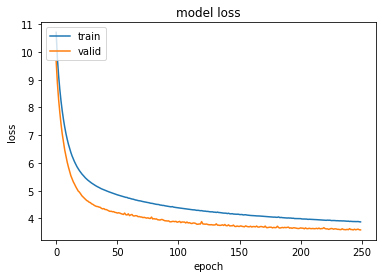

In [36]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper left')
plt.savefig('plt')

In [37]:
history.history["val_loss"]

[9.664317811532426,
 8.881764180949684,
 8.285320301920082,
 7.813882674289745,
 7.389388803878753,
 7.03679329050362,
 6.749854319570259,
 6.467612479759995,
 6.251623891281644,
 6.035429644150112,
 5.857866182949708,
 5.6971720660597995,
 5.54277432283354,
 5.429590708413075,
 5.322508154061519,
 5.239178289623374,
 5.147130797409003,
 5.066830473355465,
 4.990069107914834,
 4.949257083949659,
 4.8880847064366195,
 4.82005290860888,
 4.7732614630707335,
 4.731589921559779,
 4.689545134620468,
 4.64678246733097,
 4.623917998683568,
 4.585539478204057,
 4.569551726928698,
 4.52799742425923,
 4.509874939725263,
 4.477823768003652,
 4.452377925935449,
 4.434188016768064,
 4.428938228299936,
 4.41019962348593,
 4.401862879974161,
 4.366202018618757,
 4.346229551504586,
 4.3561814285311025,
 4.321843484654141,
 4.320203245988084,
 4.300064990266118,
 4.275490272799724,
 4.2559189237103,
 4.259959025709853,
 4.24310132820336,
 4.245134114430457,
 4.2208094337834074,
 4.213605758276192,
 4.1

In [38]:
model.save('model_ep250.h5')

## Submission

In [39]:
for i in range(1914, 1969 +1):
    print(i)
    if i <= 1941:
        if i>= 1920:
            test_long['lag_t7'] = test_long.groupby(['id'])['demand'].transform(lambda x: x.shift(7))    
            test_long['rolling_mean_7_7'] = test_long.groupby(['id'])['demand'].transform(lambda x: x.shift(7).rolling(7).mean())
            test_long['rolling_mean_7_28'] = test_long.groupby(['id'])['demand'].transform(lambda x: x.shift(7).rolling(28).mean())
    
        forecast = make_X(test_long[test_long.d == i])
        pred = model.predict(forecast, batch_size=2 ** 14)

        test_long.loc[test_long.d == i, "demand"] = pred.clip(0) * 1.02
    else:
        test_long.loc[test_long.d == i, "demand"] = 0

1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969


In [40]:
test = test_long[test_long.d >= 1914]
test = test.assign(id=test.id + "_" + np.where(test.d <= 1941, "validation", "evaluation"),
                   F="F" + (test.d - 1913 - 28 * (test.d > 1941)).astype("str"))
submission = test.pivot(index="id", columns="F", values="demand").reset_index()[sample_submission.columns]
submission = sample_submission[["id"]].merge(submission, how="left", on="id")
submission.head()

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,...,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
0,HOBBIES_1_001_CA_1_validation,0.752441,0.620117,0.596680,0.619141,0.736816,1.125000,1.130859,0.825684,0.832520,...,0.834961,1.166992,1.016602,0.739258,0.669922,0.650391,0.697754,0.792969,1.083984,1.153320
1,HOBBIES_1_002_CA_1_validation,0.236450,0.223145,0.258301,0.245605,0.272949,0.335449,0.268799,0.215820,0.223145,...,0.251709,0.258057,0.280762,0.253662,0.244873,0.240356,0.243896,0.261230,0.288086,0.292725
2,HOBBIES_1_003_CA_1_validation,0.408203,0.414062,0.421875,0.417480,0.454346,0.431396,0.550293,0.375977,0.366455,...,0.461426,0.567383,0.756836,0.442871,0.401855,0.384766,0.405518,0.451904,0.606445,0.625000
3,HOBBIES_1_004_CA_1_validation,1.833008,1.699219,1.570312,1.570312,2.164062,2.941406,3.187500,2.111328,2.115234,...,2.429688,3.083984,3.871094,2.359375,2.095703,1.996094,2.087891,2.521484,3.544922,3.251953
4,HOBBIES_1_005_CA_1_validation,0.997070,0.951172,0.888184,0.965820,1.133789,1.333984,1.720703,1.254883,1.265625,...,1.199219,1.489258,1.574219,1.180664,1.064453,1.039062,1.067383,1.237305,1.556641,1.692383


In [41]:
submission.to_csv("dnn_fake_valid_day_to_day_ep250.csv", index=False)